In [1]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import math

In [2]:
def coth(a):
    if a>0: return (1+tf.math.exp(-2*a))/(1-tf.math.exp(-2*a))
    if a<0: return (tf.math.exp(2*a)+1)/(tf.math.exp(2*a)-1)
    if a==0: return 0

def tanh(a):
    if a>0: return (1-tf.math.exp(-2*a))/(1+tf.math.exp(-2*a))
    if a<0: return (tf.math.exp(2*a)-1)/(tf.math.exp(2*a)+1)
    if a==0: return 0

In [3]:
data=10000
batch=100
set=100
layer=10
n_ini=1.0
n_fin=0.1
dn=-0.1
c_reg1=0.01
c_reg2=0.0001
d=2

m^2= <tf.Variable 'Variable:0' shape=() dtype=float64, numpy=1.4297917258983985>
lam= <tf.Variable 'Variable:0' shape=() dtype=float64, numpy=-0.7545834236513604>
alpha= <tf.Variable 'Variable:0' shape=() dtype=float64, numpy=-0.11270247784861986>
beta= <tf.Variable 'Variable:0' shape=() dtype=float64, numpy=0.10111559756097666>
<tf.Variable 'Variable:0' shape=(10,) dtype=float64, numpy=
array([0.37617775, 2.20750465, 1.54324781, 1.84076234, 1.3396182 ,
       2.94754812, 2.06357383, 3.91586489, 1.76372208, 4.70785622])>


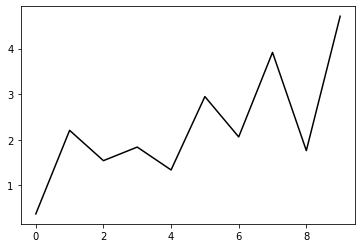

In [4]:
h=tf.zeros(layer)
h_in=[]
for i in range (layer):
    h_inn=np.float64(np.random.normal(2, 1))
    h_in.append(h_inn)
h=tf.Variable(h_in)
m2=tf.Variable(np.float64(np.random.normal(2, 1)))
lam=tf.Variable(np.float64(np.random.normal(1, 1)))
alpha=tf.Variable(np.float64(np.random.uniform(-0.5, 0.5)))
beta=tf.Variable(np.float64(np.random.uniform(-0.5, 0.5)))
#m2=tf.constant(np.float64(5.6))
#lam=tf.constant(np.float64(0.61))
#alpha=tf.constant(np.float64(1.444635))
#beta=tf.constant(np.float64(0.00615))
print("m^2=", m2)
print("lam=", lam)
print("alpha=", alpha)
print("beta=", beta)
print(h)
plt.plot(h.numpy(), 'k-')
plt.show()

In [5]:
def F_func(m, la, a,b):
    return 2*b/n_fin-m*a-la*(a**3)

def t_func(a):
    return 0.5*(tf.math.tanh(100*(a-0.1))-tf.math.tanh(100*(a+0.1))+2)

In [6]:
x=[i*0.2 for i in range (30)]
y=[0.0, 0.018, 0.035, 0.053, 0.0715, 0.0895, 0.107, 0.125, 0.146, 0.1665, 0.1875, 0.2085, 0.229, 0.25, 0.265, 0.281, 0.296, 0.3115, 0.3275, 0.343, 0.3565, 0.385, 0.4375, 0.5, 0.6, 0.675, 0.735, 0.815, 0.865, 0.885]
y[:]=[2*v for v in y]
fp1 = np.polyfit(x, y, 15)
print(fp1)

[ 1.59046394e-05 -6.81729682e-04  1.31412795e-02 -1.50525136e-01
  1.14052774e+00 -6.02241647e+00  2.27455168e+01 -6.20704699e+01
  1.22166922e+02 -1.71187074e+02  1.66428955e+02 -1.07461552e+02
  4.28229887e+01 -9.20544914e+00  9.55260239e-01 -1.30911492e-04]


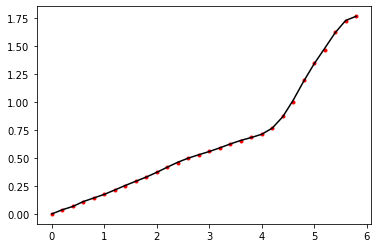

In [7]:
def f(x):
    y=0
    for i in range (16):
        y=y+fp1[i]*x**(15-i)
    return y
yy=[f(i*0.2) for i in range (30)]
plt.plot(x, y, 'r.')
plt.plot(x, yy, 'k-')
plt.show()

In [8]:
def NN_func_p(f):
    Positive=[]
    append=Positive.append
    while len(Positive)<batch:
        H=np.random.uniform(0.0, 6.0)
        M=np.random.uniform(0.0, 2.0)
        noise=np.abs(np.random.normal(0, 0.1))
        if np.abs(M-f(H))<=noise: append([H, M])
        else: continue
    return Positive
def NN_func_n(f):
    Negative=[]
    append=Negative.append
    while len(Negative)<batch:
        H=np.random.uniform(0.0, 6.0)
        M=np.random.uniform(0.0, 2.0)
        noise=np.abs(np.random.normal(0, 0.1))
        if np.abs(M-f(H))>noise: append([H, M])
        else: continue
    return Negative

In [9]:
Positive=[]
Negative=[]
for i in range (set):
    Positive.insert(i, NN_func_p(f))
    Negative.insert(i, NN_func_n(f))

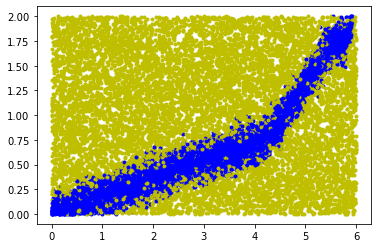

In [10]:
x_data1=[]
y_data1=[]
x_data2=[]
y_data2=[]
for i in range (set):
    x_data1.insert(i, [v[0] for v in Positive[i]])
    y_data1.insert(i, [v[1] for v in Positive[i]])
    x_data2.insert(i, [v[0] for v in Negative[i]])
    y_data2.insert(i, [v[1] for v in Negative[i]])
    plt.plot(x_data2[i], y_data2[i], 'y.')
    plt.plot(x_data1[i], y_data1[i], 'b.')
plt.show()

In [11]:
def Dfunc(hh, m):
    D=tf.math.sqrt(tf.math.abs(1+4*m/(hh[0]**2)))
    return D

In [12]:
def LP2(hh, m, la, alpha, beta, HH, MM):
    D=Dfunc(hh, m)
    phi=alpha*HH+beta*MM
    pi=(d/2)*(D-1)*alpha*HH+(d/2)*(-D-1)*beta*MM
    for j in range (layer-1):
        phi1=phi+dn*pi
        pi1 =phi*m*dn+(1-dn*hh[j])*pi+dn*la*(phi1**3)
        phi=phi1
        pi=pi1
    return phi, pi
def NN_func_01(hh, m, la, alpha, beta, list_hr):
    PP=[]
    NN=[]
    H=np.array(list_hr)[:, 0]
    M=np.array(list_hr)[:, 1]
    F=np.array(tf.math.abs(LP2(hh, m, la, alpha, beta, H, M)[1]))
    for i in range (len(H[F<0.1])):
        PP.append([H[F<0.1][i], M[F<0.1][i]])
    for i in range (len(H[F>=0.1])):
        NN.append([H[F>=0.1][i], M[F>=0.1][i]])
    return PP, NN

In [13]:
Positive0=[]
Positive1=[]
Negative0=[]
Negative1=[]
for i in range (set):
    Positive0.insert(i, NN_func_01(h, m2, lam, alpha, beta, Positive[i])[0])
    Positive1.insert(i, NN_func_01(h, m2, lam, alpha, beta, Positive[i])[1])
    Negative0.insert(i, NN_func_01(h, m2, lam, alpha, beta, Negative[i])[0])
    Negative1.insert(i, NN_func_01(h, m2, lam, alpha, beta, Negative[i])[1])

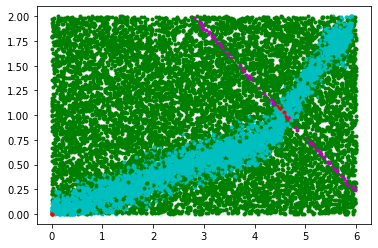

In [14]:
x_data1=[]
y_data1=[]
x_data2=[]
y_data2=[]
x_data3=[]
y_data3=[]
x_data4=[]
y_data4=[]
for i in range (set):
    x_data1.insert(i, [v[0] for v in Positive0[i]])
    y_data1.insert(i, [v[1] for v in Positive0[i]])
    x_data2.insert(i, [v[0] for v in Positive1[i]])
    y_data2.insert(i, [v[1] for v in Positive1[i]])
    x_data3.insert(i, [v[0] for v in Negative0[i]])
    y_data3.insert(i, [v[1] for v in Negative0[i]])
    x_data4.insert(i, [v[0] for v in Negative1[i]])
    y_data4.insert(i, [v[1] for v in Negative1[i]])
    plt.plot(x_data4[i], y_data4[i], 'g.')
    plt.plot(x_data2[i], y_data2[i], 'c.')
    plt.plot(x_data1[i], y_data1[i], 'r.')
    plt.plot(x_data3[i], y_data3[i], 'm.')
plt.show()

# Error function

$E=\sum_{data} \left\vert y(\bar{x}^{(1)}) - \bar{y} \right\vert+E_{reg}(W)$
, $E_{reg}=c_{reg}^{(1)}\sum_{n=1}^{N-1}(\eta^{(n)})^{4}(h(\eta^{(n+1)})-h(\eta^{(n)}))^{2}+c_{reg}^{(2)}(h(\eta^{(N)})-1/\eta^{(N)})^{2}$

In [23]:
def Error_func(hh, m, la, alpha, beta, list1, list2):
    H0=np.array([v[0] for v in list1])
    M0=np.array([v[1] for v in list1])
    H1=np.array([v[0] for v in list2])
    M1=np.array([v[1] for v in list2])
    H_0, M_0=LP2(hh, m, la, alpha, beta, H0, M0)
    H_1, M_1=LP2(hh, m, la, alpha, beta, H1, M1)
    PPlist=t_func(M_0)
    NNlist=t_func(M_1)
    sum_p=sum(PPlist)
    sum_n=(batch-sum(NNlist))

    inside=0
    for k in range (layer-1):
        second=((n_ini+k*dn)**4)*((hh[k+1]-hh[k])**2)
        inside=inside+second
    E_reg1=c_reg1*inside
    E_reg2=c_reg2*((hh[layer-1]-1/n_fin)**2)
    return sum_n+sum_p+E_reg1+E_reg2

In [16]:
for i in range (set):
    print(Error_func(h, m2, lam, alpha, beta, Positive[i], Negative[i]))

tf.Tensor(100.06830998263791, shape=(), dtype=float64)
tf.Tensor(101.98502678790456, shape=(), dtype=float64)
tf.Tensor(99.52733415819138, shape=(), dtype=float64)
tf.Tensor(100.04503785681908, shape=(), dtype=float64)
tf.Tensor(98.6146598169107, shape=(), dtype=float64)
tf.Tensor(100.04543007264442, shape=(), dtype=float64)
tf.Tensor(100.04543007271694, shape=(), dtype=float64)
tf.Tensor(99.46097300209111, shape=(), dtype=float64)
tf.Tensor(101.04538474113961, shape=(), dtype=float64)
tf.Tensor(98.05052527759011, shape=(), dtype=float64)
tf.Tensor(99.98846927054532, shape=(), dtype=float64)
tf.Tensor(100.99863478127398, shape=(), dtype=float64)
tf.Tensor(100.06922970524344, shape=(), dtype=float64)
tf.Tensor(101.04543000840607, shape=(), dtype=float64)
tf.Tensor(103.76142843868928, shape=(), dtype=float64)
tf.Tensor(101.73592115760916, shape=(), dtype=float64)
tf.Tensor(100.84990886843491, shape=(), dtype=float64)
tf.Tensor(100.62298341657015, shape=(), dtype=float64)
tf.Tensor(100.04

# Optimize

0 100.11581546731004
1.4214278492739383 -0.7462195469064363 -0.10433860091078737 0.09275172066664321
[0.42617775 2.15750465 1.49324781 1.79076234 1.28961821 2.89754814
 2.1135738  3.96586488 1.81372207 4.7578255 ]


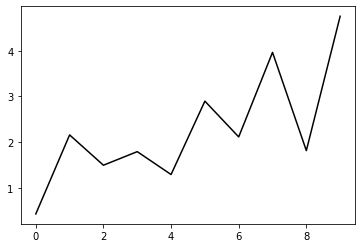

1100 100.03199188703124
1.3806653326154221 -0.7058874585965693 -0.06361181515908074 0.05179946045657699
[0.54133107 2.03863732 1.37625275 1.67267063 1.17148904 2.77336598
 2.22213491 4.07771519 1.92475235 5.29007696]


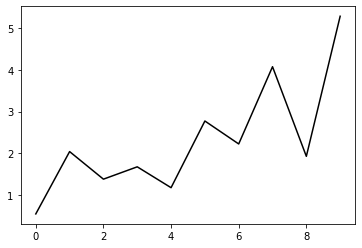

2200 100.03265465906661
1.3798802638203964 -0.7058854882434564 -0.06293391391779281 0.050227578165526754
[0.5439095  2.03143825 1.37264712 1.66650245 1.1642885  2.74915584
 2.20053299 4.06735449 1.91319561 5.79540766]


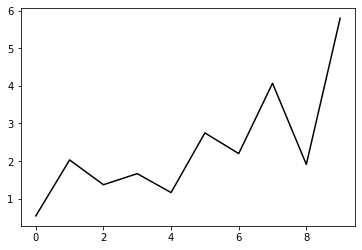

3300 99.4700329665871
1.3787199839394533 -0.7058855912158194 -0.06201189927609765 0.04761399634180932
[0.55196221 2.01233971 1.35930947 1.64695054 1.13894154 2.67379735
 2.12906742 4.03349431 1.87479029 6.28011136]


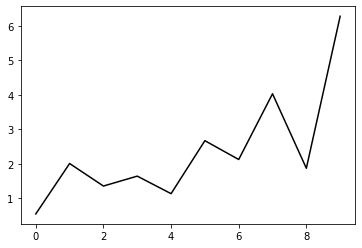

4400 99.02984711550552
1.3775932823247186 -0.7058856967294894 -0.0612236824425404 0.04468788412778575
[0.56027249 1.98810386 1.34626467 1.6253057  1.11309077 2.59305238
 2.05578736 3.99681529 1.83384663 6.74639824]


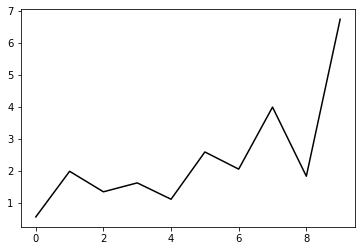

5500 100.02795298792974
1.3767046960398663 -0.7058858008892912 -0.06081725254205785 0.041749125716086515
[0.57036664 1.95212057 1.32973549 1.59530274 1.07913615 2.48812573
 1.96280695 3.94651489 1.77846813 7.19297101]


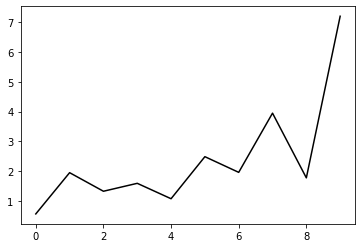

6600 99.73156191695625
1.3757591698272265 -0.7058858982859547 -0.06003947451421671 0.03924580020230567
[0.59494766 1.88081503 1.28902808 1.53003689 1.0016449  2.29079515
 1.78174449 3.83993511 1.6614473  7.61476601]


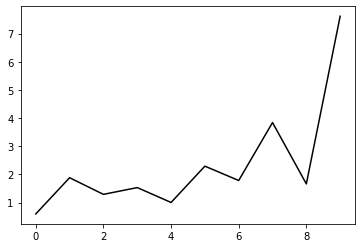

7700 100.01758811611786
1.3744553457577526 -0.7058860138123493 -0.058579070418316226 0.0365919595149247
[0.63935583 1.76638935 1.22121443 1.42589555 0.88397578 2.0589306
 1.56891538 3.68650707 1.49863948 8.00042598]


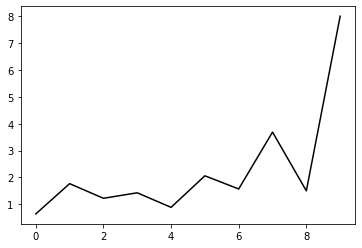

8800 97.88408230815027
1.3726424273712154 -0.7058862271194987 -0.05656693025191131 0.032540569715885814
[0.75944544 1.51566499 1.02358946 1.17480786 0.6093967  1.68253939
 1.21152571 3.37229133 1.17587417 8.33230243]


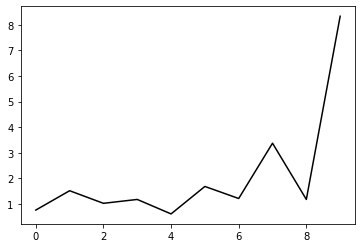

9900 95.17889305249946
1.3682699799570897 -0.70588655758287 -0.050839491967533616 0.02355683841684468
[1.04237138 1.0991491  0.62889049 0.75590285 0.1892483  1.23681118
 0.77626371 2.9471401  0.75039022 8.56096533]


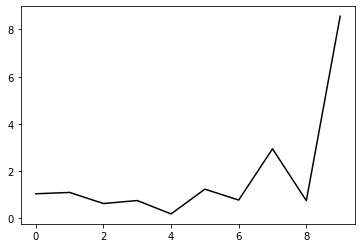

11000 83.34460831826375
1.35852511628868 -0.705957137765521 -0.039827133183871856 0.024583068935540325
[ 1.34558738  0.7057129   0.22582431  0.3424766  -0.22958361  0.8067769
  0.34174088  2.50753018  0.30566648  8.6513395 ]


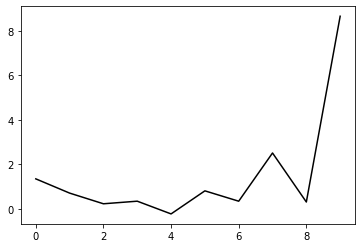

12100 96.99620457721895
1.344209647618141 -0.7061259763706838 -0.030337633086868966 -0.05015261113899548
[ 1.56786795e+00  4.02909027e-01 -8.76254967e-02  1.97948903e-02
 -5.52588268e-01  4.82891178e-01  2.51324147e-02  2.19940885e+00
  7.07856892e-03  8.63831876e+00]


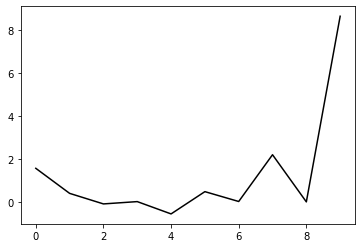

13200 64.6326964694759
1.3097952959503463 -0.7061534195072456 -0.03083443125304299 -0.01678547747815299
[ 1.27912419  0.30022314 -0.29469436 -0.28691895 -0.93436887  0.04144063
 -0.45268077  1.69773611 -0.51033843  8.57791305]


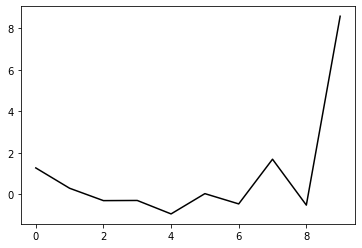

14300 76.46761743085172
1.3169003850081635 -0.7068079649494007 -0.06328914494444433 -0.03607707837846942
[ 0.96779889  0.75058023  0.14893397  0.1203725  -0.57419092  0.33990506
 -0.20675344  1.88899957 -0.35719073  8.56047335]


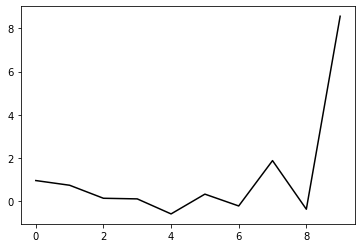

15400 41.087284638555545
1.2945302334205513 -0.7114263634222349 -0.06513695950753047 -0.046610345058553854
[ 1.07816014e+00  6.45214069e-01  3.80806001e-02 -5.04706812e-04
 -7.05970282e-01  1.89682995e-01 -3.75232109e-01  1.70228201e+00
 -5.49702353e-01  8.54636248e+00]


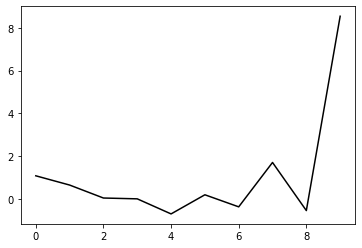

16500 43.36754435085765
1.2926232188869882 -0.7181280909056077 -0.0715418295526761 -0.05126803346726138
[ 0.99685212  0.74992446  0.14492599  0.10614786 -0.5987427   0.29308542
 -0.27690922  1.78773752 -0.48023351  8.55217322]


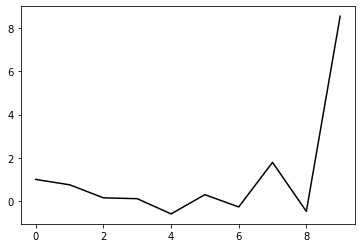

17600 56.59363451369377
1.270939634898706 -0.730202126409506 -0.07018437988665559 -0.05589019616840882
[ 1.08094326  0.67022326  0.06583821  0.02449274 -0.68297753  0.20085009
 -0.37811     1.67227438 -0.60720032  8.58317922]


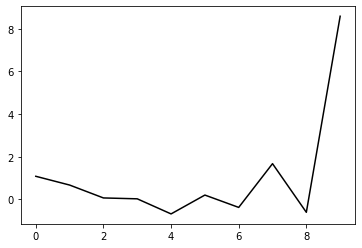

18700 47.87252304849549
1.2686910015297608 -0.7393320368495083 -0.07837089003085876 -0.05695358948906907
[ 1.08843315  0.67856101  0.0761676   0.03431406 -0.67274115  0.20765063
 -0.37396064  1.67092581 -0.61058193  8.55454577]


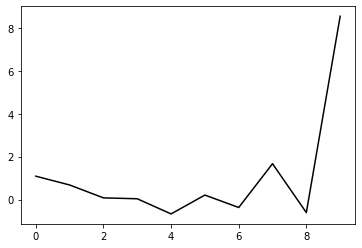

19800 30.72170134917559
1.2321710613147812 -0.7664352454342056 -0.0868295108902072 -0.05027111246674777
[ 1.08920964e+00  6.54502165e-01  4.74988153e-02 -5.60577993e-03
 -7.28940098e-01  1.20794031e-01 -5.03530283e-01  1.47475325e+00
 -8.80643872e-01  8.51278794e+00]


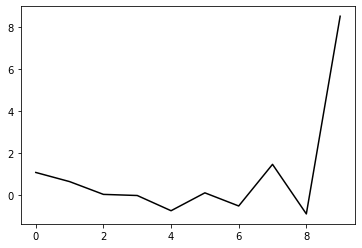

20900 42.459987639326286
1.2139223527038487 -0.792133241194499 -0.09332215287014216 -0.05259853174664468
[ 1.06389816  0.69395974  0.09384902  0.04539397 -0.67269811  0.17879575
 -0.44411506  1.53017017 -0.83243032  8.50776321]


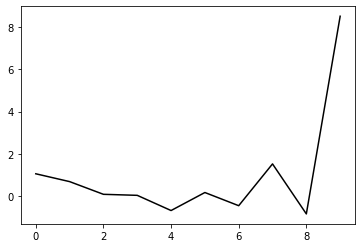

22000 29.14782646509434
1.211972970398597 -0.8049171700159858 -0.09506733685622369 -0.06099996146120886
[ 1.07486111  0.71856007  0.12506449  0.0827261  -0.6265243   0.23464761
 -0.37334498  1.62168091 -0.71375883  8.52374235]


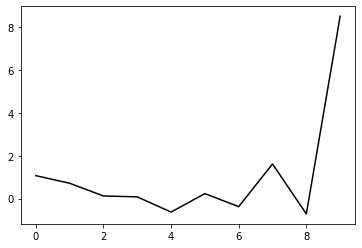

23100 23.875863499290205
1.193377966599354 -0.8281292241629394 -0.10043163335092646 -0.062487726571419454
[ 1.12113281  0.68056806  0.09048102  0.04849418 -0.66084124  0.19450921
 -0.42180855  1.55645014 -0.79539271  8.52987409]


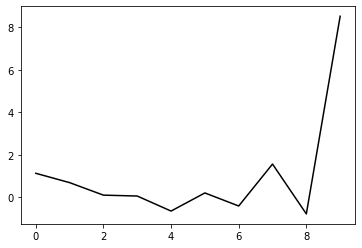

24200 28.196832641001226
1.145465176339631 -0.8670925491998802 -0.10660760825555984 -0.0651829540900857
[ 1.13527824  0.66957811  0.08150824  0.03745125 -0.67684343  0.16410233
 -0.47591368  1.45498686 -0.96781334  8.46539758]


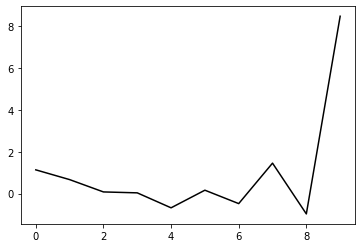

25300 46.56150126178483
1.1240205966816632 -0.9012042207655799 -0.11624400422973406 -0.06783220565916158
[ 1.07614161  0.7498597   0.17217289  0.13732926 -0.56641379  0.28458501
 -0.34261094  1.60315464 -0.80362332  8.51844495]


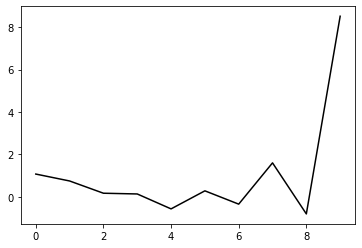

26400 22.538812572653562
1.1010029954418261 -0.9268188153440781 -0.12016000420260717 -0.07671393719405122
[ 1.19197642  0.66166165  0.0964056   0.07350142 -0.61549177  0.25217946
 -0.35114944  1.62876415 -0.73638944  8.49565429]


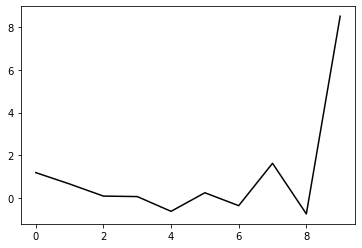

27500 35.06083617631533
1.0888029429834178 -0.9475039745340064 -0.12712945175524454 -0.07992671717981106
[ 1.13308661  0.75655629  0.20610071  0.19760541 -0.47371309  0.41362364
 -0.16414824  1.84545604 -0.49918222  8.55672347]


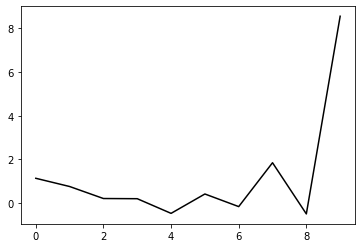

28600 25.340197417504825
1.0718725050009983 -0.9631641367143552 -0.1309396710520976 -0.08498947653751623
[ 1.21706156  0.70345531  0.16457071  0.16770881 -0.48780366  0.41853121
 -0.12970968  1.92333217 -0.37921663  8.587982  ]


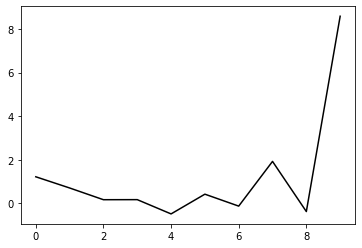

29700 16.004656038978244
1.062483745656942 -0.9676505360732306 -0.1313370223961962 -0.08728483709173253
[ 1.2539065   0.68454304  0.14881719  0.15435793 -0.49633045  0.41358333
 -0.12738849  1.92997286 -0.38325877  8.54405507]


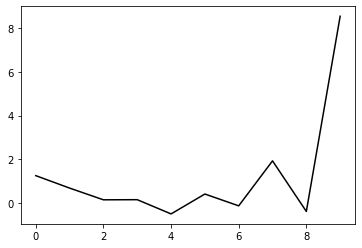

30800 22.851229105849
1.0631737412202489 -0.9650094835911814 -0.13047906262341807 -0.08740133231769509
[ 1.21084624  0.74292678  0.20714814  0.21143227 -0.43831537  0.46973143
 -0.07230035  1.97498662 -0.36166324  8.5590496 ]


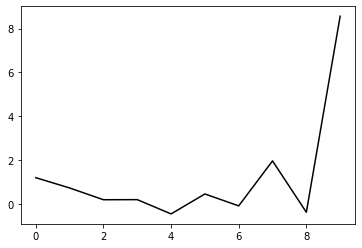

31900 14.353368148444423
1.0498722809364922 -0.9702993844819543 -0.1327622487356245 -0.08661235663734006
[ 1.22024775  0.74165476  0.20806488  0.21227422 -0.43682419  0.46645493
 -0.08217547  1.94734191 -0.41418911  8.57067205]


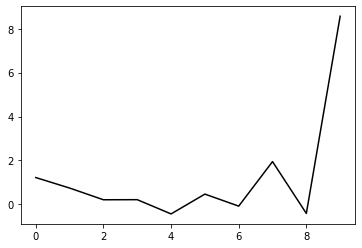

33000 17.234403873559202
1.0405326780627577 -0.9741043152084266 -0.135286763213151 -0.08448301398991911
[ 1.21669185  0.74695407  0.21396259  0.21693    -0.43263051  0.46548358
 -0.09013277  1.92163577 -0.46657183  8.56544017]


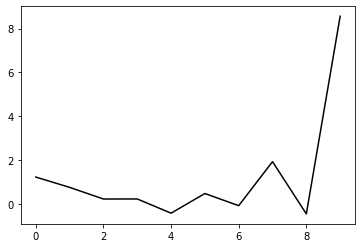

34100 23.2376877581712
1.0319137058681815 -0.9732115815777889 -0.13290214923083535 -0.08578985980921142
[ 1.24482792  0.72513953  0.18363897  0.17602487 -0.48378712  0.39708711
 -0.1808376   1.79246169 -0.63439034  8.51345361]


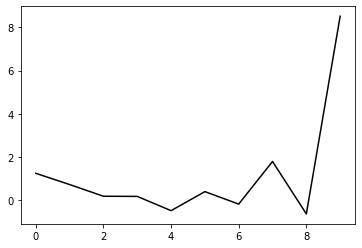

35200 22.982236199859702
1.0401123840830746 -0.9644247475831353 -0.12980646775329868 -0.0845894782194124
[ 1.2277869   0.76255043  0.21742662  0.20559588 -0.45629684  0.42025205
 -0.16171403  1.7990227  -0.65031318  8.52498067]


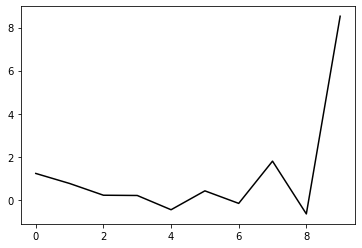

36300 21.53894389544295
1.0395425046758124 -0.9672071908210034 -0.13226187356755686 -0.08612889921241122
[ 1.20443071  0.81262405  0.27708797  0.27481312 -0.37333025  0.51951057
 -0.03727619  1.95879479 -0.45507879  8.56009342]


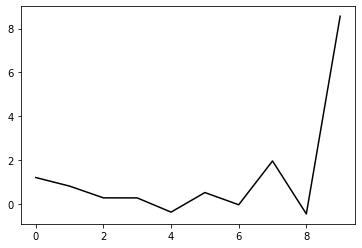

37400 34.567990026362054
1.039569529809794 -0.964196309147079 -0.12979657917246065 -0.0880603831323385
[ 1.29711474  0.72727285  0.19403707  0.19279075 -0.4512438   0.44341841
 -0.10734397  1.89649477 -0.50056911  8.56415617]


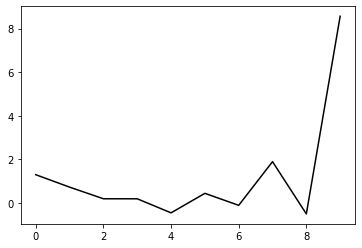

38500 21.622625987017898
1.0195619368187174 -0.9688034109353629 -0.13219828160280242 -0.08289993189447217
[ 1.21311683  0.80857647  0.26568375  0.2509555  -0.40903473  0.45804062
 -0.13263089  1.79649224 -0.70418042  8.50382395]


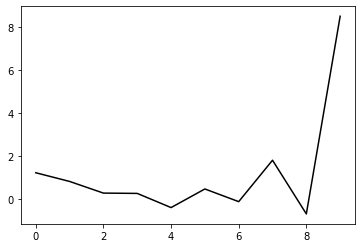

39600 25.27872905046371
1.023983677873509 -0.9664886364178112 -0.1316779136405467 -0.08515764140427548
[ 1.20643043  0.84683409  0.30633033  0.29397921 -0.3605741   0.51267513
 -0.06801866  1.87162221 -0.62031616  8.55568123]


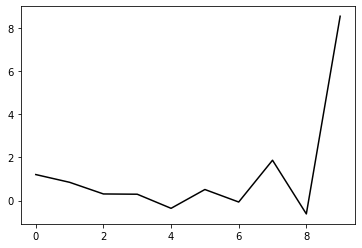

40700 16.43428395231068
1.026188105100563 -0.9643457575973753 -0.13022241132037443 -0.08826800801133389
[ 1.26813075  0.81109534  0.27695094  0.27060351 -0.37434565  0.50944533
 -0.05449318  1.90667708 -0.56181703  8.52993175]


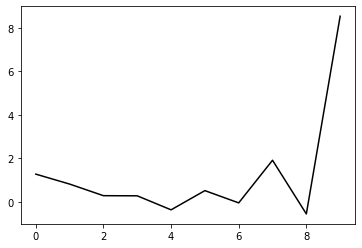

41800 22.578589227469674
1.020738607547011 -0.9663341679537051 -0.13170531480890485 -0.0871094047178518
[ 1.2020031   0.8776454   0.34298499  0.33334923 -0.31473558  0.55852513
 -0.02190621  1.90112764 -0.62154846  8.53749809]


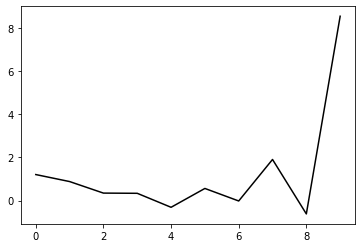

42900 15.840494011151135
1.0059277569425311 -0.9698724092193131 -0.1337036304671085 -0.08349747068699019
[ 1.23035271  0.84828003  0.3086558   0.29113864 -0.36562226  0.49132173
 -0.11062708  1.77741584 -0.77909789  8.48722534]


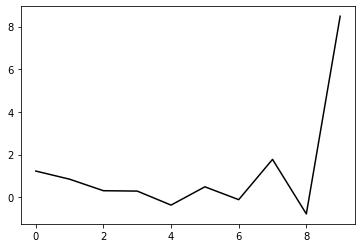

44000 19.42655637252648
1.0049855620960366 -0.9645063692931698 -0.1305933246109703 -0.08197047373130384
[ 1.19446921  0.8894833   0.34268704  0.31659257 -0.34788252  0.49738048
 -0.11776474  1.74788076 -0.83748825  8.49787261]


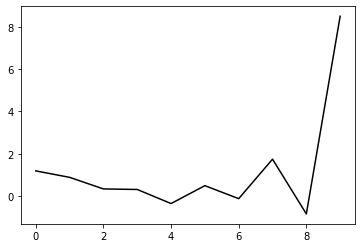

45100 23.87792405381422
0.9974036657012105 -0.9695580358737506 -0.13300465482263615 -0.08540252163426007
[ 1.26459966  0.83433773  0.29325326  0.27158099 -0.38644216  0.46323121
 -0.1453203   1.72799492 -0.83916244  8.51481961]


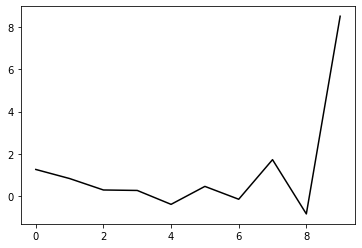

46200 28.18582154518331
0.9996050595353078 -0.9612250539320352 -0.12718060218429944 -0.08742377172050449
[ 1.25806685  0.86365293  0.31695969  0.28811984 -0.37626281  0.46172427
 -0.1633211   1.67142886 -0.95739806  8.43034988]


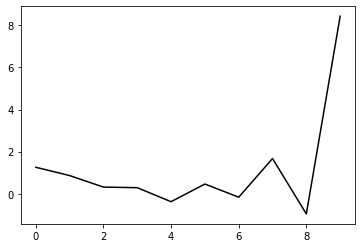

47300 21.8963844452388
0.9960261737073909 -0.9642264370694161 -0.1311251416643438 -0.08458271706556476
[ 1.20830696  0.93531124  0.39046333  0.36261849 -0.29856845  0.54147481
 -0.07998749  1.7536845  -0.88144585  8.4830547 ]


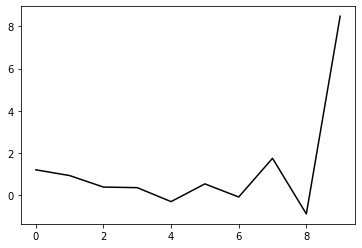

48400 15.125233150435518
1.0030268637784108 -0.9604779540808154 -0.12886805440648602 -0.08883877653570248
[ 1.24658475  0.92729926  0.38949542  0.36920501 -0.27902307  0.57766339
 -0.01675193  1.85507404 -0.74187727  8.55477767]


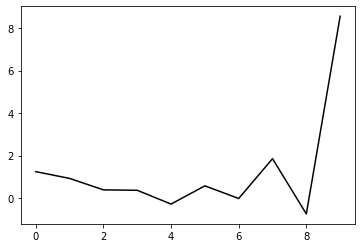

49500 21.90682171247995
0.9979067514735851 -0.9615076664137905 -0.12965681942706594 -0.08792143221208652
[ 1.22231398  0.96083455  0.42573912  0.40617461 -0.23931514  0.61559468
  0.01903893  1.87895696 -0.73638834  8.51375101]


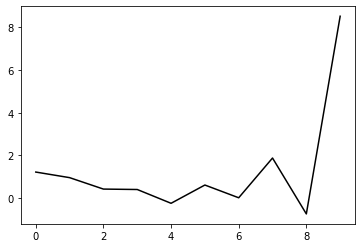

50600 24.798517855708944
0.9902549437290628 -0.9654221657424495 -0.13205544765979782 -0.08772959941510679
[ 1.22915778  0.96798394  0.43304825  0.41205315 -0.23268353  0.61960441
  0.02076626  1.86988069 -0.76295203  8.50451606]


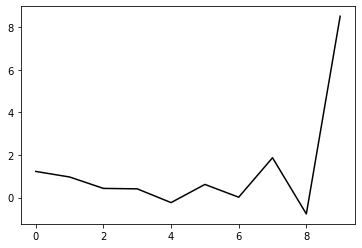

51700 32.09670754131418
0.9967359666235035 -0.9588320294383182 -0.12741089908777042 -0.09125593812649033
[ 1.30509659  0.91528532  0.37993957  0.35792298 -0.28335823  0.57160677
 -0.01929225  1.83688893 -0.78750014  8.51180409]


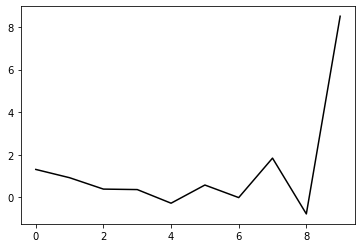

52800 23.795369634597613
0.9852387969537948 -0.9604436621189112 -0.12754434085435712 -0.08974820563139725
[ 1.24671067  0.97266523  0.42843954  0.39303779 -0.26419708  0.5621263
 -0.07056634  1.71331022 -0.9902163   8.47417506]


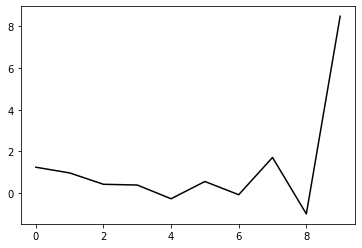

53900 14.301856268079552
0.9821823254933191 -0.9627780971979237 -0.13016875200408165 -0.08843124788671385
[ 1.22726590e+00  1.01211974e+00  4.71395512e-01  4.38680848e-01
 -2.12780515e-01  6.18747882e-01 -5.01562864e-03  1.78683080e+00
 -9.12342616e-01  8.45486873e+00]


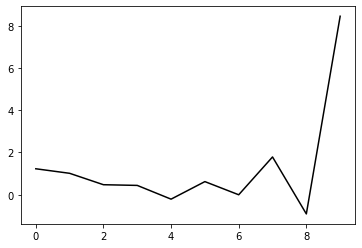

55000 16.92078178720219
0.982062197326505 -0.9627203552291197 -0.13106101641922385 -0.08798440144087484
[ 1.21384514  1.04417697  0.5085249   0.48009351 -0.16313245  0.67623092
  0.06534541  1.86978607 -0.82149041  8.5049727 ]


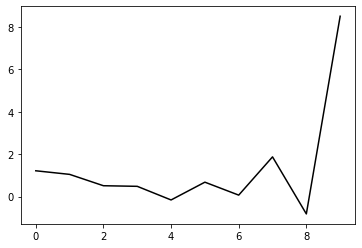

56100 31.801214549047813
0.975536679174309 -0.9641424540597711 -0.13249942806462897 -0.0858529406732008
[ 1.19909684  1.06354715  0.53000948  0.5012171  -0.1407054   0.693221
  0.07301834  1.85026934 -0.87095046  8.52033057]


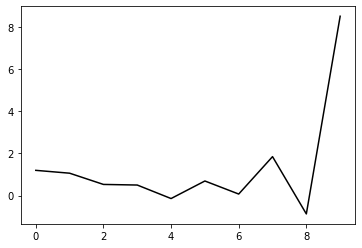

57200 22.279759824605176
0.9677897582118129 -0.9596298483924991 -0.1284411562561409 -0.08362485104577112
[ 1.23302339  1.02599117  0.47714633  0.43023246 -0.23066019  0.57721302
 -0.07268639  1.66660824 -1.08711572  8.44628037]


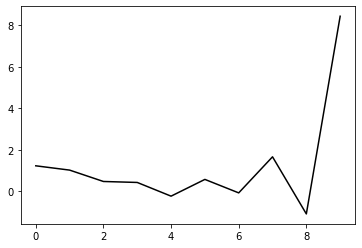

58300 22.409598374019108
0.9754918725945291 -0.9559652674529734 -0.12676628280414207 -0.0877799740960033
[ 1.22925423  1.06388463  0.52121155  0.48021911 -0.1711      0.64726498
  0.01191959  1.76553886 -0.97779891  8.48976027]


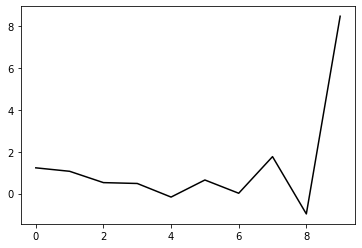

59400 17.51965745042498
0.9696863399458622 -0.9580239911861554 -0.12759620242994946 -0.08816900694152735
[ 1.26677527  1.03171303  0.49076212  0.44895149 -0.20175975  0.61299365
 -0.02573988  1.72016301 -1.02601902  8.47250681]


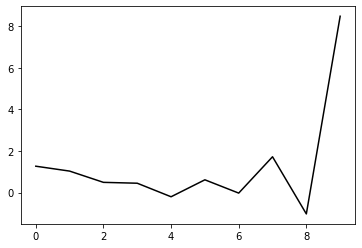

60500 22.592865248266357
0.9587136843078439 -0.9630084254789105 -0.12994145448252656 -0.08965239935430704
[ 1.24897876e+00  1.06539598e+00  5.26398251e-01  4.84495038e-01
 -1.64653604e-01  6.48008707e-01  6.77229154e-03  1.74045675e+00
 -1.02814333e+00  8.49656301e+00]


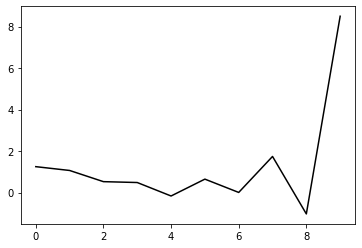

61600 28.827158501506236
0.9661098816430218 -0.9595623992765662 -0.1295385874993461 -0.08897992607330032
[ 1.18959428  1.15086219  0.61325134  0.57230059 -0.07167732  0.74623065
  0.11494126  1.85847824 -0.90238529  8.49361886]


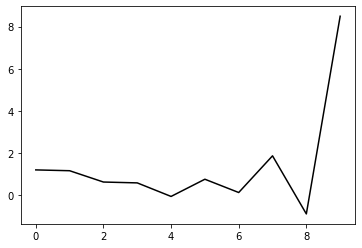

62700 17.902197970901973
0.9543464512063131 -0.9613960039612464 -0.12855487617633035 -0.0912400830292679
[ 1.29396509  1.04566324  0.50279102  0.45310841 -0.19974711  0.6017324
 -0.04983154  1.6611783  -1.13022567  8.47700207]


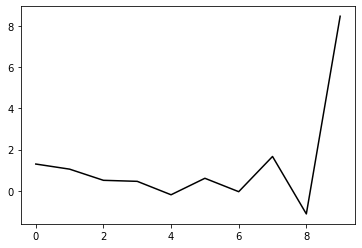

63800 23.301895541302542
0.954287507125235 -0.9596621176446918 -0.1281984118930679 -0.09095745364569072
[ 1.22557855  1.13081825  0.58844963  0.53728843 -0.11541973  0.68199551
  0.024759    1.71917797 -1.09590674  8.43455823]


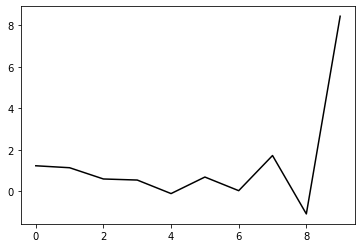

64900 14.341584923165495
0.9485594154890438 -0.9612810292152911 -0.12955778546457825 -0.08946366329345572
[ 1.22718449  1.14080376  0.59893146  0.54633855 -0.10468582  0.69099017
  0.03317111  1.71677155 -1.1200367   8.49203739]


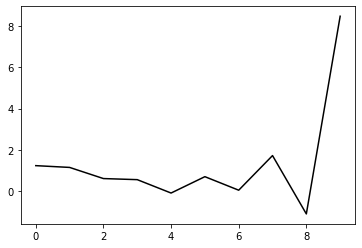

66000 16.953648186119153
0.9501429990348031 -0.958949022926756 -0.1288676201202161 -0.08896368391797109
[ 1.23947896  1.14631535  0.60853215  0.55862413 -0.08588164  0.71486029
  0.06640196  1.75843449 -1.06929215  8.46020482]


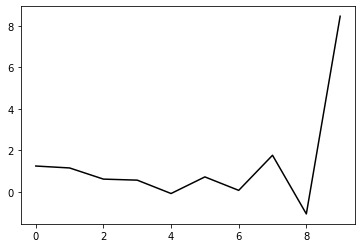

67100 43.59070304138252
0.9347589881494667 -0.9666493425613463 -0.1343188967733887 -0.08614496449818781
[ 1.19889454  1.19547392  0.66316283  0.61523977 -0.02672021  0.76791001
  0.10494039  1.7552993  -1.1144951   8.4871095 ]


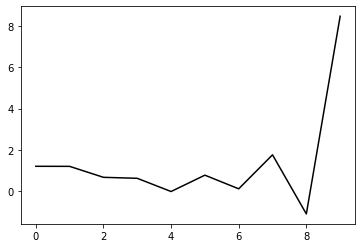

68200 23.878030354017596
0.9415396904964057 -0.9605423274902394 -0.1306505699983376 -0.08860989372980793
[ 1.2280173   1.18038217  0.64821339  0.59906568 -0.04141486  0.75250544
  0.09090347  1.74052412 -1.12558946  8.4494559 ]


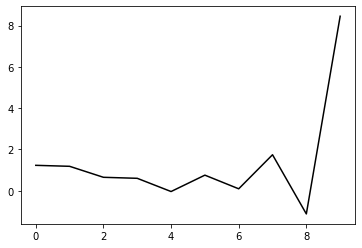

69300 22.05607248025441
0.9310345465125969 -0.9627391262164846 -0.1311866763280052 -0.0898083855122377
[ 1.27277863  1.14066331  0.61490439  0.57070382 -0.06125986  0.73869114
  0.08537105  1.73576711 -1.13751325  8.42652348]


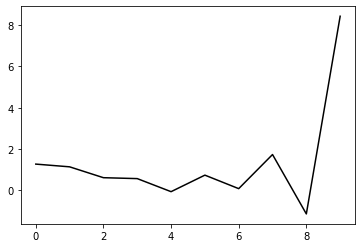

70400 16.61731337736812
0.9387573043801752 -0.9548592342674443 -0.12737037166006535 -0.08783382813643235
[ 1.22474653  1.20552547  0.67386453  0.62176139 -0.01566553  0.77475457
  0.112439    1.7481264  -1.13947707  8.48182756]


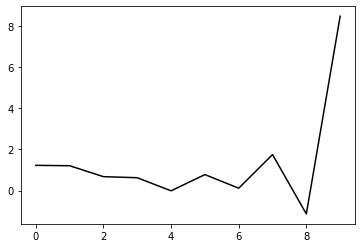

71500 28.581744390267172
0.9380688687528711 -0.9542661767114211 -0.12757059558922226 -0.08732241541138076
[ 1.19948882  1.23436786  0.70511126  0.65265462  0.01711463  0.80494821
  0.14037326  1.76588388 -1.13620481  8.44940329]


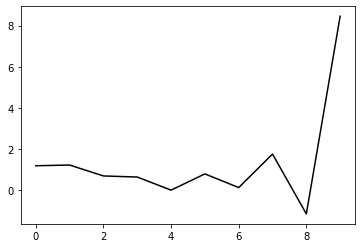

72600 36.83578026014899
0.9244420489591234 -0.9618505127984425 -0.13230622530835895 -0.08825298664637116
[ 1.21559448  1.24472954  0.72350677  0.67838709  0.05488826  0.85444066
  0.20519681  1.83465065 -1.08149204  8.48278508]


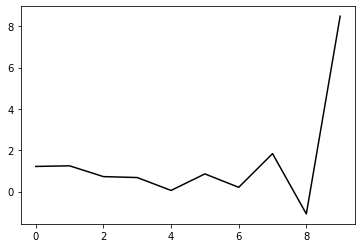

73700 16.155479119879043
0.9269096747401229 -0.9541434273559961 -0.12694208757553999 -0.08999683763259393
[ 1.28790979  1.18463707  0.65986866  0.60801536 -0.02155061  0.76555166
  0.1018065   1.70884721 -1.21691798  8.45530037]


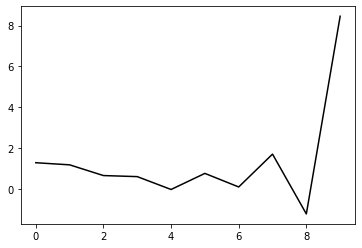

74800 23.07861969552664
0.9183722365566058 -0.9565666469670213 -0.1285641649160032 -0.08891436738762794
[ 1.23742352  1.22910953  0.7031155   0.64606756  0.01126558  0.78414552
  0.09914868  1.66048333 -1.32756387  8.41074524]


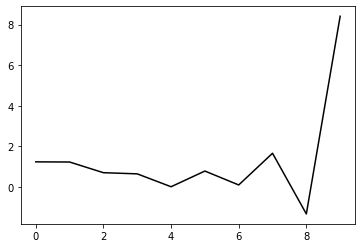

75900 14.086759069412706
0.9167553506339922 -0.9565800553189814 -0.12939567311285644 -0.08809124078025618
[ 1.26139469  1.22792406  0.70514725  0.64948882  0.01953974  0.7955121
  0.11744124  1.68303788 -1.30009922  8.45023207]


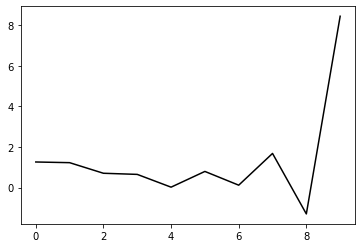

77000 17.082277467775857
0.9091643548772061 -0.9547671550623075 -0.12811817988034008 -0.08570389407197349
[ 1.25238059  1.23908349  0.7141699   0.65428315  0.02211551  0.79262399
  0.11021252  1.66385838 -1.34139345  8.43769966]


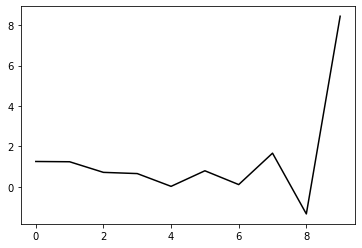

78100 22.498706906980257
0.8990903379681846 -0.9543133605458457 -0.12639544754669013 -0.08716192090814673
[ 1.26782381  1.22379388  0.69271922  0.62315953 -0.01883265  0.73521897
  0.03437026  1.56380156 -1.46027842  8.40201431]


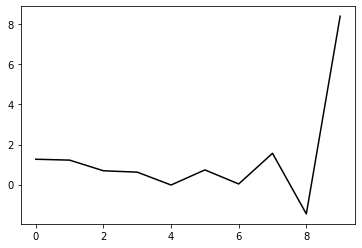

79200 23.167204566021837
0.9071918256844681 -0.9519842148455494 -0.12692141353131736 -0.08819311737823858
[ 1.2485968   1.27523467  0.75429673  0.6949083   0.06825204  0.83982548
  0.16289576  1.71564847 -1.29615932  8.4400665 ]


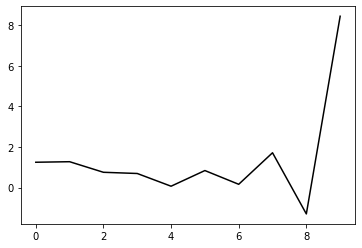

80300 22.479299835955196
0.8979505118878326 -0.9516708736731486 -0.126621811330889 -0.08704690071960235
[ 1.26296399  1.26300281  0.7395782   0.67454824  0.04275444  0.80268447
  0.1108325   1.63435048 -1.41626076  8.40126896]


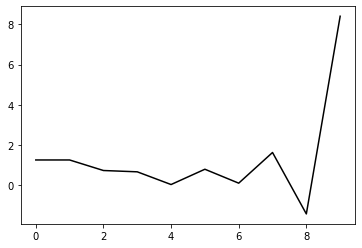

81400 16.226154040045564
0.898414382900236 -0.9499786545283347 -0.12543810481758436 -0.08848263705943621
[ 1.27932001  1.26615184  0.74325783  0.67692518  0.04652853  0.80540548
  0.11470476  1.63786032 -1.40515448  8.43696193]


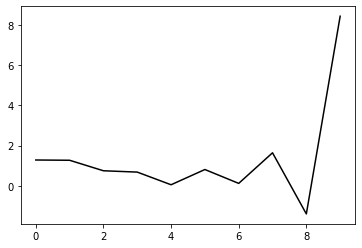

82500 26.65429534126599
0.8952630374690032 -0.951273794483082 -0.12640950812944757 -0.09016684746187585
[ 1.29956026  1.26410319  0.74492852  0.68059883  0.05576589  0.81806811
  0.13316092  1.6537296  -1.40242565  8.43668119]


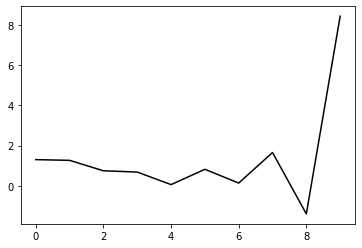

83600 24.680018559830838
0.8932748700992648 -0.9501741480619342 -0.12676012637399234 -0.08721705296732335
[ 1.23932724  1.33382116  0.81467684  0.74788423  0.12262546  0.88035967
  0.19064275  1.69743241 -1.37877028  8.39028085]


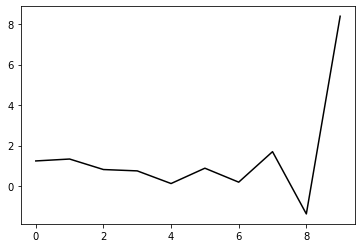

84700 13.094062724077752
0.8803087035985322 -0.9523506649507683 -0.1268478571398204 -0.0886844623595289
[ 1.27714784  1.30307145  0.78390531  0.7141214   0.08717256  0.83791301
  0.14002622  1.62897477 -1.46833608  8.42341352]


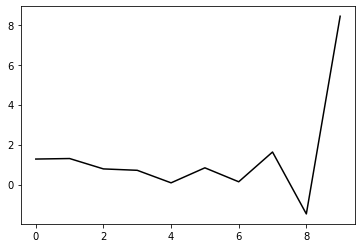

85800 22.646713653629085
0.8875623083193489 -0.9498141892855354 -0.1268321409865042 -0.08967632776782414
[ 1.24146391  1.37527189  0.8671997   0.80856821  0.19913091  0.96937904
  0.29651716  1.80200451 -1.29911606  8.43214691]


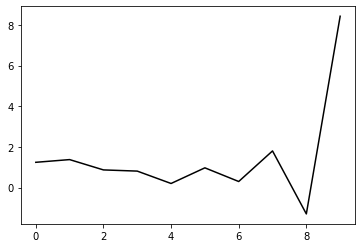

86900 29.52740629543511
0.8708561704987081 -0.955703849837257 -0.13100732313150792 -0.08486601665719844
[ 1.23979632  1.36184579  0.84934484  0.78154041  0.16243268  0.91308227
  0.21496715  1.67812984 -1.46538463  8.44002287]


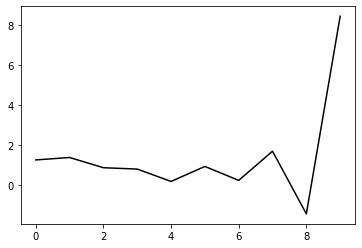

88000 17.38491413139279
0.88048493312026 -0.9454389749460679 -0.12542253114406127 -0.0850083250021221
[ 1.2346922   1.39819978  0.87802897  0.79980545  0.17148585  0.90852878
  0.19676741  1.64081292 -1.52055549  8.40292201]


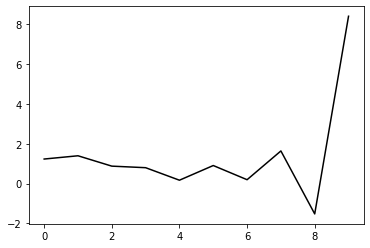

89100 22.051182318508705
0.8826677377516078 -0.9447774787348302 -0.12559482267958452 -0.08647947153695253
[ 1.22817054  1.43044683  0.9163887   0.84287693  0.22297311  0.96824501
  0.26896379  1.72488178 -1.42746978  8.42788357]


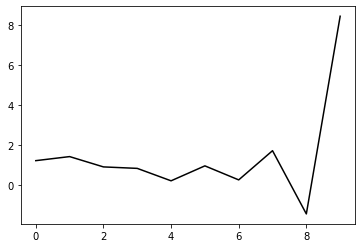

90200 22.651645178480624
0.8794889905823601 -0.9432469100714402 -0.12429070993921834 -0.08722637569277726
[ 1.26281222  1.39180672  0.8781251   0.80173975  0.18070018  0.92014749
  0.21568836  1.66013242 -1.50349987  8.39377528]


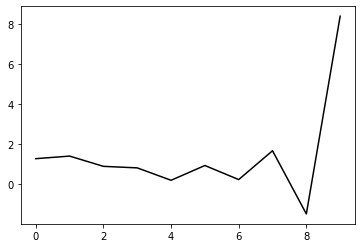

91300 20.536002000655714
0.8682517572258684 -0.9478861032677746 -0.12732480264525664 -0.08616210315145927
[ 1.2712834   1.37917551  0.8746985   0.8051004   0.19457459  0.94181214
  0.24851509  1.69974896 -1.46031972  8.44899966]


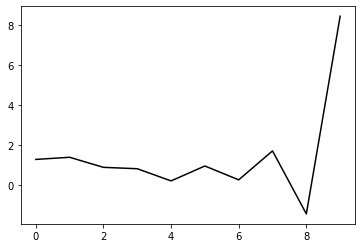

92400 16.05149798110391
0.8595636645051891 -0.9433412068191765 -0.12420564760796647 -0.0836081033463405
[ 1.26414819  1.37992193  0.86752186  0.78513827  0.16132249  0.88560609
  0.16353693  1.56519108 -1.65571499  8.41725391]


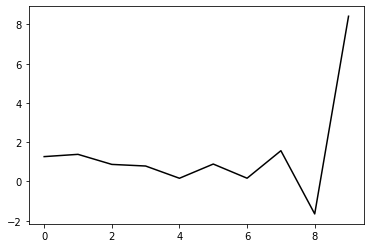

93500 23.482916853082482
0.8631147920184681 -0.9428939903065812 -0.12497966584277494 -0.08555863701700042
[ 1.24415635  1.43945851  0.93543807  0.86014129  0.24720702  0.98157524
  0.27186007  1.68129788 -1.53662734  8.39186748]


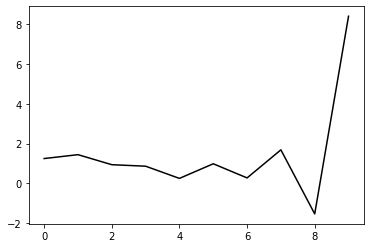

94600 26.411735249646696
0.8459954711955218 -0.9447122590937825 -0.12637766066256434 -0.08143195297441104
[ 1.28203502  1.39473267  0.88734505  0.80554518  0.18741244  0.91201355
  0.193387    1.58809777 -1.64723596  8.39090911]


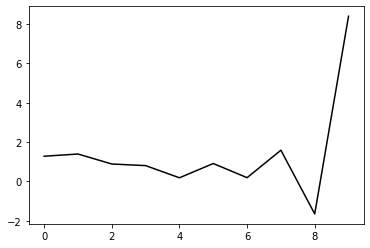

95700 16.728833151156003
0.8585716064383178 -0.9395302376389407 -0.12327966983856058 -0.08832986610842158
[ 1.31720976  1.4058543   0.90884011  0.83724774  0.23407264  0.97526455
  0.27856514  1.69724713 -1.51378173  8.44221414]


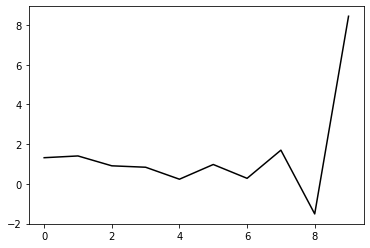

96800 22.892170417732146
0.8514121681572551 -0.9393015807329123 -0.12288202034740903 -0.08676321367876183
[ 1.27188689  1.43778311  0.93319634  0.84909856  0.23302079  0.95284845
  0.23092548  1.61156039 -1.63986757  8.38007179]


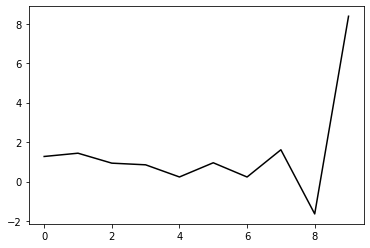

97900 26.65618764185034
0.8340027317130212 -0.9490395329227813 -0.130016297874594 -0.08417644163657122
[ 1.25936158  1.46225422  0.96716751  0.89015272  0.28433161  1.01037625
  0.2940163   1.66905405 -1.59124923  8.39259571]


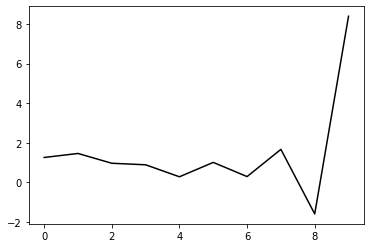

99000 18.758492914496035
0.8311460167334657 -0.944231614149182 -0.127636978778078 -0.08277500931937988
[ 1.24577373  1.48724054  0.97905022  0.88376734  0.25809945  0.95396758
  0.20088474  1.52387957 -1.78423792  8.34850419]


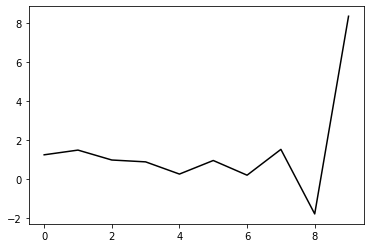

100100 22.524909865376493
0.8311452231388823 -0.939448219751182 -0.12383576167929106 -0.0873017814945817
[ 1.30444074  1.4473362   0.93876535  0.84025045  0.21308075  0.90427364
  0.14878057  1.46976622 -1.83090371  8.34929834]


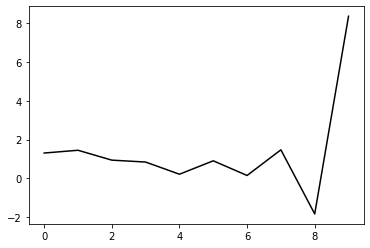

101200 22.943857902786313
0.8398933830844483 -0.9375907172707062 -0.1249854177218835 -0.08645520985153259
[ 1.27110723  1.5180978   1.01841734  0.92769497  0.31308138  1.01686947
  0.27758234  1.60942853 -1.69052306  8.39791742]


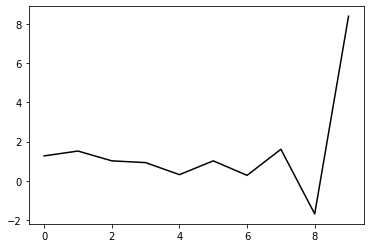

102300 21.18698156805199
0.8388282325109044 -0.9363022452173163 -0.12484213821649291 -0.08523031987500004
[ 1.26318274  1.52226296  1.02744573  0.93837506  0.32917688  1.0350065
  0.30064344  1.63159774 -1.67316143  8.377481  ]


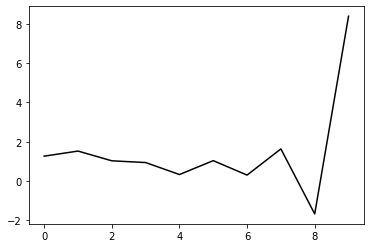

103400 25.369151602042567
0.8297349696943473 -0.9362522944763282 -0.12373970554481283 -0.0875420525507686
[ 1.35218724  1.44867372  0.95636724  0.86601252  0.25858786  0.9612237
  0.22486412  1.5455259  -1.7667952   8.39805798]


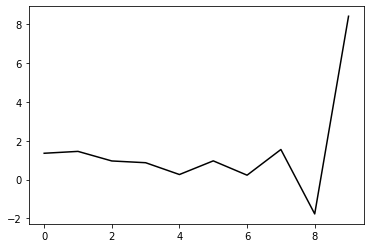

104500 22.035648667278387
0.8198286826195891 -0.9380436460724562 -0.12611851654196923 -0.08360435586866338
[ 1.26495424  1.5405338   1.04073362  0.93797191  0.31681276  0.99623846
  0.22943227  1.50029078 -1.86994224  8.38264688]


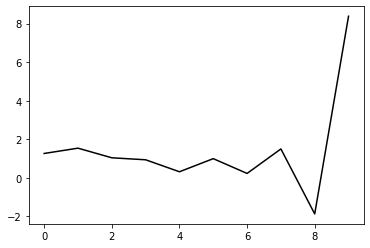

105600 27.40730656669039
0.8266685327917925 -0.9359375116908917 -0.1257564208152379 -0.08615936131113745
[ 1.24088471  1.62103372  1.13000406  1.03551393  0.42819719  1.12255652
  0.37471649  1.65899861 -1.70840885  8.38096122]


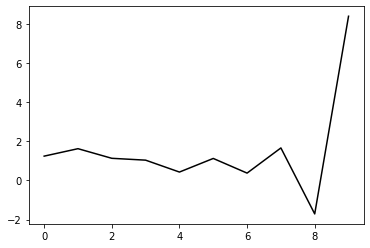

106700 16.679012558728754
0.8249493236505029 -0.9342850873422972 -0.12395054770214933 -0.08987224774970226
[ 1.32153244  1.55518774  1.07266783  0.9845657   0.38827426  1.09283216
  0.36018383  1.65771388 -1.69765777  8.39524958]


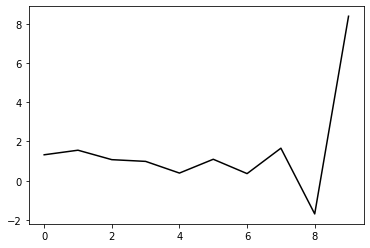

107800 22.62556676595693
0.8192211843033153 -0.9349694179943395 -0.12490065960808136 -0.08755584339078269
[ 1.252017    1.61559681  1.12941724  1.03234144  0.42700812  1.11323165
  0.35744064  1.61559344 -1.78299513  8.33545596]


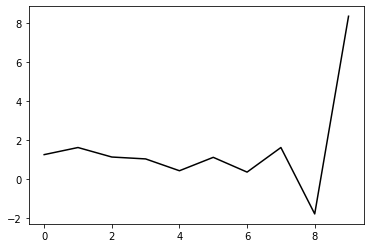

108900 14.379705710577568
0.8121602230334376 -0.9363228747782255 -0.12581481973460604 -0.08712848010329899
[ 1.30162142  1.57545707  1.09281637  0.99598146  0.39392738  1.07956492
  0.32554411  1.580518   -1.81902112  8.38422834]


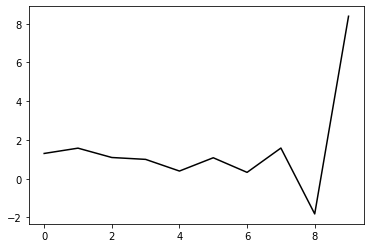

110000 16.842517869983688
0.803768791675695 -0.9384966165806524 -0.1276570219260544 -0.08484486582505346
[ 1.27775349  1.60331967  1.12308132  1.02487611  0.42365469  1.10485362
  0.34597211  1.58468653 -1.83736045  8.32829946]


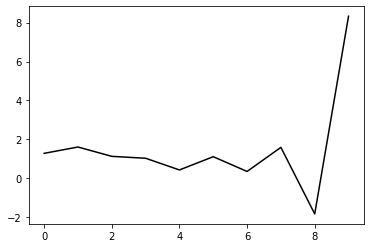

111100 25.32360343131834
0.7977252907552088 -0.9369628225700308 -0.1255116815240323 -0.08816896623094822
[ 1.34606742  1.54007511  1.05798909  0.95464291  0.3514795   1.02709997
  0.26536733  1.49656688 -1.92856557  8.36801543]


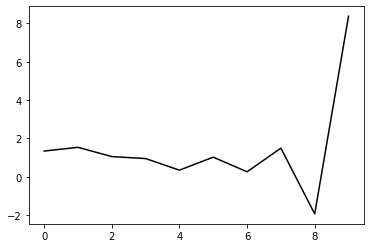

112200 23.01579425636579
0.8079458768398319 -0.9314351996295569 -0.12415313680472818 -0.08558330732020746
[ 1.26476707  1.66313736  1.18173029  1.07568098  0.47211921  1.14230756
  0.37403014  1.58755625 -1.86171564  8.36582155]


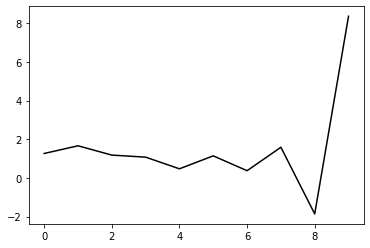

113300 21.390000057624057
0.7984600639474309 -0.9310029194818658 -0.12342110108001372 -0.08467641315452665
[ 1.26621224  1.6448318   1.16295771  1.05203328  0.44579436  1.10755542
  0.33172066  1.53016463 -1.934956    8.31464633]


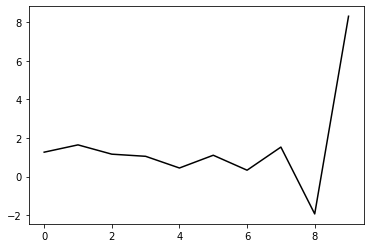

114400 21.30001765527196
0.7911376040074123 -0.9338419930107339 -0.12524740879735294 -0.08614001528824428
[ 1.2489139   1.69073113  1.21425986  1.105667    0.50438267  1.16739343
  0.39293941  1.58425253 -1.89310727  8.3745942 ]


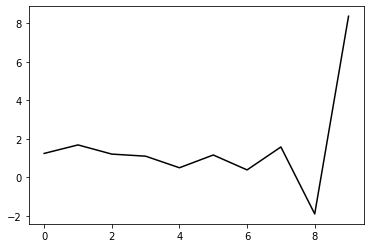

115500 22.800964282479253
0.7851896036054933 -0.9311517335145714 -0.12289937977882875 -0.08809718851159049
[ 1.29761595  1.64580454  1.17255955  1.0642449   0.46546084  1.12779994
  0.35448809  1.54330902 -1.936024    8.36269959]


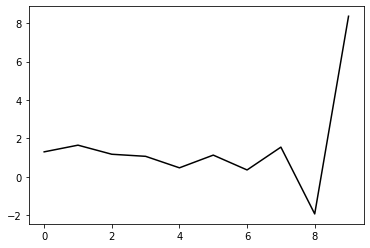

116600 28.76877723527006
0.7966353252574896 -0.9285631844804247 -0.1243898538051983 -0.08602524329856485
[ 1.23592826  1.75284313  1.2862512   1.18284983  0.59280869  1.26364689
  0.50300818  1.70417432 -1.76421338  8.38443883]


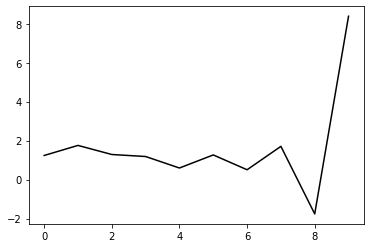

117700 17.640360976220368
0.7893433091923392 -0.9263464399858594 -0.121729086803856 -0.08893368263436209
[ 1.33826893  1.65557266  1.19111487  1.08624327  0.49739081  1.1659669
  0.4058551   1.60401511 -1.8651782   8.37301445]


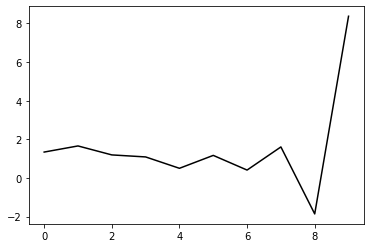

118800 23.133631830931883
0.7783383947721714 -0.9275555669192692 -0.12260066318077147 -0.08768516530902015
[ 1.28542712  1.69754396  1.22839433  1.11331186  0.51397308  1.16299779
  0.37925656  1.54044977 -1.9664842   8.33525723]


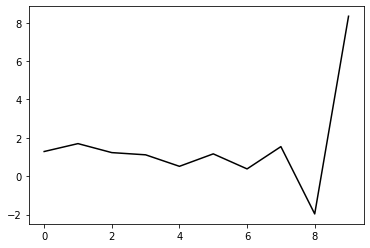

119900 13.932973944305349
0.7725495568900399 -0.9293945955143412 -0.12476583749799362 -0.08596170888289069
[ 1.28801335  1.70540638  1.24299402  1.13126732  0.53939988  1.19127645
  0.41073212  1.56413019 -1.95452005  8.36089212]


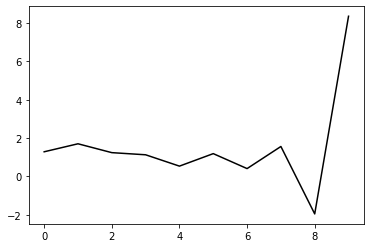

121000 17.813913656955624
0.7701629696273392 -0.9276335471517789 -0.12519977861642997 -0.08232381540613168
[ 1.27492272  1.73654906  1.27042392  1.15018908  0.55152236  1.18898458
  0.39180903  1.51352817 -2.04218138  8.28938264]


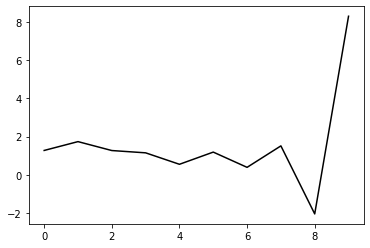

122100 22.231909445867334
0.7681143859482792 -0.9271261065694436 -0.12519113671379575 -0.08558295184491277
[ 1.30975202  1.71355668  1.25926717  1.14920348  0.56558936  1.21769811
  0.44082227  1.58277502 -1.95249103  8.3640821 ]


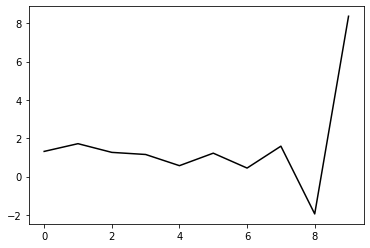

123200 23.20118074707537
0.761071856335515 -0.9222360398177037 -0.1212471121692573 -0.08490383808780083
[ 1.29695613  1.7110686   1.23967765  1.10486227  0.49438974  1.1082667
  0.28897649  1.37781567 -2.2028237   8.32472872]


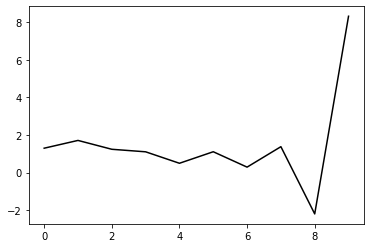

124300 23.878668705913917
0.7511917043948657 -0.9255369599766975 -0.12332682427410707 -0.08579766086916822
[ 1.30669529  1.70760834  1.23958363  1.1039375   0.49517586  1.10709119
  0.28910455  1.37801402 -2.19826662  8.29058617]


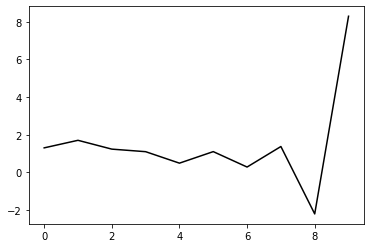

125400 18.07671439511469
0.7539645748584229 -0.9241296677647679 -0.12325411625674929 -0.08729227734946331
[ 1.33898073  1.72351146  1.26458931  1.13573689  0.53883696  1.1618052
  0.359783    1.46240804 -2.10241575  8.37755121]


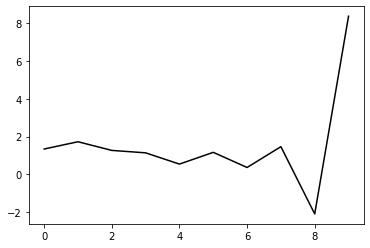

126500 22.1409726550422
0.7552003103209394 -0.9227593193102044 -0.12334967741400579 -0.08821746935663087
[ 1.29406152  1.80685087  1.35508202  1.23043853  0.64088678  1.26697575
  0.46776793  1.56405516 -2.01186483  8.31807972]


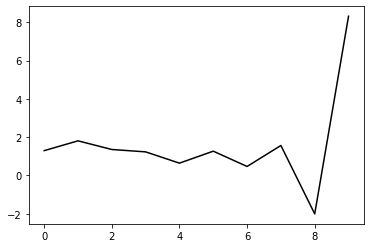

127600 26.656921294140712
0.751363758891361 -0.925780990609618 -0.12643637107639452 -0.0879759577637522
[ 1.26812511  1.8629491   1.41799447  1.29703191  0.7140117   1.34323237
  0.54702553  1.63767732 -1.95036126  8.37038985]


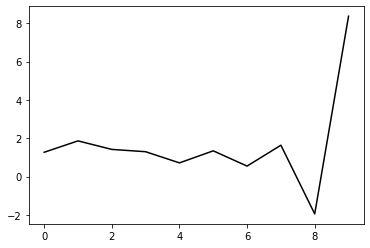

128700 17.172116581986607
0.752262331148259 -0.9197249713560881 -0.12209607656135678 -0.08912280213604738
[ 1.34764394  1.79028111  1.34223715  1.21384835  0.62662358  1.24785372
  0.44695305  1.53009145 -2.06133281  8.3088626 ]


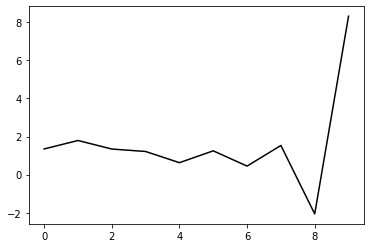

129800 25.137837508863246
0.7309318491418693 -0.9176359377319534 -0.1199129221719282 -0.08582023045195533
[ 1.31733092  1.7699881   1.30777956  1.15965905  0.55241026  1.14592844
  0.3153829   1.35957191 -2.27067873  8.31708678]


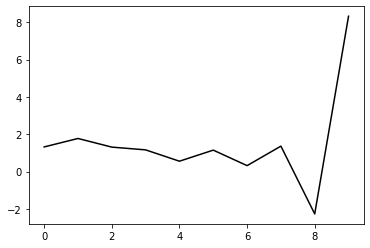

130900 14.200191034956978
0.747202295514715 -0.9175731537766102 -0.12255539293460586 -0.08773129127953638
[ 1.28301586  1.88982035  1.44577661  1.3137476   0.72635126  1.33780232
  0.52539646  1.58117025 -2.04349047  8.30397505]


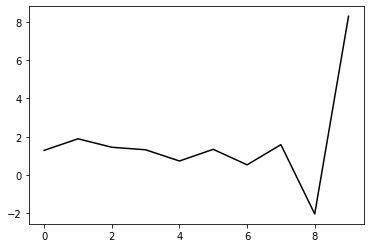

132000 20.2617540921793
0.7260913771668106 -0.9223826798611466 -0.12529421216413808 -0.08484973177857993
[ 1.33920406  1.78143785  1.32779333  1.17936996  0.5762621   1.16554019
  0.33379635  1.36892101 -2.26805672  8.3475009 ]


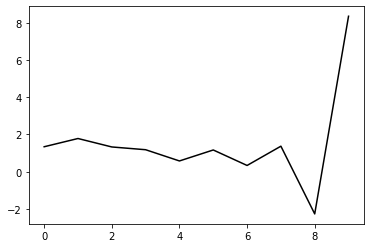

133100 21.60347442715959
0.7386271103749411 -0.915687709143216 -0.1224371616644069 -0.08596232856274766
[ 1.32382202  1.84887148  1.40236749  1.25792049  0.66187963  1.25490556
  0.42807244  1.46170293 -2.18012368  8.33763827]


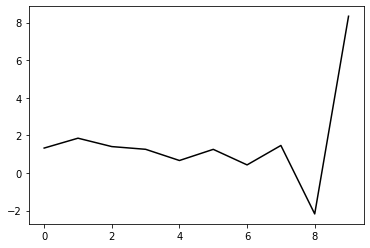

134200 22.440921044796795
0.7350166373717635 -0.9135571957510322 -0.12205750357213463 -0.08411679594030752
[ 1.29923421  1.87269847  1.42635895  1.27759205  0.67851034  1.26285314
  0.4266417   1.44147801 -2.22432139  8.30431147]


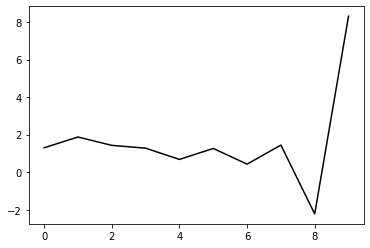

135300 21.31894947312094
0.7341746735121312 -0.9136484079920999 -0.12282529480599513 -0.08468703274559954
[ 1.28470404  1.91190592  1.47981959  1.34251777  0.75959649  1.35924018
  0.54308377  1.57620826 -2.07345058  8.35048568]


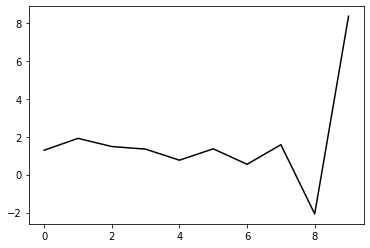

136400 14.369627148923358
0.7132204676654162 -0.9195611388130247 -0.1258323560595888 -0.08509693131380296
[ 1.33092475  1.86397643  1.43423167  1.29386027  0.70904355  1.30057805
  0.4779889   1.50324811 -2.14442354  8.33489659]


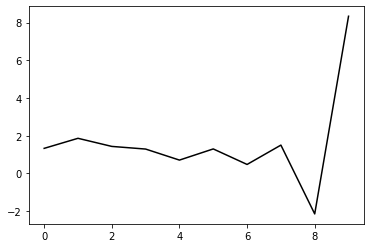

137500 21.642909364368606
0.7162078396604713 -0.9167088273178579 -0.12467342194169312 -0.08540386403461368
[ 1.31174256  1.90918437  1.47584911  1.32584336  0.73260304  1.30961413
  0.47374753  1.48159497 -2.17974294  8.34366101]


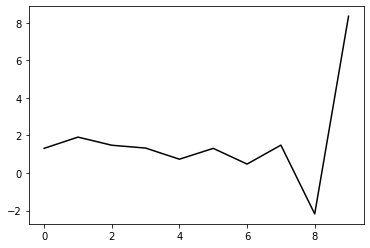

138600 27.93311831947628
0.7242607855268096 -0.9138241355062283 -0.12423242638873538 -0.08477743300805245
[ 1.26448456  2.00386578  1.57716876  1.4295583   0.84228062  1.41974373
  0.5832233   1.57958872 -2.09780089  8.32971376]


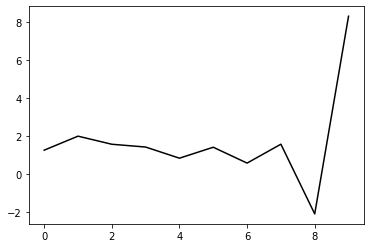

139700 14.05478676047474
0.7168327025287553 -0.9113279010702349 -0.12198148306522094 -0.0856220437340788
[ 1.33677301  1.93769744  1.50348421  1.34163667  0.74103208  1.29998326
  0.44902628  1.43193822 -2.24953115  8.28676591]


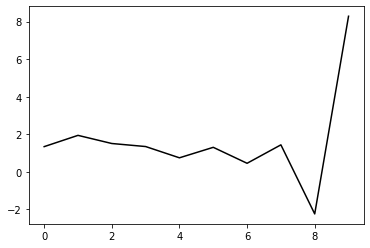

140800 24.757631752810976
0.7124563762867473 -0.9077707284899927 -0.1194435480132573 -0.08687593121859899
[ 1.32879823  1.9450778   1.50643641  1.33284365  0.7198276   1.25709089
  0.38189201  1.33077171 -2.38199369  8.29173509]


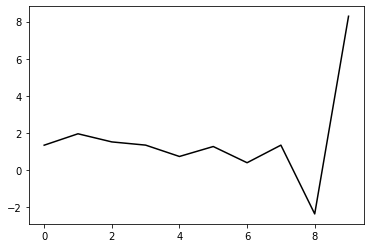

141900 13.504338487844949
0.722951482145997 -0.9061656473131472 -0.12053158414919439 -0.08594418993738888
[ 1.30919004  2.02915544  1.60636008  1.44652351  0.85274022  1.40924068
  0.55696745  1.52379944 -2.17880641  8.30858976]


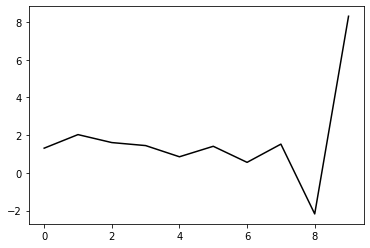

143000 18.79584561106551
0.7125611804568571 -0.9086318286287409 -0.1233075232826112 -0.08121909720494766
[ 1.28108579  2.02769683  1.60012743  1.42809004  0.82221731  1.35739248
  0.48226183  1.41543415 -2.31976519  8.2610544 ]


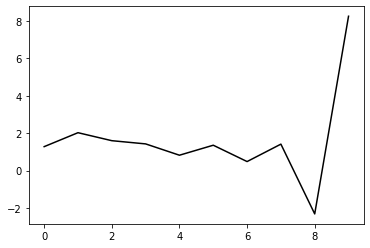

144100 21.071803119424455
0.7137550433044755 -0.9065089178769422 -0.12231448135592034 -0.08333401255837367
[ 1.30830306  2.01177227  1.59195278  1.42444374  0.82732323  1.36950547
  0.50614458  1.44903508 -2.27633139  8.3202527 ]


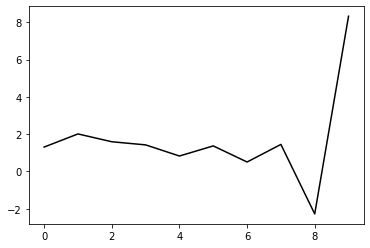

145200 30.662211353929326
0.70505865062688 -0.9052978306419542 -0.12077744578531419 -0.08468797001716417
[ 1.38373239  1.93185416  1.51696102  1.34977241  0.75658921  1.29883025
  0.43826177  1.37755377 -2.3537956   8.31198938]


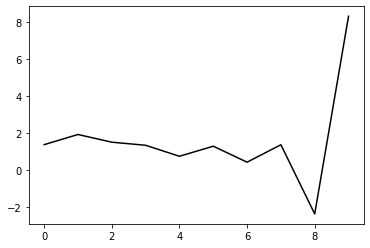

146300 20.516918318133868
0.6902613863365713 -0.9109368420725901 -0.12515180849794397 -0.08238019380667379
[ 1.32528308  1.99752806  1.58509407  1.41539981  0.82150367  1.35716112
  0.48903749  1.41173225 -2.33845319  8.31637975]


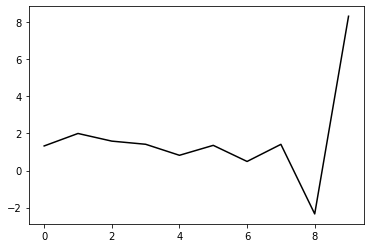

147400 17.549627390502504
0.7045076069901582 -0.9024545316489097 -0.12058656169649477 -0.08463288873138569
[ 1.36177053  2.01400713  1.61568987  1.45663233  0.87925307  1.42765514
  0.57299817  1.49912856 -2.25275053  8.30898976]


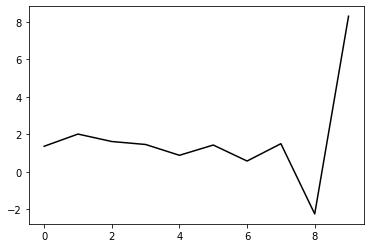

148500 35.200967172572064
0.6681793330832557 -0.9125646143231533 -0.12745142832806994 -0.07577419786864982
[ 1.30607652  1.96184361  1.54771364  1.36554942  0.7645157   1.27841118
  0.38732524  1.26863587 -2.52052674  8.26521253]


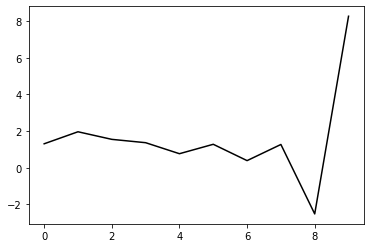

149600 24.864906441947543
0.6903452296895684 -0.9013915090456087 -0.12131701494468701 -0.08085114628709161
[ 1.30034398  2.05581586  1.64513388  1.46338684  0.86530148  1.38054597
  0.49287637  1.3754084  -2.41266831  8.26162557]


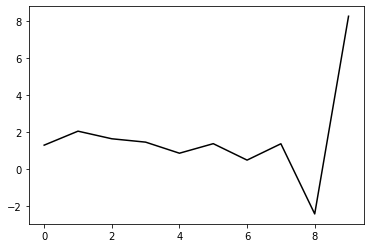

150700 17.754993125476005
0.6955707404259835 -0.898908622131374 -0.11979914180539478 -0.08549490460128867
[ 1.37414046  2.02645464  1.63450675  1.46864746  0.89089926  1.42559076
  0.5602149   1.46214761 -2.30958669  8.30796779]


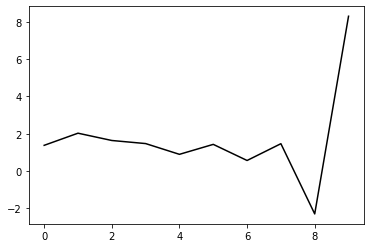

151800 22.808164945228828
0.6859410428431627 -0.901370587692493 -0.12172628707631543 -0.08328300453854193
[ 1.29050339  2.07685104  1.67153246  1.48462924  0.88436995  1.38908616
  0.49495595  1.36505321 -2.43148836  8.35329942]


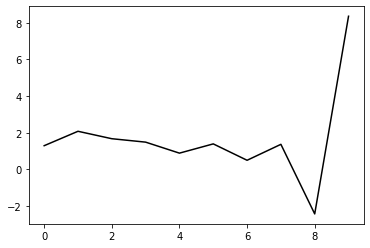

152900 14.2374930189663
0.6791671076232363 -0.9029510298553566 -0.1230522522081034 -0.08440709806438361
[ 1.30457684  2.0968765   1.70165065  1.52141054  0.93118203  1.44368595
  0.55949032  1.43517076 -2.35821656  8.30650149]


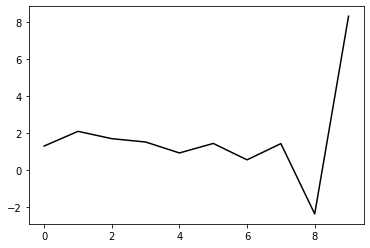

154000 17.38670158421089
0.6889347998946778 -0.8994067257250692 -0.12256667839706123 -0.08362612243074917
[ 1.28489193  2.15825985  1.76883375  1.59028264  1.00513495  1.51950164
  0.63891099  1.51209116 -2.2875805   8.28477722]


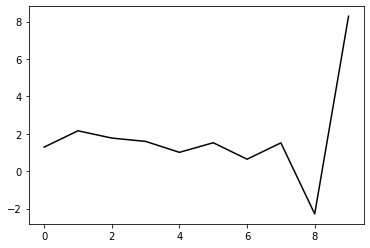

155100 22.638007519632886
0.6638357273857691 -0.9049817131132705 -0.12522242488235577 -0.0817881402946076
[ 1.34762257  2.03991013  1.64133084  1.44566811  0.84414993  1.33501717
  0.43377217  1.28287648 -2.53353609  8.28446839]


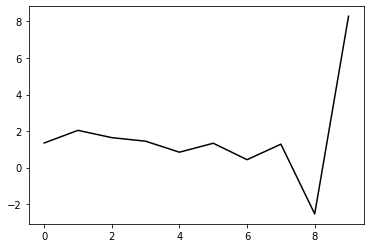

156200 22.917716264971506
0.6723644589070329 -0.8988878224025756 -0.12267549937604663 -0.08136846052290657
[ 1.31796519  2.12223039  1.72143522  1.51348883  0.8990887   1.36978078
  0.45299932  1.28541775 -2.54232662  8.27519791]


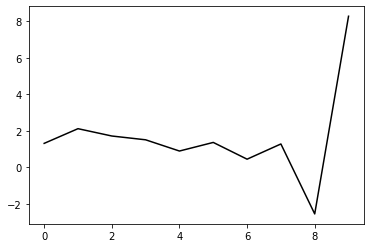

157300 21.584017199607487
0.6763978402392811 -0.8982010525799257 -0.12380832153495396 -0.08095678369809362
[ 1.31133547  2.16649012  1.78648492  1.59529513  1.0010328   1.48354285
  0.57289365  1.39632253 -2.44701209  8.26713267]


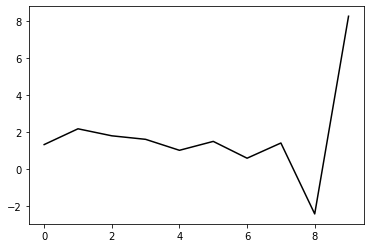

158400 15.389549444108116
0.6665844921321772 -0.896437751348342 -0.12194612794961929 -0.08291845585929236
[ 1.3661065   2.125489    1.74803697  1.55526875  0.96289278  1.44448023
  0.5366587   1.35871468 -2.48684045  8.27044984]


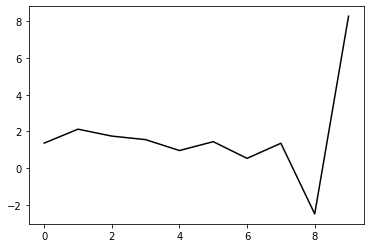

159500 22.064589187079775
0.6685958367158634 -0.8946936350240225 -0.12150450954787528 -0.08282527467026107
[ 1.33382355  2.17866152  1.80418452  1.60962984  1.01790159  1.49538707
  0.58360207  1.39185949 -2.47396168  8.27911751]


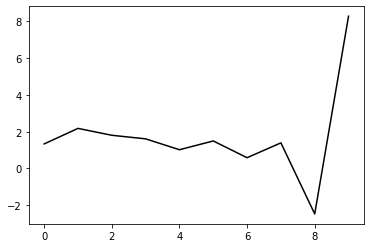

160600 24.26902890475044
0.6689245923632554 -0.8947428357078634 -0.12265002832135065 -0.08159464435075711
[ 1.32743725  2.19500923  1.82736344  1.63494499  1.04855961  1.52776323
  0.61982054  1.42580855 -2.44479293  8.25343849]


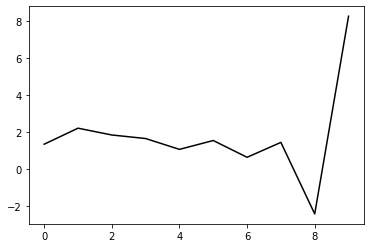

161700 18.459383521918404
0.6656931105543223 -0.8916220316517752 -0.11969882555936243 -0.08465346363681595
[ 1.3940195   2.14811593  1.77792518  1.57668252  0.98356449  1.45091495
  0.53475268  1.33074341 -2.54275847  8.28416526]


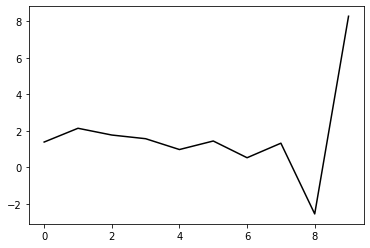

162800 23.617164538034157
0.657098812657457 -0.8940108159886642 -0.12159246439126321 -0.08373438105351973
[ 1.31897372  2.21477718  1.8413194   1.63004571  1.02679292  1.47705458
  0.54316671  1.31472092 -2.58171644  8.26428533]


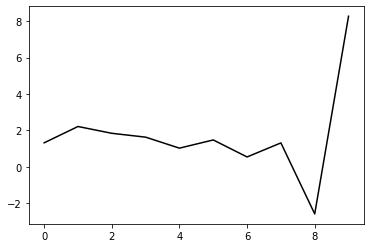

163900 14.043810953687887
0.6557948708095086 -0.8943236818493618 -0.12270846818859245 -0.08445544291889973
[ 1.31669462  2.25398041  1.89045473  1.68568404  1.09299843  1.55136889
  0.62773833  1.4035605  -2.49248606  8.26004033]


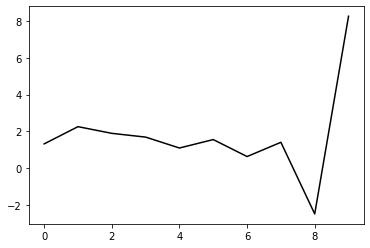

165000 15.998425108620099
0.6615594565719184 -0.8903613857636853 -0.12208120448425377 -0.08155155226164301
[ 1.31334127  2.27715847  1.91234386  1.70116053  1.10390453  1.55291198
  0.62073452  1.38099363 -2.53219853  8.26969206]


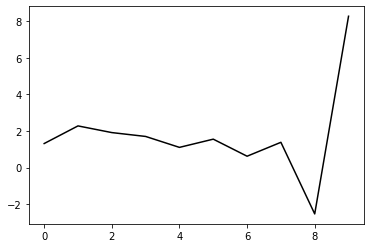

166100 20.965636300326562
0.6550679678705763 -0.8921382889554111 -0.12330754541309799 -0.08246030434831514
[ 1.33772099  2.24474254  1.89477875  1.69407737  1.1113252   1.57175822
  0.65328902  1.42095398 -2.48855038  8.31349138]


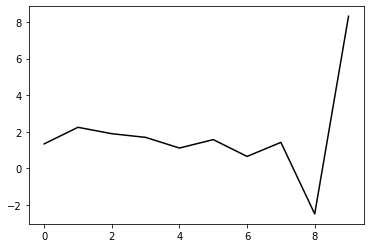

167200 25.063018757911465
0.6466783696009739 -0.8904150371067912 -0.1217713804241081 -0.08230890381619992
[ 1.38354935  2.18728861  1.83828511  1.63235717  1.04705577  1.49925849
  0.57478137  1.3296164  -2.59172605  8.25370354]


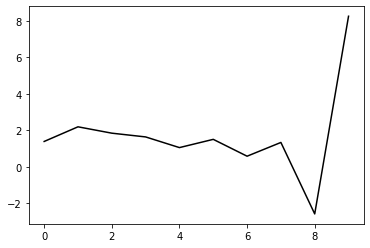

168300 22.164047854989857
0.6298145900266225 -0.8942539162417076 -0.1248167184589478 -0.0763556851896536
[ 1.34767708  2.18012677  1.8085089   1.57114671  0.952879    1.36514417
  0.4035798   1.11913706 -2.83546076  8.22451325]


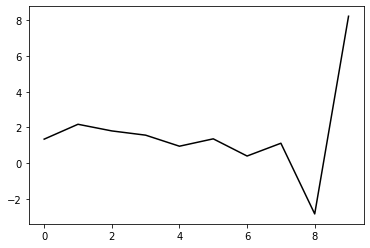

169400 14.97969344231448
0.6396722133809603 -0.8888136871693819 -0.1216671191396618 -0.08204823874225105
[ 1.32591783  2.28421255  1.93669893  1.71945342  1.12357501  1.55110973
  0.60059149  1.3153361  -2.64519992  8.30552375]


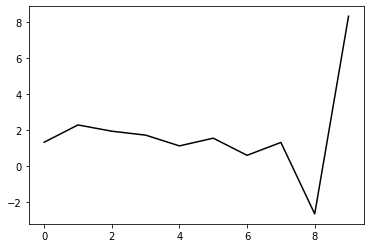

170500 22.50104997526029
0.6401987076754587 -0.8871229335658336 -0.12061734786932468 -0.08329936396956605
[ 1.34382932  2.29006277  1.94605987  1.72593685  1.13029165  1.55475511
  0.60542681  1.31917501 -2.64028629  8.24841269]


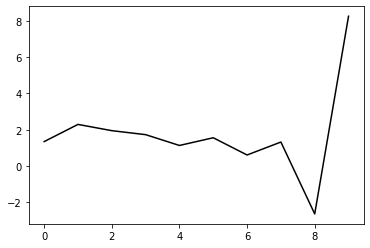

171600 27.28558609717725
0.6456001122396826 -0.8859875971699749 -0.12156190272869445 -0.08159748408728167
[ 1.28623265  2.36546421  2.02972789  1.81148503  1.22011782  1.64295774
  0.69247541  1.3962999  -2.57643984  8.26797933]


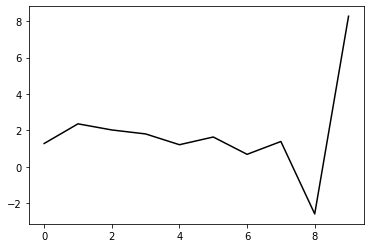

172700 15.122918439746062
0.6345547877389598 -0.8871695242009411 -0.12106185063911867 -0.08444446962219412
[ 1.37007817  2.28965571  1.95893319  1.74004821  1.1514857   1.57376056
  0.62648755  1.33056422 -2.63923675  8.22499375]


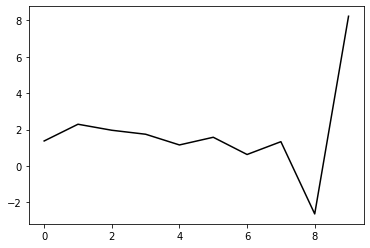

173800 23.779729459386758
0.6277011643151523 -0.8877894206237315 -0.12170060831866476 -0.08358609171690017
[ 1.32602833  2.29818284  1.95923135  1.72339641  1.11782344  1.51553958
  0.54558258  1.2217777  -2.77173299  8.25025934]


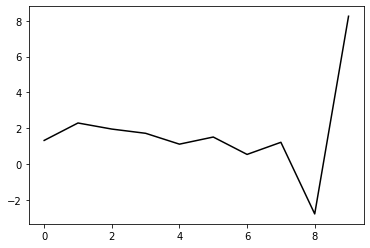

174900 20.54103610059747
0.6182882274945423 -0.8923966887339376 -0.12632092333393669 -0.07918675827881766
[ 1.33173895  2.28264235  1.94283784  1.70074857  1.09204929  1.48441484
  0.51284444  1.1850664  -2.81057407  8.22383303]


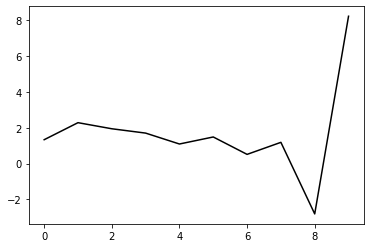

176000 16.1795586149306
0.634744745554303 -0.8842916177298976 -0.12239368470903741 -0.0817837720083867
[ 1.31442237  2.41356021  2.08216042  1.84084454  1.23308294  1.62119036
  0.64589515  1.31005444 -2.69359025  8.26468068]


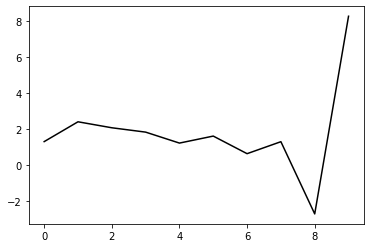

177100 23.272238345394964
0.6194327614393116 -0.8864004456300475 -0.1230584145306715 -0.08200579829511402
[ 1.38034955  2.30379013  1.9704996   1.72081926  1.10767498  1.48702947
  0.50707692  1.1647894  -2.84178142  8.21802361]


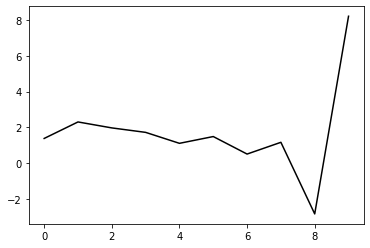

178200 23.443222824152276
0.6333719486976601 -0.881793281457113 -0.12224095729923139 -0.08072439915594373
[ 1.31256374  2.42373108  2.09652266  1.84545487  1.23186005  1.60453662
  0.61814804  1.26218507 -2.75979261  8.27456668]


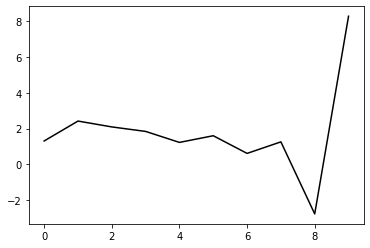

179300 25.692752718871418
0.613600009737944 -0.8809493623343005 -0.11990789365665178 -0.08284750778363496
[ 1.37324428  2.31421892  1.97814548  1.71090816  1.0827062   1.43613102
  0.43436649  1.06140385 -2.9717903   8.21713277]


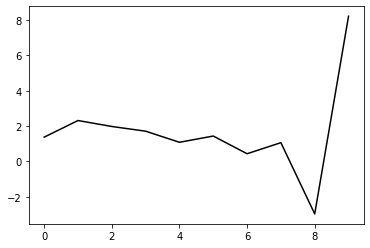

180400 15.33059400754118
0.623869767813793 -0.8792097724224905 -0.12073266252517778 -0.08331657307277346
[ 1.3701604   2.38812395  2.07492443  1.82504871  1.21730269  1.58679157
  0.6017589   1.23761906 -2.79121908  8.21835232]


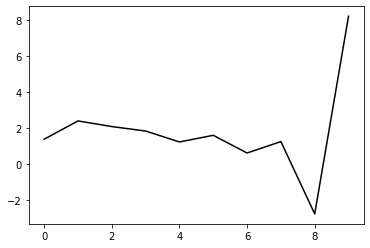

181500 22.373696076862107
0.6174205329595742 -0.88185293098331 -0.12278259502219724 -0.0833766312158144
[ 1.33516143  2.42993002  2.12991223  1.8876495   1.29143211  1.66819258
  0.69257083  1.32999594 -2.70146664  8.28100018]


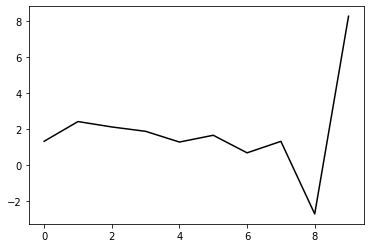

182600 26.30477084169025
0.6191886853940661 -0.8813350054662784 -0.12364090530576341 -0.0811837634704386
[ 1.30598495  2.49574008  2.18435884  1.91949588  1.29889042  1.64329394
  0.63798834  1.24309113 -2.81341675  8.25160473]


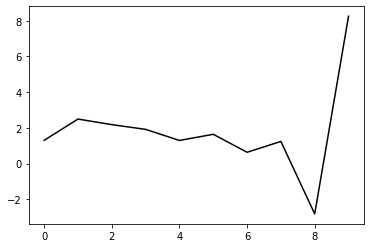

183700 18.172848216892888
0.5877442842227508 -0.87760922537914 -0.11836217312566222 -0.0853778601951416
[ 1.38967207  2.31591734  1.97765108  1.68037361  1.02999971  1.34340105
  0.3140004   0.89742366 -3.1738519   8.18919378]


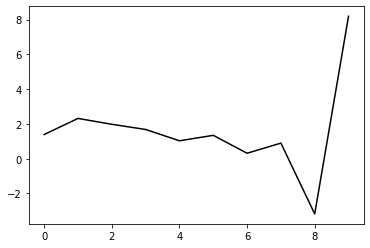

184800 24.491961593185497
0.6095949886324264 -0.87482839486423 -0.12001934360828823 -0.08620518852077004
[ 1.36213933  2.47311001  2.15023587  1.86266657  1.22207566  1.54158158
  0.51816556  1.10392836 -2.96618047  8.19096152]


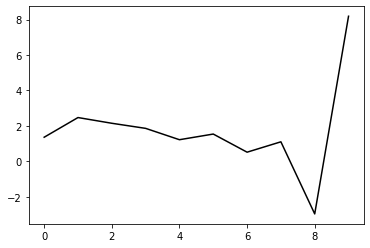

185900 14.727992348711036
0.6201470075343309 -0.8744394407822254 -0.12219871213815765 -0.08499500683331074
[ 1.31625155  2.55577305  2.24389425  1.96146027  1.32738001  1.64947937
  0.62887929  1.21204692 -2.8643285   8.23395835]


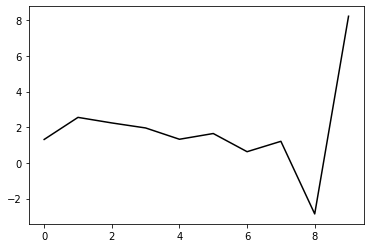

187000 16.055108175968954
0.620467370951606 -0.8736369562284504 -0.12296417625614059 -0.08314638644417173
[ 1.31500471  2.55183117  2.25030042  1.97207031  1.34489537  1.66909533
  0.65169208  1.2299694  -2.85517911  8.21477567]


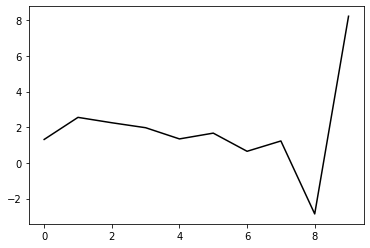

188100 20.858812104043473
0.6101826484080197 -0.8770611192046422 -0.12522096289875045 -0.08200399596422776
[ 1.32311716  2.49772455  2.20633755  1.93207151  1.31276119  1.64077449
  0.63030939  1.20888412 -2.87751508  8.26717552]


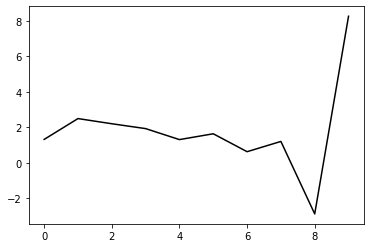

189200 32.691381274595855
0.6021861292405356 -0.8732130777527916 -0.1218668200060869 -0.08443783683011132
[ 1.43405309  2.38006735  2.09189135  1.81574057  1.19909978  1.52634823
  0.51917663  1.09375037 -2.99899741  8.231602  ]


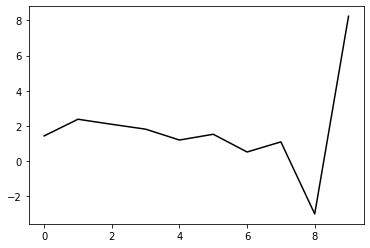

190300 25.729153347986557
0.593302244713975 -0.8697798045149482 -0.11996544634492261 -0.08162839083912472
[ 1.37199362  2.41368777  2.10308096  1.79612747  1.14770809  1.43773008
  0.39566838  0.93307886 -3.19383586  8.20456372]


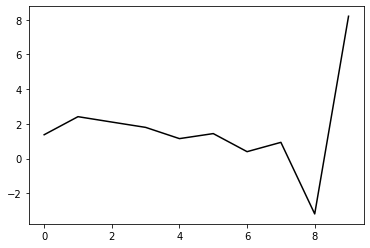

191400 14.511742883335062
0.6104769081964785 -0.8671580199921126 -0.12118635700173087 -0.08141078021847317
[ 1.36597136  2.50766653  2.21702703  1.92403998  1.29100424  1.59262137
  0.56267362  1.10718203 -3.01494653  8.18591727]


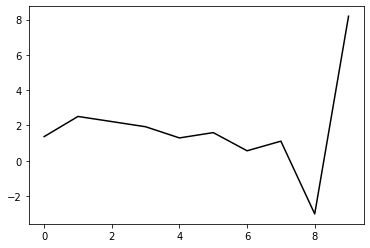

192500 22.069221933109038
0.5870765339270387 -0.8743237454187603 -0.1252034564550438 -0.08114542518470516
[ 1.3656337   2.4360174   2.13253231  1.82046149  1.17155117  1.45641781
  0.41659621  0.95219353 -3.17429923  8.19451976]


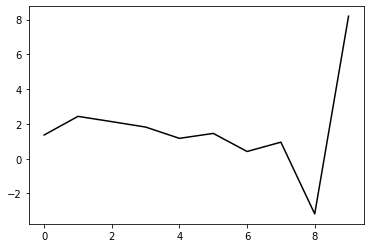

193600 25.790008579394495
0.6122388275662758 -0.8654999325100244 -0.12219253552359184 -0.0822294773449847
[ 1.30058435  2.61853534  2.33118129  2.02767831  1.38718084  1.673698
  0.63378997  1.16082523 -2.97813199  8.17577006]


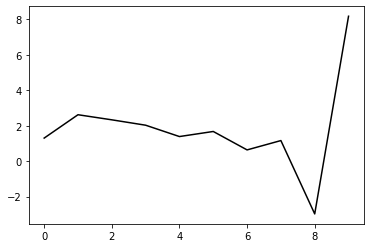

194700 17.480285209501034
0.5977054073050049 -0.8649328231101424 -0.12037466638570966 -0.08541852466360954
[ 1.39880741  2.51907203  2.23373649  1.92595542  1.28404105  1.56755863
  0.53015699  1.05973595 -3.07295232  8.20774157]


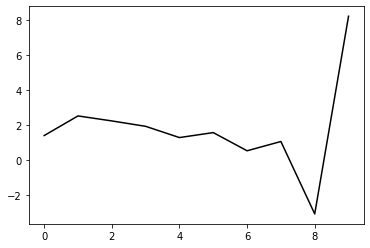

195800 22.06397031056361
0.6024639509349592 -0.8654844722566437 -0.12200407674906949 -0.08600424545124402
[ 1.34022457  2.61527001  2.33754383  2.02903103  1.38651826  1.66387578
  0.62119354  1.1408079  -3.0019688   8.23099543]


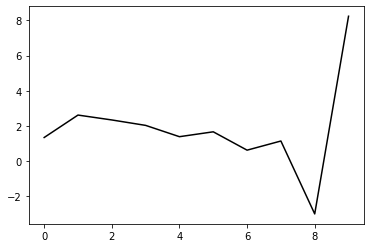

196900 30.68093433953988
0.5941897923674284 -0.8717561385051995 -0.12756815428336468 -0.08000635323154967
[ 1.30839199  2.57403507  2.28894883  1.96440032  1.30810572  1.56798789
  0.51339587  1.01874985 -3.13464267  8.14988705]


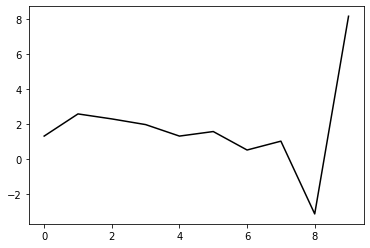

198000 16.096230142240113
0.6034749972946042 -0.864948819489367 -0.12374238007491722 -0.0831760417249846
[ 1.32248354  2.66452812  2.39124687  2.07044273  1.41880308  1.67840425
  0.62453452  1.12570151 -3.03265376  8.20580425]


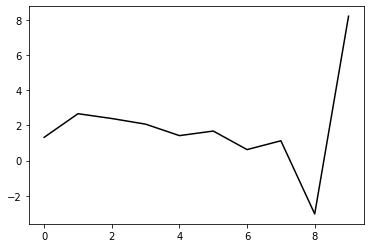

199100 21.161503979168153
0.6003881514029134 -0.8636009588711868 -0.12295120090274833 -0.08470109695298163
[ 1.39167655  2.58546961  2.32990167  2.02081321  1.38516435  1.65577429
  0.61431661  1.11936245 -3.03853081  8.15304806]


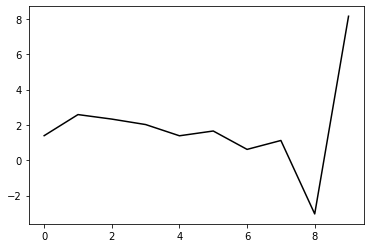

200200 29.196553971038135
0.5837898820777854 -0.8606645473337283 -0.12017685452092275 -0.08496166103805985
[ 1.39106921  2.50605581  2.23835797  1.91159309  1.26097117  1.51220629
  0.45459266  0.93708167 -3.24341231  8.15245981]


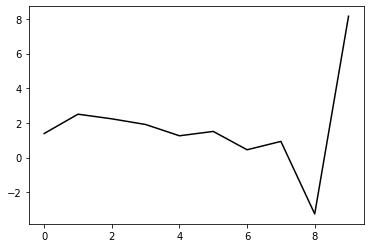

201300 20.66999353052155
0.5917347220029752 -0.8632480595737383 -0.12486850325080104 -0.08152406401948824
[ 1.35081618  2.62844975  2.38273765  2.07061328  1.43441615  1.69390587
  0.6432164   1.12508207 -3.05903213  8.20442355]


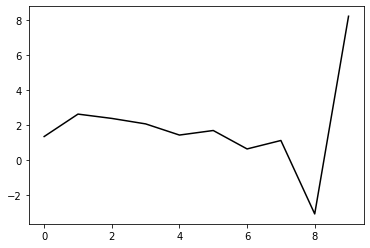

202400 21.91005582095803
0.5746637210203074 -0.8671773255063392 -0.12735561272476312 -0.07870420722780043
[ 1.3551094   2.53698282  2.26828717  1.92709631  1.26719659  1.50420778
  0.43999854  0.91054414 -3.27984463  8.15809419]


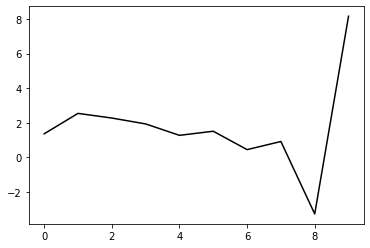

203500 23.783080058649027
0.596921036617058 -0.8575449454355837 -0.12284839747389877 -0.08304515470987137
[ 1.32746847  2.70998687  2.46800061  2.1451163   1.50214785  1.7483208
  0.69018543  1.15763137 -3.04085644  8.22297909]


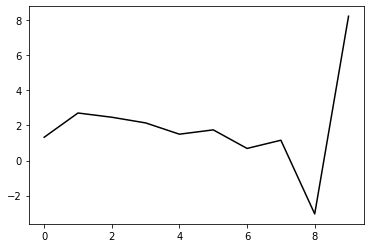

204600 25.433999057959877
0.5864083138020668 -0.8594063454157147 -0.12427058135690867 -0.08114282224706443
[ 1.37178914  2.62127727  2.37789616  2.04712929  1.39951851  1.63777035
  0.5764103   1.03662228 -3.16728105  8.16074991]


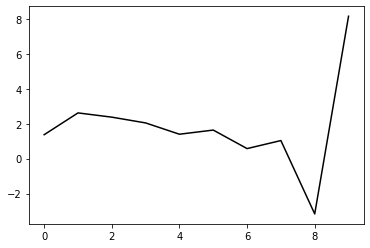

205700 16.0766943794649
0.5887361451124306 -0.8553767540483878 -0.12179550831073133 -0.0841802582724707
[ 1.40213775  2.63571403  2.39703222  2.06330418  1.41429864  1.64838587
  0.58719395  1.04681695 -3.1545612   8.2231788 ]


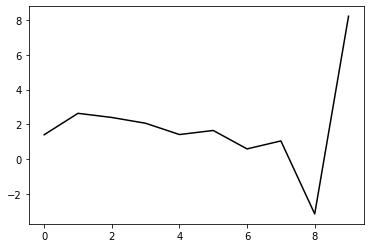

206800 23.268286721612526
0.5879041833452285 -0.8572323567193637 -0.12384102399691012 -0.08398941499586354
[ 1.34494078  2.69583873  2.46887594  2.13867758  1.4947728   1.72774333
  0.66621919  1.11770019 -3.09434578  8.20407603]


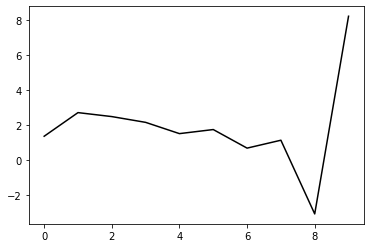

207900 14.604884414300148
0.5816867392743498 -0.8562020646140345 -0.12343293469473743 -0.08271321987864606
[ 1.33994955  2.65641475  2.41693957  2.06586728  1.4027716   1.61093525
  0.5282378   0.95203339 -3.28585985  8.18909182]


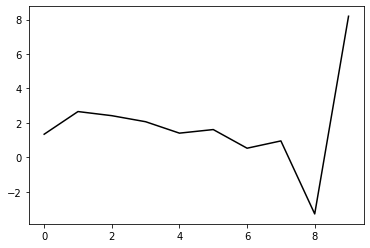

209000 19.32398824057496
0.5890979783599801 -0.8574230566009725 -0.1269650921781958 -0.07899759825072755
[ 1.3311586   2.68108349  2.45675461  2.11474432  1.46355216  1.68021952
  0.60857723  1.03761325 -3.19727847  8.1432392 ]


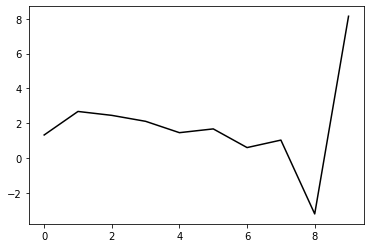

210100 20.924833924985336
0.5901099017228405 -0.8518870497196177 -0.12360558316785737 -0.08023685918804777
[ 1.32152295  2.73840181  2.49984394  2.13625415  1.46354443  1.65537408
  0.56246703  0.96916508 -3.28412582  8.17979804]


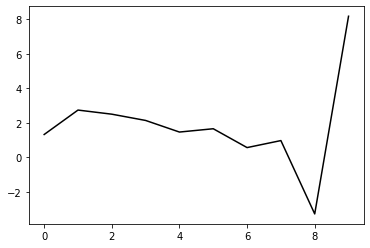

211200 22.387941635196995
0.5784506874387424 -0.8541647094472652 -0.12382732961290852 -0.08318763442430543
[ 1.36449789  2.65539184  2.41238059  2.04024177  1.36457234  1.55517234
  0.46764965  0.88012811 -3.36497257  8.1411983 ]


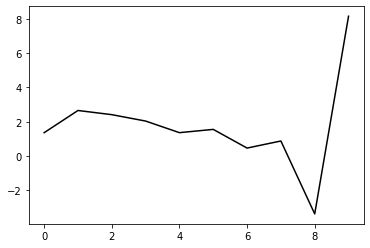

212300 22.891079032280235
0.5804772571560477 -0.8526122831370142 -0.12339493727033422 -0.08479475104015476
[ 1.3545268   2.69241543  2.45903029  2.09092053  1.42185964  1.61684898
  0.53649113  0.9525982  -3.28952729  8.17487089]


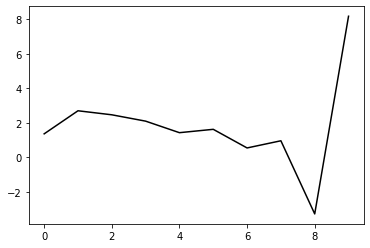

213400 14.736472044220063
0.5854335530232522 -0.8506607396775141 -0.12314063840915941 -0.08448613871425874
[ 1.38237934  2.70538672  2.49111782  2.13530833  1.48030767  1.684369
  0.61353986  1.03206478 -3.21063313  8.14279881]


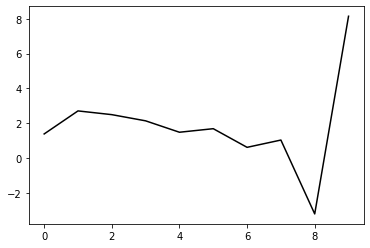

214500 25.658920681179843
0.5736459688864638 -0.8512823382635817 -0.12278060623984417 -0.08559354115203821
[ 1.38845955  2.66202906  2.45143586  2.09251531  1.43584538  1.6331671
  0.55741314  0.96434596 -3.2909034   8.15954773]


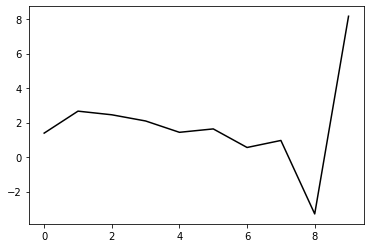

215600 25.26369510360323
0.5793626681484993 -0.850679184391525 -0.12469529953223267 -0.08238361935404538
[ 1.32531177  2.75305541  2.54522144  2.18362156  1.52547312  1.71686977
  0.63568322  1.02907962 -3.24367761  8.11982689]


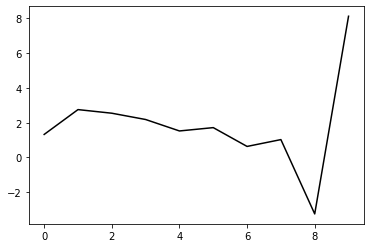

216700 13.18332620211039
0.5678511849609474 -0.8522030344263978 -0.1254635619924738 -0.0837096292989718
[ 1.38048484  2.67500908  2.46599417  2.09823683  1.43616813  1.62212358
  0.53954716  0.93049009 -3.34249185  8.17509079]


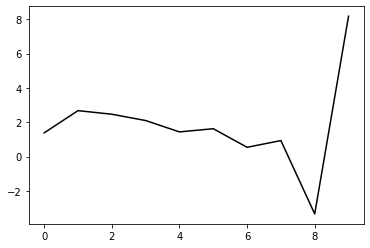

217800 24.89603604259862
0.5762307863417353 -0.8464285336786778 -0.12251163144060818 -0.08697385109970465
[ 1.38589483  2.74711572  2.55462377  2.19765615  1.54821334  1.74290602
  0.6696875   1.0635904  -3.2104199   8.13842069]


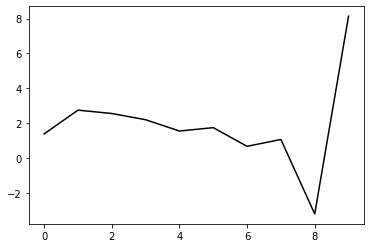

218900 17.220816742274923
0.5711664420618756 -0.8499332986717214 -0.12645502769044337 -0.08178077905986825
[ 1.33624487  2.7318355   2.53156612  2.15941909  1.49690706  1.6740862
  0.58700516  0.96145016 -3.33081048  8.16185401]


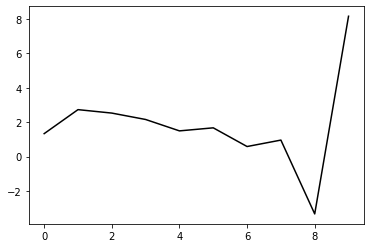

220000 16.109528005179254
0.5783106564789264 -0.8453030782635669 -0.12431525741165256 -0.08325697282962856
[ 1.32435792  2.81492914  2.6268514   2.25935533  1.60245214  1.77961573
  0.69313605  1.06131617 -3.23898549  8.17683911]


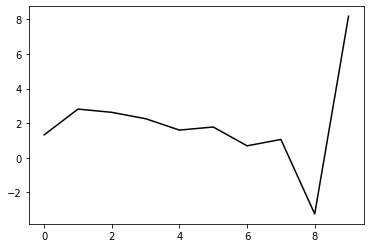

221100 23.155758775728465
0.5655078658112 -0.8489619676226742 -0.1259710330005584 -0.08418654012028201
[ 1.41247094  2.66568659  2.49012346  2.13053072  1.48749792  1.67680441
  0.60753486  0.98771154 -3.30150168  8.21226964]


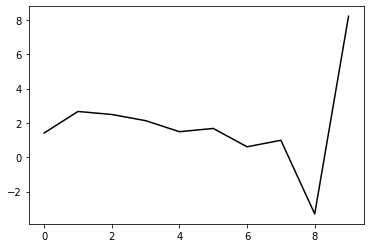

222200 25.290720269733892
0.5623008052960504 -0.8469737014495056 -0.12527279219254053 -0.08323693932354966
[ 1.41893765  2.63720912  2.45927649  2.09069762  1.44051765  1.61802341
  0.54010877  0.90585343 -3.39729734  8.17701862]


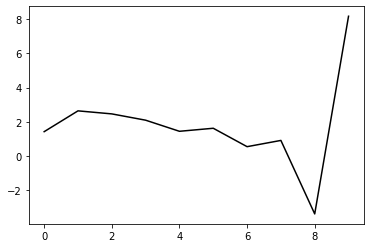

223300 26.404786274785575
0.5618569958903264 -0.8408347847460004 -0.12137147731207096 -0.08406182296744469
[ 1.3947096   2.65917875  2.46905919  2.08025623  1.41199213  1.56961716
  0.47756667  0.82877669 -3.48530804  8.14572018]


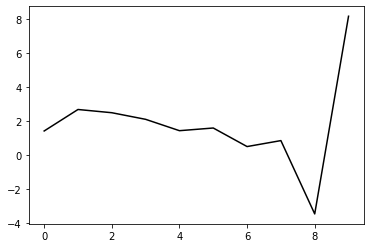

224400 13.97706733739209
0.5679323338385106 -0.8422140960095816 -0.12435098957884642 -0.08383505898423751
[ 1.38284726  2.77753337  2.61608101  2.2435204   1.58845898  1.75074926
  0.66227792  1.01017733 -3.30892357  8.20077777]


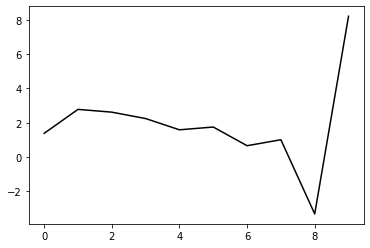

225500 22.355018427713365
0.5676873571434788 -0.8415465537452491 -0.12478713062512907 -0.08255754036296195
[ 1.34610619  2.78714742  2.62799057  2.24920862  1.58898919  1.74120409
  0.64563642  0.9805773  -3.35187718  8.16148762]


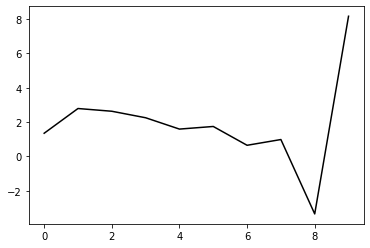

226600 24.20494669825305
0.5655325854902432 -0.8401880109405743 -0.12405693938558011 -0.08337669901925193
[ 1.345289    2.78902145  2.62850898  2.24363848  1.58204245  1.73262917
  0.64060231  0.9747731  -3.359864    8.22364985]


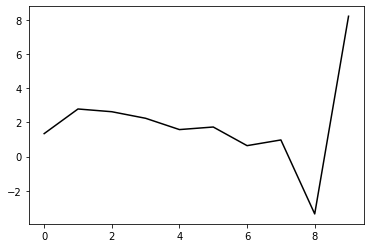

227700 15.502195982753227
0.5696290957075112 -0.837107717761403 -0.1229375505117008 -0.08479231354505072
[ 1.39373404  2.79010116  2.64778308  2.27613515  1.63070139  1.79412656
  0.71674296  1.05813961 -3.27363112  8.18089426]


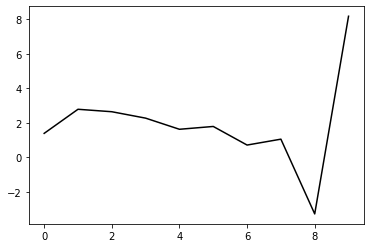

228800 23.11750006210755
0.5618096554783932 -0.8363968392581522 -0.1218764522147975 -0.08471341274304657
[ 1.3785297   2.75638843  2.60699885  2.21984285  1.5599044   1.70415989
  0.61234327  0.93602876 -3.40931365  8.13681505]


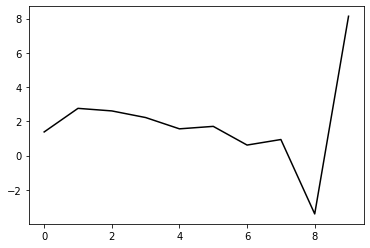

229900 27.13430600564069
0.5660028699850741 -0.8385807168845931 -0.1257593494565804 -0.08135172384236296
[ 1.30456104  2.82734249  2.69217343  2.3123459   1.66100954  1.8077117
  0.71903518  1.03495089 -3.32366958  8.19562368]


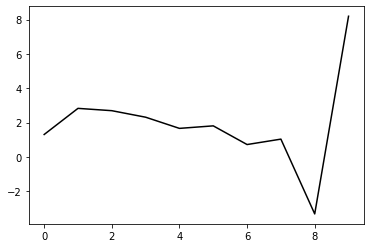

231000 16.47341116343376
0.5633178116420049 -0.8358160525758379 -0.12478158722225513 -0.08116435534166648
[ 1.36203568  2.80351218  2.66864488  2.28306433  1.62675449  1.76543564
  0.67241254  0.98189182 -3.38120677  8.14440198]


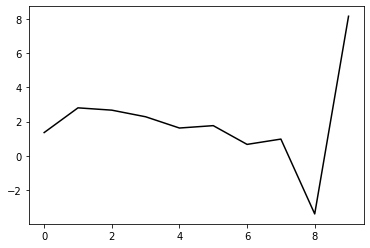

232100 20.667624920725345
0.5607049959507012 -0.8388669653831233 -0.1271309035811641 -0.08154436976250781
[ 1.34849438  2.80830433  2.68521099  2.30561633  1.65704917  1.80007064
  0.7135197   1.0244748  -3.33849828  8.17853292]


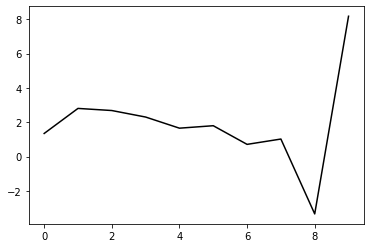

233200 22.652231356328176
0.5574318037941374 -0.8347154460088323 -0.12432781243814517 -0.08236775795768182
[ 1.37915719  2.74114395  2.61879415  2.23535039  1.58704178  1.72798897
  0.64387637  0.9515926  -3.41586243  8.12081115]


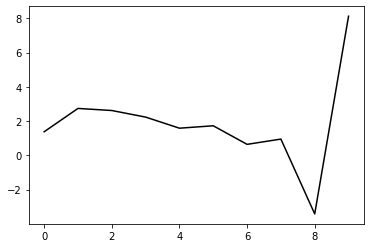

234300 25.098089850599354
0.5394719703577544 -0.8373723099570789 -0.1252743844265324 -0.08045003469736045
[ 1.35214093  2.63837276  2.47700079  2.04717563  1.35332405  1.44650954
  0.3205911   0.5868816  -3.81778927  8.118844  ]


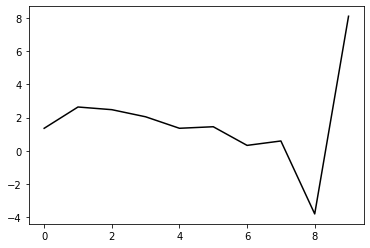

235400 18.302621732129293
0.5564797115977428 -0.8326763275665897 -0.12536090886006912 -0.08001041800884043
[ 1.35974327  2.78243674  2.63450021  2.21027309  1.52031177  1.61288018
  0.48692969  0.7494447  -3.6580682   8.1209821 ]


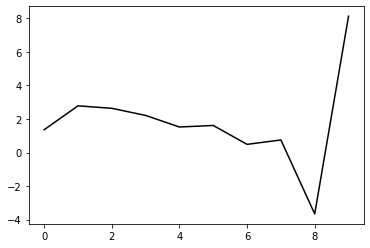

236500 22.035992305292318
0.5600611216328215 -0.8318440367060267 -0.12502532101417027 -0.08600091349938244
[ 1.35645873  2.8982744   2.78423198  2.3827812   1.71165023  1.81578887
  0.69921831  0.96547868 -3.44206147  8.14592633]


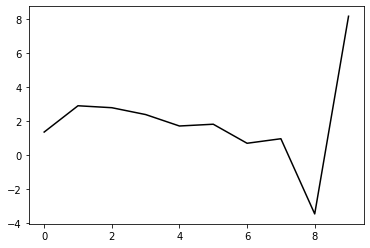

237600 24.72737116650357
0.5562678302916774 -0.8332216751528754 -0.12672617421802526 -0.08339030270590043
[ 1.35457958  2.86743129  2.74526851  2.32997138  1.64893475  1.74219104
  0.62040296  0.8786354  -3.53472975  8.08322415]


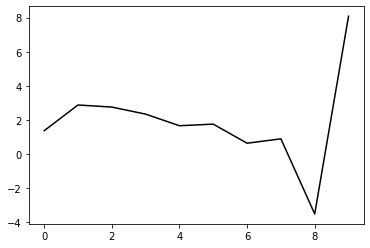

238700 15.802569405631731
0.558096356363896 -0.8303303764874063 -0.1251750324011427 -0.08609015485119788
[ 1.4069319   2.85966925  2.76375634  2.36748472  1.70656366  1.81380963
  0.70606219  0.96958039 -3.44307234  8.17160871]


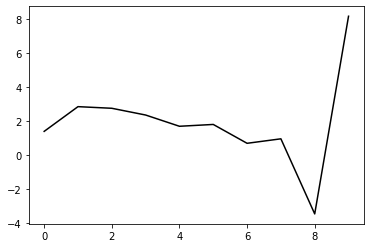

239800 23.302666103292626
0.5531936215099021 -0.8315402587164822 -0.1264926586207825 -0.08367907268306563
[ 1.34173104  2.82301106  2.71369746  2.29997051  1.62751493  1.72253361
  0.60839916  0.86016296 -3.56546223  8.12172089]


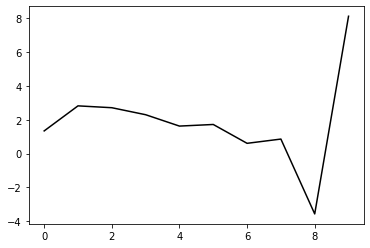

240900 14.963559877271932
0.5574426502420307 -0.8274443638073344 -0.12500708206887767 -0.08346575859152681
[ 1.34405954  2.92836883  2.82923771  2.41760551  1.74688275  1.83892367
  0.72304792  0.96770333 -3.4660709   8.13382871]


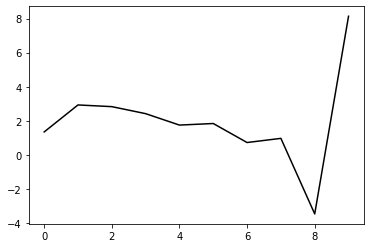

242000 23.928991974635206
0.5531968226758387 -0.8331211750093672 -0.13050941205817046 -0.07806614432670701
[ 1.34199373  2.84838994  2.74346005  2.32214709  1.64478987  1.72929819
  0.60995988  0.8485391  -3.59060678  8.09975546]


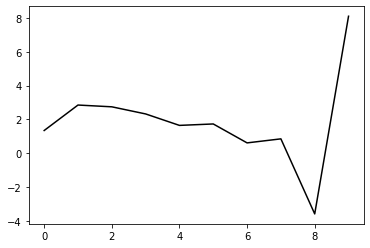

243100 23.638315012581433
0.540501203030995 -0.8293899857411703 -0.12720277972312996 -0.08168046295252906
[ 1.40312372  2.76883927  2.64967968  2.21150308  1.52039473  1.59218527
  0.46496638  0.69675438 -3.74701836  8.10228421]


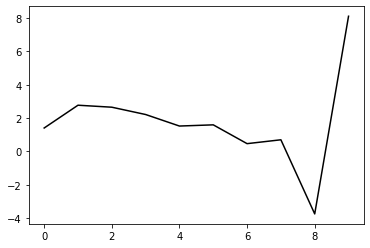

244200 22.59873309082166
0.5558798720925971 -0.8219682098299221 -0.12456588966577943 -0.08299086689646779
[ 1.36225707  2.89230815  2.77942066  2.3403499   1.6482694   1.71547691
  0.58489923  0.80862811 -3.64490288  8.10119717]


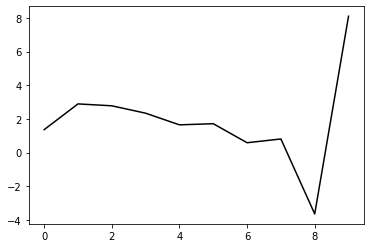

245300 25.252188068917533
0.5404918894295756 -0.8235582380804279 -0.12438299250047453 -0.08492871904524879
[ 1.38918134  2.78284003  2.6697434   2.22712839  1.53643734  1.60570426
  0.4823077   0.71136486 -3.73654945  8.12981374]


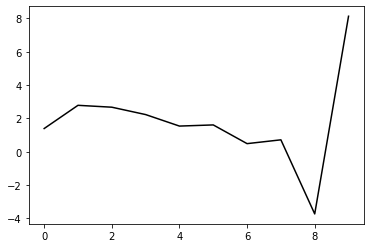

246400 14.059224317571575
0.5506558084931611 -0.8216000114470299 -0.1262187148991492 -0.08271662453715281
[ 1.37866538  2.89076253  2.79951457  2.37074042  1.69199397  1.76732872
  0.64899929  0.87586177 -3.57772388  8.10195466]


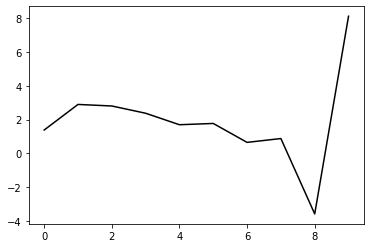

247500 22.200943092813556
0.5522310999907091 -0.8185044159651852 -0.12480421000492367 -0.0837957518000304
[ 1.3565038   2.93816644  2.86081658  2.4397693   1.76923395  1.84857203
  0.73502969  0.95989401 -3.49942997  8.14536433]


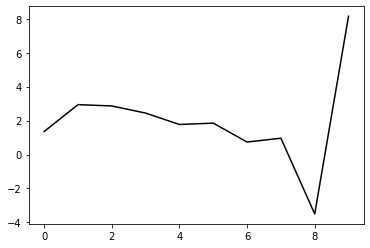

248600 24.201431150839177
0.5483496940069154 -0.8213068245286257 -0.1268571853411693 -0.08454904795725221
[ 1.34972573  2.95774305  2.88545965  2.46194297  1.78895582  1.86161291
  0.74409569  0.96116661 -3.50436774  8.11059032]


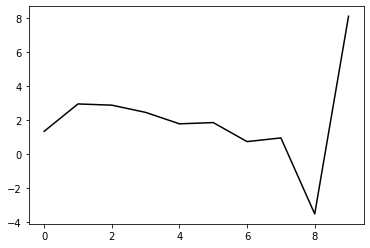

249700 17.987340491416283
0.5433346243772618 -0.816937267934999 -0.12405883733203169 -0.08551915424511256
[ 1.43364372  2.85187596  2.77872376  2.35173075  1.68128943  1.75760638
  0.64976273  0.87287994 -3.58727139  8.14283516]


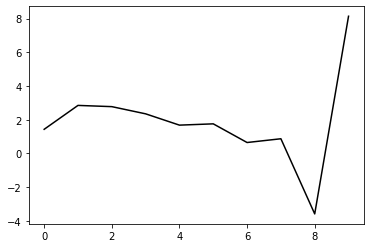

250800 22.691640982017706
0.5464356995153802 -0.8157112788398374 -0.12425056751064674 -0.08554960379166796
[ 1.39281447  2.93353338  2.86235425  2.42901491  1.75279168  1.82009817
  0.70652284  0.92059148 -3.54776283  8.08112684]


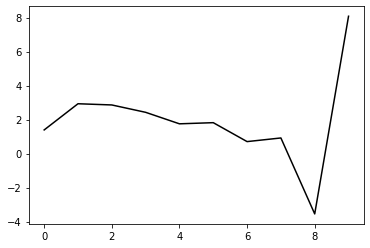

251900 14.756082233729927
0.5479015550063911 -0.8173649210156245 -0.12706023101749836 -0.08233364454754281
[ 1.36096245  2.93255131  2.87312783  2.44477925  1.77484076  1.84394873
  0.73417066  0.94490902 -3.52942994  8.12985748]


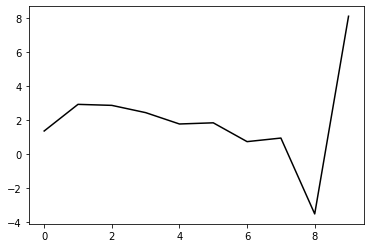

253000 17.97394910874668
0.5383062925190897 -0.820682156397251 -0.12900632940570003 -0.0800627554396193
[ 1.39711064  2.82113231  2.74700336  2.30013782  1.61727176  1.67422708
  0.55974424  0.76433244 -3.71374797  8.10340521]


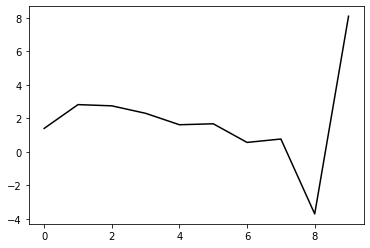

254100 22.929412663787563
0.5414700780513546 -0.8163810651188018 -0.12679267491770926 -0.08271642235256442
[ 1.41026308  2.8449889   2.77608718  2.32800135  1.64635168  1.70254021
  0.59110933  0.79498107 -3.68316784  8.15773979]


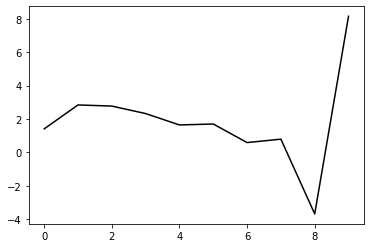

255200 27.33702763765716
0.5326858627617446 -0.8142746879006941 -0.12476290432703821 -0.08467030410724782
[ 1.41493801  2.78638046  2.7131334   2.25787912  1.57399759  1.62800697
  0.51907174  0.72231429 -3.756658    8.06861114]


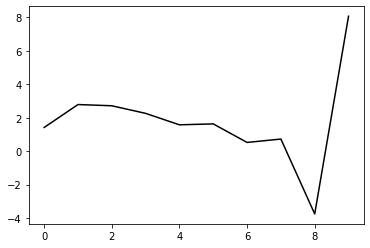

256300 24.82240303248076
0.5305636236680589 -0.8142476092148953 -0.12601895880130057 -0.08367278079769216
[ 1.39161835  2.79325558  2.71827775  2.25648612  1.5679036   1.61543284
  0.50326612  0.70013344 -3.78479172  8.10071425]


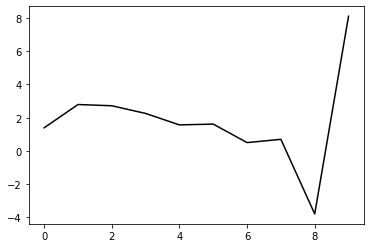

257400 15.873467226609668
0.5429159913539242 -0.8104141916272842 -0.12564751581631073 -0.08432918476771252
[ 1.41227113  2.92061914  2.86962135  2.42234097  1.74543674  1.79886465
  0.69224913  0.88941544 -3.59644077  8.12279701]


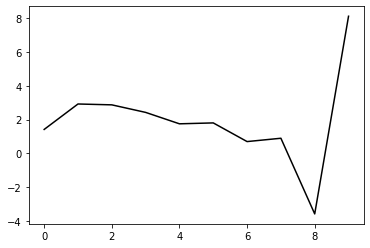

258500 22.473077576111425
0.5429699101223184 -0.8111923568705406 -0.12701259790464392 -0.08400485292300766
[ 1.36293608  2.97744305  2.93156853  2.48235225  1.80392849  1.85201431
  0.74226426  0.93114    -3.56405988  8.10906376]


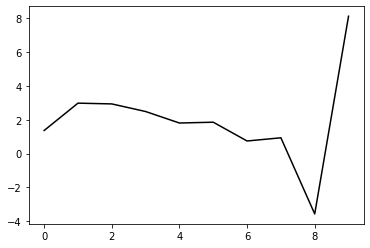

259600 25.183833520050705
0.544247342142881 -0.8118674737366895 -0.12869400490614955 -0.08226035287381638
[ 1.36355586  2.98933274  2.95015978  2.50137378  1.82442445  1.86991993
  0.76001324  0.94254554 -3.56030411  8.13521738]


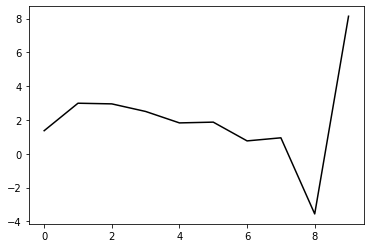

260700 14.006282988345541
0.5408201702501627 -0.809958926972968 -0.12718496587846334 -0.08409336721000253
[ 1.40381282  2.95102706  2.91176041  2.45643667  1.77457429  1.81300179
  0.70144081  0.87984725 -3.62452215  8.09477189]


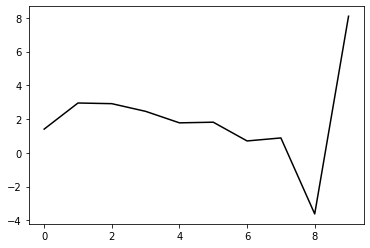

261800 25.73841663608463
0.5339554595257 -0.806868313705656 -0.12496565801992612 -0.08502334407647257
[ 1.42063958  2.91811343  2.87137746  2.40520439  1.71700766  1.75006453
  0.63913046  0.8163135  -3.68807682  8.05121965]


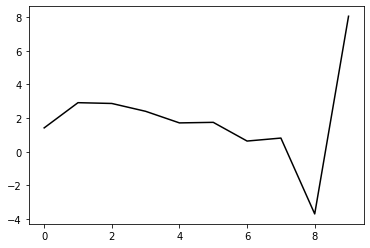

262900 14.35271821443695
0.5461712540843803 -0.8046237578827856 -0.1262370166492042 -0.08354461715068288
[ 1.3619727   3.02866968  2.99109256  2.52875034  1.84443245  1.87781547
  0.76789486  0.93978998 -3.57401668  8.13152746]


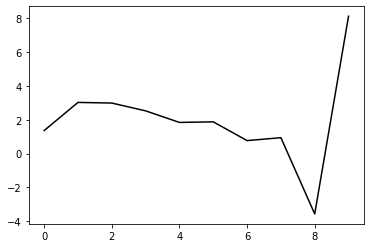

264000 15.836500625460657
0.5479962715077569 -0.8030383010661711 -0.12656135914403305 -0.0814334973242201
[ 1.35443291  3.0264663   2.99606424  2.53650293  1.85616366  1.89054182
  0.78345982  0.95146983 -3.57003966  8.11445142]


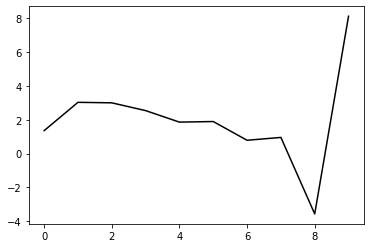

265100 21.35112567175773
0.530850207042748 -0.8053954127251203 -0.1254004420672298 -0.08460280638796815
[ 1.39974199  2.9131712   2.87072633  2.39556354  1.70311197  1.7261271
  0.61416249  0.77714535 -3.74526643  8.09062642]


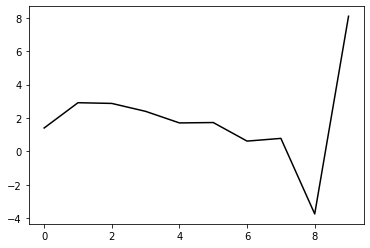

266200 22.60827333664155
0.5397882137118999 -0.8024697341254353 -0.1260287342313993 -0.08127757126200574
[ 1.3772462   2.948284    2.91065819  2.43565725  1.74383658  1.7641016
  0.65089907  0.80663511 -3.7257159   8.09919961]


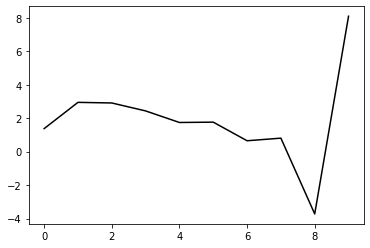

267300 20.991000577495914
0.5301601271522061 -0.8081327957339273 -0.1294177577750912 -0.08145753071920246
[ 1.37787854  2.90680744  2.87671343  2.40435154  1.71681704  1.73973515
  0.63302419  0.79275974 -3.73425202  8.11525882]


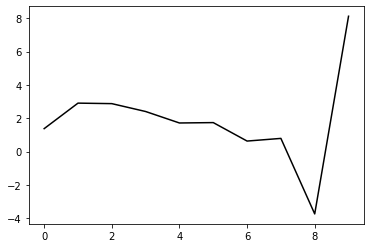

268400 14.431534237046288
0.5362856434738913 -0.80130445305183 -0.12585755808727248 -0.08364174197933627
[ 1.39975262  2.96341177  2.94414193  2.47653726  1.79417785  1.81877562
  0.71585486  0.87396168 -3.65618513  8.1132441 ]


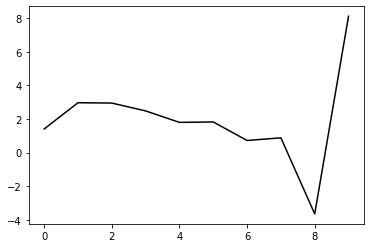

269500 21.997012977508657
0.5336460872586678 -0.8019531891599813 -0.12681724828157667 -0.08254561100285189
[ 1.38158483  2.96328475  2.94660201  2.47577118  1.7899441   1.80689542
  0.69774519  0.84335525 -3.70093324  8.12472889]


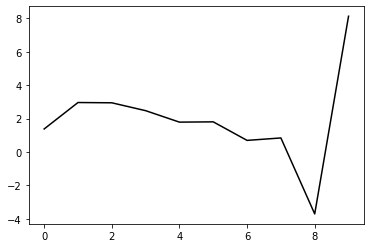

270600 26.399486873440964
0.5361348456595826 -0.8015001116476826 -0.12788141119329047 -0.08262233398600753
[ 1.33497303  3.03265269  3.03305181  2.57409842  1.90000992  1.92410433
  0.82202187  0.96661029 -3.5836338   8.10571058]


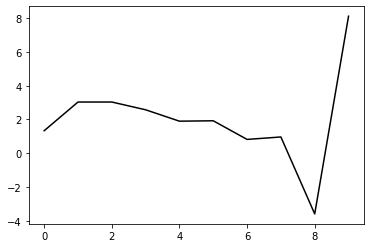

271700 13.689455131758157
0.5246913654949551 -0.798850981382873 -0.12542678918414274 -0.08335527878793217
[ 1.3908509   2.89715862  2.87106775  2.38354407  1.6856914   1.68869342
  0.57419125  0.70802921 -3.8486885   8.10325536]


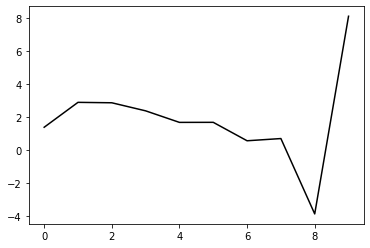

272800 31.736344262008036
0.5350965327989686 -0.7942942391948155 -0.1242287480166366 -0.0865353830678467
[ 1.41332876  3.01253065  3.01932009  2.55563663  1.8778484   1.8943683
  0.79150588  0.93030846 -3.62550911  8.09292352]


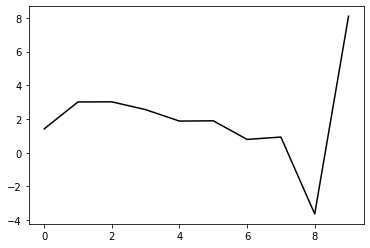

273900 20.648771951560633
0.5305733860918987 -0.7998605224310575 -0.12896535556557376 -0.08300907933976724
[ 1.32555416  2.97542441  2.96843438  2.48843343  1.79944215  1.80594513
  0.69968055  0.83255023 -3.72775697  8.13675038]


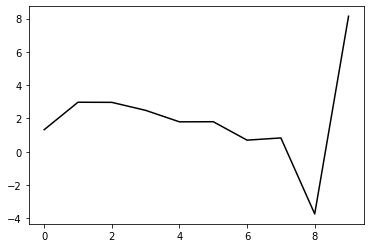

275000 19.00054560589998
0.5328106733791864 -0.7952596825980014 -0.1274205248230669 -0.08112952846118872
[ 1.31700768  2.99596878  2.95330841  2.43758101  1.71973874  1.70215369
  0.57975009  0.69819673 -3.87386424  8.07852116]


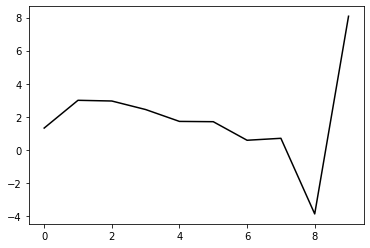

276100 20.33103104732528
0.5340203758355504 -0.796282704641215 -0.12874291661215836 -0.08268895759215203
[ 1.35437682  2.98496671  2.9649788   2.46629114  1.76451254  1.75908859
  0.64895035  0.77507587 -3.791418    8.1275095 ]


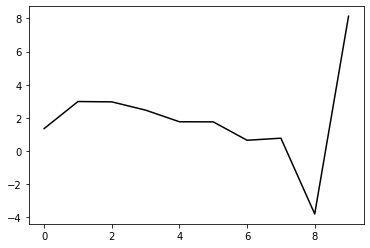

277200 22.956855440236176
0.5289830801794452 -0.7967772436079418 -0.1288948422940437 -0.0841376127861918
[ 1.38490756  2.95863494  2.9488025   2.45380988  1.75593745  1.75117442
  0.6442611   0.7693252  -3.79875105  8.09315237]


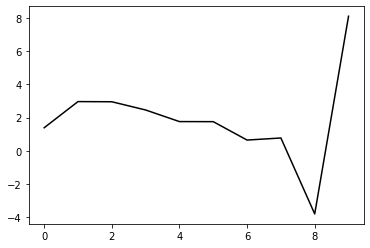

278300 21.622221362458998
0.5322346309077299 -0.793019092211087 -0.12730878087295464 -0.08423363630207653
[ 1.3660164   3.0381969   3.04366101  2.55515818  1.86075184  1.85312533
  0.74372417  0.85965979 -3.71950859  8.11359485]


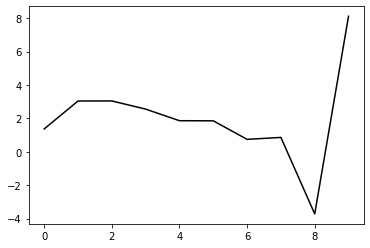

279400 14.859029432540112
0.5238927425606132 -0.7953634025882216 -0.12829991324439663 -0.08418317380948634
[ 1.40585562  2.96484916  2.97129587  2.47900429  1.78208709  1.77055054
  0.66180667  0.77648223 -3.80199122  8.06053283]


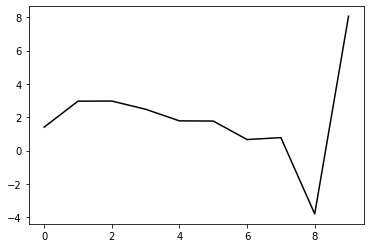

280500 22.232574220487173
0.5277845901135453 -0.792250413077785 -0.12748513795006056 -0.08309280664831296
[ 1.38474414  3.00094205  3.00801596  2.51045738  1.80769115  1.78594729
  0.66837257  0.7675228  -3.82855496  8.10015218]


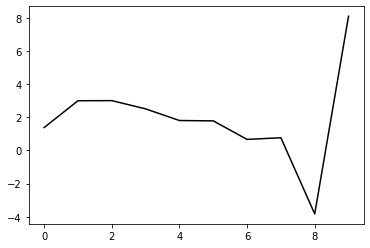

281600 24.579757974807578
0.5241211105186026 -0.7937046702479458 -0.12870207331449263 -0.08365520983260107
[ 1.35947707  3.01063785  3.02274255  2.52661255  1.82685575  1.80670671
  0.69370835  0.79370755 -3.80214568  8.09093876]


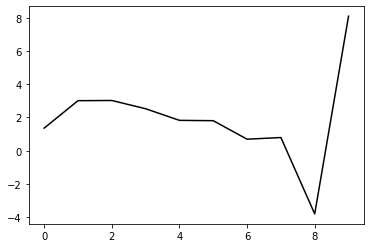

282700 15.312424369980265
0.5270913228201228 -0.7892179404647846 -0.12670570785897214 -0.08491815617882349
[ 1.41381919  2.98813049  3.02147232  2.54161575  1.85827967  1.85028969
  0.75001916  0.85506608 -3.74003803  8.13375247]


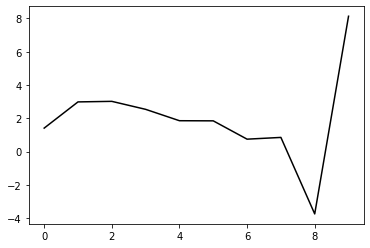

283800 24.95448936990258
0.5227862976281729 -0.7862620866446872 -0.12439711595532044 -0.08500345924639317
[ 1.40066784  2.9652775   2.98736868  2.4895531   1.78845958  1.75981939
  0.64432946  0.73160492 -3.87777945  8.0403361 ]


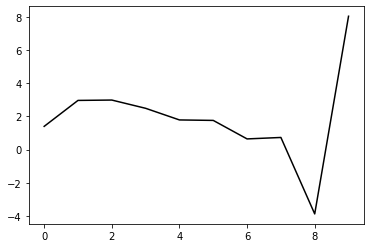

284900 28.187915874753266
0.5278102525464359 -0.7881897195327771 -0.12831006099031317 -0.08046089879447361
[ 1.31059863  3.04102713  3.05544797  2.54254202  1.82496061  1.77531297
  0.64218761  0.70688537 -3.92377752  8.12858203]


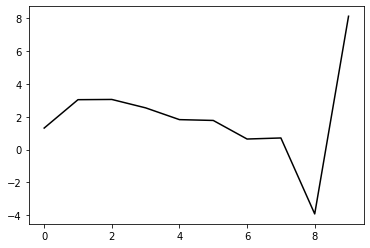

286000 19.28410266908604
0.5286422724707851 -0.7878093081076063 -0.12969191155876025 -0.08115136765500787
[ 1.33364568  3.07388138  3.10030631  2.59483201  1.88481314  1.8403352
  0.71442759  0.78234262 -3.84638744  8.06397358]


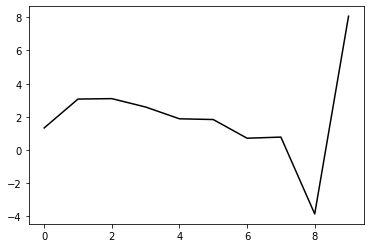

287100 30.89733079493977
0.5148240168283086 -0.7870415236105762 -0.12716440052561548 -0.08642665135710614
[ 1.46033973  2.86442228  2.89192083  2.38794018  1.68401027  1.64734284
  0.53424992  0.61382922 -4.00248501  8.1120403 ]


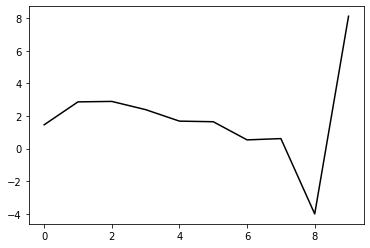

288200 24.66524004385408
0.5248785024288779 -0.7862413125877561 -0.1302765230836164 -0.08111932613663494
[ 1.35292469  2.98487573  2.98595639  2.45211347  1.72037151  1.656965
  0.52207347  0.58005216 -4.05575676  8.06110906]


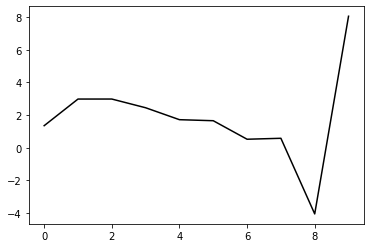

289300 21.020721730666132
0.5274742379570346 -0.7837263804544085 -0.12926453745497787 -0.08427257888478697
[ 1.3563773   3.06915851  3.0948526   2.57725507  1.85853618  1.80333548
  0.67587006  0.73636223 -3.900081    8.13253639]


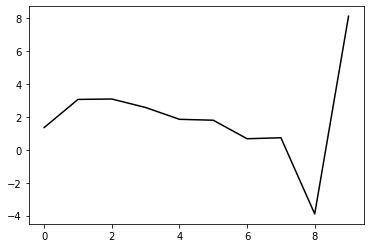

290400 13.897923656030297
0.5268469190627141 -0.7806836034409437 -0.12775694083245145 -0.08488728339750075
[ 1.36738144  3.07058845  3.10703227  2.59436981  1.880359    1.82644242
  0.70184859  0.75928572 -3.8831327   8.08546663]


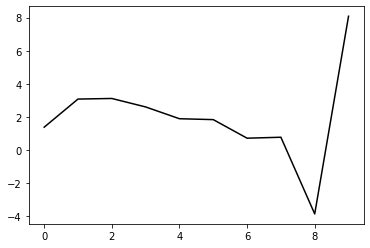

291500 22.283096910912434
0.5241028530587925 -0.781362190268337 -0.1278663343255542 -0.0863067350674258
[ 1.36688577  3.05893997  3.09742287  2.58498486  1.87422274  1.82361224
  0.70610483  0.76827947 -3.86872     8.07381909]


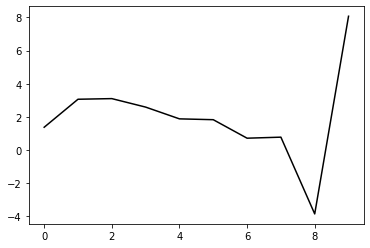

292600 25.74810575770047
0.5223463593787255 -0.7829655243594261 -0.13064235013686268 -0.08288979260235795
[ 1.35366066  3.0229005   3.05056623  2.52456826  1.80258035  1.7407536
  0.61661155  0.66993918 -3.9749454   8.0633121 ]


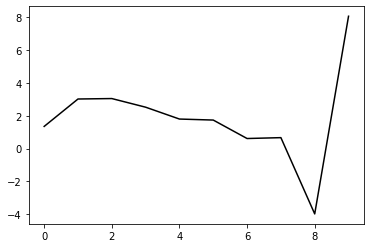

293700 15.887866603935066
0.5238814810436042 -0.7787436176659953 -0.12840692644044407 -0.08685248868619748
[ 1.41612749  3.00619956  3.06663478  2.56840804  1.8731234   1.83322022
  0.72996838  0.796368   -3.84119594  8.09140229]


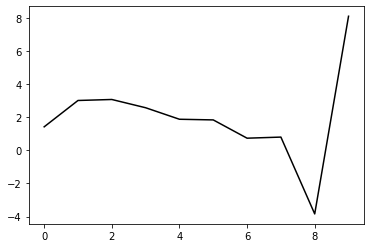

294800 23.572910005600797
0.5225969054021091 -0.7756218539353397 -0.12646687511200183 -0.08785922546899211
[ 1.38846677  3.04861904  3.10923236  2.60532414  1.90396418  1.85442562
  0.74447229  0.79857359 -3.85213211  8.03655545]


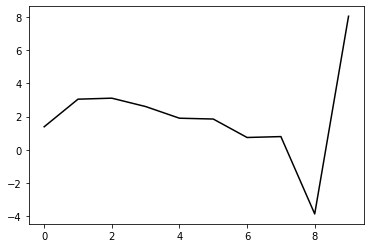

295900 15.653356610122344
0.5257464106064895 -0.7746523130845089 -0.127937792993676 -0.08439110776455404
[ 1.34288897  3.09420056  3.16149299  2.6601851   1.96172334  1.91085607
  0.80052256  0.84442592 -3.82255748  8.09852918]


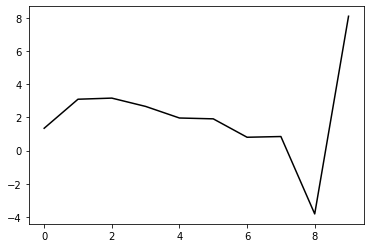

297000 29.49673211374294
0.5227334532479656 -0.7809707951832365 -0.13378884124393997 -0.07810548259133024
[ 1.32767543  2.99157857  3.04737415  2.52979691  1.81554583  1.74674918
  0.62319248  0.65079473 -4.030816    8.05539128]


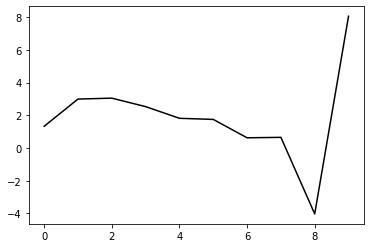

298100 24.12945632674669
0.5144841771035732 -0.7772041262016363 -0.1301060618358008 -0.08424100457004832
[ 1.42361477  2.90349254  2.96544887  2.45197398  1.74379871  1.68085027
  0.56685297  0.60225967 -4.07059917  8.05810317]


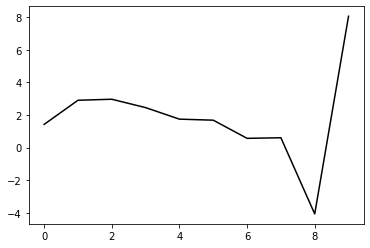

299200 22.87341432566028
0.5204395577215845 -0.7710910040528026 -0.12801210034563396 -0.08414340949665738
[ 1.36470802  3.02799106  3.09998526  2.58849972  1.87891027  1.80856834
  0.6870109   0.70707833 -3.98486168  8.06764471]


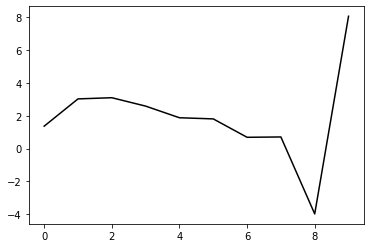

300300 21.19132419331928
0.5170939923542918 -0.7722328789877642 -0.12941218799443907 -0.08262753338145953
[ 1.37214896  3.01459724  3.09638814  2.59186661  1.89004779  1.82542558
  0.7118681   0.7348711  -3.95655344  8.07307532]


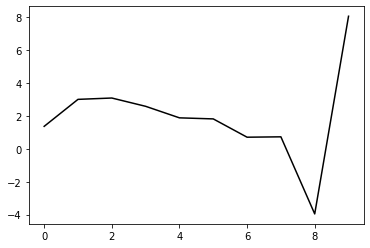

301400 16.58205106649481
0.5165154784596979 -0.7703784414686707 -0.12834129743644476 -0.08485545605348381
[ 1.42489429  3.00142107  3.09854566  2.60578254  1.91623542  1.86145531
  0.76004757  0.79021631 -3.89605835  8.0936858 ]


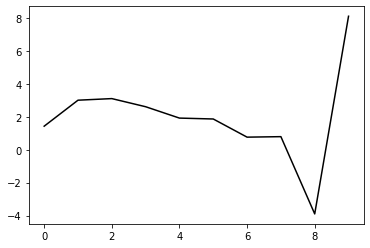

302500 22.59701382341901
0.5156203596160642 -0.770235440396722 -0.1286950104320151 -0.08530913820973832
[ 1.40318183  3.04269214  3.1427963   2.64663782  1.95221673  1.88864525
  0.78217104  0.80339213 -3.89054435  8.07198071]


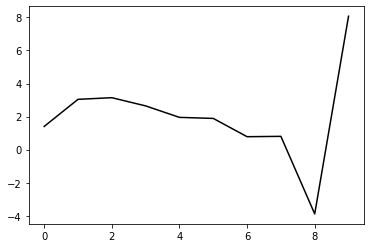

303600 25.16571309174458
0.5134713687044001 -0.7714835731791826 -0.13081872652191304 -0.08214092937425507
[ 1.38602282  3.00096196  3.09331833  2.58860515  1.88969204  1.82209782
  0.71657992  0.73466292 -3.96324414  8.05083074]


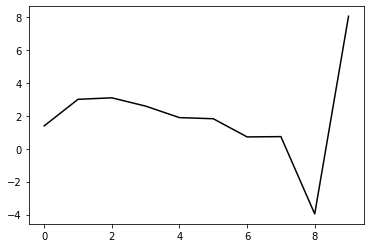

304700 14.319678032395265
0.51480239635849 -0.7681401468108618 -0.12918435643722767 -0.0840221989528484
[ 1.42358129  3.00282491  3.1107486   2.61600557  1.9259137   1.86358848
  0.76513331  0.78572413 -3.91055886  8.07328493]


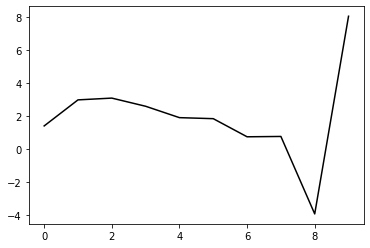

305800 22.709515151635745
0.5173912067911814 -0.765570046881145 -0.1286917908017882 -0.08405045573034044
[ 1.37941609  3.06783698  3.18732144  2.69745447  2.01037981  1.94628175
  0.84723358  0.86030612 -3.8465725   8.08420297]


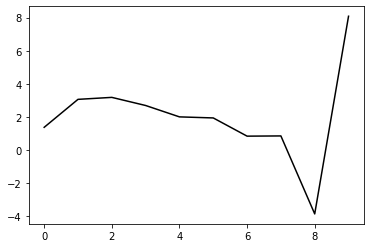

306900 18.431204794796333
0.5141323041221466 -0.7666256675873063 -0.13013616370610862 -0.08072624893480815
[ 1.34981382  3.04907016  3.15483843  2.64724572  1.9427763   1.85879483
  0.74404999  0.73659631 -3.99069313  8.03963148]


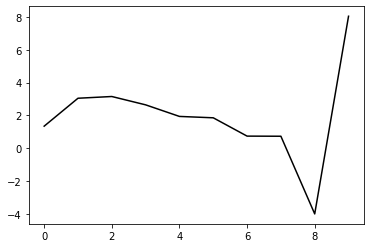

308000 16.56824012946843
0.5179586659633203 -0.7634454764014859 -0.12937991612052177 -0.08125616676718984
[ 1.39105384  3.04916633  3.1661258   2.66660381  1.97050598  1.89272777
  0.78677966  0.7837975  -3.94022565  8.07345436]


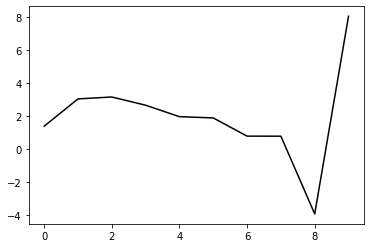

309100 20.3671673757724
0.5165714442694008 -0.762462771109547 -0.12969186139692934 -0.08024935313346308
[ 1.38141119  3.03314277  3.15110931  2.64861058  1.94890914  1.86375576
  0.75259837  0.73780306 -3.999997    8.07137472]


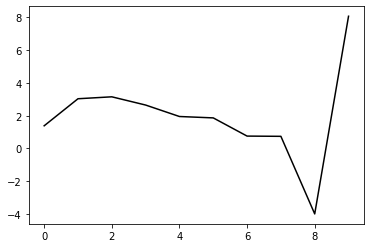

310200 24.186448591038165
0.5070845986042684 -0.7681311306652647 -0.13241368852549104 -0.08362838037397133
[ 1.45136058  2.94246166  3.09316867  2.62344086  1.95895607  1.90742574
  0.83136677  0.84475163 -3.87026467  8.1555104 ]


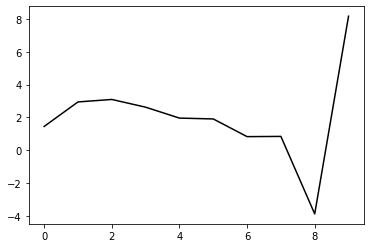

311300 22.384116390616235
0.5101626929591621 -0.7611823049657618 -0.12914783516118175 -0.08215759790919293
[ 1.39538491  2.98258845  3.11907299  2.6307974   1.94743284  1.87386744
  0.78030444  0.77094553 -3.96718315  8.07604002]


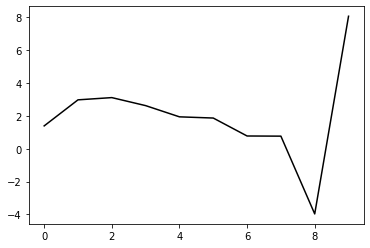

312400 18.391428799683823
0.511215819311667 -0.758773315085791 -0.12811798783314712 -0.08168961730857809
[ 1.44982564  2.96270224  3.09259677  2.59146127  1.89497445  1.80790858
  0.708835    0.69465746 -4.04352326  8.11024484]


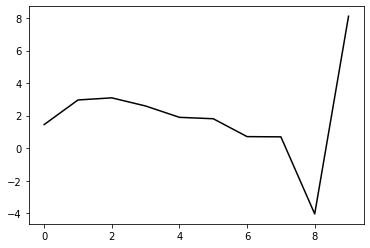

313500 21.588070486426712
0.511231775478606 -0.7608729814087621 -0.13069880867522676 -0.08014347462659699
[ 1.40970715  2.99247244  3.12422405  2.61960263  1.91746629  1.81995567
  0.71226076  0.68378055 -4.06928246  8.06869518]


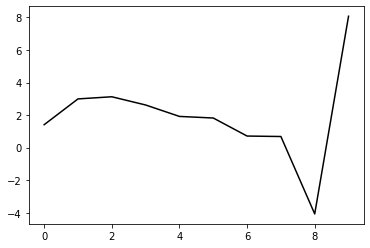

314600 25.469451769685556
0.5147127449509297 -0.7583951145693805 -0.13035911888055143 -0.07963006604182005
[ 1.3661145   3.0802717   3.22067348  2.72079987  2.02269098  1.92641297
  0.82173319  0.79149623 -3.96466952  8.05828932]


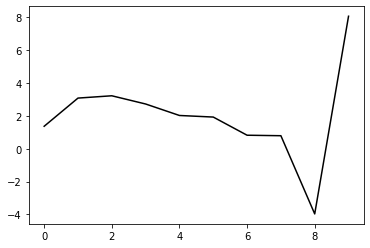

315700 17.62410812932824
0.5054761933210506 -0.7607628010661754 -0.13068252804190134 -0.08422771089225345
[ 1.47950142  2.94411136  3.10633405  2.62630833  1.948474    1.86918425
  0.78315487  0.7657477  -3.97943457  8.10497019]


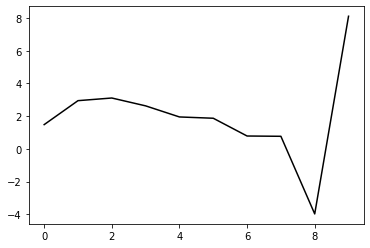

316800 27.526199166527864
0.48888715891238366 -0.7610225579116716 -0.13102534785044476 -0.07995492285576059
[ 1.41990886  2.82180413  2.92396401  2.38645317  1.6573612   1.532043
  0.40918004  0.35844572 -4.41756915  7.99609391]


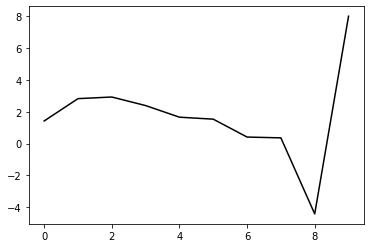

317900 14.426047391257288
0.5140307929044693 -0.7543992512319452 -0.13044439022391702 -0.08475439563584883
[ 1.35999967  3.14152794  3.25315178  2.71710291  1.98574776  1.85497704
  0.72721147  0.66936322 -4.11302128  8.03370066]


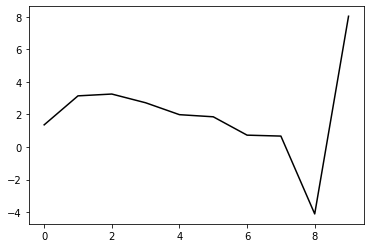

319000 17.331331840064443
0.5133121027854768 -0.7547686288314033 -0.1313057000109874 -0.0839568441568795
[ 1.40089511  3.08182872  3.19851606  2.66522981  1.93745607  1.80948812
  0.68695175  0.63238126 -4.14627124  8.05496578]


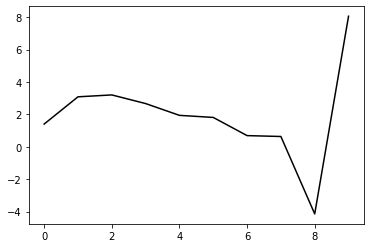

320100 28.85115512028408
0.5086926260820424 -0.7528831723366123 -0.12968635981315596 -0.0861055730907549
[ 1.46803372  2.96573445  3.08104786  2.54550611  1.81842878  1.69188423
  0.57515536  0.52433163 -4.25064929  8.04328522]


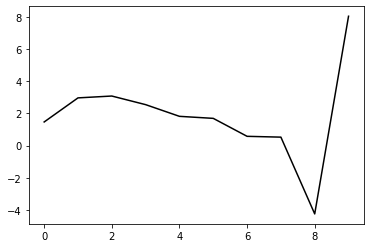

321200 22.463261692553107
0.5212103726886455 -0.7468824277747823 -0.12906805791809814 -0.08306312675143933
[ 1.37481049  3.14647289  3.2475887   2.69203557  1.94348153  1.79379747
  0.6568305   0.58410284 -4.21217105  8.03656068]


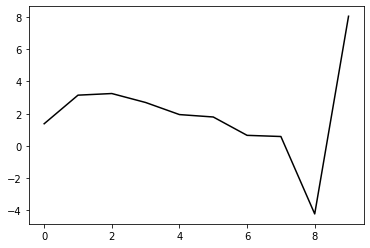

322300 21.357785165459543
0.5200840585124896 -0.7495296946023207 -0.13153046508490293 -0.0836430643657615
[ 1.36575423  3.15977302  3.27636823  2.73020889  1.98909691  1.84389363
  0.71245182  0.6420213  -4.15311368  8.06752905]


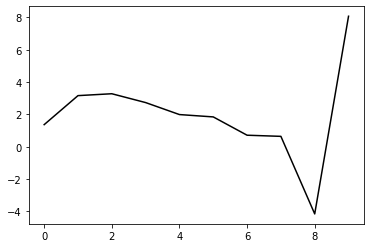

323400 15.485515591830119
0.5098075899329362 -0.7518733470023332 -0.13230367291277403 -0.08508138743123213
[ 1.37391531  3.08471277  3.20578614  2.66338932  1.92835867  1.7888523
  0.66615259  0.60099767 -4.1898602   8.03084134]


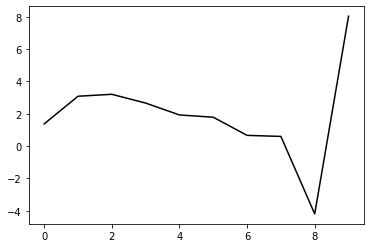

324500 22.285215987168183
0.5171430294990557 -0.7454520443342184 -0.12974940656627834 -0.08591414792019553
[ 1.38281273  3.1536979   3.28971241  2.75711949  2.03017041  1.89487262
  0.77668731  0.70964557 -4.08677037  8.07049783]


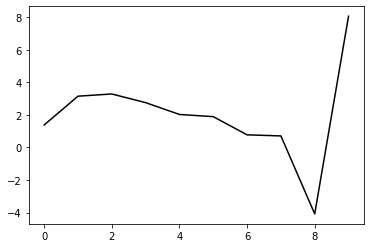

325600 25.77153076237295
0.5180872828613768 -0.7464831539812372 -0.13153288621486864 -0.08391453753678099
[ 1.34027303  3.18474975  3.31882086  2.7798893   2.04677635  1.90368292
  0.78143122  0.70695823 -4.09659555  8.0499346 ]


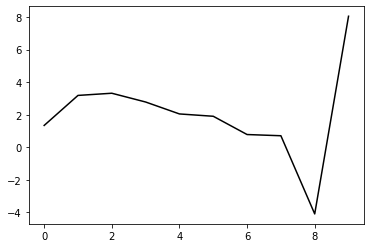

326700 14.303408374644652
0.510088183976734 -0.7486618996839531 -0.1320212963236299 -0.08739079615799704
[ 1.40495821  3.08895622  3.23761395  2.71237839  1.99515494  1.86775271
  0.76406728  0.70469925 -4.08483309  8.08023812]


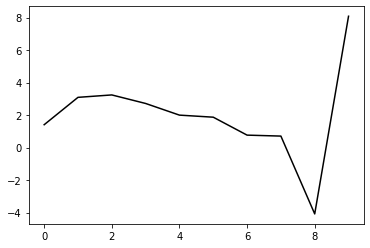

327800 25.780333550499847
0.50962336631503 -0.7447114818502206 -0.1300378440876771 -0.08851814613756966
[ 1.41962522  3.08708904  3.2517999   2.74084432  2.03753269  1.91946408
  0.82465201  0.76536902 -4.02956532  8.04266186]


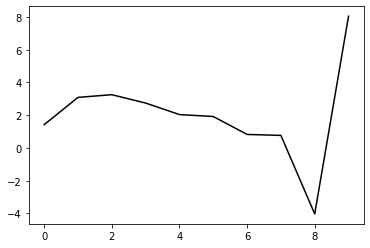

328900 24.52885822327751
0.511005989040386 -0.7463633416229268 -0.13309919427810848 -0.0844615743068485
[ 1.32090464  3.08623095  3.23323684  2.70436758  1.98766822  1.85824574
  0.75854274  0.69115096 -4.11189701  8.07865741]


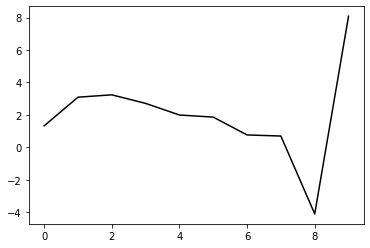

330000 18.96948421569673
0.5160196297305725 -0.7425226864923538 -0.1327047242775783 -0.0835359569751696
[ 1.33352117  3.1403341   3.27048708  2.72330766  1.99067776  1.84692228
  0.73778867  0.66099362 -4.15020156  8.04473846]


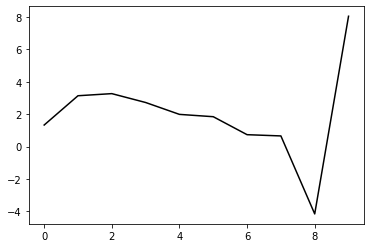

331100 21.6226222927199
0.5132744798894159 -0.7394120012888751 -0.13037794802063568 -0.08595041962456848
[ 1.41895636  3.0351707   3.16707335  2.62026423  1.88982453  1.74845245
  0.64527909  0.57264274 -4.23381103  8.06043875]


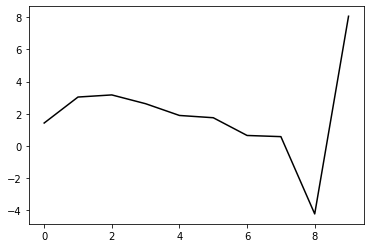

332200 22.650949288099564
0.5163493496797272 -0.7387561547115399 -0.13128416441498972 -0.08479571976892628
[ 1.35366784  3.11783672  3.25183935  2.7017064   1.96628157  1.81720091
  0.70845522  0.62679009 -4.18900887  8.0453471 ]


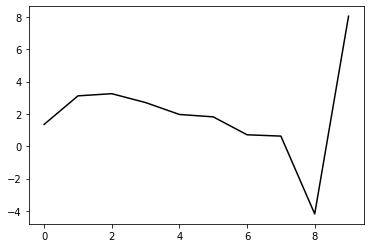

333300 21.38144185738249
0.5147063698716094 -0.7383832418100441 -0.1315015459083707 -0.08449153297049876
[ 1.36917082  3.10524562  3.24759231  2.70065769  1.96702821  1.81669422
  0.70923834  0.62442892 -4.19537971  7.97056142]


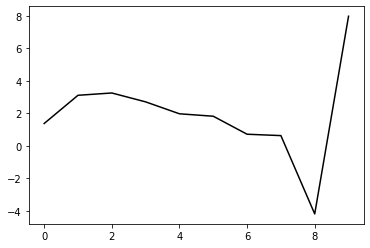

334400 18.51130641036493
0.5068202856098665 -0.740584911549054 -0.13253166911103398 -0.0843267058571307
[ 1.35329413  3.07413379  3.20475932  2.64261531  1.89434213  1.72915148
  0.61244331  0.51816046 -4.30706123  8.01362348]


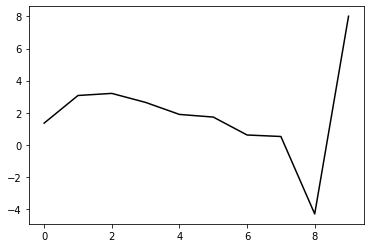

335500 22.337729630161874
0.5115503614978045 -0.7373532266518485 -0.1313934380549366 -0.08788411904778211
[ 1.37681035  3.15208772  3.30384871  2.75602736  2.01853782  1.86010789
  0.75036638  0.6592911  -4.16357695  8.01501858]


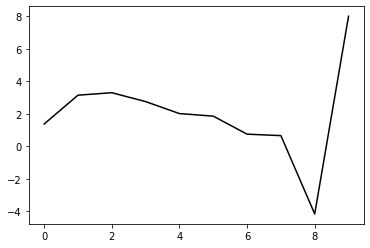

336600 24.758540925872705
0.5099518005081054 -0.7385220677246588 -0.13312316046213582 -0.08555469686684
[ 1.3633587   3.11144105  3.26035099  2.70950499  1.97166847  1.81277071
  0.70594421  0.61390857 -4.2108932   8.01646734]


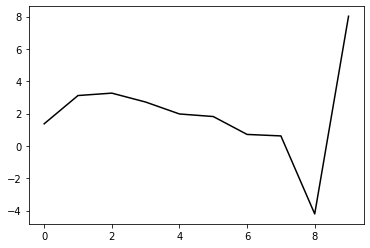

337700 15.488888645051098
0.5106824985889052 -0.7347728766494211 -0.1309175684657407 -0.08722177624578102
[ 1.4241545   3.07949763  3.23434537  2.68384573  1.94485242  1.78205831
  0.67475782  0.57892438 -4.24909518  8.06616616]


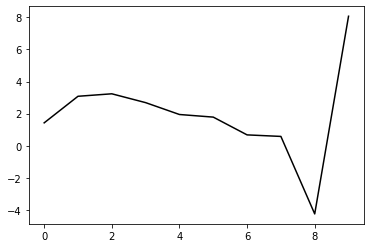

338800 30.6339949952333
0.5006361150015556 -0.7341489440136529 -0.12923957975074069 -0.09099626699887992
[ 1.42387549  3.06207607  3.19954031  2.62722764  1.86610698  1.68157809
  0.55799631  0.44800192 -4.3897367   7.99605874]


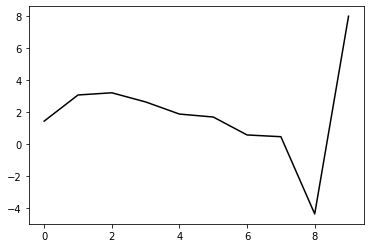

339900 14.600097152625397
0.5113373487416566 -0.7344855209128016 -0.13240431934595354 -0.08742369101607184
[ 1.34473895  3.17092036  3.30464942  2.72423225  1.95438665  1.75988673
  0.62889507  0.50922317 -4.33806901  8.03346034]


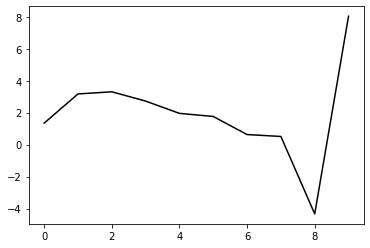

341000 16.700689764461885
0.5169597222790585 -0.7327678440101725 -0.13301164012868344 -0.0877293114303292
[ 1.32934206  3.25971137  3.41390627  2.84600444  2.08480152  1.8940109
  0.76611338  0.64326982 -4.21196235  8.03973546]


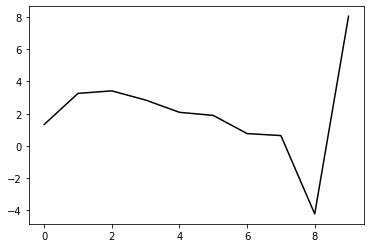

342100 26.599646097039606
0.5057720697745469 -0.7327538699911498 -0.1315785646720218 -0.0883642639240173
[ 1.44222943  3.01463582  3.154498    2.57338261  1.80377376  1.60751303
  0.48125953  0.36048015 -4.489247    8.01381365]


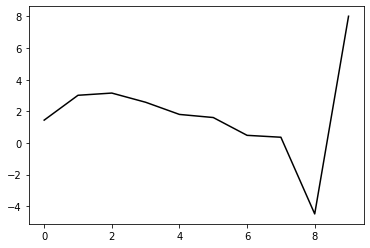

343200 23.002917056918793
0.5138044372640969 -0.7320999465448254 -0.1336490197950469 -0.08722332366272255
[ 1.35167835  3.21474308  3.3589588   2.77372703  1.99525608  1.78564819
  0.64674239  0.51000963 -4.35587142  8.01383953]


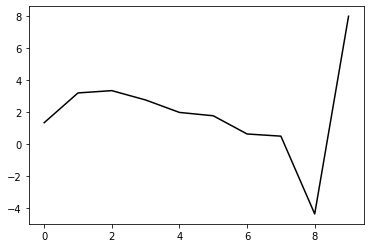

344300 21.37196774194724
0.5140246570369379 -0.7299890869013133 -0.133323805098667 -0.08673962606340732
[ 1.35195073  3.19533339  3.35611123  2.78282716  2.01474686  1.81174585
  0.67978697  0.54293245 -4.32802196  8.02147839]


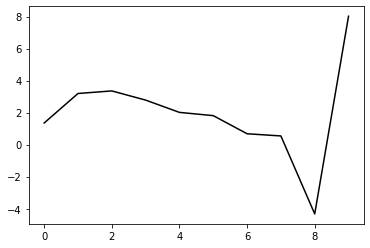

345400 14.050791110460363
0.5116293120692621 -0.729428980205358 -0.13271842662553118 -0.08850162888304464
[ 1.39898748  3.202888    3.38215569  2.82166444  2.06396689  1.8676465
  0.74383446  0.61073469 -4.25723725  8.00302563]


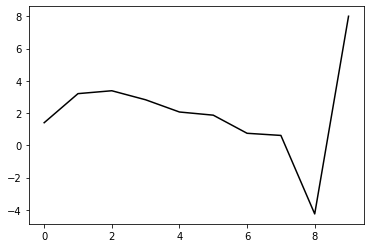

346500 22.162655577906193
0.5091287029594102 -0.727715082621678 -0.13223559889536035 -0.08724070243521033
[ 1.37265655  3.1879797   3.36118711  2.79130288  2.02411953  1.81591637
  0.68308291  0.53520471 -4.34873377  8.02830259]


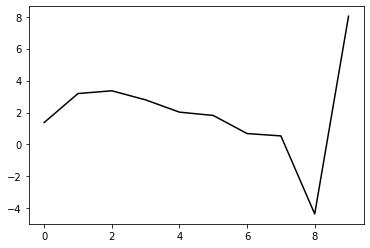

347600 24.294152175507264
0.511980893848135 -0.7273232152471616 -0.13331151871410651 -0.08668506119271771
[ 1.35547419  3.23043451  3.40726059  2.83801397  2.0715655   1.86296267
  0.73253304  0.58391057 -4.3011121   8.02421467]


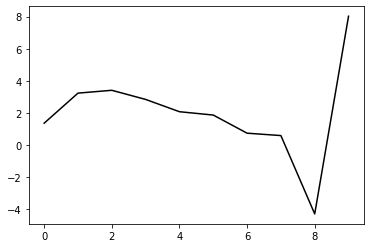

348700 14.76242799544813
0.5088461383678519 -0.7279389675648206 -0.13374857760540157 -0.08908434199385934
[ 1.41191722  3.17075215  3.37789528  2.83519776  2.09291199  1.90332588
  0.79100087  0.65250876 -4.2274958   8.09829293]


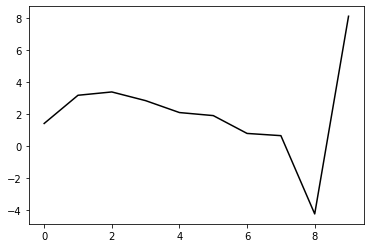

349800 23.533171243694486
0.5056629864887625 -0.7276859920024942 -0.13445624552464053 -0.08717941934878831
[ 1.3706767   3.15294672  3.36523794  2.82464825  2.08371887  1.89201386
  0.77962723  0.63323149 -4.25872815  8.04032826]


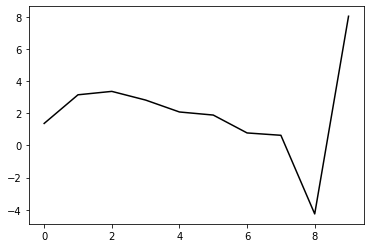

350900 14.075640578030475
0.504740374894532 -0.7268835530287988 -0.13456806704453114 -0.08492896332672115
[ 1.37670676  3.13993141  3.34447278  2.7933886   2.04191979  1.83798623
  0.71777365  0.56007727 -4.34194248  8.05616746]


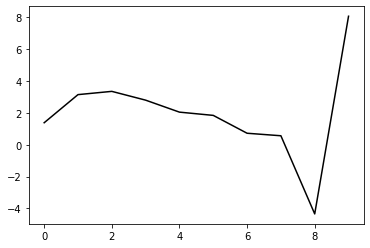

352000 17.71928606343014
0.503738493444177 -0.7278638466316392 -0.1361564167413184 -0.0833532679780456
[ 1.41049383  3.08908476  3.29590225  2.74447653  1.99232635  1.7856744
  0.66582385  0.50428874 -4.4027249   8.02825641]


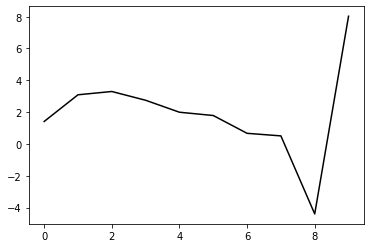

353100 20.690592594645402
0.5088864683661243 -0.7223842288108647 -0.1341642116223396 -0.08377581997241453
[ 1.36937866  3.19647605  3.41645675  2.87277415  2.12520238  1.91823771
  0.79851905  0.62989865 -4.287244    8.0230135 ]


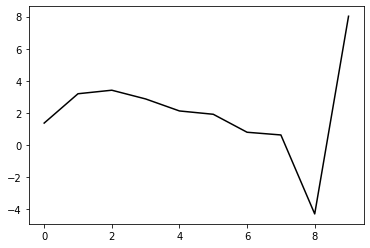

354200 23.43970925097478
0.5036779368311853 -0.7255194848314227 -0.13623603405475973 -0.08380286982283282
[ 1.38646812  3.15929013  3.39400259  2.86244314  2.12578174  1.92576569
  0.81423376  0.64688034 -4.27166096  8.03154851]


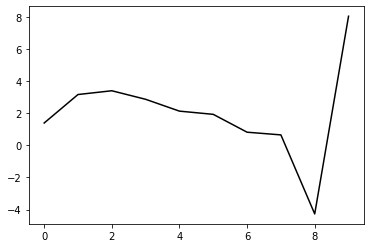

355300 21.370354583008343
0.5034763628911799 -0.719954697570748 -0.13363408255460557 -0.08420860465501871
[ 1.39335059  3.16073577  3.41214014  2.89655033  2.17522512  1.98561865
  0.88412124  0.71547129 -4.21179983  8.0315751 ]


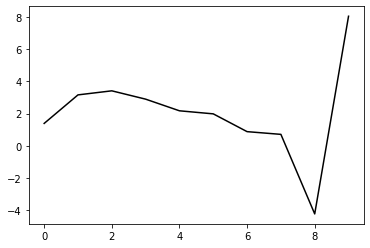

356400 13.905702806363713
0.5029668575992228 -0.7171763795588274 -0.13220897013281085 -0.08372714926355979
[ 1.39830379  3.14987172  3.40201077  2.88480067  2.16114813  1.96639505
  0.86299661  0.68635475 -4.25053711  8.00639952]


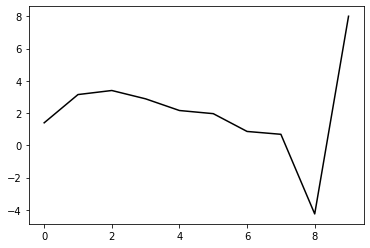

357500 22.109871442465305
0.4978241170407918 -0.7222889530902459 -0.1349593548951214 -0.08507020066028413
[ 1.41157171  3.09333008  3.34415124  2.82455602  2.09978879  1.90507937
  0.80724563  0.63675598 -4.29058935  8.04859837]


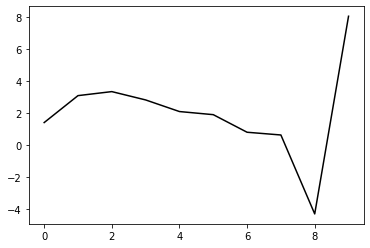

358600 29.342636953496296
0.4856702104353909 -0.7237403461449002 -0.13529811031996455 -0.08311999639344445
[ 1.42284494  2.92758393  3.13522259  2.58199583  1.83381537  1.62299599
  0.51715524  0.34089273 -4.5906101   7.9729628 ]


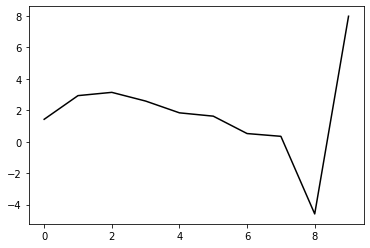

359700 15.564296957610198
0.5068947383620146 -0.7161858503123222 -0.13353104559182308 -0.0883337852542074
[ 1.43052125  3.17321819  3.39273959  2.84194874  2.09206283  1.87701439
  0.76828306  0.58761786 -4.34762149  8.05579727]


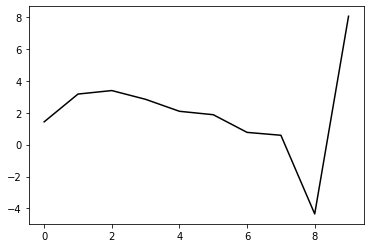

360800 33.071466360850216
0.5055576498814139 -0.7109296362827958 -0.13019049664254634 -0.08986964197839242
[ 1.42225056  3.20686099  3.42858122  2.8771101   2.1259728   1.90802106
  0.7984908   0.61353916 -4.32718752  8.00327049]


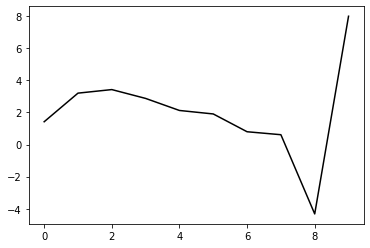

361900 15.036548751255097
0.5073153159755334 -0.7127676103355298 -0.13327468074349114 -0.08714135258013456
[ 1.35310749  3.24313879  3.45285143  2.88764336  2.12357897  1.8927975
  0.77406689  0.57836164 -4.37192273  8.02731535]


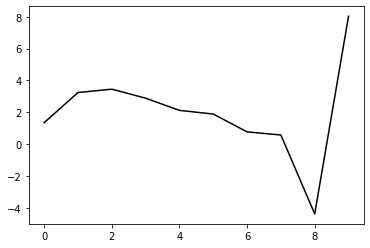

363000 19.600691730662845
0.5097947949833797 -0.7144677678962271 -0.13619677197194927 -0.0837967883436748
[ 1.34105363  3.22680719  3.43631171  2.8689339   2.10317565  1.8702021
  0.7524276   0.55523745 -4.39651179  7.97986126]


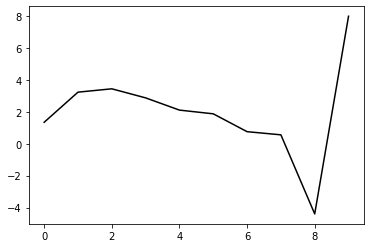

364100 21.267011538517842
0.5068182063071188 -0.7131618027270947 -0.13509314617342297 -0.08619056607814844
[ 1.38060503  3.19244156  3.4128151   2.854269    2.09680024  1.87034743
  0.76066629  0.56794025 -4.38054518  8.02497511]


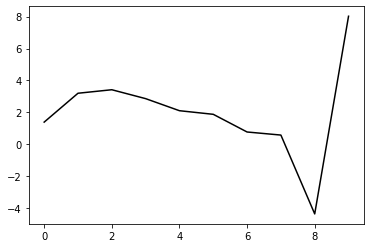

365200 30.91589041001
0.49509884332872667 -0.709913267910903 -0.13082211815731284 -0.09014510059872732
[ 1.43233745  3.04034108  3.24875343  2.68057593  1.91798649  1.68921819
  0.58321731  0.39312827 -4.55233187  7.98724195]


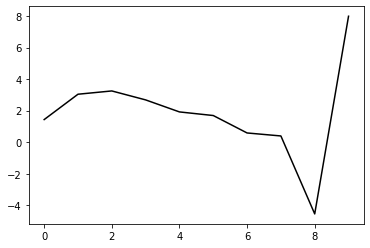

366300 21.95572119900894
0.5069871936655236 -0.7093077507610648 -0.13458136324892256 -0.08508951553834074
[ 1.35546745  3.21366587  3.42749203  2.85818831  2.09118709  1.85473678
  0.74195757  0.54090517 -4.41645639  8.02964348]


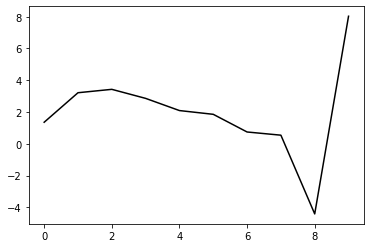

367400 22.68582587000213
0.49117141524606145 -0.7180804391377859 -0.13913906352538447 -0.08373784360022514
[ 1.38015945  3.04279932  3.24135025  2.65854219  1.88164224  1.63812504
  0.52387347  0.32296277 -4.63174745  7.95915066]


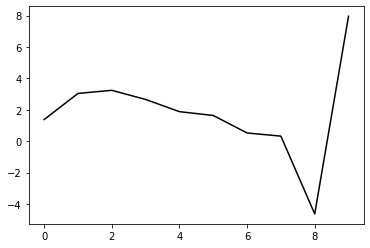

368500 22.489081742233026
0.5051730409030811 -0.7073988743281 -0.13379990384632437 -0.08980474532569628
[ 1.38719493  3.2388508   3.45548829  2.88317965  2.11201374  1.87013772
  0.75730068  0.55452058 -4.40318804  8.00820793]


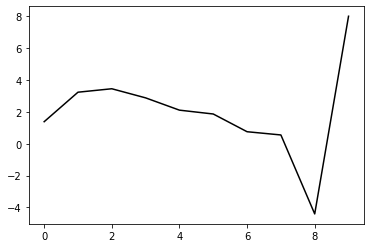

369600 24.967294973891967
0.5071655362876962 -0.7074870251720757 -0.13552617191183608 -0.0877551443585991
[ 1.34992356  3.26810028  3.49579279  2.93138936  2.16674798  1.92842291
  0.81951974  0.61456987 -4.34993333  8.01679853]


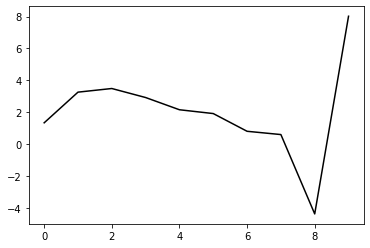

370700 14.299508764362116
0.5027302588926196 -0.7069485095685651 -0.13529910673356235 -0.08834246649189861
[ 1.41424671  3.19195455  3.43495984  2.88497479  2.13499214  1.90953506
  0.81498874  0.61809363 -4.34289603  8.03421358]


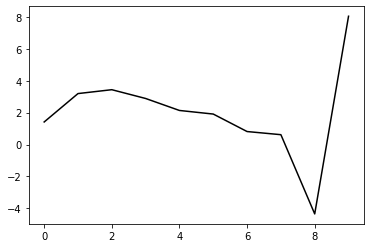

371800 24.289511693508523
0.496299758610793 -0.7054819498204684 -0.13396867032096269 -0.08911842745350877
[ 1.40728869  3.1642615   3.37388946  2.78911347  2.00650663  1.75150976
  0.63454237  0.41846546 -4.5571165   7.98753649]


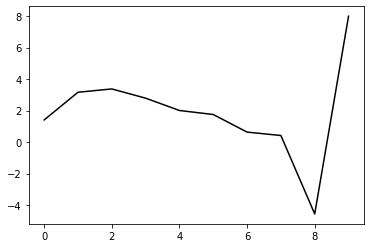

372900 15.702129400510799
0.5068555230662972 -0.7046805479171007 -0.13614573484225173 -0.08906744594203675
[ 1.33916085  3.24892633  3.45967022  2.87307519  2.0882595   1.83027172
  0.71228158  0.49317292 -4.48634649  7.98644461]


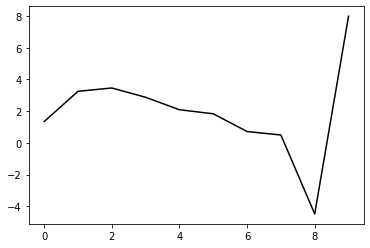

374000 17.20359827072129
0.5021395427289375 -0.7056485346620928 -0.1369625235113457 -0.08796853206470395
[ 1.37708389  3.21129952  3.42472298  2.83889306  2.05447904  1.79584801
  0.67905041  0.45883768 -4.52179436  7.98871827]


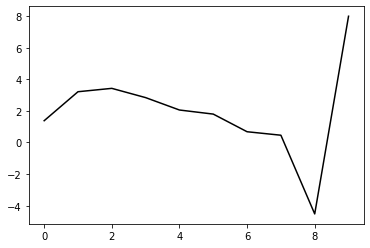

375100 21.589745132192718
0.5093156377427307 -0.7001788195964824 -0.13515628716249994 -0.08798772280820942
[ 1.39243878  3.24491834  3.46969749  2.89098606  2.11199228  1.85604622
  0.74270822  0.52058511 -4.4658298   8.0644651 ]


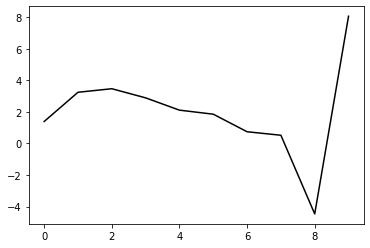

376200 22.96659928374028
0.5080159621101341 -0.7011772942208883 -0.13613907005119605 -0.08711159337241856
[ 1.36480954  3.28064158  3.50726272  2.92632821  2.14332854  1.88087444
  0.76324692  0.53357883 -4.4601301   8.01080796]


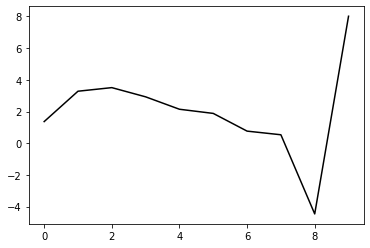

377300 21.34092748026209
0.5035110437520506 -0.7023052854104379 -0.13700309480170553 -0.08728345306442704
[ 1.39819683  3.20512174  3.45337609  2.89292866  2.13051664  1.88632617
  0.78839437  0.57068132 -4.41710591  8.01208432]


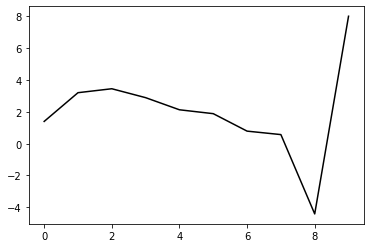

378400 20.14268084322137
0.5026195806214168 -0.6976379535535064 -0.13398595126451873 -0.08816569775643185
[ 1.44860882  3.18991831  3.44925039  2.89778381  2.14359152  1.90476528
  0.81440972  0.59687673 -4.39511717  7.98015289]


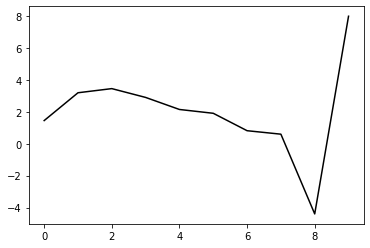

379500 22.498875330377118
0.5038146482855146 -0.6973754027565084 -0.13502707322900986 -0.0862165913458446
[ 1.40724883  3.20285904  3.45489046  2.89241083  2.12540927  1.87085132
  0.76829486  0.53407547 -4.47385318  8.01415458]


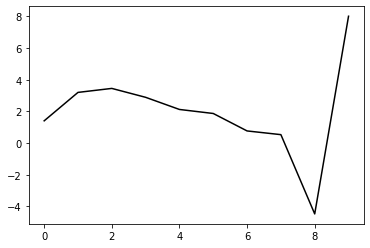

380600 28.911279024231032
0.5009646828406283 -0.6999024969147881 -0.1378649480290681 -0.08436190957988643
[ 1.33396287  3.20399634  3.44546817  2.87069306  2.09140429  1.82329294
  0.71016654  0.46109219 -4.56343457  8.02757867]


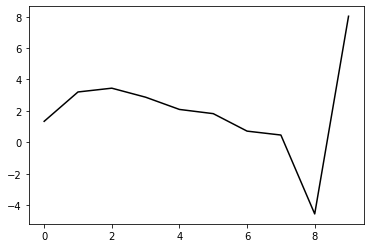

381700 13.880787745503211
0.5014971419048958 -0.6953719705549978 -0.13497356890123363 -0.0882000890729991
[ 1.4131192   3.22221393  3.48658397  2.93070166  2.1672431   1.91145593
  0.81059959  0.56963977 -4.44806555  8.00522038]


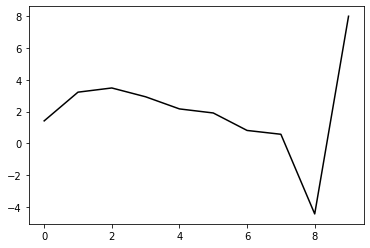

382800 22.25465048327758
0.49888935963335734 -0.693422898813416 -0.13444638381098264 -0.08902081916566697
[ 1.38428088  3.22443558  3.48334383  2.92162529  2.15353522  1.89327921
  0.79113715  0.54642717 -4.47522652  8.00508344]


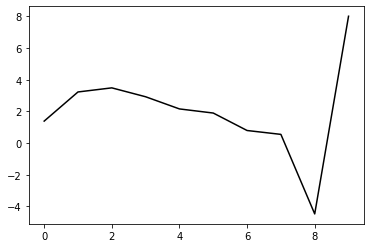

383900 14.660412832222612
0.5012744371770461 -0.6935433735192853 -0.13615703429417145 -0.0871787676171391
[ 1.37261235  3.25205191  3.52564478  2.97528355  2.21610786  1.96096695
  0.86403152  0.61808758 -4.40929441  8.03722131]


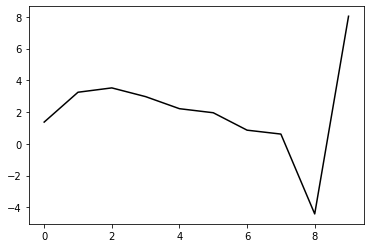

385000 18.652029971018194
0.506132299958841 -0.6903087225382795 -0.13593877841105556 -0.08500399466021023
[ 1.34618573  3.29664439  3.57692408  3.03173386  2.27717933  2.02441095
  0.93142899  0.68300463 -4.35164092  8.02178209]


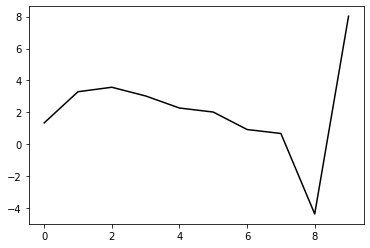

386100 20.684408586875055
0.5012780309190139 -0.691108932704613 -0.13603738244795344 -0.08466101387859426
[ 1.38432514  3.19209595  3.47167073  2.92430569  2.16719098  1.91042657
  0.81678177  0.56413005 -4.47479122  8.04852649]


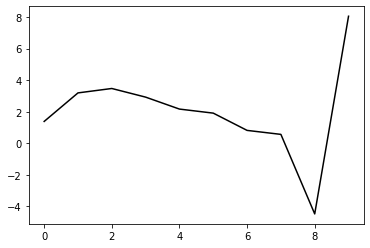

387200 22.56709292988227
0.4957600488292363 -0.690881732900266 -0.1354642250282159 -0.08499821417983919
[ 1.4134645   3.12101147  3.3980622   2.84739272  2.08781698  1.82892417
  0.73886025  0.48696437 -4.55192822  8.0064637 ]


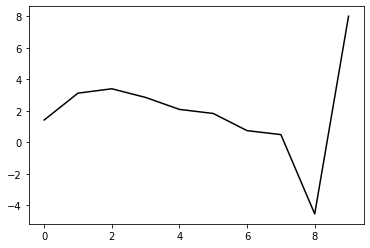

388300 21.368747033533182
0.498702255402737 -0.6900323638527601 -0.1364165465571118 -0.08398908454731817
[ 1.40623659  3.17357835  3.46699047  2.92996303  2.18140821  1.92944288
  0.84640772  0.59495582 -4.44628059  8.00457987]


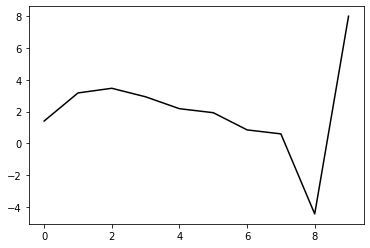

389400 17.70116292123065
0.49524525157109495 -0.6885563074639778 -0.1350965766677449 -0.08635482994400884
[ 1.45542989  3.14711462  3.45600188  2.9335246   2.19850947  1.95743649
  0.88707804  0.64260803 -4.3942832   8.01989908]


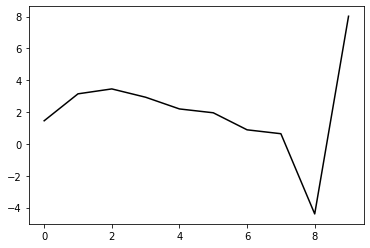

390500 24.246113073662737
0.48404556788798214 -0.6950855433808768 -0.13880290047142305 -0.08328802419819062
[ 1.45946285  2.9756578   3.24187871  2.68083438  1.91206282  1.64170166
  0.55126101  0.29033614 -4.75806977  8.00982912]


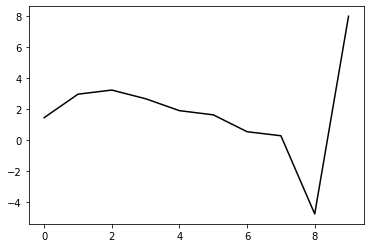

391600 28.57217083794717
0.5067821640805583 -0.6844608833063892 -0.13664404807878305 -0.08327264710046767
[ 1.33841279  3.32724317  3.59424323  3.02626181  2.24654624  1.96247813
  0.85971349  0.58362512 -4.48036154  8.00530692]


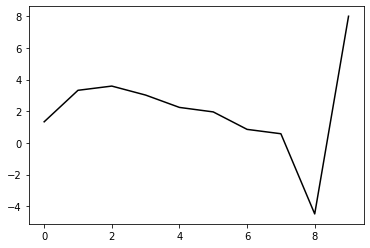

392700 13.97422049576932
0.4974395625399575 -0.6850362997768155 -0.1356992111248185 -0.08675421978850377
[ 1.4319445   3.20363528  3.47832742  2.91830672  2.1470987   1.87106453
  0.77848078  0.51076537 -4.54355938  7.99572746]


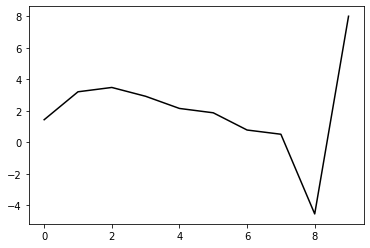

393800 23.068667690286826
0.49846255192228167 -0.68371346545373 -0.13560603496754114 -0.08783972807001646
[ 1.38878105  3.24670201  3.52311627  2.96284532  2.19051184  1.91194995
  0.81883011  0.54789909 -4.51007375  7.97391812]


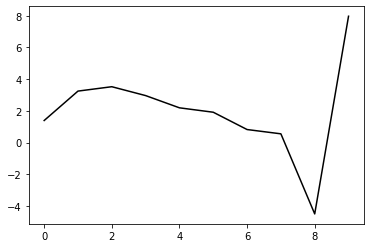

394900 28.228242844227125
0.501164683899891 -0.6851403776057562 -0.1382131105692698 -0.08441597442849355
[ 1.33291768  3.25565971  3.52282487  2.94991759  2.16395367  1.87070561
  0.76722931  0.48394548 -4.58490037  8.02932959]


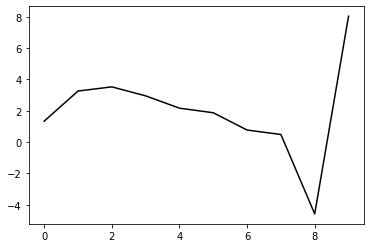

396000 19.025103758542635
0.5025234066396873 -0.6840993991502093 -0.13908816300671742 -0.08469366935641824
[ 1.36003252  3.28341241  3.56297782  3.00028801  2.22322291  1.93675648
  0.84113047  0.56127632 -4.50640679  7.97399075]


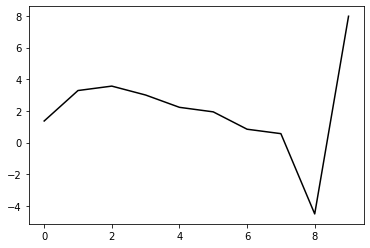

397100 21.85967421747368
0.49847320352551067 -0.6801772803457977 -0.1360782077179205 -0.08691037165016825
[ 1.44523107  3.16646825  3.44087309  2.87405232  2.09509909  1.80806539
  0.71650584  0.43945481 -4.62436073  8.02672384]


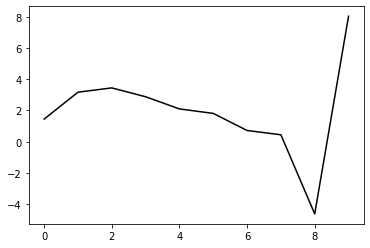

398200 22.835224138638797
0.5009426508169199 -0.6796546738067207 -0.1372307522825813 -0.08575531894685853
[ 1.38498131  3.24357638  3.52397937  2.95919145  2.17980567  1.88948783
  0.79572699  0.51204013 -4.56020576  7.98079412]


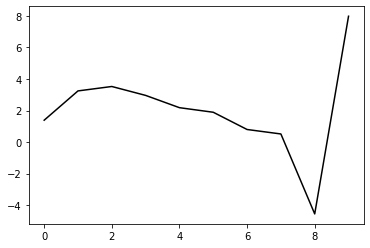

399300 25.062103647420773
0.48653669367064556 -0.6818051321996788 -0.13673175709139812 -0.08813432267453869
[ 1.41768013  3.07675237  3.35115123  2.7844139   2.00705441  1.72093296
  0.63565416  0.35895317 -4.70715556  7.9808639 ]


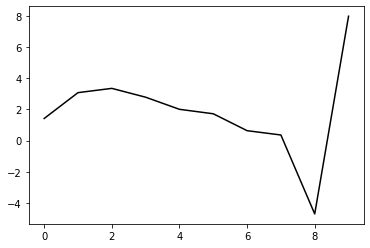

400400 15.418071348176651
0.49115203267909596 -0.678466451797314 -0.13647842390287981 -0.0871066255879938
[ 1.39569863  3.15847     3.42218683  2.84354687  2.05420028  1.75589107
  0.66162361  0.37487527 -4.69907933  7.9649537 ]


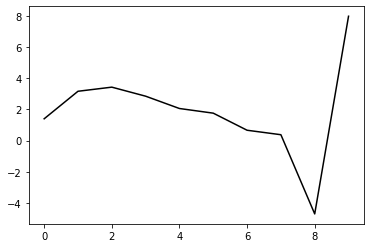

401500 22.252771525039435
0.4978724825067744 -0.6762436451940655 -0.1366360644442689 -0.08956417539315974
[ 1.39468425  3.26614793  3.55458524  2.99556431  2.22207553  1.93613963
  0.85385102  0.57540442 -4.49273694  7.98572439]


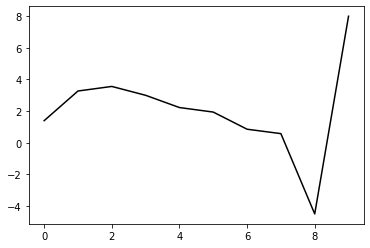

402600 24.872434608162404
0.49662602958926894 -0.6781049872453445 -0.13889431467318172 -0.08666383072150904
[ 1.38131515  3.2133997   3.49564111  2.93167042  2.15490017  1.86580916
  0.7836448   0.50229195 -4.56907185  7.98169988]


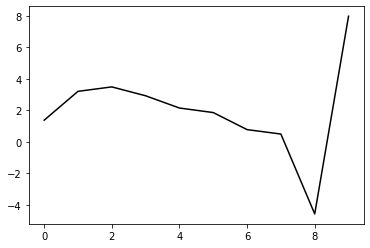

403700 14.786578548951395
0.4991647491558155 -0.6728596148562922 -0.13598758552522786 -0.08837834250936176
[ 1.42859441  3.22099664  3.51617449  2.9618873   2.19279748  1.90877053
  0.8330124   0.55331333 -4.51891125  8.00538947]


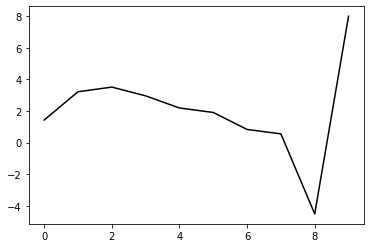

404800 23.08652890089032
0.4967532549666961 -0.6733816994617404 -0.13651397143782507 -0.08802131266945035
[ 1.3876633   3.23274703  3.5332438   2.98141567  2.21254344  1.9255435
  0.8485685   0.56277596 -4.51691689  7.95478211]


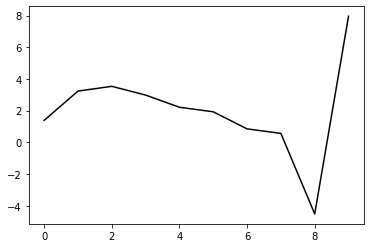

405900 14.31909088622022
0.4974408481066189 -0.6742425759504351 -0.13801250151017225 -0.08656359674225761
[ 1.38653529  3.24901817  3.55742815  3.00985567  2.24196204  1.95182722
  0.87404805  0.58222086 -4.50392218  8.01727656]


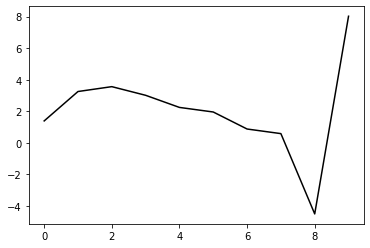

407000 18.980831059495216
0.501146304166658 -0.6723300672494329 -0.13868317711743236 -0.08478036747400133
[ 1.35983287  3.29709357  3.6238315   3.09302573  2.33924431  2.057741
  0.98698072  0.69108968 -4.40761024  7.98838101]


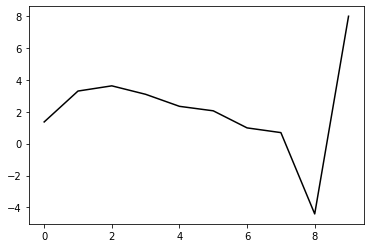

408100 20.41069248605948
0.4971448829314383 -0.670376807762275 -0.1378335571118664 -0.0830642781087152
[ 1.39954576  3.18071949  3.49783398  2.95846454  2.19721443  1.90799918
  0.83304988  0.52929931 -4.578048    8.01262646]


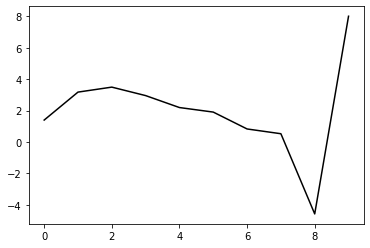

409200 22.651627204004786
0.4930264957249966 -0.6723373168566122 -0.1390325342311527 -0.08345990442730353
[ 1.42613856  3.14396113  3.46250785  2.92438258  2.16528054  1.8788321
  0.81113062  0.51239943 -4.59016903  7.98634898]


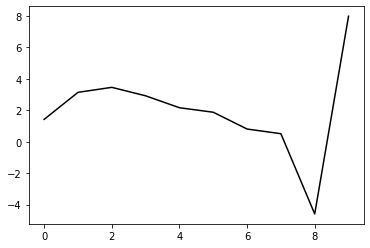

410300 23.74548304177865
0.4881651611672256 -0.6698263448488162 -0.1370260956641927 -0.08459410476906824
[ 1.40542354  3.08235113  3.38402578  2.83144939  2.06098462  1.76569431
  0.69493261  0.39322391 -4.71138701  7.97206042]


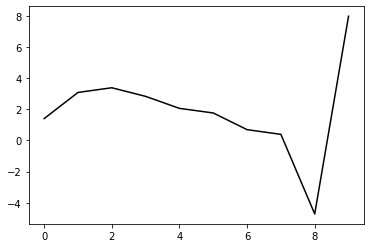

411400 16.48535489457424
0.48787427639202474 -0.6709893283046197 -0.1388355538810726 -0.08374470911806124
[ 1.41335504  3.14060431  3.44946984  2.89991303  2.12936273  1.83134293
  0.75918444  0.45343113 -4.65390981  7.96599548]


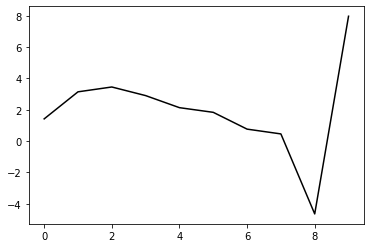

412500 22.049768968621333
0.49428106583125814 -0.6660780743022425 -0.13717606924570316 -0.08667030704180885
[ 1.40271249  3.25932333  3.5899754   3.05677177  2.2981598   2.00779053
  0.94235427  0.63783612 -4.4722705   8.03908128]


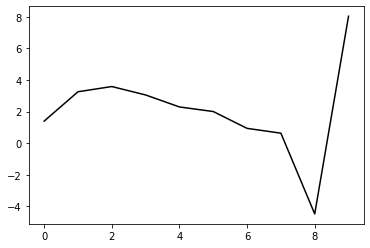

413600 26.11871541580021
0.49440510927760983 -0.6689551993755282 -0.1398725673362934 -0.08602995706986613
[ 1.370194    3.29693005  3.63354179  3.10229045  2.34258382  2.04820676
  0.98060861  0.67071498 -4.4448511   7.9890596 ]


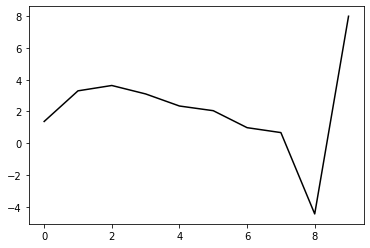

414700 15.682323060891747
0.48140996801039815 -0.6655857387456756 -0.13601080567137688 -0.08724339335425882
[ 1.44500396  3.06122121  3.35230858  2.78666944  2.00302632  1.69264086
  0.61773078  0.30355994 -4.81353438  7.96739082]


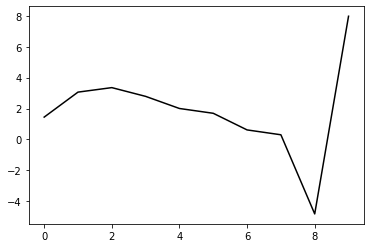

415800 23.272151998817478
0.4950126709479588 -0.6624290346611733 -0.1368721735123288 -0.08577913581329412
[ 1.3725565   3.20003166  3.48365538  2.90741223  2.1126398   1.79127635
  0.70883321  0.38676987 -4.7361534   7.95704479]


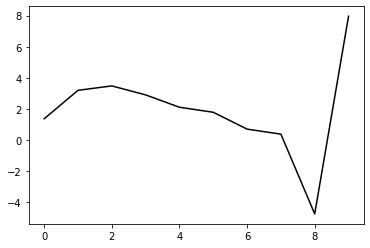

416900 14.50184392776597
0.49096875909833887 -0.6658998460682585 -0.13917505311839917 -0.08828501019887003
[ 1.41704756  3.22257752  3.53019529  2.9726156   2.19125026  1.8787713
  0.80466583  0.48785904 -4.63025736  7.98323571]


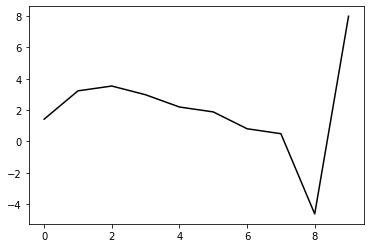

418000 18.27982960413214
0.49618124601140473 -0.6680197836879966 -0.14294368212725375 -0.08348277195174425
[ 1.38071115  3.17583278  3.47363678  2.90826819  2.12155407  1.80474841
  0.7301234   0.41046089 -4.71099136  7.9810004 ]


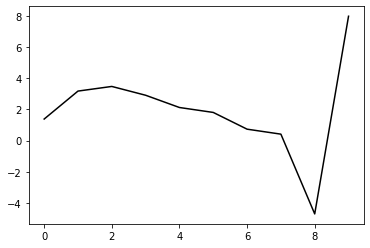

419100 21.400642945044957
0.49605931674771475 -0.6593818204269595 -0.13739310493925672 -0.08807691466713408
[ 1.44289559  3.20924714  3.52370515  2.9724716   2.19737271  1.88863438
  0.82139001  0.50254906 -4.62282466  7.9933553 ]


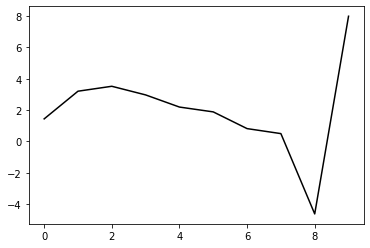

420200 22.603110189264207
0.4946365710812421 -0.6586163118221641 -0.13797305102429175 -0.08505724670268432
[ 1.39808205  3.21648182  3.52804775  2.97383781  2.19577446  1.88277883
  0.81281527  0.48629737 -4.65034679  8.01479574]


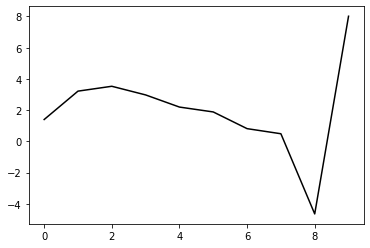

421300 22.246527285540907
0.49185027646872015 -0.6579615994751303 -0.13759916636743075 -0.08652787081812287
[ 1.40282581  3.21575656  3.54533492  3.00686876  2.24256114  1.940515
  0.88217676  0.56177121 -4.57223662  7.99941844]


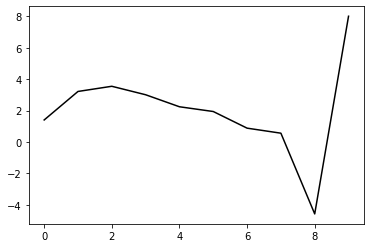

422400 14.120502113690783
0.49131448744218154 -0.659661763518263 -0.13922305234028218 -0.0856830485993728
[ 1.41923347  3.19407576  3.52284378  2.98376815  2.21953118  1.91787301
  0.86376066  0.54594026 -4.58501495  7.97538629]


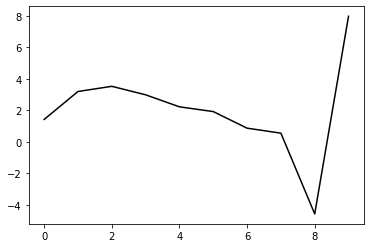

423500 21.27831942382802
0.48804937660234715 -0.6612901371683155 -0.14072184677653013 -0.08489142468409683
[ 1.40488516  3.14609807  3.46219341  2.91002646  2.13361265  1.82102775
  0.76152821  0.4382753  -4.69594217  7.98358599]


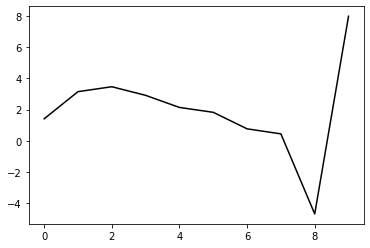

424600 24.95752636381426
0.4906882866632537 -0.6588617759056626 -0.14038767426659332 -0.08533445944795233
[ 1.39289224  3.19528708  3.5208761   2.97711342  2.20773432  1.89997489
  0.84606583  0.52414689 -4.61027155  7.96215883]


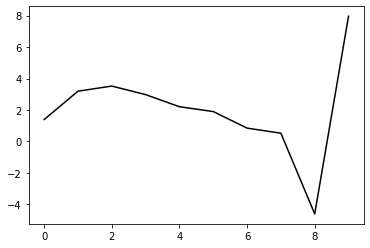

425700 13.640674805189558
0.4859811490499746 -0.6570145728996765 -0.13903328158605022 -0.08701418138973203
[ 1.43796596  3.16414746  3.50164783  2.96828642  2.20764469  1.90612502
  0.85896812  0.5387508  -4.59726156  7.9821633 ]


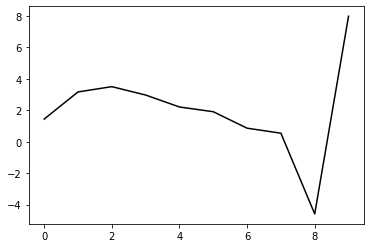

426800 21.954100985408637
0.4872594494408637 -0.6539835665632973 -0.1377090006385932 -0.08899145933273499
[ 1.42146269  3.2238877   3.56991544  3.04405543  2.28959412  1.99224655
  0.95032072  0.63121668 -4.50568948  7.98841614]


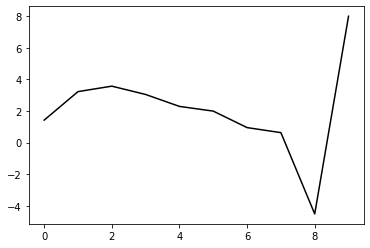

427900 13.931966155505608
0.48707543670495895 -0.6522380308859937 -0.13784357765282282 -0.0868303850313145
[ 1.3959075   3.22089244  3.564497    3.03640275  2.2796398   1.9785604
  0.93444275  0.60785367 -4.53992724  8.02156235]


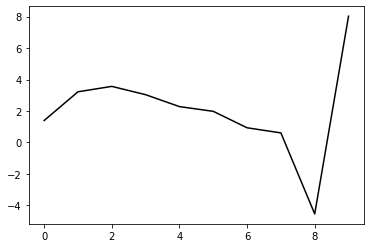

429000 15.677294832836745
0.4923475674714524 -0.6506027248883686 -0.13894497189140018 -0.0846915840511819
[ 1.38338356  3.26118414  3.61405619  3.09358634  2.34271106  2.04481919
  1.0046715   0.67613436 -4.47811375  7.9864858 ]


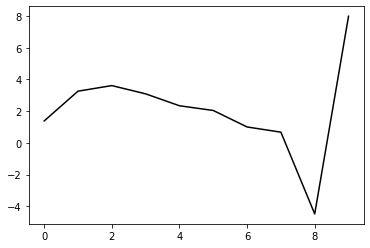

430100 21.44740062377025
0.47919343056642655 -0.6536030536945483 -0.1380803690688559 -0.08800871998638074
[ 1.4330016   3.12303673  3.46477637  2.93480933  2.17646376  1.87280875
  0.8325822   0.50444281 -4.64519946  8.01158761]


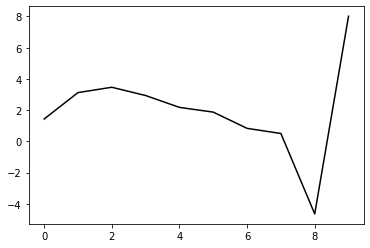

431200 22.75196778857532
0.48687082924705904 -0.6500650311835267 -0.13857756390374695 -0.08460044216856602
[ 1.40227084  3.17151028  3.51374715  2.98375101  2.22438771  1.91759922
  0.87540793  0.53990536 -4.62071825  7.94770062]


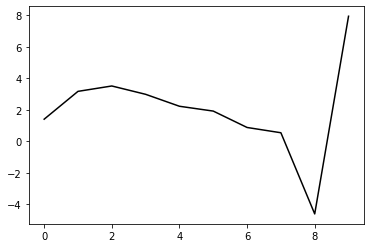

432300 21.488728092483793
0.48803544705887597 -0.6481270848236522 -0.13824875493285635 -0.08364689757913522
[ 1.39510507  3.1653463   3.51294003  2.9864669   2.22885275  1.92152602
  0.88069551  0.54258906 -4.62185872  7.99533617]


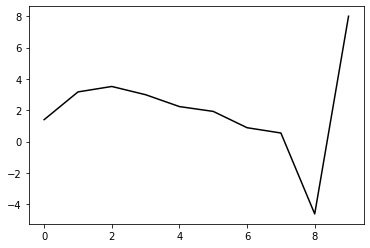

433400 14.945339585545293
0.48595167516950344 -0.6484547091354544 -0.13855868118816372 -0.0850802015219973
[ 1.3917443   3.20159141  3.55994968  3.04222165  2.29090074  1.98703236
  0.95123031  0.61387847 -4.55076728  7.99040907]


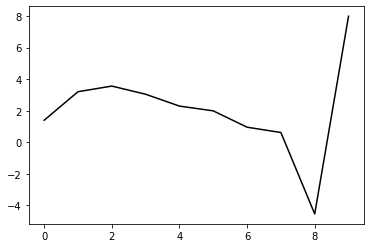

434500 22.16234241157847
0.48704145793906717 -0.6456207100580387 -0.13719901300741918 -0.08622551098389912
[ 1.40543038  3.20589075  3.57467471  3.06643871  2.32316392  2.02524027
  0.99726231  0.66352464 -4.49942538  7.99690489]


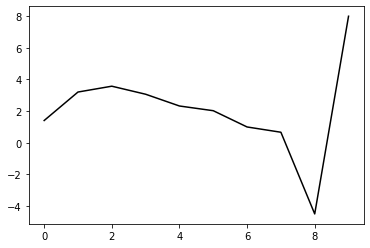

435600 24.100759726718714
0.48449212044379236 -0.6488619283147795 -0.139149497735666 -0.08628518249595517
[ 1.3814188   3.21869273  3.58929643  3.08033879  2.33379044  2.03022232
  0.99916147  0.66003185 -4.506956    7.98878963]


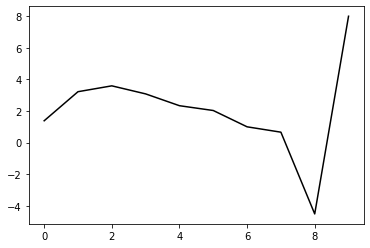

436700 13.71358420402723
0.48232531885698565 -0.6481942625568966 -0.1389725435452431 -0.08621669637147725
[ 1.43895924  3.14566117  3.52267989  3.02071572  2.28106318  1.98324618
  0.9603879   0.62519048 -4.53972373  8.00657569]


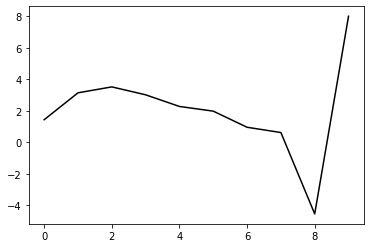

437800 28.519018489569863
0.47861487337165504 -0.6448331732154042 -0.13630009906249269 -0.0886222893096739
[ 1.44400317  3.13243472  3.50599635  3.00087165  2.2582009   1.95732798
  0.93433964  0.59770698 -4.56758783  7.98735094]


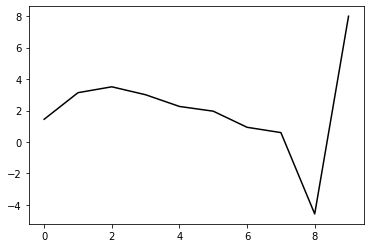

438900 14.355771309295541
0.4800801006744847 -0.646835546075017 -0.13938886228316602 -0.08716746777592234
[ 1.38168073  3.18432266  3.53741652  3.0124005   2.25126446  1.93371284
  0.89884615  0.55125606 -4.62249732  7.98153655]


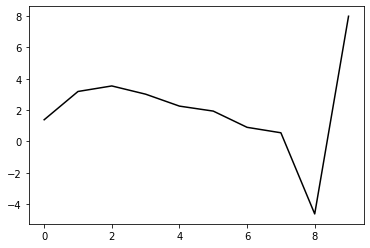

440000 17.92445882078747
0.48658742873441707 -0.6449571291674119 -0.14054219122667447 -0.08553362306524279
[ 1.35999474  3.27077494  3.63290813  3.11310263  2.35391321  2.03523801
  0.99976199  0.64750082 -4.53379123  7.95030436]


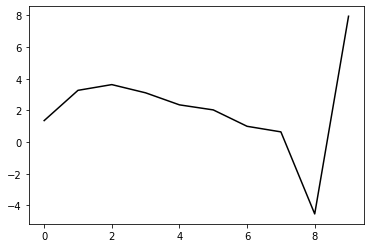

441100 21.5621995220897
0.4841365855142575 -0.6423791005501435 -0.13915663584837648 -0.0853578243201164
[ 1.40494912  3.16044843  3.53015382  3.01858407  2.2672726   1.95467173
  0.92667031  0.5764834  -4.6057752   8.00910031]


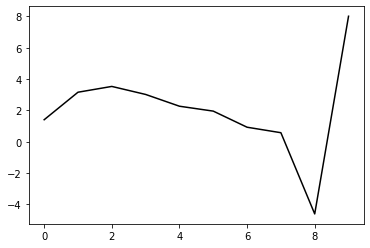

442200 22.998778864111127
0.4799876292872562 -0.6465549941766925 -0.141784703898405 -0.0849037322632209
[ 1.39220554  3.13512661  3.51667145  3.01579787  2.27315021  1.96663988
  0.94648673  0.59980232 -4.58064908  7.97054049]


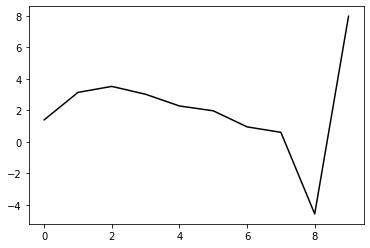

443300 32.61826076006193
0.47052966030559473 -0.6402482454526395 -0.1358436946279928 -0.08788338232329478
[ 1.47375488  3.01830422  3.39766711  2.89612027  2.15280743  1.84463959
  0.82579512  0.47671059 -4.70741752  7.95120577]


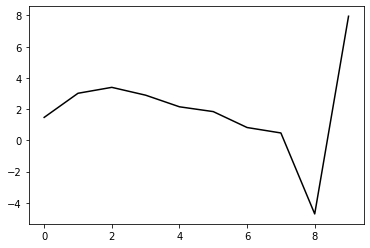

444400 18.259786673767728
0.48174199097566983 -0.6343609520997028 -0.13532964021818603 -0.08515929761830397
[ 1.43597616  3.14039357  3.50372984  2.9861777   2.22739988  1.90456325
  0.87441044  0.51410949 -4.6804716   7.98292987]


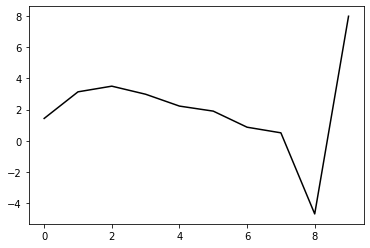

445500 22.014695578176376
0.4819049716546129 -0.6379039110631756 -0.138574897661888 -0.08569383499378741
[ 1.4000591   3.16226396  3.5313233   3.01834323  2.26262376  1.94106748
  0.91347754  0.55315916 -4.64200468  8.02597151]


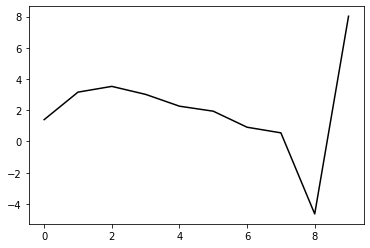

446600 24.478425839336122
0.47641167998095846 -0.6424227286629548 -0.14114186600633513 -0.08716178569435139
[ 1.3848682   3.14586653  3.52234837  3.01744832  2.26941645  1.95436395
  0.93478049  0.57960317 -4.61085724  7.97971818]


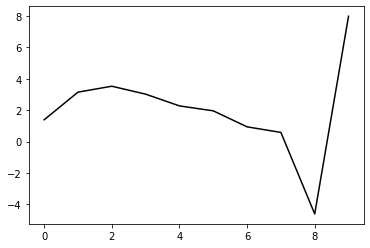

447700 16.99027829686297
0.4737149987409186 -0.6381566711200006 -0.13871132806892758 -0.08943632449956458
[ 1.45562175  3.08561628  3.46829401  2.97171961  2.23245891  1.9253087
  0.91493807  0.56542925 -4.62086046  7.98609791]


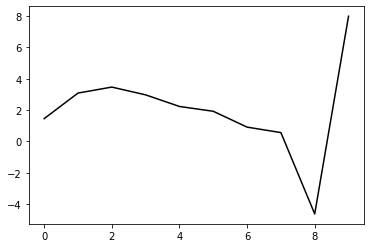

448800 21.771957244729382
0.47715923392325976 -0.6380862742466233 -0.14024814971221033 -0.08955333845431004
[ 1.41304335  3.16733384  3.56058623  3.06971139  2.33187129  2.0227899
  1.01135548  0.65718884 -4.53562364  7.9626234 ]


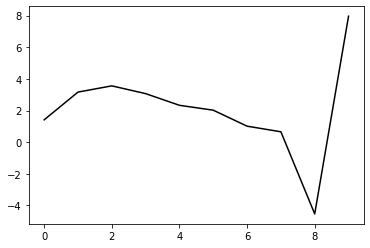

449900 15.925009517433894
0.4772100310095211 -0.6365405452772948 -0.14065618400846192 -0.08630495659315592
[ 1.36733305  3.17328599  3.55800688  3.06015998  2.31622602  2.00063593
  0.98518877  0.62261789 -4.58128987  8.00356708]


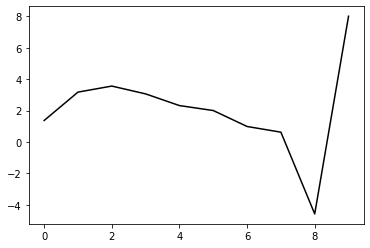

451000 17.232725516752765
0.48199727883749616 -0.6331779023824886 -0.1403406020284362 -0.08470676683274139
[ 1.36470581  3.21573935  3.60855717  3.11851123  2.3811652   2.07010463
  1.06014232  0.69824165 -4.50843023  7.98176225]


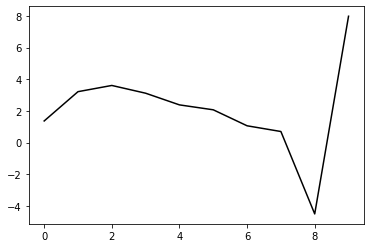

452100 22.043134614220186
0.4785473432554887 -0.6297883411500763 -0.1380101690958566 -0.08596588629299706
[ 1.44866625  3.11329914  3.51183518  3.02723109  2.29400015  1.98477265
  0.97802284  0.61426637 -4.59661795  8.02154981]


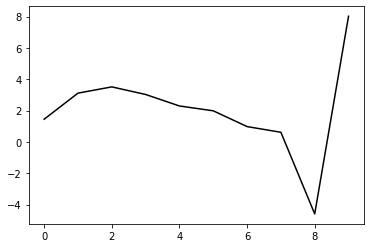

453200 22.60056931398751
0.4715302343934503 -0.6305878569290989 -0.1383181516157991 -0.08486029982550457
[ 1.41088165  3.0596177   3.45196635  2.96250452  2.22453267  1.90965025
  0.8992591   0.52821432 -4.69195088  7.93317987]


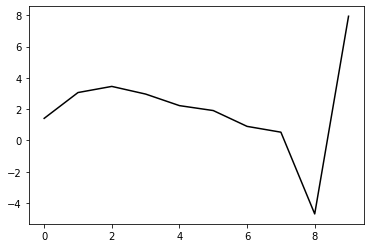

454300 21.01630565126926
0.473915029245685 -0.6328604212754042 -0.14124220657050973 -0.08280372517076963
[ 1.40966785  3.09764898  3.50332193  3.02620246  2.29846559  1.99140361
  0.98970746  0.62364452 -4.59276753  7.98405677]


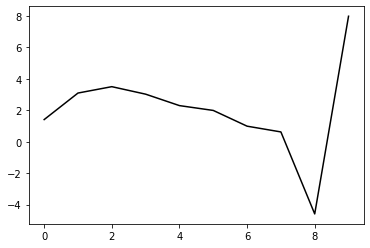

455400 14.667627208318578
0.4667967079913028 -0.6354351084164347 -0.14196997210319254 -0.08454944466299541
[ 1.4396909   3.04816713  3.45632939  2.98283669  2.25840047  1.95408115
  0.95824267  0.59625351 -4.61489472  7.979755  ]


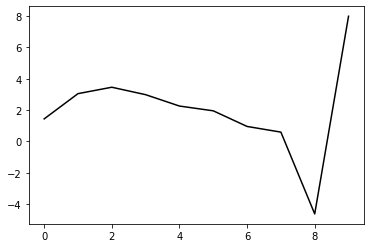

456500 24.42092237020332
0.4725831598720912 -0.6323803279669502 -0.14183342787444617 -0.0846521889325209
[ 1.39068588  3.17674139  3.59812122  3.13433767  2.41515541  2.11152132
  1.11623653  0.74865645 -4.47215669  8.01496355]


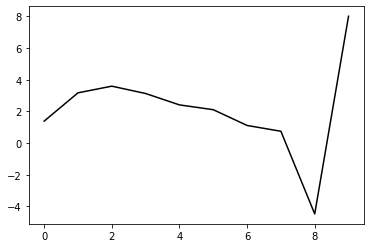

457600 25.371146299928583
0.4746746233835057 -0.6313364798422273 -0.14220190682972936 -0.08282491142291099
[ 1.39456886  3.1956966   3.58280102  3.0879254   2.34272605  2.01827621
  1.01031109  0.63260951 -4.59318648  7.940279  ]


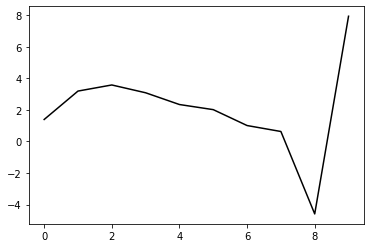

458700 18.02657531544596
0.4717507278212914 -0.6282173378103575 -0.13998965614266642 -0.08672907602536865
[ 1.49411107  3.11267877  3.52525784  3.05505417  2.331267    2.02395393
  1.03226024  0.66468166 -4.55501454  8.0026633 ]


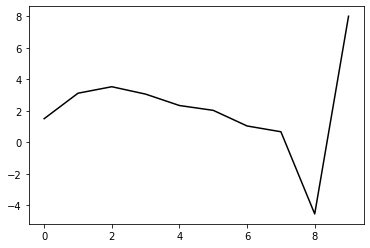

459800 25.489124700543094
0.47147254247089887 -0.6258866392296784 -0.13905588950464304 -0.08659285656105152
[ 1.46313337  3.15515883  3.55151251  3.06535257  2.32639278  2.00509106
  1.00423836  0.62771287 -4.59814584  7.98555322]


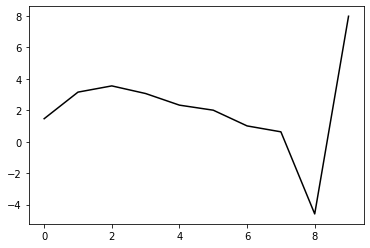

460900 13.618065560921272
0.4766627951227201 -0.6254099349169454 -0.14052862921042428 -0.0849609667791819
[ 1.42050625  3.23693412  3.63365118  3.14558337  2.40258187  2.07522757
  1.07049018  0.68717605 -4.54597535  8.00381615]


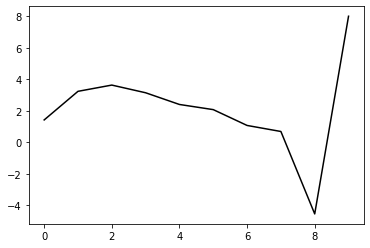

462000 33.79493031234306
0.47660015510164344 -0.6340955068703331 -0.14793430691976853 -0.07892952878654477
[ 1.37712122  3.12609858  3.50504662  3.00433176  2.25334069  1.92132206
  0.91840878  0.53685637 -4.69139524  7.968303  ]


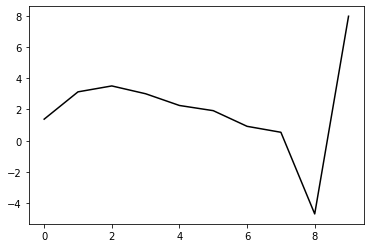

463100 31.927985057731796
0.46726820635787203 -0.6255279974323871 -0.1401186984185352 -0.08706446857877999
[ 1.51470183  2.96093354  3.34148297  2.84815984  2.10648207  1.78343333
  0.79123094  0.41772568 -4.80352937  8.00132186]


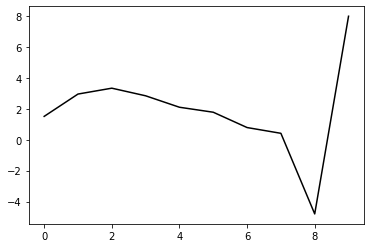

464200 23.997794274846825
0.47648225554969287 -0.6277518156448897 -0.14445166464999445 -0.0839827047773226
[ 1.41351605  3.13347495  3.48720495  2.96590202  2.19771665  1.85080717
  0.8399219   0.45009217 -4.78446738  7.97162096]


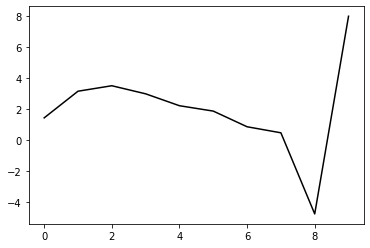

465300 20.833847914596465
0.47793967025352857 -0.6255633084176996 -0.14374780646940877 -0.08601235952872556
[ 1.40481441  3.19589048  3.56291549  3.05256359  2.29295861  1.95203322
  0.94690655  0.55904971 -4.6766844   7.95609785]


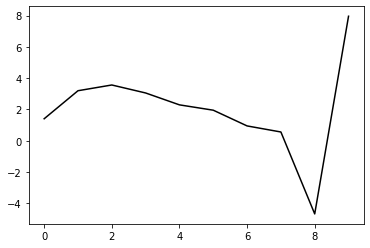

466400 24.540850022565195
0.46685109905567784 -0.6317650808139447 -0.14770779686620542 -0.08286767993380709
[ 1.40589206  3.02554503  3.36565334  2.83576879  2.06302391  1.71358191
  0.70597006  0.31689407 -4.9182902   7.92786481]


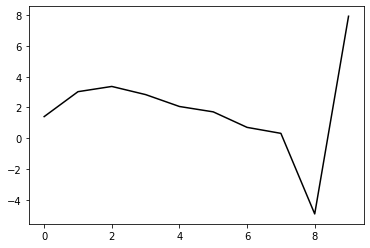

467500 22.218825110125344
0.4847950518656758 -0.6170382898444243 -0.14018440439534582 -0.0886219263628946
[ 1.39538294  3.28008677  3.62769138  3.09877435  2.32313468  1.96826792
  0.95572977  0.55935478 -4.68455001  7.97017419]


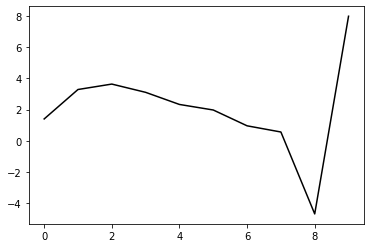

468600 27.601826723209474
0.4752603445283815 -0.625513027910202 -0.14618351194887763 -0.08516629671996581
[ 1.39775715  3.1411323   3.47863273  2.94292329  2.16308482  1.80531872
  0.7931396   0.39625418 -4.84655641  7.94125529]


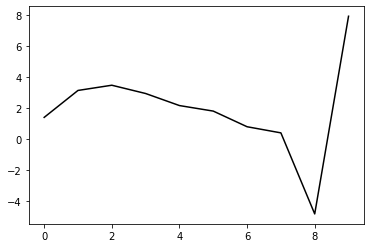

469700 14.31788714489832
0.48155483530030174 -0.619392171112046 -0.14285995723243575 -0.08980581301217241
[ 1.43075661  3.23596724  3.59996151  3.08482052  2.32053722  1.97406104
  0.97239535  0.58193194 -4.65761611  7.98801392]


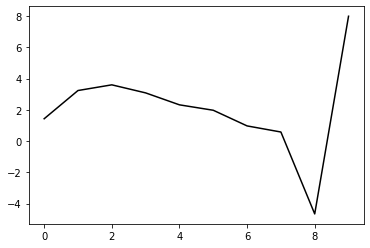

470800 27.209427206244392
0.4724523744281546 -0.6180477093829722 -0.14092589619387014 -0.09224554854985531
[ 1.44684627  3.18239464  3.52242031  2.98568479  2.20280547  1.84045888
  0.8283577   0.42883117 -4.81610192  7.94207911]


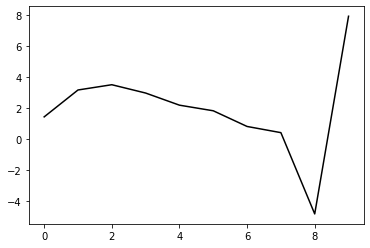

471900 26.28267860251399
0.4857695553964079 -0.6174033465374151 -0.1441629204796007 -0.08792244457081963
[ 1.33232093  3.28814569  3.61401328  3.06235207  2.26544206  1.88958111
  0.86708027  0.45538664 -4.80242333  8.00995023]


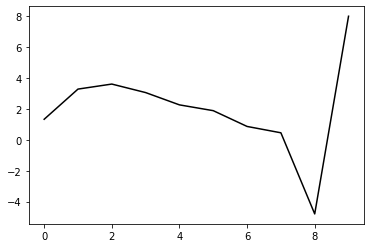

473000 17.330303324060694
0.4817958978381739 -0.6174229601365656 -0.14429581495194993 -0.0887271311568471
[ 1.35730827  3.2653144   3.5978591   3.05245737  2.26103309  1.88924481
  0.87180438  0.46232566 -4.7942485   7.96373507]


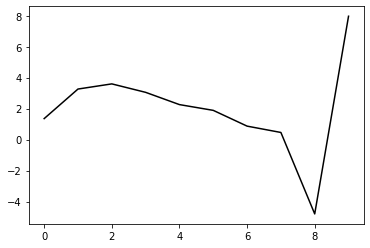

474100 20.52925937508926
0.4827716851977334 -0.6155367220191594 -0.1440281447390895 -0.08829682760486408
[ 1.38372586  3.22950819  3.57405167  3.04036354  2.26011374  1.89762466
  0.89024605  0.48529105 -4.77119125  7.93434327]


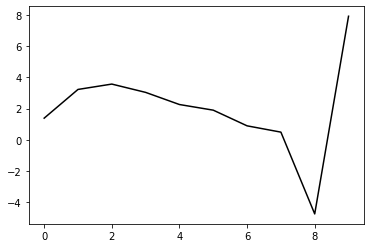

475200 23.275451101353895
0.47899135862602843 -0.6130492918660267 -0.14222677322396082 -0.08958263167431946
[ 1.41910119  3.18605484  3.54522657  3.025417    2.25719474  1.90312571
  0.90396197  0.49917236 -4.76369132  7.9431199 ]


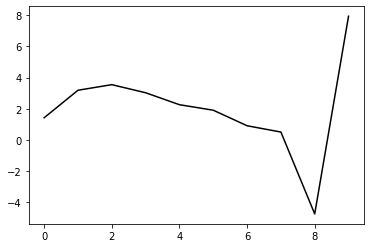

476300 22.33006809822558
0.4796148182243282 -0.6108332141347822 -0.1413939754390004 -0.0885622406417511
[ 1.39817414  3.22144741  3.58418421  3.06692797  2.3002411   1.94582055
  0.94782539  0.53928176 -4.7302245   7.97274756]


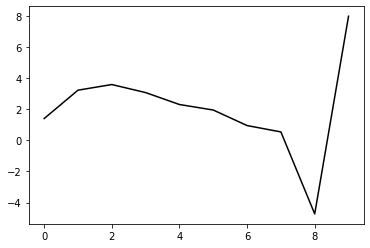

477400 20.0680303474765
0.4795818080533331 -0.6080315885125549 -0.13968337004843828 -0.0887170168557831
[ 1.45104265  3.18104461  3.55004028  3.03790221  2.2752515   1.92335217
  0.92999857  0.52301976 -4.74565201  7.92246782]


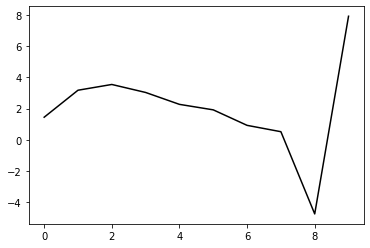

478500 24.488383017451735
0.47933575662961087 -0.612615530521934 -0.1437972023368422 -0.08840737542589452
[ 1.37814423  3.24525673  3.63747239  3.14646378  2.40130078  2.06203099
  1.0798403   0.67654024 -4.59403743  7.99353297]


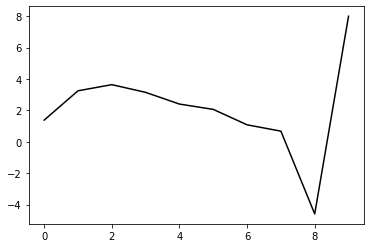

479600 24.332718015819164
0.47886382393385624 -0.6123635218920568 -0.14416975132808066 -0.08833652130489902
[ 1.39031376  3.26298607  3.65124329  3.15293563  2.39774869  2.04694534
  1.05749267  0.64617569 -4.62926791  7.99385939]


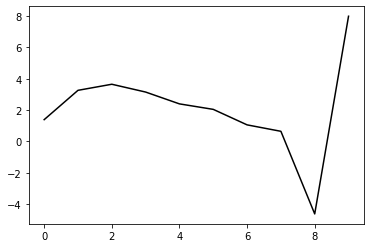

480700 15.777408786906957
0.4788249420344812 -0.608211542977943 -0.14201385560840415 -0.08890062020953642
[ 1.45520612  3.18297289  3.58243162  3.09540221  2.3504603   2.00754464
  1.02718717  0.61871361 -4.65782521  8.00112466]


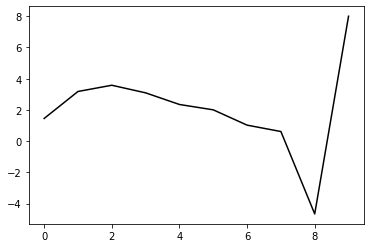

481800 22.62631525722661
0.4748926128882125 -0.6078279376618724 -0.141840380452844 -0.08882669354644897
[ 1.44244108  3.19802094  3.60198219  3.11837174  2.3753189   2.03250944
  1.05397723  0.64407748 -4.63440599  7.97402453]


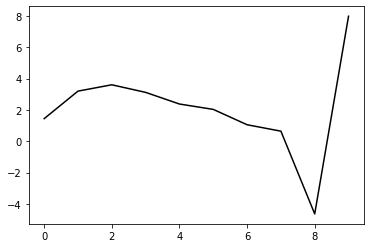

482900 13.592652544709614
0.4776257622694449 -0.6081902170228621 -0.14368787831181581 -0.08699287127362709
[ 1.41643914  3.21034524  3.62366941  3.14799425  2.41075437  2.07112661
  1.09658906  0.68604542 -4.59602934  7.98535538]


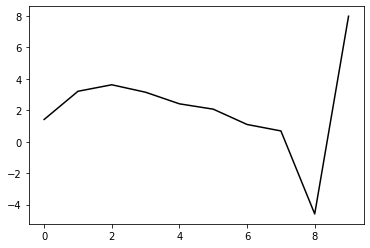

484000 16.868395759226832
0.4735462585647076 -0.609028495148623 -0.14415490592222185 -0.08565598682730599
[ 1.42375915  3.1385906   3.54424303  3.0619351   2.31863004  1.97289789
  0.99579688  0.58040183 -4.7063444   7.92841796]


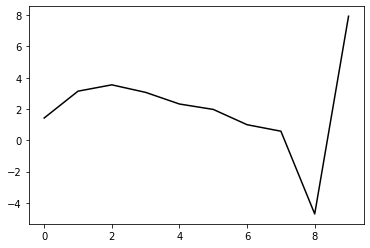

485100 20.273757823772108
0.47048948377408206 -0.6123141207860401 -0.1466568105589262 -0.08370245284050515
[ 1.40619067  3.13618941  3.54473694  3.06497151  2.322918    1.97667511
  1.00089551  0.58353123 -4.70580276  7.98743681]


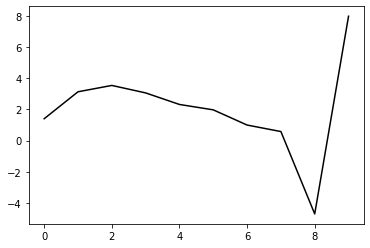

486200 22.696503536629532
0.4741163527527729 -0.6050868605612895 -0.14333267429676952 -0.08409331837061039
[ 1.41475265  3.14855709  3.55143291  3.06630506  2.31830697  1.9647047
  0.98358162  0.55662733 -4.74530384  7.95573784]


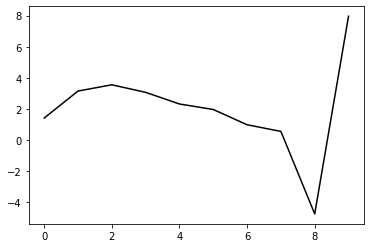

487300 20.481846815047827
0.4712225484881102 -0.6090439140216505 -0.14613116420040786 -0.08402673780122084
[ 1.43104582  3.12942499  3.55576601  3.09424939  2.36788385  2.03279692
  1.07065811  0.65677057 -4.6355679   8.01923848]


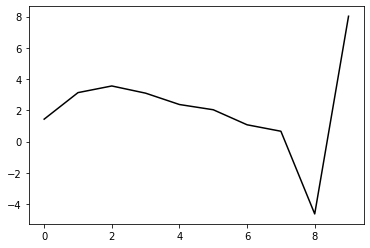

488400 22.160039880166227
0.46942220910198607 -0.6018347029543083 -0.14105493851895218 -0.08605375969811517
[ 1.48789401  3.10898433  3.53965222  3.08287979  2.35980703  2.02585216
  1.0666844   0.65190364 -4.64256537  7.98145815]


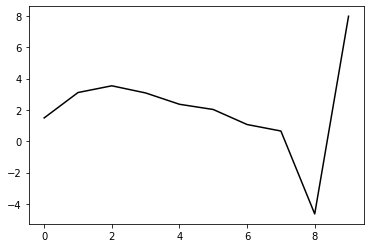

489500 22.090199835548603
0.4707587977462524 -0.6040768930529602 -0.14418624638347496 -0.08236314800535267
[ 1.40139939  3.14102664  3.53320394  3.03858097  2.28094523  1.91720342
  0.93660881  0.50400674 -4.80398742  7.96114446]


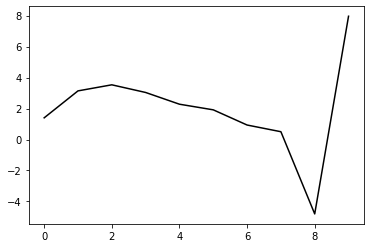

490600 30.474051539508984
0.4580545149211654 -0.6040278193670626 -0.14224846755123627 -0.08663676567661482
[ 1.47533264  2.98505738  3.36165162  2.85759726  2.09447778  1.72789999
  0.74852257  0.31793655 -4.98655016  7.91373599]


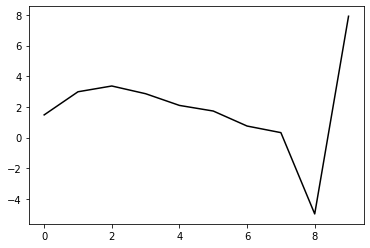

491700 16.36622479031275
0.47282954181896175 -0.597437796723411 -0.14082915600841198 -0.08803570969753285
[ 1.46553451  3.15731436  3.54093299  3.03987178  2.27682028  1.90848581
  0.92835589  0.49570532 -4.81043888  7.9360628 ]


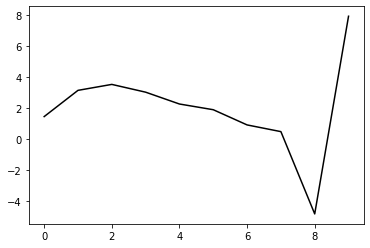

492800 23.824577296661204
0.475443913063552 -0.5974991018249584 -0.1415649297453934 -0.0897484340143871
[ 1.43647767  3.24835844  3.63891705  3.14117476  2.37868315  2.00892419
  1.02874133  0.59446812 -4.71373487  7.95962617]


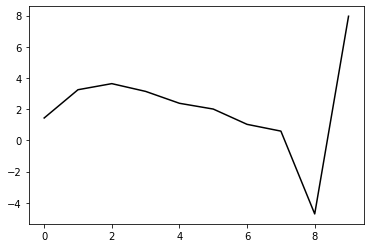

493900 26.05551809407233
0.47412683643611336 -0.6029994367103225 -0.14663495891623515 -0.08648594255657475
[ 1.35411546  3.20713396  3.58768422  3.0831761   2.31647502  1.94382958
  0.96438869  0.52919357 -4.77897523  7.98335981]


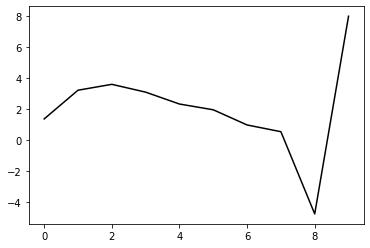

495000 16.523173872683394
0.476290573460818 -0.5986304789669722 -0.14512272926710548 -0.08665608651292404
[ 1.37761998  3.24375297  3.62644121  3.12361045  2.35726841  1.98311477
  1.00302659  0.56339092 -4.75158679  7.942478  ]


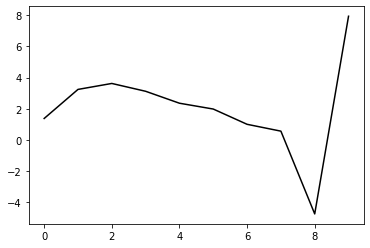

496100 21.84880541783743
0.4766853007839459 -0.5969115764794763 -0.14476467142705138 -0.08636609097686573
[ 1.42688999  3.1827881   3.57689742  3.08406017  2.32570523  1.95704205
  0.98342505  0.54566881 -4.77003594  7.98416454]


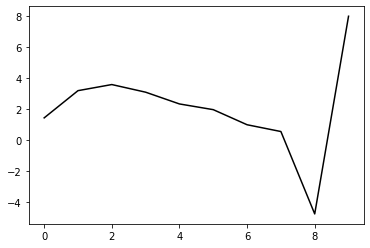

497200 34.28369612434215
0.4611589654104171 -0.5942081522833862 -0.13971579980296275 -0.09126127281630121
[ 1.4758584   3.02154515  3.3960133   2.88698899  2.11559245  1.73645178
  0.75761003  0.31536985 -5.00333218  7.92494376]


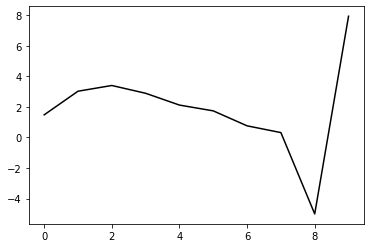

498300 21.92435598933386
0.47751925393763167 -0.5952082422975636 -0.1454638546073727 -0.08191626179221417
[ 1.37007101  3.1827581   3.53540762  3.002769    2.20770203  1.8058659
  0.8083085   0.34811654 -4.98653155  7.93271835]


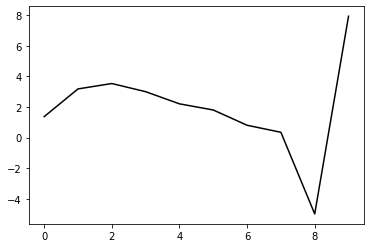

499400 14.571669943094415
0.4774553805887053 -0.5917012643016153 -0.1427870749078516 -0.08803688061856768
[ 1.43405771  3.24372812  3.62790724  3.12045504  2.34444186  1.95661011
  0.97150172  0.52003761 -4.80807563  7.96940919]


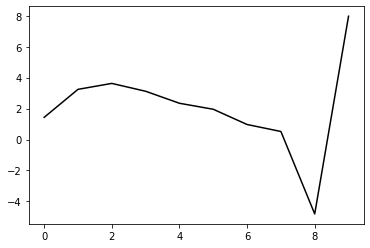

In [17]:
optimizer=tf.optimizers.Adam(learning_rate=0.0005)
for j in range (5000):    
    with tf.GradientTape() as g:
        loss=Error_func(h, m2, lam, alpha, beta, Positive[j%10], Negative[j%10])
        gradients=g.gradient(loss, [h, m2, lam, alpha, beta])
        if np.isnan(loss)==True: break
    for i in range (90):
        optimizer.apply_gradients(zip(gradients, [h]))
        if any(np.isnan(h.numpy()))==True: break
    for i in range (10):
        optimizer.apply_gradients(zip(gradients, [h, m2, lam, alpha, beta]))
        if any(np.isnan(h.numpy()))==True: break
    if j%11==0: 
        print(j*100, Error_func(h, m2, lam, alpha, beta, Positive[j%10], Negative[j%10]).numpy())
        print(m2.numpy(), lam.numpy(), alpha.numpy(), beta.numpy()), print(h.numpy())
        plt.plot(h.numpy(), 'k-'), plt.show()

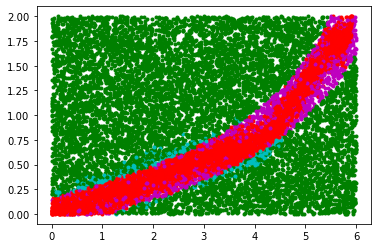

In [18]:
for i in range (set):
    [Positive0[i], Positive1[i]]=NN_func_01(h, m2, lam, alpha, beta, Positive[i])
    [Negative0[i], Negative1[i]]=NN_func_01(h, m2, lam, alpha, beta, Negative[i])
for i in range (set):
    x_data1[i]=[v[0] for v in Positive0[i]]
    y_data1[i]=[v[1] for v in Positive0[i]]
    x_data2[i]=[v[0] for v in Positive1[i]]
    y_data2[i]=[v[1] for v in Positive1[i]]
    x_data3[i]=[v[0] for v in Negative0[i]]
    y_data3[i]=[v[1] for v in Negative0[i]]
    x_data4[i]=[v[0] for v in Negative1[i]]
    y_data4[i]=[v[1] for v in Negative1[i]]
    plt.plot(x_data4[i], y_data4[i], 'g.')
    plt.plot(x_data2[i], y_data2[i], 'c.')
    plt.plot(x_data1[i], y_data1[i], 'r.')
    plt.plot(x_data3[i], y_data3[i], 'm.')
plt.show()

0 48.74633641533729
0.4857078444331635 -0.5853679178049687 -0.15271989429980296 -0.08020052417437613
[ 1.35393718  3.33315869  3.71938668  3.21200043  2.43461893  1.94436733
  0.95749999  0.50348218 -4.82715411  7.98773086]


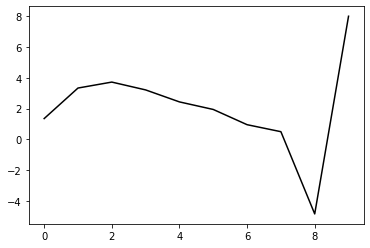

1100 21.674242329449655
0.4735915150658973 -0.5790299085776945 -0.1469531294390643 -0.09051123490537033
[ 1.40597341  3.26894913  3.66410322  3.16213649  2.38694861  1.89665558
  0.91003128  0.45443618 -4.87786571  7.98602276]


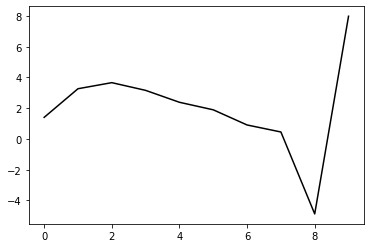

2200 25.318880603692005
0.4482756212358348 -0.5794529532403009 -0.14399334137982495 -0.09098052763295165
[ 1.40214947  3.08148188  3.43120395  2.88978856  2.08106668  1.56266379
  0.55474143  0.08126124 -5.26704354  7.93946248]


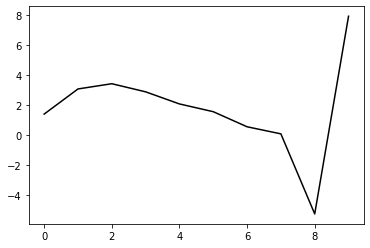

3300 21.97748330129618
0.47683984467309615 -0.5730058279694876 -0.1461253405901443 -0.08949173624313769
[ 1.3646712   3.31650586  3.67719442  3.1401468   2.33124323  1.80986565
  0.7989459   0.3204082  -5.03094927  7.92382777]


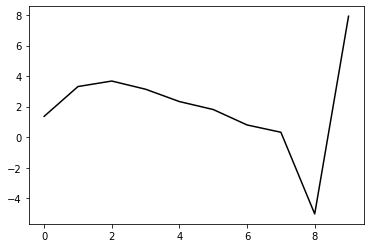

4400 14.071215721274983
0.47765012838916987 -0.5716403881409766 -0.14582662520756526 -0.09285108784189613
[ 1.37621859  3.34567192  3.71997366  3.19266271  2.39074448  1.87432734
  0.86863484  0.39272355 -4.95725483  7.9381198 ]


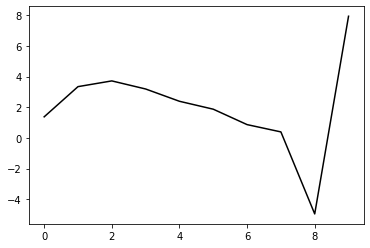

5500 24.09554959924129
0.4674252477660011 -0.5754919646985884 -0.14717614314031366 -0.09648705764715575
[ 1.41067874  3.25216104  3.6402348   3.12600258  2.33550026  1.82882999
  0.83352349  0.36566889 -4.97569771  7.91465566]


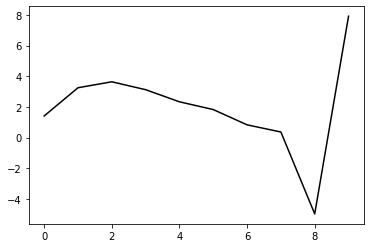

6600 25.091066490699056
0.4710689189295755 -0.5756935442805359 -0.15007880869016085 -0.09183465391766224
[ 1.38186992  3.25438722  3.63735139  3.11994568  2.32765123  1.81950466
  0.82432759  0.35295317 -4.99416124  7.88663818]


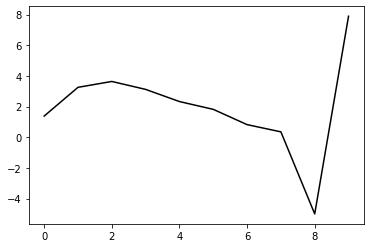

7700 18.59018511835108
0.4749744882632734 -0.5673692555768318 -0.14561870594687562 -0.09559521980546273
[ 1.44744706  3.27153414  3.67333547  3.17092103  2.39017303  1.89047389
  0.90311495  0.4343703  -4.9137916   7.95759052]


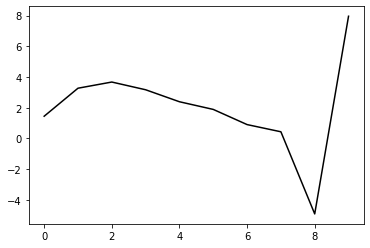

8800 30.644480144165616
0.4690278746304225 -0.5686988120915644 -0.14597557082665719 -0.09702664372796481
[ 1.4371281   3.26137279  3.66972774  3.17274969  2.39526484  1.89690762
  0.91167112  0.44268971 -4.90520152  7.92170363]


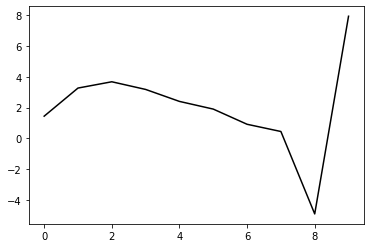

9900 19.440374390405868
0.4614718084239689 -0.5684532943808556 -0.1458068284078877 -0.094776582330169
[ 1.40842881  3.12221458  3.48414675  2.95186963  2.14840484  1.63127478
  0.63407037  0.15561065 -5.20031601  7.91624222]


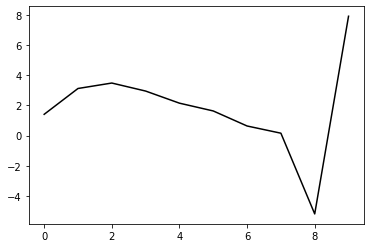

11000 16.70570416319025
0.47757240561653264 -0.5681134193930902 -0.14905661301347195 -0.09329999903989912
[ 1.38169178  3.31630975  3.68988304  3.16092938  2.35578753  1.83461885
  0.83435391  0.35211651 -5.00666572  7.9021483 ]


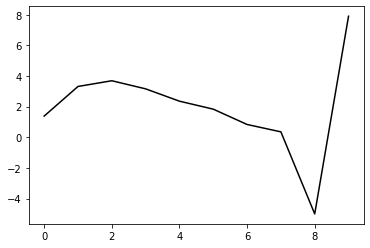

12100 21.889763261756407
0.47612225733422747 -0.5661835709371763 -0.1481051567154908 -0.09434768329071429
[ 1.42499316  3.23707522  3.6058128   3.0710283   2.26052067  1.73484635
  0.7332201   0.24838061 -5.11246012  7.96045107]


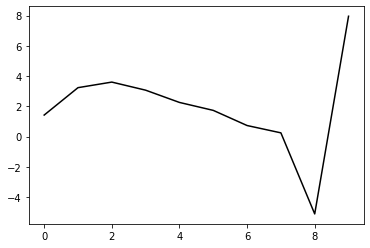

13200 22.729354303211757
0.4791311203277311 -0.5652755102299729 -0.1489108110373632 -0.09335331050728872
[ 1.36575966  3.31432331  3.6862127   3.15103262  2.33780363  1.8078043
  0.80275862  0.31186275 -5.05572069  7.91993154]


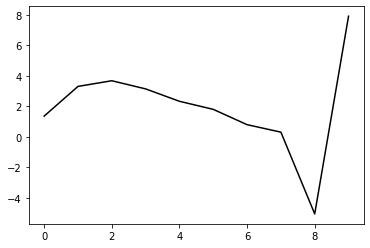

14300 23.077780990527785
0.4721115084999056 -0.5645504368060874 -0.14771519409298864 -0.09475224125608878
[ 1.37768885  3.25959756  3.62699678  3.08685258  2.26902476  1.7350573
  0.72889274  0.23599664 -5.13257623  7.91168564]


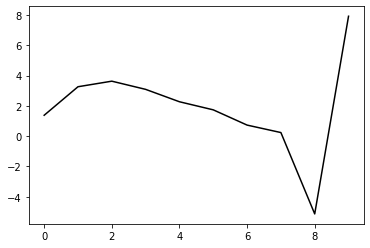

15400 17.11344679194858
0.4758155687193842 -0.5622280982439435 -0.14710697708826392 -0.09592831422375953
[ 1.42295835  3.2974922   3.68509743  3.16056403  2.35459604  1.82967356
  0.83239047  0.34530532 -5.01801068  7.91781202]


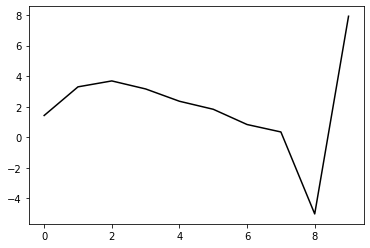

16500 21.634604833970275
0.4742020113953268 -0.5648913580509036 -0.1497520349059171 -0.09409809142032316
[ 1.38000064  3.27871846  3.6505676   3.11070008  2.29091289  1.75379804
  0.74805581  0.25231068 -5.11779922  7.92265907]


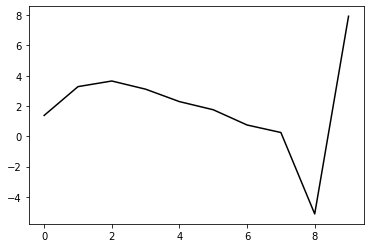

17600 28.438772010633254
0.4800320706636204 -0.5633154476479816 -0.1504721056221844 -0.09332526647581656
[ 1.32028682  3.40002615  3.78078676  3.2453521   2.42681558  1.88853057
  0.88176254  0.38142345 -4.99513141  7.89778567]


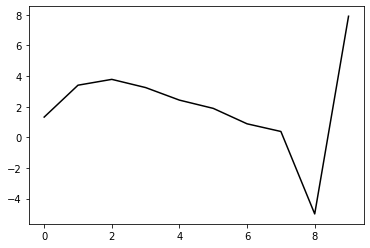

18700 15.45866615647776
0.4741849429781952 -0.5596932250469391 -0.1470665918149107 -0.09696380564701478
[ 1.4152824   3.30502093  3.68523063  3.14932405  2.33099814  1.79385599
  0.79119483  0.29467219 -5.07577746  7.92669775]


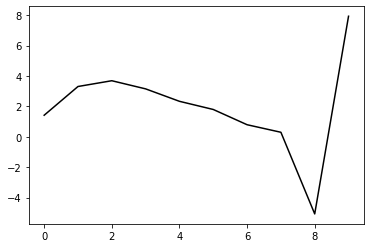

19800 39.07758058945304
0.47475458926727243 -0.5557488566062266 -0.1448193730390601 -0.09909454981247873
[ 1.4305354   3.33562312  3.72586651  3.19666338  2.38263479  1.84790808
  0.84822966  0.35152613 -5.02043965  7.88208714]


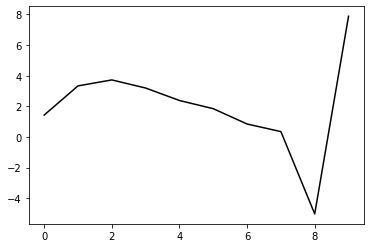

20900 21.56111533652351
0.478000447088911 -0.5621001793324985 -0.1511228270270317 -0.0957000285217867
[ 1.32118894  3.35560718  3.73914441  3.20345268  2.38366274  1.84379686
  0.84147553  0.34084111 -5.03392892  7.9547503 ]


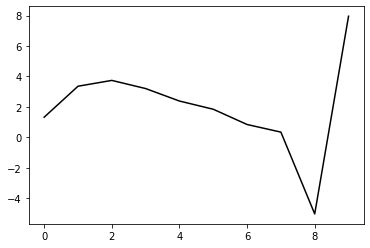

22000 16.4836553124832
0.4753132439828671 -0.5624187904114055 -0.15159225482296265 -0.09496994521911388
[ 1.37521694  3.32280721  3.72246035  3.20129244  2.39322726  1.86228771
  0.8683166   0.37198    -5.00079778  7.91681893]


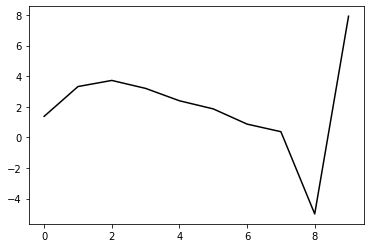

23100 22.30202197336926
0.4720454517338766 -0.5598015988151286 -0.1500458477159195 -0.09594340907679863
[ 1.43903353  3.20010286  3.60283103  3.08603926  2.28259448  1.75574653
  0.76720811  0.27166755 -5.10306022  7.93937277]


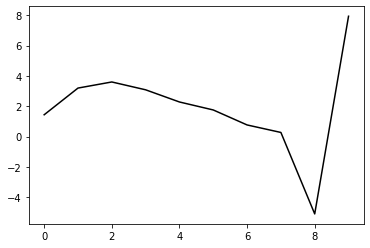

24200 22.691645932217934
0.47755927333281534 -0.5567632232255764 -0.1500588099183675 -0.09322405436031626
[ 1.36405044  3.29251041  3.69061073  3.16780954  2.35734354  1.82263589
  0.82772421  0.32271506 -5.06298644  7.9065721 ]


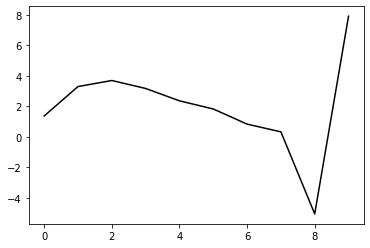

25300 24.795597375621355
0.46784120006912666 -0.5561351036418395 -0.14807954072206062 -0.09498352517187611
[ 1.39391703  3.17278121  3.56023466  3.02790917  2.20904678  1.6674249
  0.66964594  0.16204252 -5.22421177  7.90701855]


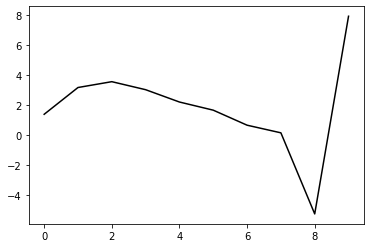

26400 13.796311133367132
0.4744026994316411 -0.5558587372771073 -0.15007216431433934 -0.09578758921048906
[ 1.39845429  3.30341949  3.71119299  3.19320316  2.38376185  1.84815754
  0.85572437  0.35050926 -5.03325191  7.94380339]


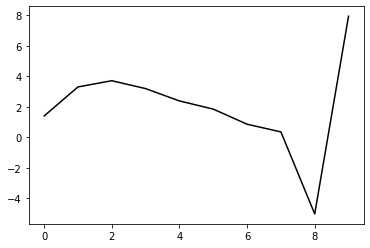

27500 21.612438370758458
0.4727573860243367 -0.5565551271208169 -0.1512715153741361 -0.09381188263262202
[ 1.38967599  3.24732559  3.6417753   3.11291073  2.29516059  1.75332472
  0.75810293  0.24937301 -5.13718318  7.93718666]


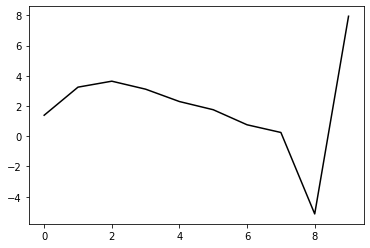

28600 27.172790674023002
0.47821047868249494 -0.555229163082537 -0.15201622850073862 -0.09373780196444263
[ 1.34042265  3.38238494  3.78789885  3.26524631  2.45002658  1.90819567
  0.91317338  0.40156863 -4.98928869  7.90684808]


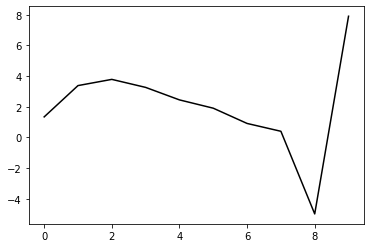

29700 15.72847436871249
0.4724958269400138 -0.5539696056806503 -0.15052987846032323 -0.0961559211934209
[ 1.44313645  3.26317604  3.68539243  3.17944016  2.38000353  1.85260932
  0.87258528  0.3715817  -5.01145326  7.94240107]


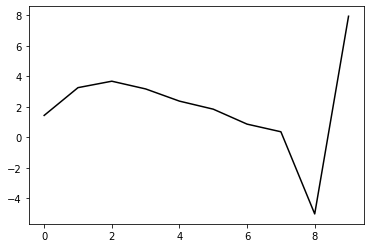

30800 26.937714131150045
0.4708106132228695 -0.5510563683858849 -0.14914466535605628 -0.09711393479030328
[ 1.44184328  3.28658022  3.71923157  3.22293948  2.4318458   1.91102413
  0.93761884  0.4374397  -4.94977212  7.92788022]


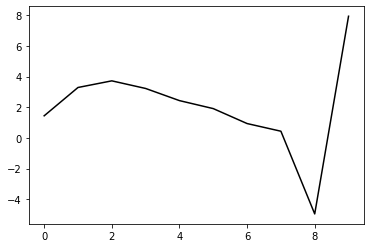

31900 15.361210277813663
0.4742690336506323 -0.5503019385037666 -0.1505043803497098 -0.09441778924447572
[ 1.36869847  3.34385247  3.76931396  3.26582853  2.46725611  1.93842121
  0.95841452  0.4480115  -4.95133275  7.95191806]


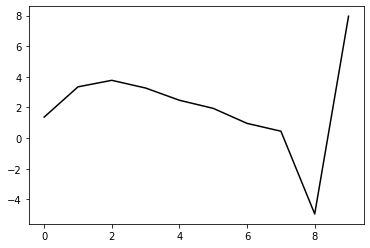

33000 19.770091114089496
0.4719577304520647 -0.5560889948189918 -0.15560131440200492 -0.08899459205584911
[ 1.36726613  3.2278349   3.64692967  3.13937644  2.33842078  1.80848672
  0.83046282  0.32028719 -5.0791561   7.88941465]


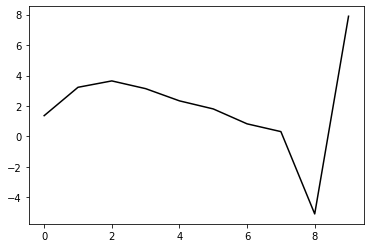

34100 20.46015577837831
0.4706372098665863 -0.5520165873037535 -0.1528279121772456 -0.09279476906818043
[ 1.37839241  3.28952528  3.69772445  3.17679586  2.36079163  1.81568771
  0.82514592  0.30313194 -5.10678838  7.91700165]


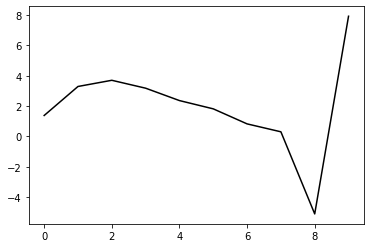

35200 25.165850534014456
0.4709010655149371 -0.5458545621243448 -0.14939757727392347 -0.0946872338188037
[ 1.42632939  3.26477268  3.68251957  3.16970036  2.36029358  1.82018031
  0.83473637  0.31307032 -5.10096281  7.87824741]


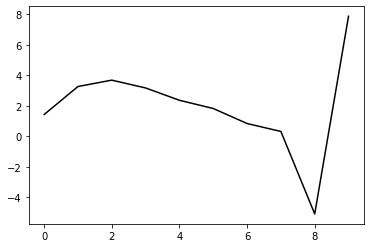

36300 21.51042213662181
0.47203362296325957 -0.5456650995002373 -0.15042662679472316 -0.09261944894214748
[ 1.38783136  3.30296997  3.72751537  3.22043187  2.41539265  1.87816918
  0.89617267  0.3738486  -5.0438242   7.92745957]


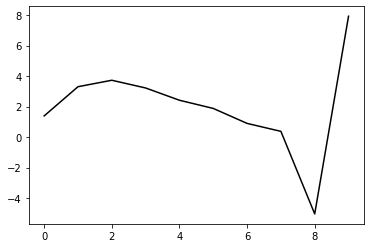

37400 14.891600346650165
0.46313159139360927 -0.5516440372703614 -0.1530845634421003 -0.09408489008427535
[ 1.43638585  3.20074122  3.63795326  3.14417908  2.35213774  1.82777228
  0.86050403  0.35151357 -5.05196506  7.91222321]


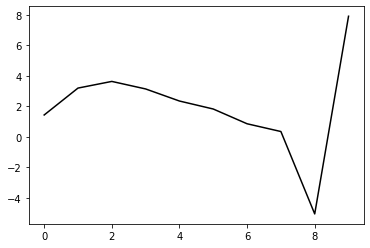

38500 24.196237217161265
0.4638033887628305 -0.5456451301393908 -0.14994195088598003 -0.09499087206820003
[ 1.42484254  3.22536164  3.65700617  3.15791309  2.36044594  1.83024087
  0.85827741  0.34106729 -5.0733476   7.92130231]


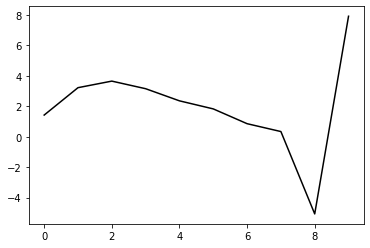

39600 25.683184982561777
0.4703836748400556 -0.5437968358823666 -0.15127944031959767 -0.09213295274413662
[ 1.35490541  3.31631271  3.75283628  3.25840068  2.46460066  1.93675424
  0.96743726  0.44825584 -4.97242307  7.89858166]


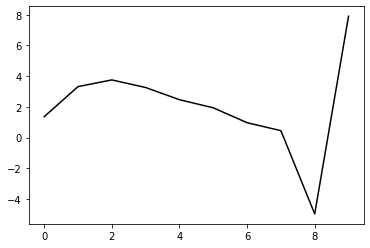

40700 13.07715719014851
0.4625680641631912 -0.5458557634662387 -0.1516917694575965 -0.093232925744984
[ 1.42953721  3.19883694  3.62752716  3.12660366  2.32776838  1.79702403
  0.82902798  0.3123437  -5.10283805  7.9277808 ]


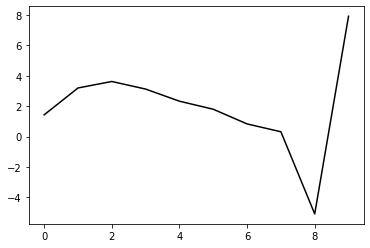

41800 21.946233373314623
0.4680647367494792 -0.5386816462414673 -0.14851913523089505 -0.09554174160682982
[ 1.40419216  3.29362296  3.720642    3.21606797  2.41232475  1.87600332
  0.90371346  0.38061876 -5.04213523  7.89704912]


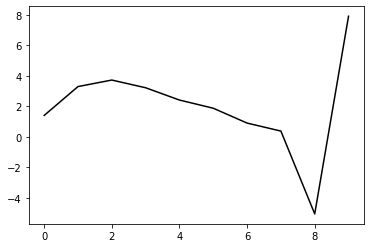

42900 16.125804131784264
0.46931744547032545 -0.5400862200036066 -0.15086265823954592 -0.09281195752388696
[ 1.35122034  3.29012359  3.71063822  3.19975045  2.39040353  1.84934677
  0.8751545   0.34838755 -5.07856266  7.96931019]


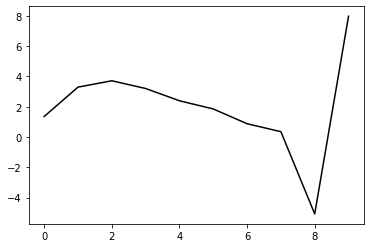

44000 18.27966394451035
0.47168533726163486 -0.5398355156614872 -0.15249961304853452 -0.09148957550433968
[ 1.35720947  3.34785807  3.77147372  3.26212947  2.45268492  1.91036285
  0.93558132  0.40598653 -5.0250831   7.9189225 ]


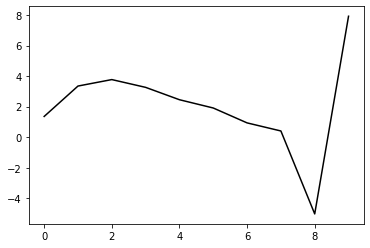

45100 21.058169596296143
0.46857569652495007 -0.5407043911663036 -0.15299518288094321 -0.0921962116218813
[ 1.39971399  3.28191632  3.71353403  3.21112065  2.40715901  1.86921213
  0.89981631  0.37326609 -5.05521721  7.94132487]


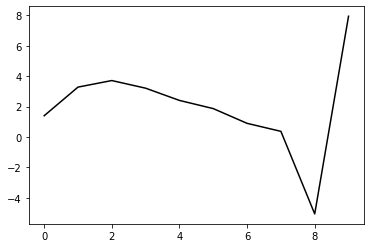

46200 30.389257811309093
0.45902046596404256 -0.5365600609806181 -0.148395947503563 -0.09632016692904162
[ 1.45021258  3.13883522  3.56057463  3.05343908  2.24843607  1.7120256
  0.74761812  0.22465304 -5.20131447  7.89343874]


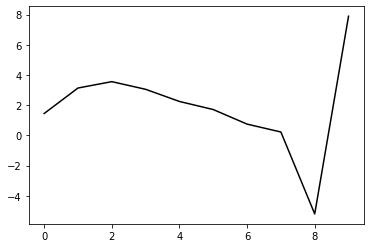

47300 23.01816226230502
0.46616929767867166 -0.5362787770348539 -0.15066423525837566 -0.0942174333459119
[ 1.41385616  3.29347191  3.72081938  3.21480862  2.40746651  1.86682595
  0.89907497  0.3711409  -5.05909131  7.91251087]


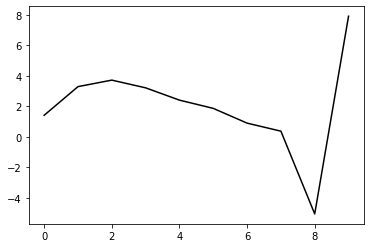

48400 17.27047829307588
0.46290766976601877 -0.5392645079683714 -0.15301103282876238 -0.09161120035745196
[ 1.39167969  3.23877463  3.65499091  3.14005971  2.32569422  1.77969071
  0.80991708  0.27940142 -5.15235832  7.90804496]


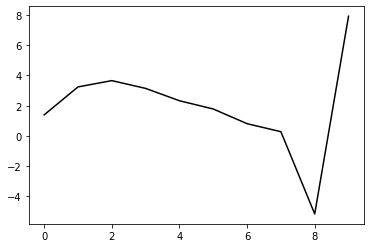

49500 21.351449919604736
0.45945178745927084 -0.5436156903870316 -0.15642549813704526 -0.0904228499849
[ 1.39475206  3.17344143  3.58855728  3.07410307  2.26038864  1.71503683
  0.74749453  0.21797426 -5.21241677  7.90912628]


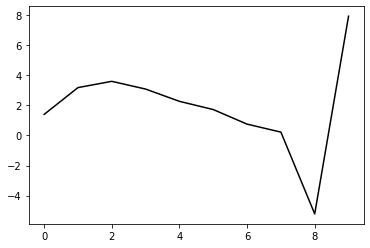

50600 24.094007792475786
0.4669383077890969 -0.5359181660356424 -0.15281246451554198 -0.09442791253515533
[ 1.37824104  3.33646183  3.76651548  3.26298591  2.45652566  1.91563831
  0.95191855  0.42259707 -5.01034566  7.93735556]


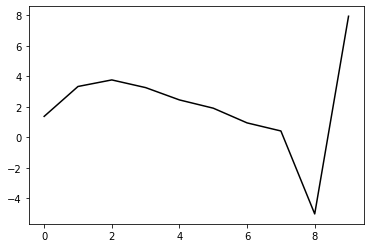

51700 12.923421047259907
0.46273734105188424 -0.534699499951109 -0.15216288371858455 -0.09375097560493337
[ 1.41473131  3.24989065  3.67764288  3.17274366  2.3651991   1.82286237
  0.85873852  0.32506195 -5.11526906  7.91587397]


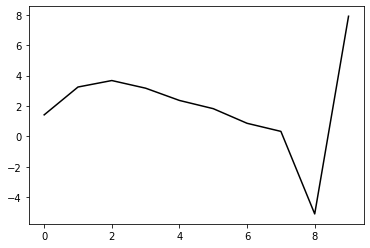

52800 25.481836061699866
0.46580429882603464 -0.5287877288162505 -0.1492520040101573 -0.09535023815916509
[ 1.43092182  3.31235057  3.75547779  3.26425654  2.46825592  1.93554956
  0.98121094  0.45314279 -4.98502428  7.89907973]


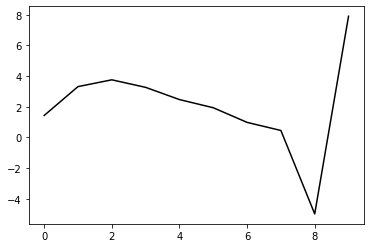

53900 18.697042058341896
0.4632931521779644 -0.5361622738131635 -0.15463041634177013 -0.0937732354512698
[ 1.3518373   3.25366985  3.68462636  3.18523605  2.38413596  1.84882431
  0.89573245  0.36888864 -5.06553333  7.94522272]


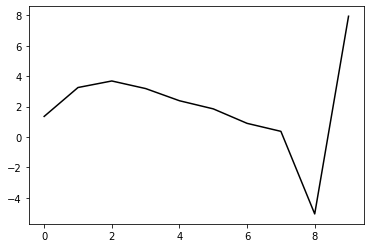

55000 16.445570232628285
0.4654863598708931 -0.5330239385416503 -0.15426455275316572 -0.09266175871352662
[ 1.37417934  3.3083894   3.74571716  3.25199426  2.45480296  1.92160846
  0.9704227   0.44172734 -4.99719617  7.9338714 ]


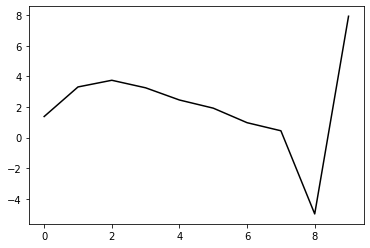

56100 20.43656825676242
0.463922350554436 -0.5336246889097496 -0.15527205892793602 -0.09211193227863301
[ 1.40171611  3.23254521  3.68446189  3.2054913   2.42137668  1.89924888
  0.95906059  0.43648245 -5.00022689  7.97367632]


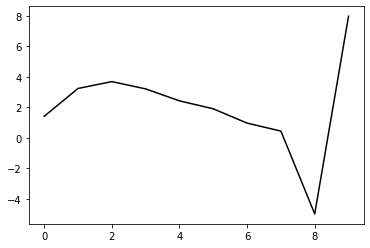

57200 28.981837767419833
0.4532917918984113 -0.5287580606937787 -0.1504959610285534 -0.09477249503168175
[ 1.46361664  3.06165145  3.50280846  3.01973829  2.23575289  1.71629094
  0.78192737  0.26255831 -5.17416557  7.87774028]


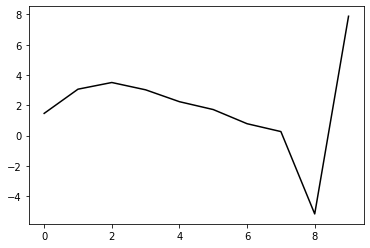

58300 21.370832841738846
0.46339758567805195 -0.5271208136471224 -0.15294443490375337 -0.09184889903132576
[ 1.39701708  3.24686624  3.69959142  3.2240242   2.44309014  1.92327454
  0.98785199  0.46339412 -4.98011284  7.94201267]


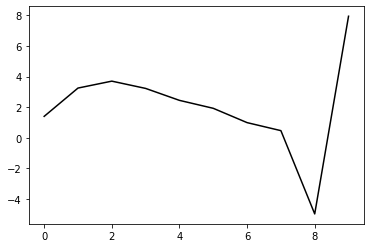

59400 14.538364628315394
0.4636512285342118 -0.5243362938151086 -0.15156977076949243 -0.0914369109273377
[ 1.39527044  3.25188805  3.70221588  3.22374311  2.43906906  1.9149179
  0.97698093  0.447404   -5.00209847  7.92279777]


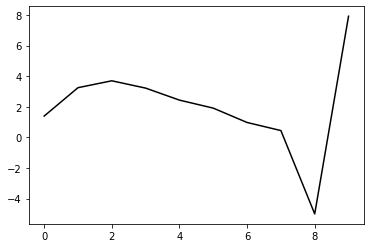

60500 22.04044852654343
0.4566010503533352 -0.5311577730120849 -0.1550268395072836 -0.09404644346239541
[ 1.42072879  3.19755471  3.66798259  3.20918275  2.44226824  1.93429431
  1.01311     0.49807264 -4.93676883  7.94999972]


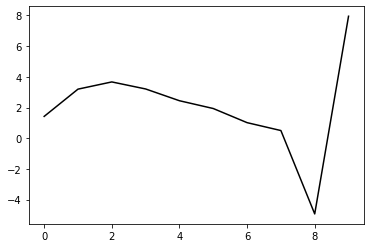

61600 24.721318162360898
0.4601661681167521 -0.5255498482050057 -0.15307352670747165 -0.09076820463288797
[ 1.3859267   3.20213207  3.65362982  3.17760704  2.39451957  1.8710659
  0.93692449  0.40664932 -5.04465441  7.91150489]


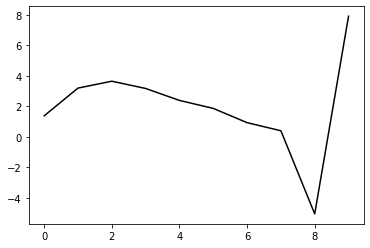

62700 12.822148483049624
0.455453069884705 -0.5254212002540077 -0.152776420694812 -0.0916718150485118
[ 1.42584565  3.15132611  3.60975349  3.1411368   2.36446528  1.84608352
  0.91729595  0.38823081 -5.06521985  7.93528872]


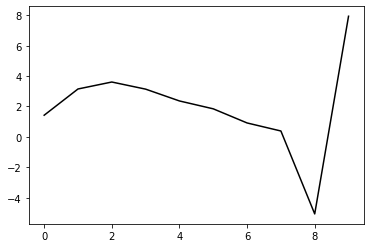

63800 23.43394377676154
0.45826625186509046 -0.5228709882490133 -0.1525301574911766 -0.09205874455872329
[ 1.40064693  3.20452494  3.67620316  3.22044136  2.45478828  1.94558615
  1.02621754  0.50232415 -4.94878894  7.93085654]


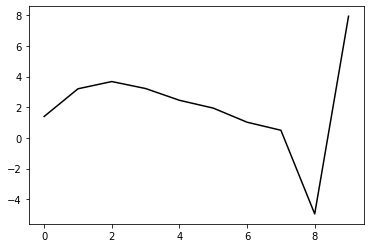

64900 15.282809092701777
0.4582111038718037 -0.5255733793053956 -0.15493053852332664 -0.09034209497731761
[ 1.40105849  3.2097208   3.68964714  3.24163445  2.48116889  1.9748091
  1.05903522  0.5353206  -4.91664172  7.96334497]


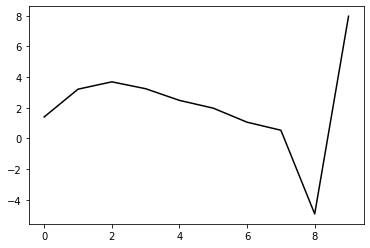

66000 17.98831161662783
0.4519404559655389 -0.5273326719624754 -0.1552746227823239 -0.0903052868996938
[ 1.44694481  3.10003755  3.57296311  3.12143568  2.35934194  1.85312956
  0.94157686  0.42085667 -5.02788841  7.89856526]


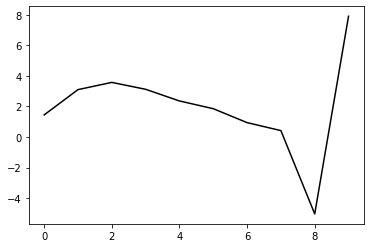

67100 20.595308569189378
0.45756744668995736 -0.524444451525245 -0.15529244380862917 -0.08937245293059562
[ 1.39800743  3.19849679  3.67568163  3.2269153   2.46466901  1.95585994
  1.04212552  0.51531861 -4.94129129  7.9598796 ]


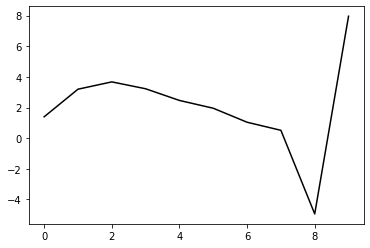

68200 24.980327287546583
0.44866441604857615 -0.5215212470137136 -0.15205709847404358 -0.09111837377686119
[ 1.45437728  3.02070664  3.49141135  3.04453146  2.28784707  1.78588786
  0.88089916  0.36005588 -5.09309119  7.90433316]


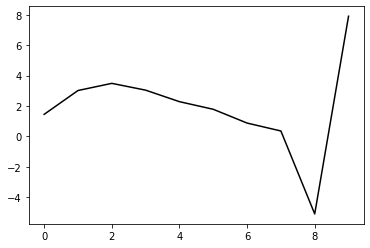

69300 21.819544992964538
0.4537613120254194 -0.5201243984543042 -0.1540058633111519 -0.08726343598269905
[ 1.39949086  3.12638823  3.59607068  3.14597865  2.38343906  1.87364233
  0.96121388  0.42951054 -5.03547693  7.95299058]


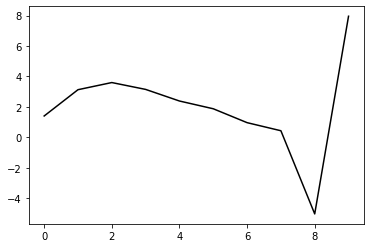

70400 16.12965416555844
0.4538341899673424 -0.5165464065244326 -0.15171507297524564 -0.09065965785237257
[ 1.46001803  3.1370097   3.62664106  3.19475967  2.44694897  1.94897336
  1.04779785  0.52391554 -4.93481214  7.93438781]


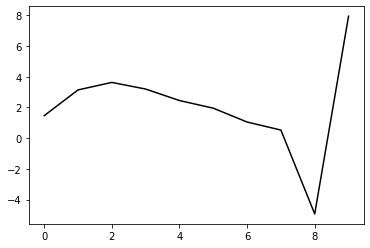

71500 22.13751087270879
0.45290167083217125 -0.5188479709465227 -0.1537448044977789 -0.09124982625670865
[ 1.43837357  3.17952285  3.6789461   3.25602792  2.51434294  2.02011724
  1.12292994  0.59962758 -4.85998273  7.94933975]


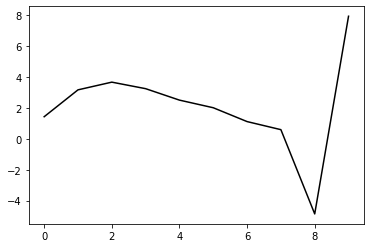

72600 24.900156693504346
0.4524758373755519 -0.5199423575859452 -0.15526212146793517 -0.08870922379115447
[ 1.41267435  3.14220087  3.6255857   3.19105297  2.44054037  1.93975571
  1.03981467  0.51342795 -4.94758474  7.93643292]


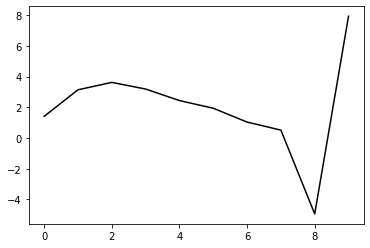

73700 14.52433290401719
0.4528305395531144 -0.5170714080091968 -0.15406072330641643 -0.09161031879189475
[ 1.45090832  3.13703323  3.64481933  3.23338875  2.50144637  2.0147772
  1.12699728  0.60672373 -4.85283974  7.96338055]


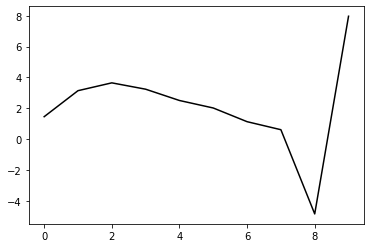

74800 27.150211735779617
0.4438260039392859 -0.5128926509559908 -0.1501811076133347 -0.09132885660661409
[ 1.45549049  2.99495096  3.45020701  2.99720883  2.23335691  1.72317058
  0.82038599  0.28938161 -5.1779248   7.89207019]


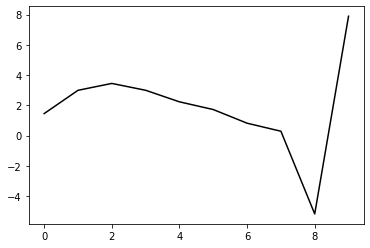

75900 15.66227355860866
0.4512430987548501 -0.5170485068175601 -0.1553726623109524 -0.08887606093475434
[ 1.43864858  3.04070067  3.50238903  3.0548362   2.29405692  1.78541289
  0.88506354  0.35556974 -5.10856954  7.87780929]


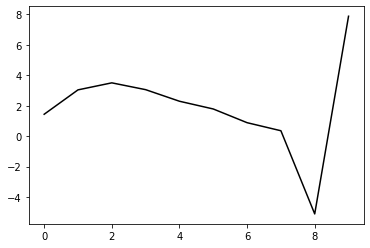

77000 23.072409490448997
0.4568163353590726 -0.5193987392374345 -0.15914780746223256 -0.08633751312463177
[ 1.37054158  3.11128819  3.56996246  3.11894853  2.3536511   1.83991418
  0.93609549  0.40155121 -5.067944    7.89715814]


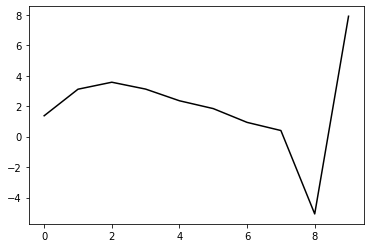

78100 23.746388823904176
0.4503481602419254 -0.5150865401356929 -0.1550234042747155 -0.09132717709261087
[ 1.4468795   3.04287833  3.48281108  3.01806346  2.24192851  1.71970303
  0.81104179  0.27263013 -5.19784134  7.93487274]


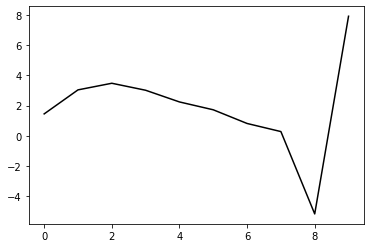

79200 25.007598036482285
0.45173027895577944 -0.509484288151788 -0.1521428705222364 -0.09414559952021355
[ 1.42279831  3.12464303  3.57093053  3.11115438  2.33814232  1.81732481
  0.90984921  0.36952598 -5.10455874  7.87628033]


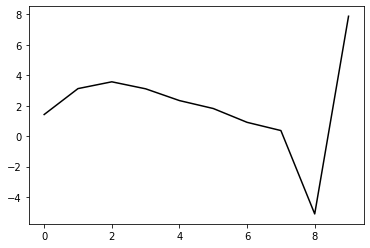

80300 21.58449277245167
0.4579361795881602 -0.5091382424076208 -0.15390848923139608 -0.09103238926008604
[ 1.39801956  3.16521992  3.61364316  3.15509406  2.38204034  1.86021201
  0.95276832  0.41070279 -5.0656775   7.92113193]


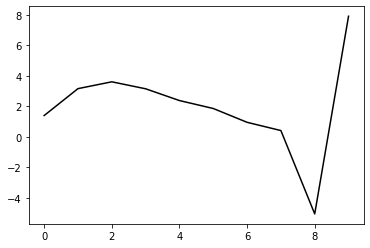

81400 14.395402844883538
0.4549717091667258 -0.5095579049815574 -0.15384236468768303 -0.09289614339224193
[ 1.39200103  3.192148    3.63832398  3.17711179  2.40067522  1.87536385
  0.96684248  0.42336948 -5.05206285  7.92194792]


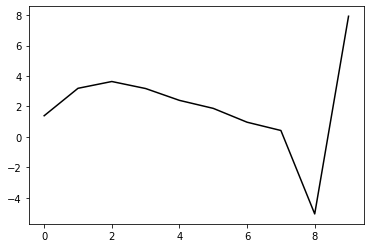

82500 22.141452191681942
0.4538121472225371 -0.5106933793715045 -0.15451787928889832 -0.09484594129227135
[ 1.40750296  3.19543645  3.66140102  3.21757628  2.45462653  1.93949441
  1.04073187  0.5039022  -4.9662372   7.923147  ]


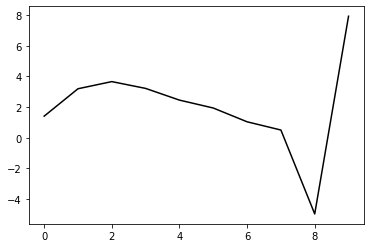

83600 25.819500046172127
0.45091167302535456 -0.5098374037454112 -0.15426522669358247 -0.09369473457699343
[ 1.40537557  3.16771816  3.62716515  3.17732175  2.40822718  1.88635754
  0.98221847  0.43630195 -5.0454434   7.93818472]


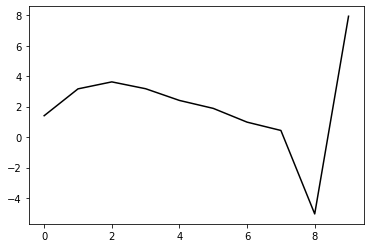

84700 15.96996069294577
0.4539271781278519 -0.506096194059177 -0.15292592913256198 -0.09377192301305358
[ 1.45386715  3.15281045  3.62433134  3.18675474  2.42881549  1.91671383
  1.02275078  0.48305284 -4.9954969   7.92724971]


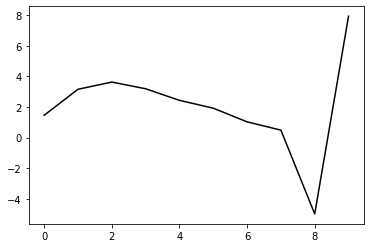

85800 32.80301866892377
0.4476524860063489 -0.5063173725230399 -0.15203217510238048 -0.0963431448540209
[ 1.46464887  3.14208176  3.60365193  3.15426626  2.38354295  1.85991028
  0.95987462  0.4158193  -5.06252921  7.89602274]


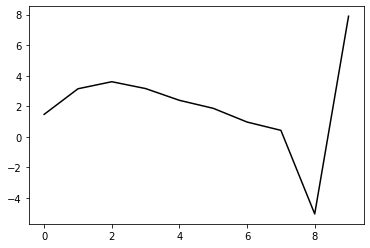

86900 17.3830312117357
0.454162188721346 -0.5106512749336047 -0.1573366478119638 -0.09284051230590468
[ 1.36753685  3.19086318  3.64065425  3.18163637  2.40281577  1.87244493
  0.96872438  0.42044579 -5.06095021  7.95444214]


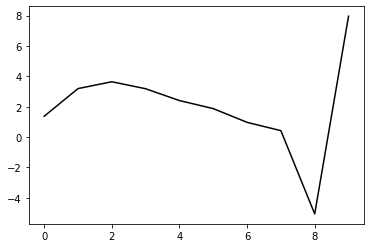

88000 18.58098458542884
0.4576809821634256 -0.509025163248487 -0.15805079654709367 -0.09086078941525283
[ 1.37132274  3.24248976  3.68100025  3.21280363  2.42535828  1.88662196
  0.97622837  0.42008201 -5.06898835  7.90624708]


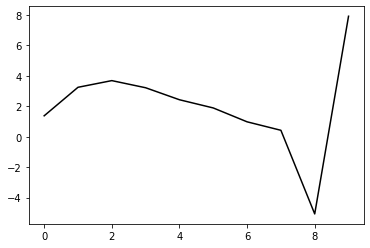

89100 21.579976139400674
0.45994920979537296 -0.5035499724863396 -0.15526533543644397 -0.09219666160641757
[ 1.41890387  3.20860728  3.65460183  3.1935087   2.4121607   1.87832184
  0.97303589  0.41891999 -5.07021021  7.95397924]


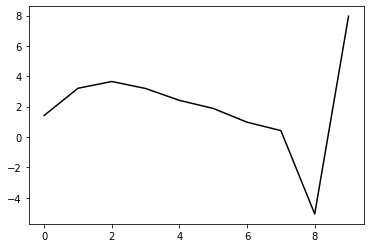

90200 22.33533688530705
0.449449485809697 -0.5090404608009974 -0.15742112331404867 -0.0920250348774607
[ 1.42632284  3.11240588  3.55905331  3.1007898   2.3233357   1.79407014
  0.89550724  0.34725021 -5.13521675  7.90118921]


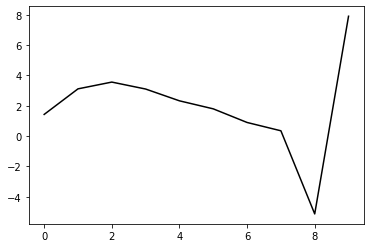

91300 25.100415361070564
0.4442899975139212 -0.5064811485929586 -0.1549169739322351 -0.09460391500627054
[ 1.42418367  3.03520057  3.4707754   3.00618472  2.2250518   1.6937487
  0.79574331  0.24739298 -5.23551085  7.90407024]


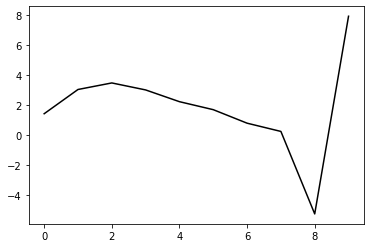

92400 13.941676741590854
0.4538464358414912 -0.5042890809958347 -0.15643057239924635 -0.09449680023340783
[ 1.42500506  3.21098007  3.67295476  3.22928138  2.46363163  1.9434535
  1.05453778  0.51078067 -4.97020807  7.91128599]


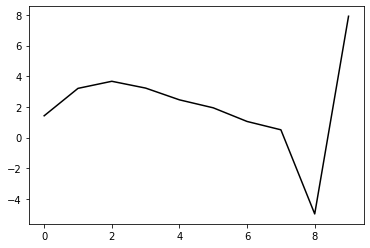

93500 22.059892480974582
0.4533658635777802 -0.501761685254939 -0.15542519972498836 -0.0934124375955635
[ 1.39010534  3.18580701  3.64429677  3.19853421  2.43125214  1.90917214
  1.01953312  0.47153239 -5.01645569  7.93586565]


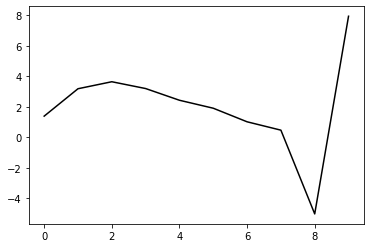

94600 24.875708456584253
0.4552124723268001 -0.5027193166625082 -0.15701145628755436 -0.09356819580254659
[ 1.38105423  3.27324966  3.74679224  3.31146692  2.54917797  2.02770193
  1.13787182  0.58589368 -4.90791144  7.92617927]


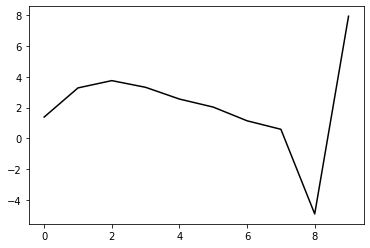

95700 15.031232399853508
0.45439795194738297 -0.49875105889531823 -0.15496446219769397 -0.0938937091769592
[ 1.45223836  3.19691528  3.67313942  3.2425584   2.4857861   1.96957221
  1.08628643  0.53633374 -4.95817736  7.96493537]


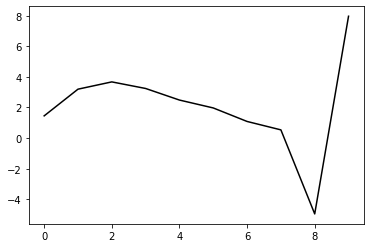

96800 28.444551527514722
0.44972552283201067 -0.4964658234961465 -0.15265321749620303 -0.0948255145612675
[ 1.45182248  3.17664093  3.64592212  3.20844439  2.44424785  1.92047763
  1.03236831  0.47690447 -5.02134931  7.88920018]


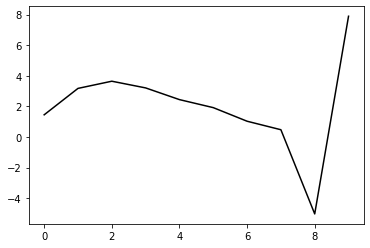

97900 19.51672891938265
0.4523159930562131 -0.5023390128659315 -0.15842159858140417 -0.09246685606997196
[ 1.36517144  3.18265919  3.63989985  3.19295636  2.42110423  1.89116204
  1.00001138  0.44099727 -5.05955422  7.94630709]


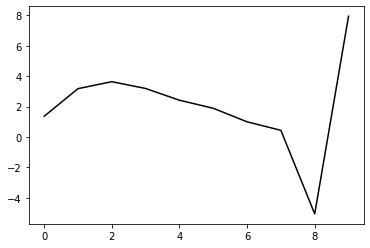

99000 17.409416951916302
0.45618933402210193 -0.49840024641880015 -0.15793853022823234 -0.09099775887233051
[ 1.37862441  3.23798381  3.6999975   3.25912049  2.49241084  1.96579928
  1.07737658  0.51673887 -4.98879577  7.92035714]


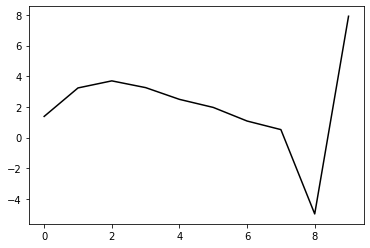

100100 20.788258035613946
0.4518726786784542 -0.49977354526203793 -0.1585863491665339 -0.09167630350324059
[ 1.41702485  3.1418956   3.62093137  3.19693562  2.44513251  1.93129026
  1.05557661  0.50379421 -4.99536937  7.94643169]


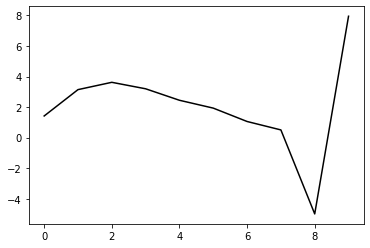

101200 25.47480760655679
0.44854302533472945 -0.4911383651985104 -0.15272216263046692 -0.09233835066567041
[ 1.43197388  3.0814699   3.54384869  3.10553523  2.34034305  1.81320772
  0.92615169  0.35951259 -5.15769446  7.89972614]


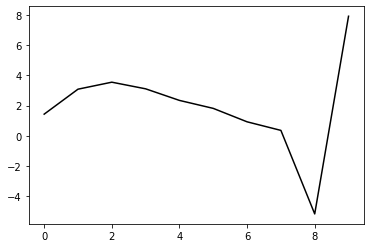

102300 24.334160090383055
0.4471480355300288 -0.49308730620180985 -0.15438592593490533 -0.09191381429376501
[ 1.43441935  3.09586532  3.5634579   3.13119036  2.37138977  1.84890022
  0.96753795  0.40473127 -5.10786848  7.9314588 ]


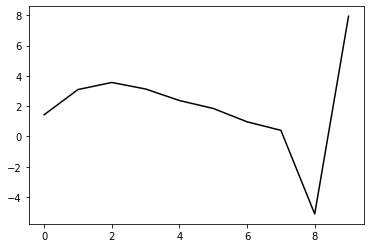

103400 14.120858867431497
0.44879379495438493 -0.49559430849887814 -0.15682340193726446 -0.09154765068767408
[ 1.43201561  3.14272026  3.62037796  3.19691265  2.44304566  1.92421063
  1.0469342   0.48633513 -5.02327103  7.94415182]


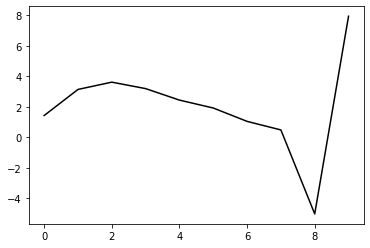

104500 22.01287806064575
0.44385916529044106 -0.501567934032889 -0.16106194104041163 -0.08891872209415343
[ 1.4004987   3.04045774  3.49669541  3.05626904  2.28898431  1.75979978
  0.87672697  0.3113772  -5.20105914  7.93231217]


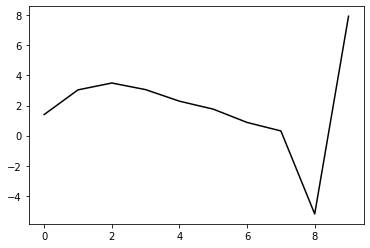

105600 25.37528951734416
0.4484457102954501 -0.49558788334770754 -0.1585809546088683 -0.09072065820179423
[ 1.39921823  3.14384215  3.59031892  3.14048972  2.36374805  1.82533494
  0.93503875  0.36209035 -5.15599374  7.90050733]


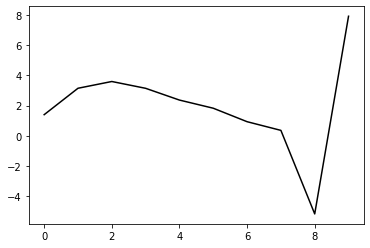

106700 13.782654873036707
0.45022175464592956 -0.4925567967688626 -0.1569894639950936 -0.0951597145587302
[ 1.41999751  3.18431518  3.64640259  3.20986733  2.44359744  1.91343182
  1.03109603  0.46370196 -5.05015717  7.93877127]


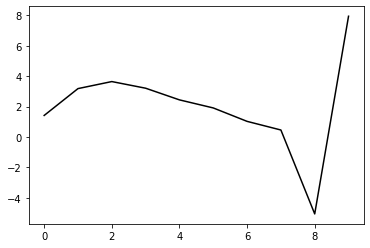

107800 24.288595971042213
0.44616904306559946 -0.4911295192291102 -0.15582413323842328 -0.09618800808996199
[ 1.44533427  3.14862624  3.61135963  3.17686516  2.41273603  1.88448236
  1.0053206   0.43946217 -5.07258449  7.91596601]


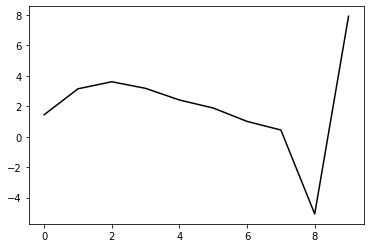

108900 27.25745597697272
0.4521357693840914 -0.49148086431340826 -0.1584349569236283 -0.09226572718918216
[ 1.33440793  3.1957006   3.63951894  3.18861163  2.41061133  1.87032826
  0.98233714  0.40645188 -5.11585784  7.94586333]


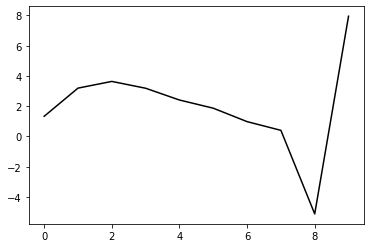

110000 20.16750423670776
0.4506563785521789 -0.49577619909021975 -0.1625217800077238 -0.09026448420690414
[ 1.369088    3.1190264   3.57462687  3.13796871  2.37382306  1.84597756
  0.9701676   0.40344232 -5.11087372  7.88581108]


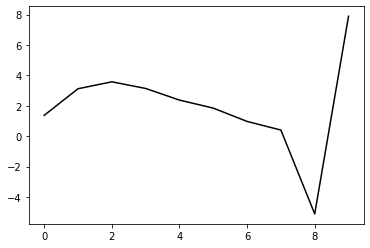

111100 20.707439310436932
0.45148276712310137 -0.49081806478979 -0.15974406108713082 -0.09257517189550604
[ 1.37097905  3.18725474  3.62716406  3.1756023   2.39725198  1.85614737
  0.96955537  0.39216659 -5.13192569  7.92072721]


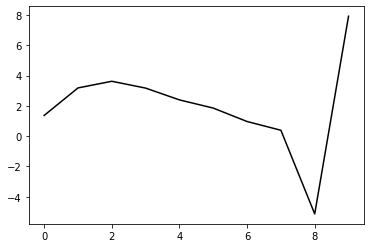

112200 22.65289698482703
0.4526517269539076 -0.487985604064751 -0.15864903365895397 -0.09285312845465388
[ 1.37797719  3.17585117  3.62224322  3.17669877  2.40341022  1.86611585
  0.98364033  0.40700494 -5.11940443  7.90246481]


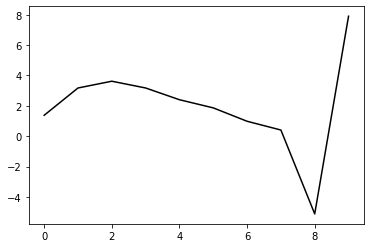

113300 21.85299503811552
0.451033523941425 -0.4869041631395821 -0.1583811286226198 -0.09224373048416294
[ 1.37490454  3.18069811  3.63158564  3.18986592  2.41886284  1.88199452
  1.00021028  0.42005513 -5.11306682  7.92573232]


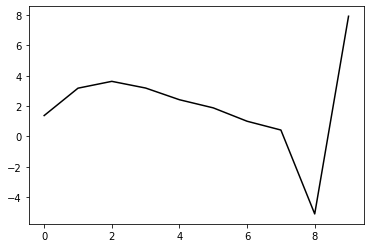

114400 20.1697878899749
0.440583497114317 -0.4933454694567118 -0.16140869356043 -0.09166876769157678
[ 1.40564815  3.04308548  3.48160409  3.02941602  2.24931144  1.70504177
  0.81994777  0.23816954 -5.29385079  7.87429287]


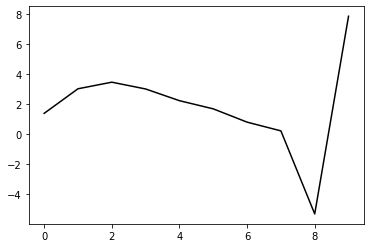

115500 23.038361348453066
0.45092580605875476 -0.48278117423425476 -0.1563442650554761 -0.09701866630611693
[ 1.4190129   3.22898169  3.68695852  3.24946699  2.47939952  1.94127304
  1.06047816  0.47880677 -5.0568107   7.94190203]


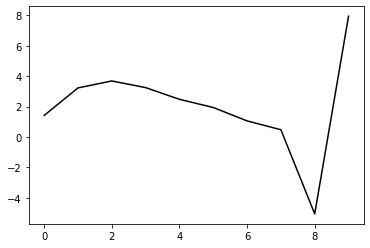

116600 28.22821712808306
0.44328555385557894 -0.49400830696479997 -0.16416715215053496 -0.09195203287279956
[ 1.38994261  3.09579227  3.53350847  3.08051556  2.29864736  1.75170848
  0.86626809  0.28111727 -5.25501382  7.88317852]


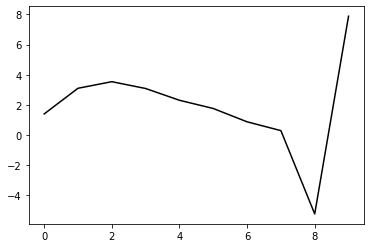

117700 14.527158243868568
0.44879114085436195 -0.48465447045581844 -0.15860498232716524 -0.09704735397031516
[ 1.43989198  3.17666665  3.62237069  3.17506938  2.39659066  1.85128046
  0.96755238  0.38189842 -5.1560636   7.92586945]


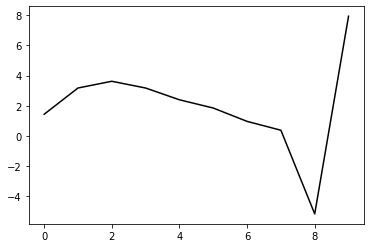

118800 21.992905415233487
0.4518202331577633 -0.48077129185861567 -0.1570254658134171 -0.09701442778642028
[ 1.39993585  3.24229913  3.68543219  3.23504573  2.45337941  1.90451418
  1.01840115  0.4277333  -5.11751282  7.90425061]


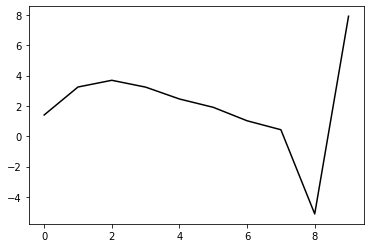

119900 26.274143386792257
0.4531751342173693 -0.483192122563659 -0.1598439065478826 -0.09353593187878058
[ 1.33462528  3.22729991  3.65616982  3.19138431  2.39574686  1.83359134
  0.93752502  0.33663154 -5.21652921  7.92033345]


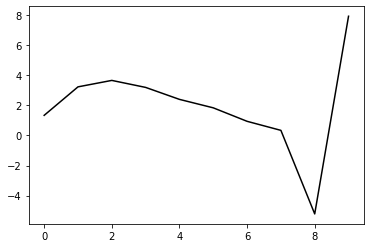

121000 18.075893814831712
0.45491183876193086 -0.4828002198716944 -0.16106176369649172 -0.09374964869783586
[ 1.36639891  3.26039573  3.69528047  3.23589495  2.44482158  1.88642128
  0.99479243  0.39631685 -5.15521833  7.88283078]


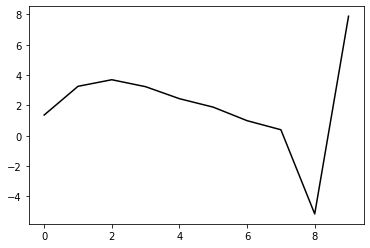

122100 21.592615213597604
0.4537035889799633 -0.4794560001112935 -0.1590988401480673 -0.0945942114833934
[ 1.40001465  3.19053135  3.63378013  3.18274413  2.3993811   1.8474796
  0.96257353  0.36711762 -5.18436313  7.93419948]


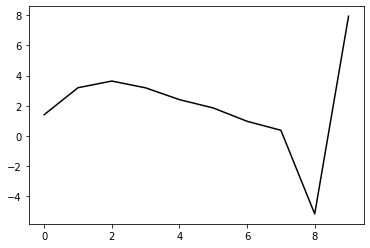

123200 23.860207484255803
0.45390693032192686 -0.47928727893123274 -0.15987467046403828 -0.093218417611212
[ 1.36601619  3.20802484  3.65719148  3.21131347  2.4318101   1.88209903
  0.99972366  0.40272957 -5.15338023  7.8877675 ]


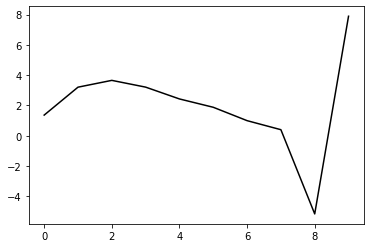

124300 21.216204813688577
0.4512950106597099 -0.477917000927824 -0.1594609842834648 -0.09355146832169287
[ 1.39337274  3.18826435  3.65509619  3.22806302  2.46642643  1.93227731
  1.06445069  0.47494308 -5.0807632   7.94807702]


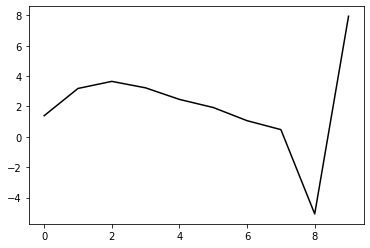

125400 14.341333743457088
0.44389618359531474 -0.4827781567491136 -0.1617972468166048 -0.09456986275499225
[ 1.43906075  3.10760353  3.59461778  3.18862282  2.44679468  1.93080425
  1.08126039  0.50687656 -5.03537041  7.92351399]


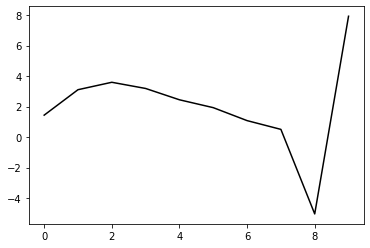

126500 22.14475693947907
0.44667092792889407 -0.4767597225032695 -0.15885037826153645 -0.09576891361265681
[ 1.42088755  3.16282484  3.65019553  3.24464934  2.50240508  1.98475447
  1.13401854  0.55459493 -4.99603762  7.93838663]


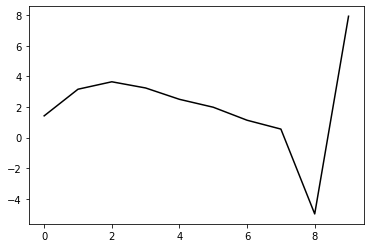

127600 24.556561929559024
0.4444153571934263 -0.47692834272674195 -0.15942418933566008 -0.09381512533994273
[ 1.40149041  3.12459424  3.6027582   3.18940819  2.43980987  1.91474654
  1.05839592  0.47091904 -5.08878389  7.90963245]


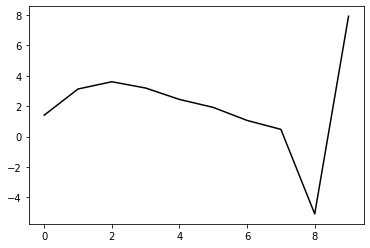

128700 13.830780201315035
0.4436792089041529 -0.4768717098714667 -0.15993468760094418 -0.09441607571247278
[ 1.44859697  3.09058081  3.57718645  3.1730818   2.43177077  1.91400117
  1.0658983   0.48486051 -5.06828834  7.91883165]


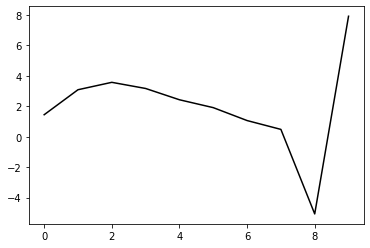

129800 25.479026790272965
0.43975942116387284 -0.47472863580845365 -0.15812356724858367 -0.09734149814337902
[ 1.45038139  3.08945459  3.55981402  3.1425726   2.38993212  1.86249153
  1.00792259  0.42133684 -5.13495769  7.89266236]


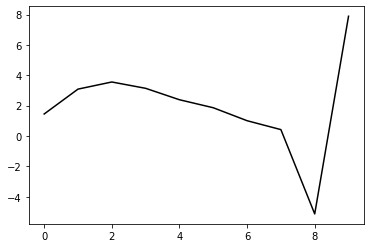

130900 14.506286715481354
0.4474158855175251 -0.47284949112820523 -0.15927206791497278 -0.09554707967630158
[ 1.37195987  3.15602836  3.61111154  3.18096779  2.41764136  1.88117141
  1.02021844  0.42640849 -5.13732643  7.95711604]


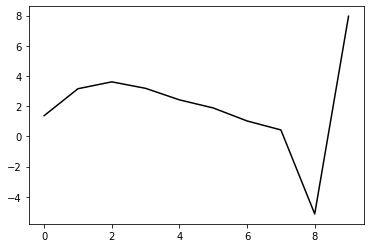

132000 16.546527645884225
0.45126144547095115 -0.4717674173430235 -0.1602156035007972 -0.093787436214499
[ 1.36684522  3.22578452  3.68018668  3.24854896  2.48270129  1.9428471
  1.07938155  0.48124825 -5.08750843  7.9202474 ]


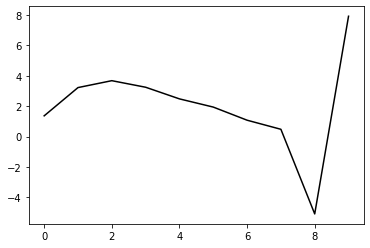

133100 21.692742240887757
0.4502328054787026 -0.470425582330319 -0.15988996768273703 -0.09327463410200315
[ 1.41523456  3.14093409  3.60204184  3.17742685  2.41790249  1.88314185
  1.02518727  0.42893922 -5.14057446  7.93294802]


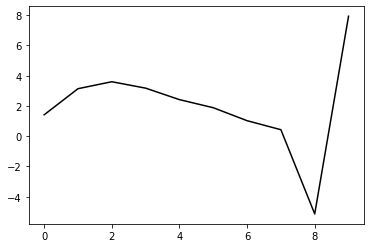

134200 22.82145899199935
0.44538327345700185 -0.46986293697716974 -0.15842180332040334 -0.09555439371202087
[ 1.41002695  3.13603653  3.59092067  3.1622062   2.40009859  1.86405835
  1.00773658  0.41288399 -5.1537509   7.92248978]


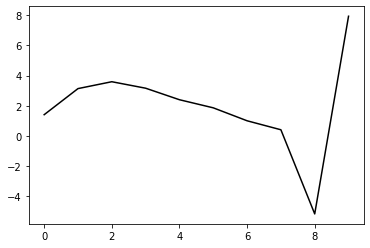

135300 22.68333774669281
0.4447216281208768 -0.4705696061508288 -0.15935486809864585 -0.09432329211297923
[ 1.40114741  3.08774152  3.53559503  3.10204189  2.33683014  1.79911183
  0.94410573  0.35031874 -5.2144684   7.90086225]


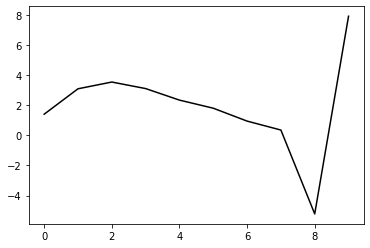

136400 14.52675283612415
0.4438835680810137 -0.4709400165078274 -0.15973889160598798 -0.09565046958291239
[ 1.42345266  3.09603188  3.55842926  3.13985516  2.38793944  1.86133002
  1.01710425  0.43085738 -5.12705984  7.90739257]


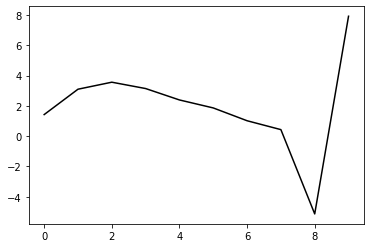

137500 23.954750656259108
0.44168013182519106 -0.4688404916150606 -0.1583898233315769 -0.09644782616569131
[ 1.42495717  3.09622973  3.55685564  3.13512638  2.37873777  1.84654287
  0.99785514  0.40466603 -5.16147388  7.9180454 ]


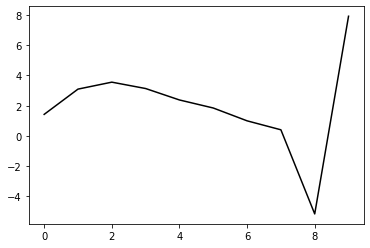

138600 25.41120186628393
0.44881631432070884 -0.46790530516656426 -0.16028310039738167 -0.0931054428956831
[ 1.36580351  3.18459691  3.64576039  3.22382804  2.46610854  1.93134323
  1.08068862  0.48234275 -5.0910773   7.89917288]


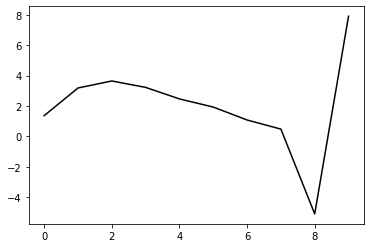

139700 13.665803216362855
0.4427013503285627 -0.46951581276129767 -0.16027288333881723 -0.09623431458526804
[ 1.42527491  3.09725249  3.57149548  3.16452747  2.42142668  1.90034643
  1.06414423  0.47740591 -5.08559934  7.93437923]


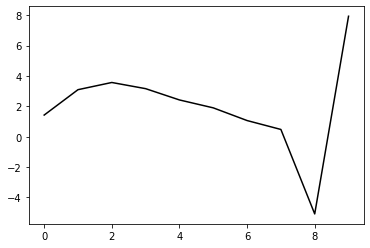

140800 25.41583242709726
0.4396416878087484 -0.466425361105316 -0.1582495830165205 -0.09791885451706608
[ 1.43955448  3.08239652  3.55209301  3.14397904  2.40084739  1.88009694
  1.04595306  0.45993862 -5.10205417  7.89947199]


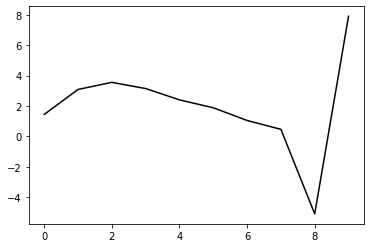

141900 13.643031914895497
0.4451929930953436 -0.46624964042380723 -0.16021138096829216 -0.09668359361483336
[ 1.39094279  3.16583013  3.64072028  3.23590842  2.49381893  1.97208021
  1.13684707  0.54638383 -5.02328231  7.94277556]


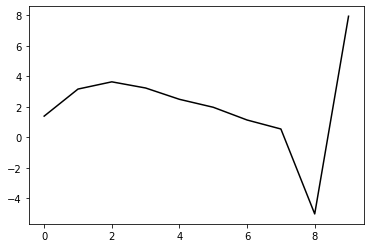

143000 16.928956049552017
0.44196970145083414 -0.4717145688040847 -0.1643229462620196 -0.09464139893982335
[ 1.41453417  3.07834534  3.57224125  3.18897901  2.46795859  1.96546253
  1.14901483  0.57244983 -4.98724282  7.93075189]


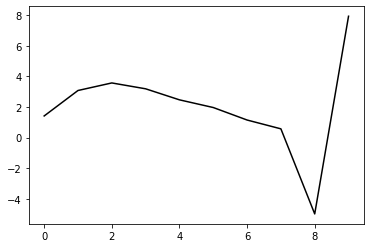

144100 23.702256212181396
0.4357789206268607 -0.4728965265302893 -0.16444077648070235 -0.09397588894039785
[ 1.45095163  2.93235783  3.40643275  3.01221939  2.28597778  1.78182018
  0.96786624  0.39279018 -5.16600326  7.91512846]


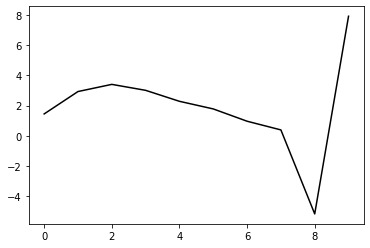

145200 22.66393992906637
0.43973319344795786 -0.4617688347408399 -0.15872594037371113 -0.09407229574594017
[ 1.41204522  3.03185     3.49596561  3.08930167  2.34855508  1.82836825
  0.99917311  0.40520872 -5.17519088  7.88547464]


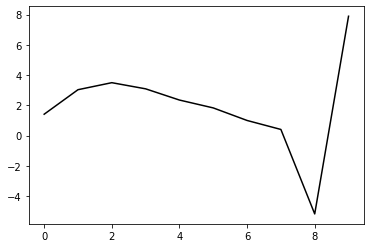

146300 21.255014310356056
0.4434794920784584 -0.46336569468826294 -0.16152397421973563 -0.09074971662169495
[ 1.40172363  3.08267549  3.55755544  3.16015189  2.42612022  1.91031915
  1.08529315  0.49253928 -5.08741023  7.93196108]


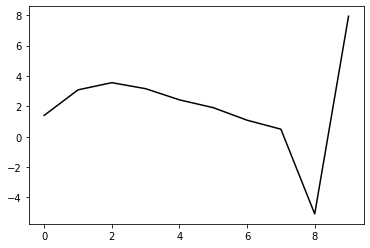

147400 22.92364637143967
0.4298598372972851 -0.4726766267733461 -0.1660139213900952 -0.08883265249871389
[ 1.41985345  2.90435493  3.36040903  2.94828866  2.20218797  1.67689543
  0.84676396  0.251043   -5.32983507  7.87060796]


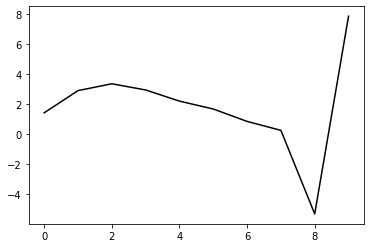

148500 22.2387888059761
0.4399032318554803 -0.46368782331950403 -0.1615697706152628 -0.09579794257543574
[ 1.42930224  3.14638846  3.63051101  3.23714398  2.50126747  1.98021496
  1.15183523  0.5542165  -5.03048949  7.96272033]


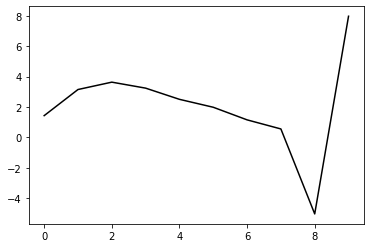

149600 25.265096477378307
0.4383307202513684 -0.46534173675120843 -0.16366391121411877 -0.09203097799275807
[ 1.41191943  3.06127476  3.53254907  3.13287026  2.3939651   1.87121406
  1.04320348  0.44432316 -5.14129135  7.89506817]


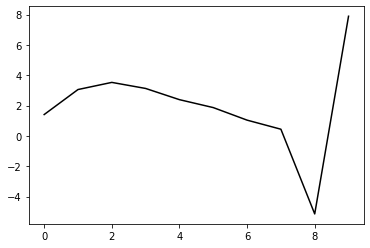

150700 14.397366410545793
0.4398396827396488 -0.46103855395962934 -0.16163220058713604 -0.09514729085753248
[ 1.45650547  3.07042673  3.56604094  3.1889586   2.4691453   1.96178063
  1.14727551  0.55651881 -5.02595864  7.93798204]


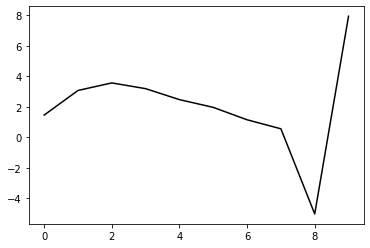

151800 23.556824944599327
0.43880692847053193 -0.4569564370310758 -0.15909838041657481 -0.0959815572334319
[ 1.43979195  3.12838057  3.61673601  3.23133659  2.50195644  1.98400626
  1.16002166  0.55751933 -5.037358    7.91275515]


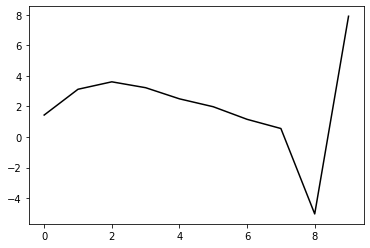

152900 13.470779270334827
0.4405753396806331 -0.45717993853629574 -0.16049238421455436 -0.09455244120711806
[ 1.40280757  3.16737643  3.65785184  3.27520883  2.54770362  2.0303491
  1.20734845  0.60280625 -4.99642086  7.94611231]


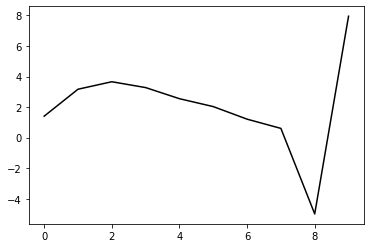

154000 16.537595972093435
0.43809675664893266 -0.4617168937369578 -0.16380612145883414 -0.09193572598981067
[ 1.41781872  3.08768535  3.58367644  3.20840109  2.48843661  1.97825253
  1.16389894  0.56623581 -5.02568788  7.90881555]


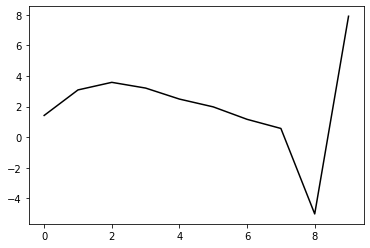

155100 21.93594958611542
0.4308532289942212 -0.4659244710806027 -0.16587015406784916 -0.09122189358539495
[ 1.44664844  2.95446726  3.44355145  3.06777962  2.35010973  1.84341899
  1.03486278  0.44116616 -5.14748421  7.91826722]


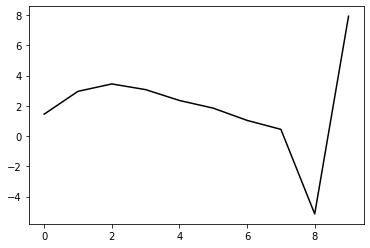

156200 24.20005040955011
0.43389962884498506 -0.4534229173505821 -0.15846379244815698 -0.09270888876672395
[ 1.43682145  3.02812028  3.49703994  3.10048418  2.36274122  1.83715908
  1.01263869  0.40149338 -5.20604935  7.88201318]


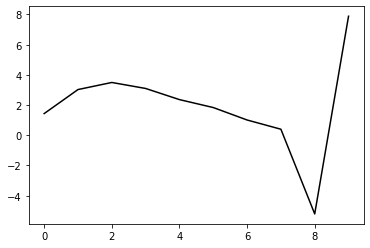

157300 24.515299329247625
0.42964574917959414 -0.45674920947928765 -0.16053674851135905 -0.09229687666012616
[ 1.44104241  3.00514462  3.47913694  3.08922414  2.35785616  1.83795411
  1.01989369  0.4137015  -5.18813303  7.90362905]


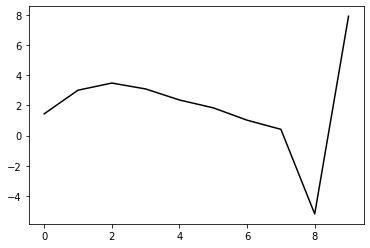

158400 16.962430822288827
0.42903602604799274 -0.45876102763469717 -0.16280575460732596 -0.09128193982662695
[ 1.41299774  3.01165852  3.48717907  3.09987965  2.37021652  1.85083592
  1.03389382  0.42720126 -5.17454932  7.90229818]


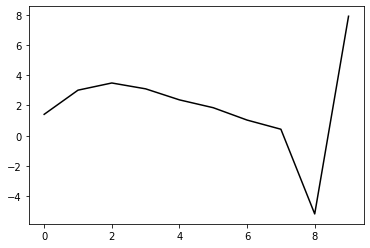

159500 21.56538305095054
0.42967714530587525 -0.460045247882282 -0.16501649267456156 -0.09064803901587005
[ 1.40336213  3.00766202  3.48515423  3.10165134  2.37514389  1.8577579
  1.04315152  0.43686042 -5.16445933  7.92709591]


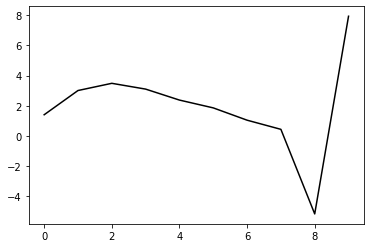

160600 24.294399744162774
0.4329299033932312 -0.4553110900235282 -0.1628575293228459 -0.09420472377169994
[ 1.39896582  3.11132635  3.60384589  3.2329043   2.51557414  2.00438142
  1.1949183   0.59012134 -5.01245672  7.920303  ]


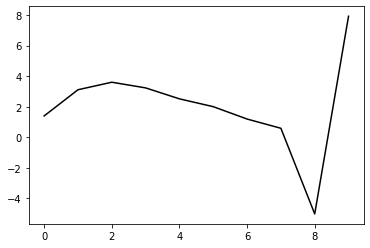

161700 13.842271004791703
0.42818035125693854 -0.45582829450193535 -0.16318213272343973 -0.09406472308728135
[ 1.45798308  2.99121133  3.46933651  3.09104656  2.37015002  1.8574867
  1.04941871  0.44575385 -5.15455117  7.92029784]


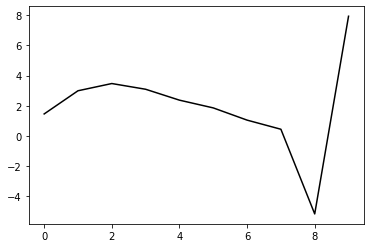

162800 24.613105679451948
0.43045389477184975 -0.45097814514571577 -0.1606127682377511 -0.09625342436840206
[ 1.45141748  3.07839047  3.55149949  3.16802398  2.44173174  1.92366249
  1.11167447  0.50340163 -5.10079963  7.89967324]


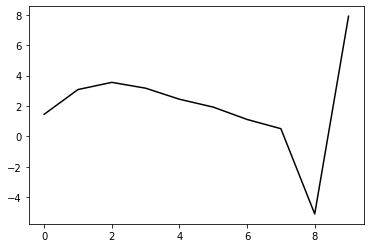

163900 13.302564218505514
0.4368989811286183 -0.4485959115445716 -0.1609155469626885 -0.0948190889224182
[ 1.40717648  3.16930506  3.63752269  3.24933942  2.51833203  1.99527193
  1.1794086   0.56561139 -5.04512806  7.92807155]


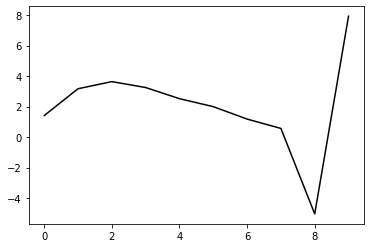

165000 16.668194040201023
0.4384278184809208 -0.4510986064142702 -0.16371046681142246 -0.0918093542952269
[ 1.38739837  3.15127747  3.61570004  3.22360296  2.48811542  1.9600227
  1.14101585  0.52288107 -5.09148461  7.90563416]


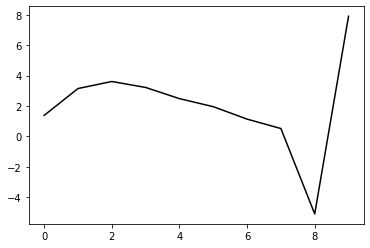

166100 20.189077892598704
0.43737221123580217 -0.4518078558149299 -0.16469563826998962 -0.09166459479837784
[ 1.39982484  3.09754271  3.57225217  3.19161741  2.4667356   1.94732506
  1.13696546  0.52270545 -5.09142358  7.92702903]


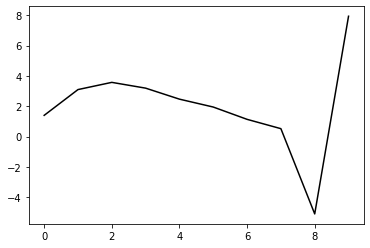

167200 33.194057712986066
0.4246465494507498 -0.4452821906489274 -0.15751627714222854 -0.09660758405503958
[ 1.47567991  2.89960897  3.35478109  2.96564787  2.23930072  1.72226117
  0.91797831  0.30900829 -5.30156988  7.88318298]


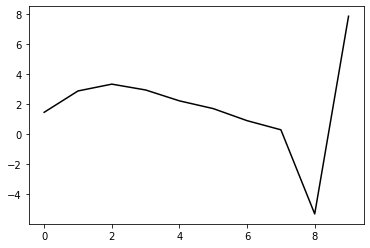

168300 22.477380515033687
0.4322640459142826 -0.45040554589044735 -0.1635127768728232 -0.09394075524152333
[ 1.42075054  3.05684374  3.51582556  3.12547845  2.3939545   1.86978071
  1.05943328  0.44445419 -5.16954229  7.8972917 ]


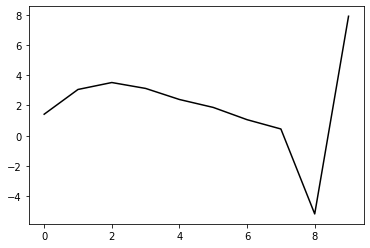

169400 14.554153662266177
0.436184255467155 -0.4460565729845501 -0.16156462305093894 -0.09389593675079948
[ 1.39652899  3.13101102  3.58694417  3.19298738  2.45740541  1.92863051
  1.11476023  0.49438079 -5.12620403  7.9156769 ]


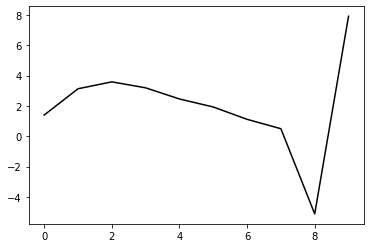

170500 22.42178806421868
0.4357276968926688 -0.4455831519027124 -0.16131614250172874 -0.0955756830155054
[ 1.4298949   3.13758125  3.61309055  3.23619176  2.51436073  1.99621511
  1.19220653  0.57837762 -5.03778234  7.97157797]


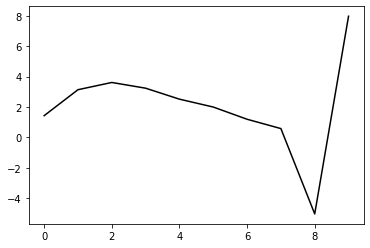

171600 24.6163147805745
0.43610110024414417 -0.4478349345712608 -0.16377145704318197 -0.0945130557155492
[ 1.38987104  3.17557714  3.66211161  3.29498818  2.58093263  2.06826095
  1.26949188  0.65661462 -4.96210558  7.91679603]


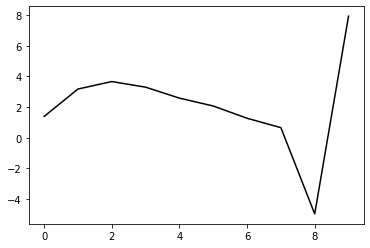

172700 17.398236485076637
0.4322933486023858 -0.44589424492225127 -0.1620107009302254 -0.09546547231142398
[ 1.48668178  3.05098385  3.53611164  3.16985581  2.45758746  1.94702457
  1.15263608  0.54270534 -5.07216302  7.92826585]


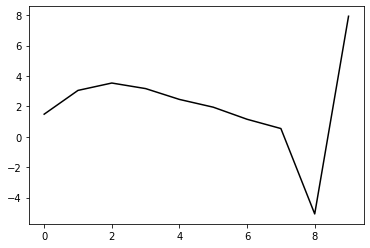

173800 21.693049092152176
0.43491616608362316 -0.443654398735505 -0.16134528991907382 -0.09514324911906662
[ 1.42768543  3.16162118  3.63618153  3.25549848  2.52652593  1.9987925
  1.19024688  0.56679654 -5.0590898   7.91965546]


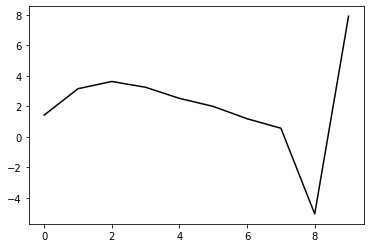

174900 18.474722954284054
0.43365677739723657 -0.4465521463287557 -0.16413750037016786 -0.09247484820938494
[ 1.37115877  3.13970493  3.60094246  3.20832617  2.4692195   1.93283418
  1.11871357  0.48914802 -5.14165684  7.94967353]


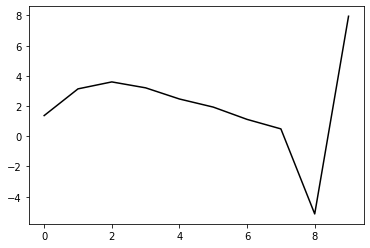

176000 15.856025748511442
0.4367087502946986 -0.4434951055769315 -0.16328092612724177 -0.09267178002808499
[ 1.38398259  3.19781541  3.66185241  3.27147024  2.53348663  1.99689476
  1.18295322  0.55106958 -5.08339083  7.92716343]


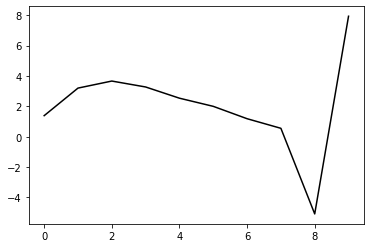

177100 21.633856727541563
0.4355050264965377 -0.4431191072005234 -0.16337727389762238 -0.09223052465486012
[ 1.43746372  3.11232382  3.57979582  3.19354088  2.45943473  1.92603839
  1.11660211  0.48701972 -5.1456536   7.93093938]


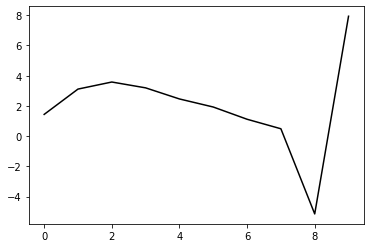

178200 22.317162623340646
0.4363015307618265 -0.441337839366415 -0.16288270523221848 -0.09031168928255803
[ 1.39203483  3.12339654  3.58044101  3.18449146  2.44115631  1.89868309
  1.08235073  0.44481558 -5.19546714  7.89166781]


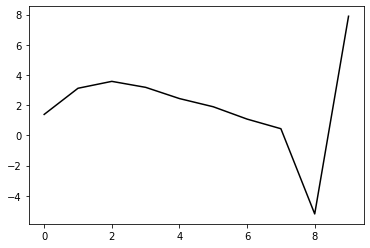

179300 25.318373190417507
0.42524392815280015 -0.44285599419654526 -0.1614316398391862 -0.0942868274406717
[ 1.43169341  3.00408573  3.44116715  3.029495    2.27430964  1.72382288
  0.90497778  0.26829958 -5.36613231  7.88955421]


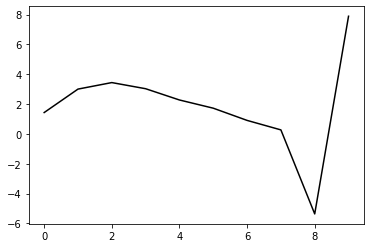

180400 14.293124226497234
0.43639346076689667 -0.4391999540255036 -0.16216886301873895 -0.09471084806784551
[ 1.39865885  3.20471227  3.65404867  3.25088079  2.5009666   1.95322809
  1.13650932  0.49971582 -5.13612982  7.8911429 ]


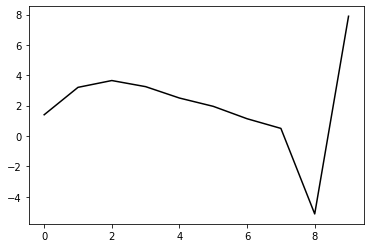

181500 22.757838238346242
0.4366382156825537 -0.4391817107600828 -0.1626118843151434 -0.09397896776639635
[ 1.38174553  3.17890133  3.62947448  3.2265414   2.47613115  1.92718328
  1.110603    0.47262218 -5.16406784  7.92382208]


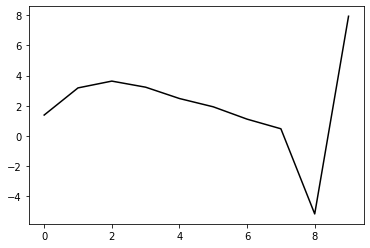

182600 25.38768421818787
0.43613189511339856 -0.44292850125296157 -0.1658007150724297 -0.09232415136770364
[ 1.39221199  3.16465135  3.62616196  3.23341087  2.49155994  1.94913881
  1.13919998  0.50444597 -5.13127017  7.89597736]


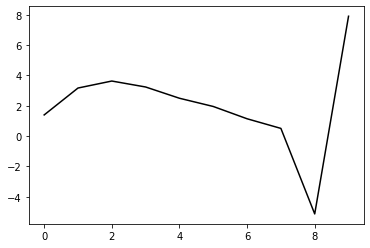

183700 14.69098683155424
0.43512319221778983 -0.44094958486990393 -0.16459120424404283 -0.09524857951726029
[ 1.4497409   3.15629052  3.64107756  3.27034834  2.54742611  2.02002528
  1.22322517  0.59577442 -5.03728613  7.95644051]


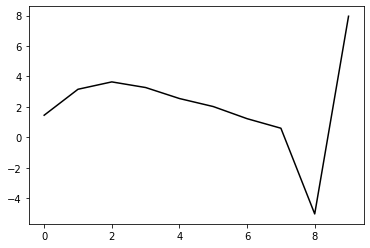

184800 22.638807338366462
0.4303132384125507 -0.4383976132550473 -0.16251689995935542 -0.09498446719414072
[ 1.44253768  3.15122738  3.60210196  3.19923453  2.44751095  1.89535277
  1.07969359  0.43698714 -5.20754478  7.87899509]


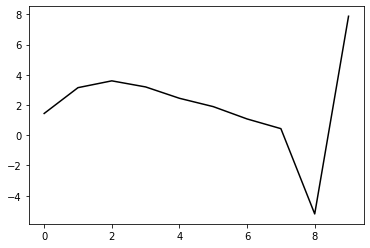

185900 17.048773296149026
0.43874266978004167 -0.43735516769707306 -0.16450777370384484 -0.09414172905803611
[ 1.3726269   3.21003     3.65941295  3.25474048  2.50136028  1.94728699
  1.13058802  0.48509587 -5.16358941  7.94966971]


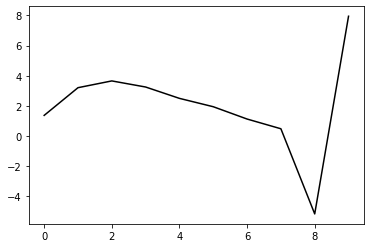

187000 17.25978283173055
0.43284976984429746 -0.44008756051113607 -0.16573724891445182 -0.09326422148630754
[ 1.44066806  3.09349994  3.55007196  3.15470154  2.41086349  1.86574717
  1.05880664  0.42141378 -5.21920207  7.88612862]


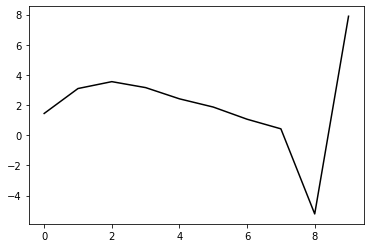

188100 19.989977295014413
0.43775126506705364 -0.4384882032133684 -0.1660159691245075 -0.09250180916862177
[ 1.40715301  3.14311874  3.59913239  3.20162088  2.45448683  1.90517184
  1.09546944  0.45367982 -5.19163688  7.90974574]


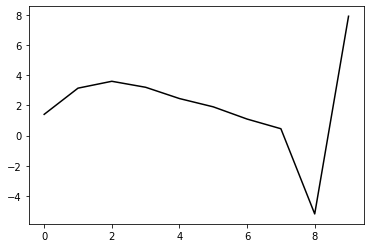

189200 22.688611978254126
0.4290715606998746 -0.43999890925501 -0.16573810010696752 -0.09413334245593626
[ 1.45282605  3.02841278  3.48110039  3.08358935  2.33848619  1.79238204
  0.98870461  0.35175513 -5.28872379  7.85246973]


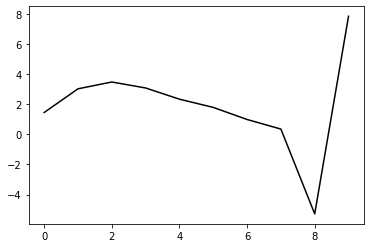

190300 22.263201407275677
0.4360640145606214 -0.43851459385251507 -0.16725287075853282 -0.08957563289635352
[ 1.37880582  3.17676807  3.61828396  3.20561722  2.44342742  1.87934303
  1.05952129  0.40498313 -5.25245134  7.91364814]


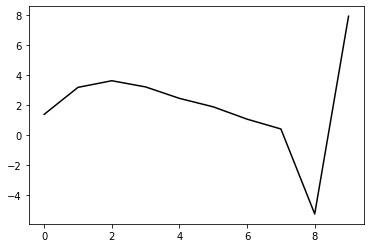

191400 16.142561266092585
0.43329239109139644 -0.4349304758622343 -0.164156656521617 -0.09474024683537134
[ 1.47040921  3.17921722  3.64886523  3.26202638  2.5224705   1.97784754
  1.17617044  0.53601245 -5.10956829  7.87791082]


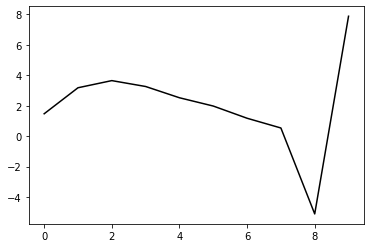

192500 22.544315821683842
0.42975326583055906 -0.43802528743825525 -0.1658506799561427 -0.09647680666014632
[ 1.44779593  3.19116594  3.66414343  3.27977263  2.54120271  1.99595618
  1.19440205  0.55227786 -5.09527381  7.91244822]


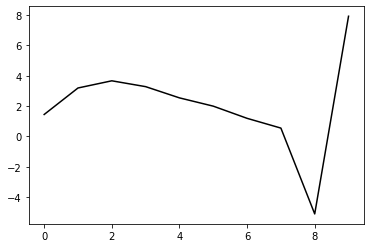

193600 25.233223603456054
0.43794869666365943 -0.43312437602930054 -0.16513602760790866 -0.09370291601381911
[ 1.39136516  3.31041447  3.78190174  3.3934134   2.64939046  2.09735845
  1.28973748  0.63751888 -5.02390747  7.92224871]


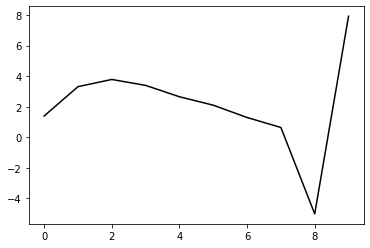

194700 17.441312673141134
0.432096224040492 -0.4327774025693559 -0.16409758685705303 -0.09487200697286576
[ 1.50139243  3.14975225  3.62449141  3.24105622  2.50274459  1.95630421
  1.15631414  0.50986515 -5.14527711  7.9445808 ]


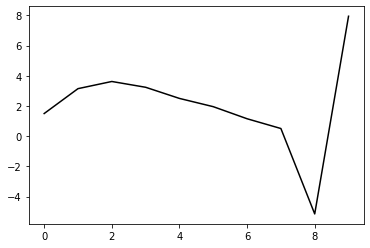

195800 25.617614331662438
0.43136031761187194 -0.43051368237470883 -0.16279564588982978 -0.09584903524130317
[ 1.46233752  3.23707414  3.70309399  3.30778135  2.55563121  1.9947457
  1.18280969  0.52518403 -5.13825889  7.93954115]


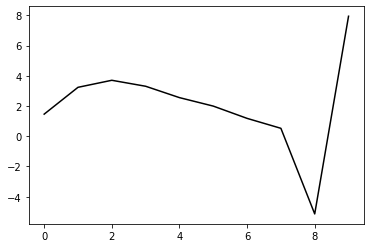

196900 13.422718514014107
0.4330070033015204 -0.43282665857144614 -0.1654937411930297 -0.09579074954303349
[ 1.42652934  3.24944335  3.711135    3.3119793   2.55665186  1.99286313
  1.17967039  0.51938316 -5.14681837  7.87124986]


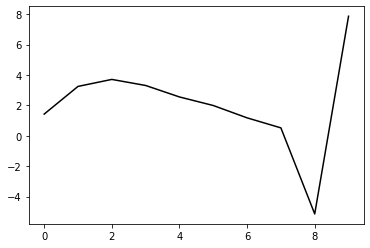

198000 20.78443821117033
0.43628069065206526 -0.4371534560172894 -0.17071486401757477 -0.08811274236618871
[ 1.3948084   3.11961679  3.56146019  3.14963399  2.38873698  1.82405659
  1.01452849  0.35769766 -5.30480768  7.8602657 ]


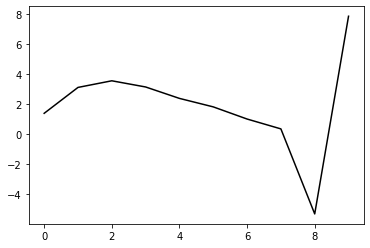

199100 21.576299991336537
0.4322409339440768 -0.4342059250065321 -0.16746181280741862 -0.09473681708696839
[ 1.41982089  3.19707231  3.62313895  3.19315366  2.41401437  1.83280612
  1.01064028  0.34436706 -5.32432356  7.88324687]


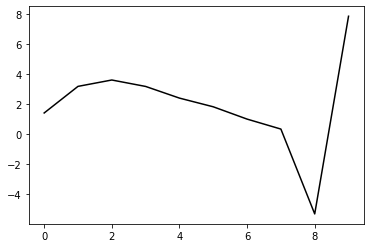

200200 23.866487441568847
0.4331768040057427 -0.42974437597192444 -0.16464220288796214 -0.09704722249028798
[ 1.43625208  3.18935566  3.61189018  3.17939583  2.39901038  1.81713909
  0.9957903   0.32931058 -5.33995632  7.89096878]


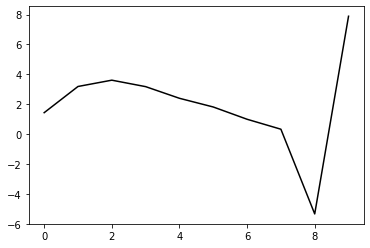

201300 21.526120218394897
0.43966095886289785 -0.42878208054003336 -0.16598510157122054 -0.09414942315194567
[ 1.41132521  3.24073852  3.66540059  3.23237183  2.45026754  1.86575284
  1.04278413  0.37324945 -5.29962885  7.88231812]


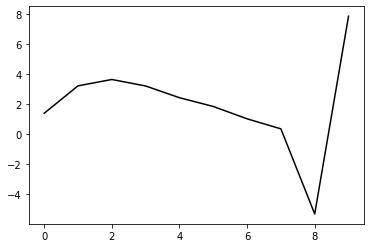

202400 14.040949072160975
0.4363284584681164 -0.4310642862506275 -0.16724197527317483 -0.09625981398339083
[ 1.43877256  3.24939635  3.69707325  3.28419536  2.51886787  1.94759673
  1.13658086  0.47510223 -5.1917957   7.89607217]


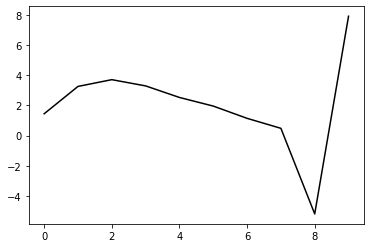

203500 22.887508227156424
0.431176264917226 -0.4297181122718534 -0.1660025820962162 -0.09565264252899813
[ 1.43551774  3.18657387  3.61984586  3.19210728  2.41284228  1.82836611
  1.00663612  0.33336763 -5.34547773  7.88112007]


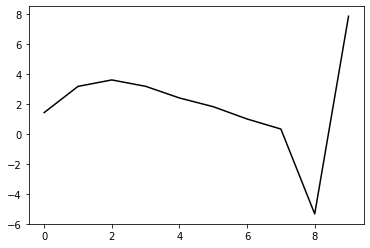

204600 25.049957138201083
0.4345548619279309 -0.43059855304851136 -0.1681646210701862 -0.09387472588640217
[ 1.40658416  3.21957406  3.65702856  3.23318172  2.45755141  1.87610778
  1.05822394  0.38661764 -5.29104595  7.87384566]


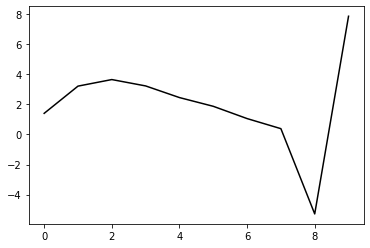

205700 13.646301874166408
0.4292785367931133 -0.43015463988456 -0.1675515433174263 -0.09655578521170674
[ 1.45645     3.15883802  3.60976788  3.2000733   2.43756847  1.86746566
  1.06035047  0.39663388 -5.27425687  7.90214195]


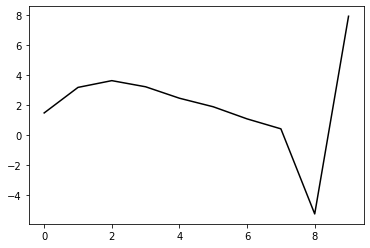

206800 23.58723449035735
0.4333049519233047 -0.4270355692481577 -0.16683317839512338 -0.09646198548301063
[ 1.39205695  3.21708616  3.65623502  3.23600198  2.46450846  1.88652437
  1.07387864  0.40416688 -5.27225763  7.88084973]


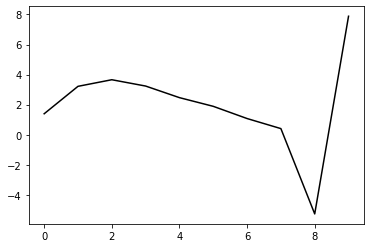

207900 26.052352258770192
0.4346691279316534 -0.42864805659123656 -0.16890452729575062 -0.09475303809186093
[ 1.35348143  3.21160524  3.64687148  3.22532118  2.45418262  1.87701559
  1.0668001   0.39732194 -5.27991789  7.92497624]


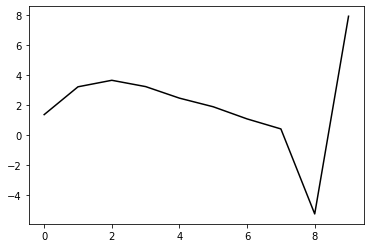

209000 18.93286266335661
0.4377275301654891 -0.4255011693839776 -0.16864996987186837 -0.09455805761924144
[ 1.36854358  3.27253187  3.71619349  3.30331001  2.53958963  1.96766586
  1.1615707   0.4922153  -5.18848351  7.88952184]


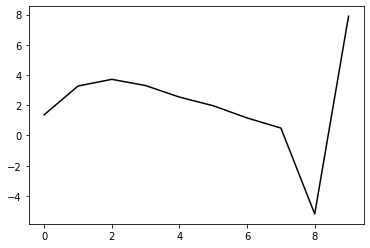

210100 20.18909400500308
0.4376822357012106 -0.422456261946105 -0.16726697852144598 -0.09404317161807009
[ 1.39830989  3.20704879  3.6497298   3.23635641  2.47260538  1.90040595
  1.09495171  0.42394263 -5.25929933  7.90730456]


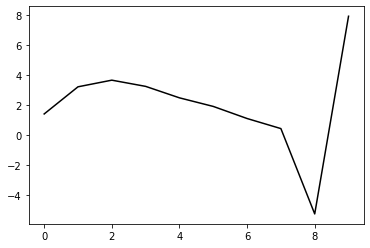

211200 22.989817333955905
0.4321003158563356 -0.4207174238440838 -0.165352492540038 -0.0958194869620112
[ 1.43433772  3.1639661   3.6122319   3.20351532  2.44334239  1.87336126
  1.07051835  0.39926121 -5.28601575  7.87802567]


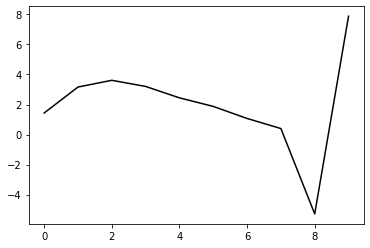

212300 24.61516559304105
0.42274180214921947 -0.4262316773915561 -0.1677077684255512 -0.09477488054835267
[ 1.40762032  3.02342104  3.44472469  3.01199918  2.2313647   1.64466469
  0.83062036  0.15189432 -5.53884151  7.88644332]


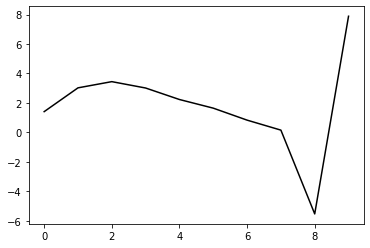

213400 16.663261869307266
0.4308286429221485 -0.42129356781312116 -0.16611287402887404 -0.09754937603652629
[ 1.45617806  3.1864703   3.63068606  3.21491378  2.44572957  1.86613386
  1.05746198  0.38123766 -5.3052826   7.91370635]


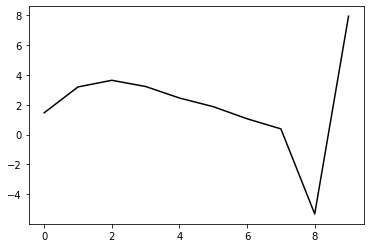

214500 21.91161029829951
0.4274513165241746 -0.429260106210017 -0.17223994960458194 -0.09377051300946362
[ 1.39609678  3.11026511  3.53542974  3.10388645  2.32187652  1.73167874
  0.91551366  0.23276649 -5.45863634  7.90175236]


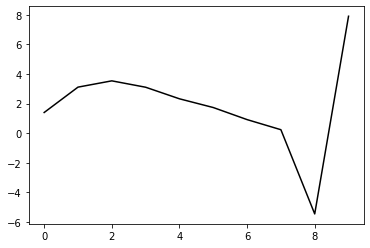

215600 24.31071894497614
0.4352571198502498 -0.4218891438982405 -0.16868714772626853 -0.09963559439799856
[ 1.39446265  3.32406598  3.7649093   3.34298898  2.56634401  1.97855829
  1.16393157  0.48058507 -5.21303258  7.88733805]


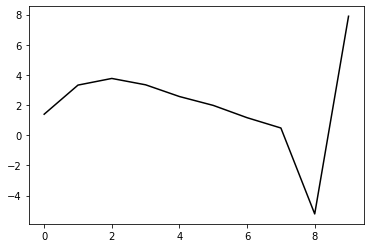

216700 13.26480594880741
0.427401125374667 -0.4243021519361058 -0.16985545262716448 -0.09705786367745282
[ 1.44608115  3.11051469  3.54789991  3.12702357  2.35348404  1.76934095
  0.9595078   0.27971161 -5.40961704  7.88454906]


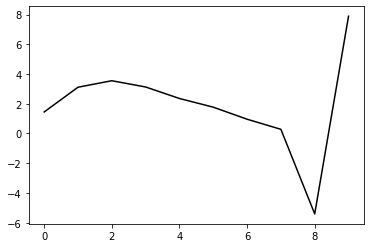

217800 22.475772144847372
0.43318682198092223 -0.4178481866468184 -0.1665841807044104 -0.10056641639273797
[ 1.4303144   3.24635387  3.69243884  3.27704456  2.50696301  1.92463523
  1.11656962  0.43611381 -5.25598259  7.87061482]


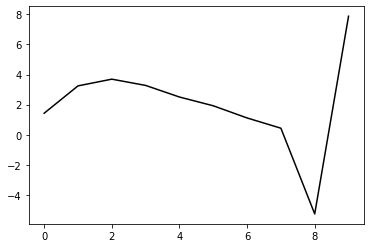

218900 17.039052513645302
0.43420763379521804 -0.41913713511203515 -0.1687571818401445 -0.09702012504228233
[ 1.36383722  3.24180124  3.67752793  3.2519506   2.47244519  1.8808802
  1.06533481  0.37541997 -5.32699795  7.92742529]


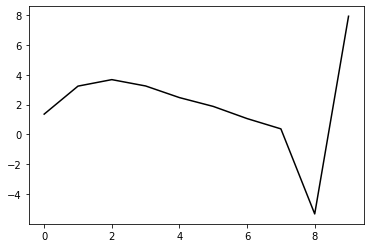

220000 18.049064749131336
0.4346450142690786 -0.4224426391713553 -0.17189784081571155 -0.09474317835321512
[ 1.38647301  3.17422819  3.61501772  3.19638243  2.42525513  1.84254224
  1.03749796  0.35618934 -5.3381361   7.84832553]


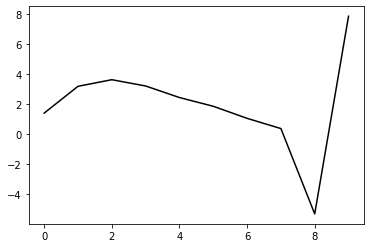

221100 25.325562922878724
0.4272813193388534 -0.4218899431123746 -0.17035560174457018 -0.09743221592594647
[ 1.47259301  2.9999566   3.44629679  3.03981778  2.28291267  1.71397553
  0.92273736  0.25227213 -5.43303404  7.91469337]


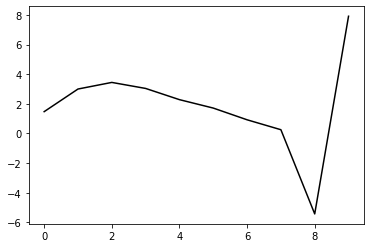

222200 24.898010341030236
0.4293507703425434 -0.41548384435966956 -0.16742359403065854 -0.09870883550468379
[ 1.44390195  3.08099323  3.53030204  3.12554143  2.36920625  1.79937114
  1.00688259  0.33173364 -5.36043202  7.85986114]


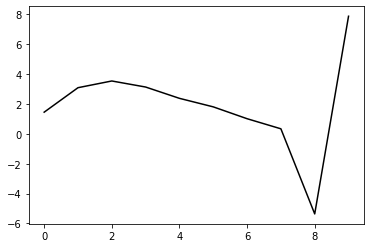

223300 20.875460944974506
0.431221315078546 -0.4178868499129442 -0.17012160235361648 -0.09751291175411451
[ 1.40156882  3.1786034   3.63905725  3.24184167  2.48985394  1.92194452
  1.13135519  0.4561683  -5.23644335  7.91290248]


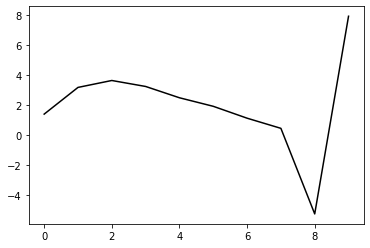

224400 17.888004161859737
0.4255376702296702 -0.4188760871734009 -0.1703276414565495 -0.09647455321836909
[ 1.39779211  3.04451554  3.48705007  3.07987741  2.32266938  1.75201423
  0.96170017  0.28670288 -5.40466801  7.86113269]


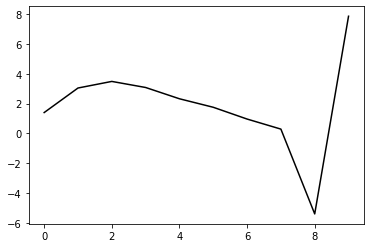

225500 22.668173986294768
0.43311632283810775 -0.4132030367626691 -0.16856540717723367 -0.09875270590317027
[ 1.39307277  3.20756173  3.67103897  3.2790696   2.53246567  1.96875969
  1.18365529  0.50979749 -5.18417011  7.93231602]


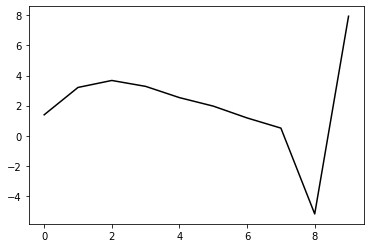

226600 25.390607523984887
0.4333647346401392 -0.41679740279997196 -0.17185074967191227 -0.09650626891456651
[ 1.38899876  3.1912088   3.65763286  3.26800071  2.52282833  1.95952707
  1.17570267  0.50111675 -5.19390117  7.88096953]


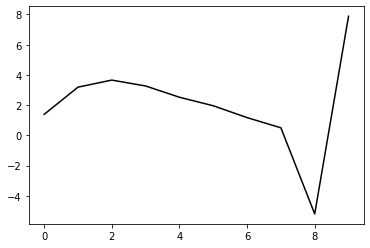

227700 14.19493202094505
0.43264990155244254 -0.41185709505579876 -0.16875037005772825 -0.09834862841829622
[ 1.44975974  3.15068263  3.62529519  3.24400324  2.50665705  1.94992871
  1.17287726  0.50109575 -5.19440645  7.93312083]


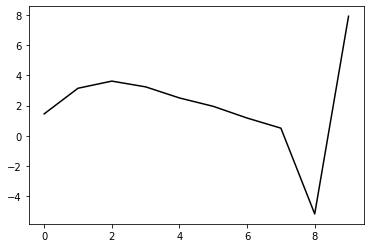

228800 23.89257281682806
0.42923360774560726 -0.41237225921865917 -0.1690706062899715 -0.09708127128239188
[ 1.41593281  3.1185445   3.58396804  3.19374798  2.44755988  1.88206033
  1.09876358  0.42004735 -5.28183735  7.8703316 ]


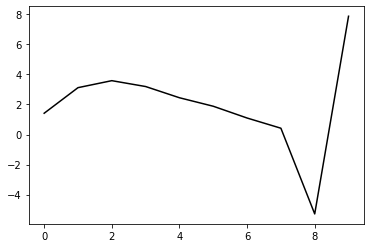

229900 15.589371321463151
0.43254335579406444 -0.4107618136451485 -0.1694164708456726 -0.09564535859750942
[ 1.39114383  3.17402193  3.64949297  3.26885603  2.53029436  1.96941217
  1.18927051  0.50780693 -5.2017147   7.91556039]


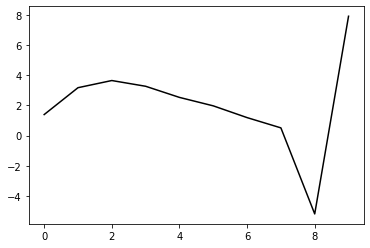

231000 16.459899147514903
0.430214061456793 -0.4124687507954189 -0.17084997249736938 -0.0935736236857122
[ 1.43242302  3.14630065  3.62189272  3.23989242  2.49814473  1.93283769
  1.14981818  0.46455688 -5.24727279  7.88442786]


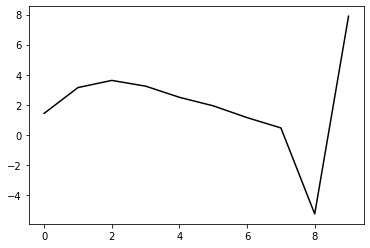

232100 20.23719590134962
0.4347738202585275 -0.408069501985431 -0.16929982080609435 -0.09308310228873543
[ 1.4145835   3.15790395  3.62597854  3.23647203  2.48734421  1.91454023
  1.12568267  0.43281493 -5.28788973  7.89457113]


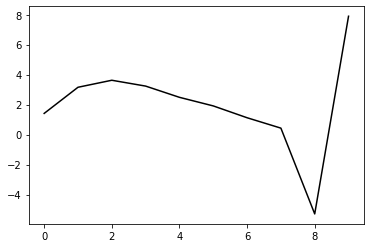

233200 24.732646996727972
0.4279215425303709 -0.4084236494111619 -0.1681070545274568 -0.0952021542440984
[ 1.47016774  3.05181126  3.50773524  3.11098465  2.35851952  1.78544705
  1.00039645  0.31260892 -5.40020957  7.87412918]


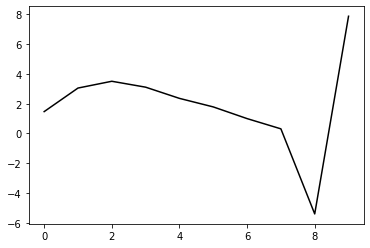

234300 21.09099099940237
0.4328726856747962 -0.4098597793664717 -0.1711977818080274 -0.09336734994420927
[ 1.42015869  3.12862816  3.60119941  3.21645418  2.47107657  1.90114106
  1.11811411  0.42923473 -5.28568004  7.91508079]


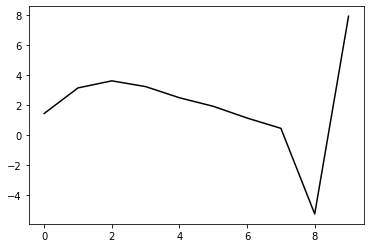

235400 15.40505547599454
0.4254080505012108 -0.41061070556933016 -0.17080929071530143 -0.09511879438345008
[ 1.42700475  3.06098656  3.53231542  3.15017402  2.40850898  1.84213329
  1.06372853  0.37796591 -5.33365561  7.87153635]


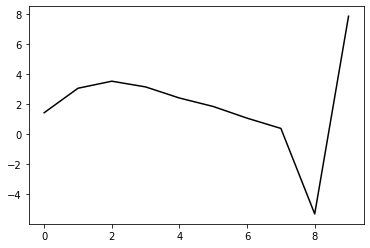

236500 21.12883610021435
0.4245406417065926 -0.41409701814772154 -0.17451070080080505 -0.09264980062606322
[ 1.41941731  3.01825531  3.48535828  3.10197623  2.35998007  1.79327314
  1.01552698  0.32894813 -5.38401281  7.88986058]


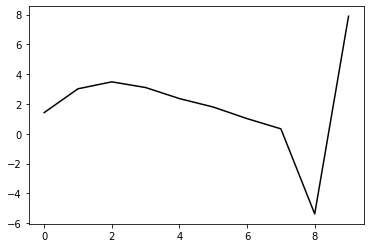

237600 26.785312032110443
0.425414745897951 -0.4136953699914492 -0.1750959228223369 -0.09350346639322796
[ 1.41885921  3.08811876  3.5459784   3.15352325  2.40263462  1.8274624
  1.0430923   0.35003401 -5.3671918   7.8616971 ]


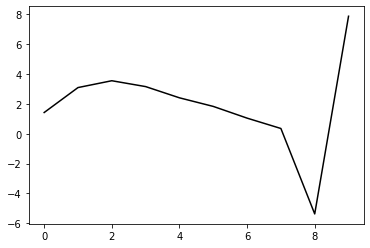

238700 13.842245529546233
0.43459695670868775 -0.4035414243347303 -0.1697891898269775 -0.0981307628093094
[ 1.44946628  3.19125322  3.65624564  3.26893988  2.52169924  1.94889283
  1.16686077  0.47419086 -5.24482689  7.91849404]


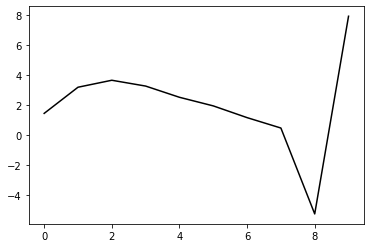

239800 22.273616071028115
0.43218988228919897 -0.40404645647642323 -0.1701449148951654 -0.09869107000645237
[ 1.42509199  3.1929104   3.66222268  3.27807134  2.53300584  1.96140183
  1.18124487  0.48828061 -5.23232323  7.88063309]


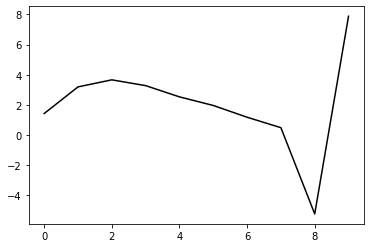

240900 13.333719058452882
0.4326475369067059 -0.4035035682486783 -0.17055766072701065 -0.09754383190688282
[ 1.4207457   3.20569053  3.68477569  3.30922193  2.57114987  2.004505
  1.22888886  0.53661254 -5.18675215  7.91674479]


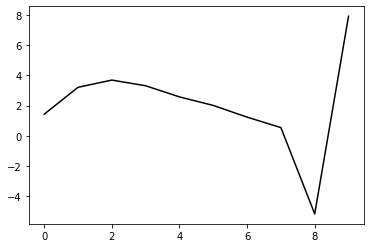

242000 16.353231970794827
0.4347647024507231 -0.4023205234861905 -0.17087872316437774 -0.09569838764384439
[ 1.38301446  3.20960491  3.68166312  3.29989756  2.55653807  1.98505091
  1.20653715  0.50942333 -5.21970841  7.92980252]


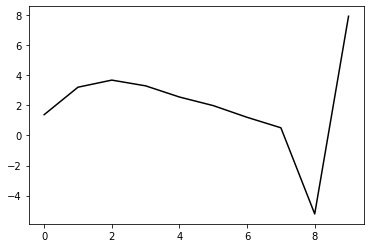

243100 19.6579171749735
0.42944861381638416 -0.40743190817850294 -0.1740801766813487 -0.09321300806058772
[ 1.41246311  3.12197513  3.58450382  3.19325342  2.44128633  1.86294608
  1.08189047  0.38371452 -5.34280556  7.85522552]


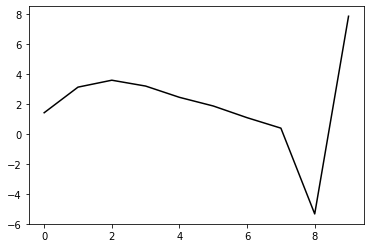

244200 22.86330826902764
0.4316413045439846 -0.4042097215597194 -0.1729464200402259 -0.09375407569455164
[ 1.41183383  3.13852508  3.6071043   3.22082646  2.47269313  1.89698643
  1.11890331  0.42077958 -5.30831001  7.85282483]


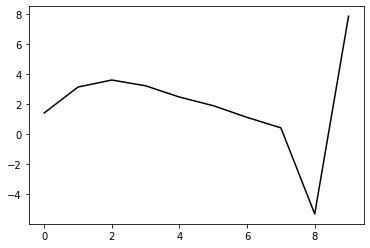

245300 20.813712709832373
0.4299241186998097 -0.40364160729266335 -0.172732045591461 -0.09392677879281455
[ 1.43387373  3.14212895  3.62138256  3.2447212   2.50463587  1.93545748
  1.1641059   0.47018912 -5.2554388   7.90948227]


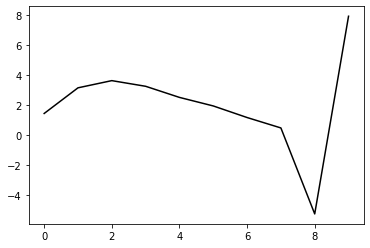

246400 14.646680588989675
0.42598613191352097 -0.4020930689964259 -0.17134076700289622 -0.09510015073081463
[ 1.43209951  3.08691529  3.56144687  3.18530364  2.44848259  1.88342843
  1.11758256  0.42725182 -5.29572154  7.88732243]


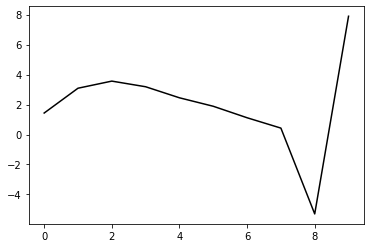

247500 23.878931829442994
0.42979119862758736 -0.40126876858284954 -0.1721887367430052 -0.09559229047206681
[ 1.40758759  3.1771475   3.67022998  3.30822907  2.58087806  2.0214239
  1.25967198  0.56934344 -5.15658344  7.92853001]


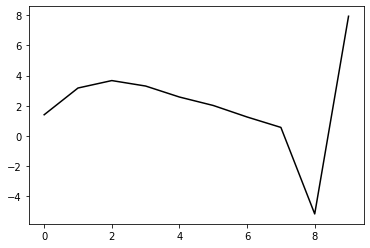

248600 25.322491592645612
0.4280389124552365 -0.40414295375332043 -0.17487247167347678 -0.09226499511104667
[ 1.43332524  3.1079986   3.58916888  3.22007791  2.48854158  1.92658285
  1.16493814  0.47411556 -5.25098459  7.87942265]


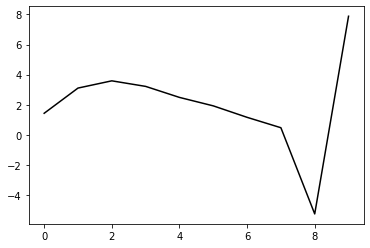

249700 13.971886009461446
0.430106162249052 -0.3992479840753627 -0.17203221307869124 -0.09507339431012282
[ 1.44540616  3.13927544  3.62090881  3.25024044  2.5151985   1.94863589
  1.18377816  0.4884096  -5.24127319  7.91930565]


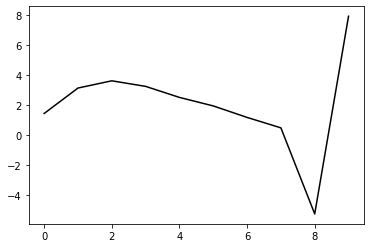

250800 26.621591844409306
0.4250849545858416 -0.39640263817278815 -0.16923503313926136 -0.0971242491270532
[ 1.48269049  3.10380628  3.58606592  3.21855773  2.48808468  1.9264083
  1.16795651  0.47739981 -5.24700945  7.86442733]


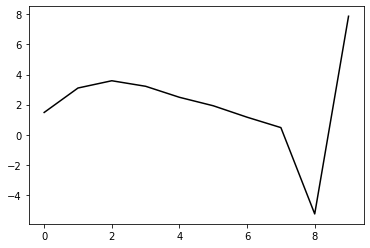

251900 18.899471538886363
0.4291557413965023 -0.39999001009837937 -0.173784921540366 -0.09455110936217195
[ 1.39118711  3.15438956  3.61661507  3.23060392  2.48348494  1.90710426
  1.13729842  0.43675649 -5.29447059  7.92040846]


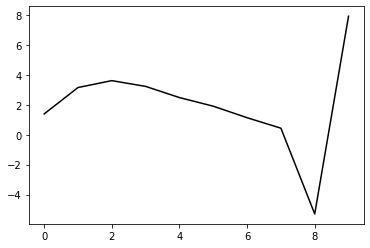

253000 18.163547150924853
0.43243674853924363 -0.400817875166898 -0.17590126571583428 -0.09303863215064158
[ 1.40322866  3.19171036  3.64899338  3.25852405  2.5071096   1.92655421
  1.1538367   0.44998133 -5.28354707  7.8640479 ]


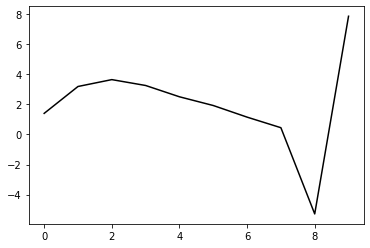

254100 26.36108724145602
0.42461378413955664 -0.39716007238672546 -0.17183604730746868 -0.0975380248103331
[ 1.50926292  3.02499514  3.48142911  3.09344135  2.34598687  1.7699476
  1.00308405  0.30460277 -5.42260944  7.91654082]


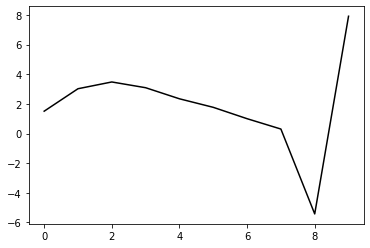

255200 22.901365528388247
0.43254773535786684 -0.39546230944163274 -0.17315768005959548 -0.0952127058519147
[ 1.42708989  3.19569189  3.63827889  3.23560866  2.47387903  1.88418034
  1.10533496  0.39448832 -5.34500455  7.86789127]


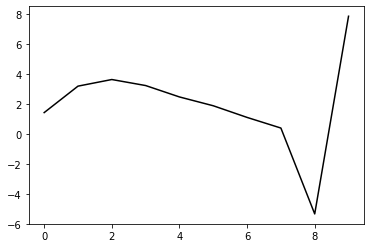

256300 24.6203053374007
0.4232950871331452 -0.3953597495258995 -0.1716875147691094 -0.09725639325654058
[ 1.43957265  3.04330722  3.48218538  3.07943509  2.31944461  1.7321792
  0.95720297  0.2498885  -5.4864273   7.8735684 ]


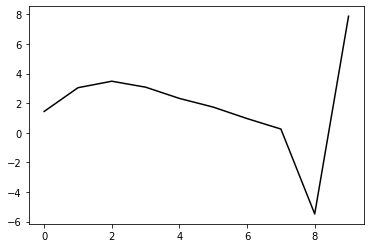

257400 14.409529372236864
0.43093212321166957 -0.39267006775962937 -0.17212025680741233 -0.09684313263917652
[ 1.4204284   3.20581773  3.65035376  3.24990212  2.49008669  1.90138257
  1.12485899  0.41388337 -5.32613983  7.87031749]


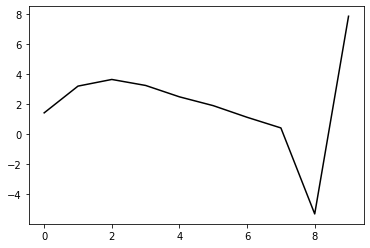

258500 22.611232637675496
0.4336802662762823 -0.3884433856764961 -0.16976337416775258 -0.09804377414089899
[ 1.43968231  3.23601863  3.69080563  3.29749671  2.54252794  1.95676132
  1.18313729  0.47299298 -5.26740198  7.92440571]


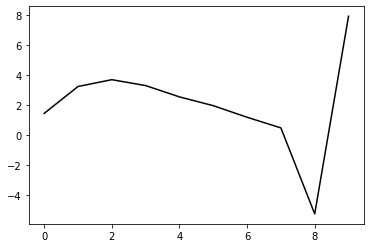

259600 25.272801482623283
0.4276453457513048 -0.39693542402076626 -0.17581631059223482 -0.09485727958421494
[ 1.4218387   3.11625211  3.57143209  3.18271041  2.43476727  1.85663423
  1.09165491  0.38817861 -5.3461386   7.87424048]


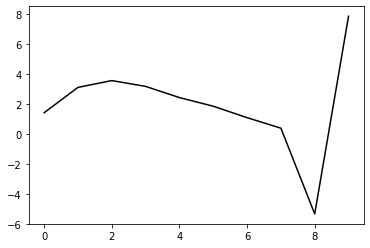

260700 13.14670653901734
0.4261703655645625 -0.39307968081486505 -0.17344980017745967 -0.09700480176868136
[ 1.46193027  3.08155029  3.54202538  3.16050546  2.41963667  1.84745961
  1.08833639  0.38833102 -5.34339222  7.88515969]


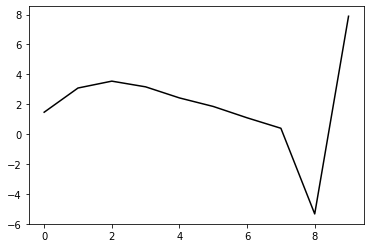

261800 24.110090787897917
0.42698226942076584 -0.3900024549499932 -0.17158922542041757 -0.10033576488080372
[ 1.45661828  3.17283779  3.64247856  3.2681076   2.53203881  1.96260633
  1.20596528  0.50633545 -5.22578139  7.88972223]


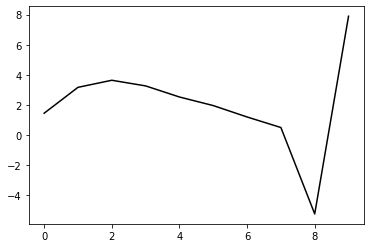

262900 23.58891351576224
0.4290718944929798 -0.3926081273260584 -0.17503751334223713 -0.09660896246291822
[ 1.36454963  3.1448251   3.59929524  3.21581908  2.47436811  1.90117986
  1.14270586  0.43985454 -5.29534161  7.91467991]


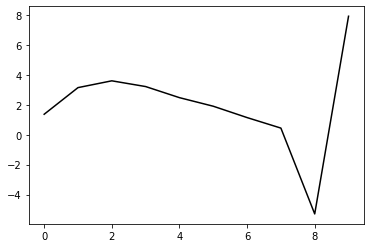

264000 18.040427841975127
0.4309885275491876 -0.3919769037596963 -0.17573302032258983 -0.09630422353115192
[ 1.38248265  3.17788752  3.62569643  3.23627379  2.48909034  1.91021976
  1.14724072  0.43928826 -5.30083703  7.87428768]


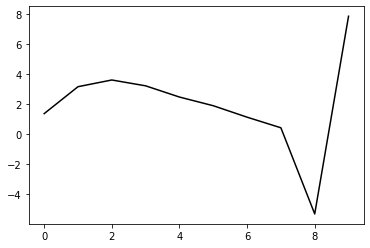

265100 21.95520402284541
0.42813639560939337 -0.39163796181103105 -0.17529843503143364 -0.09711245107910894
[ 1.43355358  3.07302268  3.52444661  3.14132981  2.4016596   1.8303891
  1.07576967  0.3746638  -5.35887066  7.90796501]


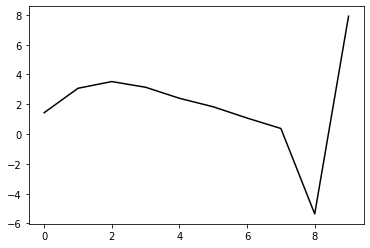

266200 29.492177527240965
0.41966087484298037 -0.38753508188820635 -0.1707352548676042 -0.10144544189065918
[ 1.46827388  2.96511428  3.41272703  3.03148764  2.29591609  1.72908016
  0.97980017  0.28260492 -5.44762895  7.82994361]


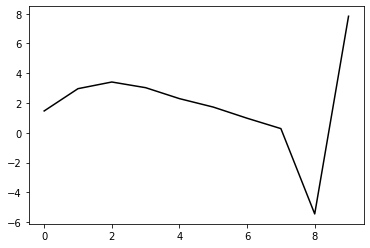

267300 21.12299123967583
0.4302545730475563 -0.38817279801870525 -0.1746508888013282 -0.09718796447908426
[ 1.3992112   3.13884608  3.59056959  3.20969863  2.47200277  1.90126987
  1.14798053  0.44461897 -5.29277876  7.90253662]


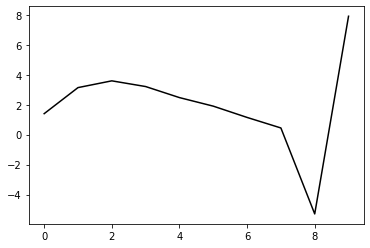

268400 19.298505631425154
0.41897987677494664 -0.39377539255769634 -0.1770386740177547 -0.09608092638150285
[ 1.4222212   2.96495388  3.40731388  3.02161425  2.28142492  1.70954801
  0.95742362  0.25595619 -5.47852419  7.84959808]


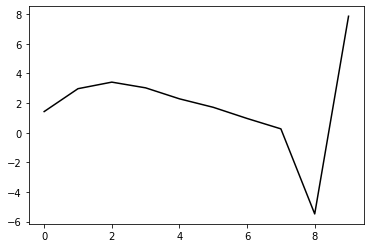

269500 22.31458251969722
0.4284929800635478 -0.3874745435787059 -0.1748317421345751 -0.09745416959997166
[ 1.39094421  3.11499364  3.55313219  3.16103396  2.41313203  1.8326358
  1.0724046   0.36167056 -5.38154251  7.88734662]


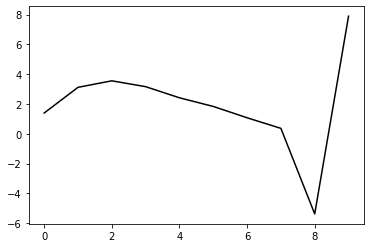

270600 25.263334986364317
0.42792554320554693 -0.38915304201100837 -0.1765329041860413 -0.0972622479574694
[ 1.39924268  3.10037356  3.54343808  3.15622922  2.41258447  1.83551253
  1.0791464   0.37097075 -5.36965001  7.87656352]


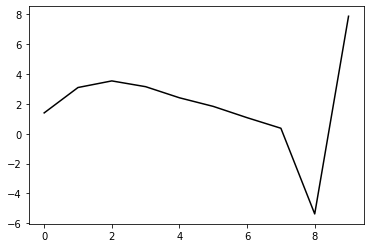

271700 13.80435852410192
0.426957878021128 -0.3859298945341039 -0.17421288199990584 -0.10056095301107515
[ 1.44608304  3.10721807  3.5639934   3.18933589  2.45618381  1.88749887
  1.13891218  0.43617035 -5.29991249  7.89819879]


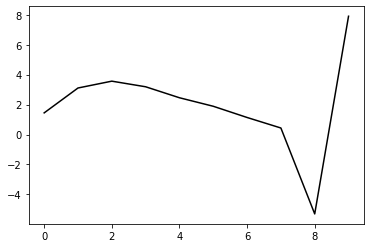

272800 23.18155897378771
0.4273746023492646 -0.3823119975514937 -0.17206401368897992 -0.1013972105787496
[ 1.4394547   3.14807612  3.60352113  3.22791035  2.49444996  1.9255341
  1.17776888  0.474013   -5.26431046  7.8729033 ]


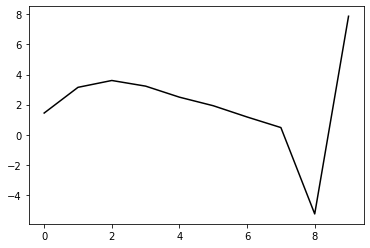

273900 29.61025279719141
0.4283762609803087 -0.38724905361413886 -0.1767714379652483 -0.09772567003597167
[ 1.34089455  3.10340601  3.55095837  3.17005256  2.43330849  1.86206174
  1.11380632  0.40827439 -5.33235032  7.93935443]


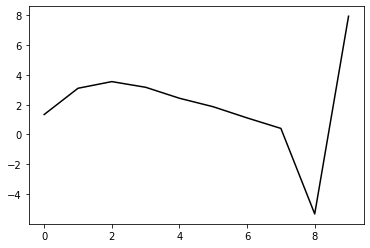

275000 17.79793014642324
0.42667217947110403 -0.3892649747267222 -0.17878759004531777 -0.09628119667436932
[ 1.38750479  3.05195041  3.51215161  3.14510816  2.42118782  1.86088536
  1.12274043  0.4243721  -5.31056758  7.86112541]


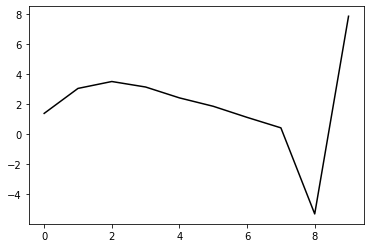

276100 26.154740678957214
0.41887519198133055 -0.3857347850843171 -0.17490324676506938 -0.10031896276341673
[ 1.48940866  2.88618984  3.34734246  2.98723713  2.27246352  1.72160251
  0.99360209  0.3036531  -5.42371725  7.91244672]


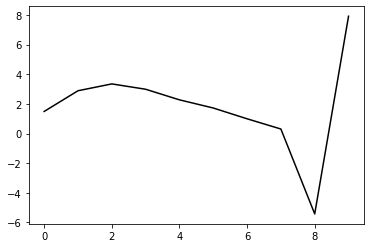

277200 23.787667838535267
0.42294009270404836 -0.38028785158978745 -0.17290295387485266 -0.10014395697863598
[ 1.43312545  3.02299059  3.47769998  3.11069723  2.38879582  1.8302936
  1.09498949  0.39539512 -5.34295907  7.85667942]


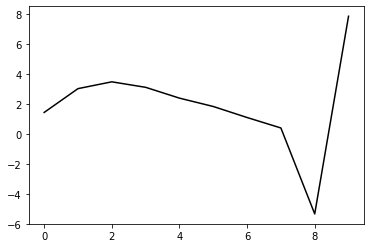

278300 21.51631569269842
0.42903543343809314 -0.3782702624917102 -0.1734426712374207 -0.0967629203792915
[ 1.397794    3.05995003  3.51048778  3.13916079  2.41294926  1.84987332
  1.11101158  0.40646555 -5.33774091  7.90408804]


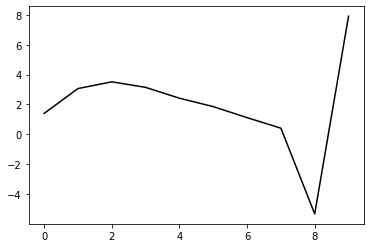

279400 15.569420975083736
0.4244102453474677 -0.37913377709909213 -0.17316306049247768 -0.09930172602216321
[ 1.44967491  3.04932405  3.51394467  3.15500776  2.43890932  1.88397704
  1.15340851  0.45527985 -5.2823035   7.88737225]


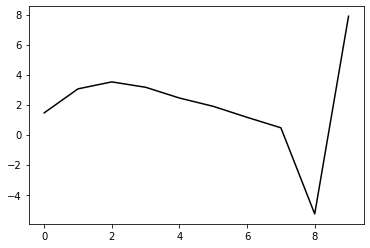

280500 22.604197418090816
0.4217096260041015 -0.3810345229708768 -0.17425660912003224 -0.1002048327441514
[ 1.43278941  3.04711041  3.51756585  3.1643436   2.45307641  1.90168525
  1.17492684  0.47836946 -5.25856704  7.94038278]


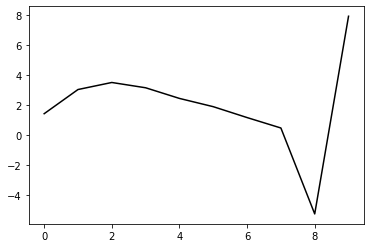

281600 25.35704057417821
0.4222764028906985 -0.38411616474047267 -0.17777441417951376 -0.09582234587317906
[ 1.40790885  3.01760466  3.47463858  3.11272834  2.39614121  1.84130099
  1.11340214  0.41448455 -5.32522722  7.87826778]


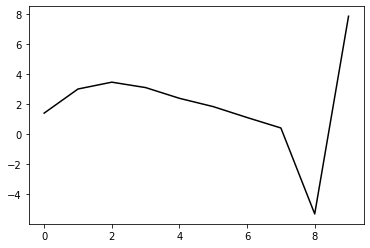

282700 13.441111010455272
0.4209888981916007 -0.3799103410397519 -0.1750479692750936 -0.09820415158021485
[ 1.45559095  2.96977071  3.42700554  3.06766944  2.35397844  1.80157203
  1.0767426   0.37955075 -5.3582807   7.89042425]


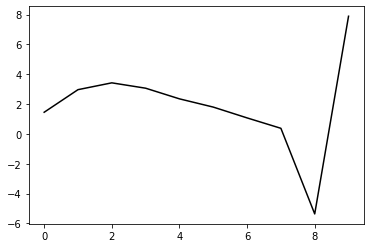

283800 25.804502497747364
0.4170672626506756 -0.37814321280011326 -0.17325580289211667 -0.10175236114541467
[ 1.45571418  3.01099961  3.46329276  3.09955208  2.38140023  1.82452631
  1.0966511   0.39646853 -5.34194366  7.86082217]


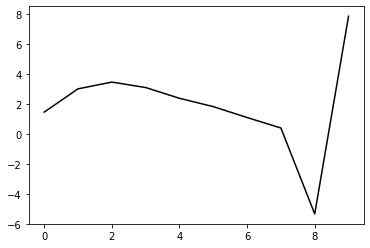

284900 17.49167771480491
0.42677032584367625 -0.377628677851345 -0.175825738553053 -0.09905157993911691
[ 1.36595732  3.10302647  3.55185482  3.18438486  2.46257082  1.90173676
  1.17046511  0.46491465 -5.28121331  7.9181665 ]


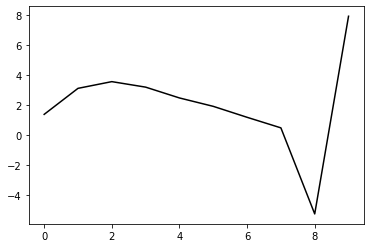

286000 18.591560566124524
0.4245279444007745 -0.381220401136432 -0.17870313353504852 -0.09556880589284619
[ 1.4055581   2.94091371  3.38655979  3.02108341  2.30423397  1.74961619
  1.02628214  0.32755013 -5.41225044  7.85232648]


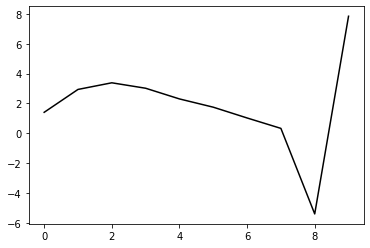

287100 20.02730497662696
0.42632923509881027 -0.3775391456251052 -0.17695082750475177 -0.09745917548637574
[ 1.38863787  3.04055427  3.49295958  3.13201406  2.41781344  1.8641014
  1.14125585  0.44010453 -5.30378417  7.92472018]


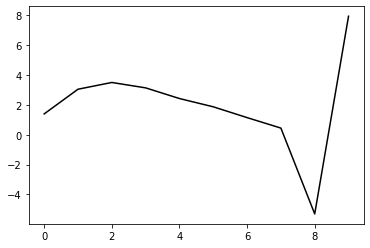

288200 22.273253379339746
0.42653095079216774 -0.3733904871874968 -0.1747158997559842 -0.0965934468726788
[ 1.37633704  3.03690807  3.48400482  3.11798931  2.39881344  1.83973433
  1.11239782  0.40494926 -5.34678879  7.87061288]


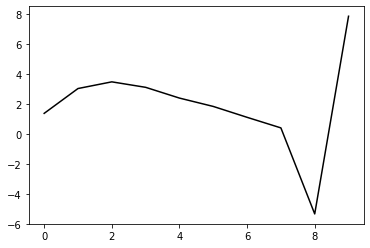

289300 24.982225866978435
0.4155750040994782 -0.3761077421561129 -0.17430202881813806 -0.100455690019969
[ 1.42970803  2.91722287  3.36471     3.00163116  2.28639732  1.73195193
  1.01142266  0.31142032 -5.42986833  7.87788302]


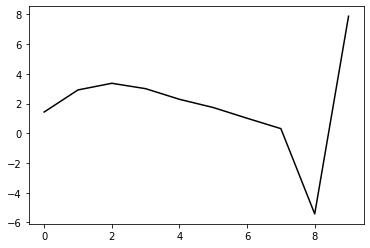

290400 18.89094715908278
0.41400419403568733 -0.3818093453356409 -0.1791338923118876 -0.0978726425010207
[ 1.41271189  2.90103477  3.34411329  2.97924501  2.26308484  1.70798088
  0.98812541  0.28851226 -5.45099665  7.84831554]


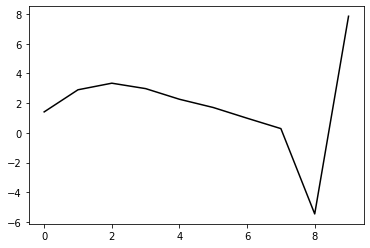

291500 22.091970541335197
0.4226319718030994 -0.37650422370383374 -0.17746019122432247 -0.09934264013907311
[ 1.38771949  3.05224196  3.48681428  3.11206501  2.38554459  1.82000923
  1.09100609  0.38204825 -5.36531854  7.89210097]


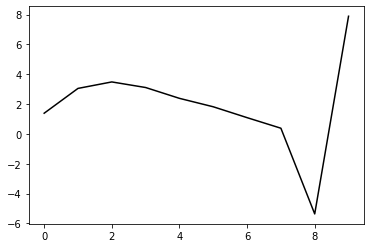

292600 25.40882919683059
0.42120260097842216 -0.37809718722509644 -0.17902452292246326 -0.09837784142542434
[ 1.39288749  3.03109734  3.46517732  3.09069606  2.36465485  1.79945255
  1.0716313   0.36296794 -5.38373351  7.87041411]


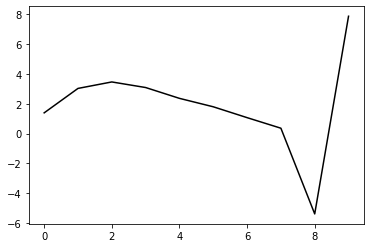

293700 13.334406278797736
0.4241744790678835 -0.37231102224582613 -0.17574743100490584 -0.10118929610577913
[ 1.43350646  3.06513815  3.50865228  3.1421938   2.4230066   1.86327821
  1.14064087  0.43455459 -5.3116991   7.92161334]


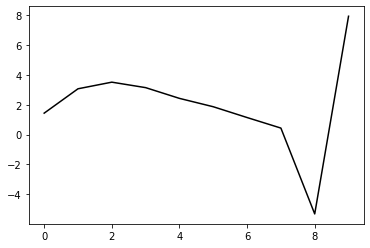

294800 26.115649493493375
0.41961060298233294 -0.3708378232303454 -0.17416032903180254 -0.10386486207288823
[ 1.44266105  3.06786209  3.51282696  3.14884742  2.43241332  1.87518577
  1.15588367  0.45215225 -5.2910229   7.87236853]


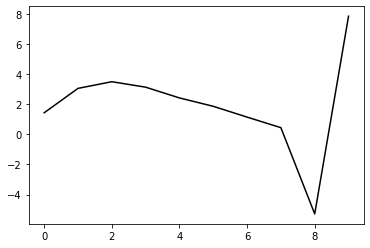

295900 17.25887771897184
0.4240712374166087 -0.37269343999898763 -0.1771101600656529 -0.10151028424731688
[ 1.35574181  3.10882112  3.54447603  3.17267372  2.4496815   1.88647578
  1.16268601  0.45351784 -5.29510967  7.90637965]


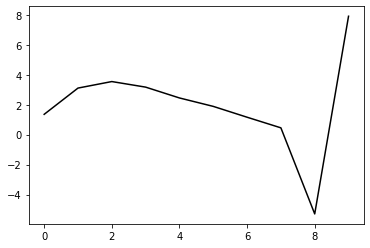

297000 18.23656954826369
0.4264157822271426 -0.371234303328665 -0.17724814892015917 -0.1004105061689624
[ 1.34806121  3.13761143  3.58070129  3.21441937  2.49531467  1.9341529
  1.2119572   0.50096147 -5.2526847   7.88861432]


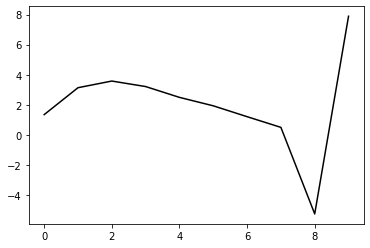

298100 20.60817065442613
0.42538526521971026 -0.3690858450592578 -0.17616819021296243 -0.09925265609474826
[ 1.38833313  3.03912906  3.48027904  3.1138918   2.39595179  1.83629583
  1.11679646  0.40663768 -5.34675679  7.89996008]


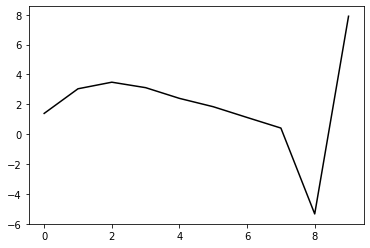

299200 26.16536513164346
0.4147808366684779 -0.37080577739174103 -0.17519678370437586 -0.10205562275650737
[ 1.44999157  2.91132907  3.34389579  2.97252293  2.2523018   1.69245734
  0.97592575  0.26990781 -5.47653842  7.8575472 ]


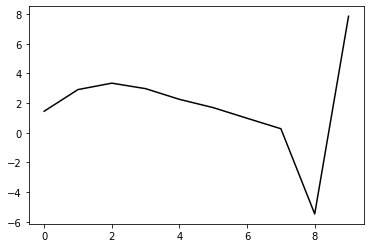

300300 24.94604907738074
0.4117669293593376 -0.37169994339820434 -0.17586469551167364 -0.10218995813696084
[ 1.41321932  2.89600983  3.32017609  2.94173216  2.21514266  1.64942024
  0.92879386  0.21888715 -5.5298938   7.87643278]


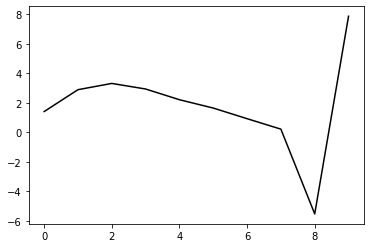

301400 14.907882719821583
0.4178290668460544 -0.37010810824308654 -0.17669685768834806 -0.1013722890133218
[ 1.39513994  3.0148318   3.44011057  3.06060292  2.33109247  1.76102275
  1.03623431  0.32105938 -5.43133142  7.85931828]


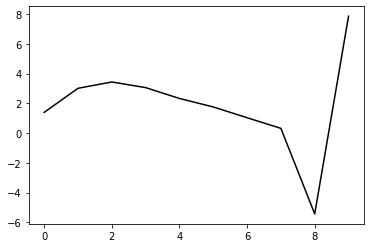

302500 22.484540202572067
0.4197423017388415 -0.36918645641909226 -0.17661583381129983 -0.10373911292636631
[ 1.41193453  3.07273941  3.51269452  3.14473489  2.42399785  1.86045702
  1.14164578  0.43044596 -5.31885431  7.89313193]


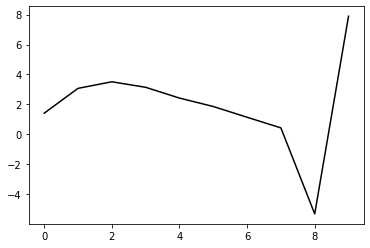

303600 25.2139741860312
0.42008602311647775 -0.37222883563665704 -0.17969318556893538 -0.100604812661333
[ 1.38100921  3.02475388  3.45815835  3.08807528  2.3672999   1.80416524
  1.08690655  0.37598153 -5.37293919  7.86989554]


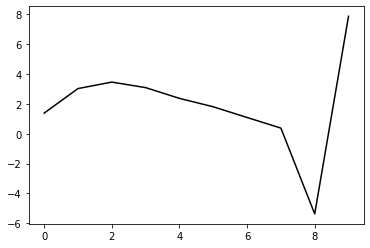

304700 15.103727181482315
0.413721195286749 -0.37215690451551525 -0.17878996761853974 -0.102892835880787
[ 1.45205685  2.91681606  3.34649197  2.97616005  2.25611225  1.69374152
  0.97828563  0.26870752 -5.47795244  7.87985268]


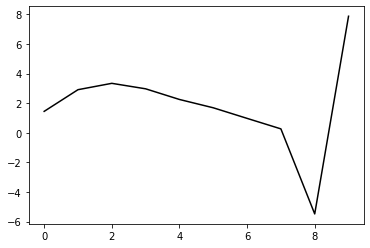

305800 28.542643086316755
0.41861623967721323 -0.36747370728648265 -0.17637606615773263 -0.10693122593250225
[ 1.44613327  3.06600884  3.50780994  3.14535528  2.429971    1.86995411
  1.1562797   0.44663574 -5.30130593  7.86660562]


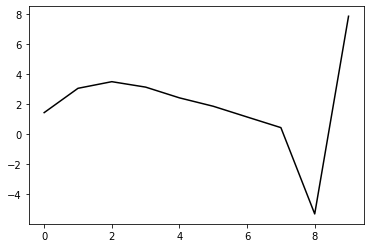

306900 13.991765211655553
0.4209141110016517 -0.3673773597688105 -0.17778045359073655 -0.1042909496953431
[ 1.37399412  3.10179875  3.52358656  3.145319    2.41799277  1.84836758
  1.12738512  0.40989683 -5.34524111  7.88892546]


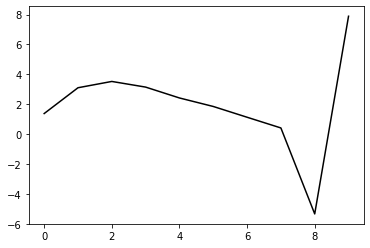

308000 18.402061683111558
0.42369802754344216 -0.37146688185952614 -0.18224281773879325 -0.09940039001691484
[ 1.36096851  3.02507906  3.44469131  3.06693947  2.3421049   1.7757004
  1.05921365  0.34504374 -5.40690348  7.85817087]


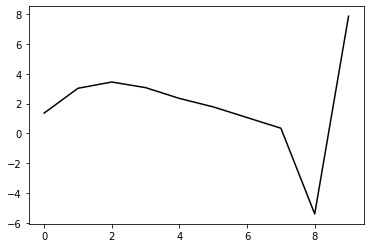

309100 22.484571113432498
0.41951812041498643 -0.3670995110846802 -0.17877262682710912 -0.10323035991215324
[ 1.43513124  2.97691738  3.40207652  3.03141596  2.31400566  1.75432129
  1.04441663  0.33438297 -5.41474349  7.91900031]


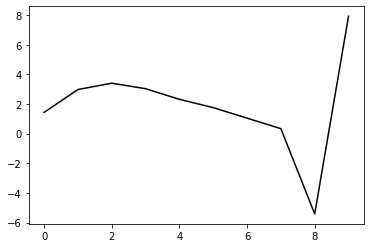

310200 24.006256166303118
0.42048362144409807 -0.36232840150250634 -0.17606999861209285 -0.10348974084396129
[ 1.41746658  3.02354645  3.44362287  3.06684805  2.34352781  1.77792406
  1.06306332  0.34638077 -5.4109603   7.85335752]


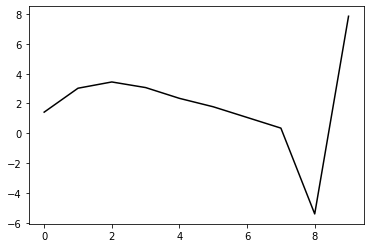

311300 23.547410408125117
0.4198966479708223 -0.36140120061835396 -0.1757223988493084 -0.10264799660340655
[ 1.40097153  3.04290425  3.46417747  3.08769547  2.36418902  1.79765821
  1.08233075  0.36341712 -5.39678141  7.87748439]


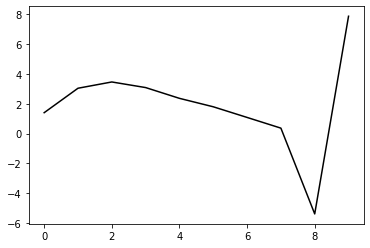

312400 13.813485333203372
0.42187172069115936 -0.3601994269945857 -0.17555185493040107 -0.10306218577270194
[ 1.39771108  3.07483985  3.50412484  3.1345039   2.41698019  1.85544506
  1.14549561  0.43026732 -5.32668192  7.88798244]


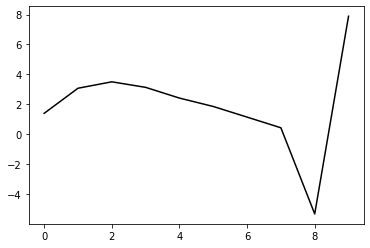

313500 22.255701234025427
0.4157322583937235 -0.36732977399701194 -0.17918332702748793 -0.10411761872804828
[ 1.40271725  3.01291864  3.44271781  3.07367115  2.35680008  1.7961416
  1.0889328   0.37712794 -5.37312581  7.8476598 ]


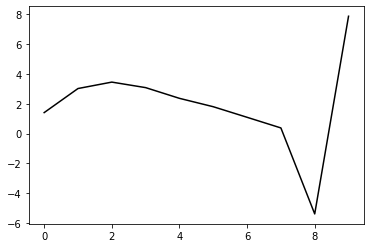

314600 24.800893969886538
0.42087117891615766 -0.3628457972373212 -0.17781802742622965 -0.10236809956711228
[ 1.35385998  3.09293109  3.51683035  3.14140993  2.41824711  1.85093371
  1.1376404   0.41757621 -5.34303105  7.87302234]


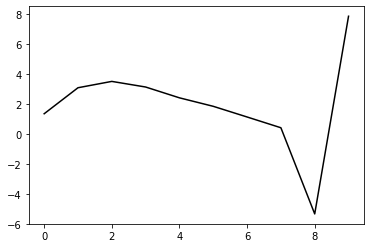

315700 14.921329784859699
0.417389263181623 -0.3624915018166133 -0.17697730963286762 -0.103653041342981
[ 1.43774377  2.99682265  3.42776744  3.05935131  2.34315524  1.78256386
  1.07727554  0.36422109 -5.38890018  7.89805715]


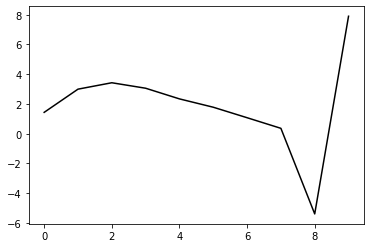

316800 22.520742318049226
0.41896261105699806 -0.3614693058596248 -0.177054549532385 -0.10466704009726707
[ 1.38395856  3.0826951   3.52082197  3.15624133  2.44126048  1.87956312
  1.17283585  0.45545737 -5.30380689  7.86551305]


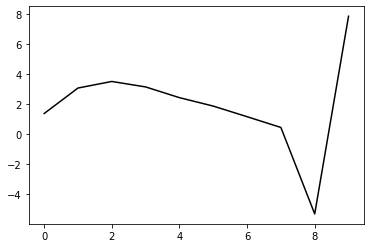

317900 14.527335173635132
0.41942414127201066 -0.36124830957929355 -0.1775318110477908 -0.10302021694884562
[ 1.36956253  3.1089823   3.54504011  3.17731407  2.45859347  1.89243067
  1.18225217  0.45965048 -5.30524304  7.89927054]


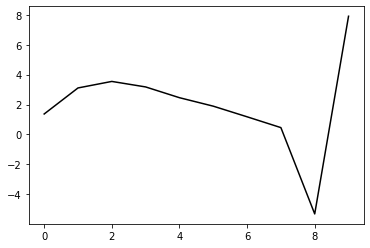

319000 23.58102935239398
0.4190210775806248 -0.3686158581051742 -0.18391918428212214 -0.09718871818760125
[ 1.35095659  3.00737007  3.43672302  3.06472072  2.34391314  1.77702167
  1.06820135  0.34631373 -5.41742527  7.82955595]


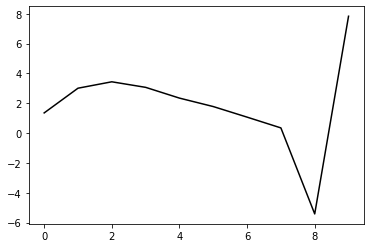

320100 22.2980239605794
0.4145665660435363 -0.3648685131578313 -0.18051503396462107 -0.10096600620900312
[ 1.40961465  2.97002546  3.38357224  2.99778183  2.26495897  1.68768701
  0.97124821  0.24312897 -5.52420008  7.88447139]


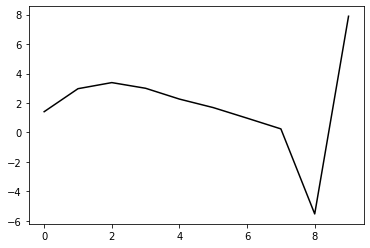

321200 22.483463597897543
0.4195293515507785 -0.36021129450090017 -0.17910669374528465 -0.10168293079542369
[ 1.37378803  3.07480253  3.49312585  3.11030009  2.37914535  1.80216733
  1.08560047  0.35489481 -5.41702673  7.83422787]


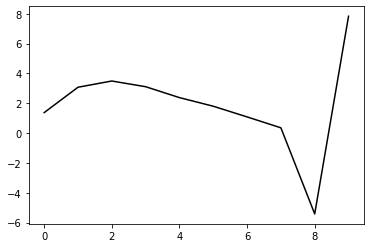

322300 21.59252660393384
0.4191887823564742 -0.35897421778590144 -0.1786723728357822 -0.10148839856949646
[ 1.38703752  3.06085831  3.48279767  3.10215564  2.37252678  1.79638743
  1.08128055  0.35058736 -5.42216106  7.88098939]


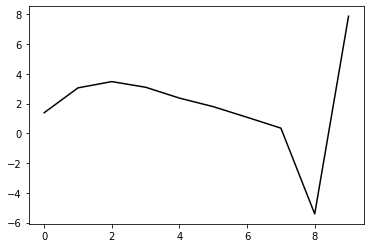

323400 19.83045193967305
0.4089465886220313 -0.3669629865237963 -0.18243192674750244 -0.1016214801695731
[ 1.38650716  2.96002181  3.3658908   2.97047944  2.22802878  1.641382
  0.919849    0.18566683 -5.58609913  7.83324129]


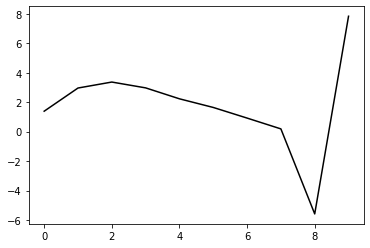

324500 22.115958643218693
0.41596357010298124 -0.3620936634446501 -0.18046304535024552 -0.10691546058647364
[ 1.39554725  3.13313161  3.55618835  3.17163919  2.43534008  1.85149755
  1.13146269  0.39680028 -5.37632003  7.89099924]


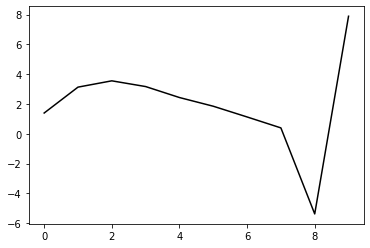

325600 24.65757950163383
0.4174222198177985 -0.3616699852805071 -0.1812571572750186 -0.10446868092510106
[ 1.37523952  3.11178142  3.52500797  3.13342569  2.39264874  1.80559683
  1.08396127  0.34665642 -5.42915186  7.86475801]


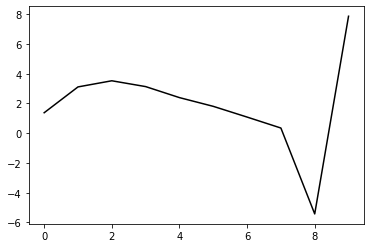

326700 14.789551130868663
0.4186075943942755 -0.35673253079885503 -0.1783554348861244 -0.10595236250833864
[ 1.42719268  3.10750114  3.52625925  3.13806508  2.39997613  1.81480371
  1.09540865  0.35818943 -5.41902851  7.90719855]


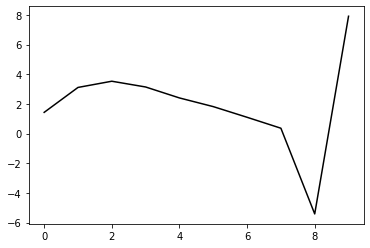

327800 23.366018146045153
0.41803212405225565 -0.35711216445658533 -0.17905548245004413 -0.1052495643722611
[ 1.36472086  3.13807158  3.55867175  3.16972926  2.4295943   1.84117093
  1.11888856  0.37689649 -5.40585757  7.85310082]


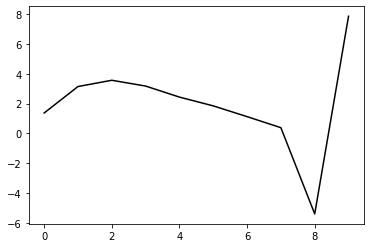

328900 29.37393909931753
0.4178993215237407 -0.36000345579605747 -0.18190648357456737 -0.10262678300458085
[ 1.31713855  3.10760961  3.5295339   3.1426628   2.40540188  1.81977161
  1.10105935  0.36016777 -5.42354622  7.90066806]


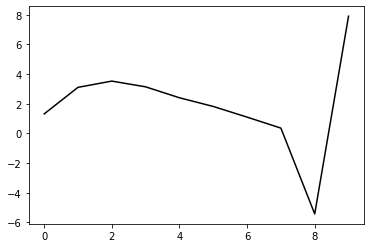

330000 18.20700739428236
0.41980032056836875 -0.35591622148784774 -0.18010755371608905 -0.10315681681228693
[ 1.33547849  3.17151165  3.60065225  3.22012863  2.48812738  1.90616435
  1.19039111  0.4489557  -5.33880261  7.86431104]


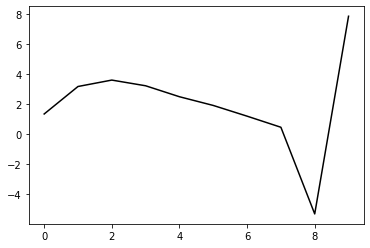

331100 21.426663721018883
0.41827427847769877 -0.35380102461000196 -0.17888468644110764 -0.10238660117986244
[ 1.39037512  3.06485594  3.49444592  3.11526376  2.3854257   1.80579152
  1.09337555  0.3537096  -5.43236764  7.89514573]


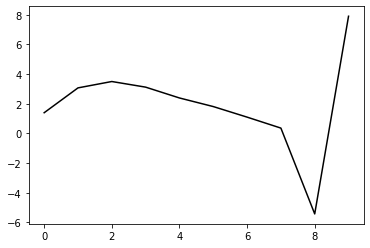

332200 23.94182210949865
0.4143437720729236 -0.3592866924669034 -0.18221363385088685 -0.10130602423393183
[ 1.36668857  3.07239154  3.50659812  3.13091116  2.40372996  1.82602329
  1.11629742  0.37803988 -5.40673769  7.84303691]


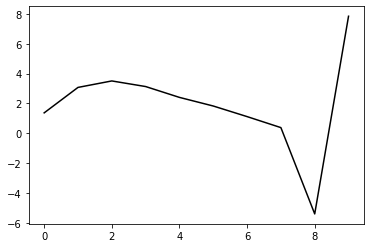

333300 21.09886181122999
0.4146448728147359 -0.3560183741144813 -0.18093957420035223 -0.10088534919062728
[ 1.39147118  3.03094756  3.47255967  3.10492496  2.38599808  1.81584931
  1.11386755  0.37990167 -5.40401353  7.88785196]


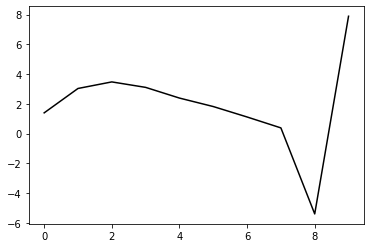

334400 15.257100991839573
0.4120047251741909 -0.35443298038042087 -0.17934118797453658 -0.10302141633916655
[ 1.43063465  3.04673896  3.48471665  3.11134732  2.38599275  1.8099347
  1.10484483  0.36850802 -5.41459847  7.89742794]


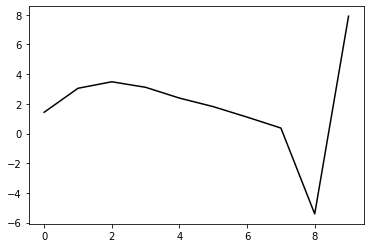

335500 22.04644950078001
0.4113397306165084 -0.3589900791080104 -0.18337235189617077 -0.10069646413311921
[ 1.37453831  3.01416521  3.44103213  3.06131874  2.33249511  1.7541706
  1.04842478  0.31064517 -5.47353397  7.88204507]


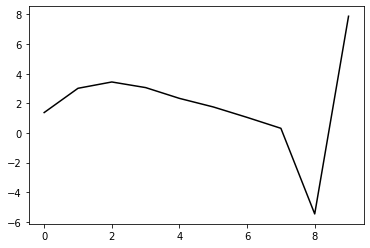

336600 24.733087453065124
0.41489505974898316 -0.3533614461895739 -0.18110592387103117 -0.10217208162908975
[ 1.37220041  3.11092752  3.54282222  3.16529129  2.43700498  1.85770439
  1.15048112  0.4084382  -5.38244113  7.86740107]


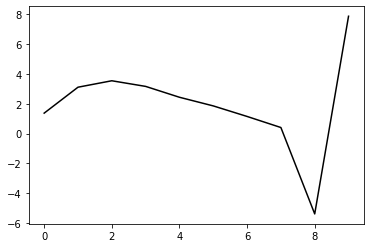

337700 12.96458043797781
0.4109067750067322 -0.35378649840282034 -0.18108508657209835 -0.10271982332756992
[ 1.42719656  3.04295811  3.47574045  3.09958761  2.37327648  1.79641643
  1.09310832  0.35462332 -5.43162315  7.87472138]


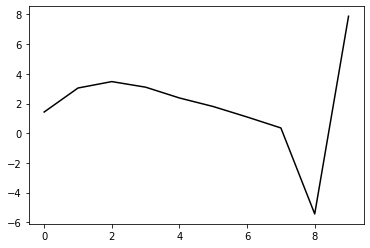

338800 21.73153284529134
0.41359355895537675 -0.34955830871075705 -0.1789315309021803 -0.10529133076005866
[ 1.39959341  3.14209343  3.57429832  3.19609202  2.46697863  1.88677442
  1.18086583  0.43883719 -5.35090517  7.87111826]


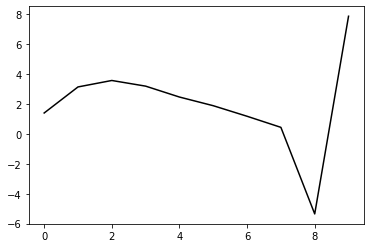

339900 16.434391340527398
0.41557751781212254 -0.3508286242164412 -0.18091993662680642 -0.10253503379391085
[ 1.35632082  3.13447564  3.56018804  3.17484091  2.43883875  1.85191047
  1.14091013  0.39312387 -5.40188791  7.8860806 ]


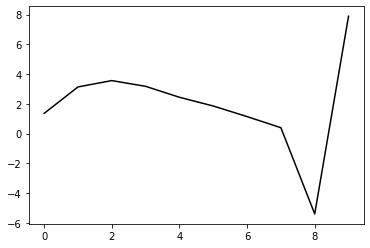

341000 16.862846706620232
0.41658840192361807 -0.3518366079435679 -0.18257524727589652 -0.1016879925420705
[ 1.36667462  3.16447904  3.60553445  3.23394833  2.50931297  1.93066198
  1.22611282  0.47984539 -5.31839856  7.86952289]


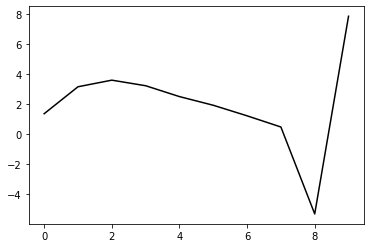

342100 20.411891353928773
0.4094978106730937 -0.35330910267944354 -0.18294434244079832 -0.0998527814697209
[ 1.39710309  2.99369379  3.43248357  3.06238428  2.34196708  1.76892042
  1.07171536  0.33125495 -5.46258802  7.86252587]


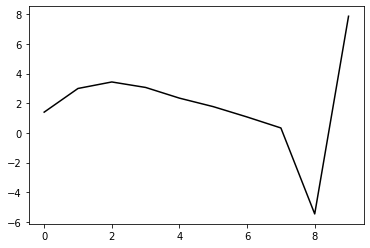

343200 22.332511689089475
0.4140466719345849 -0.3485519155255727 -0.18134307900764232 -0.09988465946196043
[ 1.38223136  3.04356248  3.48330397  3.1131724   2.39220985  1.81793367
  1.11971833  0.37610967 -5.42221251  7.85994905]


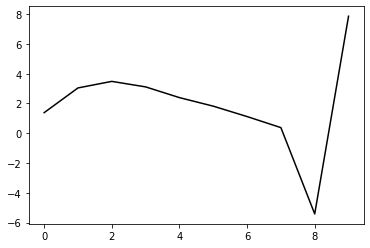

344300 24.238937792356314
0.4107302319878237 -0.34614252005031015 -0.17918699297755059 -0.10314432914569241
[ 1.4316908   3.05713705  3.51083456  3.15350945  2.4437905   1.8791018
  1.19012317  0.45300231 -5.34064363  7.87944399]


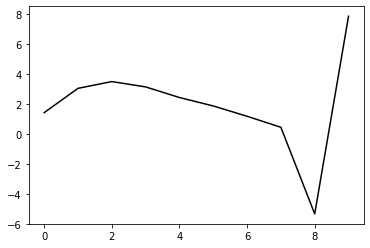

345400 14.384412452356436
0.409766932009826 -0.350202586504549 -0.18231472100375407 -0.10277434246484483
[ 1.44115066  3.04382607  3.51728757  3.17992388  2.48896601  1.94119104
  1.26836995  0.54402598 -5.23934585  7.88557897]


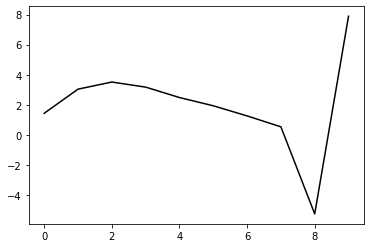

346500 21.83447835538765
0.4080235550330624 -0.34971797226287243 -0.1822763136939154 -0.10167657729356337
[ 1.40592058  3.01609995  3.47738345  3.13089562  2.43302737  1.87963761
  1.20326889  0.4744769  -5.31310319  7.88934766]


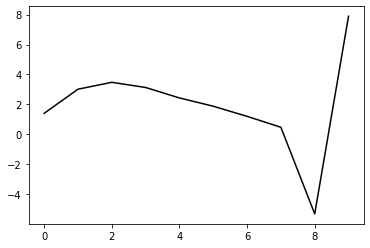

347600 24.914077427281494
0.4095513445086343 -0.349196822094461 -0.18304913752686633 -0.09955985379569551
[ 1.40423953  3.00292101  3.45796906  3.10575975  2.40263606  1.8442193
  1.16441604  0.43105653 -5.36164995  7.82716412]


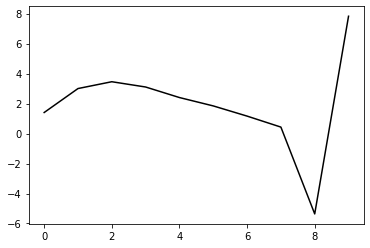

348700 15.757757044978423
0.40477734994704206 -0.34521089163779894 -0.17961843098566208 -0.10208999550330425
[ 1.46000272  2.97356179  3.43204749  3.08344216  2.38340118  1.82715534
  1.14961503  0.41620205 -5.3779063   7.86877501]


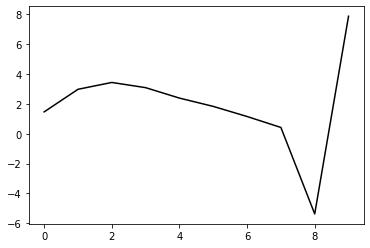

349800 21.915557886646653
0.40839079247302545 -0.34418295674563226 -0.18030312010987234 -0.1024367702770286
[ 1.41728277  3.04680266  3.51448015  3.17410593  2.48083564  1.92966929
  1.25668852  0.5248003  -5.2701919   7.8995079 ]


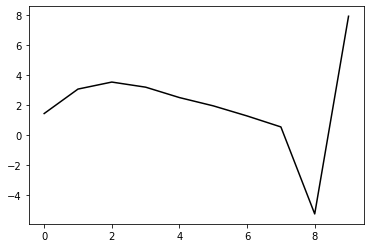

350900 13.451723093096316
0.4097853181933289 -0.34408562178051355 -0.18138474399521085 -0.10024622967981371
[ 1.40905092  3.05251192  3.52688377  3.19250276  2.50414607  1.95648069
  1.28684315  0.55535364 -5.24126216  7.87468545]


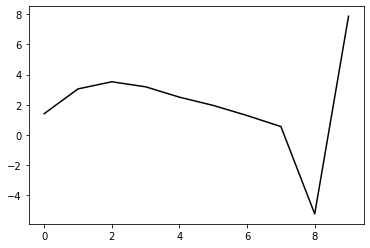

352000 17.939657263930982
0.41036439441304345 -0.34408392209086847 -0.18224584559555349 -0.09884823355664872
[ 1.36282774  3.07149554  3.54309341  3.20667847  2.51638064  1.9665132
  1.29550642  0.56086376 -5.23998891  7.8692563 ]


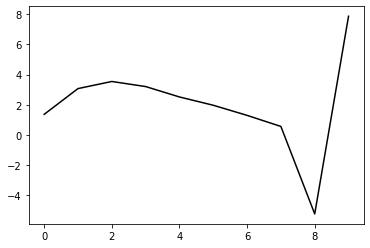

353100 20.789458051718647
0.404737718419141 -0.34909611686308994 -0.18485475670507015 -0.09755263710029054
[ 1.39132925  2.99916135  3.47300034  3.13921109  2.45107241  1.90288405
  1.23456653  0.50187791 -5.29551761  7.9000077 ]


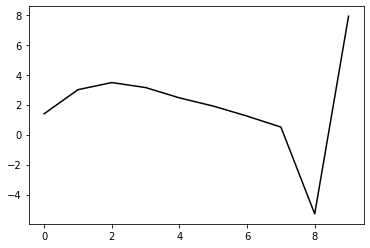

354200 23.089786424556284
0.4066320591884948 -0.34269074605395505 -0.18163748573598298 -0.0988307590655212
[ 1.42259627  2.99978346  3.46657438  3.12677048  2.4333566   1.88051344
  1.2091412   0.47278677 -5.3279259   7.88741393]


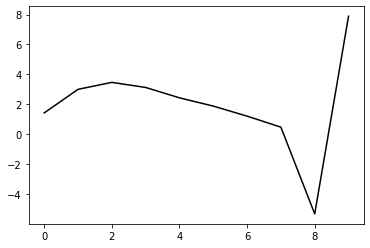

355300 22.13016159192715
0.40795976675526324 -0.3409628451717489 -0.18124198568086874 -0.09727049390628728
[ 1.36739631  3.03045764  3.49079601  3.1446394   2.44481504  1.88547502
  1.20886334  0.46672216 -5.3395656   7.90758841]


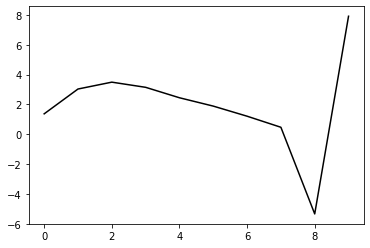

356400 26.349024025751852
0.39682430774471716 -0.35326412865608653 -0.18791991042701292 -0.09484766478679975
[ 1.40306073  2.84147688  3.28441718  2.92665063  2.21978032  1.65729059
  0.98202221  0.24377406 -5.55652582  7.83876956]


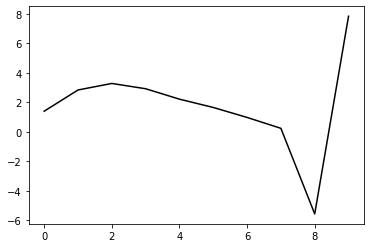

357500 21.637756662571537
0.40586336906717124 -0.33938237338489874 -0.1801889855399069 -0.09914686284642496
[ 1.39908061  3.00059814  3.43246408  3.06340194  2.34562176  1.77276247
  1.08847933  0.34082003 -5.46859105  7.84629906]


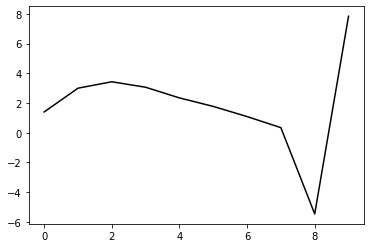

358600 26.592108392109612
0.40200341861984074 -0.34930159274193606 -0.18674254145061556 -0.09848200816820725
[ 1.39729403  2.98979844  3.42924462  3.06583411  2.35160007  1.78096962
  1.09945572  0.35440214 -5.45046169  7.8473363 ]


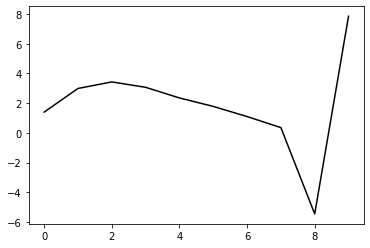

359700 13.550455850266816
0.40074262323420606 -0.34511748515179136 -0.18379457249238385 -0.10251355801934402
[ 1.44618131  2.9779084   3.41177126  3.04299081  2.32342721  1.7476656
  1.06241071  0.31396587 -5.49207721  7.87857711]


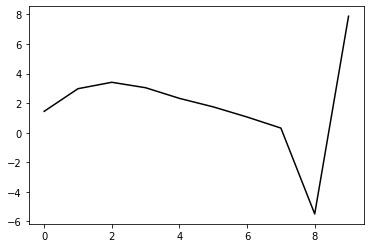

360800 31.239760546734413
0.4063103859962304 -0.33737945043909695 -0.17955907328702939 -0.10624691846567969
[ 1.44476256  3.11039234  3.54829186  3.18176245  2.46340802  1.88797164
  1.20315735  0.45371038 -5.35486487  7.85754891]


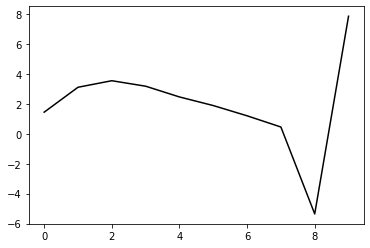

361900 14.819526278718731
0.40903223139636774 -0.3392950814719461 -0.18221086853089097 -0.10394082002969193
[ 1.37106129  3.16175903  3.59362919  3.2210484   2.49717719  1.91644642
  1.22744844  0.47281618 -5.34110416  7.8920447 ]


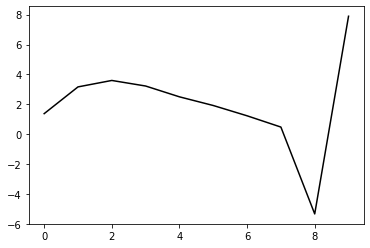

363000 17.80811972905605
0.40905777152916545 -0.3416149625902073 -0.184774047865384 -0.1009026501088974
[ 1.36329863  3.14432022  3.57423383  3.20001204  2.47494562  1.89295448
  1.20334992  0.4465454  -5.37014807  7.86162015]


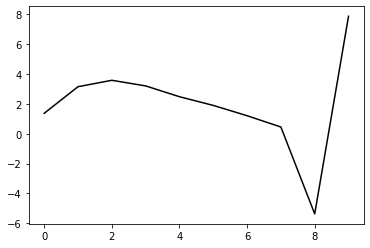

364100 21.333338507344074
0.4040999012869467 -0.3413922306664187 -0.1837249552438284 -0.10200279907390358
[ 1.39628955  3.05837938  3.48632348  3.11057924  2.38464383  1.80235509
  1.11431131  0.3590674  -5.45470122  7.88571856]


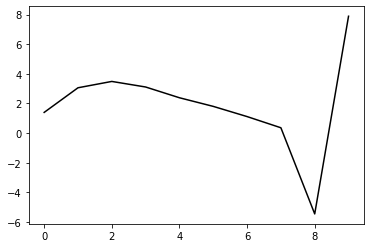

365200 22.86078929635525
0.40531640056189433 -0.3395644888045465 -0.18315396360265962 -0.10243710280704262
[ 1.43596567  3.04161916  3.47950289  3.11271644  2.39505365  1.82002287
  1.13925922  0.38855467 -5.42310473  7.83891228]


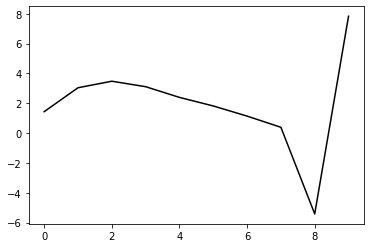

366300 22.0554097101625
0.408028903274878 -0.3372712507936572 -0.18300763394394948 -0.09985947041832888
[ 1.35540196  3.1200517   3.55219709  3.17788863  2.45148382  1.8662416
  1.17524603  0.41188716 -5.41382249  7.89875113]


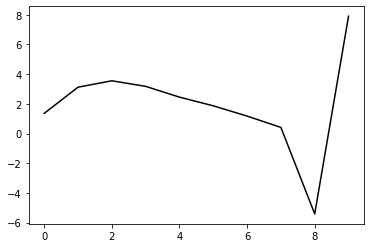

367400 15.712788779323926
0.3998997174416229 -0.340105910997154 -0.18369502859871123 -0.10138154028830507
[ 1.39715143  3.02613511  3.46010208  3.08988394  2.36931167  1.7910402
  1.10881298  0.35372805 -5.46310491  7.8611122 ]


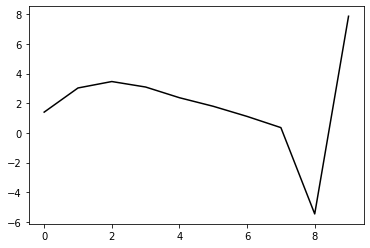

368500 21.505725610742573
0.40004342849368824 -0.34183955089373524 -0.18568048571433093 -0.10031366862249425
[ 1.38700519  3.00576939  3.44097034  3.07333637  2.35545105  1.77937039
  1.09969578  0.34584625 -5.46955512  7.88096954]


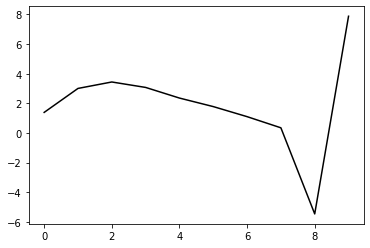

369600 25.414087339877252
0.399296497195684 -0.3427841774521863 -0.1868694058299745 -0.10059912783969306
[ 1.39946884  3.01507952  3.4521921   3.0867581   2.37051585  1.79532722
  1.11684066  0.36304188 -5.45170344  7.85250687]


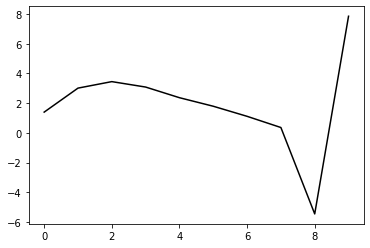

370700 13.356045974937459
0.4012489984065088 -0.33725606712350686 -0.1838624088788883 -0.1032859620358089
[ 1.42336582  3.05351818  3.49725133  3.13693379  2.42436303  1.85158061
  1.17535573  0.4222607  -5.39212597  7.88299425]


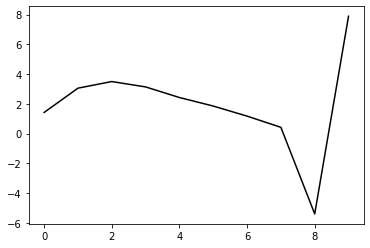

371800 24.594811682461152
0.39821836003678446 -0.3351813027544009 -0.18208997536204674 -0.10563480221901689
[ 1.4390176   3.06727497  3.50611078  3.1420717   2.42665593  1.85153336
  1.17422352  0.4197271  -5.39493786  7.86352001]


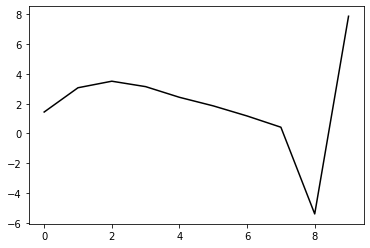

372900 13.50654070437959
0.4040316396710653 -0.334156278430116 -0.1831871381729306 -0.10379505873216559
[ 1.39424788  3.14280861  3.57755636  3.20921822  2.48981448  1.91074599
  1.23035883  0.47176252 -5.34782867  7.88859087]


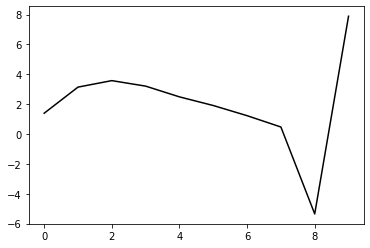

374000 17.995735631886422
0.40646719516317587 -0.3347239720424446 -0.18479826123571086 -0.1013682631355558
[ 1.35376596  3.16550488  3.59767052  3.22549765  2.50167778  1.91740479
  1.23227036  0.46677755 -5.36151644  7.87826206]


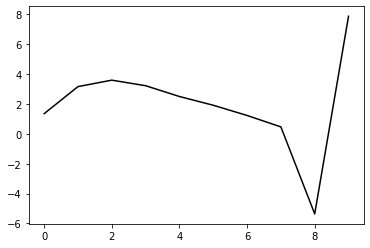

375100 21.205602374276705
0.3967466545353317 -0.3343925498219382 -0.18239762156993258 -0.1042587043350052
[ 1.41486829  3.03634702  3.46075537  3.08455349  2.35979382  1.77674153
  1.09556724  0.33428483 -5.48781848  7.84841578]


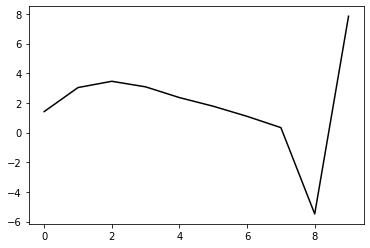

376200 27.021345058476147
0.3969939592677177 -0.33125771798048387 -0.1806367956467215 -0.10518893459356658
[ 1.42891431  2.98082306  3.39964395  3.01971235  2.29321446  1.70979132
  1.03018871  0.26997508 -5.55128145  7.83367957]


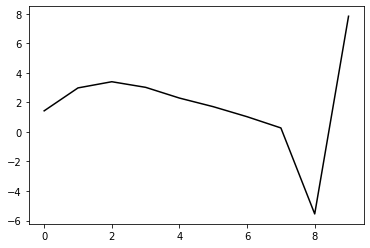

377300 21.34666712593961
0.4028329433442172 -0.33355782136307677 -0.18456461282950323 -0.10128813686878933
[ 1.37513167  3.0876553   3.51044967  3.13193788  2.40504125  1.81971691
  1.1380308   0.37388909 -5.45155777  7.88407379]


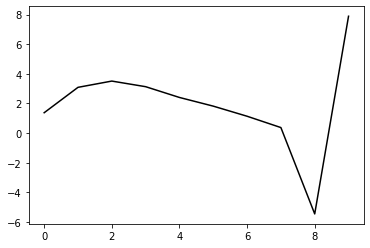

378400 14.217919449353252
0.3999746075287619 -0.3355231412038923 -0.18552730182818408 -0.10403085232849571
[ 1.42825106  3.07679155  3.53888684  3.19607964  2.49964627  1.93946537
  1.27920518  0.53130438 -5.28237148  7.87280134]


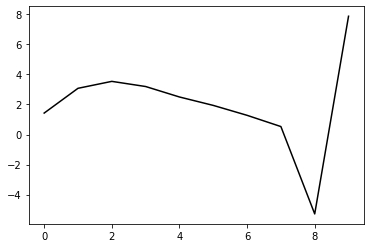

379500 21.915047981540706
0.3954657471229625 -0.33527032005534063 -0.18490438322226527 -0.10283612200435664
[ 1.40532522  2.98520103  3.43263617  3.07897154  2.37436751  1.80780509
  1.14351035  0.39170186 -5.42486762  7.87713268]


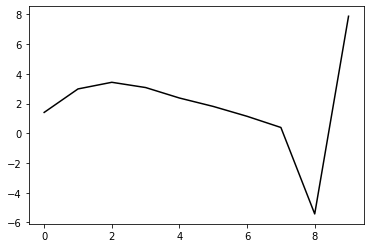

380600 24.685749166495174
0.3993604531285348 -0.33380502489100644 -0.18534478097094306 -0.10152953846676124
[ 1.3900205   3.02417646  3.46984408  3.11489947  2.40913218  1.84112752
  1.17601282  0.42176832 -5.39813851  7.86138599]


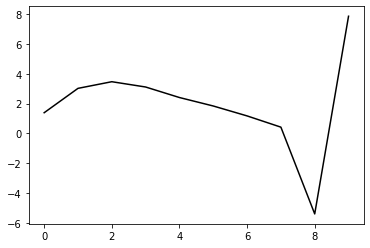

381700 17.344119162709607
0.3968516047816138 -0.33181811450914916 -0.18363195316677242 -0.10457869359652765
[ 1.47390592  2.96823871  3.43335744  3.09674196  2.40723579  1.85323118
  1.20118983  0.45669065 -5.35591522  7.89502191]


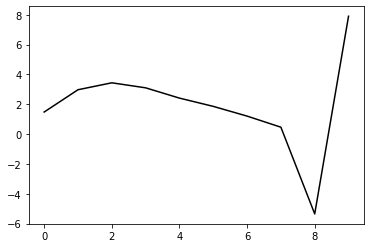

382800 22.71092351167544
0.3956382290512615 -0.3309699307219921 -0.18305007723416403 -0.10532231760467584
[ 1.42654702  3.05600596  3.51154083  3.16310307  2.45972582  1.89082217
  1.22560536  0.46775841 -5.35693974  7.86762761]


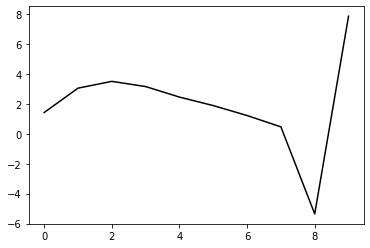

383900 15.078814990074184
0.40062872654583126 -0.3296761307877 -0.1841881846280511 -0.10192916440309188
[ 1.37523025  3.10173206  3.55567788  3.20408547  2.49657552  1.92229766
  1.25168436  0.48507302 -5.35165258  7.90148291]


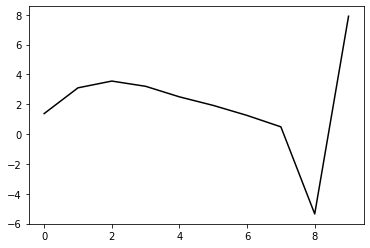

385000 27.028945901390728
0.40139442711938705 -0.3364974040195438 -0.19026143670891837 -0.09597901456143032
[ 1.35746443  2.98829106  3.43964371  3.08980261  2.38734288  1.81992139
  1.15815181  0.39885948 -5.43183643  7.83452025]


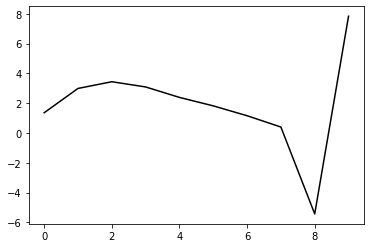

386100 21.436851237765563
0.3983945596271553 -0.33177545005955295 -0.18672887601862664 -0.10076854452636325
[ 1.41723996  3.00169631  3.46122691  3.11957753  2.42444794  1.86319523
  1.20735497  0.4516026  -5.37696481  7.90816414]


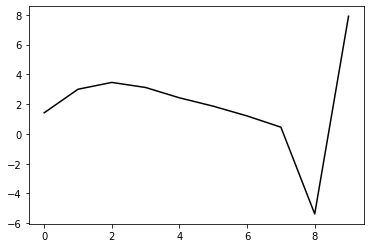

387200 28.001355875981087
0.39131643359813867 -0.3268734027771732 -0.18187120272189708 -0.10467179241545276
[ 1.44349283  2.92122783  3.36225902  3.00721116  2.30299329  1.73581792
  1.077442    0.31956906 -5.51087767  7.83758341]


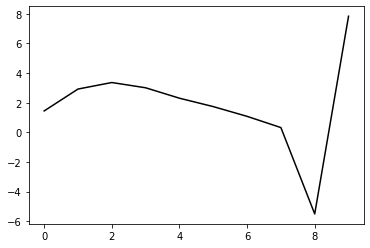

388300 24.519681216606784
0.38901359921268064 -0.33052571004178 -0.18471596209169974 -0.1028839174482116
[ 1.41373434  2.87995826  3.31125446  2.94899079  2.23875515  1.66642054
  1.00469278  0.24405396 -5.58756671  7.87166091]


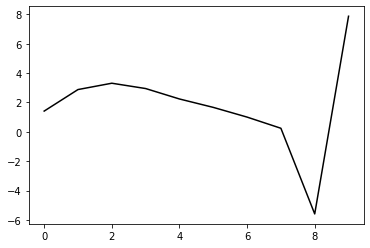

389400 15.104251868514755
0.3964752106484379 -0.33192484196712935 -0.18773644871224152 -0.10194732904439434
[ 1.4156891   3.04095505  3.47856549  3.11865097  2.40802249  1.83377204
  1.17036356  0.4076275  -5.42358261  7.8629984 ]


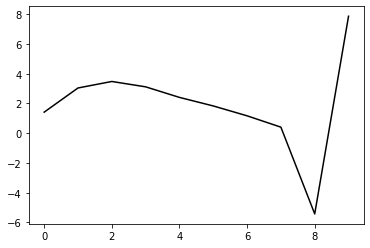

390500 21.054442515160105
0.39428987757229145 -0.33357865030713674 -0.18903622038596707 -0.10068238038893379
[ 1.39153851  2.98607547  3.41170454  3.04366899  2.32744922  1.74903837
  1.08320203  0.31790742 -5.51526824  7.86284167]


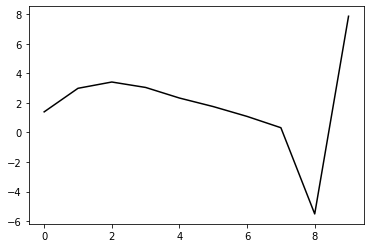

391600 25.358435291109696
0.3976669845825666 -0.330497444959823 -0.18814704025401374 -0.10061967459854476
[ 1.38668551  3.05407645  3.47523112  3.10265732  2.38219116  1.79959498
  1.13030424  0.36070588 -5.47645624  7.84976979]


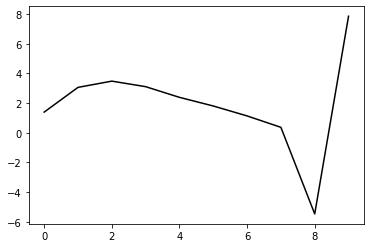

392700 13.716205607626838
0.3987679665043277 -0.3255162891427421 -0.18482037551215855 -0.1044681078810747
[ 1.43290355  3.0990585   3.52948308  3.16381455  2.44861712  1.86999891
  1.20457239  0.43742061 -5.39759203  7.88145958]


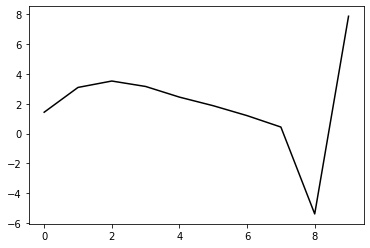

393800 23.087235314170893
0.3970570721890314 -0.3264500377592931 -0.18559347650928912 -0.10471642571193836
[ 1.40528604  3.08772182  3.51839129  3.15227613  2.43678595  1.85782186
  1.19298594  0.42527432 -5.41076321  7.86439375]


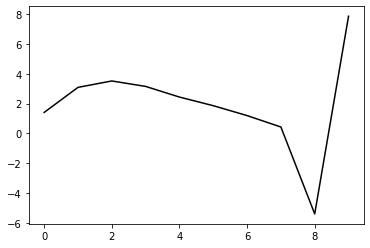

394900 27.6944766737307
0.400565811107295 -0.3269491957290202 -0.18740504046838977 -0.10110480537229533
[ 1.33401008  3.08900003  3.50525021  3.1284961   2.40599145  1.82215859
  1.15474798  0.38356353 -5.45650131  7.91744885]


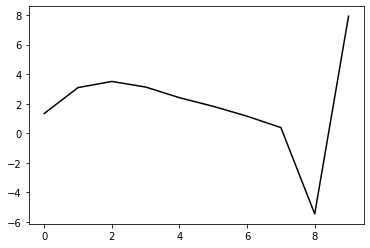

396000 23.821018551397707
0.40092788756153874 -0.3318483873417804 -0.1917429731947886 -0.09846593030456513
[ 1.35705239  3.02874348  3.45279854  3.08561416  2.37224503  1.79633723
  1.13659421  0.3715474  -5.46194785  7.84045039]


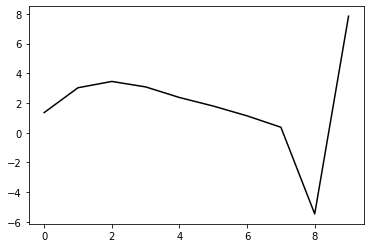

397100 19.94324616307826
0.4013610695637856 -0.32655969145856356 -0.18850336298785392 -0.10151572017875807
[ 1.37795321  3.06816147  3.4874905   3.11587001  2.39843948  1.81855803
  1.15557903  0.38631739 -5.4518002   7.88267519]


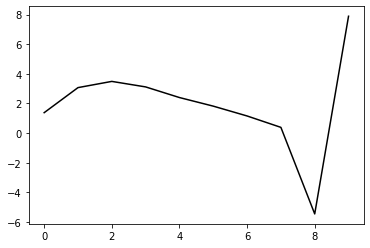

398200 28.712406930049465
0.3916135790899498 -0.32188295402865225 -0.18308538955999712 -0.10655549839191462
[ 1.44671729  2.93330138  3.34432407  2.96833996  2.24968768  1.67046308
  1.01022833  0.24368348 -5.59188098  7.8349538 ]


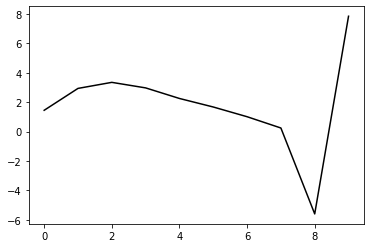

399300 24.006174646527715
0.3950920344290501 -0.322677237065542 -0.18539764903704817 -0.1047280178451051
[ 1.40505781  3.02494685  3.4375596   3.0608781   2.34015925  1.75785435
  1.09473064  0.32410961 -5.51485769  7.88239348]


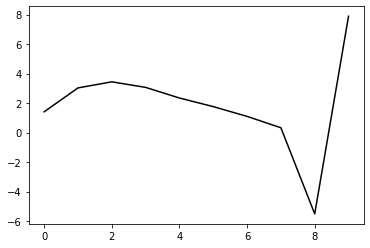

400400 16.81838378045794
0.40001845713372586 -0.3193007259557881 -0.18437320225465031 -0.1048468960636388
[ 1.43869868  3.09366864  3.51993969  3.15290493  2.43915236  1.8617231
  1.20281266  0.43439444 -5.40337861  7.84542531]


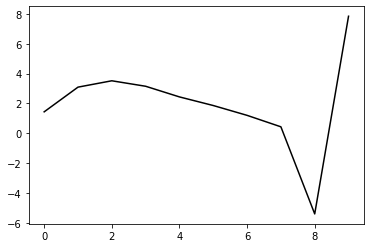

401500 21.745540241493714
0.39885016583917987 -0.32290122710785446 -0.187363845283909 -0.1034720462439172
[ 1.405372    3.04815498  3.47421509  3.10709757  2.3937854   1.81685306
  1.15939435  0.39082271 -5.44839526  7.88228001]


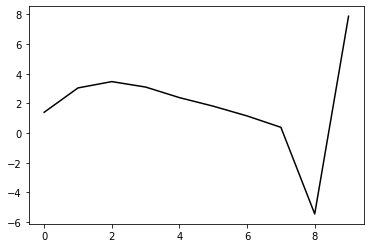

402600 29.564848284890818
0.39311465074496416 -0.331893352489884 -0.1933248340875395 -0.09981381474639985
[ 1.37984547  2.97420853  3.38274327  3.00176723  2.27811108  1.69386906
  1.03270027  0.26232467 -5.57673232  7.84184713]


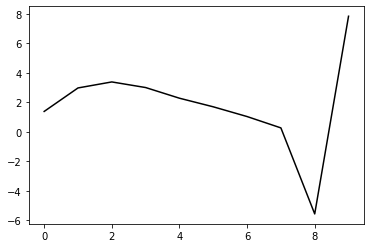

403700 13.61755569665474
0.40152358558162193 -0.32060460122305234 -0.1866800062949108 -0.10641415429911649
[ 1.4127737   3.13021832  3.5433357   3.1637368   2.43972498  1.854033
  1.19144205  0.41852386 -5.4243129   7.83711512]


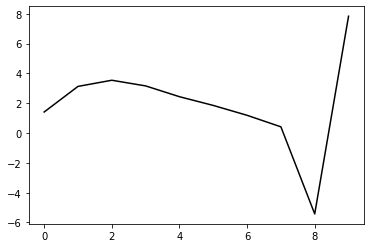

404800 28.203700144352155
0.39738315931787027 -0.31967642262784035 -0.18541489193554406 -0.10818163329766561
[ 1.44699845  3.09370317  3.51868219  3.14913666  2.43336187  1.85419729
  1.19762201  0.4289588  -5.41003885  7.88383837]


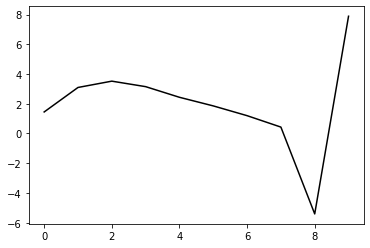

405900 17.60197503396887
0.39969331272266295 -0.3227318270256051 -0.18888550076499108 -0.10531891371607621
[ 1.34771079  3.09917172  3.50820407  3.12688333  2.40230231  1.81600674
  1.15426251  0.38040164 -5.46212437  7.87799689]


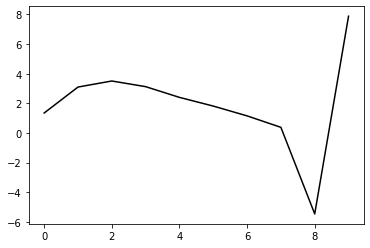

407000 17.214004020034505
0.40401667020562493 -0.3202474319807633 -0.1885869424058418 -0.10443777861991115
[ 1.35127892  3.16780749  3.58110867  3.2022617   2.47914739  1.8932385
  1.2316308   0.4557086  -5.39108369  7.86106022]


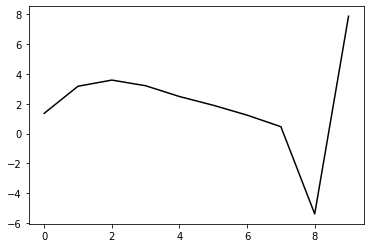

408100 20.189010736735895
0.40282333641273876 -0.3210655703101472 -0.18959023678200765 -0.10292757142475906
[ 1.37150434  3.07115385  3.48971593  3.11598733  2.39799603  1.81671376
  1.16004663  0.38691695 -5.45845994  7.87352346]


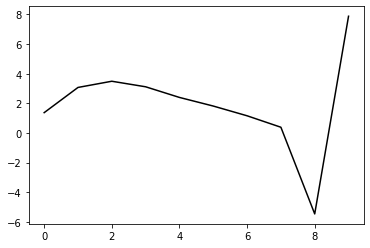

409200 22.261319770096325
0.40303946795797885 -0.3174439180553478 -0.18742978348051018 -0.1025337829102169
[ 1.36631922  3.07480663  3.48225221  3.09672975  2.36748014  1.77534465
  1.10957011  0.32669862 -5.52891309  7.84937234]


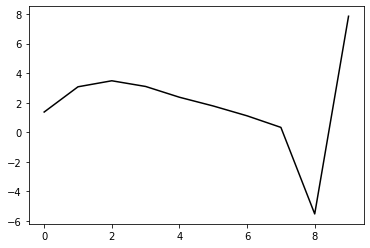

410300 21.207856190729135
0.399694520308497 -0.3181924691047585 -0.18766523174398436 -0.10310809005731217
[ 1.38259847  3.07944272  3.49760474  3.12061934  2.3978772   1.81031678
  1.14873533  0.36770827 -5.48596054  7.877191  ]


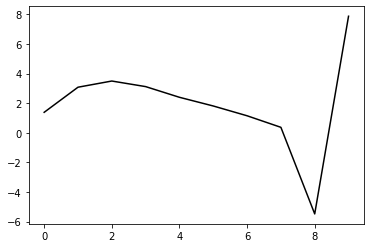

411400 14.569090487087946
0.39837890163613227 -0.3202992274295364 -0.18922989806307028 -0.10389253801463616
[ 1.4088835   3.07342009  3.50945018  3.14913097  2.44148862  1.86732095
  1.21840165  0.44751954 -5.39694317  7.86839102]


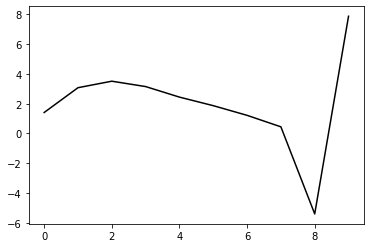

412500 21.14854922538633
0.3947326069974862 -0.32047571173751277 -0.189090065226823 -0.10308708233489318
[ 1.37984258  2.95625541  3.37283089  3.00181061  2.28881248  1.71203508
  1.06289295  0.29171891 -5.55304991  7.85461308]


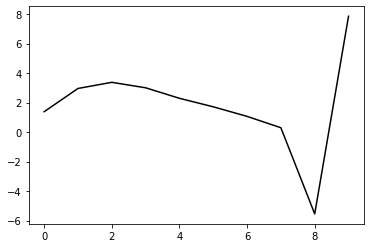

413600 24.272616154666625
0.4009766526050381 -0.3166526740854459 -0.18797175997015417 -0.10416746602514247
[ 1.37721426  3.08086019  3.49987092  3.12817257  2.41265216  1.83221866
  1.17976365  0.40433089 -5.44381286  7.85619353]


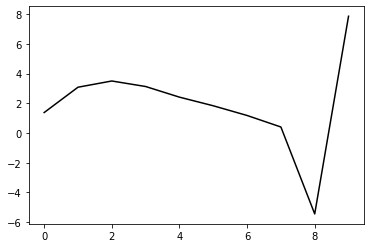

414700 13.589098390313241
0.3995344673904367 -0.316634887991372 -0.18770815830089643 -0.10621559247113124
[ 1.41142372  3.05834006  3.49121688  3.13110117  2.42504363  1.85223352
  1.20711494  0.43703172 -5.40694627  7.91825909]


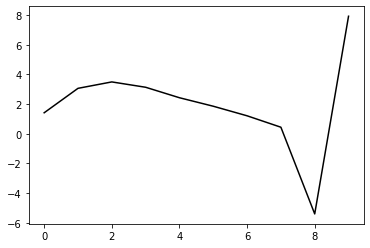

415800 25.052649173722322
0.39700160491278985 -0.3147805926967311 -0.18607181359191094 -0.10797297315669657
[ 1.43063433  3.06593851  3.49928748  3.14107024  2.43772691  1.86777798
  1.22641786  0.45872396 -5.38299972  7.85569372]


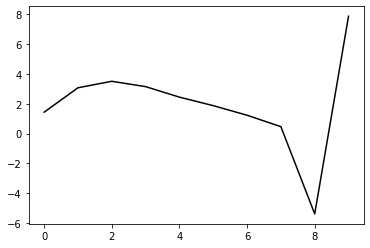

416900 22.114515996866583
0.39896709972947647 -0.31876532753794534 -0.19044959442285722 -0.10507711492233253
[ 1.33774579  3.04472836  3.46596122  3.1006745   2.39329253  1.82077255
  1.17841044  0.40924512 -5.43292342  7.89199217]


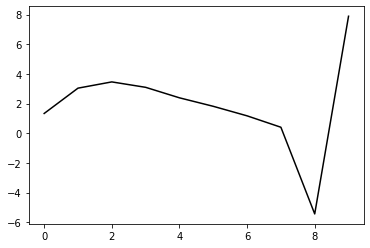

418000 19.848979327618444
0.3992366436613752 -0.32221121788443935 -0.19407180543880673 -0.10194404008544264
[ 1.36007829  2.97877978  3.40906961  3.05391392  2.35580052  1.79106857
  1.15567538  0.39123149 -5.44701901  7.84358407]


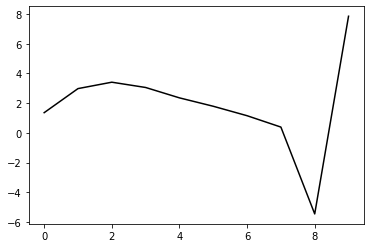

419100 22.817402017884948
0.395507069605312 -0.3178125178513904 -0.1904325102549146 -0.10452850937456032
[ 1.41980771  2.9261886   3.34199232  2.97528174  2.26745746  1.69427708
  1.05220679  0.28157349 -5.56136073  7.88139966]


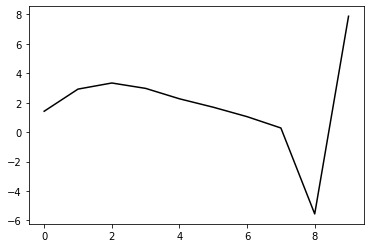

420200 23.615844813488685
0.39375392148205773 -0.31475559772456796 -0.18810047345405775 -0.10736969713832582
[ 1.41561913  2.93401256  3.35415608  2.99160508  2.28725103  1.71669901
  1.07724815  0.30795876 -5.53382346  7.82830458]


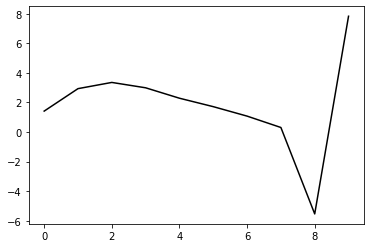

421300 21.373675221226993
0.40176207940594566 -0.31199553832515897 -0.1884902240020079 -0.10428897940260906
[ 1.37825452  3.02932897  3.44506104  3.07651932  2.36598815  1.78911944
  1.14411268  0.36812024 -5.48130941  7.87003956]


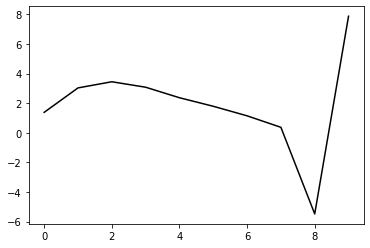

422400 16.347492170997874
0.3969370116398723 -0.3129772829707984 -0.18844296593079388 -0.10694957927899912
[ 1.44026728  3.00333678  3.4438902   3.09754469  2.40629893  1.84597532
  1.21615631  0.45201959 -5.38803477  7.86940671]


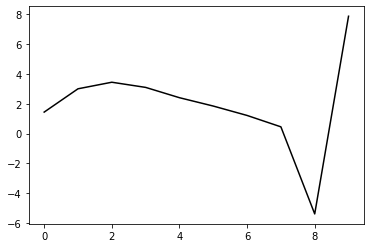

423500 22.154372622904358
0.3967308878306538 -0.3136907793610515 -0.18934692927369698 -0.10703429302099365
[ 1.41338326  3.04615179  3.49306187  3.15093414  2.46189556  1.90181395
  1.27167589  0.50473937 -5.33954911  7.9116686 ]


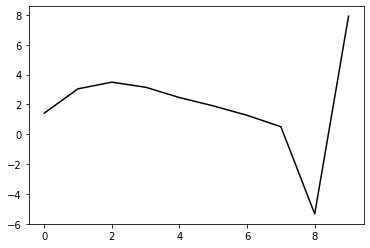

424600 25.547401432661108
0.39447482445186555 -0.3177337949315919 -0.1928544359264564 -0.10227382588584706
[ 1.39371824  2.94891999  3.37746659  3.02289339  2.32553653  1.75955161
  1.12584921  0.35531456 -5.49203735  7.8422284 ]


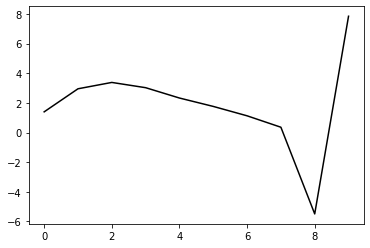

425700 13.280606116616632
0.3967203957958477 -0.3113139566928543 -0.1890207510533892 -0.10567041114258476
[ 1.42598425  3.00492979  3.43872108  3.08773341  2.39260093  1.82779168
  1.19527854  0.42467269 -5.42267614  7.878859  ]


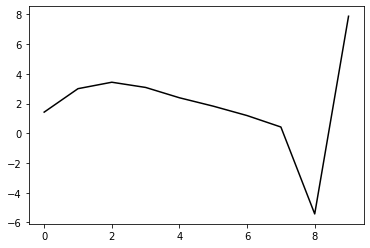

426800 26.685895250336483
0.3927778203491333 -0.30990376908058703 -0.18744726307490703 -0.10892718190885611
[ 1.43667861  3.00432106  3.44067928  3.09278892  2.40021725  1.83726256
  1.20689188  0.43757834 -5.40781957  7.85936442]


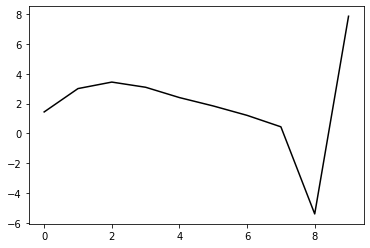

427900 16.07903185444033
0.39649334049753004 -0.31250774712957413 -0.19096470351138914 -0.1059528626653022
[ 1.35302565  3.02469822  3.44496569  3.08427994  2.38142019  1.80982109
  1.1727002   0.39678819 -5.4539063   7.88949267]


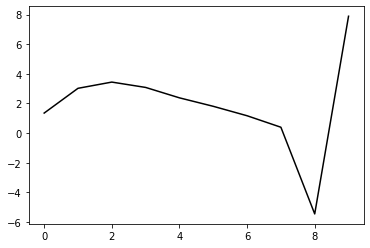

429000 17.92894767316783
0.3990232862097282 -0.3140901900962504 -0.19331107200010345 -0.103374475553456
[ 1.36286694  3.04496154  3.46530666  3.10422361  2.40064032  1.82801679
  1.19041329  0.41324983 -5.43829127  7.84232391]


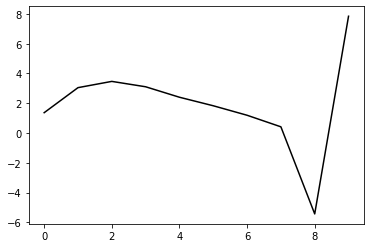

430100 20.67561282241777
0.40151845645130513 -0.30683399518192495 -0.18891118206961607 -0.10524053296841394
[ 1.37816798  3.05718889  3.47153901  3.10531206  2.3975765   1.8211466
  1.18053168  0.39905645 -5.45799464  7.8748858 ]


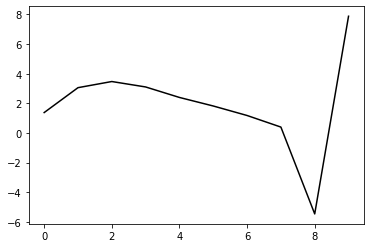

431200 23.26465826763526
0.39654170969248287 -0.31142791296238015 -0.19177867839938617 -0.10455036471874346
[ 1.4015054   2.97112144  3.40730474  3.06050701  2.36983408  1.80805102
  1.18080858  0.40938569 -5.44025514  7.86766922]


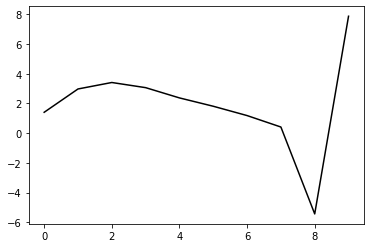

432300 24.827203167824447
0.39228461806420534 -0.30711408962834763 -0.18823764643314175 -0.10643980987500119
[ 1.42501107  2.93633125  3.36369307  3.00914831  2.31170735  1.7437381
  1.11183775  0.33466279 -5.52152785  7.86432657]


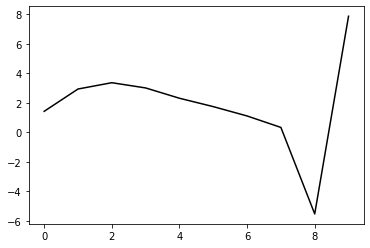

433400 14.172539788368102
0.39502808083645735 -0.30869569283350756 -0.19050090625762586 -0.10574760658021047
[ 1.40518179  3.01817917  3.46455204  3.12640104  2.44239246  1.88497424
  1.26208947  0.49023852 -5.36341881  7.90117927]


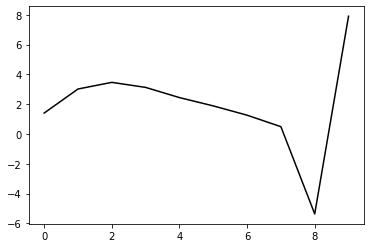

434500 22.373359638561112
0.39444199727656715 -0.30752317673158386 -0.18954787811899224 -0.10714466533535048
[ 1.41880359  3.05092158  3.50315914  3.16806627  2.48425753  1.92465232
  1.29934371  0.52347839 -5.33368137  7.88721135]


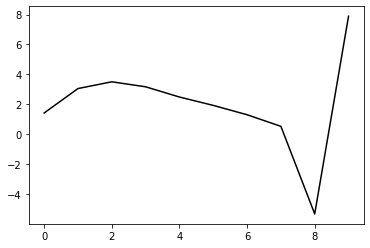

435600 25.25623331227988
0.39465347941640877 -0.3116859103499961 -0.19297840752879417 -0.10572450181710509
[ 1.36763865  3.05826396  3.50061846  3.15695908  2.46646329  1.90193674
  1.27429223  0.49676637 -5.35997154  7.87331121]


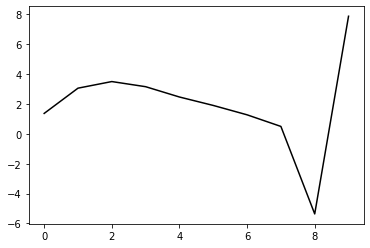

436700 13.182193057197592
0.39481648187906665 -0.3059894381453187 -0.18941938283847762 -0.10559773739472184
[ 1.4280067   2.98904389  3.42585722  3.07837388  2.38567397  1.81987973
  1.19233732  0.41397724 -5.44394848  7.8859119 ]


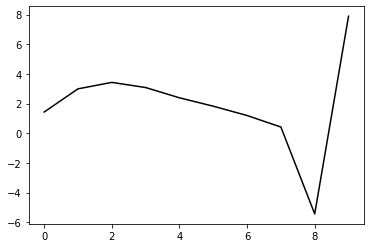

437800 21.838580889086064
0.39090666943925817 -0.306435887199459 -0.18917173104949794 -0.10744108401546058
[ 1.4142597   3.00723153  3.45159709  3.11132008  2.42484392  1.86414507
  1.24152663  0.46603336 -5.39037639  7.85967322]


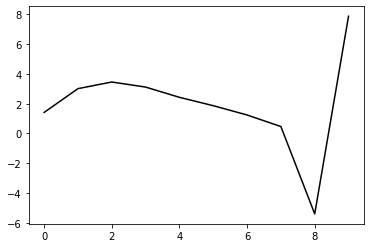

438900 15.093631479720214
0.3939720806858642 -0.30860067815239817 -0.1921512467426504 -0.10377401550420715
[ 1.37733116  2.99123305  3.43558038  3.09530177  2.40882197  1.84791993
  1.2258792   0.44969332 -5.40776486  7.87416394]


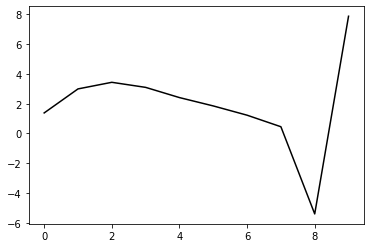

440000 17.112434119467363
0.39144943370592994 -0.3089865206257654 -0.19223221860107903 -0.10343402084989889
[ 1.36708741  2.98689637  3.42547241  3.07932432  2.38703641  1.82037091
  1.19376862  0.41201504 -5.45135569  7.85647698]


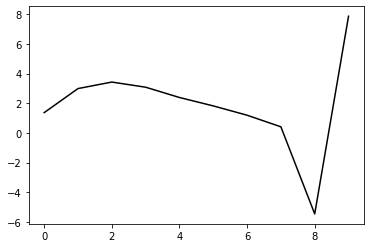

441100 20.112439902579766
0.395405800728863 -0.30653123635625346 -0.19218005981236388 -0.10175173999748938
[ 1.37281807  2.99251941  3.43124777  3.08571006  2.39418441  1.82809807
  1.20252566  0.42004357 -5.44583712  7.88517409]


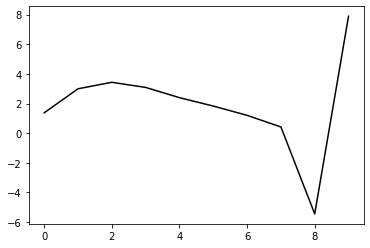

442200 22.238119517016504
0.39358337358682205 -0.30404839944376616 -0.19069807725813834 -0.1017989223274481
[ 1.37871273  2.97012014  3.40654557  3.05962948  2.36726048  1.80041653
  1.17477594  0.39074273 -5.47738259  7.86176799]


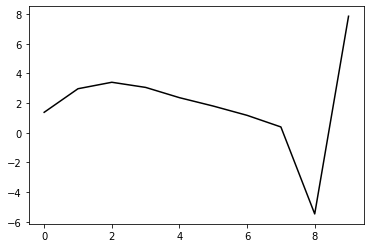

443300 24.844412545487643
0.38387743060874224 -0.306202563619312 -0.1896714521283807 -0.10557994861547355
[ 1.41067011  2.84689834  3.27144078  2.91568015  2.21679931  1.6457856
  1.01943288  0.2371705  -5.62550752  7.85753157]


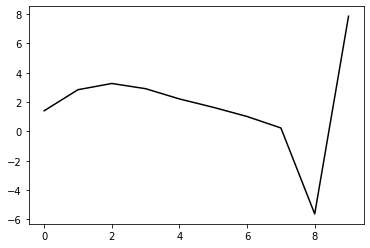

444400 15.976182647505166
0.38764261379620935 -0.3049917170410204 -0.19030206497647723 -0.1044574008196539
[ 1.39121608  2.94366631  3.35696667  2.99032569  2.28083486  1.69958736
  1.06436632  0.27350695 -5.59532795  7.83817954]


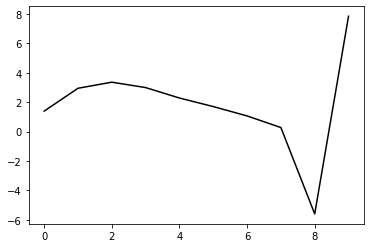

445500 22.002501038856767
0.3938563383829773 -0.3016289828253286 -0.18965440994998736 -0.10794220091375638
[ 1.40042961  3.08771355  3.52285582  3.17296386  2.47615113  1.90454665
  1.27746856  0.49251195 -5.37315961  7.90930632]


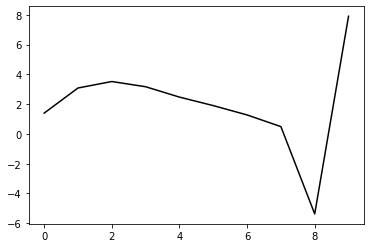

446600 27.320143822142132
0.39390423396322183 -0.3074708812840875 -0.19460816463689365 -0.10180821702684024
[ 1.35891699  2.97257413  3.39534851  3.03585004  2.33196637  1.75506552
  1.12510958  0.33772342 -5.52818579  7.83269125]


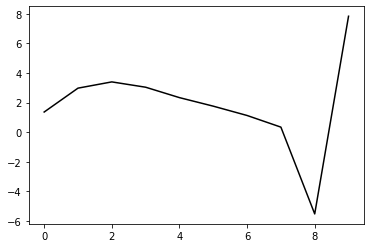

447700 13.04701794037115
0.39180550105833495 -0.3035516277054148 -0.19138656111591187 -0.10587409970627956
[ 1.42791079  2.97479504  3.40786073  3.05657317  2.35850444  1.78551626
  1.15905757  0.37390833 -5.48916448  7.86127195]


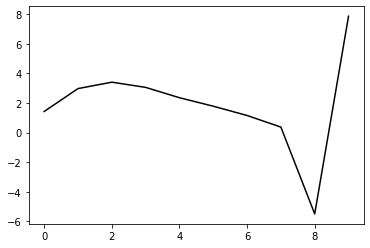

448800 27.645760536603483
0.3893862935392055 -0.30018700946619703 -0.18866846118436637 -0.10946741193907927
[ 1.43366185  3.00622235  3.43898436  3.08807514  2.38997236  1.81634101
  1.18964158  0.40358743 -5.45934735  7.8419645 ]


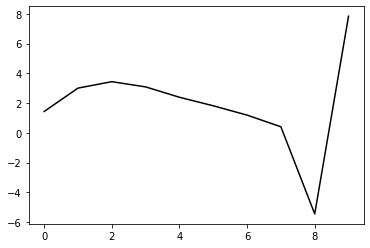

449900 18.53272730765185
0.39283909537986167 -0.3050655404993774 -0.19375525689881262 -0.10700411309752886
[ 1.34085138  3.01988789  3.43753977  3.07492573  2.36766221  1.78660897
  1.15461678  0.3639007  -5.5016033   7.88657862]


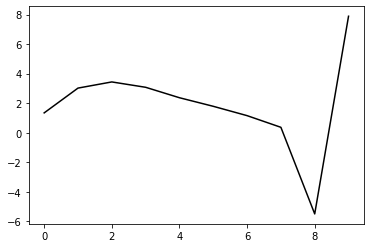

451000 18.008606703513227
0.39498624888230577 -0.3066308228501851 -0.1961689804788834 -0.10485687850806201
[ 1.35666426  3.04296421  3.46421826  3.10464213  2.39955714  1.81979571
  1.18897632  0.39810318 -5.46773193  7.84005392]


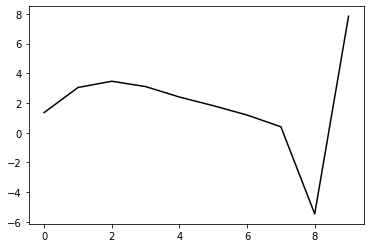

452100 23.57043550051115
0.3900483090544297 -0.30168220068592216 -0.19169972266249094 -0.10860380372466436
[ 1.44912355  2.91780054  3.33827387  2.9801731   2.27764377  1.7007505
  1.07350923  0.28543526 -5.57732793  7.8935276 ]


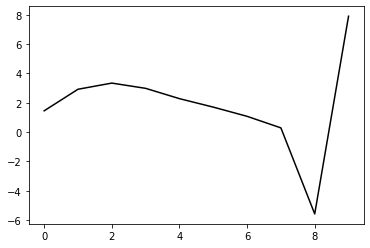

453200 24.03534395488139
0.39010337782897336 -0.2992255351960595 -0.19062395818927563 -0.10839127814285689
[ 1.41476151  2.96628168  3.38057054  3.01675341  2.30920263  1.72759269
  1.0963525   0.3033223  -5.56485073  7.82567448]


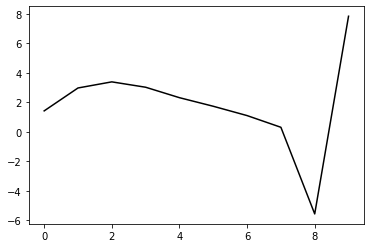

454300 21.411447802580124
0.3947142591640144 -0.30214591108703365 -0.19433694025290732 -0.10495843721217936
[ 1.36547001  3.02213708  3.44519613  3.08750476  2.38435499  1.80574566
  1.17730068  0.38547305 -5.48222702  7.88359582]


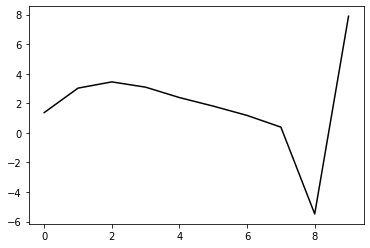

455400 20.440459666934288
0.3835128976592486 -0.3076355673812397 -0.19628939814682111 -0.10490576956253449
[ 1.38922758  2.84533445  3.25001599  2.88000331  2.16904176  1.58596338
  0.95667212  0.16575099 -5.70005977  7.8117672 ]


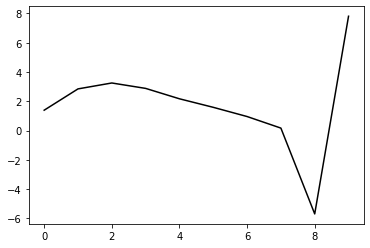

456500 22.402969171955487
0.3920438390233912 -0.29943015244391574 -0.19187884615339215 -0.11046726213258319
[ 1.3911502   3.06450445  3.47402934  3.10393257  2.38998508  1.80234237
  1.16843485  0.37213622 -5.49871383  7.84888925]


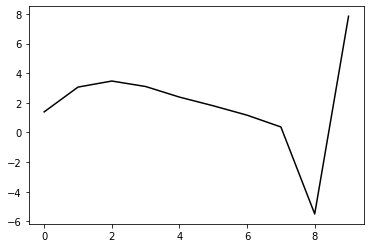

457600 24.94066096300592
0.39453521871632186 -0.3015122398536303 -0.19457665999611745 -0.10736065961239946
[ 1.36891541  3.03546165  3.44055859  3.06759595  2.3520349   1.76330153
  1.12920667  0.3319905  -5.53970776  7.86859648]


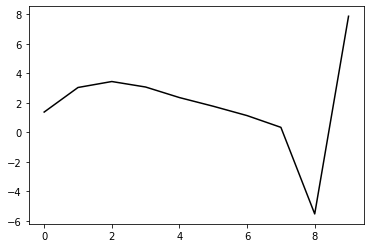

458700 13.48342792298212
0.39231975626164234 -0.3004508995527094 -0.19358313797133586 -0.10947861888895528
[ 1.41247802  3.00107389  3.42456168  3.06767526  2.3652409   1.78693446
  1.16186686  0.37125001 -5.49502822  7.82161969]


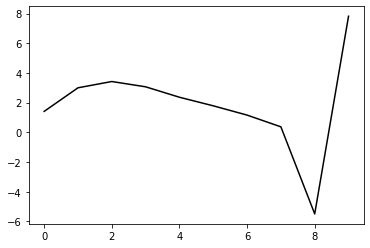

459800 25.08791494804805
0.3894828960175883 -0.2980546243654719 -0.19151785822233697 -0.11216075313641283
[ 1.42158198  3.01187559  3.43971223  3.08805051  2.38985258  1.81442002
  1.1918455   0.40213958 -5.46340012  7.84292093]


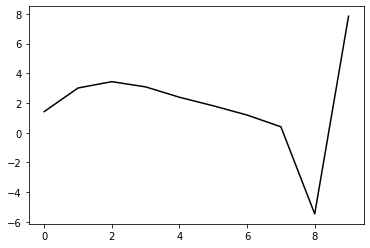

460900 13.485741668640097
0.39423630125598647 -0.2976947086262947 -0.1928175255508977 -0.1107386985062663
[ 1.36764924  3.08215517  3.50840121  3.15461069  2.45402286  1.87558107
  1.2499625   0.45512438 -5.41789049  7.88609316]


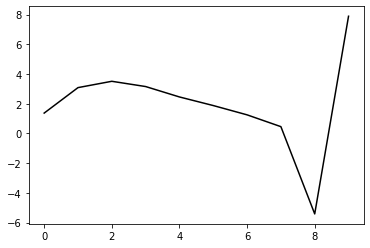

462000 15.931626360551801
0.3955988635526989 -0.2977111510996899 -0.19370573706394068 -0.10839102158722454
[ 1.34699661  3.06105868  3.48388333  3.1270856   2.42435048  1.84420878
  1.21801092  0.42172037 -5.45262553  7.87070756]


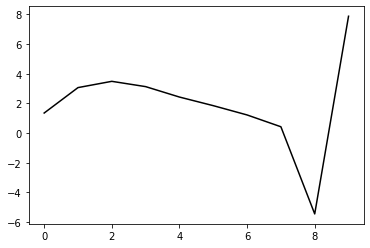

463100 23.343090656914786
0.38846500554878055 -0.3012764691617838 -0.19529619175359775 -0.1071314551189172
[ 1.41543497  2.83917401  3.26029924  2.90620551  2.20946328  1.63739451
  1.02148845  0.23529505 -5.62902131  7.84685048]


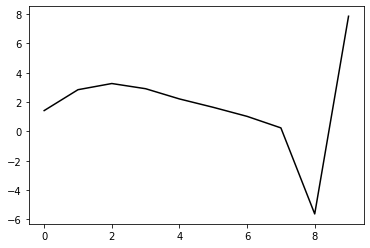

464200 24.635709458351634
0.38470410720931897 -0.29805709742295344 -0.1923356573472229 -0.11036176989110413
[ 1.41507869  2.82689013  3.25251562  2.90650068  2.21846627  1.65411862
  1.04512153  0.26292924 -5.59882345  7.80332797]


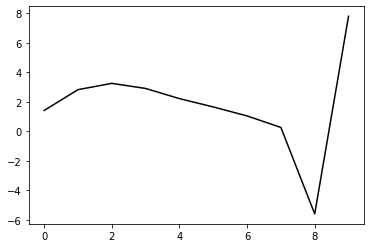

465300 20.911422267873824
0.3890941657140023 -0.29974607939606535 -0.1955119659121617 -0.10749729316209226
[ 1.36499624  2.91759765  3.35025513  3.0097746   2.32554045  1.76325641
  1.15550608  0.37193914 -5.49270871  7.87122593]


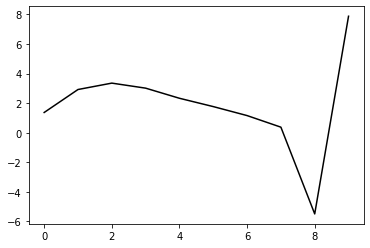

466400 15.0055731353399
0.3867755381726986 -0.2978409597337883 -0.19406223784601206 -0.10842035665154419
[ 1.37718717  2.88311743  3.31325587  2.97420046  2.29283941  1.73358562
  1.12933153  0.34777193 -5.51532549  7.85363524]


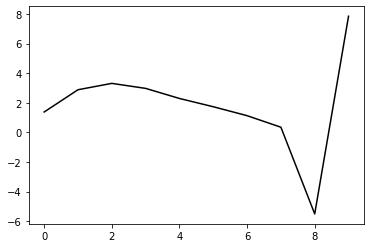

467500 21.827797783286623
0.3848558064351273 -0.30306976603941005 -0.19823218711917506 -0.1052977205273116
[ 1.36401937  2.8158892   3.23787727  2.8936099   2.20831443  1.64580695
  1.03961878  0.25607046 -5.60844275  7.861158  ]


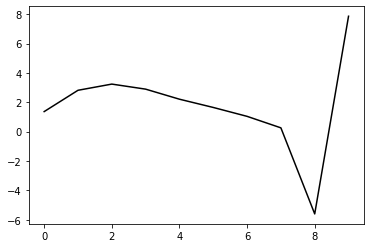

468600 24.84003934331383
0.3905063681399704 -0.2976516044712224 -0.19543333669229948 -0.1085540688036699
[ 1.36384606  2.95566824  3.37302124  3.02299204  2.33136689  1.7624209
  1.15075537  0.36168683 -5.50681458  7.85421071]


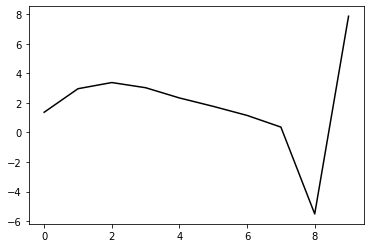

469700 13.235279622479327
0.38846600132849024 -0.29639719661608294 -0.19457253409892744 -0.10928027942941633
[ 1.41650534  2.89984508  3.32304073  2.97921277  2.29321595  1.72904249
  1.12203313  0.33625983 -5.52909415  7.85971688]


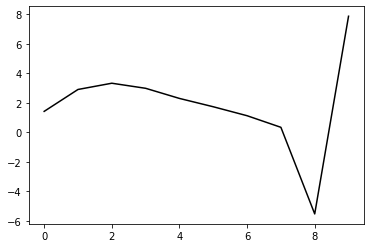

470800 23.308450878883967
0.39128898922496363 -0.29317340913210216 -0.193005798410528 -0.11090269528321955
[ 1.36786255  2.99365277  3.40920831  3.05791204  2.36509063  1.7946776
  1.18279368  0.39207143 -5.47760689  7.85038412]


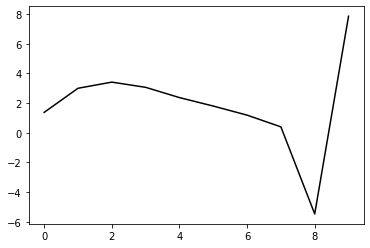

471900 30.76929944673194
0.3942568032122941 -0.2953951006532133 -0.1959017321702982 -0.10753888130399374
[ 1.29870836  2.9740611   3.38407448  3.0281775   2.33199824  1.75892536
  1.145692    0.35287522 -5.51891723  7.88120582]


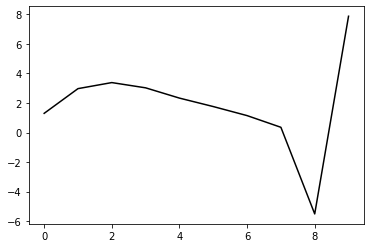

473000 16.06897538223388
0.3918382649498871 -0.29611106855677916 -0.1961768925059297 -0.10954849936592351
[ 1.35285056  3.01122711  3.43892589  3.09777279  2.41325926  1.84919138
  1.24355224  0.4556922  -5.41283713  7.85037921]


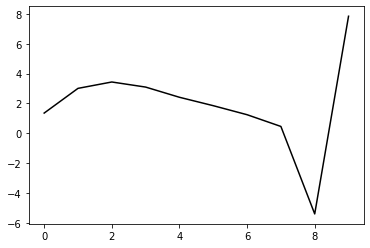

474100 26.16189857152247
0.3887647581314713 -0.29164081995298 -0.19287523255401445 -0.11105492101938359
[ 1.44715334  2.89874264  3.33153106  2.99610696  2.31745102  1.75868776
  1.15824887  0.37315257 -5.49484891  7.87799483]


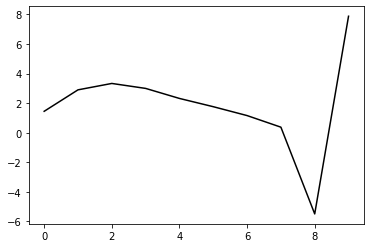

475200 22.42767919114452
0.39147968117478443 -0.2934815753849615 -0.19563540976188698 -0.10674196234484915
[ 1.36010634  2.94905259  3.37418075  3.0318247   2.34702655  1.78249044
  1.1770715   0.38593705 -5.48888723  7.8565026 ]


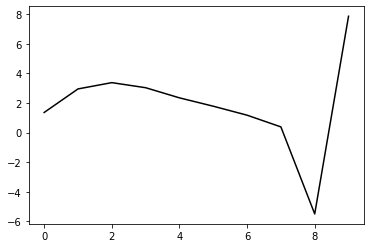

476300 23.093699440993007
0.3833047408324712 -0.2953395619283406 -0.19545526506882252 -0.108605728295723
[ 1.3961879   2.8756959   3.3029644   2.9630647   2.28078091  1.71879138
  1.11694529  0.32896767 -5.54203783  7.88507368]


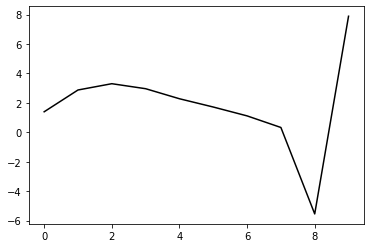

477400 13.85636800586232
0.39007863797035797 -0.28879217029398024 -0.19286395259089753 -0.10865154066166874
[ 1.39869711  3.01741133  3.44895304  3.10998615  2.42627562  1.86086979
  1.25479488  0.46006543 -5.4190401   7.85910678]


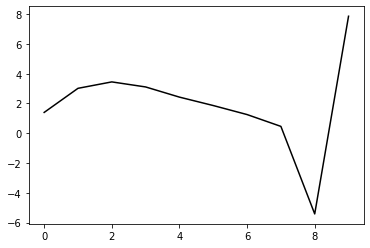

478500 22.25614309558282
0.3855868667791371 -0.2927659107249192 -0.19517385891100672 -0.1091382137509889
[ 1.39906163  2.9355411   3.37473037  3.04443874  2.3694641   1.8121468
  1.21399959  0.42527394 -5.44872716  7.87561515]


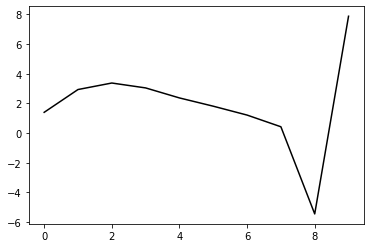

479600 24.507839425166086
0.3876971193098251 -0.29148528028663717 -0.19513016576018355 -0.10988659760558118
[ 1.36812601  3.04919202  3.50000067  3.17694302  2.50547853  1.94881928
  1.35008897  0.55799031 -5.3224629   7.86820371]


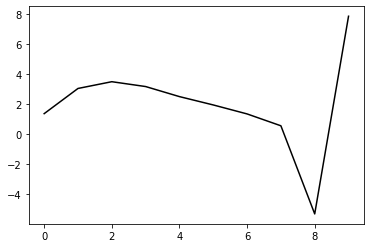

480700 13.9709566678371
0.38137220710193703 -0.2932552254791525 -0.19554523136789326 -0.10858551916881069
[ 1.42930871  2.8491098   3.28033344  2.94637873  2.26929417  1.71026247
  1.11221487  0.32209901 -5.55394988  7.87551961]


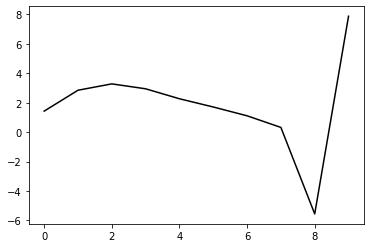

481800 24.883693984234192
0.3829454616170151 -0.28916581883311054 -0.1931579308532179 -0.11172552917758082
[ 1.42075178  2.95454179  3.38302272  3.04521576  2.36375913  1.80025608
  1.19853441  0.40467544 -5.47391108  7.85008344]


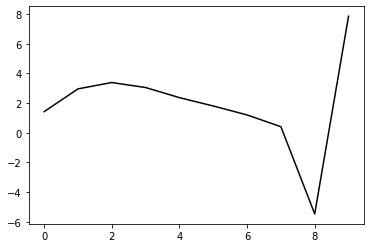

482900 13.694949108797013
0.3888956034963143 -0.28880552267900433 -0.19471490316943213 -0.10947796540813963
[ 1.3736885   3.0200768   3.44261439  3.09902335  2.41230718  1.84389131
  1.23823474  0.44004095 -5.44310597  7.87082453]


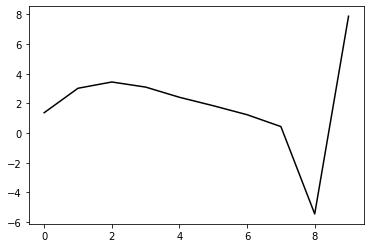

484000 16.23528518807908
0.3905473721945896 -0.28847946167987326 -0.19542197084660412 -0.10849505274999764
[ 1.3393749   3.03524986  3.45875813  3.11490745  2.42742265  1.85761029
  1.25073651  0.44953024 -5.43822006  7.8749305 ]


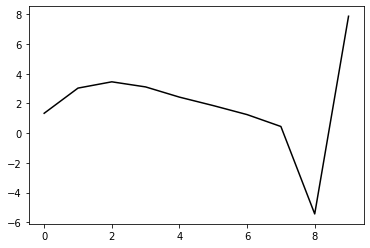

485100 20.817765573977987
0.3857963551797057 -0.2939855189104729 -0.1987482197162668 -0.10813348063074703
[ 1.39787382  2.9246736   3.36976659  3.04702144  2.37850494  1.82522087
  1.23378318  0.44541766 -5.43015747  7.88238428]


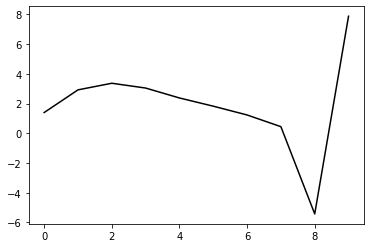

486200 24.009269398013494
0.3800232976463645 -0.2918455782732438 -0.19622521882313723 -0.10912365426359096
[ 1.43393627  2.81476889  3.24342982  2.91028198  2.23570528  1.67910627
  1.08703675  0.29809529 -5.57824455  7.84592376]


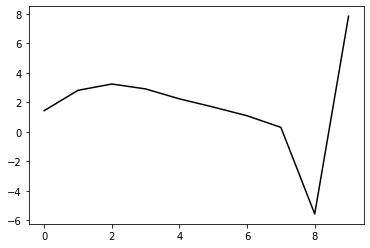

487300 20.931412842496066
0.38887804646192803 -0.2876973256336089 -0.19617549383720484 -0.10583029178096723
[ 1.37949518  2.97827255  3.40895824  3.07343106  2.39347106  1.8292955
  1.2289712   0.42914968 -5.45988814  7.89830627]


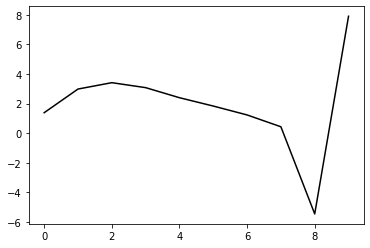

488400 14.073401823316752
0.38644389247798194 -0.284873750308213 -0.19410807851429387 -0.10665799578242148
[ 1.39859723  2.97239773  3.40513229  3.07072745  2.39134099  1.8270992
  1.22694487  0.42565968 -5.46558083  7.8499738 ]


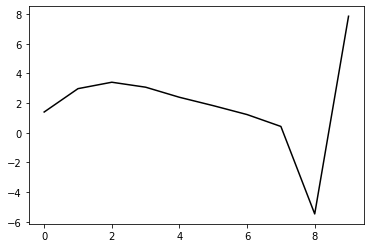

489500 22.4868374215495
0.3845312491243314 -0.2854417922785051 -0.19406349956828312 -0.10844368155121989
[ 1.40415654  2.97677071  3.41072113  3.07717069  2.39846181  1.83509574
  1.23727813  0.43864636 -5.44846741  7.86714114]


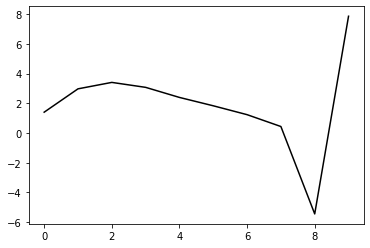

490600 24.5255866922694
0.38549217449740547 -0.28842733764040335 -0.19692470387574523 -0.10647339462942444
[ 1.37970955  2.97329022  3.40846518  3.07624616  2.39871364  1.83625638
  1.23998018  0.441983   -5.444751    7.86137549]


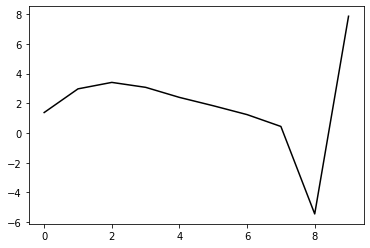

491700 17.091699920832376
0.3832459163340909 -0.285434887050569 -0.19468474654587112 -0.10863322506074119
[ 1.46567892  2.88488237  3.32953233  3.00721546  2.33949244  1.78627646
  1.19941304  0.40880935 -5.47198679  7.8587004 ]


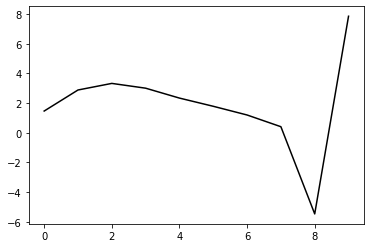

492800 25.08357694827958
0.3842326879662242 -0.28438221303054595 -0.19447974737237134 -0.10970954152198051
[ 1.43545148  2.99256137  3.44675282  3.12961447  2.46287767  1.90735684
  1.31704923  0.52077806 -5.36711668  7.8656499 ]


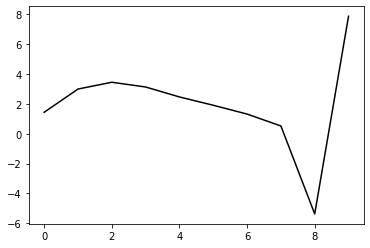

493900 13.627591243956099
0.3838499074741184 -0.28549742992946875 -0.19563739066653027 -0.1076293818650823
[ 1.38680816  2.98494454  3.42677027  3.09972252  2.42504425  1.86313167
  1.26849321  0.46864819 -5.42088597  7.89820128]


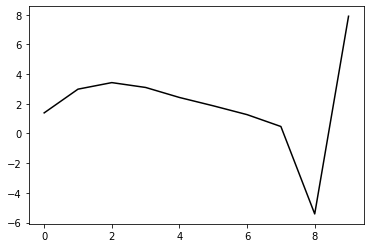

495000 16.417376598805237
0.3844097911259805 -0.2895822105537425 -0.19920697763398054 -0.10539063560617583
[ 1.39211129  2.96515364  3.4133112   3.09194329  2.42190122  1.86359985
  1.27264249  0.47525791 -5.41187325  7.87477393]


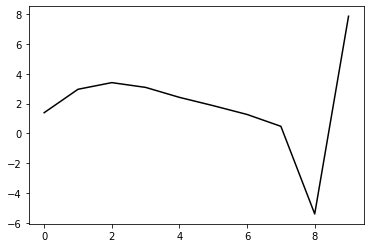

496100 19.913951815006975
0.3796765995142104 -0.28903700552714173 -0.19841753175301943 -0.10450225828301096
[ 1.38723369  2.86795231  3.30765316  2.98170376  2.30937485  1.74977731
  1.15857026  0.35978402 -5.53011635  7.84603916]


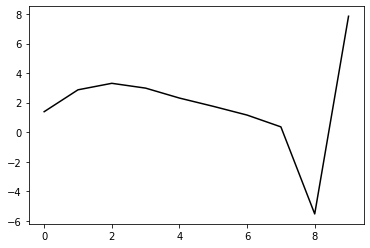

497200 29.389619846889055
0.37455779929610405 -0.2823895840223288 -0.19260890778429776 -0.11034623568643948
[ 1.43547387  2.79682811  3.23726014  2.91473097  2.24665727  1.69128686
  1.10453527  0.3091215  -5.57810377  7.82296775]


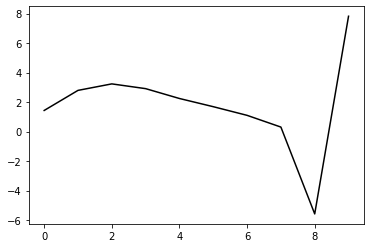

498300 24.27978015977375
0.3750565138066166 -0.28564901362029527 -0.1956597734861692 -0.10836099689916678
[ 1.39305985  2.79486998  3.21994568  2.88445264  2.2049984   1.63972484
  1.04527748  0.24356446 -5.6475206   7.86132317]


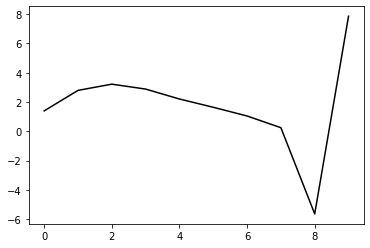

499400 14.777188472479919
0.3794673018888777 -0.2839918573150841 -0.19569260703126198 -0.10835561246979011
[ 1.3866414   2.91517094  3.33398822  2.99145546  2.30455248  1.73181252
  1.13086467  0.32290634 -5.5720242   7.84272975]


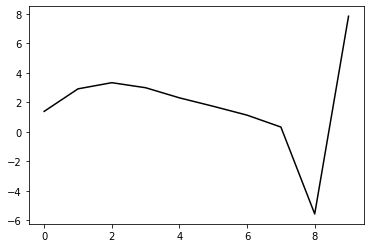

In [19]:
optimizer=tf.optimizers.Adam(learning_rate=0.0005)
for j in range (5000):    
    with tf.GradientTape() as g:
        loss=Error_func(h, m2, lam, alpha, beta, Positive[j%10], Negative[j%10])
        gradients=g.gradient(loss, [h, m2, lam, alpha, beta])
        if np.isnan(loss)==True: break
    for i in range (90):
        optimizer.apply_gradients(zip(gradients, [h]))
        if any(np.isnan(h.numpy()))==True: break
    for i in range (10):
        optimizer.apply_gradients(zip(gradients, [h, m2, lam, alpha, beta]))
        if any(np.isnan(h.numpy()))==True: break
    if j%11==0: 
        print(j*100, Error_func(h, m2, lam, alpha, beta, Positive[j%10], Negative[j%10]).numpy())
        print(m2.numpy(), lam.numpy(), alpha.numpy(), beta.numpy()), print(h.numpy())
        plt.plot(h.numpy(), 'k-'), plt.show()

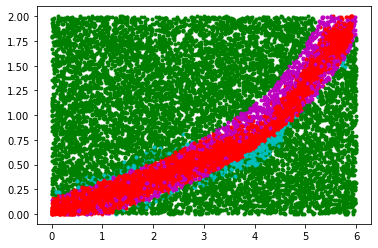

In [20]:
for i in range (set):
    [Positive0[i], Positive1[i]]=NN_func_01(h, m2, lam, alpha, beta, Positive[i])
    [Negative0[i], Negative1[i]]=NN_func_01(h, m2, lam, alpha, beta, Negative[i])
for i in range (set):
    x_data1[i]=[v[0] for v in Positive0[i]]
    y_data1[i]=[v[1] for v in Positive0[i]]
    x_data2[i]=[v[0] for v in Positive1[i]]
    y_data2[i]=[v[1] for v in Positive1[i]]
    x_data3[i]=[v[0] for v in Negative0[i]]
    y_data3[i]=[v[1] for v in Negative0[i]]
    x_data4[i]=[v[0] for v in Negative1[i]]
    y_data4[i]=[v[1] for v in Negative1[i]]
    plt.plot(x_data4[i], y_data4[i], 'g.')
    plt.plot(x_data2[i], y_data2[i], 'c.')
    plt.plot(x_data1[i], y_data1[i], 'r.')
    plt.plot(x_data3[i], y_data3[i], 'm.')
plt.show()

0 38.31355153030509
0.37583120761789546 -0.2766380198452469 -0.1892112242375449 -0.11640935598159825
[ 1.38503402  2.93248179  3.44599198  3.0984722   2.40715082  1.83057073
  1.22672141  0.41637869 -5.47986714  7.8412061 ]


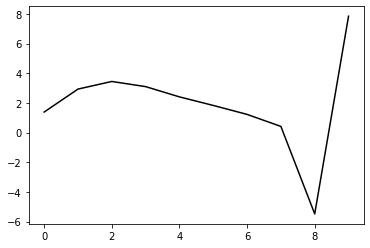

1100 30.29010445566151
0.3714562694734431 -0.29464215638125946 -0.2040687564472488 -0.10474898825391897
[ 1.32869411  2.61060037  3.15040991  2.81855544  2.13568487  1.56433308
  0.96449518  0.15701382 -5.73679849  7.82701559]


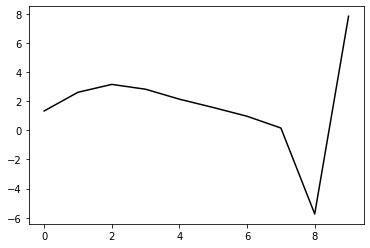

2200 22.536672014478995
0.3865359392347406 -0.28318058113794664 -0.1978454374820471 -0.1128731500026225
[ 1.33380859  2.79266622  3.32344132  2.98450832  2.29471521  1.71708228
  1.11199094  0.29944365 -5.59886716  7.88394848]


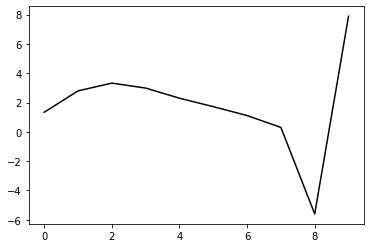

3300 21.33898841308301
0.38883288551316675 -0.2809694917763806 -0.19716136612953894 -0.11484827990470742
[ 1.32981396  2.82993423  3.36359227  3.02793944  2.33998464  1.76353585
  1.1597232   0.34741701 -5.55190783  7.8431861 ]


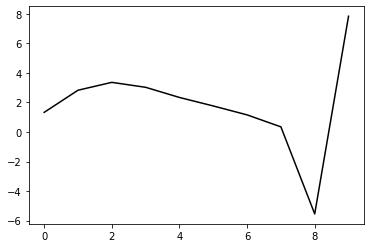

4400 13.965053336980562
0.3861990407632523 -0.2815710352308378 -0.19749224378127403 -0.11641464457084019
[ 1.37205455  2.83260959  3.38272178  3.06293725  2.38747427  1.82116348
  1.22645987  0.42132266 -5.47216726  7.86207569]


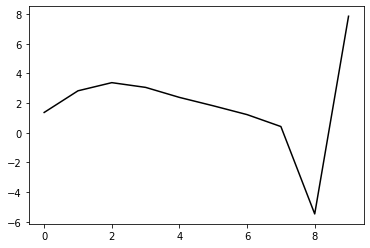

5500 23.992430443733717
0.3789833819101681 -0.2807270890500209 -0.1962499623666296 -0.1164053169229552
[ 1.37689375  2.7602633   3.2978218   2.96919106  2.28601947  1.7130453
  1.1130233   0.30158484 -5.59921029  7.84121859]


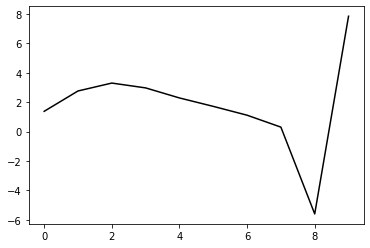

6600 24.4624995102746
0.38452183098642884 -0.28119354677421105 -0.1986161049998052 -0.11668696761952016
[ 1.33540253  2.87647578  3.431378    3.12023939  2.4514046   1.89002943
  1.29957585  0.49386161 -5.40572017  7.85330871]


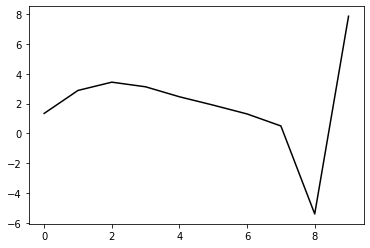

7700 14.429700055520216
0.3809992314374918 -0.2760639635210646 -0.19447554153355467 -0.11575591573316443
[ 1.37421642  2.74354637  3.27611409  2.94966886  2.26915809  1.69901271
  1.10267733  0.2924647  -5.60824874  7.84324707]


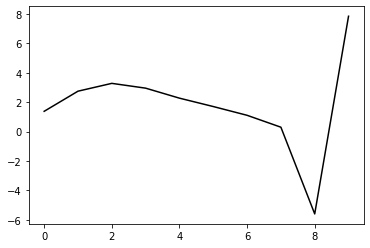

8800 31.421511694776427
0.3806267270064762 -0.2744849610369504 -0.19334820697671787 -0.11897273566374673
[ 1.37944826  2.788488    3.32494762  3.00270742  2.32456504  1.75578911
  1.1609077   0.3514228  -5.54831122  7.88108861]


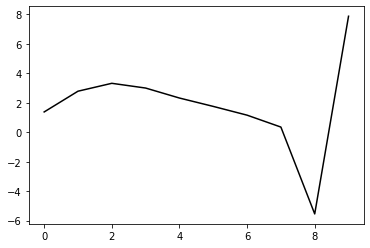

9900 23.041915470683996
0.3855305768082355 -0.2799883715394873 -0.19898181401899265 -0.11498339543735771
[ 1.27752232  2.80077026  3.32169787  2.98882175  2.30185354  1.72593893
  1.12606181  0.31224115 -5.59018004  7.89901275]


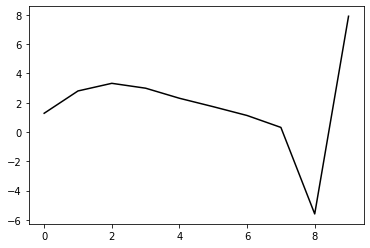

11000 18.191620829887462
0.3837349433781332 -0.2834106298401371 -0.20146038798426308 -0.11344363372285685
[ 1.30394914  2.76424829  3.27298211  2.93240824  2.23871869  1.65705055
  1.05310182  0.23604436 -5.66732773  7.81376658]


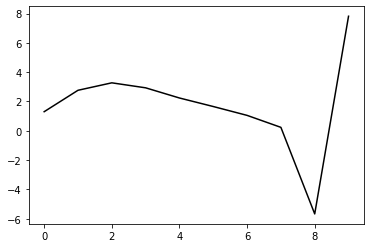

12100 24.037890850037236
0.3801184209537802 -0.2814740393795065 -0.19950923055632208 -0.11704736740669931
[ 1.38742197  2.65615625  3.17802135  2.85293578  2.1728578   1.60295423
  1.0096745   0.20125486 -5.69454851  7.87879464]


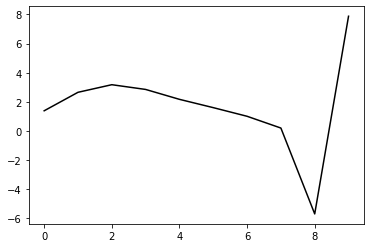

13200 24.006735054230695
0.3784783639335017 -0.2792045028660969 -0.1982764818336897 -0.11781703823460302
[ 1.37051195  2.65399109  3.17675409  2.85607507  2.17985747  1.61295017
  1.02216393  0.21419122 -5.68284163  7.81427878]


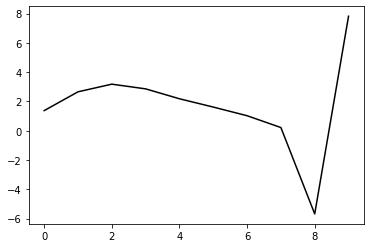

14300 25.175395419285316
0.37383936102789816 -0.2788918497219046 -0.1976008286693625 -0.118822076662428
[ 1.36639535  2.61054564  3.13768764  2.82462392  2.15454491  1.59232065
  1.00561553  0.20009512 -5.69497505  7.84904341]


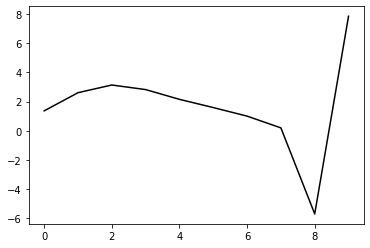

15400 14.348822990782375
0.3840457265082048 -0.27435857111991374 -0.19764326845163885 -0.11707640593738844
[ 1.32322604  2.79598828  3.32033671  3.00529325  2.33221706  1.7662425
  1.17550626  0.36398527 -5.53856188  7.83294388]


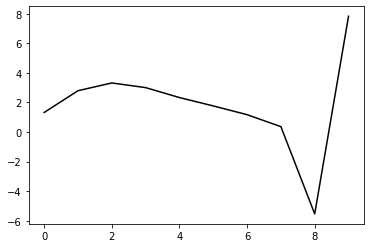

16500 22.339748107769015
0.3823562870182914 -0.2744869478148127 -0.197726384818656 -0.11830625465782453
[ 1.35471827  2.78109119  3.31911735  3.01829722  2.35716707  1.80124912
  1.21962124  0.41485966 -5.48278337  7.88077089]


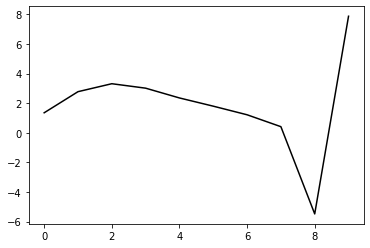

17600 25.178720944943887
0.3812576687056579 -0.27816294334163355 -0.20132031760177085 -0.11322491519952169
[ 1.33190329  2.7150138   3.24489044  2.93915328  2.27347063  1.71314478
  1.12777085  0.31808605 -5.58488504  7.85557717]


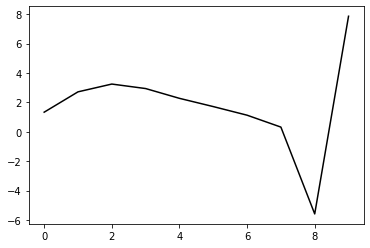

18700 13.713410596413
0.3751173305149665 -0.27860290759730094 -0.2005712944307387 -0.11548862634240233
[ 1.38715264  2.65291089  3.17183661  2.85866663  2.18633633  1.6204018
  1.03123633  0.21860503 -5.68571483  7.85109791]


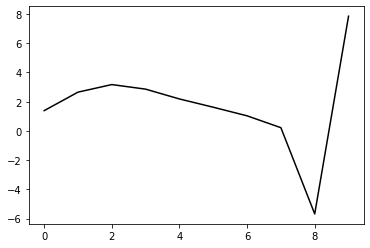

19800 21.632611575731207
0.3836774741103681 -0.27132596812182397 -0.19746486959215329 -0.11834322897164107
[ 1.3490865   2.81182861  3.33573565  3.02645297  2.35568764  1.78973273
  1.19995808  0.38512586 -5.52327458  7.8485163 ]


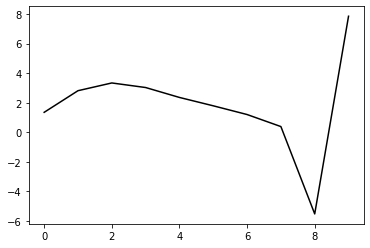

20900 19.598846085911052
0.3851117625937068 -0.27363739346543675 -0.2001260649677794 -0.11462809161377802
[ 1.29072147  2.79843123  3.30852963  2.98818449  2.30702963  1.73156959
  1.13410607  0.31185746 -5.60253556  7.86331232]


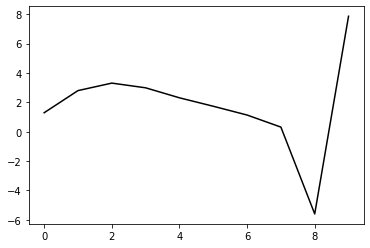

22000 24.05491920267205
0.38581496488468 -0.27931928921337357 -0.2053131553151107 -0.11039183661002486
[ 1.29728749  2.69470446  3.21933406  2.91922094  2.25782676  1.70016084
  1.11856852  0.30825033 -5.59785185  7.80953607]


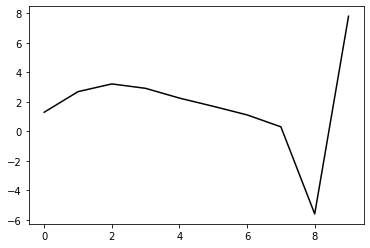

23100 19.788873232867157
0.38457370413349734 -0.2731807915576382 -0.20118803370141852 -0.11352593588737434
[ 1.32724998  2.72960797  3.24666976  2.94215764  2.27666259  1.71495014
  1.1297172   0.31465163 -5.59706874  7.86098395]


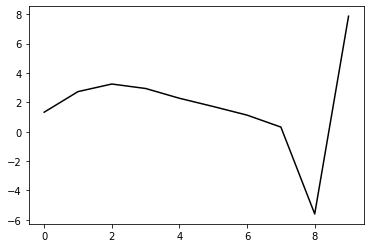

24200 23.914057898661834
0.38281593531938085 -0.27505703772273743 -0.2028165326228225 -0.11324619122285773
[ 1.32262076  2.74002938  3.26776551  2.97423463  2.31772027  1.76335467
  1.18468857  0.37380198 -5.53622387  7.84680414]


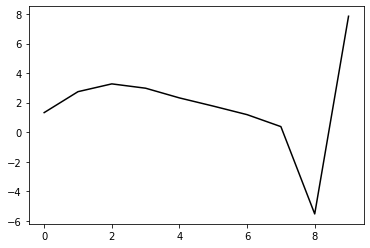

25300 24.806809375015977
0.372937002567394 -0.27282152778373114 -0.19937280554395198 -0.1155277653551672
[ 1.36489476  2.57481816  3.08644259  2.78617552  2.12702454  1.57254923
  0.99609509  0.18773356 -5.72085592  7.83902672]


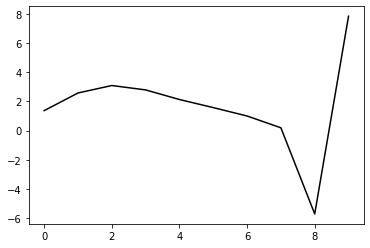

26400 14.66665719203047
0.37930452302964385 -0.2706249119747262 -0.19961939258260178 -0.11473303530420163
[ 1.34720963  2.71392064  3.22173819  2.91750239  2.2523451   1.69070438
  1.1072933   0.29147626 -5.6219452   7.83765467]


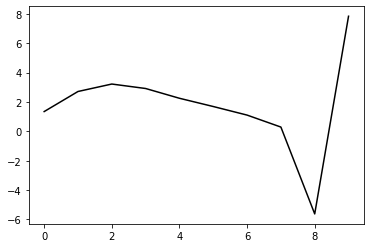

27500 21.631438504499638
0.3772256533304273 -0.27734327916186696 -0.2047961746136973 -0.1119026697013675
[ 1.33269874  2.65076855  3.15688326  2.85458852  2.19129971  1.63120432
  1.04969863  0.23522226 -5.67640734  7.84571247]


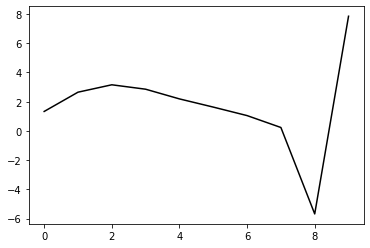

28600 24.21666169489851
0.3861770848785939 -0.2685426167238488 -0.2005832669438876 -0.11648907319571467
[ 1.32870991  2.86735057  3.38270213  3.08750224  2.42830791  1.87008241
  1.28920502  0.47312856 -5.44318833  7.84535525]


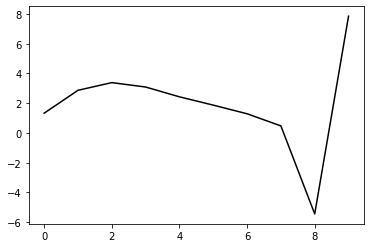

29700 14.899611555153347
0.3840437269914743 -0.26755904064048314 -0.19979142182426438 -0.11681713320092821
[ 1.39375011  2.77779815  3.2981973   3.00996383  2.35708993  1.8044923
  1.22934236  0.41746038 -5.49478557  7.87871521]


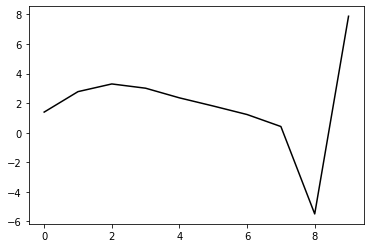

30800 21.779946464563707
0.38103822401653653 -0.2686843469452551 -0.20049197736285024 -0.11705746580126161
[ 1.37794602  2.77074102  3.29739163  3.01691506  2.37061915  1.82332715
  1.25301725  0.44365867 -5.46799267  7.8531243 ]


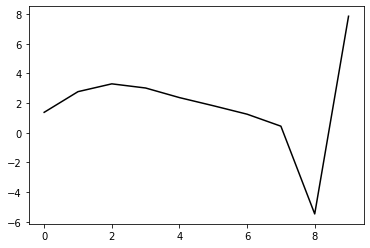

31900 13.52377926454681
0.380707667035092 -0.2665491027400051 -0.199678341608713 -0.11522217121103692
[ 1.34714616  2.80263362  3.32018534  3.03275049  2.37967901  1.82541921
  1.24836279  0.4305933  -5.49092878  7.87847413]


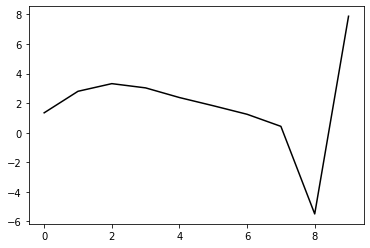

33000 16.529722109960964
0.38385626572883463 -0.26921050185898515 -0.20286402530357955 -0.11191052537019279
[ 1.33300025  2.79928986  3.31275062  3.02270628  2.36644249  1.80864861
  1.22893901  0.40811418 -5.51584304  7.84589621]


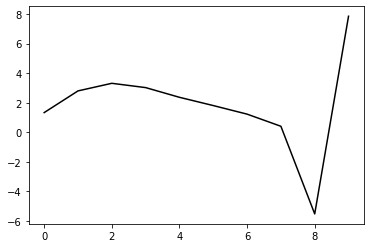

34100 23.4433583949667
0.37599250024233094 -0.2708990042102206 -0.20282734282322523 -0.11211191484144493
[ 1.39489537  2.59584385  3.11207208  2.83207951  2.18826552  1.64366844
  1.07760005  0.26851049 -5.64645933  7.85173346]


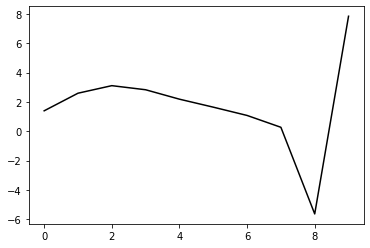

35200 22.192650571715856
0.3766729551935373 -0.2653904607887701 -0.1994996400521113 -0.11378221773061421
[ 1.35643052  2.67454051  3.18358873  2.89724224  2.24623655  1.69388741
  1.12034028  0.30256531 -5.62120142  7.80317257]


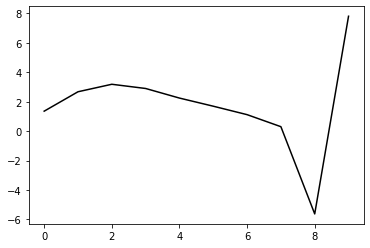

36300 24.13797876779606
0.3743625148149666 -0.2662934512974411 -0.1998674712163446 -0.11474007834841438
[ 1.37490782  2.68506614  3.1983468   2.9188536   2.2743355   1.72787561
  1.16029886  0.34738313 -5.57102895  7.86917438]


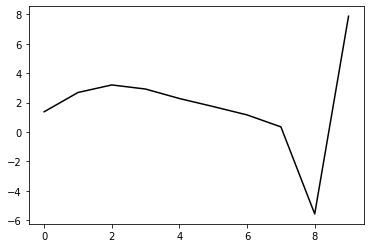

37400 14.12262448596023
0.37741917761298643 -0.266850443242109 -0.20140248623212137 -0.11461838542236549
[ 1.36234718  2.76719952  3.29082971  3.02139172  2.38446652  1.84351968
  1.28051891  0.4699145  -5.44792607  7.84589779]


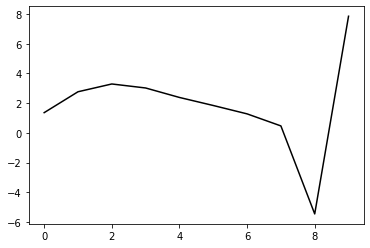

38500 21.949784684414883
0.37701835131189354 -0.2669957972043392 -0.20167286451578958 -0.1148534052915569
[ 1.37218205  2.78108922  3.31193586  3.04959733  2.4171945   1.87859395
  1.31733743  0.50671405 -5.41160721  7.88373509]


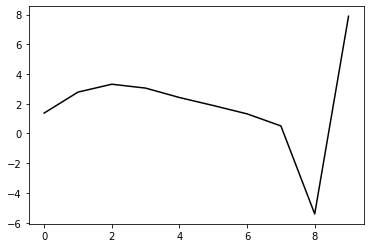

39600 25.325337897760612
0.37800206400505626 -0.267943767289091 -0.2032235913204096 -0.1118054426698913
[ 1.32916365  2.78231976  3.29823653  3.02431978  2.38181339  1.83434514
  1.26621154  0.44870647 -5.47607984  7.8542793 ]


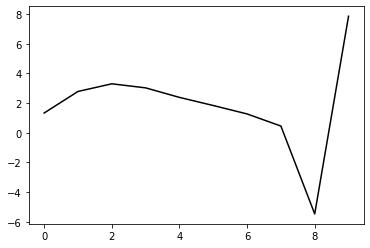

40700 13.6919485296698
0.3795623125407353 -0.264182189530065 -0.2014228499570544 -0.11263246762299577
[ 1.38062937  2.77326789  3.29277807  3.02361461  2.38481301  1.83974324
  1.27365966  0.45596487 -5.47025295  7.88473111]


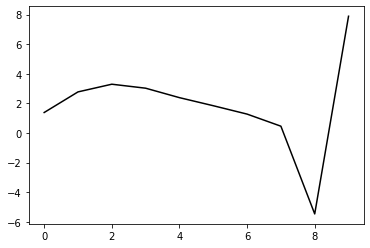

41800 24.65867367975437
0.37216890336104885 -0.2637807557964729 -0.19949228336485011 -0.11609365209503278
[ 1.39603759  2.75325576  3.2603436   2.98325143  2.33908319  1.79080035
  1.2239797   0.40677639 -5.51632428  7.84443395]


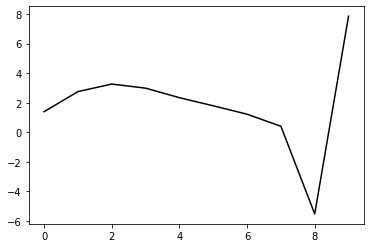

42900 13.51602221524181
0.3782593271783702 -0.2635860081649103 -0.20121342783535293 -0.1142096691755217
[ 1.3539805   2.82467644  3.32648538  3.04552636  2.3975662   1.84555167
  1.27576401  0.45524464 -5.47139765  7.87226282]


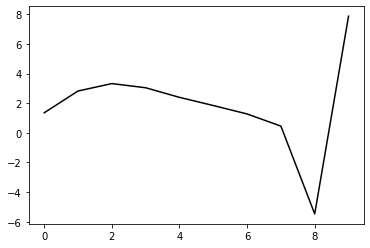

44000 16.201556999034587
0.37802707933034957 -0.2673582873477778 -0.20426876207813469 -0.11201208412217485
[ 1.34821862  2.81771316  3.31895485  3.0379163   2.38899204  1.83543522
  1.26474325  0.44281885 -5.48421193  7.85707721]


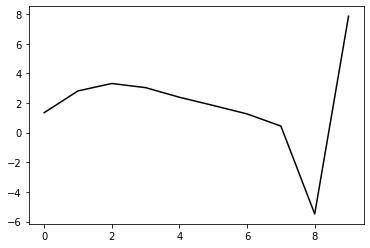

45100 23.37309802371254
0.3734054541983249 -0.2656428294791446 -0.20239958449962148 -0.11332221523104458
[ 1.42273951  2.64851244  3.14996206  2.87526306  2.23483001  1.69027272
  1.1289622   0.31479908 -5.6061536   7.86889739]


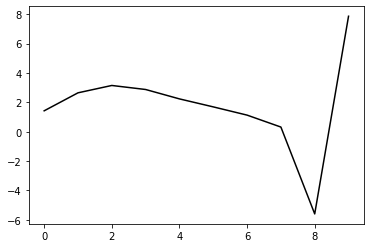

46200 23.40863118696719
0.37554603918646956 -0.26723174998442856 -0.2050126627680245 -0.1106917865267648
[ 1.34237691  2.73345892  3.23783867  2.96686332  2.32884999  1.78516468
  1.22380915  0.4070115  -5.51859027  7.82564544]


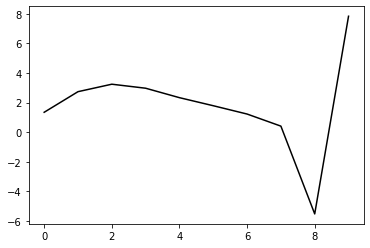

47300 22.756147741553157
0.3712335562768692 -0.26192056763443616 -0.2006471266418635 -0.1104076462255315
[ 1.34339358  2.6579506   3.14482974  2.86247189  2.21595107  1.66537877
  1.09881341  0.27689716 -5.65376542  7.82478149]


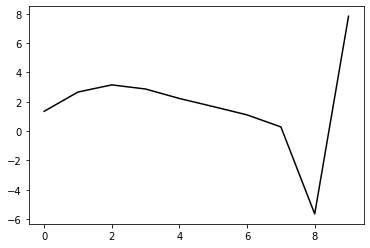

48400 14.016861202617585
0.374477953904158 -0.26237721475074616 -0.2017000129628715 -0.11393390764595066
[ 1.37788664  2.75763041  3.2684469   3.00610091  2.37507286  1.83665296
  1.28038715  0.46662981 -5.45610649  7.89443595]


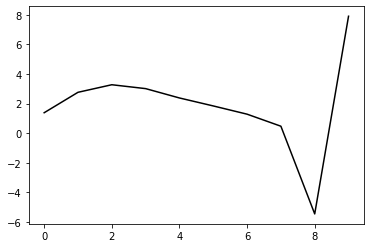

49500 21.50947350440479
0.3686271702264842 -0.27000229787949265 -0.20640989867424542 -0.11004652232147437
[ 1.3390548   2.60819692  3.10010891  2.82614973  2.18719855  1.64324649
  1.08392376  0.26829894 -5.65508285  7.86543542]


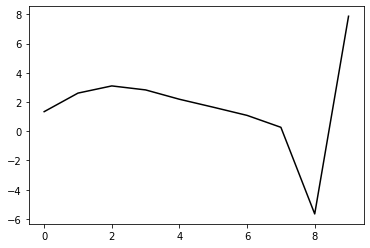

50600 25.101703248438664
0.3750157108392818 -0.26410198218986847 -0.20378674245190495 -0.11198325373973245
[ 1.33642027  2.73756072  3.22293467  2.94263528  2.2965673   1.74510577
  1.17891358  0.35637892 -5.57220113  7.84346712]


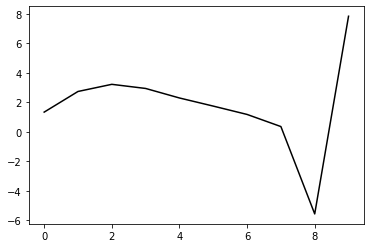

51700 13.181274031732828
0.3708855257080561 -0.26408224082775267 -0.20317070067307125 -0.11452823656756535
[ 1.38804081  2.69690413  3.19333316  2.9248216   2.28859586  1.74505456
  1.18584215  0.36861691 -5.55486927  7.85625057]


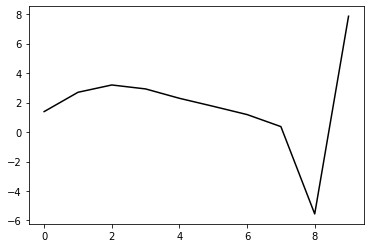

52800 21.878011046305915
0.3731173589436703 -0.2607815549376244 -0.20144381198075798 -0.11677929287698278
[ 1.35786895  2.79852852  3.29131307  3.02030174  2.38121606  1.83451526
  1.27269133  0.45233982 -5.47441121  7.84980254]


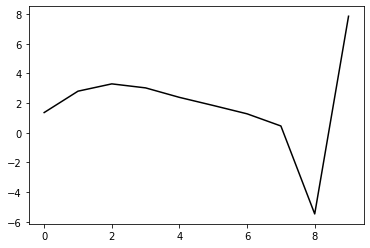

53900 13.390536023361822
0.37356923265943215 -0.26326590458289423 -0.20385581520432985 -0.11479833967483577
[ 1.35141671  2.77662017  3.2752588   3.0107502   2.37680529  1.8337597
  1.27521251  0.45641075 -5.46974259  7.86876146]


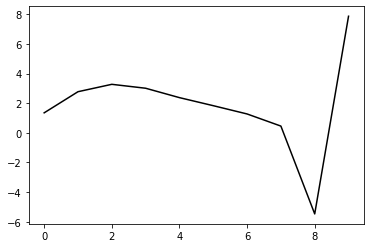

55000 19.781111906376232
0.3771081431640502 -0.2614008273711765 -0.20413384002858465 -0.11263347378480058
[ 1.29663218  2.82154015  3.31914907  3.05510561  2.42113809  1.87685828
  1.31634902  0.49252175 -5.4425605   7.86487267]


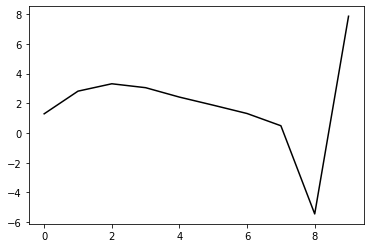

56100 25.930476529593808
0.36713395135309473 -0.26281825634626244 -0.20309437743941908 -0.1139602031825851
[ 1.43380585  2.58215054  3.07123154  2.80454119  2.17076642  1.62841114
  1.07177431  0.25248597 -5.67664227  7.88468138]


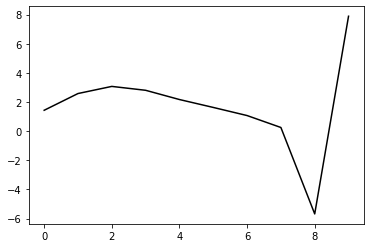

57200 23.75297533997194
0.36800598185556926 -0.2605978182709317 -0.20199132773989747 -0.11433609221603631
[ 1.38754997  2.64951236  3.12213722  2.84133272  2.19437277  1.63961707
  1.07208215  0.24248579 -5.69520195  7.82014056]


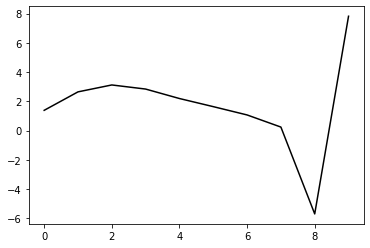

58300 24.006373891372082
0.36811804138917803 -0.2612330116077108 -0.20284763392092872 -0.11504280672305865
[ 1.36982763  2.69710118  3.17666367  2.90255594  2.26051399  1.70913033
  1.14455098  0.31691128 -5.61794476  7.85553797]


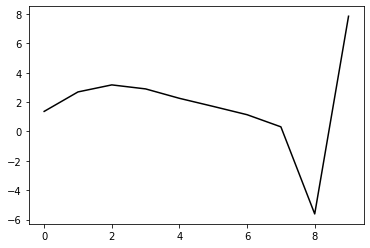

59400 14.283921694536662
0.3703489765590663 -0.26116871065808384 -0.20360764405366713 -0.11507049097083909
[ 1.35413733  2.75570094  3.23635344  2.9644816   2.32399165  1.77336505
  1.20963954  0.38198162 -5.55272535  7.837771  ]


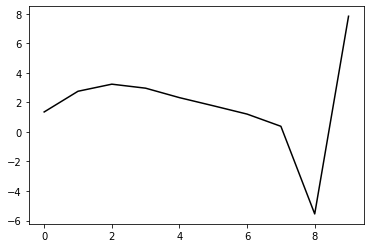

60500 21.903704267402073
0.37185534349583305 -0.25916311576301765 -0.20297220561946325 -0.11456580817626832
[ 1.35621733  2.78402797  3.25890759  2.98211212  2.337302    1.78264151
  1.21570566  0.38408053 -5.55514418  7.87441324]


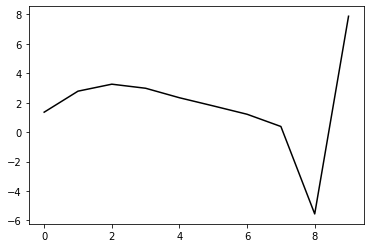

61600 24.752474355607326
0.3723013409323455 -0.26047663246855773 -0.20432008158568776 -0.11348941187117055
[ 1.33235034  2.80682797  3.27661011  2.99694423  2.35027884  1.79426594
  1.22703683  0.39473543 -5.54471329  7.84724259]


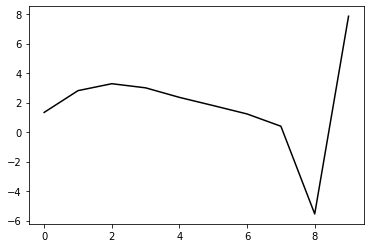

62700 16.41296286254125
0.36998415495969583 -0.25942529897093636 -0.2032061344753026 -0.11720788844773357
[ 1.41146508  2.77326928  3.26688247  3.01009273  2.3832444   1.84384001
  1.29104263  0.46961234 -5.46195096  7.88417349]


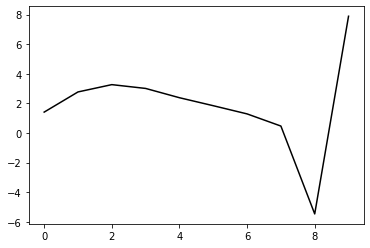

63800 24.02491521805015
0.3686705471541769 -0.26071848964456007 -0.204278481023224 -0.11521149871761283
[ 1.34116101  2.76072553  3.23671011  2.96576971  2.32691855  1.77733885
  1.21714927  0.38948904 -5.54629235  7.82544474]


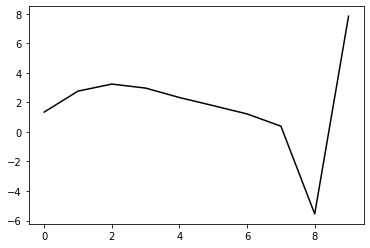

64900 13.360904112622773
0.3700025441318844 -0.26000468357660966 -0.20453781871926113 -0.11450721278281865
[ 1.35306324  2.82087552  3.30436347  3.04235247  2.41080469  1.86584154
  1.30836241  0.47971117 -5.46016488  7.88949586]


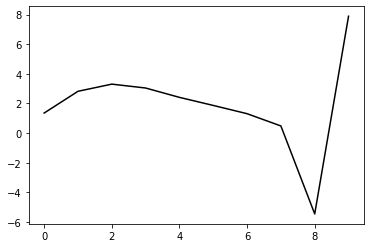

66000 15.760529587152204
0.3736702588177773 -0.25696023224175274 -0.20408084835175597 -0.11197705132028274
[ 1.33265965  2.83608506  3.31578813  3.05178132  2.41903246  1.8727244
  1.31401756  0.48161511 -5.46515624  7.85121663]


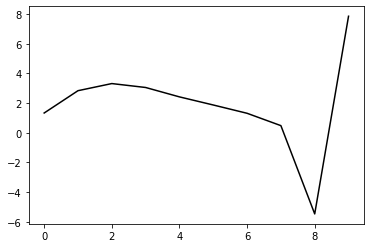

67100 19.526135191037078
0.3702062934400673 -0.2605488506321331 -0.2063135684215785 -0.11065109094790197
[ 1.35585273  2.74037617  3.2203116   2.95867273  2.32883597  1.78552039
  1.23068949  0.40146448 -5.5422801   7.87737102]


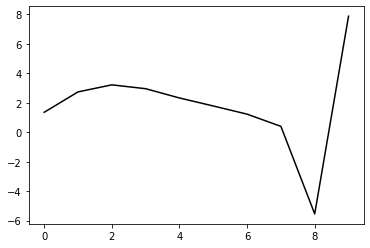

68200 21.897864989519924
0.3674433443064537 -0.2541245336059297 -0.2019133212408123 -0.11135396111628185
[ 1.3591887   2.7046812   3.17740662  2.91084866  2.27700525  1.72954801
  1.1705703   0.33498641 -5.61876181  7.83841917]


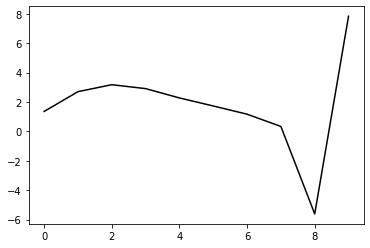

69300 20.700391467299937
0.3685769027290372 -0.25856159535370526 -0.20588423249429305 -0.10948511238252999
[ 1.36356013  2.74883116  3.23720251  2.98598352  2.36573021  1.82999765
  1.28182624  0.45492399 -5.49042317  7.83671153]


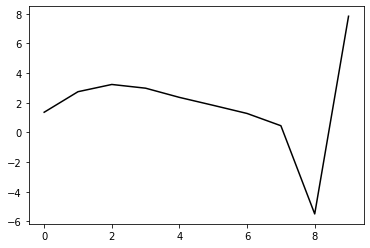

70400 15.938611898409352
0.3615591655393846 -0.25576096065685855 -0.2025068247488812 -0.10960935159329485
[ 1.37463162  2.65175511  3.12269728  2.85871351  2.22853971  1.68479925
  1.13074594  0.29884831 -5.65014793  7.84496581]


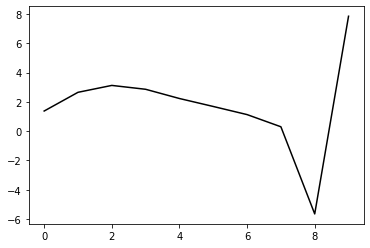

71500 21.821551816701056
0.3699578906737081 -0.25242544740341416 -0.20210091004628047 -0.11215203127020616
[ 1.34660647  2.79141593  3.26372813  2.99959187  2.36784171  1.82156385
  1.2650214   0.43010298 -5.52134789  7.86325037]


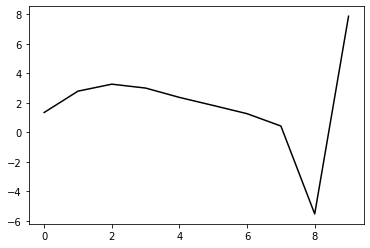

72600 24.267982915264064
0.3674053390620575 -0.25595633005601115 -0.20421222166926759 -0.11315772516692227
[ 1.335945    2.80270415  3.29205452  3.04321225  2.42384492  1.88722989
  1.33889829  0.50992938 -5.43760957  7.85899159]


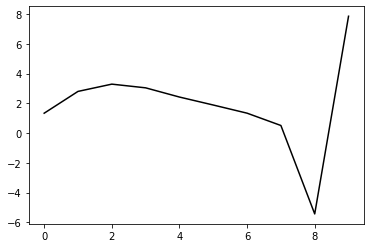

73700 15.802391635466748
0.36437813043254275 -0.2551137284932963 -0.20327923839595452 -0.11423118016537764
[ 1.41767691  2.70885744  3.19706014  2.95148611  2.33733302  1.80667022
  1.26529624  0.44228053 -5.49926619  7.86935274]


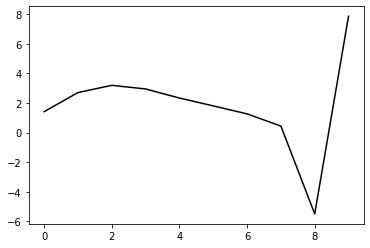

74800 23.78146469528345
0.3660013500501634 -0.2535590804423375 -0.20300710769803038 -0.11312388311689009
[ 1.34632772  2.76175224  3.23565224  2.97622799  2.34836477  1.80415048
  1.25074982  0.41584842 -5.53701368  7.8116174 ]


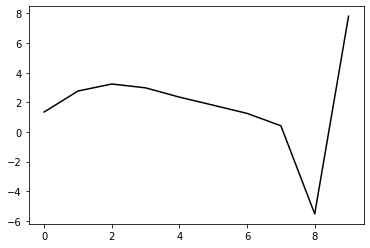

75900 21.286993351707796
0.3674018679624644 -0.2557065394311138 -0.2053189609286327 -0.11142352984762087
[ 1.3076038   2.76634414  3.23822253  2.98043257  2.35603287  1.8158083
  1.26721515  0.43570835 -5.51415553  7.90030085]


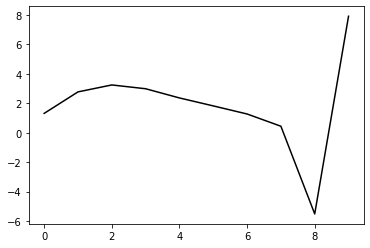

77000 15.57007676958155
0.3689402783656664 -0.25377710398169484 -0.20482878865072826 -0.11117960242635316
[ 1.34217847  2.81735662  3.29769816  3.0486537   2.43094057  1.8948841
  1.34900323  0.51738331 -5.43489712  7.85498557]


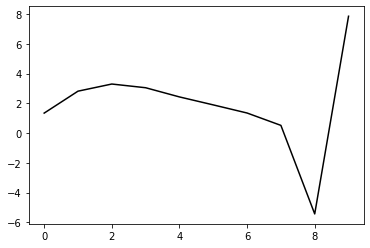

78100 20.614425851310777
0.3696336769904606 -0.24972282072151927 -0.20250172984430964 -0.11058642896977738
[ 1.35118008  2.75238847  3.22227873  2.96734306  2.34612213  1.8075707
  1.26067517  0.42758709 -5.5255763   7.86296927]


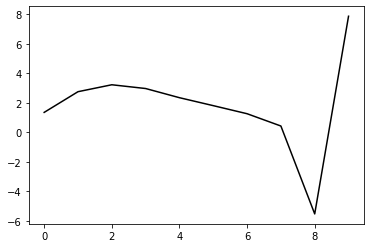

79200 22.464936334957052
0.3622996019563972 -0.2537777486937824 -0.203425973896708 -0.11235642939819195
[ 1.3660405   2.72271243  3.19310013  2.93911621  2.31833335  1.77983883
  1.23395379  0.40200513 -5.54742305  7.86155773]


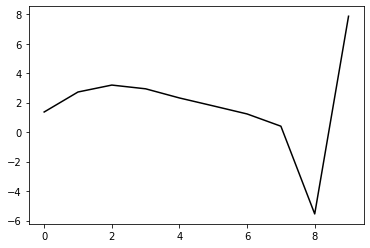

80300 24.50422861185964
0.35967024385213386 -0.25363503456449427 -0.2030207485274322 -0.11324550584548163
[ 1.37830186  2.65146954  3.119139    2.8682799   2.25290188  1.72004983
  1.18010565  0.3530053  -5.59189476  7.87555002]


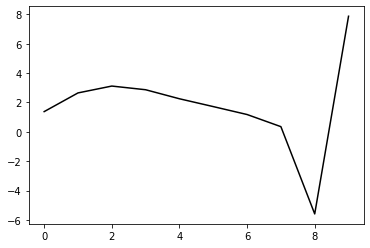

81400 19.823258824797634
0.3567183173395887 -0.26134831801282615 -0.208392179698792 -0.10988437858351456
[ 1.3669058   2.56947621  3.03034693  2.7771503   2.1604573   1.62656777
  1.08679545  0.26044417 -5.68204254  7.81164302]


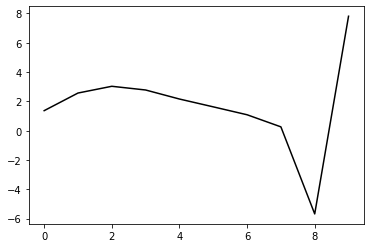

82500 22.78704015983061
0.3639248541549179 -0.2515462491619524 -0.20283741394129318 -0.11546106571218837
[ 1.37737     2.78980357  3.24772017  2.98849844  2.36412803  1.82178304
  1.27392507  0.43910483 -5.51116227  7.87367174]


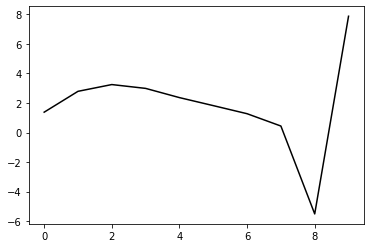

83600 24.297542780214474
0.3674551389322044 -0.2528068321484137 -0.20515918205592348 -0.1124693027857946
[ 1.34356606  2.80323463  3.25188246  2.9862073   2.35718387  1.81098603
  1.26032512  0.42232452 -5.5308886   7.85160177]


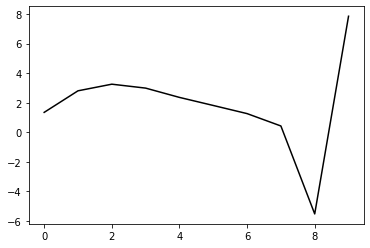

84700 13.710488445815288
0.36788739921062513 -0.25117063871749 -0.2043073124392924 -0.1143072921778887
[ 1.38243318  2.79990842  3.26733137  3.0174989   2.40126896  1.86494065
  1.32250355  0.49004554 -5.4598359   7.82914064]


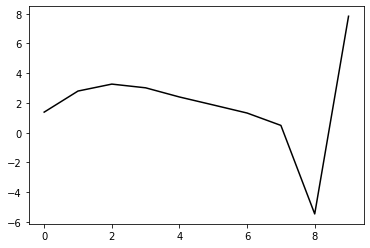

85800 24.854158764981463
0.3587896788354575 -0.2554386145478367 -0.20529600390026867 -0.11601215724035091
[ 1.3872952   2.68702116  3.12854266  2.86054961  2.23154928  1.68630039
  1.13889302  0.30446229 -5.64308711  7.82135366]


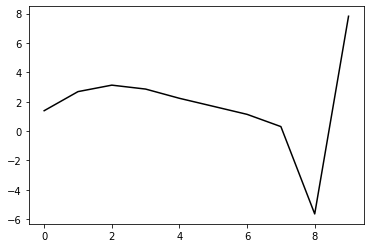

86900 14.493234926019603
0.3693972831791723 -0.25079244416906754 -0.20446664904725043 -0.11600372647495161
[ 1.32602752  2.86847612  3.30421605  3.0300973   2.39519009  1.84409124
  1.2913958   0.45092337 -5.50481157  7.8379574 ]


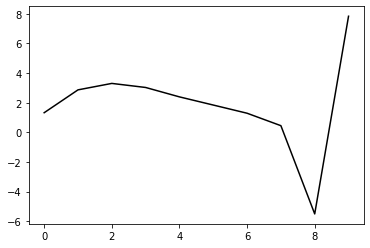

88000 18.93111918711335
0.37132941562209193 -0.2517005038193199 -0.20619816730297244 -0.11354561321106497
[ 1.29777766  2.8899311   3.32303178  3.04632297  2.40905018  1.85528418
  1.30006546  0.45580711 -5.50431204  7.86130971]


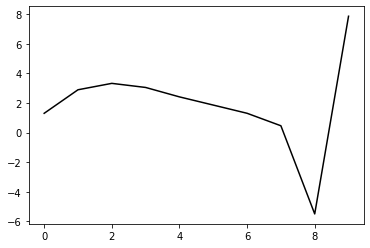

89100 19.962536247813333
0.3687939928199949 -0.2532294071230062 -0.20711144301159914 -0.11293750131932631
[ 1.3293428   2.79848419  3.23504496  2.9622638   2.32926119  1.77963658
  1.22908175  0.38877114 -5.56691154  7.86246953]


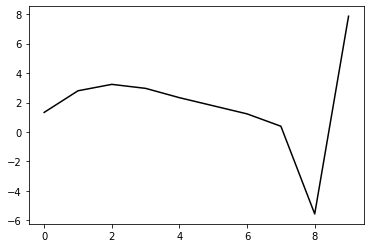

90200 22.470684213335254
0.366626642110568 -0.2504911112462247 -0.2051084226153777 -0.11300329785809438
[ 1.34476338  2.7594916   3.19318594  2.91855555  2.28454395  1.73402168
  1.18314388  0.34145092 -5.61708252  7.84142075]


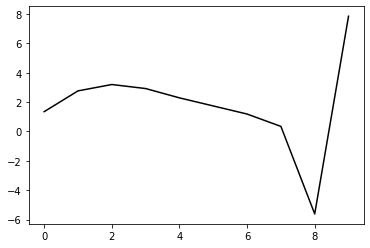

91300 20.765557739799448
0.3639096341855838 -0.2546470872591107 -0.2079326294796401 -0.11261852881148232
[ 1.33933614  2.77093211  3.21925685  2.9599295   2.34087558  1.80418277
  1.26637627  0.43503818 -5.51506691  7.8847802 ]


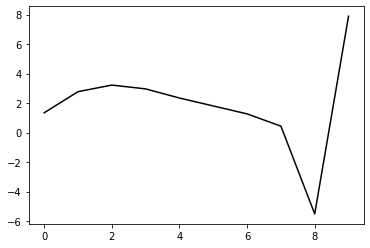

92400 17.781786661499055
0.35812371074175947 -0.2554430542941736 -0.20752010623462094 -0.11203496819066615
[ 1.35816005  2.65457137  3.08704878  2.81776544  2.19309966  1.65364175
  1.11577026  0.28510773 -5.66353799  7.8301251 ]


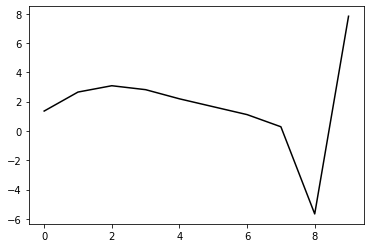

93500 21.97925899985809
0.3590859063473881 -0.2586768175898625 -0.2106038906841839 -0.11073430780906844
[ 1.34135925  2.66993263  3.09519264  2.82032755  2.19089338  1.64704873
  1.10566732  0.27154079 -5.67921611  7.85095676]


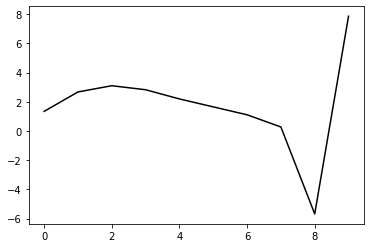

94600 25.20816938382679
0.3654551995330591 -0.2518960383202673 -0.20732376222646154 -0.11235922663822986
[ 1.33251714  2.81134791  3.22481989  2.93848738  2.29819152  1.74394313
  1.19324652  0.35012034 -5.60811249  7.83864287]


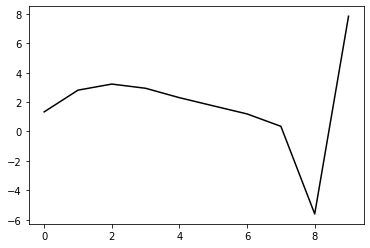

95700 13.780055763648752
0.36434825771504986 -0.2493627240790912 -0.2052336260537247 -0.1163859057367646
[ 1.38761098  2.82029444  3.24715371  2.97181392  2.34037963  1.79314906
  1.24874124  0.41061078 -5.54282675  7.85692411]


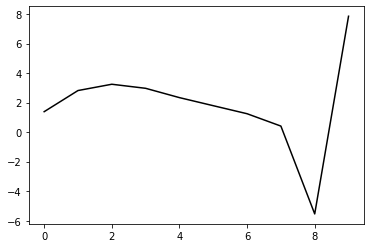

96800 22.7816161102429
0.36723618877813574 -0.250094615004099 -0.2068904517216003 -0.1137951485025954
[ 1.30186522  2.82138176  3.23073652  2.93951465  2.29526783  1.73759817
  1.18547503  0.34070159 -5.61784128  7.84481487]


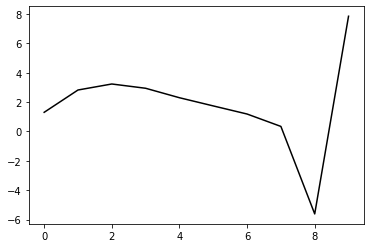

97900 22.403390327349875
0.3677730767629163 -0.25027538851595826 -0.20735674511544872 -0.11428035400446401
[ 1.29352472  2.8376302   3.2516984   2.96692496  2.32984834  1.77881974
  1.23294477  0.39264852 -5.56223611  7.87472636]


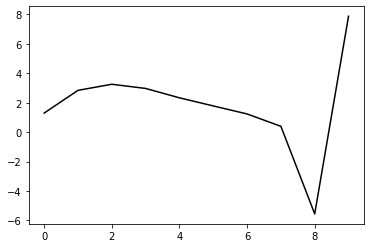

99000 27.01899787281888
0.36675456755165714 -0.25734101493119227 -0.2128807326186414 -0.11022547446168929
[ 1.30212775  2.72853887  3.15641405  2.88758443  2.26591956  1.72852105
  1.19497454  0.36475736 -5.58097098  7.81004198]


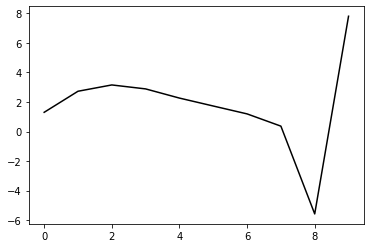

100100 24.549568831710598
0.3603093944190761 -0.250870678528795 -0.20656325911606557 -0.1161633502165783
[ 1.41462692  2.6394297   3.0607347   2.78842405  2.16481127  1.62607015
  1.09218571  0.26161725 -5.68348567  7.87378713]


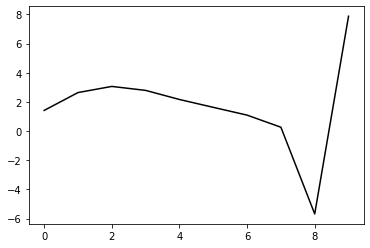

101200 25.2357752940892
0.35903043511435556 -0.24787081787405832 -0.20462894592702424 -0.11795532873870263
[ 1.37939459  2.70180146  3.12034691  2.84568102  2.21978748  1.67834536
  1.14170056  0.30723833 -5.64181898  7.81364334]


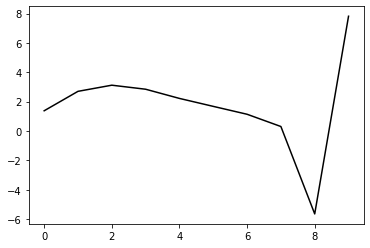

102300 24.553956508623116
0.3588387525794351 -0.2483215779029338 -0.20541394623743423 -0.11685835275151164
[ 1.36644887  2.70025756  3.11584591  2.83923285  2.21199846  1.66934876
  1.13213537  0.29681344 -5.65258207  7.86472762]


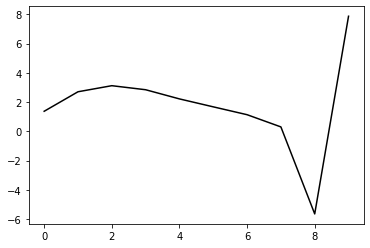

103400 14.362126692137199
0.36113721073245497 -0.2493930612007522 -0.20708094999352739 -0.1162397208189283
[ 1.34883217  2.77285386  3.19070031  2.91555649  2.28904306  1.74630879
  1.20904124  0.37295461 -5.57623828  7.83685741]


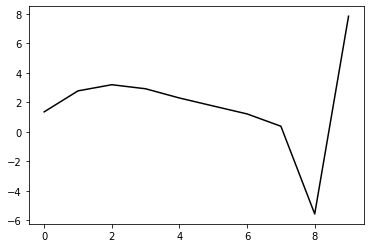

104500 22.00304110876834
0.3624958279322461 -0.24896096501791495 -0.20726738208316733 -0.11699663558751137
[ 1.35680124  2.79474681  3.22300692  2.95655353  2.3372327   1.80014735
  1.26789514  0.43519355 -5.51173988  7.87450844]


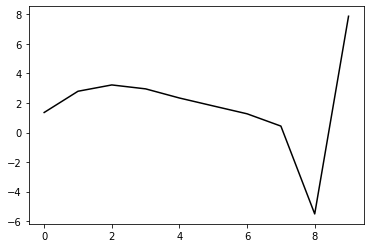

105600 24.291742078065802
0.3640173739673902 -0.2462012357272273 -0.20600547079695042 -0.11697414323554747
[ 1.33419927  2.86794025  3.28691279  3.01092003  2.38300182  1.83776209
  1.29819599  0.45742325 -5.49796691  7.85424889]


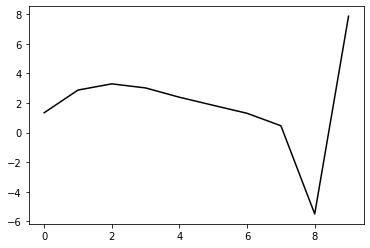

106700 13.315577561117268
0.3619453066065117 -0.24701234334726538 -0.20641381760291969 -0.11660807445815197
[ 1.37563402  2.79196499  3.21700939  2.94760638  2.32617022  1.78675459
  1.25303663  0.41710962 -5.53346084  7.86926832]


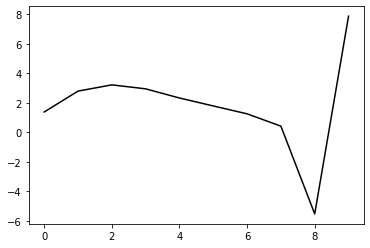

107800 25.727704511804813
0.3581849277578671 -0.24623547784444888 -0.20535288967421933 -0.1195942133838353
[ 1.38686947  2.80975385  3.2386616   2.97349941  2.35587809  1.81938569
  1.28836738  0.45402599 -5.49503995  7.85007836]


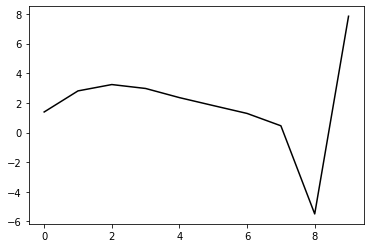

108900 16.99133913600682
0.36133587149323737 -0.24916920526638475 -0.20869280333154797 -0.11672736318717647
[ 1.29984635  2.77171773  3.18802943  2.91519978  2.29295288  1.75331638
  1.22058561  0.38455124 -5.56499445  7.87693518]


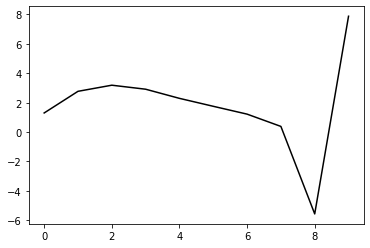

110000 17.582550299062582
0.3633631180989243 -0.25125586895631435 -0.21122794654190738 -0.11375126383261668
[ 1.31794096  2.77630546  3.19513286  2.92445596  2.30366317  1.7646113
  1.2323089   0.3957345  -5.55399719  7.82664971]


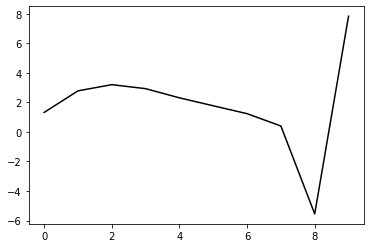

111100 20.708156702140073
0.3655657654639917 -0.2438451207701573 -0.20662809489610443 -0.11577267334420428
[ 1.3313171   2.80862895  3.21842571  2.94016802  2.31333639  1.76883173
  1.2317668   0.38955783 -5.56694551  7.86499796]


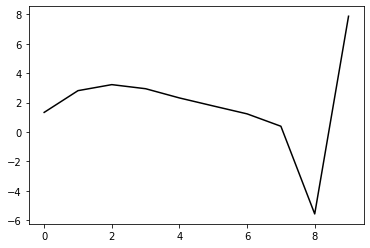

112200 22.855270800726476
0.3642061121177669 -0.24020229042354946 -0.20408718478680354 -0.11632611852997082
[ 1.35301631  2.78925641  3.19718111  2.91673275  2.28858537  1.74301794
  1.20562284  0.36209965 -5.59677386  7.85164711]


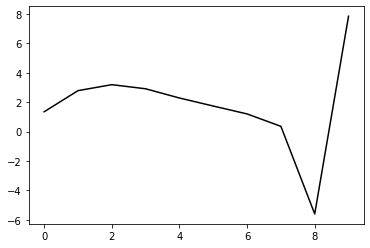

113300 21.68080540161096
0.3612621173420073 -0.24768695193188967 -0.2088815015455754 -0.11461342322975021
[ 1.30463968  2.79402255  3.20329479  2.9230203   2.29449435  1.748054
  1.21041634  0.36655817 -5.59046132  7.82635828]


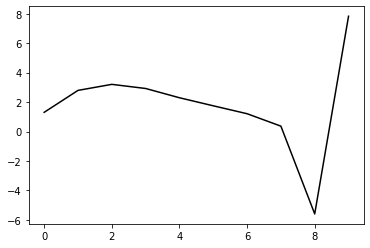

114400 14.240151388057603
0.359770106583456 -0.24413382179760093 -0.20613623944586207 -0.11701660148206681
[ 1.33092889  2.80910156  3.22311936  2.94679252  2.3215436   1.77741798
  1.24187252  0.39882024 -5.55772031  7.82157475]


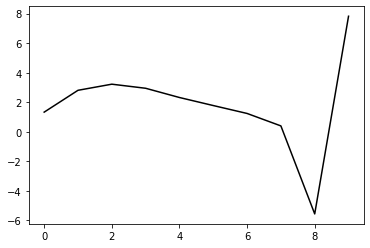

115500 22.04967663258105
0.3627155695362595 -0.24111989373064105 -0.2048100895109223 -0.11711018672042617
[ 1.3274379   2.83594399  3.25188984  2.9765093   2.35192528  1.80792413
  1.27281836  0.42934663 -5.52815952  7.84939026]


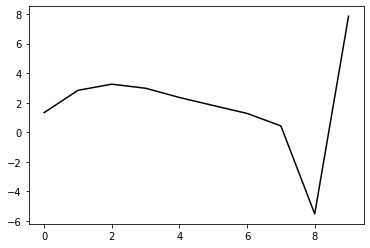

116600 26.07863438581925
0.3629485804116206 -0.24314888430391318 -0.20643074969683242 -0.11693182177228167
[ 1.28888252  2.90129456  3.32607836  3.05777462  2.43909812  1.89960011
  1.36887482  0.52817843 -5.4283566   7.87050003]


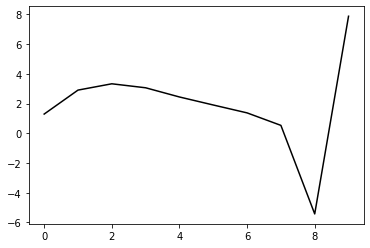

117700 13.13570677005158
0.36090122533432606 -0.24269612482858344 -0.20550250716290044 -0.11820533942471469
[ 1.35339912  2.79567946  3.21486135  2.94320265  2.32372271  1.7853887
  1.258423    0.42274692 -5.52523699  7.81477973]


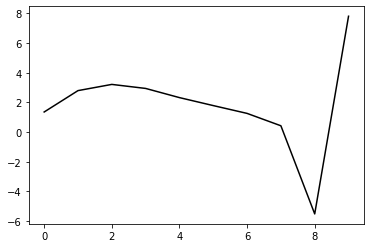

118800 26.60222322632786
0.354595213137671 -0.24412646066022586 -0.2053347942072681 -0.12149066553164611
[ 1.37452294  2.79016956  3.21300981  2.94459002  2.32832964  1.79325923
  1.27036446  0.43861787 -5.50475298  7.84013053]


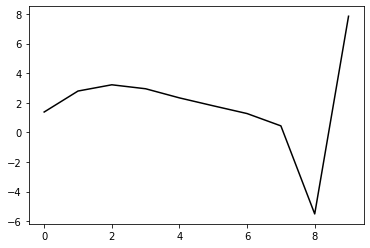

119900 19.794279496699367
0.35839854153574713 -0.24727659814825745 -0.2091551871569877 -0.11773442430211918
[ 1.28007241  2.76860216  3.17514161  2.89441833  2.26883392  1.7261903
  1.19741656  0.36018387 -5.58671858  7.87549611]


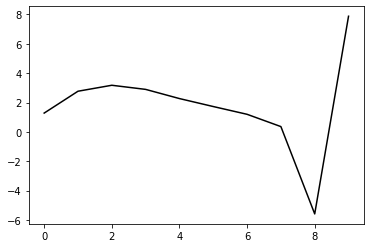

121000 17.825437715916422
0.3596727170029365 -0.2503122062376651 -0.21206896085216573 -0.11597225393448786
[ 1.30035249  2.76603711  3.18105369  2.90816026  2.28935711  1.75228177
  1.22859769  0.39520442 -5.54794128  7.82684116]


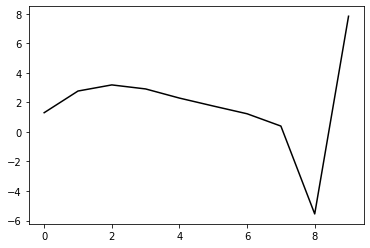

122100 22.91749035946259
0.3555027425194455 -0.24565681766843878 -0.20790484477051208 -0.11917747166462503
[ 1.38856354  2.65126392  3.06901321  2.80060511  2.18657597  1.65371661
  1.13401143  0.30331137 -5.63757134  7.88309066]


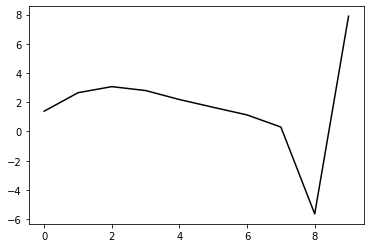

123200 23.8605810707597
0.35334294012678924 -0.2447109328212245 -0.20719796207625416 -0.11928297017379837
[ 1.36474367  2.63426053  3.05090157  2.78276099  2.16932905  1.63672572
  1.11729332  0.28587838 -5.65609163  7.81644422]


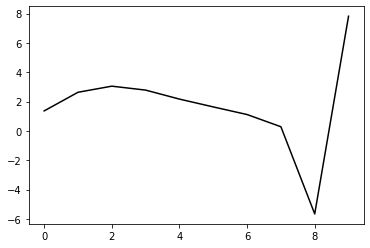

124300 21.46091403361496
0.3571052100083958 -0.24473731569111007 -0.20879880527811165 -0.11632718768847963
[ 1.30356559  2.74775556  3.1536005   2.87450452  2.25121067  1.70949848
  1.18206195  0.34241292 -5.60750927  7.8704702 ]


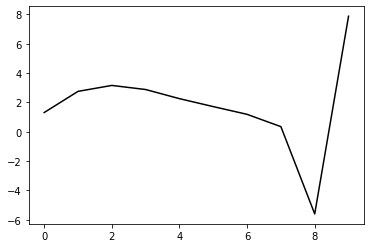

125400 17.313874411946564
0.3568219142670866 -0.24068908861480942 -0.20599777140506031 -0.11851444876412333
[ 1.38063836  2.7544509   3.17536348  2.90908031  2.29655318  1.76358065
  1.24371116  0.40952147 -5.53604415  7.83942544]


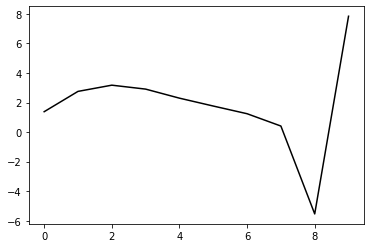

126500 21.968716035336538
0.3560333236995472 -0.24437865996524233 -0.20891520850327736 -0.11813485639473376
[ 1.33923288  2.76566783  3.19538037  2.93776796  2.33350442  1.80771348
  1.29440114  0.4643847  -5.47981458  7.86042097]


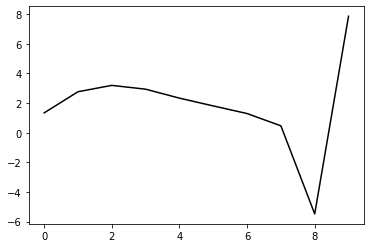

127600 24.438551493641157
0.3588977955681757 -0.24158179358261855 -0.20785061987610917 -0.11838259454274631
[ 1.31909021  2.87383019  3.30482332  3.04648742  2.44019248  1.91091763
  1.39367772  0.5580013  -5.39342764  7.82016961]


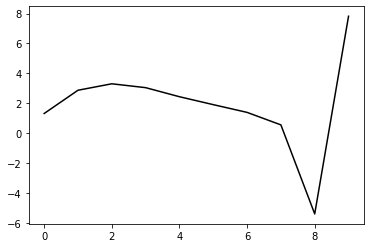

128700 16.184373606570333
0.3535285488366367 -0.24324859329891757 -0.20814143044515085 -0.11741996500107323
[ 1.41048632  2.63809116  3.06778618  2.81139163  2.20908323  1.68484732
  1.17426289  0.34532506 -5.59783165  7.86838055]


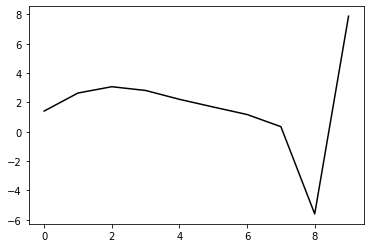

129800 23.42977241299754
0.35705694035129215 -0.24158542917032566 -0.20820004315781254 -0.1165178368861165
[ 1.31373492  2.76431355  3.18337874  2.91539633  2.30144342  1.76558144
  1.24443343  0.40460908 -5.5489959   7.84762523]


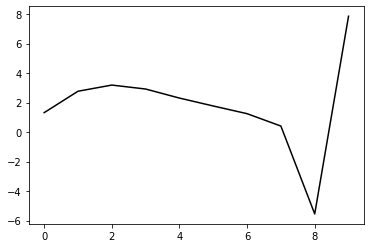

130900 28.908273184453886
0.3575803403013277 -0.24473499347597247 -0.21115599687563782 -0.11462554802077661
[ 1.27678795  2.74657018  3.16764099  2.903676    2.29472201  1.7637856
  1.24776569  0.41147788 -5.53911685  7.9009063 ]


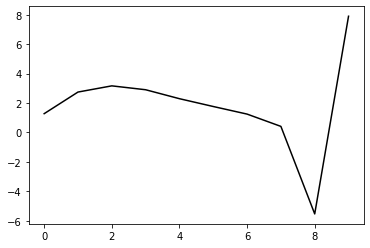

132000 16.45184764404997
0.35966350752700804 -0.23991902536422627 -0.20848578389296907 -0.1155914936314998
[ 1.29727608  2.82337885  3.24150765  2.97408777  2.36123849  1.82577703
  1.30519682  0.46311858 -5.49449959  7.86503152]


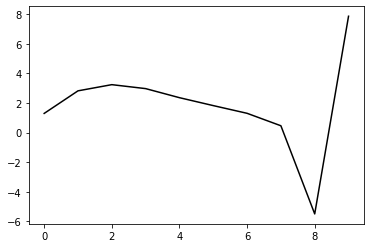

133100 19.835341903582815
0.35853344448185315 -0.24196876390045238 -0.21027586310839047 -0.1137608936446051
[ 1.316702    2.71169645  3.13985994  2.88274193  2.27998269  1.75375761
  1.2421175   0.40730913 -5.54378469  7.86090058]


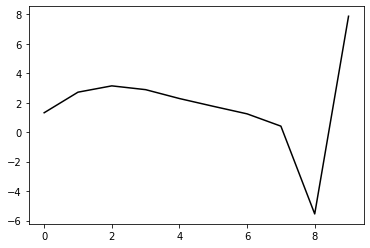

134200 21.619584002207603
0.35433686161260525 -0.24196557542417918 -0.2096997971765181 -0.113650738401049
[ 1.37492927  2.63164165  3.0556235   2.79593894  2.19163364  1.66427643
  1.15247888  0.31691923 -5.63538005  7.8302017 ]


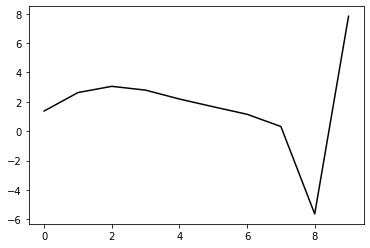

135300 23.222677337805706
0.35219455744722233 -0.24086105171985028 -0.208718269399707 -0.11424094803566857
[ 1.35793068  2.65110556  3.07668413  2.81883424  2.21614057  1.68994924
  1.17968413  0.34492432 -5.60547019  7.83232142]


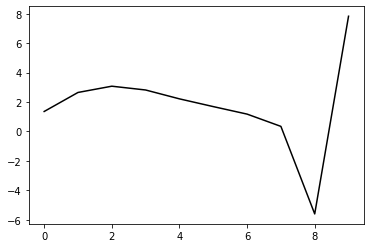

136400 16.217444618452234
0.35439595020195486 -0.23883135424443622 -0.20793757873012828 -0.11609093522601384
[ 1.39479522  2.7136656   3.15229954  2.90572027  2.31247245  1.79404293
  1.29094487  0.46192152 -5.48301131  7.89172511]


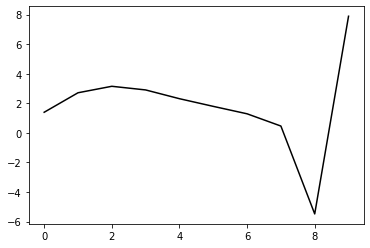

137500 21.9823620898034
0.3541000904173485 -0.23953796409254022 -0.20867184233268396 -0.11735323491131908
[ 1.3650291   2.7974232   3.24407347  3.00343398  2.4141843   1.89784137
  1.39590171  0.56610978 -5.38109655  7.88934356]


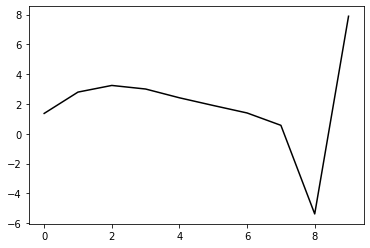

138600 24.895509186450592
0.3513538969626445 -0.24100315233718306 -0.2095900295382542 -0.11419239321104684
[ 1.3417153   2.69331977  3.12311809  2.86897727  2.2690033   1.74384374
  1.23513084  0.39935194 -5.55193924  7.84786587]


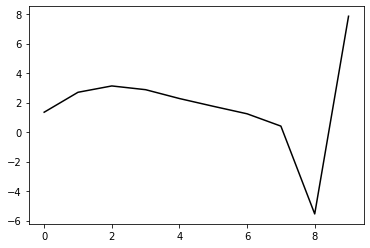

139700 14.109665648469534
0.35432518777138755 -0.2372489780182284 -0.20788460169974204 -0.11709572196599448
[ 1.37639104  2.75627794  3.19916503  2.95602361  2.36506023  1.84701569
  1.3443416   0.51257206 -5.43627973  7.93027293]


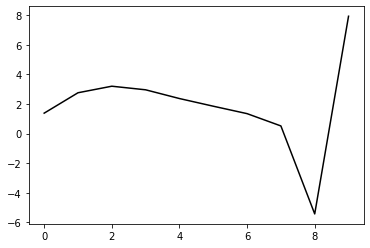

140800 21.84364125682391
0.3487947950162217 -0.2378208243907679 -0.20737144890081882 -0.11669106016303371
[ 1.36406586  2.73616071  3.17410843  2.92702312  2.33263731  1.81133104
  1.30610588  0.47148397 -5.47952177  7.86987557]


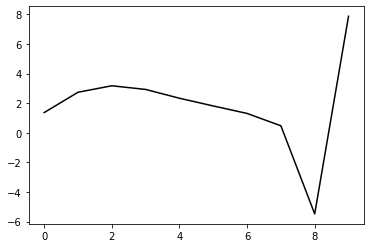

141900 25.874999001612903
0.3518663414332328 -0.2416173117373444 -0.2112719225012252 -0.11182547802765747
[ 1.29190476  2.69659291  3.10858837  2.83816807  2.22343056  1.68453658
  1.16524065  0.31899302 -5.64128784  7.84997978]


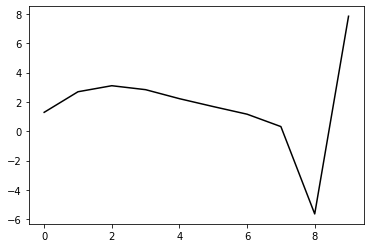

143000 18.812665125581187
0.3570747220524727 -0.238943504743272 -0.210773277586508 -0.11358549770948088
[ 1.29871905  2.86626182  3.28664695  3.01948458  2.40409267  1.86166084
  1.33758287  0.48467518 -5.48362539  7.85537386]


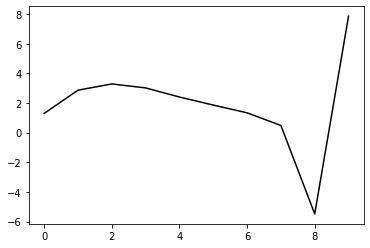

144100 21.52041409838157
0.3542349433381624 -0.23450704093361113 -0.20726045829160045 -0.11545292544936117
[ 1.38705851  2.76801264  3.1850231   2.91561429  2.29925565  1.7564593
  1.23289344  0.37998967 -5.58742879  7.88965525]


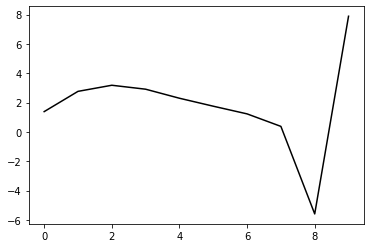

145200 24.045892637951436
0.34858741607818394 -0.237187290135447 -0.20797921894105617 -0.11624103722302681
[ 1.38085441  2.71374626  3.13093773  2.86244734  2.24757167  1.70644827
  1.18528647  0.33450481 -5.63033248  7.81488117]


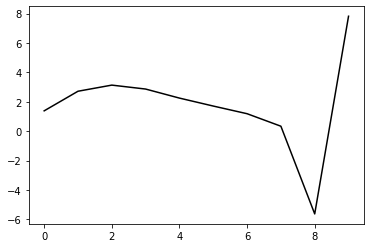

146300 21.229117912982495
0.3515480066666067 -0.23950236244418288 -0.2106349847016184 -0.11317149381028078
[ 1.32683333  2.7829191   3.1965738   2.92440685  2.3060567   1.76162829
  1.23819462  0.38522437 -5.58041583  7.84959779]


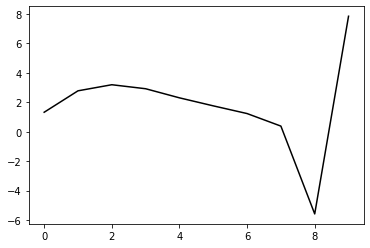

147400 14.082352548575436
0.351712374960711 -0.23746837989862446 -0.20944680740435814 -0.11497642682662952
[ 1.36451269  2.79489812  3.22445349  2.96571972  2.35859928  1.82319409
  1.30760713  0.46039976 -5.50058552  7.84821746]


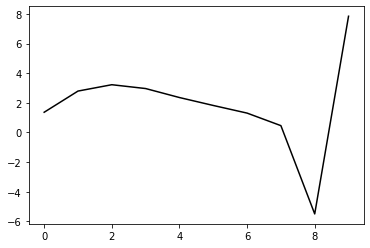

148500 22.02085699736204
0.35013612119509807 -0.2384182962165309 -0.20957358123468814 -0.11697469782820494
[ 1.35693893  2.82538682  3.25260127  2.98947248  2.37736498  1.83705924
  1.31801971  0.46811231 -5.49339182  7.88381394]


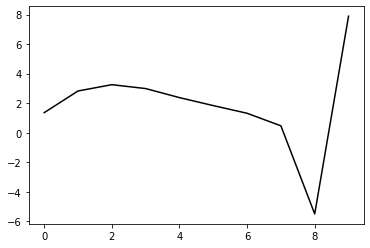

149600 24.811322152934725
0.3522835418836179 -0.23917465367865992 -0.21099105102282678 -0.11722621675045586
[ 1.32668142  2.92826089  3.36651252  3.11079596  2.5033938   1.96540368
  1.44752391  0.59671458 -5.3685898   7.85187089]


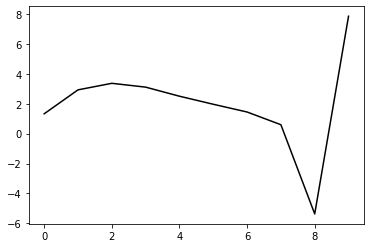

150700 13.373431035258717
0.3475693226596972 -0.23871852933324256 -0.21048901342371076 -0.11330066298381045
[ 1.40010552  2.70248245  3.12143142  2.8505684   2.23216206  1.68602658
  1.16273825  0.30725338 -5.66283541  7.84283603]


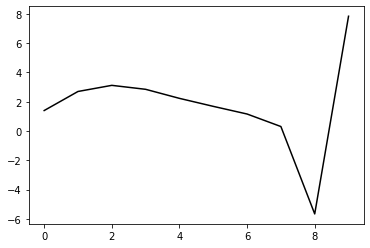

151800 22.037178176367423
0.35181938570635224 -0.2328172685475012 -0.20765459516439308 -0.11565573988453813
[ 1.35506989  2.84681257  3.26952838  3.00089501  2.38359954  1.83733011
  1.31339547  0.45561351 -5.51675439  7.85449554]


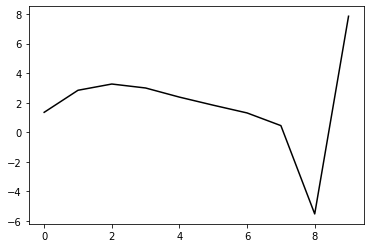

152900 18.140761086872246
0.3438335753248013 -0.23582699185347675 -0.20769686628965506 -0.11557366728371973
[ 1.36063327  2.60405657  3.00668779  2.72514018  2.10001854  1.5491754
  1.02373473  0.16609523 -5.80475377  7.87353552]


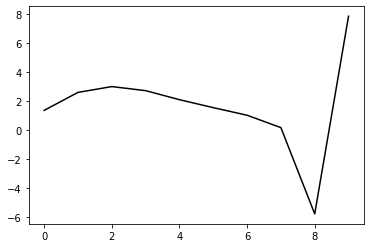

154000 16.14623515073408
0.35579847025358596 -0.23511944260309603 -0.21056988415257316 -0.114546745243269
[ 1.31378738  2.8831725   3.27613736  2.98305247  2.34661189  1.78509358
  1.25022118  0.38361287 -5.59417721  7.85410906]


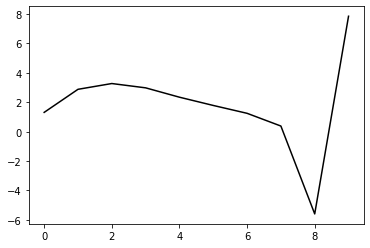

155100 19.954803624275822
0.35706282146410606 -0.23684767557923758 -0.21249195963893536 -0.11306769875363117
[ 1.32615831  2.83719307  3.23804715  2.95036531  2.31808419  1.75971323
  1.22785195  0.36328177 -5.61275568  7.85686191]


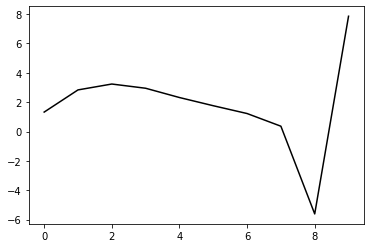

156200 21.534846369978542
0.34915723689659905 -0.2360436435301875 -0.21012882553535947 -0.11477225929713125
[ 1.3483935   2.74029053  3.13852285  2.85051927  2.21958588  1.66320942
  1.13414594  0.27194251 -5.70143929  7.81798005]


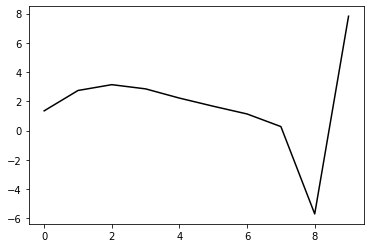

157300 20.889510744050746
0.354028922581035 -0.2368635096179574 -0.21237371487527026 -0.11391520450513867
[ 1.34007971  2.8038591   3.2157072   2.93861002  2.31651557  1.76717225
  1.2442169   0.38657884 -5.58244453  7.86111275]


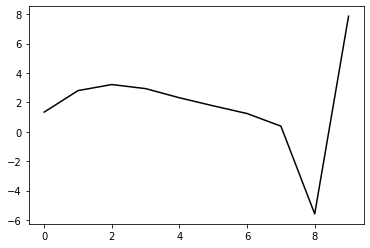

158400 15.60004016433829
0.35055213870910673 -0.23681292652920277 -0.2121313379122335 -0.11321570191296172
[ 1.37374937  2.7398847   3.14842127  2.86774263  2.2425528   1.69029427
  1.16504266  0.30460131 -5.66773264  7.83866286]


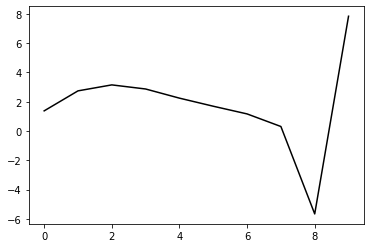

159500 21.99348591070394
0.35118623990623304 -0.23392808724667008 -0.21021396560346847 -0.11779575409866194
[ 1.36435323  2.86968362  3.29756116  3.03288733  2.42085435  1.87915884
  1.36280533  0.50875224 -5.45888216  7.8441374 ]


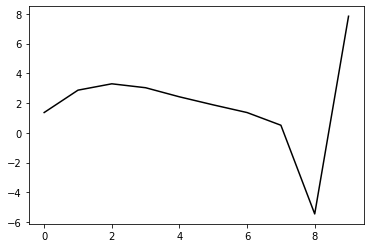

160600 26.188041152712408
0.347827599679625 -0.2417131645353098 -0.21559562385428066 -0.11213984286662414
[ 1.34314295  2.75519925  3.16767192  2.88970033  2.26643     1.71507608
  1.19109226  0.33047351 -5.64206285  7.81184736]


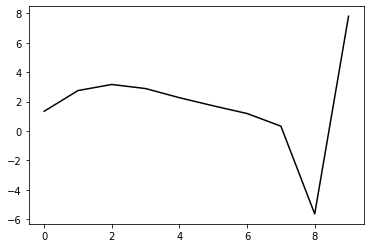

161700 13.910247500545804
0.3500148128456669 -0.2338701141912918 -0.21022502732640164 -0.11792154965553402
[ 1.38400943  2.81773288  3.22693648  2.94476431  2.3169761   1.7610026
  1.23318056  0.36899727 -5.60563827  7.84660358]


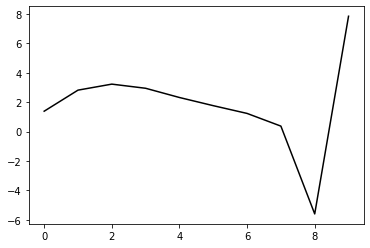

162800 22.191647717771268
0.3502842353166876 -0.23339995801986999 -0.2101594891285344 -0.11825418519274677
[ 1.35616975  2.8418531   3.25112664  2.96741686  2.33766478  1.77938266
  1.24982921  0.38362276 -5.59275205  7.77201577]


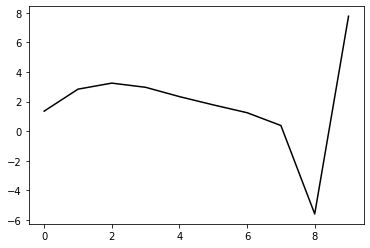

163900 13.596804277274854
0.35332138331606044 -0.23353825694364239 -0.2114945329443357 -0.11624275203244429
[ 1.34531706  2.88943263  3.30183807  3.01928272  2.38972606  1.83048189
  1.29964041  0.43059048 -5.54987689  7.84901711]


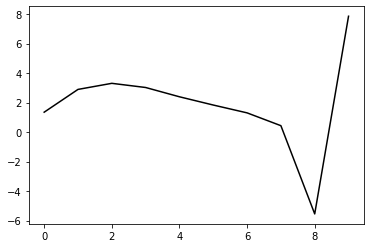

165000 16.056409318709743
0.3534779955449668 -0.23605640880404227 -0.21371212610540233 -0.11478390731441246
[ 1.3487672   2.88937758  3.30924276  3.03256022  2.40784463  1.8521357
  1.32450333  0.45724364 -5.52158349  7.89537359]


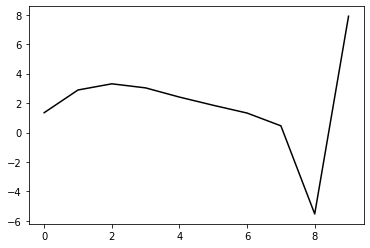

166100 22.66311553032693
0.34407264296974144 -0.232797227178819 -0.20918098211742955 -0.11715997712918999
[ 1.38566492  2.71403835  3.12130212  2.83618964  2.20630821  1.64737037
  1.11839682  0.25000615 -5.73012535  7.83488755]


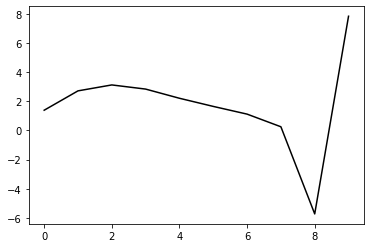

167200 23.616710127501353
0.34706451269983796 -0.23283769916901942 -0.2103307488957226 -0.11790443037163097
[ 1.37415783  2.76533708  3.18206008  2.90481448  2.28142033  1.72763294
  1.20305292  0.33758933 -5.63923128  7.82658769]


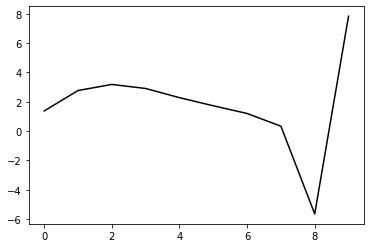

168300 23.978459313850326
0.34785120464125563 -0.23096755144076325 -0.20970362261012868 -0.11659817284021004
[ 1.35930905  2.78568785  3.19725706  2.91467931  2.28664217  1.72862847
  1.20060659  0.3313302  -5.6496431   7.85853248]


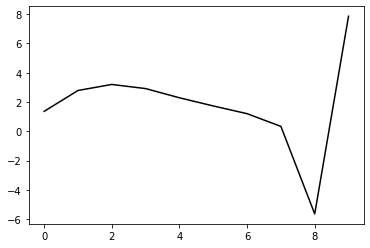

169400 14.506625818884492
0.3499183552670539 -0.23152110329906514 -0.21095583250235575 -0.11660201328390439
[ 1.33623885  2.85429399  3.27671175  3.00334391  2.38331093  1.83205137
  1.31021617  0.44557604 -5.5314286   7.85706119]


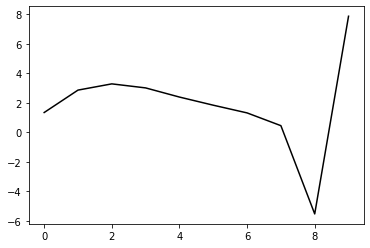

170500 22.319195939161784
0.3487407515140758 -0.23411208744975817 -0.21272148940287713 -0.11513323695643542
[ 1.3168744   2.76115217  3.17856697  2.90207391  2.28065031  1.72918467
  1.20889066  0.34634024 -5.6265213   7.87339967]


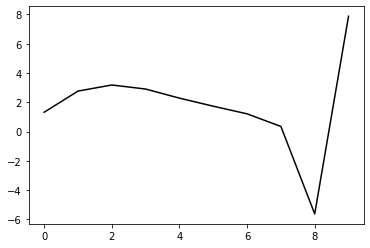

171600 25.346912406815804
0.34913600349110663 -0.2358537945032195 -0.21417678082175434 -0.11388644984827555
[ 1.3451296   2.79794505  3.19617624  2.90275018  2.2669831   1.70345852
  1.17379939  0.30375304 -5.67420067  7.82446744]


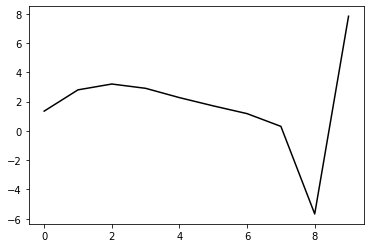

172700 13.525777937826135
0.34741793264657456 -0.23331587336231055 -0.21230045322712604 -0.11749974035012552
[ 1.38673697  2.78760299  3.19761981  2.91373856  2.28545832  1.72758587
  1.20258837  0.33577011 -5.63938049  7.85133749]


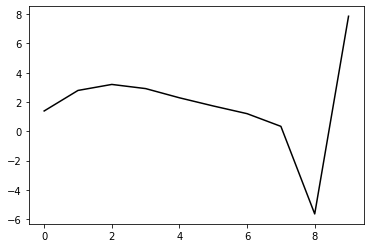

173800 24.46078541071424
0.3464587957787222 -0.2298334541152337 -0.2096160102828512 -0.11981111173170768
[ 1.3779242   2.82042359  3.22129987  2.92941368  2.29408451  1.72978801
  1.1994986   0.32782193 -5.65050802  7.8176896 ]


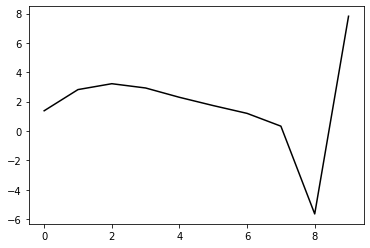

174900 15.9261588644849
0.3476303514460457 -0.23436452627858362 -0.21346517684897043 -0.11741984104140787
[ 1.38033725  2.71821366  3.11770301  2.82634156  2.19318241  1.63199114
  1.10593769  0.23860289 -5.73450039  7.82985129]


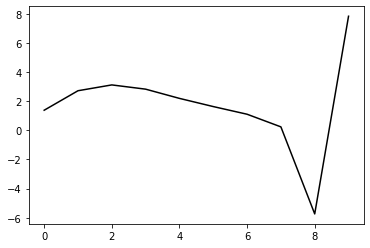

176000 15.018731845435287
0.3550318844874457 -0.2282799021204267 -0.21103488579931837 -0.11815172127448097
[ 1.30496628  2.93291147  3.32865393  3.03032663  2.38863293  1.81770376
  1.28155546  0.40297926 -5.58245525  7.85769288]


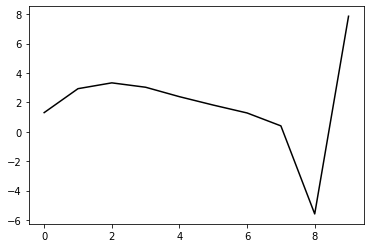

177100 20.402458605768757
0.35266359985149937 -0.2304911142360026 -0.2122004248584118 -0.11802280039925889
[ 1.32399774  2.8892154   3.29700352  3.00934044  2.37777821  1.81617303
  1.28935324  0.41899048 -5.55906989  7.83758334]


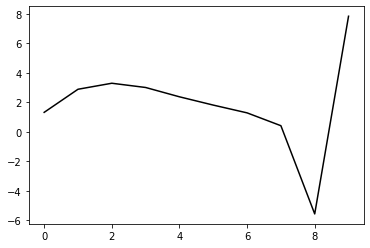

178200 22.686400320644132
0.35310285148797693 -0.22967196251170463 -0.2122134347657163 -0.11623195558758406
[ 1.3402877   2.83363035  3.22960382  2.93080748  2.29020642  1.72136665
  1.18960161  0.31486944 -5.66552372  7.82743753]


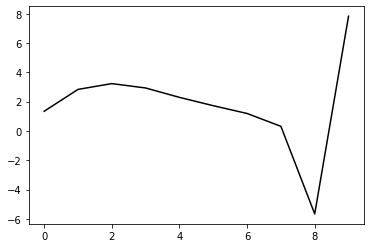

179300 20.534172149874866
0.3505783839687541 -0.2345787927084437 -0.21546811904946994 -0.11631037698713849
[ 1.34282912  2.81524585  3.2306346   2.94802067  2.32100066  1.76335504
  1.24145155  0.37451308 -5.59915793  7.86379996]


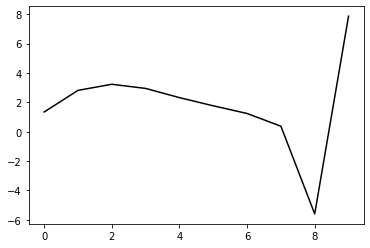

180400 14.43590025695356
0.34608268732277847 -0.23421881339985864 -0.21440528060231467 -0.11887385757790574
[ 1.37237011  2.80450966  3.23554478  2.96645351  2.35079923  1.80253415
  1.28890219  0.42857902 -5.53826306  7.85100024]


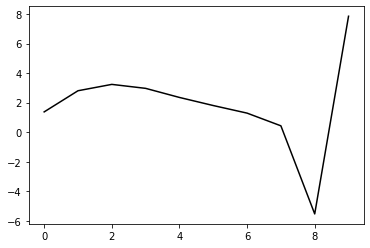

181500 23.381557576119192
0.3438514994866579 -0.239394243314791 -0.2181334292366684 -0.11431563965553682
[ 1.32653469  2.67688756  3.08427266  2.79809356  2.17008139  1.61261539
  1.09243787  0.22685561 -5.74501084  7.83417148]


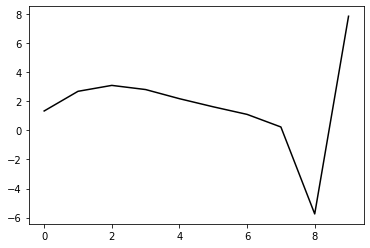

182600 24.36062644874622
0.34977422736106467 -0.23351098851807578 -0.2149614977888384 -0.11979236213952303
[ 1.3293625   2.889863    3.29477945  3.00325097  2.36882591  1.80466314
  1.27848723  0.40727094 -5.5685128   7.83774862]


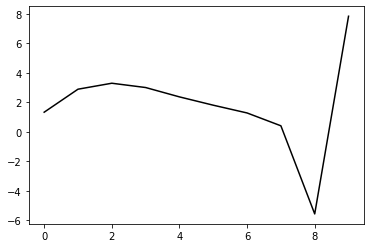

183700 13.883537960441252
0.3461186313855861 -0.23251157172934245 -0.2140054143314601 -0.11911219456837623
[ 1.38699299  2.761175    3.17235867  2.88812566  2.26056706  1.70215091
  1.18080447  0.31261491 -5.6607609   7.84848612]


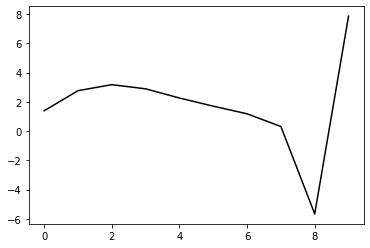

184800 24.710462896831555
0.3487811215842849 -0.22777121802040595 -0.2112796540688654 -0.12182827407562871
[ 1.37481017  2.87299417  3.28157679  2.99406879  2.36329843  1.80172707
  1.27772099  0.40663384 -5.56939478  7.84240548]


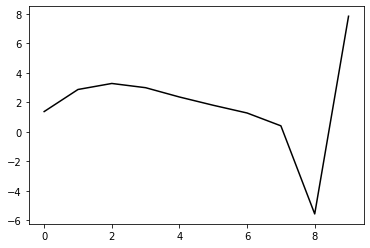

185900 22.91870254653387
0.35095816100208405 -0.2322299190816514 -0.21551580210143478 -0.11835544494654739
[ 1.28189399  2.81321734  3.2152717   2.92437347  2.29204553  1.72971241
  1.20582062  0.3346549  -5.64056608  7.86808382]


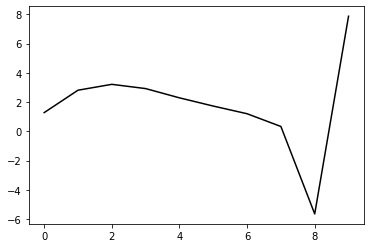

187000 18.176475734903907
0.35320675078014524 -0.23342838267731625 -0.21736920231824577 -0.11653802042463711
[ 1.30182846  2.85037532  3.24939036  2.95581874  2.32076748  1.75548296
  1.22886825  0.35448351 -5.6236667   7.82093816]


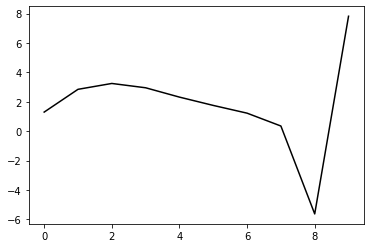

188100 22.577907953522523
0.34930114832546705 -0.2291102199439117 -0.21342356596141318 -0.11968370759932656
[ 1.39142001  2.73582541  3.13508065  2.84311789  2.21049112  1.64776247
  1.12397896  0.25178462 -5.72391393  7.87437169]


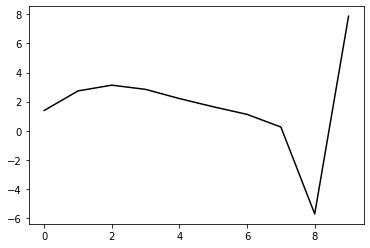

189200 24.143460509082416
0.34722101639471364 -0.2282505457906404 -0.21263763395723542 -0.12045407996863022
[ 1.37211528  2.73762263  3.13741238  2.84589097  2.21368932  1.65111754
  1.12760473  0.25500342 -5.72091668  7.8050575 ]


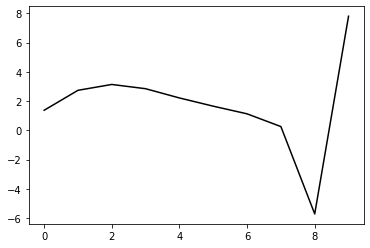

190300 21.393463130966378
0.3532926238091741 -0.22698858138452688 -0.21359620046530908 -0.11756328236196721
[ 1.32726011  2.8173019   3.21193353  2.91475395  2.27755518  1.71031004
  1.18279155  0.30573865 -5.67492483  7.85085691]


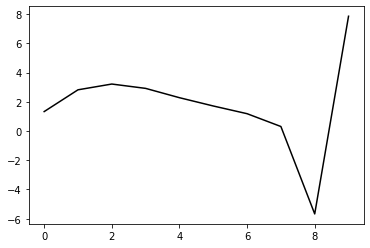

191400 14.189787197337315
0.3505113681449272 -0.22893222100068963 -0.21458784025135766 -0.118992265848451
[ 1.36739939  2.82800783  3.24471771  2.96528475  2.34257752  1.78717383
  1.26999456  0.4008245  -5.57344527  7.85055288]


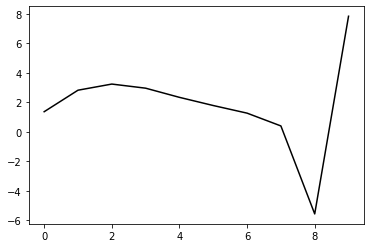

192500 22.294675354627305
0.3492108085574234 -0.2294584068243263 -0.21496705347347214 -0.1203441098971178
[ 1.34121149  2.86323381  3.28997094  3.01824651  2.40160504  1.85058383
  1.33682538  0.46884509 -5.50675322  7.87762725]


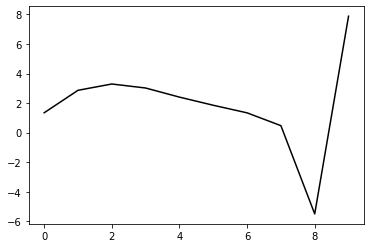

193600 25.330327798372362
0.35212236353110127 -0.2287572176606011 -0.2158056900898759 -0.11708514579428689
[ 1.31151689  2.87698132  3.290436    3.00563276  2.3773817   1.81590509
  1.29320601  0.4160856  -5.56867626  7.83163281]


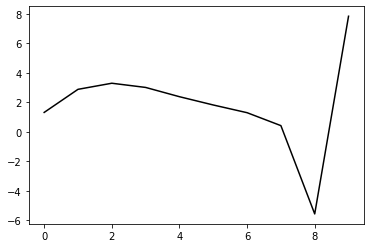

194700 13.438323603029996
0.3509900612338536 -0.2239665660954763 -0.21240999892455756 -0.11872160880451672
[ 1.37492001  2.84542931  3.25922612  2.9741207   2.34554088  1.78331707
  1.25978914  0.3801817  -5.60852788  7.84859577]


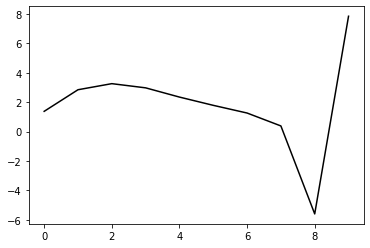

195800 22.052377394996437
0.34980076051836884 -0.22285119763694344 -0.21157603643415768 -0.11849637231987734
[ 1.34863457  2.85506976  3.26819707  2.98200269  2.35237566  1.78893512
  1.26478062  0.38403778 -5.60558803  7.85147079]


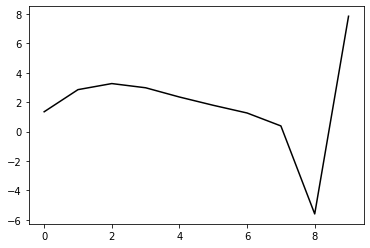

196900 16.387062161517147
0.35075217846855217 -0.23069488265762683 -0.21767390048774587 -0.11348188571505731
[ 1.34132982  2.7404423   3.14384198  2.85031949  2.21640927  1.65093551
  1.12700417  0.24708684 -5.74049534  7.80546816]


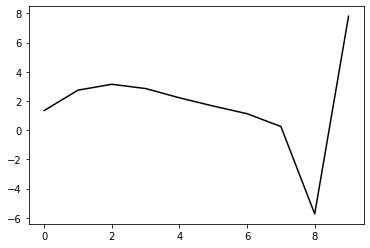

198000 18.639077224984913
0.3522472048041419 -0.22738818729748872 -0.21579035104052602 -0.11657153802667952
[ 1.29479552  2.91282135  3.32478786  3.03620586  2.40432132  1.83844262
  1.31275487  0.42909031 -5.56321928  7.84908945]


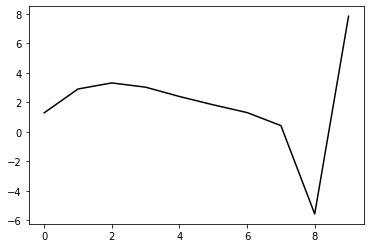

199100 27.195740834733343
0.3424911379018789 -0.22777631119497735 -0.2136565857914381 -0.1194325556596071
[ 1.42448529  2.66860426  3.07669179  2.78703653  2.15661406  1.59406683
  1.07368355  0.19610676 -5.78871396  7.8563948 ]


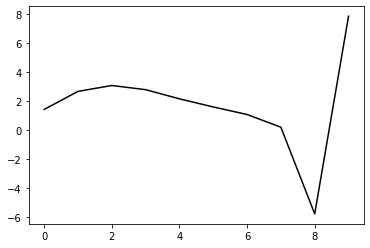

200200 23.565826411412953
0.34393406640229335 -0.22650755043743123 -0.21312570733067487 -0.11972829707866338
[ 1.36702441  2.76215605  3.15531803  2.85063927  2.20561754  1.6290594
  1.09594611  0.20653047 -5.78769742  7.8065008 ]


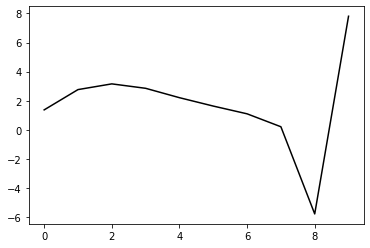

201300 24.692538572352138
0.34245679522416944 -0.22701766925381614 -0.2134118444497571 -0.12026416330037973
[ 1.35516586  2.74664784  3.14147999  2.83812223  2.19420459  1.61848798
  1.08651984  0.19802308 -5.79454571  7.83943117]


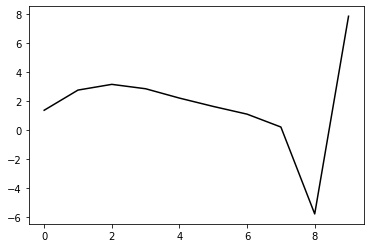

202400 14.249228701346743
0.3467608624465531 -0.22687007775947302 -0.21467667962590012 -0.11996230705752763
[ 1.33726383  2.8751841   3.2702633   2.96535876  2.3192461   1.74092517
  1.20656265  0.31529728 -5.67887528  7.82236677]


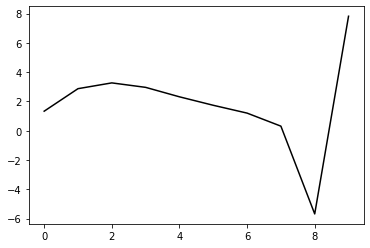

203500 22.025293288129397
0.3475247372350781 -0.2269098663172185 -0.21516576984869265 -0.12144863565243526
[ 1.35686915  2.91542375  3.33047717  3.0412027   2.40799657  1.84033404
  1.3151752   0.4308431  -5.55896329  7.87397957]


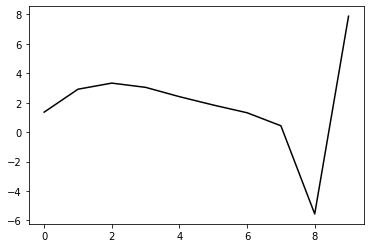

204600 25.87307921032479
0.3454066942164182 -0.22761272878262423 -0.21543168022388748 -0.12207945887927697
[ 1.34231683  2.8844084   3.2971546   3.00659843  2.37321275  1.80595657
  1.28196693  0.39856296 -5.58928885  7.83982212]


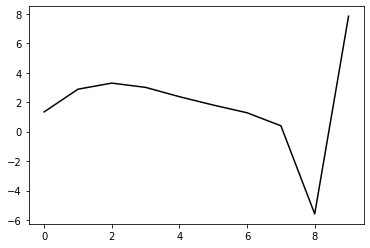

205700 13.762631803244062
0.3438776857515584 -0.2273225708615899 -0.21551041666833237 -0.11996347014421026
[ 1.38234414  2.76973849  3.18335869  2.89560279  2.2656386   1.70159464
  1.18069462  0.29925416 -5.68692374  7.83809941]


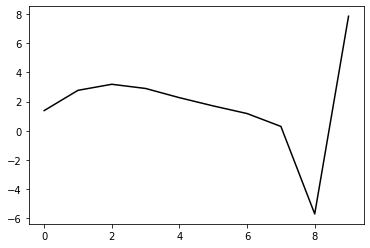

206800 26.008547706773335
0.3420402390670031 -0.2242674517717834 -0.213087298811408 -0.12306624206079796
[ 1.38034334  2.83189987  3.24188063  2.95094577  2.31802855  1.75105172
  1.22759356  0.34328063 -5.64474866  7.82070258]


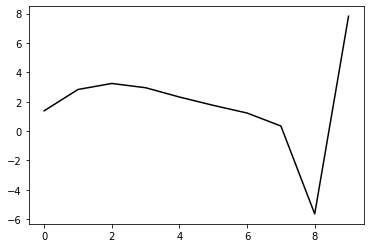

207900 18.23794296141032
0.3485177232748152 -0.22602196458604645 -0.21630617634359353 -0.1197577257898887
[ 1.28791564  2.86702569  3.26434675  2.96268991  2.32108664  1.74684941
  1.21758728  0.32795656 -5.66427083  7.86067576]


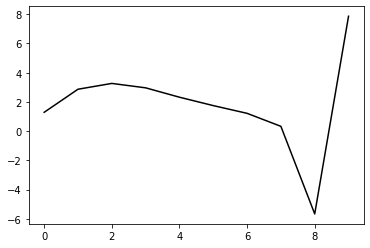

209000 17.46024402561136
0.34898881453408803 -0.2294621270268667 -0.21928991912988682 -0.1174601389656328
[ 1.31363883  2.79611004  3.20574067  2.91555769  2.28444597  1.71949477
  1.19874837  0.31589906 -5.6707166   7.79966605]


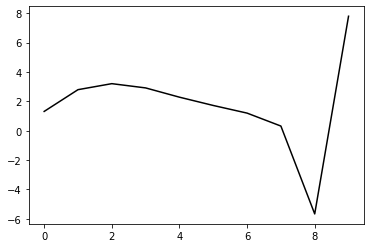

210100 26.629499805820405
0.3418271251640092 -0.2264957725991362 -0.21561397551844144 -0.1211479754592717
[ 1.41787361  2.6313618   3.05079675  2.77132661  2.15020843  1.5939966
  1.08112226  0.20444981 -5.77700367  7.86910756]


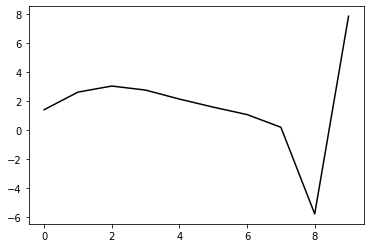

211200 23.680534262161746
0.3430161088636368 -0.22362192931576452 -0.21437291676746387 -0.12163342052309539
[ 1.36150995  2.74224577  3.15464342  2.86871237  2.24163863  1.67957814
  1.16100519  0.27774338 -5.71024761  7.80695495]


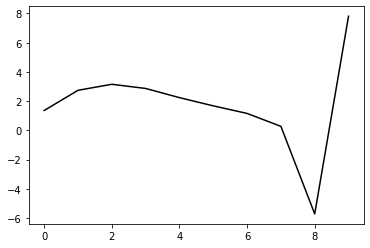

212300 20.577506914079482
0.3461989581930729 -0.22742104666252186 -0.2184182344446482 -0.11885796145682642
[ 1.33573365  2.76040495  3.18598922  2.91162612  2.29449024  1.74078112
  1.22953995  0.3517918  -5.63226882  7.86755763]


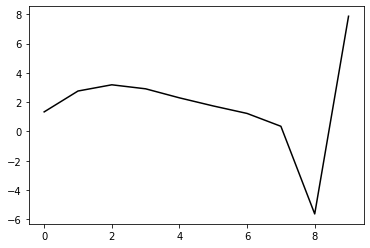

213400 17.240695455199138
0.33988076469961 -0.22789392537735034 -0.21762225442668345 -0.11878485763020943
[ 1.33671251  2.65267911  3.06964529  2.78984651  2.16908438  1.61279703
  1.10009081  0.22093227 -5.76501973  7.81044383]


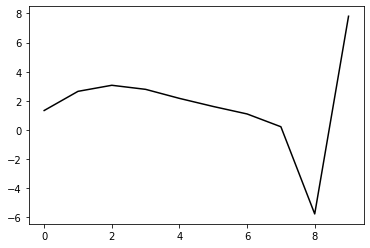

214500 21.88726233280746
0.3469303079029739 -0.2239364124112467 -0.21671994635264466 -0.1188200479424213
[ 1.32176362  2.79102797  3.19953438  2.91121505  2.28233581  1.71822977
  1.19829667  0.31171418 -5.68031368  7.84514214]


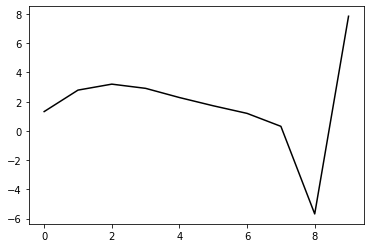

215600 24.233776299281764
0.34817478599098545 -0.22206737047407119 -0.21597710476855103 -0.11889009189897778
[ 1.32337026  2.82427726  3.2333371   2.94501915  2.31617316  1.75198776
  1.23216877  0.34492753 -5.64824834  7.81706318]


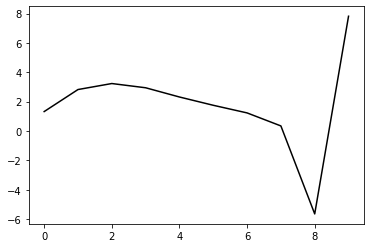

216700 14.879834580843243
0.3463503155568946 -0.22295286280485455 -0.21617202140712533 -0.12214236927474276
[ 1.38358475  2.82361922  3.25507255  2.98552646  2.37244111  1.82162712
  1.31386336  0.43675209 -5.54756725  7.90153586]


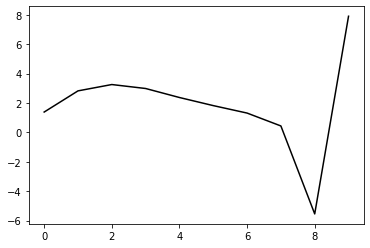

217800 22.640062945932893
0.3427153277792061 -0.22241293663331482 -0.21538845053852645 -0.12225788235204053
[ 1.37123042  2.81084143  3.2349655   2.95948205  2.34196497  1.78777287
  1.27783259  0.39800607 -5.58981271  7.81928501]


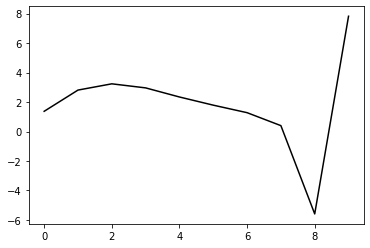

218900 14.857072854742464
0.34880234545444894 -0.21954242964849074 -0.21543925118110555 -0.11923966269973102
[ 1.31652795  2.89221583  3.31021403  3.0271635   2.40172652  1.8390896
  1.32053132  0.43027038 -5.57074169  7.86622544]


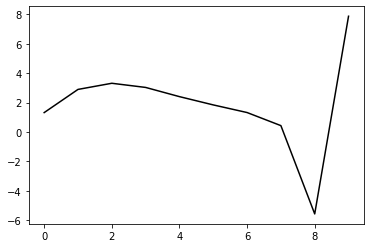

220000 15.225362491383281
0.34875398763344384 -0.21902705790269728 -0.2154657979172636 -0.11837850320213184
[ 1.31365542  2.88640762  3.29940632  3.01129993  2.38125353  1.81417293
  1.29166675  0.39677631 -5.60869497  7.86025725]


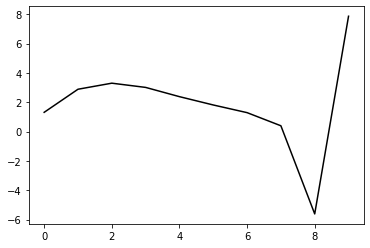

221100 21.24151427565329
0.3415106097017807 -0.22077473404881084 -0.2149509439027369 -0.11943622501740458
[ 1.34910369  2.7839294   3.19425049  2.90395514  2.2725333   1.70473231
  1.18266549  0.28818046 -5.7165167   7.80723366]


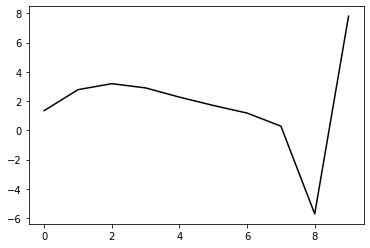

222200 22.294999951259612
0.3461924235700101 -0.2194636848734779 -0.21572072586416843 -0.11734310873637116
[ 1.36578955  2.78013848  3.1963747   2.91224316  2.28697449  1.72471413
  1.20766164  0.31614929 -5.68711461  7.81529125]


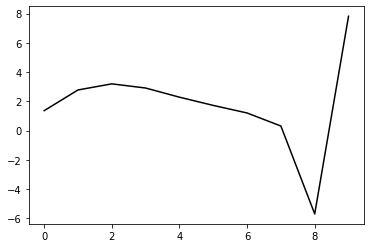

223300 21.65922765562009
0.34774686908655883 -0.2165178109968925 -0.214274322276177 -0.11753989221553468
[ 1.31091093  2.83406425  3.24630957  2.95741453  2.32756582  1.76108756
  1.24112591  0.34702643 -5.65804819  7.83092307]


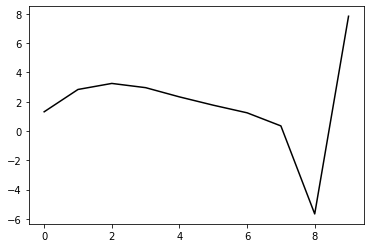

224400 14.30196466645944
0.34477643000136293 -0.21885945480009825 -0.21466317767417842 -0.12045066867659251
[ 1.35469756  2.81809465  3.23596323  2.95256122  2.3277899   1.76600761
  1.25134267  0.36279502 -5.63275023  7.83794244]


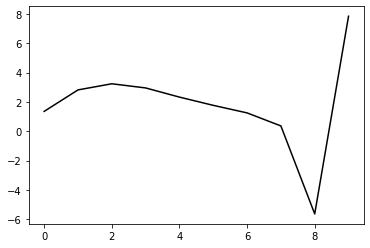

225500 22.375439434093728
0.34511115980784746 -0.22094745282839431 -0.2167122567372065 -0.1184037479701386
[ 1.30872642  2.7739044   3.18728738  2.9022791   2.27739671  1.71587909
  1.20177513  0.31292455 -5.6834233   7.84967657]


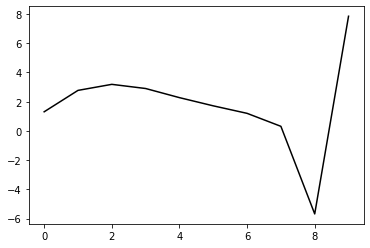

226600 25.33701313655961
0.3459917774629018 -0.22301087465370464 -0.21866942218560054 -0.11816950333505588
[ 1.3085114   2.80538752  3.22673425  2.94709542  2.32623513  1.76791044
  1.25695135  0.37038031 -5.62375809  7.82779319]


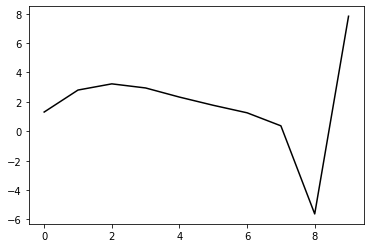

227700 15.400480366820567
0.3433213389075327 -0.2202534897535447 -0.21619894129378556 -0.12078381591905406
[ 1.39512281  2.74048883  3.17257392  2.9035559   2.29267803  1.74337319
  1.24092374  0.36110986 -5.62762882  7.8787575 ]


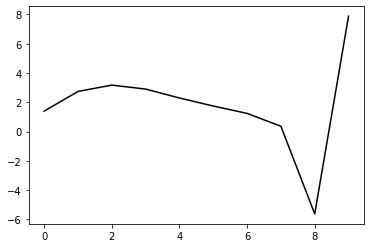

228800 22.25059110977848
0.34349626847687764 -0.21906181988025653 -0.215845616766178 -0.12066003502777783
[ 1.34627329  2.82170578  3.25279927  2.98073393  2.36540915  1.81062384
  1.30250166  0.41588466 -5.58037385  7.83010421]


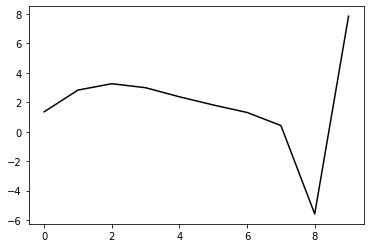

229900 24.83648271575188
0.34480092573801313 -0.22633288309930918 -0.22190160892861205 -0.11532953753896782
[ 1.31410784  2.74303986  3.16473767  2.88483409  2.26348771  1.70436794
  1.19408701  0.30619998 -5.68953737  7.82867938]


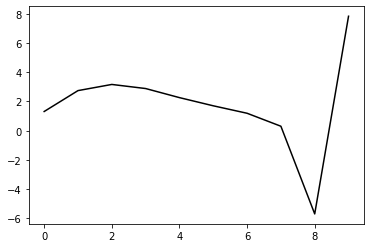

231000 16.982304964322946
0.3482349239424916 -0.21956183509036586 -0.2182615231783088 -0.11700278389582992
[ 1.30637952  2.88777091  3.30670704  3.02223604  2.39459526  1.82749411
  1.30822137  0.40921285 -5.60002152  7.8502979 ]


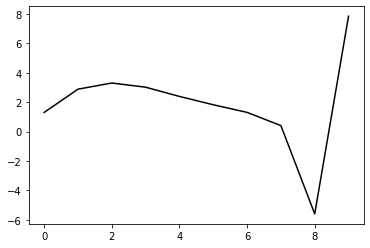

232100 22.796596729833105
0.3439094534947681 -0.22082704988293902 -0.21860458571530664 -0.11692590500473836
[ 1.38087026  2.71044915  3.1331183   2.85682116  2.24034032  1.68582053
  1.1799462   0.29304999 -5.70529157  7.84996358]


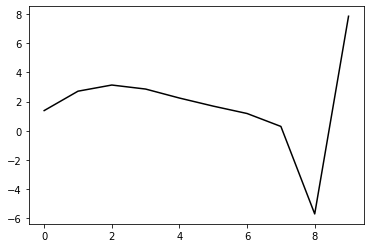

233200 32.310526033094675
0.33499228449715435 -0.2156396876241899 -0.21262854715222193 -0.12219479799012449
[ 1.41005163  2.59671423  3.0137175   2.73590572  2.1196518   1.56595194
  1.0615303   0.17557523 -5.8225802   7.78219933]


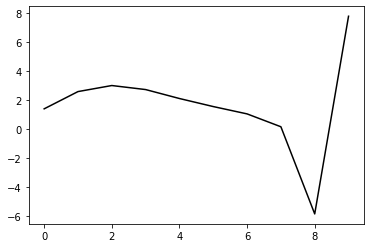

234300 25.12873037374379
0.340933636928287 -0.21786701730940902 -0.21559179244856483 -0.11969930825524701
[ 1.37563442  2.71747625  3.11887581  2.82486384  2.19286244  1.62466486
  1.10795421  0.21172556 -5.7926739   7.82988406]


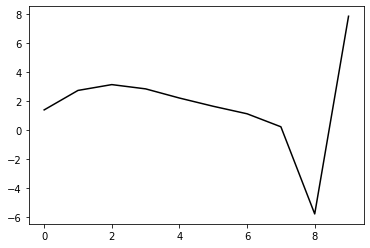

235400 14.32517105624625
0.3443173158030421 -0.21885828057028467 -0.21740401899157083 -0.11961742306352376
[ 1.34552885  2.81728683  3.22261686  2.93040836  2.29883569  1.73015224
  1.21283642  0.31551312 -5.68927566  7.83022616]


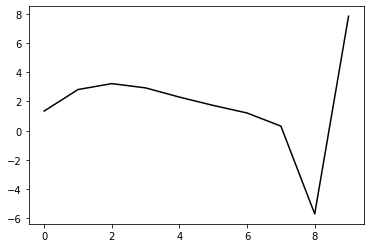

236500 22.899405173315913
0.3475139882707079 -0.21479362222774973 -0.2155039637319107 -0.12118517865278934
[ 1.36762068  2.90336963  3.3179153   3.03088153  2.40243216  1.83538703
  1.31896749  0.42100779 -5.5862161   7.874618  ]


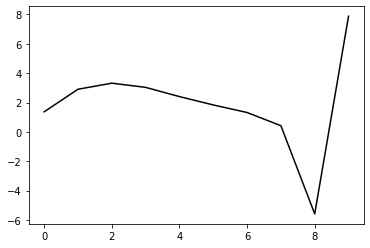

237600 25.259741097194556
0.3496405480376728 -0.2201702256716913 -0.22055897945495673 -0.11653477214909484
[ 1.31806066  2.87071874  3.28466777  2.99654626  2.36726771  1.79937372
  1.28248745  0.38336491 -5.62489713  7.83810172]


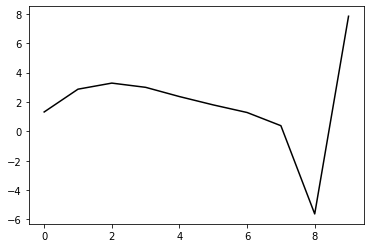

238700 15.766967178149969
0.34576422245376304 -0.2169862229367355 -0.21745124468720525 -0.12029024525760224
[ 1.40720227  2.80932675  3.23397536  2.95570716  2.33555602  1.77583644
  1.26668555  0.37361222 -5.62968047  7.86197659]


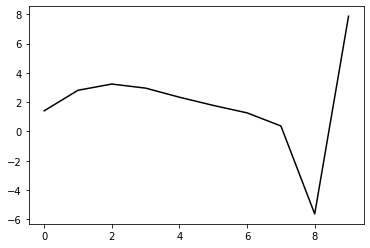

239800 22.05235825502078
0.34522283768294554 -0.21590613969879854 -0.21690574590298406 -0.12015923145908111
[ 1.36054561  2.84847464  3.26467357  2.97730162  2.34813314  1.77948474
  1.26220727  0.36057632 -5.65163768  7.82234818]


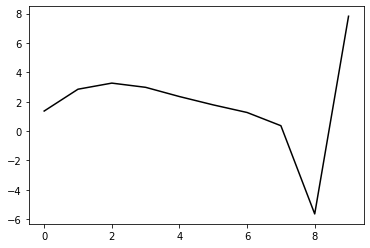

240900 15.783631370802748
0.34826267031759534 -0.21587090124272776 -0.21813606746380465 -0.1180720021454979
[ 1.32068412  2.89169533  3.31114292  3.02668175  2.40037157  1.83408703
  1.31887352  0.41733711 -5.59651295  7.86352807]


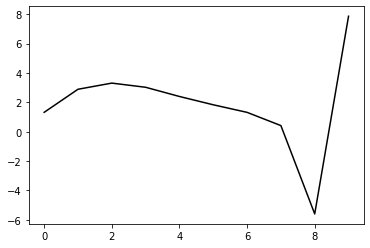

242000 18.310866495992997
0.34606382735729346 -0.22162823882884602 -0.22186995697807813 -0.11485121817042408
[ 1.30976523  2.8128079   3.209557    2.90458     2.26082362  1.68028497
  1.15469501  0.24565672 -5.77147204  7.79358993]


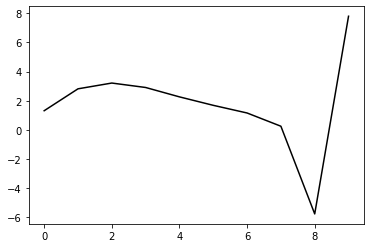

243100 24.089830650718458
0.344082039099624 -0.2174762558413807 -0.21832466004726173 -0.11936561878907029
[ 1.41482128  2.72736292  3.13139627  2.83385263  2.19708957  1.6228978
  1.10347865  0.19989258 -5.81115229  7.86085565]


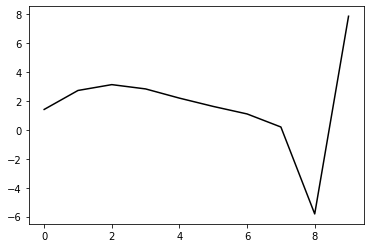

244200 27.111138877573662
0.3402995092472976 -0.21545033744686665 -0.21625001008390718 -0.1218251411731654
[ 1.39249267  2.73607098  3.14017787  2.84293243  2.20631434  1.63183606
  1.11193345  0.2069391  -5.80558601  7.79347254]


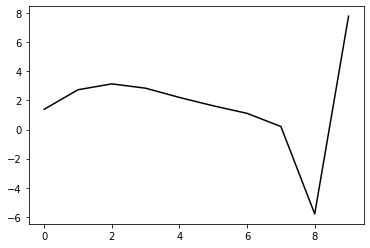

245300 24.755204983820388
0.34021645279755236 -0.21712869577110364 -0.21783071931301148 -0.12048101478551047
[ 1.36587955  2.73577522  3.13611789  2.83536292  2.19540907  1.61775306
  1.09529688  0.18790216 -5.82581895  7.83161155]


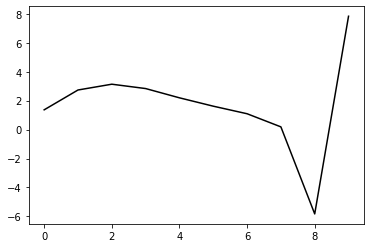

246400 14.859792946452002
0.3438907302934334 -0.21745340744112115 -0.2193111925388685 -0.11947803676731868
[ 1.34650841  2.8317837   3.22986139  2.92610295  2.28296149  1.70200579
  1.17655479  0.26592531 -5.74963974  7.81473036]


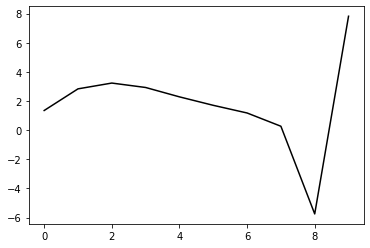

247500 21.45917972882562
0.3445458359500245 -0.21971729454841396 -0.22147190888496068 -0.11765732344675803
[ 1.33178541  2.8167143   3.21205748  2.90599146  2.26102251  1.67850144
  1.15205136  0.24032181 -5.77565434  7.83339134]


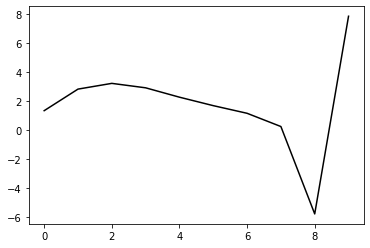

248600 24.436467545039044
0.3475588345919266 -0.21707272164667496 -0.2203364581885322 -0.11909434673451395
[ 1.3367059   2.90487731  3.29861678  2.98984737  2.34200926  1.75657237
  1.22761669  0.31319537 -5.70452356  7.82439616]


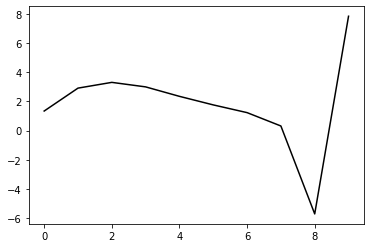

249700 14.037810164458271
0.3470856266403946 -0.21590938033812487 -0.2195990365153828 -0.12152764454001522
[ 1.37475727  2.90160245  3.3137728   3.01979652  2.38449018  1.80967503
  1.29003289  0.38271975 -5.63022222  7.86339053]


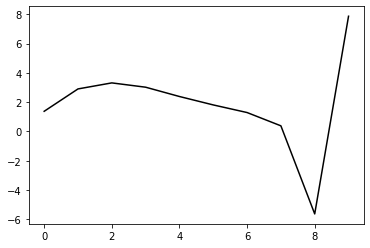

250800 22.821871311842344
0.34312836936344626 -0.21454096247877433 -0.21810223277727203 -0.12231054127861567
[ 1.3791092   2.87981745  3.29132136  2.99788934  2.36379149  1.79023704
  1.27204157  0.36523065 -5.64750535  7.82435186]


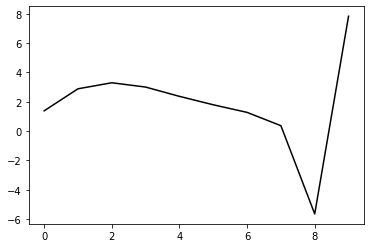

251900 12.880822937277706
0.3478964041596278 -0.21211654011853853 -0.21798064742258416 -0.12080043336143668
[ 1.34790919  2.94076494  3.34980736  3.05300447  2.41588258  1.83932943
  1.31815448  0.40686829 -5.61216787  7.85712924]


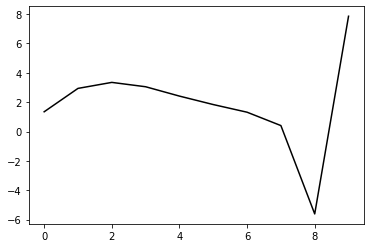

253000 16.492134967600556
0.3431822685606206 -0.21463887881218086 -0.2189135763113186 -0.1196660214665726
[ 1.34405746  2.83170558  3.23254437  2.92853592  2.28604007  1.70550633
  1.18184807  0.26836545 -5.75176312  7.80709112]


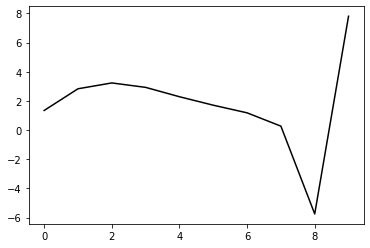

254100 23.71996084821918
0.34320532874652976 -0.2188012434836404 -0.222232533159563 -0.11736736312232375
[ 1.3931617   2.71618336  3.11647094  2.81551862  2.17903702  1.6062928
  1.09179234  0.18732584 -5.8239909   7.86159471]


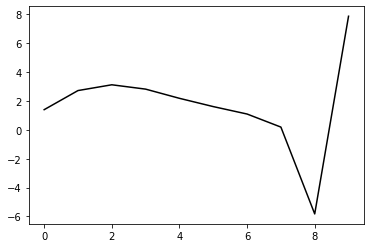

255200 29.108730295430508
0.33672314982590296 -0.21257559222724076 -0.21604210196857598 -0.12332587518222406
[ 1.39654268  2.70460215  3.102876    2.80019002  2.16183038  1.58689917
  1.07034205  0.16324004 -5.85003437  7.78457767]


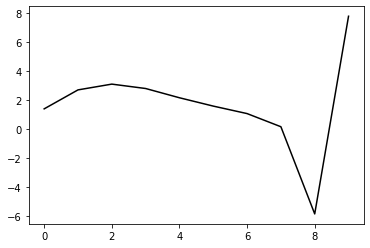

256300 24.82281259343582
0.3416834057915673 -0.21267240846691146 -0.21761078650875026 -0.12137860377453935
[ 1.36936854  2.79725371  3.18790022  2.87677506  2.22984196  1.64651997
  1.12240069  0.20821289 -5.80986751  7.82579002]


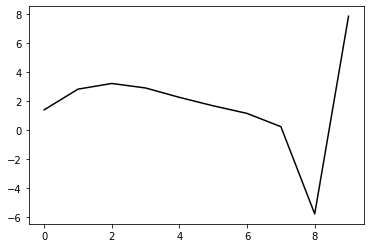

257400 14.534360109213406
0.34281421706970877 -0.21507738625463446 -0.21987739199745723 -0.12077716925520861
[ 1.34480776  2.82768628  3.22640925  2.9216903   2.27978974  1.70038472
  1.17977699  0.26830167 -5.74668004  7.81787457]


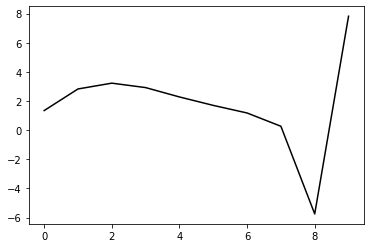

258500 21.84756035007898
0.34498516857083644 -0.2156058060199412 -0.2211573248575153 -0.11954137282012987
[ 1.33032366  2.84129697  3.2397886   2.93484657  2.29280166  1.71309081
  1.19231988  0.2800297  -5.73567218  7.84034191]


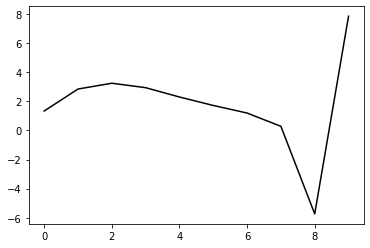

259600 24.490825440587862
0.34691883345231794 -0.21445968618133915 -0.22097146323299136 -0.12191714362977783
[ 1.326454    2.97368057  3.38772349  3.09332818  2.45903191  1.88509992
  1.36891089  0.45924422 -5.55636561  7.83134258]


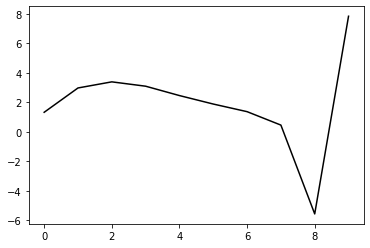

260700 13.305378798047734
0.34397946081015124 -0.21332255688310825 -0.2200651358425865 -0.12028811345470117
[ 1.37626634  2.86610183  3.27598597  2.97878411  2.34314543  1.76865228
  1.25252679  0.34226076 -5.67345445  7.85783871]


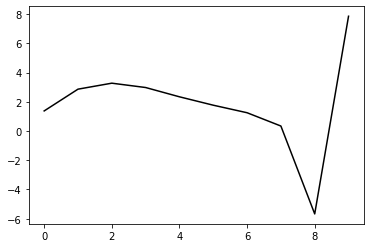

261800 27.362796334518666
0.34178416375661785 -0.21165314909867913 -0.21843929862286748 -0.12311226931780087
[ 1.3956069   2.89295983  3.31184456  3.02171652  2.39154542  1.82119549
  1.3085288   0.4004219  -5.61386674  7.84035471]


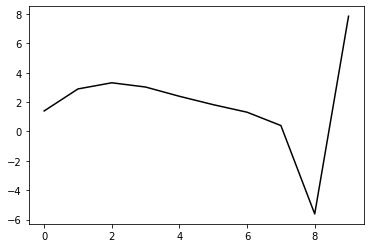

262900 19.520125491828615
0.34384801752657074 -0.21558659911085015 -0.2221391378054693 -0.11970170611248661
[ 1.29574627  2.84113893  3.2409099   2.93695997  2.29627451  1.71754023
  1.1985033   0.2851258  -5.7317807   7.85588666]


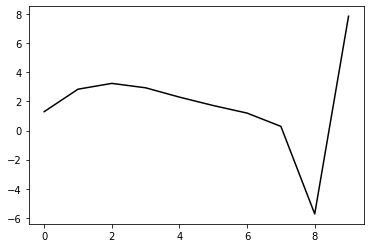

264000 18.057031515747525
0.3467139124790986 -0.21796482383087665 -0.2249042076169842 -0.11779022050985626
[ 1.31264092  2.87329733  3.27432635  2.97139637  2.3313927   1.75299568
  1.23431452  0.32075832 -5.69561443  7.80407003]


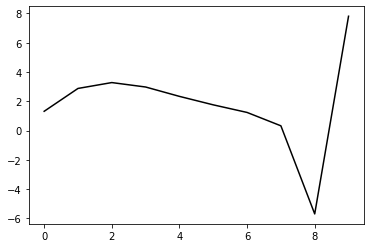

265100 22.46449631930675
0.3426454816703067 -0.21401615497754028 -0.22112187584207663 -0.12114273117237426
[ 1.38998165  2.78021796  3.18223666  2.88073931  2.24230332  1.66533538
  1.14816172  0.23553696 -5.77944804  7.86498259]


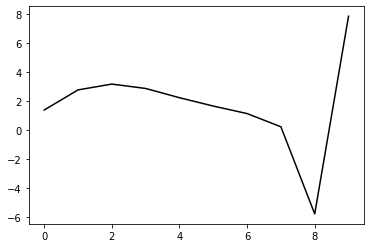

266200 22.512279302735138
0.3428540431832061 -0.21426921238444047 -0.22174714273294951 -0.12065046779143232
[ 1.35164937  2.78588841  3.18999975  2.89054044  2.2542042   1.67912481
  1.16378157  0.25203526 -5.76288729  7.8008249 ]


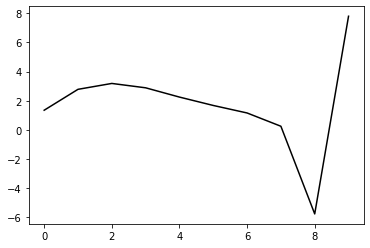

267300 24.649506439460616
0.338401257788134 -0.21281862109624936 -0.21982190967315796 -0.12151752457163065
[ 1.36128677  2.72549209  3.12357229  2.82072102  2.18282733  1.60722153
  1.09233822  0.18104072 -5.83314182  7.82846702]


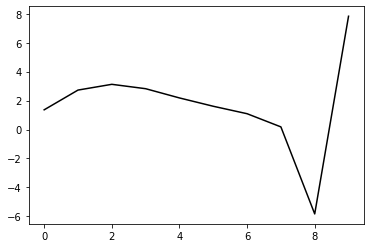

268400 14.269066313768286
0.3422529899390916 -0.21260532400529034 -0.2207686998711961 -0.12156631510676899
[ 1.34294206  2.85354998  3.25137953  2.94662041  2.30613302  1.72758341
  1.2099575   0.29561484 -5.71987608  7.82215939]


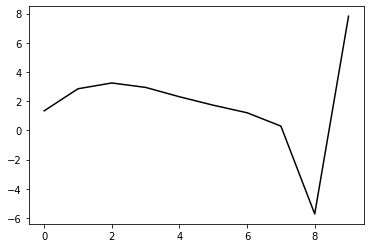

269500 23.022209494920713
0.3420271716276847 -0.2113266614496997 -0.2198542032260759 -0.12349224279037434
[ 1.37128679  2.86312803  3.27196215  2.97597815  2.34286856  1.77059617
  1.25872944  0.34885119 -5.66331237  7.85329665]


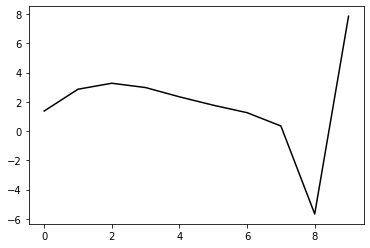

270600 24.80197417361001
0.3446468245345759 -0.2131802843329377 -0.2224413606201097 -0.11939755690165355
[ 1.33124371  2.84014487  3.23916574  2.93630443  2.29868164  1.72316364
  1.20897655  0.29632993 -5.71866795  7.82693441]


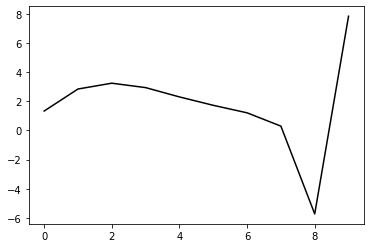

271700 13.342808956801976
0.3429694845627941 -0.21217176862497572 -0.22149044460992606 -0.12128365525957303
[ 1.37399133  2.8054988   3.22268672  2.93520597  2.31009576  1.74473145
  1.23920775  0.33331386 -5.6754901   7.84571738]


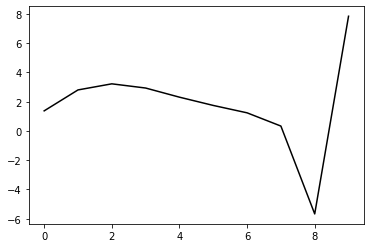

272800 26.07109671075974
0.34153134650271305 -0.2099497981396614 -0.2196171632148412 -0.12408004387486272
[ 1.38850717  2.85800515  3.28229539  2.99992292  2.37806107  1.81459974
  1.31041515  0.40475147 -5.60429429  7.84174698]


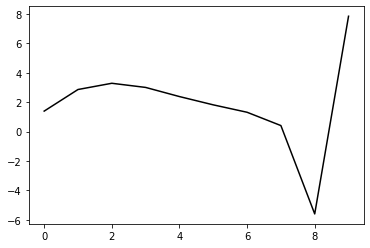

273900 14.08832494410297
0.3412434662993663 -0.21152102557392707 -0.22068665100652884 -0.1231606795533181
[ 1.33675558  2.82218296  3.22653983  2.92910304  2.29473843  1.72051171
  1.20738624  0.29396391 -5.72084765  7.84223006]


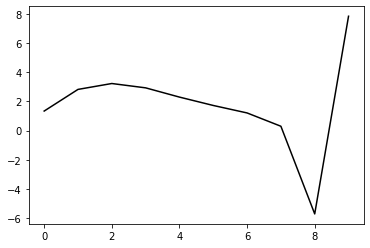

275000 17.24626177215985
0.3489959536196173 -0.21199936902312527 -0.22332498091608366 -0.11879750374793252
[ 1.31984258  2.80586257  3.20939481  2.91200784  2.27839692  1.70512307
  1.19320056  0.28020641 -5.73495046  7.79990259]


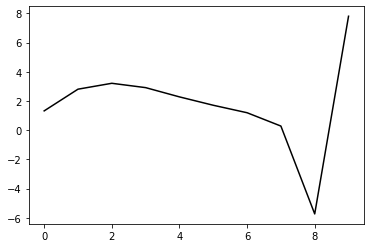

276100 19.96517189152403
0.34945901173279037 -0.20913813848162 -0.22173047870082513 -0.11993581955560555
[ 1.31885227  2.82932092  3.2347725   2.93755025  2.30353763  1.72938871
  1.21636619  0.30079357 -5.7188807   7.84106233]


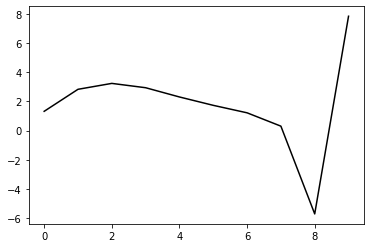

277200 23.715715822131425
0.3463678024771417 -0.21310194117877493 -0.22422577257619672 -0.11910974835619734
[ 1.31622715  2.8014577   3.21543356  2.92524375  2.29724253  1.72829641
  1.22034167  0.30883467 -5.70686592  7.82754052]


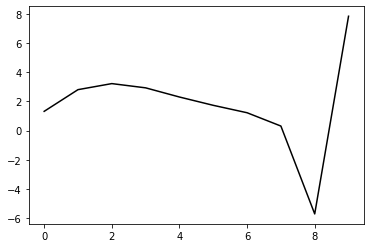

278300 20.571894649309765
0.3423466744736006 -0.21484198934375703 -0.22492732349415828 -0.11905763306062436
[ 1.33819409  2.74591477  3.17416232  2.89896973  2.28483298  1.72800092
  1.23074575  0.32773931 -5.68005329  7.83080953]


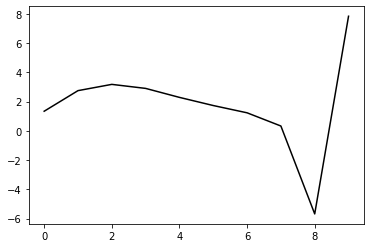

279400 14.264016402441229
0.3437483304432696 -0.21093847320681894 -0.22251775144205532 -0.12076888208623622
[ 1.36202155  2.78676942  3.2145855   2.93815759  2.32251969  1.76413751
  1.26572529  0.36110688 -5.64834134  7.80541215]


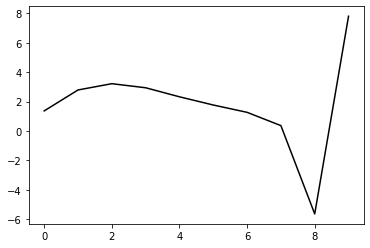

280500 26.005462951266946
0.3461710780442391 -0.20886793639265755 -0.22196209862932076 -0.12016531732814041
[ 1.29787476  2.84586481  3.27048183  2.98946426  2.36859991  1.80451411
  1.30044234  0.38926298 -5.62750214  7.86248313]


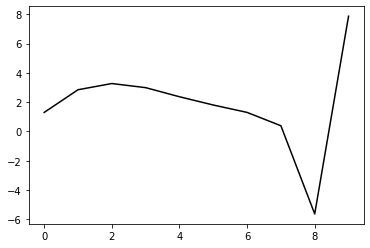

281600 24.93035795139277
0.3459640755968999 -0.20977172235633532 -0.2230426940120051 -0.1194978294987139
[ 1.32122739  2.83854796  3.26498213  2.98605912  2.36727243  1.80484931
  1.30218488  0.39072886 -5.62837179  7.83156078]


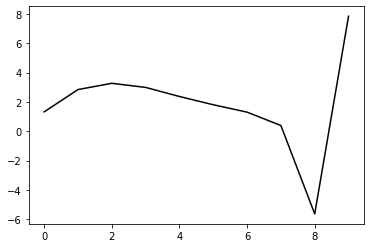

282700 15.883722001338842
0.34258402386514664 -0.20780019095203156 -0.22113226504493838 -0.12144606540354642
[ 1.40769703  2.75003357  3.18529396  2.91653508  2.30862019  1.75742298
  1.26652803  0.36563884 -5.64423092  7.86339568]


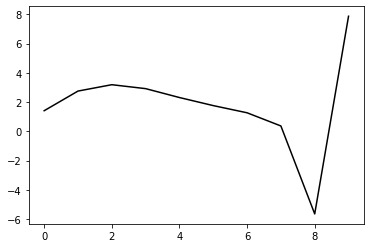

283800 22.864015639115497
0.34256329190877505 -0.20687019322676606 -0.2206602521811606 -0.12098465705029686
[ 1.34989183  2.80088417  3.22659107  2.94793737  2.32960952  1.76754443
  1.26619382  0.35455979 -5.66536258  7.79956779]


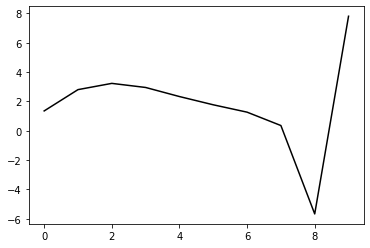

284900 13.259645385120049
0.3443766889562316 -0.20635348481501792 -0.22104264205124083 -0.1201068976588233
[ 1.35001177  2.84295251  3.27393568  3.00001305  2.38568546  1.82676938
  1.32822913  0.41790908 -5.60139273  7.86958155]


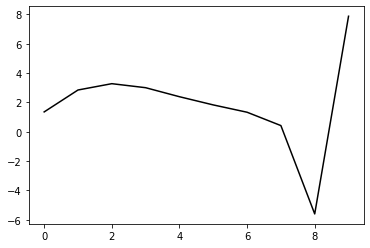

286000 18.140800029722776
0.34559724407612197 -0.21178315115721705 -0.22520242947222185 -0.1160927425144087
[ 1.31647408  2.77361079  3.1823119   2.88962745  2.259872    1.68861144
  1.18124277  0.26468085 -5.75607403  7.80744425]


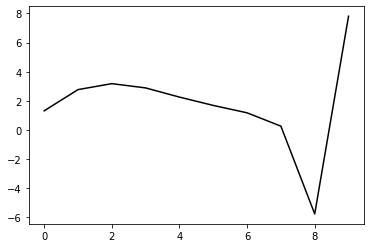

287100 25.87514946456079
0.340400958623994 -0.20926271177618028 -0.22207885000953725 -0.1203905443140763
[ 1.42754167  2.63694248  3.05650573  2.77545522  2.15617603  1.59395324
  1.0947491   0.18505286 -5.82899753  7.86314212]


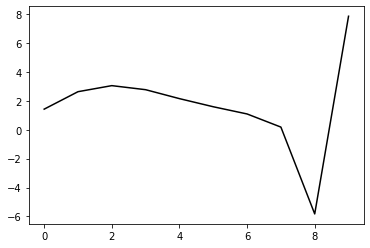

288200 21.945833381081634
0.3437486650298565 -0.20851987453664905 -0.22248855692315395 -0.11955193561838993
[ 1.37027908  2.75620064  3.16037276  2.86489082  2.23227309  1.65779515
  1.14770007  0.22785034 -5.79471063  7.80530259]


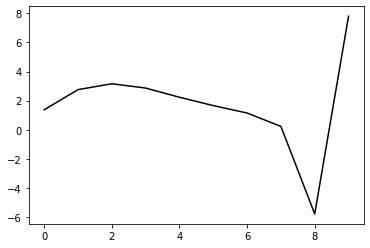

289300 25.038247031456827
0.3374461378044052 -0.20929770087601732 -0.22145119588708503 -0.12205002333130728
[ 1.3661257   2.66436066  3.06257454  2.7634508   2.12868775  1.55317938
  1.04348047  0.12490792 -5.8954595   7.8205936 ]


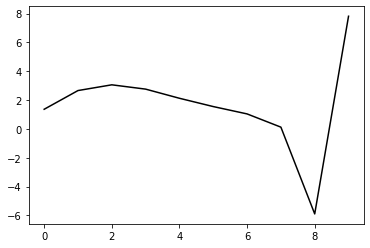

290400 14.335662509907982
0.3441602813440134 -0.2074393185381312 -0.22184216432099615 -0.1218679439185934
[ 1.34695688  2.83098223  3.22672356  2.92314463  2.28287784  1.70132789
  1.1857407   0.26116448 -5.76299075  7.81441505]


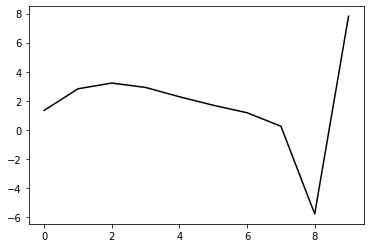

291500 22.365842442523387
0.34532924802139225 -0.20621369467993048 -0.22141611094148536 -0.12335815436867317
[ 1.36088143  2.88878303  3.29059588  2.99086668  2.35345212  1.77408347
  1.26051816  0.33718753 -5.68608904  7.84767802]


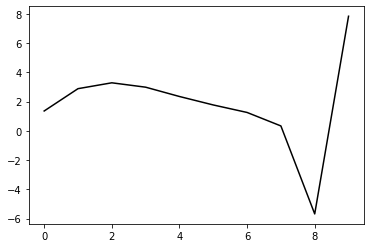

292600 25.133608372632974
0.3465220133434312 -0.20821835710205297 -0.22355336980159093 -0.12028662484639611
[ 1.31419986  2.86879768  3.26220351  2.95566664  2.31302851  1.72942507
  1.21257087  0.28585216 -5.74071476  7.81244555]


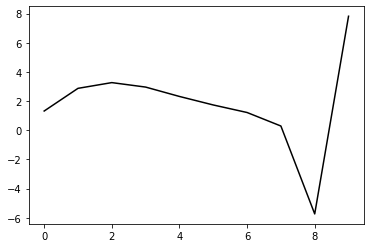

293700 13.41658837346802
0.34215276279991924 -0.20919148188475253 -0.22349722242866882 -0.1221276673235458
[ 1.38444943  2.79115038  3.19787513  2.90477177  2.27447902  1.7017675
  1.1946835   0.276042   -5.74264965  7.83424157]


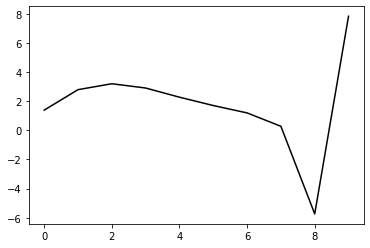

294800 26.799236833550903
0.34100847201917817 -0.20550449499098078 -0.22062131299989646 -0.1253051397303
[ 1.38681578  2.84348373  3.25031382  2.95690727  2.32591484  1.75215781
  1.2441092   0.32409679 -5.69523239  7.81784845]


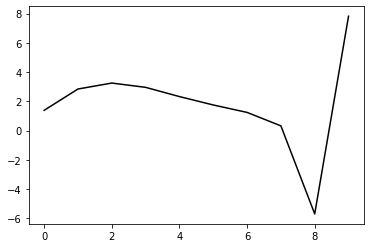

295900 16.338005813860043
0.3446256640043899 -0.20893050429444987 -0.22425933901962344 -0.12215019205060461
[ 1.29975126  2.84502967  3.23684498  2.93104926  2.28985636  1.70753433
  1.19259207  0.26665498 -5.75632838  7.85215383]


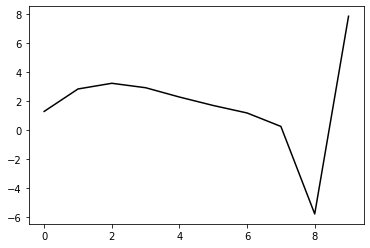

297000 17.538635583220156
0.3493906778778145 -0.2073552124412841 -0.22451426675968209 -0.1213261842910358
[ 1.29749531  2.94271053  3.3337801   3.02602033  2.38270859  1.79813192
  1.28101095  0.35214516 -5.67486409  7.82274665]


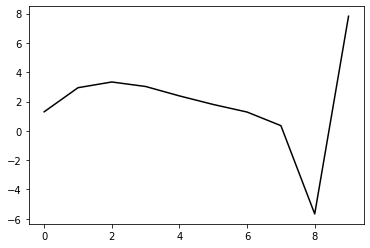

298100 20.694055897735236
0.34859361598521543 -0.2042104763447261 -0.22235824225654996 -0.12190016615208013
[ 1.3307697   2.88032456  3.26956783  2.95992055  2.31551384  1.73027271
  1.21296406  0.28328847 -5.74468583  7.83367773]


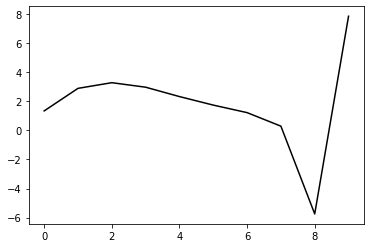

299200 23.742823516439085
0.34700066256232354 -0.2009629663529571 -0.21985842341188205 -0.12290263929048488
[ 1.35412285  2.86301574  3.25204191  2.94101018  2.29545471  1.70928355
  1.19173031  0.26143766 -5.76751621  7.82002825]


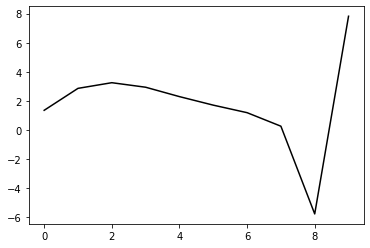

300300 24.27798355847823
0.3411106597595551 -0.20411659619539538 -0.22057530194292155 -0.1238156547604038
[ 1.33633962  2.79797528  3.18039668  2.86223982  2.21039898  1.61909064
  1.09848982  0.16683618 -5.8598094   7.82092166]


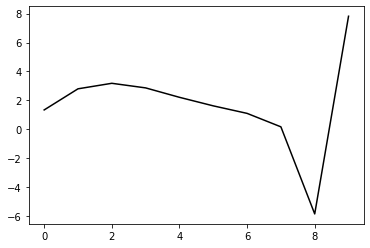

301400 14.156342686962754
0.3452396050530863 -0.20360458315616853 -0.2214810637544111 -0.12330965030551866
[ 1.35366753  2.87609164  3.27339832  2.96576357  2.32169768  1.73616136
  1.22027682  0.29191106 -5.73107536  7.8264609 ]


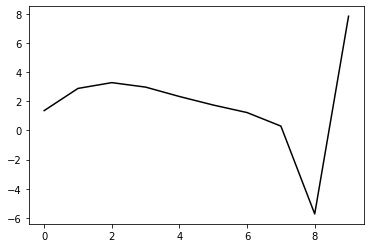

302500 22.05354542430583
0.34181032585062837 -0.2079489925932673 -0.2240591370108519 -0.12474078568506118
[ 1.35427154  2.85862524  3.27882147  2.99108767  2.36443312  1.79400847
  1.29150946  0.37389563 -5.64087427  7.84672563]


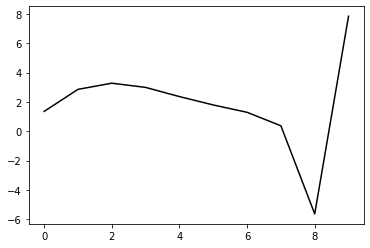

303600 24.817457084038967
0.34118318928744845 -0.2076129239198445 -0.22434755225467093 -0.12135802403913436
[ 1.31939352  2.83496454  3.23772275  2.93344939  2.29187076  1.70762971
  1.1922852   0.26140232 -5.76719197  7.80128559]


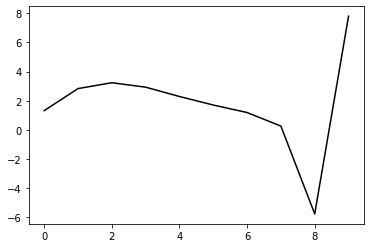

304700 13.568775984902482
0.33873237485295155 -0.20705570550687025 -0.22359508950889828 -0.12247170772232766
[ 1.3823061   2.78350366  3.18945286  2.88872396  2.2510369   1.67096299
  1.16032165  0.2338486  -5.78935189  7.8281345 ]


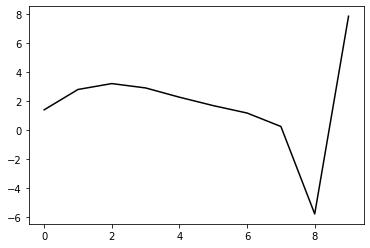

305800 26.71279786343331
0.3377254168603654 -0.2041278030294851 -0.22133065748957742 -0.12614799911525748
[ 1.38092514  2.87510902  3.28297145  2.98310142  2.34550411  1.76496781
  1.25375295  0.32615007 -5.69731429  7.81991871]


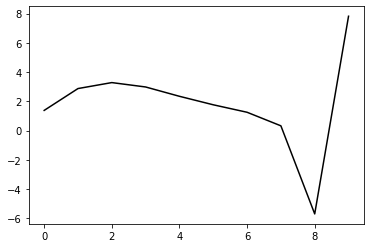

306900 16.3816642650877
0.3410982593971048 -0.20759134258413828 -0.22499544961323598 -0.12290871440344575
[ 1.29484519  2.84723086  3.24256668  2.93313969  2.28827771  1.70204785
  1.18660232  0.25542459 -5.76984529  7.84649479]


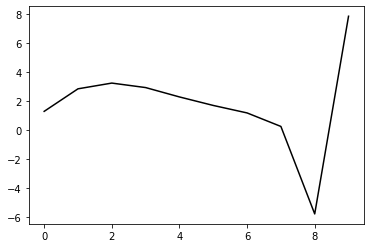

308000 17.796467180705122
0.343608134852011 -0.21019094782964248 -0.22776021058862336 -0.1202922305432268
[ 1.3069614   2.87998155  3.27581527  2.96584883  2.31998117  1.73251095
  1.21603881  0.28358561 -5.74199208  7.79962394]


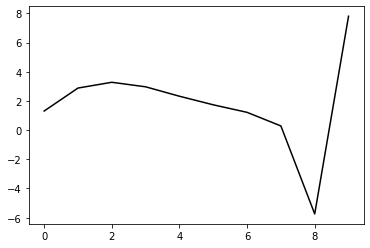

309100 19.97874872613076
0.3436807156216957 -0.2069410861728612 -0.22565742508233902 -0.12181215562809611
[ 1.32669203  2.84944598  3.24841326  2.94140687  2.29866169  1.7141612
  1.20053846  0.26983694 -5.75517384  7.85628847]


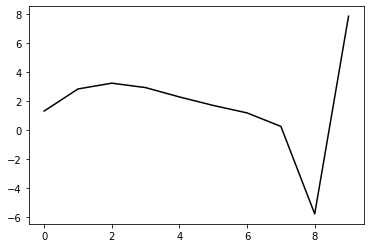

310200 22.580369255985065
0.34137898154127105 -0.20626543004558406 -0.22521340071187407 -0.12137407231562752
[ 1.32843339  2.80423862  3.20270142  2.89428699  2.25054097  1.66537958
  1.15150863  0.21965411 -5.80818254  7.80921774]


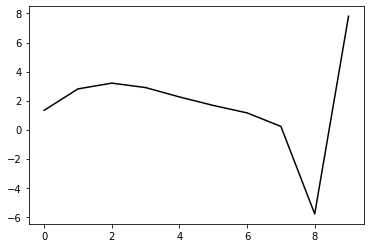

311300 25.31701745250205
0.3337418921770177 -0.20483066100951014 -0.22223541631430763 -0.12454542721622701
[ 1.36220482  2.6869978   3.08060757  2.77140397  2.1294544   1.54763386
  1.03843184  0.11141769 -5.9114484   7.8087402 ]


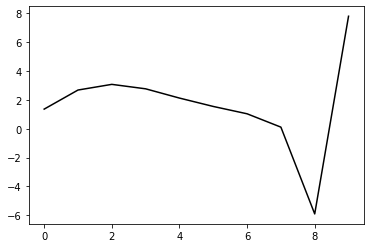

312400 16.618871522978374
0.33442457109991464 -0.2088156658779909 -0.22588546598908735 -0.12246560630208932
[ 1.33924627  2.71842911  3.11901471  2.81537581  2.17732385  1.59793401
  1.09021395  0.16332939 -5.85867801  7.79159353]


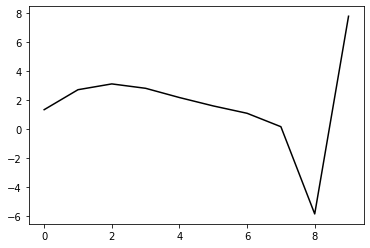

313500 21.753924265151255
0.3402728642251675 -0.20634777988281025 -0.22588525857821576 -0.12179691396491772
[ 1.32185001  2.81965196  3.21425288  2.90454488  2.26075103  1.67585847
  1.16301074  0.23071896 -5.79592695  7.82970011]


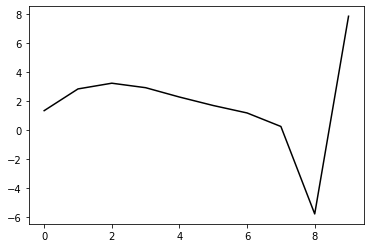

314600 24.318256067386862
0.342418167994051 -0.20438330570080107 -0.22519205394858816 -0.12244795993485001
[ 1.32449268  2.88132527  3.27555366  2.96484247  2.32008116  1.73425861
  1.22076233  0.28737567 -5.74041091  7.81743881]


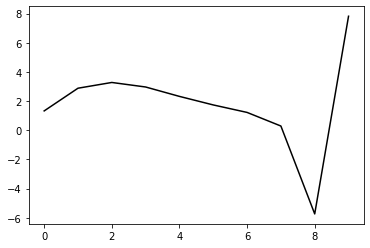

315700 15.221335244265706
0.344091373602566 -0.198736550877059 -0.22159802705154732 -0.12475135538090884
[ 1.37066097  2.90971217  3.3083968   3.00059734  2.35858992  1.77530174
  1.26440404  0.33264613 -5.69493296  7.80248285]


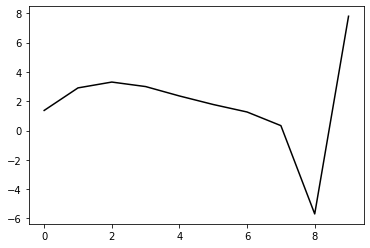

316800 22.62330750827478
0.34284356477982336 -0.20418804653026457 -0.2252294624381151 -0.12198222168076929
[ 1.27950008  2.83368522  3.21325202  2.8880051   2.23187026  1.63810352
  1.12095122  0.1862733  -5.83957929  7.82946642]


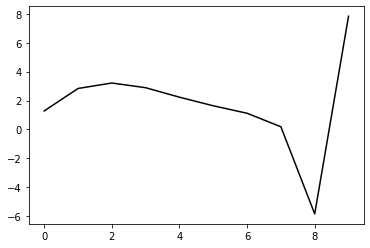

317900 17.981302406751894
0.34355613127108914 -0.20245535110512997 -0.2242104350796268 -0.12287378693768636
[ 1.27824225  2.86368778  3.24433122  2.92108213  2.26763831  1.67642088
  1.16148838  0.22758174 -5.79797497  7.84664036]


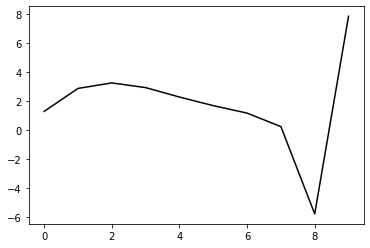

319000 16.671432781040746
0.3437018645862 -0.2053455822984146 -0.22659470738421045 -0.12228559794785833
[ 1.30208468  2.88619557  3.28515335  2.97685365  2.33549168  1.75392112
  1.24699317  0.31882935 -5.70269896  7.79506885]


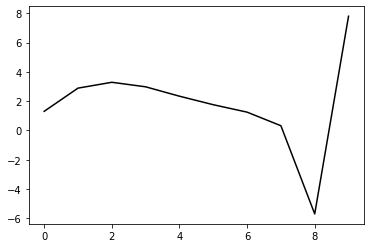

320100 19.730060284916952
0.342601615157996 -0.20434106782479872 -0.22623056046775158 -0.12175562284178011
[ 1.316789    2.80295561  3.20878024  2.90830411  2.2754484   1.70228464
  1.20328182  0.28081776 -5.73766254  7.85719716]


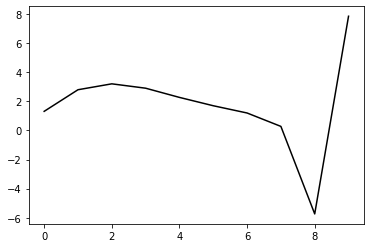

321200 22.170212633632485
0.3371669118022038 -0.20490930260434942 -0.22543533457047668 -0.12251964118112588
[ 1.36765593  2.7265955   3.12314321  2.81470202  2.17565506  1.59794803
  1.09615192  0.17129965 -5.85034322  7.80846671]


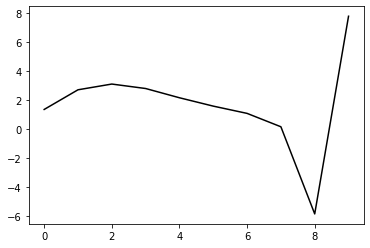

322300 21.793482558821026
0.34271028702801914 -0.2005692812920471 -0.2242694712948398 -0.12041254808581922
[ 1.33446018  2.82204084  3.21987708  2.9096474   2.26714267  1.6847762
  1.17781596  0.24636711 -5.78227035  7.82426084]


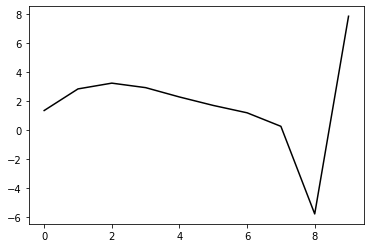

323400 15.436447772343405
0.33603275342025785 -0.2056051092164154 -0.22580115072655185 -0.12300845988871147
[ 1.33955223  2.75933654  3.15731057  2.84880343  2.20840179  1.62854998
  1.12531843  0.19868864 -5.82067402  7.80862528]


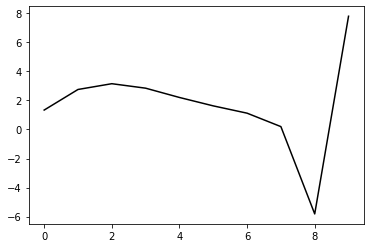

324500 21.333536138406295
0.3368946626995266 -0.20963359274193877 -0.22931562874654748 -0.12042072022487195
[ 1.32120434  2.74448561  3.13590143  2.8220144   2.17689839  1.59282173
  1.08610487  0.15615627 -5.86557325  7.81833484]


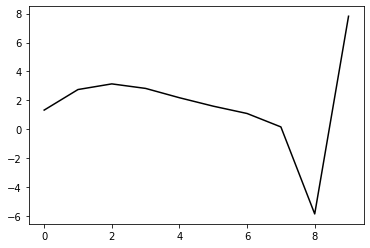

325600 24.42777103893658
0.3430652482480777 -0.20284194747914394 -0.2259507791700533 -0.12248439389069263
[ 1.32476351  2.88289927  3.26964111  2.95011763  2.29928706  1.70954451
  1.19747988  0.26192036 -5.76479364  7.8126851 ]


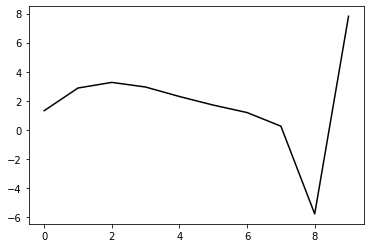

326700 13.634198951042118
0.3438069542462533 -0.20009754756000503 -0.2244507023068608 -0.12461348335931627
[ 1.36332218  2.89020925  3.29538502  2.99037824  2.3514949   1.77152365
  1.26757092  0.3377493  -5.68583978  7.85256707]


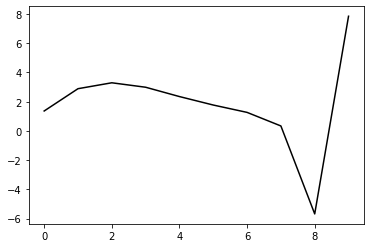

327800 21.889429448125494
0.3394628106801215 -0.20156874788750961 -0.22490310327860816 -0.12582444810732768
[ 1.36417784  2.85222092  3.26840245  2.97392388  2.34465968  1.7731161
  1.27657457  0.35193091 -5.66907537  7.80723408]


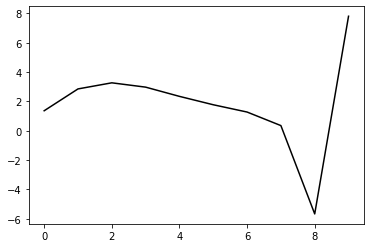

328900 14.461653404076
0.3396949825556128 -0.20389857567359918 -0.22724436661160538 -0.12240996341615558
[ 1.32545607  2.85679821  3.26866913  2.9695661   2.33587817  1.76008725
  1.25963377  0.330406   -5.69546402  7.84489626]


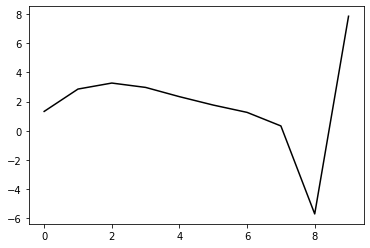

330000 17.985248843443536
0.34300900070384593 -0.20537376326400333 -0.2296202143854767 -0.11894692797361824
[ 1.31028793  2.79114012  3.20015639  2.90045016  2.26769253  1.69354686
  1.1952676   0.26744884 -5.7576007   7.80868701]


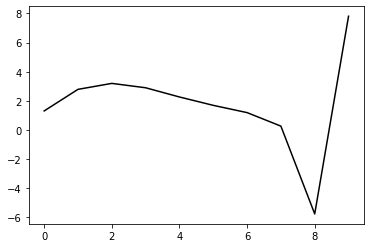

331100 19.6260003931362
0.33957910924236984 -0.20472951989747065 -0.22869357678969346 -0.12112882084179383
[ 1.33847485  2.77205745  3.19266738  2.90426956  2.28157279  1.71605993
  1.22519315  0.30267994 -5.71863598  7.86943321]


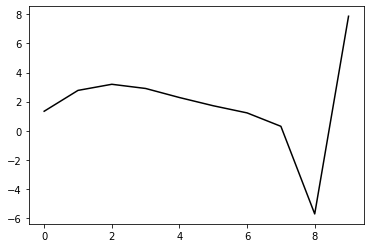

332200 22.769212025536575
0.3375055092614288 -0.20429926480911811 -0.22851899163405073 -0.11990982023176623
[ 1.34117417  2.75348661  3.1773506   2.8927226   2.27359016  1.71099803
  1.2223991   0.30045365 -5.72175843  7.82444057]


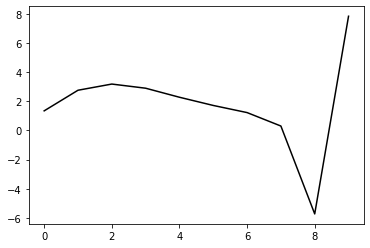

333300 21.235205148191408
0.3396105565368749 -0.19985326479711946 -0.22620012097173645 -0.12132945824755721
[ 1.31251443  2.82377132  3.24128784  2.95084229  2.32668474  1.75969588
  1.26737908  0.34154793 -5.68427756  7.8450353 ]


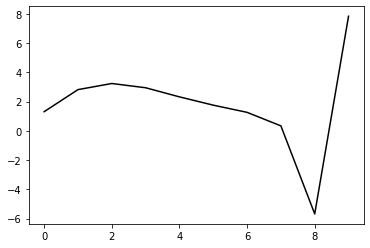

334400 18.016913566332192
0.33201724013971445 -0.20432768043249186 -0.22770734998207928 -0.12070867336901435
[ 1.33694577  2.65675327  3.07374512  2.7852056   2.16376253  1.59992465
  1.11147588  0.1897221  -5.8319238   7.79945698]


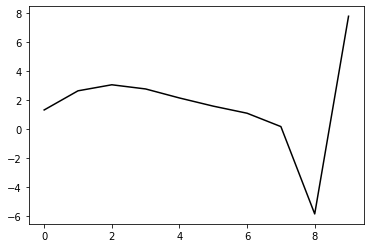

335500 20.994210929156214
0.3335743055914884 -0.20637003997070638 -0.2297740002556205 -0.11983933437804997
[ 1.32416743  2.68942495  3.10069789  2.80713522  2.18082593  1.61232583
  1.11973794  0.19393049 -5.83010434  7.82641964]


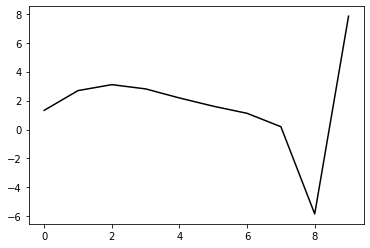

336600 25.460790692202345
0.336815696328004 -0.20405926044262226 -0.2290690818271375 -0.12029178529133876
[ 1.32083818  2.76484411  3.17149113  2.87344426  2.24274593  1.67000378
  1.17357667  0.24387391 -5.78280707  7.81363075]


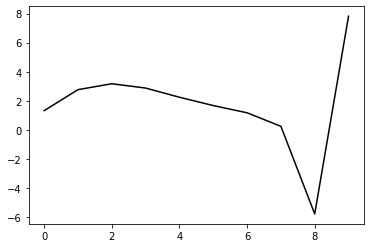

337700 13.625509028643858
0.3378008786233783 -0.19818217723050766 -0.22489401225748745 -0.12470329564563287
[ 1.36875225  2.8266853   3.23722043  2.94172511  2.31270509  1.74113764
  1.24588441  0.31695014 -5.70864762  7.83905762]


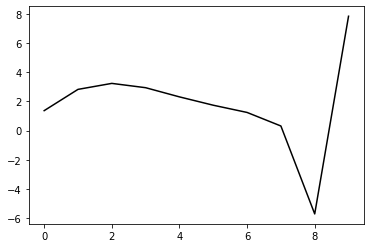

338800 22.831114845496643
0.34074440546124174 -0.19855997382549215 -0.22619879466186196 -0.12207989557978573
[ 1.28235448  2.81137896  3.20427211  2.89325622  2.25161943  1.66988807
  1.16690584  0.23163062 -5.79893311  7.81883138]


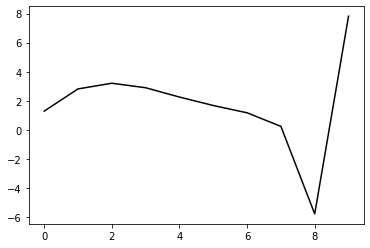

339900 16.239568611253635
0.33840678584211503 -0.20033031410628574 -0.22689350100676334 -0.12373890443137901
[ 1.29040919  2.80641487  3.20636386  2.90326813  2.27004387  1.69683782
  1.20254194  0.27518592 -5.74729974  7.84657838]


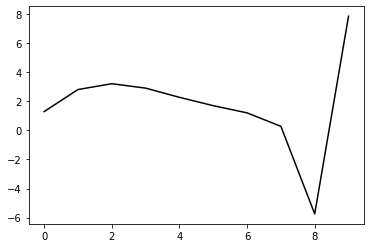

341000 16.723276772185137
0.34225634885550993 -0.1976076511083606 -0.22624828567291008 -0.12315056119823944
[ 1.28820709  2.91078088  3.3105544   3.00568525  2.36979322  1.79321458
  1.29516544  0.36289981 -5.66558482  7.82967719]


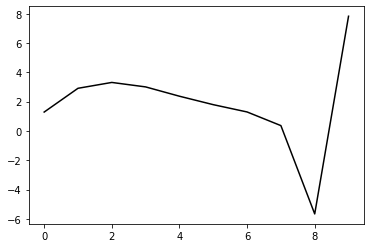

342100 19.597607732592245
0.33926919852014675 -0.2023129298259618 -0.2293502854973851 -0.1217511390920368
[ 1.32045586  2.78227408  3.19649527  2.90616867  2.28437996  1.72123077
  1.23613755  0.31525975 -5.70271082  7.83814393]


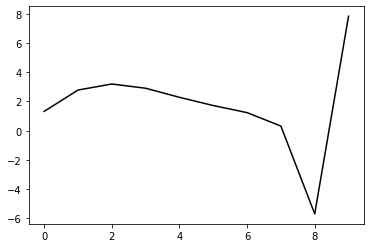

343200 22.365845369515952
0.3405463795550873 -0.19357097843195778 -0.2239081155621999 -0.12239208971070058
[ 1.34211867  2.79866449  3.19712163  2.89332967  2.26082748  1.68888856
  1.19638425  0.26759088 -5.76051081  7.82830788]


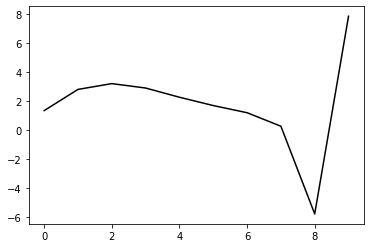

344300 24.832466993708273
0.3302287420551211 -0.200013107720156 -0.22548507074880106 -0.12514423331803576
[ 1.35733871  2.66451332  3.07385273  2.78037313  2.15681196  1.59281328
  1.10829827  0.18756106 -5.83005777  7.8207729 ]


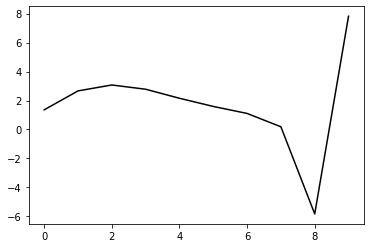

345400 16.336305314189442
0.33042480208814584 -0.2023940368952015 -0.22755960417958282 -0.1237490201857819
[ 1.33006834  2.67796913  3.0835976   2.78676118  2.15965699  1.59207143
  1.10444562  0.18064281 -5.83832795  7.8077614 ]


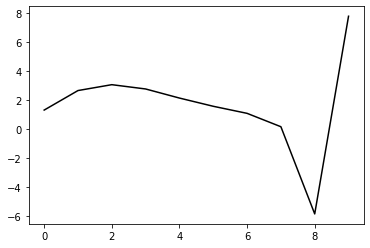

346500 21.925992469960036
0.3352830967795595 -0.20081560613632687 -0.22799180643335226 -0.12344335651942552
[ 1.3141734   2.77230471  3.17744182  2.87968923  2.25117707  1.68173583
  1.19205588  0.26543468 -5.75583127  7.83588339]


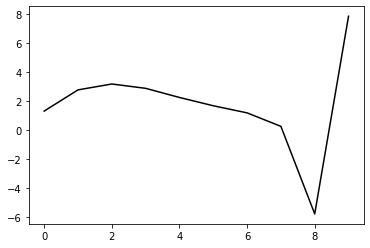

347600 25.355323209663727
0.33609976953915116 -0.20155925740461275 -0.22909549814992267 -0.12167602959150421
[ 1.31145779  2.76064526  3.16138844  2.86075149  2.23020398  1.65920985
  1.16851997  0.24072966 -5.78130219  7.81473083]


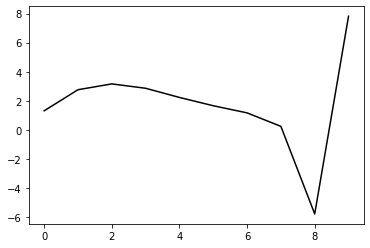

348700 13.518382819112523
0.33559537844638765 -0.19790737974467448 -0.2262150385889463 -0.1258310191636515
[ 1.36065883  2.80494956  3.2167945   2.92463309  2.30045841  1.73440282
  1.24794439  0.32339312 -5.69518599  7.84137947]


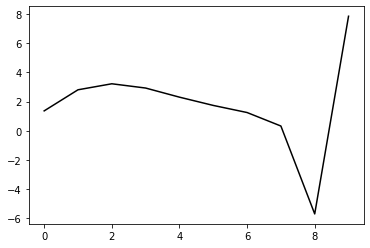

349800 22.628703430405423
0.3359175693807552 -0.19627026032171815 -0.22537125894016122 -0.1259645080368526
[ 1.3263616   2.83510829  3.24016349  2.94239888  2.31402541  1.74475562
  1.25602375  0.32913608 -5.69185508  7.82667875]


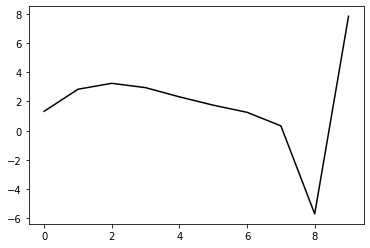

350900 13.208770748859623
0.33602248533627327 -0.19714922140270738 -0.22622771753489934 -0.12570143177807228
[ 1.32529652  2.86423741  3.27559823  2.98241543  2.35708041  1.78946089
  1.30146916  0.37352125 -5.65046603  7.87912232]


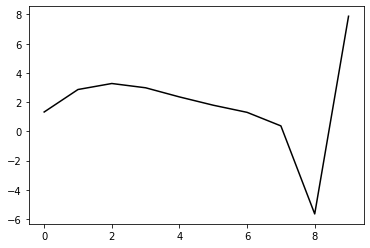

352000 15.254735480316905
0.33899424968624664 -0.19559860546154936 -0.22628923154204375 -0.1238697123974307
[ 1.29859587  2.86598131  3.26999699  2.96968126  2.33828291  1.76553812
  1.27355332  0.3414434  -5.68680623  7.85345607]


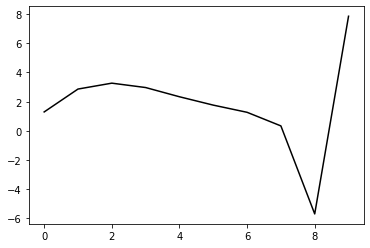

353100 19.633780128420366
0.3341547939020664 -0.2030478560930579 -0.2306080776557247 -0.12153804101722762
[ 1.33419905  2.71931029  3.12453058  2.82634192  2.19798471  1.62933602
  1.14321484  0.21806718 -5.80022872  7.82378565]


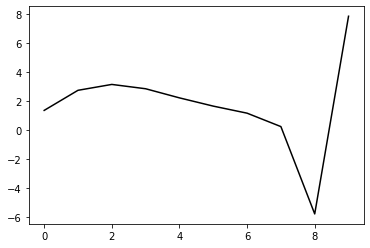

354200 22.26641334708484
0.3380199601487279 -0.19498174304966123 -0.22627342361630204 -0.12169917004273559
[ 1.31654495  2.79616703  3.19317835  2.88551244  2.24736637  1.66879528
  1.17300785  0.23750499 -5.79266669  7.81983239]


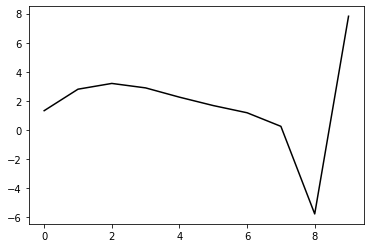

355300 20.984493194890526
0.3365081781641476 -0.19721362794136416 -0.2278275883977613 -0.12137903209111697
[ 1.33249844  2.7957614   3.21005789  2.91777069  2.29299519  1.72605197
  1.24072955  0.31379357 -5.70861929  7.84588788]


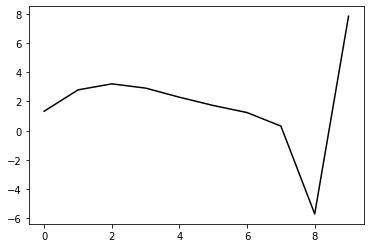

356400 14.229219983852406
0.3350609038465834 -0.19726538398182636 -0.2274138971368767 -0.12304161004796081
[ 1.35704676  2.80356948  3.21974906  2.92930696  2.30628224  1.74099579
  1.25766194  0.33228792 -5.68784376  7.84195861]


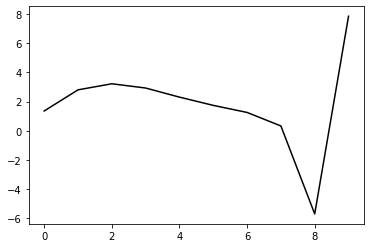

357500 21.65963632185407
0.334977077902287 -0.1961174743800253 -0.2267821262586353 -0.12209658436079103
[ 1.32084147  2.79416787  3.19774735  2.89618526  2.26383562  1.69072011
  1.20102644  0.2696056  -5.75599046  7.8300331 ]


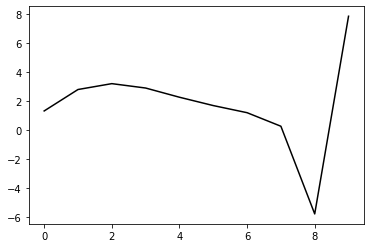

358600 25.635824305425338
0.3373470530546127 -0.19971335876056714 -0.2301764198710951 -0.1200197647171609
[ 1.30493433  2.78474365  3.19362528  2.89583226  2.26632322  1.69563015
  1.2087178   0.27989049 -5.74211427  7.7836326 ]


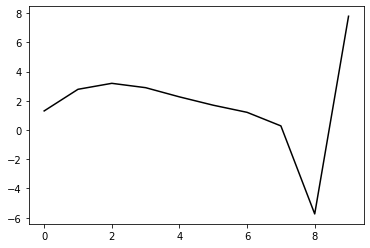

359700 14.654971462525392
0.33083020778956274 -0.19919578033846527 -0.22790402852392302 -0.12354477751940039
[ 1.39062878  2.70043152  3.1042933   2.80364561  2.17182967  1.59904177
  1.11062864  0.18061253 -5.8404314   7.82915441]


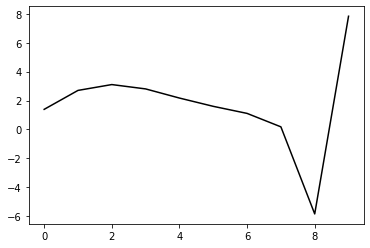

360800 26.050165534716793
0.33445355559431605 -0.19434654378865254 -0.22510059753965939 -0.12669144393206283
[ 1.37909785  2.83388074  3.23931437  2.93797814  2.30416565  1.72881252
  1.23801292  0.30561806 -5.71687736  7.82114824]


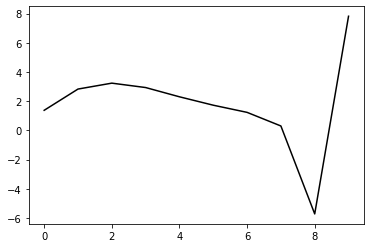

361900 13.779566805466478
0.338023916641676 -0.1951126894212853 -0.22674114102971887 -0.1256271248102926
[ 1.31542753  2.92080841  3.31773539  3.00814694  2.36698803  1.78513104
  1.28879776  0.35104236 -5.67670044  7.83991817]


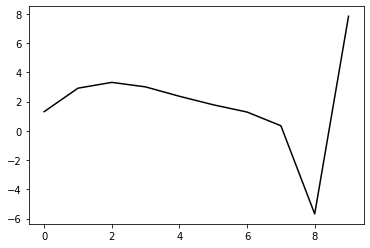

363000 18.32182133808118
0.3388444547070518 -0.20077766527601254 -0.2315710175816564 -0.12038098850558066
[ 1.29652761  2.79316122  3.18648063  2.8748535   2.23319976  1.65190328
  1.15718012  0.22125169 -5.8030223   7.80335162]


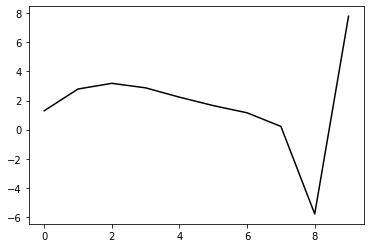

364100 24.93855051846897
0.33142935337656415 -0.1988749810467203 -0.2283150125909207 -0.12521263460453094
[ 1.40300994  2.68527451  3.08443145  2.77912944  2.14339281  1.56745515
  1.07783089  0.14621398 -5.87344354  7.84826458]


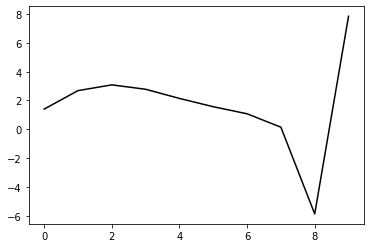

365200 23.775848383817582
0.3327096127245678 -0.19536611807849535 -0.22626576570334392 -0.12607688030345912
[ 1.35931113  2.76939238  3.15645382  2.84009048  2.19444225  1.6095195
  1.11184464  0.17240085 -5.8541598   7.79171257]


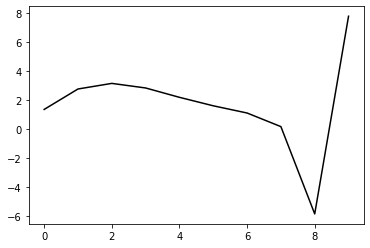

366300 22.209940336147884
0.339719660256055 -0.19154485855508774 -0.22553701194611817 -0.12524502348763214
[ 1.30637772  2.93991105  3.32193143  2.99900721  2.34690712  1.75585626
  1.25268531  0.30767038 -5.72496644  7.8421466 ]


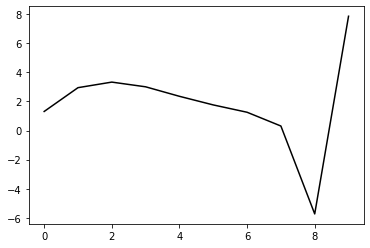

367400 14.151621870649937
0.33571544428696737 -0.19727926078170072 -0.22888243238533315 -0.12488112024079809
[ 1.35289905  2.85381307  3.26281527  2.96284989  2.3301169   1.75561137
  1.26734861  0.33551568 -5.68400212  7.82723507]


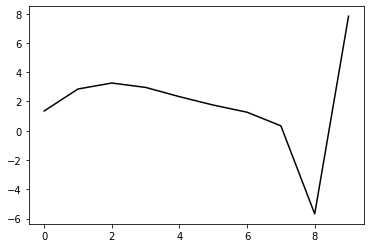

368500 23.271073036693338
0.3349972698751928 -0.19844308654682538 -0.22981376190343059 -0.12582820163869948
[ 1.31613795  2.87584877  3.29028455  2.99351325  2.36289479  1.78988331
  1.30309734  0.37184905 -5.64821616  7.87093999]


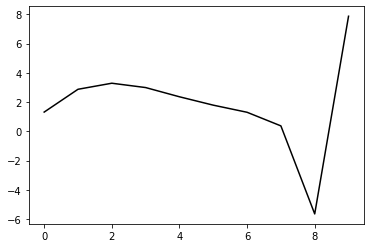

369600 24.811394996278192
0.3365395334729606 -0.19725797325273361 -0.22963047052146848 -0.12591532131849775
[ 1.32864353  2.96022458  3.38026354  3.08617866  2.45662695  1.88359425
  1.39624895  0.46277015 -5.56192822  7.81914174]


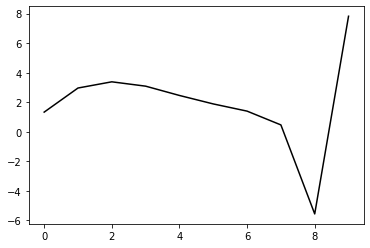

370700 14.82195708259736
0.33268683665931065 -0.19549398676312066 -0.22797853019400932 -0.12368847094763682
[ 1.39672321  2.75837174  3.17453586  2.88072875  2.25377814  1.68448317
  1.20153831  0.27193125 -5.74825641  7.82787805]


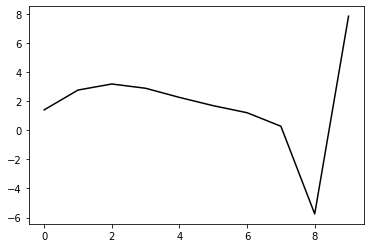

371800 25.244811081864082
0.3351288174256418 -0.19102892597401755 -0.22572648774108026 -0.125201917791304
[ 1.37849086  2.84420688  3.26125221  2.96748474  2.34037565  1.77068759
  1.28717405  0.35566701 -5.66799272  7.81659453]


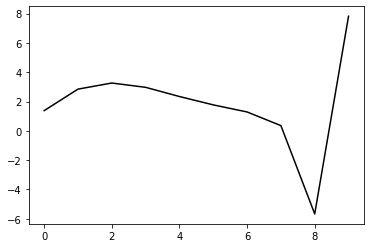

372900 13.850420686236141
0.3350830028825755 -0.19379010397729915 -0.2277400497049285 -0.12446652232276938
[ 1.31827216  2.85852183  3.2659829   2.96399685  2.32996653  1.75454861
  1.26669494  0.33154715 -5.69433647  7.84464805]


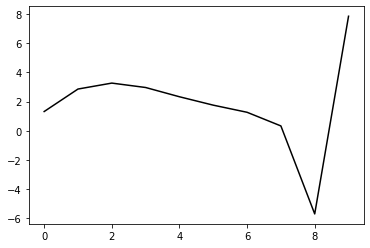

374000 16.930730215559088
0.331197993341524 -0.19779381876797544 -0.2299578535087822 -0.12264902350092981
[ 1.34639172  2.74438999  3.15104448  2.84969849  2.21745449  1.64487125
  1.16110814  0.23045599 -5.78943332  7.81406549]


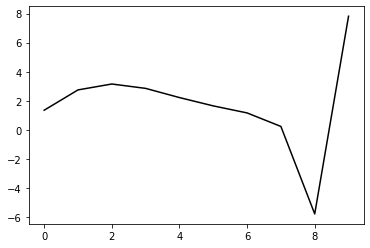

375100 22.03062351733045
0.3307503086841705 -0.19554810378283732 -0.22861074953085786 -0.12253620950301777
[ 1.34404448  2.71704126  3.12578968  2.82770782  2.19891238  1.62936101
  1.14816147  0.2187164  -5.80166645  7.81658523]


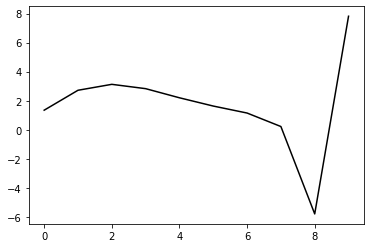

376200 22.278549199737142
0.3342363546675923 -0.1925865501610023 -0.22772031705389517 -0.12229792082557801
[ 1.35081533  2.75924899  3.16992675  2.87318224  2.24527095  1.67625261
  1.19542318  0.26547338 -5.75587464  7.82590114]


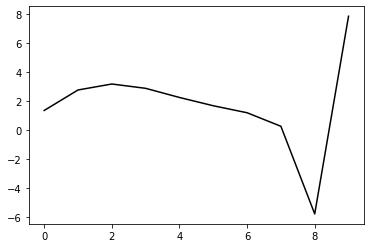

377300 24.314981744557944
0.32944555805113374 -0.19289869799093431 -0.22699946153098646 -0.12366942431036601
[ 1.35765112  2.71547529  3.13302741  2.84213021  2.21906306  1.65413445
  1.17711737  0.25008027 -5.76870599  7.81955465]


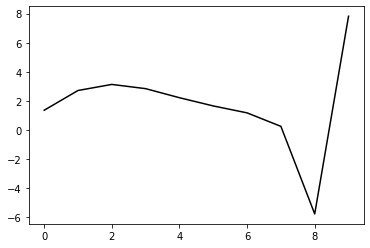

378400 15.081478498174604
0.3284589719454149 -0.19596900875722512 -0.22861156982745942 -0.1242585428643241
[ 1.36553964  2.7209186   3.14205945  2.85545933  2.2364653   1.67567628
  1.2035126   0.28174364 -5.72927057  7.83225895]


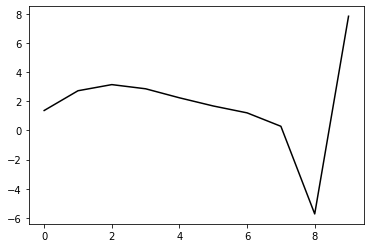

379500 21.57087972214204
0.32759043510741165 -0.2024019806349305 -0.23304049809183883 -0.12126268461314549
[ 1.316527    2.65418022  3.05817747  2.7583755   2.12890464  1.55991637
  1.08185169  0.15579044 -5.85751768  7.77126207]


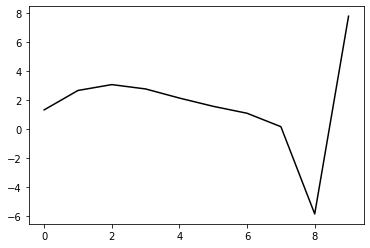

380600 25.072471265617885
0.3342402623294253 -0.19598890678459274 -0.22991092071120203 -0.1230053954595781
[ 1.31014456  2.80636831  3.19857738  2.88674886  2.24555369  1.6653902
  1.17708062  0.24136869 -5.77995165  7.8125974 ]


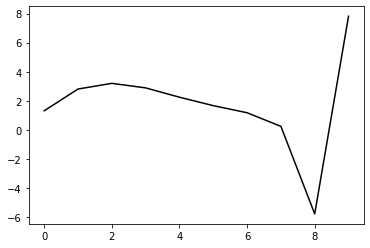

381700 13.577032816793253
0.33306422658631435 -0.19331024421373105 -0.22762596344451821 -0.12670279804344148
[ 1.35999594  2.82605579  3.22918255  2.9256797   2.29091359  1.71592602
  1.23222566  0.30025491 -5.71746752  7.8322144 ]


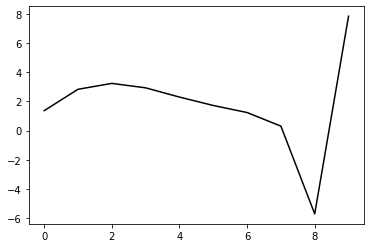

382800 22.472668045110733
0.33504539397625294 -0.19155166573930366 -0.22724640341854319 -0.12676412229510192
[ 1.32570882  2.85838851  3.25795564  2.95049612  2.31259651  1.73510596
  1.24951437  0.31521369 -5.70534893  7.79302964]


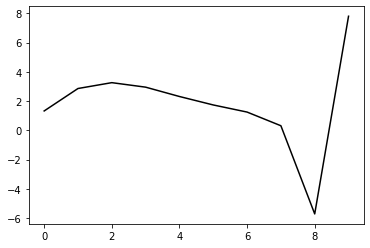

383900 14.969580279155196
0.331451896648596 -0.1951393025962686 -0.22906375288549802 -0.12428881113608282
[ 1.29964887  2.71411501  3.08936721  2.76343242  2.11214726  1.52525579
  1.03390015  0.09627912 -5.92541153  7.84997472]


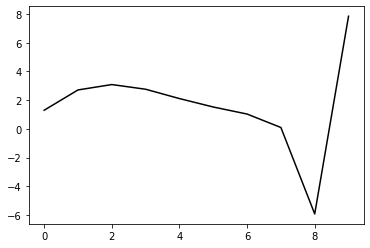

385000 26.577186167179505
0.33746226535828205 -0.20159850017740882 -0.2356141285732058 -0.12033518459864877
[ 1.28051436  2.77552971  3.1738587   2.86437256  2.22411765  1.64458138
  1.15850261  0.22432527 -5.7931762   7.79382523]


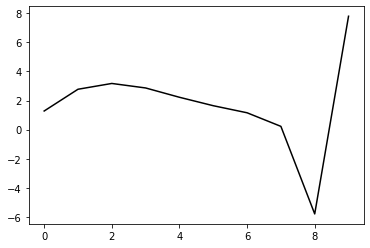

386100 24.560904937121467
0.3308785118206128 -0.1954659256628217 -0.22922855499127254 -0.12640112826791422
[ 1.39312809  2.68831966  3.08213286  2.76969131  2.12718849  1.54582362
  1.05851864  0.12315171 -5.89466328  7.84714958]


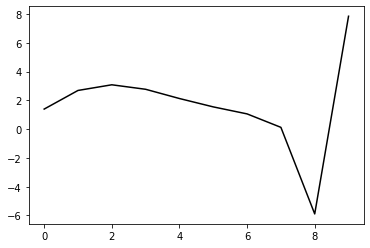

387200 24.776112536859667
0.32964126031256397 -0.19300318937402763 -0.2274506741612461 -0.1282213801016555
[ 1.35851156  2.75057408  3.14361609  2.83001916  2.18603272  1.60280232
  1.11335736  0.17497376 -5.84572479  7.78546362]


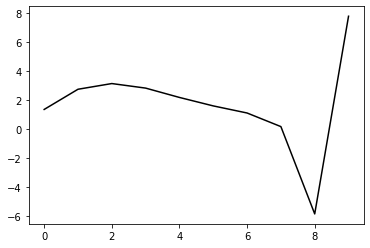

388300 24.649441153076207
0.3300076129243319 -0.19259426035425625 -0.2276030970863482 -0.12697887764376953
[ 1.34376851  2.74209683  3.12916642  2.81100484  2.16357801  1.57765581
  1.08627044  0.14602345 -5.87629697  7.83543463]


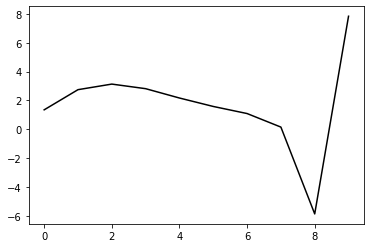

389400 14.25204060334784
0.3323254369049147 -0.19376637089200188 -0.22917590865597884 -0.1267433120038056
[ 1.32756851  2.82561133  3.21662742  2.90052332  2.25401637  1.66835298
  1.17712434  0.23663994 -5.78455327  7.8079455 ]


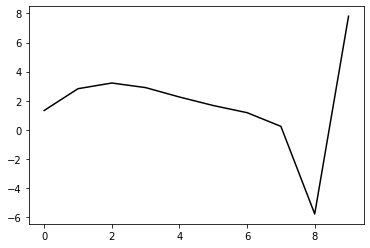

390500 21.845013114774613
0.334830222870745 -0.19157775125153656 -0.22852086879485928 -0.12632743619446066
[ 1.31949559  2.87443007  3.26131916  2.9407511   2.29050638  1.70164277
  1.20771143  0.26409848 -5.7606575   7.84391582]


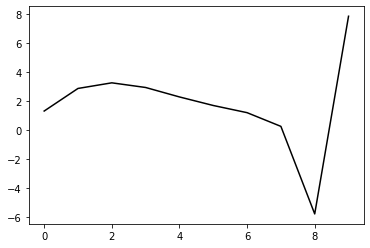

391600 25.35959027339816
0.33165536548257135 -0.19841598900967544 -0.23307320196319709 -0.12370187232147963
[ 1.32041157  2.79775024  3.18486818  2.86539626  2.2168275   1.63000963
  1.13866511  0.19757222 -5.82395506  7.80199375]


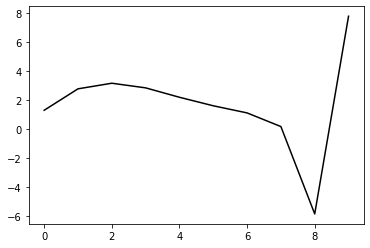

392700 13.414347555407128
0.33350044800771794 -0.1923603022462868 -0.22915002384856428 -0.12759305248987055
[ 1.35433987  2.86082012  3.25344203  2.93772737  2.29190357  1.70714657
  1.21759204  0.27758876 -5.74283417  7.833404  ]


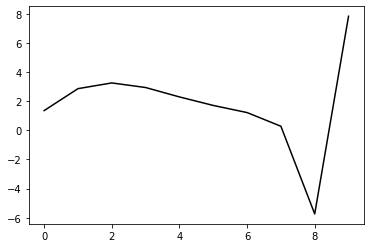

393800 26.106060886091825
0.3320518547577697 -0.19144134186600442 -0.22824632048224588 -0.1299124759188011
[ 1.37172169  2.86821576  3.27061096  2.9625968   2.32334034  1.74430246
  1.25994267  0.32381421 -5.69424981  7.81524807]


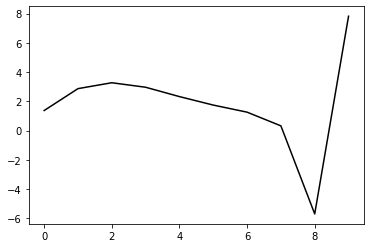

394900 17.139575189286354
0.333257957205385 -0.19475456977804836 -0.2312617511283574 -0.12677390803855124
[ 1.27881844  2.82767801  3.21099495  2.88868373  2.23835859  1.65049354
  1.15928497  0.21747871 -5.80354217  7.85079876]


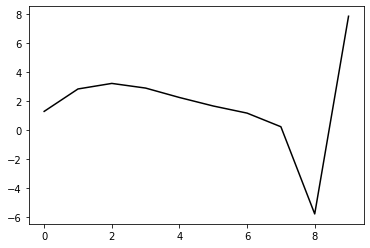

396000 18.17930301461001
0.33601189482606736 -0.19750717029170092 -0.2342047136835547 -0.12435247738993105
[ 1.28787126  2.85095631  3.2362014   2.91532615  2.26627482  1.67958012
  1.18968327  0.24878118 -5.77074576  7.79921884]


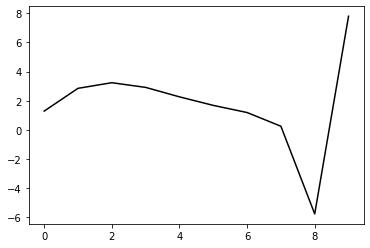

397100 22.67137678936995
0.3329766956300336 -0.194503959718221 -0.23138771455074175 -0.12674510762740918
[ 1.35520614  2.76960444  3.1591452   2.842186    2.19646619  1.61247999
  1.12489991  0.18541669 -5.83255053  7.85060836]


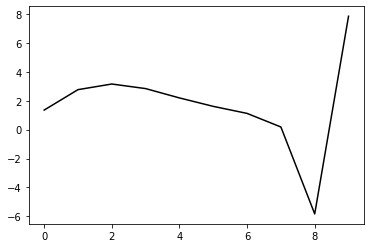

398200 23.802192867707056
0.33234528496624743 -0.19023094270168336 -0.2284946861431377 -0.12757641831412725
[ 1.35510729  2.7753219   3.15542088  2.83021202  2.1781022   1.5890407
  1.09734431  0.15354514 -5.86975837  7.78119496]


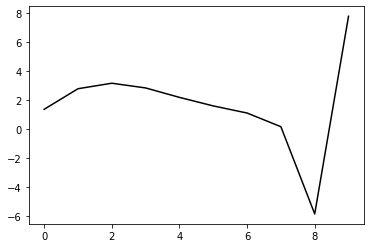

399300 21.00436207355449
0.33403156924507177 -0.19277141283965224 -0.23102231676883708 -0.12594845846332722
[ 1.32021666  2.84719642  3.23687973  2.91883194  2.27225647  1.68761046
  1.19986903  0.25919712 -5.76060085  7.84443781]


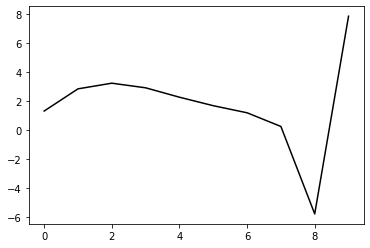

400400 16.439682567712097
0.3283198139567564 -0.19406341732548119 -0.2306960857696636 -0.1263787010713839
[ 1.3190154   2.72185557  3.10408299  2.78191073  2.13334938  1.54805866
  1.06093505  0.12132063 -5.89671713  7.79244401]


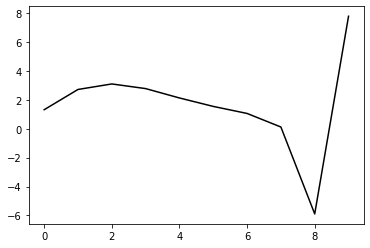

401500 21.932629376493853
0.332328752578766 -0.1937387486787548 -0.23175362475347713 -0.12665588284388635
[ 1.30991311  2.81357436  3.20313428  2.88596177  2.24061372  1.65718966
  1.17108709  0.2312897  -5.78678995  7.82962031]


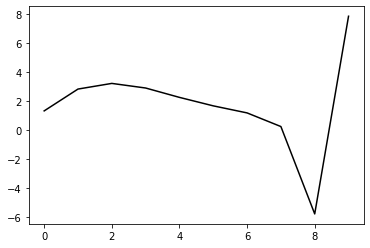

402600 25.37730226298656
0.3312884498029758 -0.19697088021200254 -0.23420722006223915 -0.12482428658454706
[ 1.31559598  2.7693716   3.16192997  2.84813355  2.2057133   1.62466405
  1.14060996  0.2020004  -5.81499574  7.80545711]


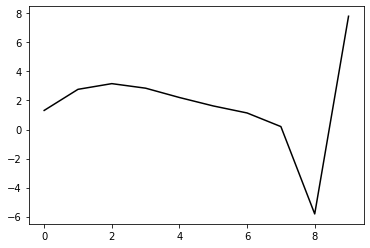

403700 13.256280354259223
0.3329429370537851 -0.19088312545278247 -0.23018794881476734 -0.12822832210481905
[ 1.3497736   2.82659463  3.22022153  2.90646038  2.26362198  1.68192339
  1.19729872  0.25773947 -5.75984802  7.8335862 ]


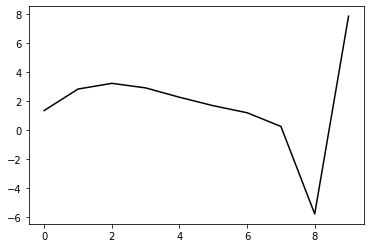

404800 29.70231559440593
0.33078953859281357 -0.1892672676007027 -0.2285196498526785 -0.13102744463922258
[ 1.37661309  2.84470724  3.24849495  2.94235458  2.3051947   1.72785662
  1.2469022   0.30999365 -5.70540367  7.82179782]


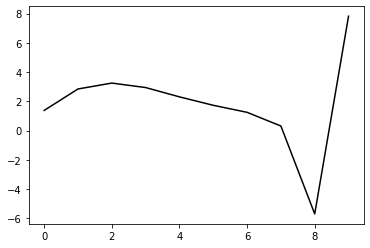

405900 15.765963268703334
0.3333314866644951 -0.192162139348889 -0.23156740618488933 -0.1279083430495989
[ 1.28074442  2.80986413  3.19859248  2.88207828  2.23769349  1.6551406
  1.17056029  0.23067757 -5.78583824  7.838925  ]


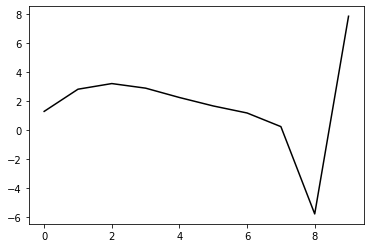

407000 17.605523586793428
0.3355747198411833 -0.19542166272845046 -0.23481069369850116 -0.12465426457812157
[ 1.29450661  2.80656432  3.19965301  2.88636626  2.24433335  1.66351276
  1.18042724  0.24137215 -5.77377729  7.79538966]


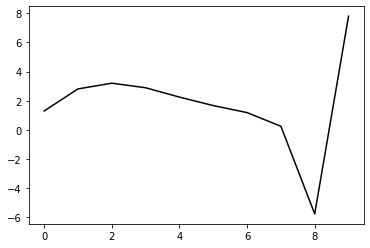

408100 21.328607824909927
0.3343998264864299 -0.18847594057821457 -0.22964083398384957 -0.12804416259959975
[ 1.3637749   2.78584458  3.17353009  2.8557549   2.21043569  1.62702675
  1.14174833  0.19979253 -5.81940604  7.8525649 ]


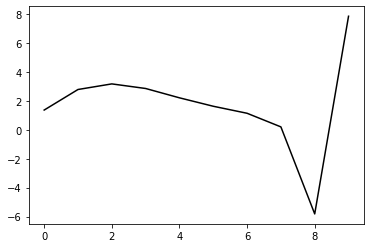

409200 22.62184620422815
0.33233638471259813 -0.19182859482028486 -0.23199603888919879 -0.12608568220936014
[ 1.31885633  2.75434337  3.14347196  2.82804392  2.18565278  1.60533587
  1.12322827  0.18362429 -5.83377786  7.79790324]


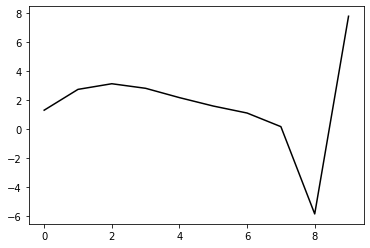

410300 21.5950842556348
0.33160782275394973 -0.18949672999982248 -0.2305202256442964 -0.12655591117526313
[ 1.31123403  2.80785987  3.19542665  2.87629413  2.22965185  1.64494072
  1.15859372  0.21411702 -5.80837942  7.83410204]


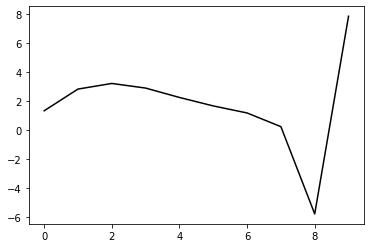

411400 14.857595397867499
0.32901347998435454 -0.19031297848389417 -0.23061080712650806 -0.12681164101223505
[ 1.33422687  2.74252406  3.13535153  2.82224262  2.18184448  1.60339394
  1.12346999  0.18481165 -5.83177259  7.80002354]


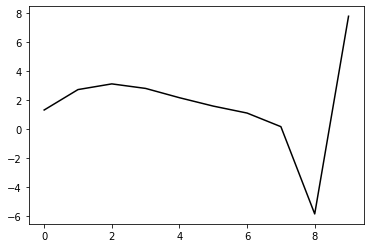

412500 22.105024940396458
0.32919118764297634 -0.1923250249374848 -0.23221542060821956 -0.12878440435469607
[ 1.33967726  2.78709195  3.20353948  2.91036127  2.28627398  1.7211623
  1.25228723  0.32188581 -5.68853778  7.8455003 ]


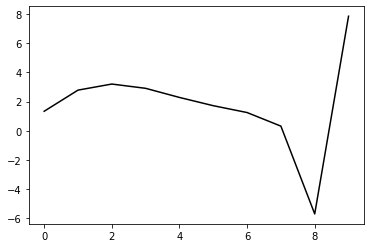

413600 24.978658655007585
0.3303789590538748 -0.19156822059432735 -0.23247310179350172 -0.12602114950133167
[ 1.29948747  2.81474995  3.21334834  2.90372595  2.26538837  1.68787032
  1.20816624  0.26731513 -5.75314386  7.8101822 ]


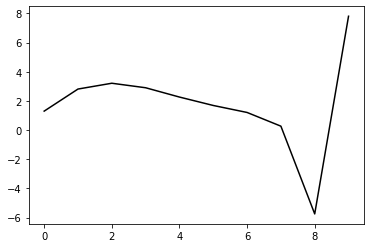

414700 14.281793419107432
0.330836911846503 -0.189103278758014 -0.23103198614656337 -0.12858211731017322
[ 1.32468767  2.82909224  3.23804478  2.93799621  2.3083371   1.73849283
  1.26545096  0.32917822 -5.68906015  7.86174753]


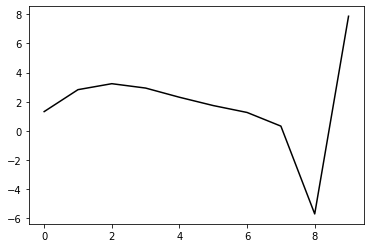

415800 28.14733737761808
0.32580521249706546 -0.18895270959319768 -0.22979759315734305 -0.13153261265523902
[ 1.37105933  2.78617384  3.21004063  2.92448282  2.30794681  1.74985528
  1.28748452  0.36028624 -5.64936467  7.82737384]


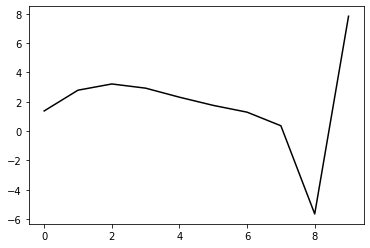

416900 17.437625800987092
0.3291331514689155 -0.1906584225761274 -0.23234695961806673 -0.1270442768001123
[ 1.27403995  2.77624394  3.17500729  2.87054194  2.23935455  1.66951212
  1.19752784  0.26166331 -5.75539003  7.84458287]


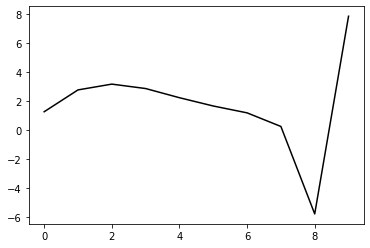

418000 15.194168821562931
0.33271395206542603 -0.18638719437638446 -0.2304119011389987 -0.12757333885838093
[ 1.28027959  2.87173686  3.26660996  2.9577617   2.32222194  1.74807069
  1.27186504  0.3310154  -5.69232355  7.82701032]


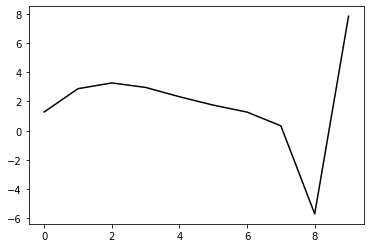

419100 19.663187776325714
0.32951831696756784 -0.19106043583760168 -0.23347677149947504 -0.12569391414379769
[ 1.30294136  2.74048424  3.15416822  2.86270847  2.2426599   1.68221077
  1.21844761  0.28814081 -5.72587067  7.84218816]


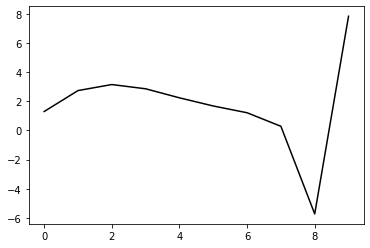

420200 21.72784178562465
0.32571397277463376 -0.18584170544164122 -0.2295226121175902 -0.12597413253851095
[ 1.31794927  2.66684486  3.07395744  2.77659743  2.15086747  1.58459531
  1.11477033  0.17689868 -5.84855692  7.80327821]


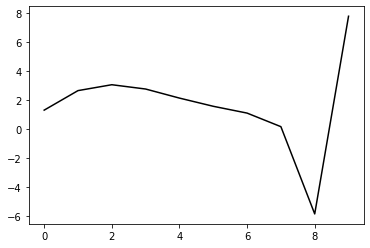

421300 21.08904246119934
0.32909628647574063 -0.188001475665489 -0.23219469203877283 -0.12336096140081328
[ 1.30896643  2.73488363  3.14919336  2.85772074  2.23642226  1.67352205
  1.2065733   0.2705695  -5.75211047  7.78369444]


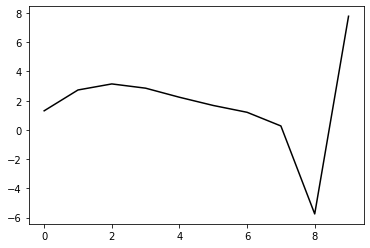

422400 18.39710348131989
0.3260304953557168 -0.18896616935785795 -0.23237480160065357 -0.12503486157864685
[ 1.28431466  2.74908202  3.16298926  2.87044739  2.24759047  1.6830006
  1.21472734  0.27698717 -5.74765308  7.86036387]


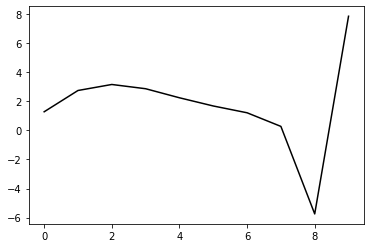

423500 21.810902321645404
0.32562829745458377 -0.18978708073211525 -0.23320720725671767 -0.12414282584605849
[ 1.30823887  2.7138893   3.12801132  2.83794808  2.21852281  1.65785727
  1.193895    0.25999503 -5.75985467  7.85835041]


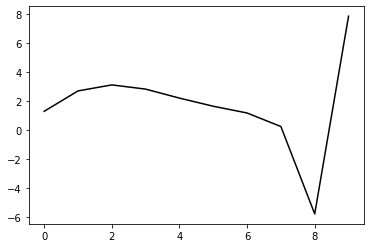

424600 25.710621372611275
0.3266520619252065 -0.19049179376177097 -0.23416271219863213 -0.1227530108840357
[ 1.29839788  2.7105135   3.1210575   2.82855403  2.20668825  1.64353888
  1.1773482   0.24099413 -5.78091558  7.81175894]


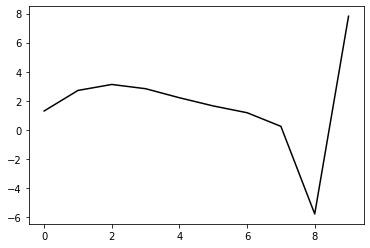

425700 13.38697097675776
0.3238881612290518 -0.1883574832250195 -0.2318002078926413 -0.12636259948056075
[ 1.36317078  2.68757999  3.10321355  2.81501208  2.19607423  1.63493852
  1.17052451  0.23560003 -5.78345572  7.82959659]


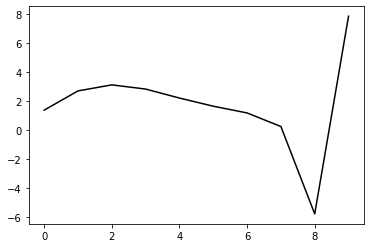

426800 27.045270515538668
0.32277257103542817 -0.18506062651693841 -0.22900455878245432 -0.12988647653871768
[ 1.36442764  2.76757294  3.181681    2.89156815  2.27017458  1.70638181
  1.23959089  0.30233537 -5.71760153  7.81331491]


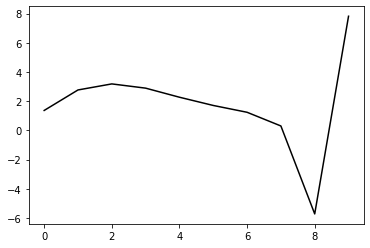

427900 16.92089132061038
0.3267513699493791 -0.18881278495128914 -0.23282081856196463 -0.12662970463653028
[ 1.27467124  2.76442156  3.16356184  2.86146061  2.23011144  1.65798864
  1.18452031  0.2417393  -5.78126485  7.84959851]


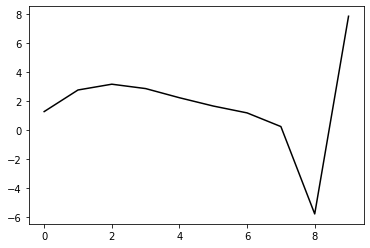

429000 17.71423653677855
0.32964791228443546 -0.1914815041504574 -0.2356520366422823 -0.12461948306800164
[ 1.28804833  2.78831037  3.19166022  2.89288386  2.26412585  1.694116
  1.22264474  0.28133986 -5.73979725  7.80174074]


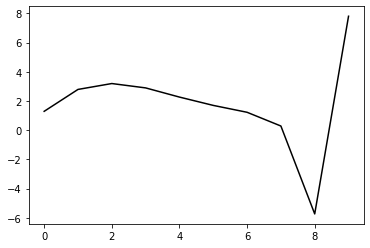

430100 21.25277000821311
0.3280852378147282 -0.18893845598332204 -0.23359557765372066 -0.12638805129257374
[ 1.32331904  2.73081981  3.14122502  2.84920504  2.22652025  1.66183151
  1.19508231  0.25719434 -5.76174838  7.85360336]


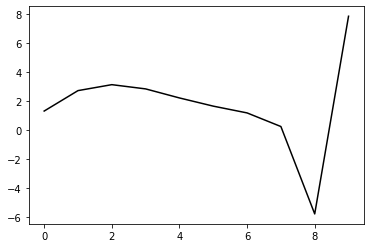

431200 22.56593088259391
0.32324902723431115 -0.1872639947776579 -0.2313343395926946 -0.1276226439253737
[ 1.33918069  2.61713495  3.02538582  2.7349205   2.115178    1.55386126
  1.09070281  0.1556342  -5.8615227   7.79807411]


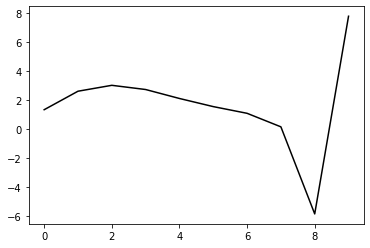

432300 20.667654169985962
0.32653214045603135 -0.19043600632679747 -0.23468282943855812 -0.12616895294097186
[ 1.3009137   2.73430031  3.14990446  2.86459165  2.24829594  1.68936926
  1.22815795  0.29408934 -5.72165337  7.83850153]


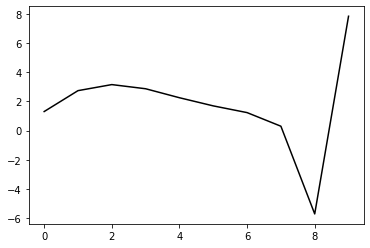

433400 16.40017209605395
0.3215382606023424 -0.18942845961988233 -0.2328029453170697 -0.12724731369936124
[ 1.31179131  2.613098    3.02235822  2.73463661  2.11744037  1.5583679
  1.09775908  0.16431186 -5.85053757  7.80086721]


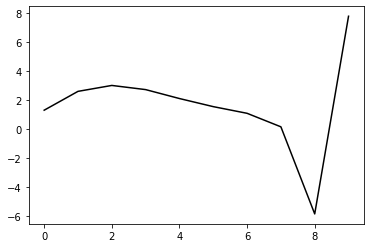

434500 21.778189897302543
0.32476432347032796 -0.18933304193137898 -0.2338894880132309 -0.12695761291048968
[ 1.29907517  2.69413836  3.10662044  2.82092718  2.2043763   1.64490045
  1.18323414  0.2476754  -5.76903321  7.8347172 ]


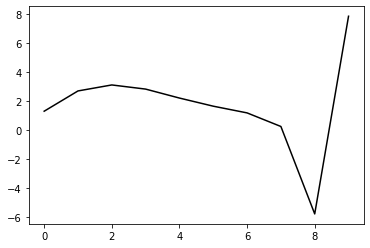

435600 25.10492639318821
0.3261899521218466 -0.18968277836705857 -0.234696058148084 -0.12640354152552893
[ 1.29952771  2.70755206  3.12166306  2.83774953  2.22237561  1.66358787
  1.20246187  0.26687931 -5.74959706  7.82173029]


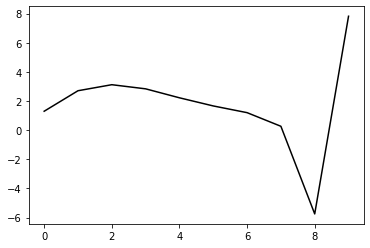

436700 14.010890905832932
0.32326185041551236 -0.1876999325508303 -0.23267566716633686 -0.12858976117965487
[ 1.36104918  2.64504318  3.06607255  2.78878016  2.17871481  1.62412184
  1.16651758  0.23345519 -5.78058389  7.83166421]


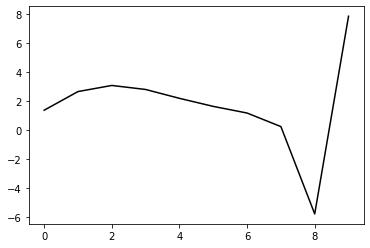

437800 29.229442707478743
0.32357444403928776 -0.18427348063176144 -0.23019385936987724 -0.13176583650568222
[ 1.36634074  2.74428126  3.16777024  2.89183883  2.28211019  1.7272515
  1.269257    0.33536309 -5.67905299  7.83132857]


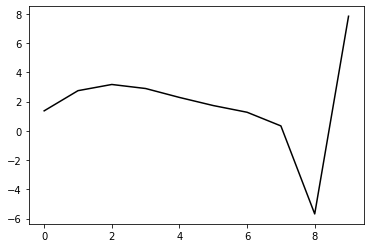

438900 18.015145726872888
0.3270293333760411 -0.1871781420494882 -0.233425352964013 -0.12789903752498535
[ 1.26427342  2.72754895  3.13121649  2.8405914   2.21952051  1.65561027
  1.1904695   0.25051863 -5.76770469  7.84818512]


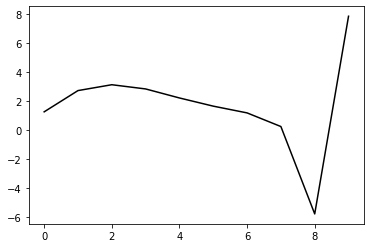

440000 17.792974787640222
0.3305946953937831 -0.18594432705133226 -0.23355392276012807 -0.1273968974870674
[ 1.26496315  2.82693484  3.22982258  2.93765405  2.31470843  1.74871635
  1.28145318  0.33864809 -5.68364234  7.81573486]


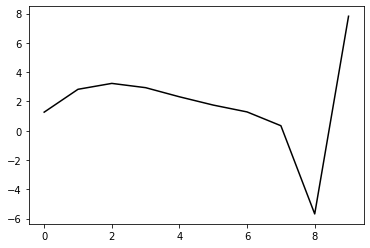

441100 20.167277743582133
0.3269720457879622 -0.1881783876150992 -0.23460812500499176 -0.12655414346710656
[ 1.28031802  2.73038473  3.13913589  2.85281817  2.23518736  1.67405691
  1.21164185  0.27316471 -5.74433117  7.83766316]


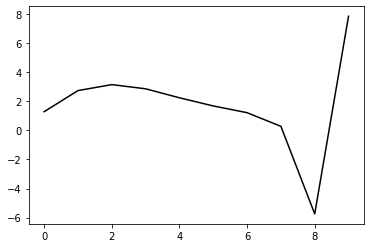

442200 22.092934731728754
0.3289379784868306 -0.18366922516190065 -0.23210617316044005 -0.12627259574603153
[ 1.28602474  2.73213011  3.12630932  2.82629666  2.19638156  1.62414204
  1.15186662  0.20365437 -5.8246744   7.81718014]


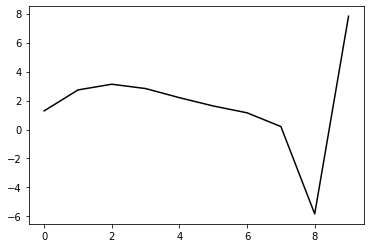

443300 20.112599906305768
0.3253572411426139 -0.19054814080460086 -0.23642889669286826 -0.1266188924391735
[ 1.32174945  2.68891851  3.11636267  2.84752915  2.24514708  1.69692006
  1.24593567  0.31580445 -5.69571669  7.80664725]


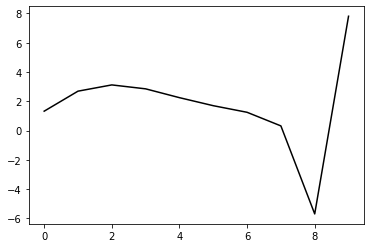

444400 18.67530996627339
0.3238464301854172 -0.18456269132514402 -0.23223411115575188 -0.1271053181608676
[ 1.39077343  2.64734887  3.07280815  2.8021707   2.19814982  1.64838231
  1.19608334  0.26381035 -5.7518486   7.81585328]


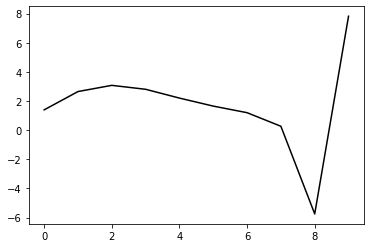

445500 21.38452996246408
0.3228312760765768 -0.18622783913247193 -0.23350058647463104 -0.1252654257337263
[ 1.31216144  2.65936638  3.07784831  2.80264918  2.1949485   1.64180357
  1.18627149  0.24993182 -5.76999355  7.82611321]


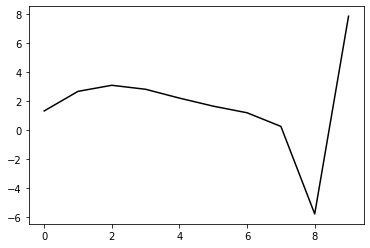

446600 24.41350289405019
0.3260941121624466 -0.18478308984757333 -0.23329811652844676 -0.12798672925566923
[ 1.30594993  2.80782666  3.2411919   2.97741238  2.3782482   1.83157903
  1.38115431  0.44800297 -5.57116885  7.83067548]


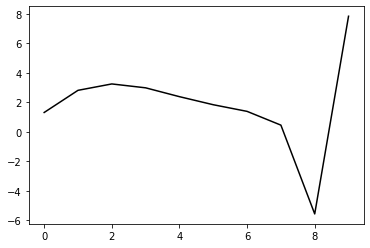

447700 13.42837386774065
0.3238711621247198 -0.18390070991161514 -0.23225184979899366 -0.12605112101880264
[ 1.32367744  2.67000057  3.08880305  2.81504279  2.20872446  1.65688004
  1.20305998  0.26768959 -5.75046385  7.82056577]


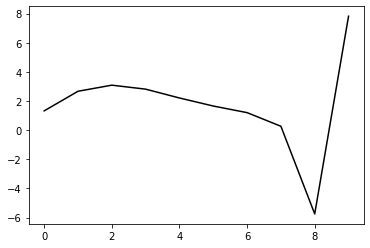

448800 22.148722020856184
0.3238230132847448 -0.1825378416911283 -0.2313164620805811 -0.12855544427108323
[ 1.3297751   2.68164423  3.10575027  2.83664511  2.23408306  1.68526976
  1.23415045  0.30075191 -5.71580512  7.83761203]


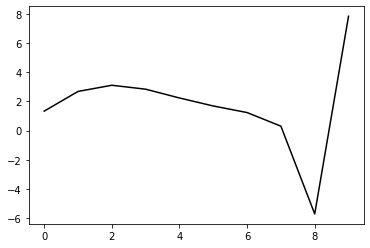

449900 28.42641088740117
0.32578452144637604 -0.18601475568659523 -0.23490986654795767 -0.12586069573923578
[ 1.24493054  2.65747414  3.08010955  2.81099724  2.20926027  1.66162586
  1.21190965  0.27919136 -5.73711414  7.79744329]


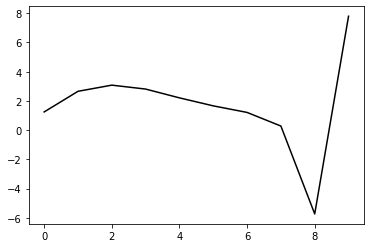

451000 16.367660941530133
0.3241974078461237 -0.18584973273263122 -0.23387490035716915 -0.12788583158863345
[ 1.28713525  2.70197253  3.10913106  2.82628228  2.2118446   1.65276394
  1.19332098  0.25237981 -5.77097022  7.80200173]


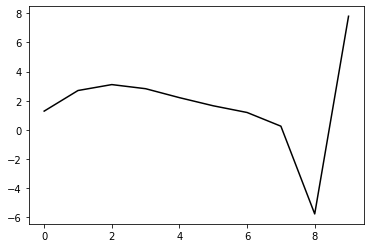

452100 21.47085605504128
0.3257804709769539 -0.1861464493380968 -0.23467907276133665 -0.1273296645963971
[ 1.31771538  2.63726672  3.052068    2.77780157  2.17177688  1.62061156
  1.16863067  0.23399427 -5.78371722  7.87017091]


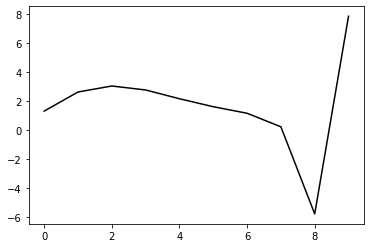

453200 23.153815342248272
0.3221268937945115 -0.18382523306059612 -0.23214185865465295 -0.12903104196994997
[ 1.33686906  2.54336716  2.95676711  2.68448093  2.08139052  1.53333247
  1.08454697  0.15240863 -5.8634843   7.79243194]


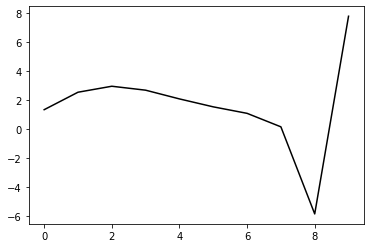

454300 25.047657041123085
0.317827868159076 -0.1847926084991697 -0.23191611279432156 -0.13016815374027016
[ 1.33247896  2.5117411   2.93328903  2.6682489   2.07028039  1.52576118
  1.07974328  0.14948071 -5.86418664  7.82268768]


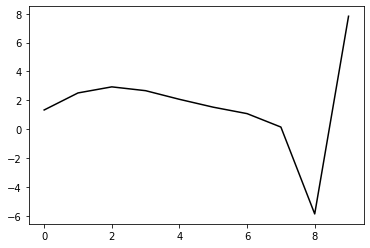

455400 14.35033355564991
0.3221231509755656 -0.18398558192796208 -0.2327617235961432 -0.12957782184771835
[ 1.31114113  2.63418771  3.05629439  2.7911334   2.19198327  1.64546671
  1.19698959  0.26337882 -5.75330386  7.81017691]


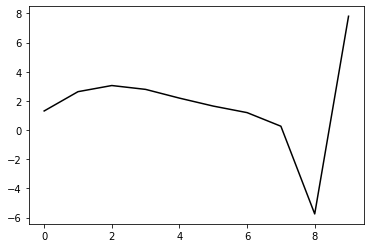

456500 21.757859211974313
0.32379452485814103 -0.1839159293497128 -0.23345367332936626 -0.12881561917366796
[ 1.31087578  2.67269055  3.09135821  2.82280637  2.22049645  1.67107849
  1.2201381   0.28383031 -5.7353907   7.84814989]


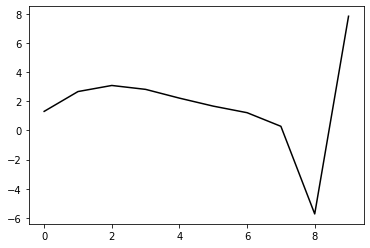

457600 25.25137312467727
0.322026139575081 -0.18870447496337106 -0.23683434749167628 -0.12643770269961838
[ 1.30286253  2.63695731  3.0538889   2.7853136   2.18349145  1.63470993
  1.18459473  0.24869269 -5.76977545  7.8095805 ]


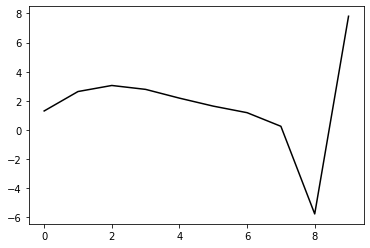

458700 13.505692640920458
0.3232507417623113 -0.1832366614024923 -0.2331942856557133 -0.13020751352515123
[ 1.33801748  2.68723623  3.11049195  2.84722566  2.24942459  1.7036603
  1.25600275  0.32164932 -5.69564411  7.83985235]


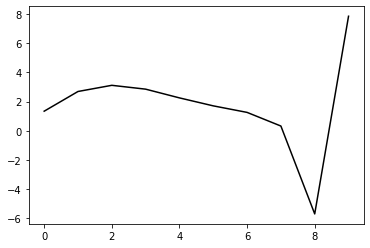

459800 22.0974681908636
0.32366826236679 -0.18203142797791283 -0.23248743124592938 -0.13107270842052146
[ 1.31180667  2.72908186  3.15043823  2.88588153  2.28692786  1.74013871
  1.29185868  0.35662527 -5.66182514  7.82753725]


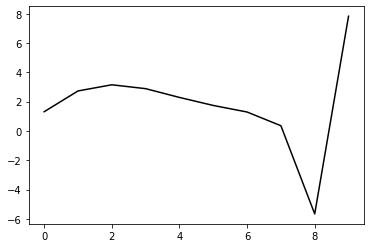

460900 14.98318918426769
0.32200467560395407 -0.1870487652300427 -0.23590033449912845 -0.12724984294088362
[ 1.32879107  2.56377761  2.9737618   2.7023874   2.09983357  1.55163388
  1.10395921  0.17047401 -5.84374809  7.81600874]


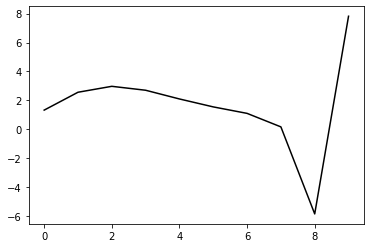

462000 17.559974110168717
0.32680175272674356 -0.1871714635771467 -0.2371693709696263 -0.126865480532889
[ 1.27778625  2.71099636  3.11930511  2.84359621  2.23546427  1.68145793
  1.22858672  0.29016119 -5.72742695  7.79143064]


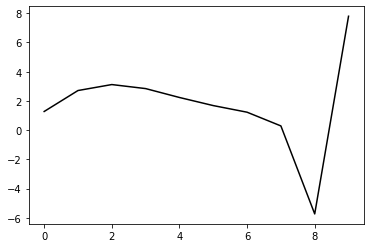

463100 19.82159242220754
0.32742099456309726 -0.18358919458075934 -0.23493846036333316 -0.12785118291954645
[ 1.28375204  2.69134929  3.09784533  2.82167169  2.21367009  1.65986977
  1.20726959  0.26834196 -5.75058832  7.82712433]


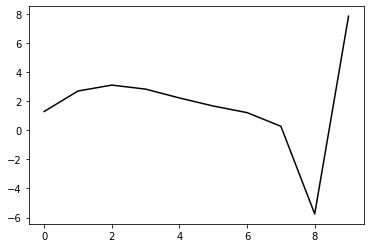

464200 24.90921384064369
0.32517702441745605 -0.1857941385346991 -0.23655603872125539 -0.1268407211526059
[ 1.27511141  2.66921704  3.08608159  2.81840279  2.21751987  1.66969003
  1.22225889  0.28692404 -5.72976847  7.8157964 ]


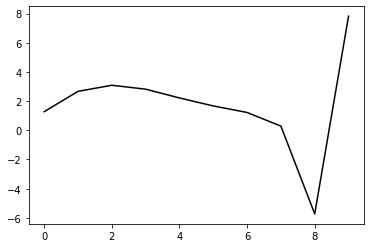

465300 21.549533605637375
0.3257330517284837 -0.1825192107446152 -0.23477957908696145 -0.12628837355645767
[ 1.27167034  2.69030725  3.10802751  2.84106562  2.24073548  1.69320333
  1.24601486  0.31005818 -5.70769163  7.84435857]


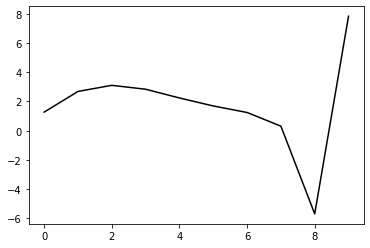

466400 18.789874197533813
0.31925866297413713 -0.18716809195632958 -0.23613760029225062 -0.12649273531628047
[ 1.30904711  2.58574791  2.9831388   2.6987784   2.08332395  1.52305418
  1.06615237  0.12343539 -5.89693442  7.79500981]


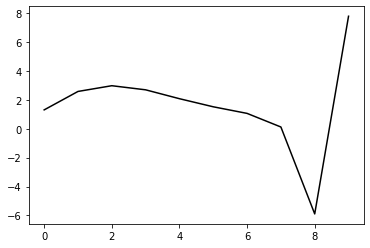

467500 21.993504260145382
0.3258794717256306 -0.18295273805497975 -0.2346276936877303 -0.1271557139095016
[ 1.2917151   2.72605945  3.11490301  2.82147305  2.19674467  1.62717246
  1.16132024  0.20974176 -5.81824727  7.8269275 ]


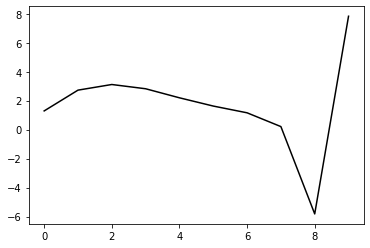

468600 24.301741794235586
0.327660232446198 -0.18265829624324412 -0.23491899267494026 -0.12801253101814833
[ 1.30115104  2.77668937  3.16799491  2.87614582  2.25251142  1.68371276
  1.21871985  0.26771156 -5.7593787   7.82124928]


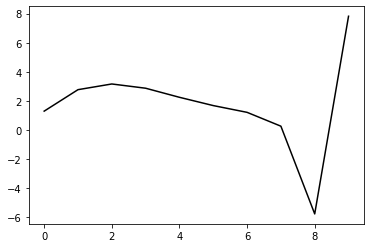

469700 13.447832662372205
0.3302322396646339 -0.17692014987232357 -0.23147897847577034 -0.12951346045313036
[ 1.33476598  2.81142284  3.20375797  2.91211481  2.28894908  1.72061757
  1.25617848  0.30494377 -5.7238093   7.79599022]


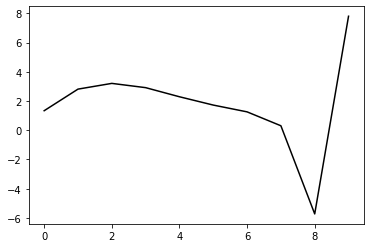

470800 23.740690719416612
0.32244400320242234 -0.1801847489213527 -0.23186496912211207 -0.13187891150572778
[ 1.34204499  2.72543289  3.12530871  2.84068983  2.22428716  1.66249579
  1.205001    0.26072241 -5.75896253  7.81469354]


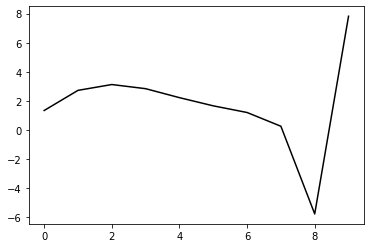

471900 15.011218732643904
0.32676190556344864 -0.18517153050038931 -0.2369657027929417 -0.12712953766978832
[ 1.29418226  2.6957785   3.09140962  2.80284665  2.18305416  1.61850241
  1.1592786   0.21367195 -5.80648624  7.81858564]


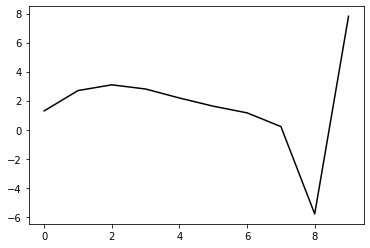

473000 18.646477350187762
0.3300818963693976 -0.18200635197646173 -0.23607900415681088 -0.12717728657806393
[ 1.26541477  2.81606886  3.2158698   2.93037249  2.31262866  1.74873973
  1.28855167  0.33899477 -5.68942825  7.82150087]


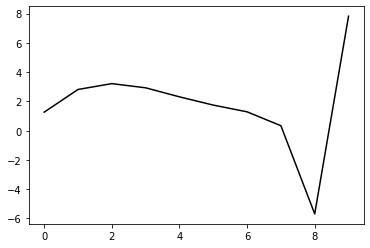

474100 22.119993736600016
0.32537183027470334 -0.18337108311345715 -0.23616272447256942 -0.1271652940584589
[ 1.33354007  2.65533025  3.0548605   2.77186276  2.15836263  1.5996795
  1.14540259  0.20150174 -5.8201548   7.85616462]


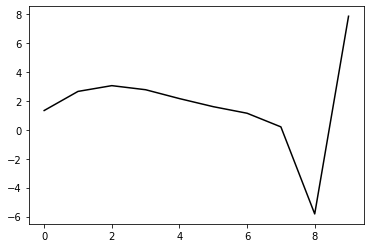

475200 28.522894051008578
0.316294694689173 -0.17976897414936555 -0.23118946072777244 -0.1318680365851116
[ 1.36630289  2.55143611  2.95186752  2.67107568  2.05978377  1.50300246
  1.05050906  0.10775575 -5.91312492  7.77376245]


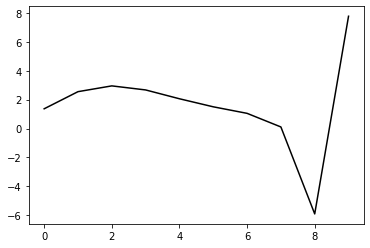

476300 24.83456177731
0.31857248906296914 -0.1819876219779257 -0.23350149958229896 -0.13016713902955138
[ 1.33003531  2.59543527  2.9887981   2.70114236  2.08297002  1.51951178
  1.06101921  0.112827   -5.91112239  7.81991499]


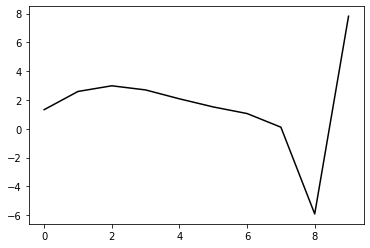

477400 14.833217340901228
0.32327789421295994 -0.18213042425403636 -0.2350253041501669 -0.12901054089247177
[ 1.31087956  2.70846832  3.09931057  2.80880051  2.1876185   1.62103656
  1.15951928  0.20806729 -5.81792795  7.80552945]


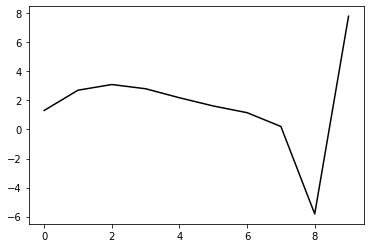

478500 21.861041583314694
0.32547217726205485 -0.18258406126926674 -0.2361227873092398 -0.1280892411770259
[ 1.29917281  2.73263752  3.12099587  2.82825714  2.20515702  1.63684429
  1.17393673  0.22095423 -5.80620442  7.83237563]


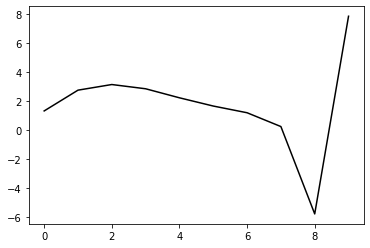

479600 25.28312383003319
0.3237988406066915 -0.18632701376543018 -0.23872758045270093 -0.12685910622312777
[ 1.30684939  2.69618166  3.09218807  2.80633726  2.18891922  1.62521411
  1.16623587  0.21620305 -5.80788321  7.80434291]


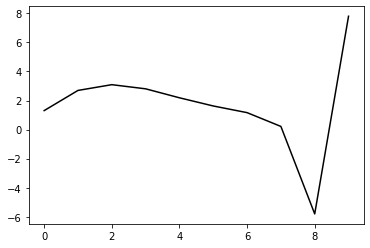

480700 13.422297733692037
0.3255737435753358 -0.18062027938059416 -0.23494569997975367 -0.13056342339064028
[ 1.34016618  2.75826687  3.15725891  2.8732569   2.25698146  1.69392169
  1.23543702  0.28539265 -5.73861492  7.83432865]


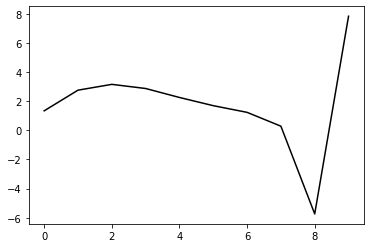

481800 24.53370053302547
0.3226203602142038 -0.1792911395013608 -0.23334021496453658 -0.13287989718704488
[ 1.3485077   2.7642465   3.16654746  2.88550251  2.27144758  1.70993835
  1.25269466  0.30322998 -5.72008675  7.8193536 ]


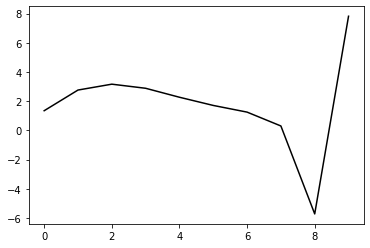

482900 13.042199554156626
0.32647826063956414 -0.17940743614335894 -0.2345471306995582 -0.13144125503864876
[ 1.31270325  2.81658976  3.21658055  2.93315227  2.31689049  1.75327348
  1.29416968  0.34243694 -5.6837889   7.85104112]


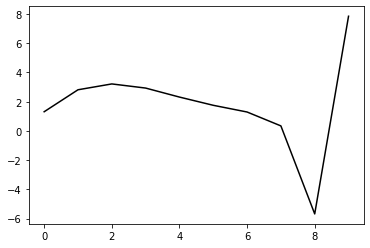

484000 16.695029735096426
0.32407478878102836 -0.18100176534292514 -0.23542061194367522 -0.12925459826384803
[ 1.31607816  2.69294571  3.08371205  2.79341283  2.17270993  1.60639976
  1.14617058  0.19391084 -5.83126845  7.80064535]


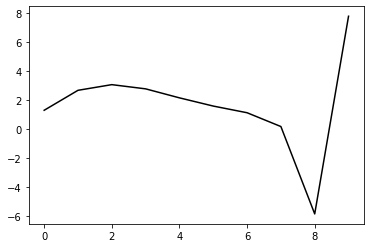

485100 21.10949220591975
0.32791783292273197 -0.17904548530840253 -0.23508957727609425 -0.12916094682271545
[ 1.30925338  2.7435051   3.13852725  2.850461    2.23079309  1.66462828
  1.20420775  0.25091418 -5.77597021  7.86566551]


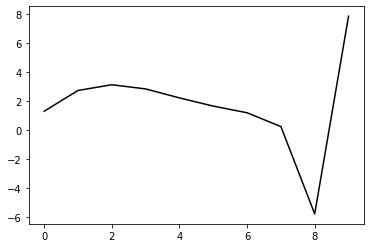

486200 23.74071377486269
0.3270718748077186 -0.17469350995257343 -0.23209383901395955 -0.1298916812332918
[ 1.32794387  2.71993394  3.10999354  2.81818296  2.19630957  1.62883438
  1.16774096  0.21305323 -5.81693217  7.82916206]


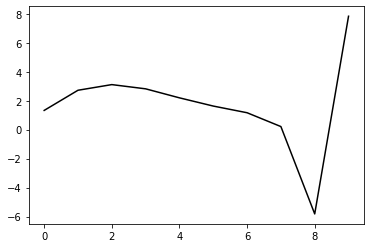

487300 21.398489800582993
0.32588045970259694 -0.1781596396639298 -0.2342602599850028 -0.12881854168102638
[ 1.28685231  2.7638361   3.15742984  2.86779132  2.24728736  1.68070704
  1.2205771   0.26630116 -5.76259922  7.80508634]


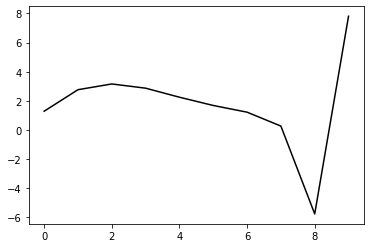

488400 14.102957704021174
0.3241158474690324 -0.18078970441526493 -0.23589168393225746 -0.12958676778168945
[ 1.33338228  2.72406263  3.14125664  2.87302993  2.27164217  1.72218921
  1.27789969  0.33785482 -5.67712406  7.79288128]


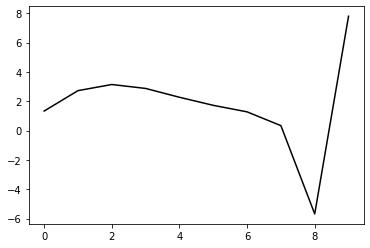

489500 21.971797231738414
0.3224650042852953 -0.18183293416505764 -0.23647134133356076 -0.13150168524933725
[ 1.33214967  2.7522282   3.18383656  2.92822165  2.33750389  1.79694603
  1.36020744  0.42565501 -5.5863061   7.8629183 ]


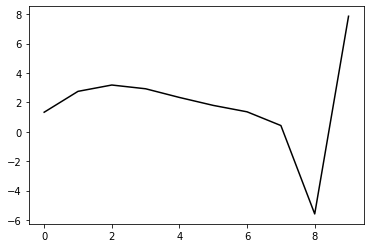

490600 24.970304666431726
0.32271445541590893 -0.18120351209984636 -0.2368814128291408 -0.12607158498505888
[ 1.30061458  2.70055204  3.10825712  2.83174264  2.22312683  1.6670076
  1.2166536   0.26941685 -5.75402967  7.81967302]


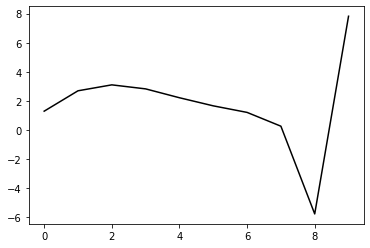

491700 13.545274323426518
0.32042580883097976 -0.1801727859167248 -0.23545634634273496 -0.12912425410966497
[ 1.35449596  2.68105458  3.09952077  2.83253647  2.23164207  1.68182884
  1.23699874  0.29436989 -5.72418075  7.83534672]


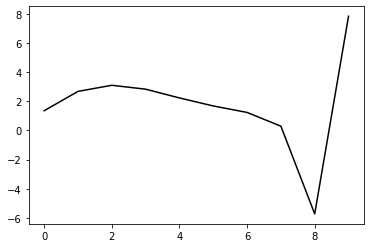

492800 23.06561529192165
0.323236946900618 -0.179320503707559 -0.23577241582532993 -0.12796854909926528
[ 1.2736437   2.70390954  3.10878062  2.83066397  2.22080197  1.66380437
  1.21356473  0.26651885 -5.75527228  7.81826858]


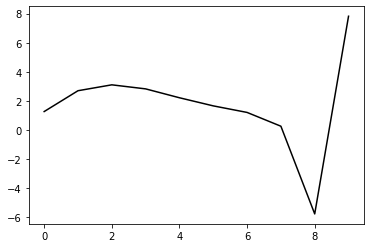

493900 13.733852287695877
0.32176978422547764 -0.18244817171344943 -0.23778213865288478 -0.12757514062140088
[ 1.32144838  2.6428359   3.05700691  2.78795487  2.18644833  1.63719303
  1.19449414  0.25424163 -5.76055307  7.83902238]


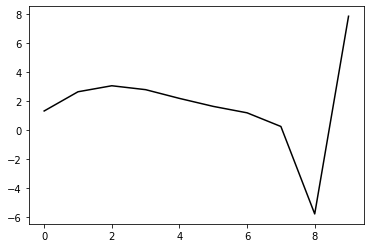

495000 18.90401395927973
0.3251758651331568 -0.1804003840609932 -0.23764221490154785 -0.12707552708538852
[ 1.26367326  2.79030506  3.20807861  2.94038788  2.33832312  1.78693608
  1.34101785  0.39583998 -5.62648203  7.84915819]


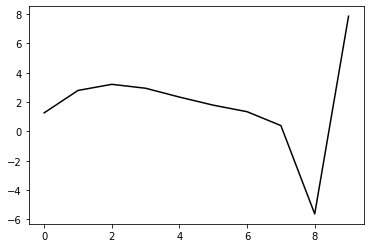

496100 20.389194758194858
0.3235108724539752 -0.1817608371344982 -0.23863856330522468 -0.12523044332728853
[ 1.29006459  2.69167984  3.10545653  2.83581266  2.23307611  1.68180597
  1.23660758  0.29187512 -5.72913699  7.83545144]


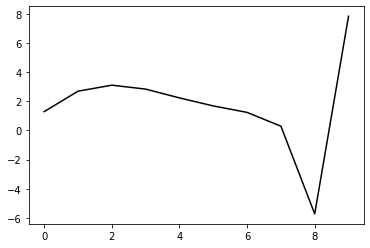

497200 23.889334843644164
0.31688746788467675 -0.17887309447442387 -0.23510911360981657 -0.1284795894600459
[ 1.35898635  2.58860168  3.00103632  2.73246639  2.13208753  1.58382882
  1.14200982  0.19995766 -5.81935525  7.79925744]


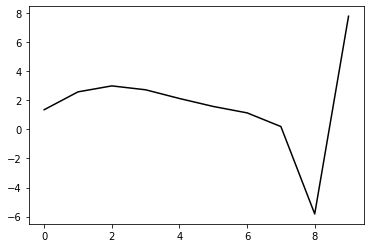

498300 20.763286118977728
0.32174376417155354 -0.17916143039058663 -0.23720457234660833 -0.12575154836616412
[ 1.31304397  2.6757528   3.09631527  2.83470147  2.23993191  1.69606081
  1.2577097   0.31754691 -5.70109995  7.85364709]


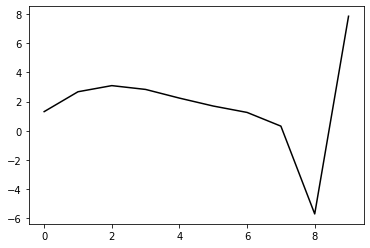

499400 17.65009680756129
0.3146070577318843 -0.1759386608030693 -0.23340789762359185 -0.1250423856988543
[ 1.30962998  2.53991411  2.93737646  2.65678084  2.04636083  1.48945025
  1.0404196   0.09102421 -5.93708848  7.8347444 ]


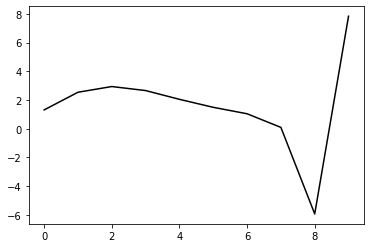

In [21]:
optimizer=tf.optimizers.Adam(learning_rate=0.0005)
for j in range (5000):    
    with tf.GradientTape() as g:
        loss=Error_func(h, m2, lam, alpha, beta, Positive[j%10], Negative[j%10])
        gradients=g.gradient(loss, [h, m2, lam, alpha, beta])
        if np.isnan(loss)==True: break
    for i in range (90):
        optimizer.apply_gradients(zip(gradients, [h]))
        if any(np.isnan(h.numpy()))==True: break
    for i in range (10):
        optimizer.apply_gradients(zip(gradients, [h, m2, lam, alpha, beta]))
        if any(np.isnan(h.numpy()))==True: break
    if j%11==0: 
        print(j*100, Error_func(h, m2, lam, alpha, beta, Positive[j%10], Negative[j%10]).numpy())
        print(m2.numpy(), lam.numpy(), alpha.numpy(), beta.numpy()), print(h.numpy())
        plt.plot(h.numpy(), 'k-'), plt.show()

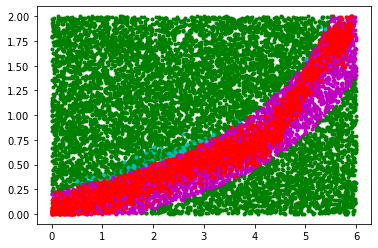

In [22]:
for i in range (set):
    [Positive0[i], Positive1[i]]=NN_func_01(h, m2, lam, alpha, beta, Positive[i])
    [Negative0[i], Negative1[i]]=NN_func_01(h, m2, lam, alpha, beta, Negative[i])
for i in range (set):
    x_data1[i]=[v[0] for v in Positive0[i]]
    y_data1[i]=[v[1] for v in Positive0[i]]
    x_data2[i]=[v[0] for v in Positive1[i]]
    y_data2[i]=[v[1] for v in Positive1[i]]
    x_data3[i]=[v[0] for v in Negative0[i]]
    y_data3[i]=[v[1] for v in Negative0[i]]
    x_data4[i]=[v[0] for v in Negative1[i]]
    y_data4[i]=[v[1] for v in Negative1[i]]
    plt.plot(x_data4[i], y_data4[i], 'g.')
    plt.plot(x_data2[i], y_data2[i], 'c.')
    plt.plot(x_data1[i], y_data1[i], 'r.')
    plt.plot(x_data3[i], y_data3[i], 'm.')
plt.show()

0 19.327321541229086
0.3212004242037551 -0.18040152240046986 -0.23842852302678275 -0.11811067590878065
[ 1.28255554  2.53723933  2.92518044  2.63708598  2.02032168  1.4579499
  1.0043303   0.05098958 -5.98199905  7.75835049]


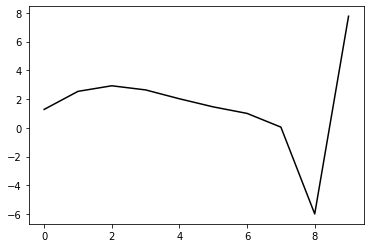

1100 21.121652220682986
0.3326183935953031 -0.1689160717833332 -0.23168332602176012 -0.13094695807194104
[ 1.30462612  2.54946285  2.90841174  2.60411627  1.98002823  1.41569617
  0.96390775  0.01491017 -6.01096479  7.78830442]


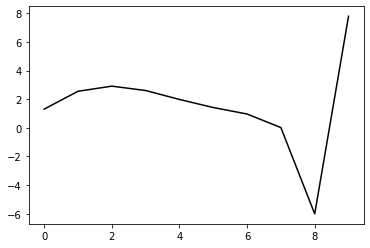

2200 22.706033732557827
0.33825690414445736 -0.17648924375219777 -0.23737685969032885 -0.13736250739748154
[ 1.2692283   2.66306183  3.03263825  2.73477793  2.11418605  1.55168931
  1.10119848  0.15321359 -5.87131374  7.81146042]


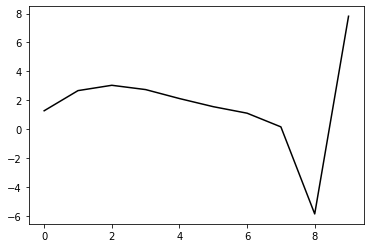

3300 24.34170149745435
0.3320992748490778 -0.17850341223913618 -0.2373004727360458 -0.14115006575580388
[ 1.30974014  2.58989048  2.96954615  2.68241711  2.07208545  1.5190246
  1.07736597  0.13722482 -5.87947786  7.818409  ]


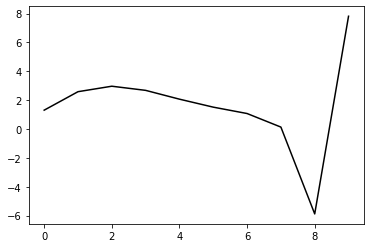

4400 14.077069747539143
0.3402891528441361 -0.17577843074606161 -0.23807034941056573 -0.13960414334631535
[ 1.31435909  2.67374918  3.06424811  2.78520282  2.18098145  1.63240332
  1.1940206   0.25537151 -5.76212838  7.81688917]


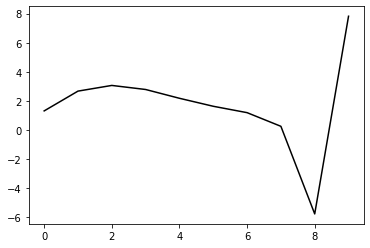

5500 22.534337446583834
0.3370960253020408 -0.17629169431978928 -0.2383455319709676 -0.14144866129062636
[ 1.31008392  2.67693916  3.07631794  2.80512539  2.20788186  1.66519499
  1.23160325  0.29564867 -5.72156704  7.84268954]


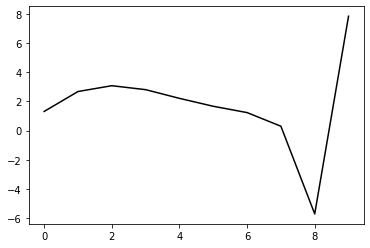

6600 24.427903623037523
0.3379840176497481 -0.1773184267067588 -0.24016397817365928 -0.1396700745738337
[ 1.28131517  2.69013353  3.09287182  2.82579155  2.232989    1.69450291
  1.26454026  0.33025313 -5.68856006  7.80414607]


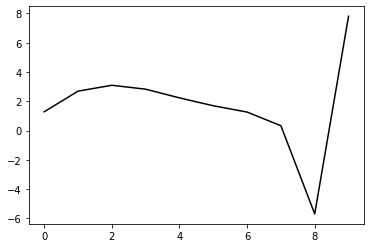

7700 16.55448176785323
0.33479404529336904 -0.1731953071267415 -0.23730393476848963 -0.1385436752134416
[ 1.35190285  2.56935789  2.97047456  2.70464442  2.11460444  1.57945472
  1.15290228  0.22090784 -5.7962333   7.82865176]


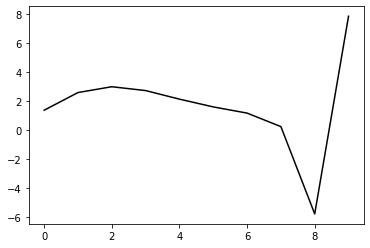

8800 23.716935229812954
0.3342274156708274 -0.17826211026986144 -0.24090183711170746 -0.13679457834604766
[ 1.27166823  2.54497922  2.92397401  2.64061326  2.03686157  1.49136116
  1.05771566  0.12098384 -5.89759123  7.81527982]


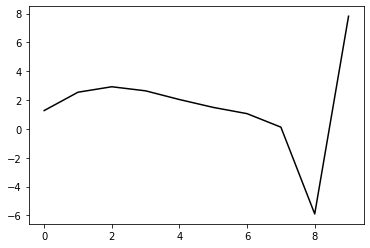

9900 15.246114796576034
0.3372967169932811 -0.17744740488466149 -0.24088528681342058 -0.13760734360909302
[ 1.2614999   2.65322741  3.02710174  2.73784408  2.12850401  1.57792891
  1.14000376  0.19921206 -5.82241835  7.82192009]


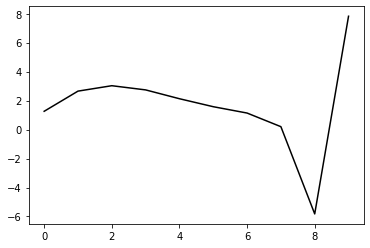

11000 19.26507062895784
0.34163318194076553 -0.18142362653924946 -0.24531857515498912 -0.1323815171076377
[ 1.26751176  2.63357549  3.00331153  2.71138026  2.10025968  1.54831621
  1.10935285  0.16724584 -5.85497613  7.79244407]


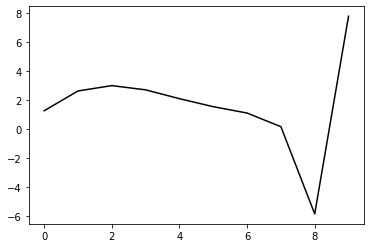

12100 23.59304840662517
0.33581311558876653 -0.17542068864679558 -0.23914355814335433 -0.13788100410755974
[ 1.35580245  2.57202087  2.93403987  2.63607471  2.01981691  1.46326612
  1.02026983  0.07433925 -5.95050012  7.83281325]


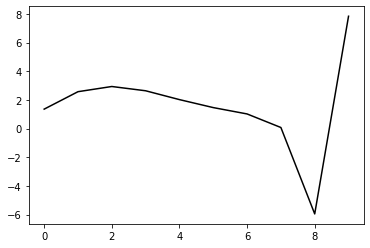

13200 24.240805013077864
0.3349266387313149 -0.17377840781934797 -0.23807088282951705 -0.13916626823678088
[ 1.32055568  2.62056073  2.98222686  2.68389965  2.06723268  1.50997911
  1.06594166  0.11812722 -5.90888291  7.77358784]


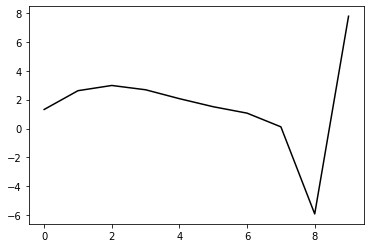

14300 22.02278484379166
0.3434958397356136 -0.16959401928557277 -0.2373897072871414 -0.1374847964489789
[ 1.28025508  2.76317391  3.11751764  2.81136274  2.18753498  1.62370519
  1.17374358  0.22005966 -5.81330383  7.82294965]


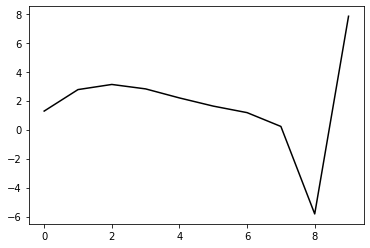

15400 16.439926202340544
0.3402676451933529 -0.17212219160753753 -0.2387264990855064 -0.1371873743737219
[ 1.33956789  2.62767913  2.98959194  2.69076938  2.07480491  1.5190591
  1.07751056  0.13180309 -5.89397147  7.8120223 ]


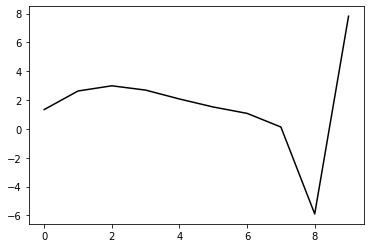

16500 21.75651358331625
0.3354665948710085 -0.17951313698819343 -0.243453774717595 -0.13503351018420007
[ 1.27511263  2.61206056  2.97152623  2.6719998   2.05655248  1.50198592
  1.06211515  0.11780649 -5.90564269  7.81569286]


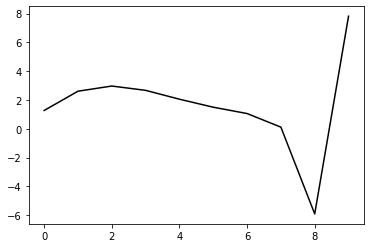

17600 25.350275109413605
0.33749753400855903 -0.17840611136360873 -0.243600429865823 -0.13491030978650204
[ 1.28067476  2.63686699  3.00283667  2.70947561  2.09933414  1.54893891
  1.11215267  0.1693383  -5.85343823  7.80193853]


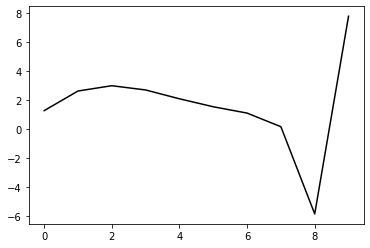

18700 13.831838397799675
0.33732267513662473 -0.17328724441403645 -0.2397756991358141 -0.13843545849537614
[ 1.33299377  2.6559602   3.02997044  2.74336893  2.13874374  1.59275354
  1.15960147  0.21926171 -5.80170116  7.82507481]


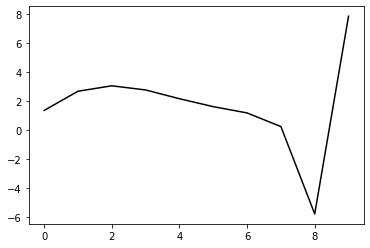

19800 21.842494537652748
0.3386193805363298 -0.17089543782636513 -0.23872836895843402 -0.1392463857282407
[ 1.31695592  2.68973017  3.06583685  2.78000288  2.17582687  1.62987904
  1.19645129  0.2547585  -5.768846    7.8187929 ]


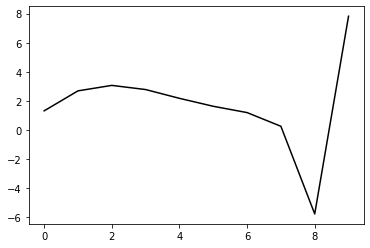

20900 17.182981039289327
0.33740755365412395 -0.1742048403148734 -0.24141366971620778 -0.1362687209917054
[ 1.25586763  2.68932694  3.05740989  2.76436546  2.15405119  1.60267034
  1.16431191  0.21728867 -5.8116789   7.82443153]


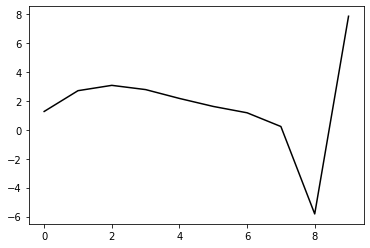

22000 21.688614867590093
0.33843878081959977 -0.18051647786892247 -0.24671346108100548 -0.1320434840227241
[ 1.25912551  2.58425634  2.95843942  2.67364369  2.07269342  1.53103074
  1.10247873  0.16439379 -5.85608969  7.80294964]


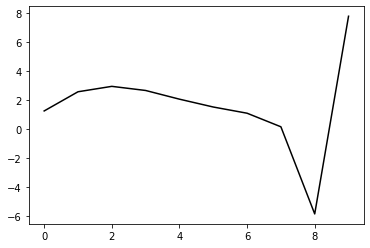

23100 20.01746306161001
0.34031305027207864 -0.17547551478912252 -0.24311968562701236 -0.134472509167386
[ 1.26940275  2.68884893  3.0400064   2.73307072  2.11172587  1.55161211
  1.10675794  0.15412548 -5.87982132  7.81922451]


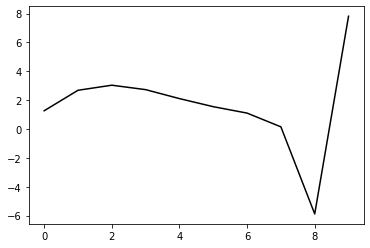

24200 23.05919210313745
0.33471245141369355 -0.17317031573721975 -0.24020249342177075 -0.13685775132301867
[ 1.32320514  2.54800161  2.90089525  2.59841536  1.98312594  1.42962249
  0.9915249   0.04485911 -5.9846388   7.79357994]


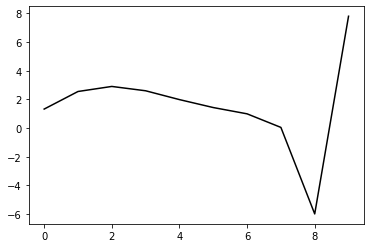

25300 24.719807391023124
0.33356294357991 -0.17303972579391755 -0.23995449070757932 -0.13794353667856935
[ 1.32372393  2.55371721  2.92014117  2.62966635  2.02405405  1.47812158
  1.04616831  0.10412724 -5.92067706  7.81840746]


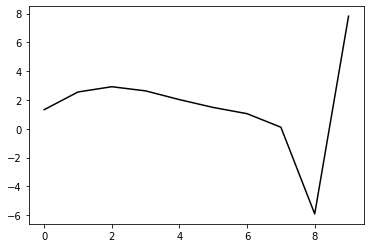

26400 17.17296469058086
0.33175512561845555 -0.17688560834603023 -0.2425536745415611 -0.13615667839151732
[ 1.29338324  2.53175279  2.89701517  2.60612332  1.999832    1.45287207
  1.0198891   0.076541   -5.94910372  7.7837174 ]


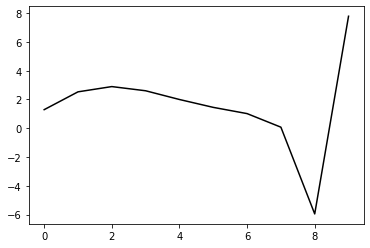

27500 22.556163071760423
0.3396332520999997 -0.17234306254395634 -0.24134635626428466 -0.13592095385976188
[ 1.27358521  2.67244061  3.03188342  2.73447953  2.12166352  1.56815421
  1.12865582  0.17832393 -5.85406145  7.82704064]


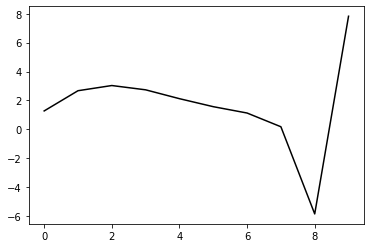

28600 24.82369035735583
0.34085986474805985 -0.1727699154179048 -0.24195150024603557 -0.1375460484119865
[ 1.26663607  2.76510965  3.13526163  2.84482934  2.2366939   1.6864502
  1.24959166  0.30103162 -5.73096665  7.80749312]


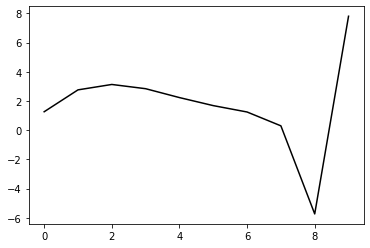

29700 15.167934831419949
0.33808794305863976 -0.17171582690055331 -0.2408978703099702 -0.1387947980885555
[ 1.34917722  2.66575457  3.04700315  2.76818247  2.17200991  1.63352969
  1.20801409  0.26924183 -5.75427139  7.85881397]


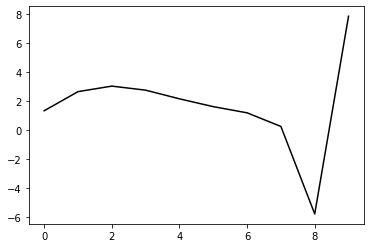

30800 23.36056600120609
0.33666084896447457 -0.17502630683785533 -0.24340867180381 -0.1363306765909558
[ 1.27562362  2.6324319   2.9967311   2.70265403  2.09385317  1.54546645
  1.11291245  0.16883799 -5.85892682  7.80209023]


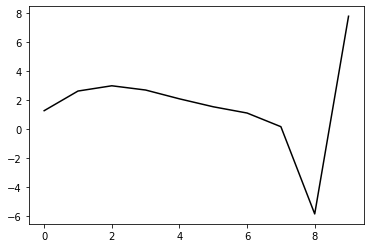

31900 13.496194968895917
0.3381788244047675 -0.1711516047591925 -0.2411689620805009 -0.13701162901635258
[ 1.2979616   2.75476657  3.11970419  2.82369326  2.21146448  1.65855587
  1.2206642   0.26978291 -5.76613543  7.84434178]


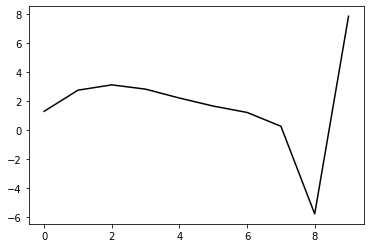

33000 15.320294935746752
0.34140835416628035 -0.16882663409734328 -0.24098744915205306 -0.1345816546612419
[ 1.27159999  2.7590228   3.1218467   2.82371201  2.21005842  1.65592057
  1.2166984   0.26331981 -5.7765238   7.81955166]


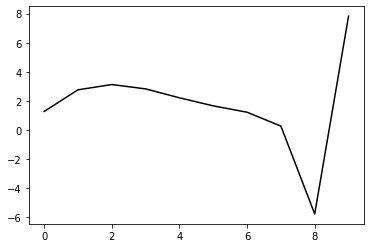

34100 21.851962447289768
0.3350084932991759 -0.1723197150439351 -0.24183989519146543 -0.13461927935662024
[ 1.31330827  2.67392209  3.03497839  2.73498886  2.11977553  1.56461791
  1.12556569  0.17339396 -5.86280437  7.84613005]


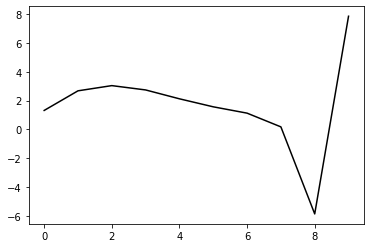

35200 28.863241029209167
0.32869627163843207 -0.16914323334305212 -0.23762831546030574 -0.13847454506066958
[ 1.35859441  2.53164513  2.88568359  2.58307726  1.96834241  1.41557502
  0.98032507  0.03238441 -5.9993086   7.76408451]


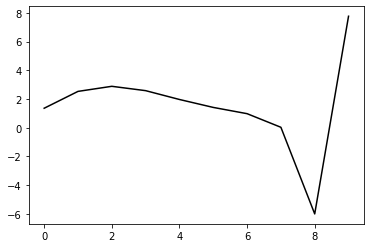

36300 23.78095504331044
0.33488507569794446 -0.17061735739882683 -0.24043322487438284 -0.13672076502778982
[ 1.31753765  2.67299491  3.02758517  2.72300847  2.10459042  1.5470952
  1.10682018  0.15366342 -5.88105655  7.82043666]


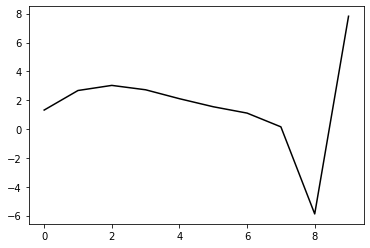

37400 14.825907213543687
0.34120680230989264 -0.16628762333534652 -0.23906993511700136 -0.13644178154722725
[ 1.32832058  2.77107058  3.12996575  2.82696127  2.20891502  1.65098801
  1.20994121  0.2553131  -5.78196724  7.78997312]


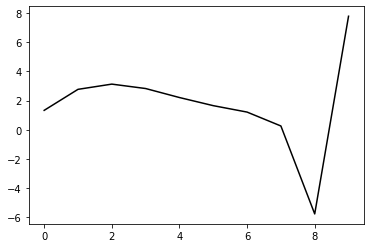

38500 21.98809795988048
0.3377484302095232 -0.171734526939938 -0.24212374612988208 -0.13710079018369462
[ 1.319608    2.73691536  3.10709429  2.81349034  2.20355873  1.65291517
  1.21898578  0.27099816 -5.75905409  7.82518593]


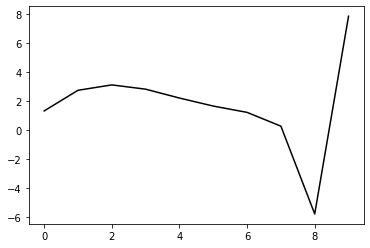

39600 24.632729235434127
0.3373692943650271 -0.1732003516949973 -0.24338387155009783 -0.13751687927145415
[ 1.30421826  2.77775006  3.15561082  2.8680601   2.26334218  1.71713693
  1.28704856  0.3414527  -5.68862492  7.82555771]


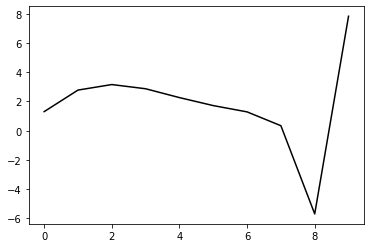

40700 14.699390406831933
0.33593101549943644 -0.17093530278072588 -0.24197200589854737 -0.13528909035031564
[ 1.36458875  2.64182178  3.00511878  2.70666341  2.09499094  1.54478822
  1.11292886  0.16635935 -5.86359481  7.79306036]


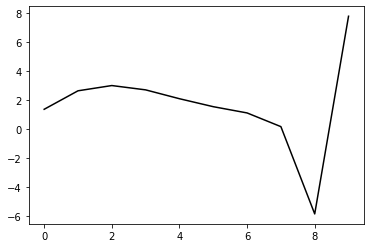

41800 22.153702104984667
0.33679917199995085 -0.16947751676944137 -0.24136248279239433 -0.1371338176365985
[ 1.34138223  2.73120758  3.10652205  2.81891086  2.21694923  1.6750787
  1.25001558  0.30763227 -5.72113882  7.82310226]


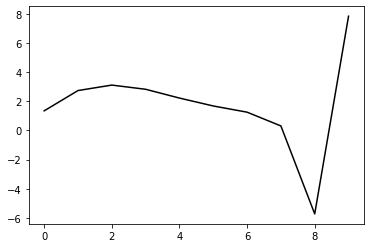

42900 25.98423687405978
0.338633815788827 -0.17095901460892532 -0.24355900976077044 -0.1329118319483579
[ 1.245611    2.70377391  3.05788428  2.75056538  2.13164538  1.57530917
  1.13819369  0.18537934 -5.85161456  7.85761577]


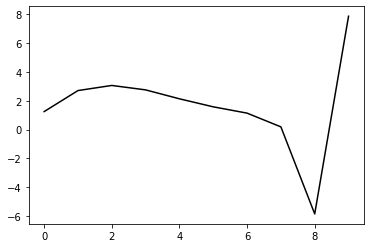

44000 23.773649938686557
0.33837805607690447 -0.17787449054036233 -0.24884549115654672 -0.1301660270582472
[ 1.2685009   2.64600893  3.0111011   2.71509044  2.10685567  1.56026572
  1.13205388  0.1868593  -5.8425238   7.79014587]


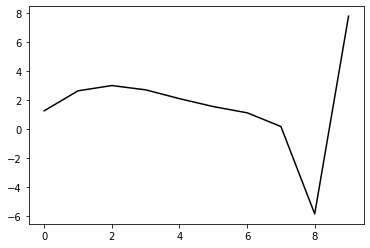

45100 22.993321756391435
0.33365280842425665 -0.17129417816009412 -0.24244927564454916 -0.136056146897295
[ 1.36265011  2.61098932  2.96677239  2.66302994  2.0482262   1.49593148
  1.06288033  0.11328656 -5.91911197  7.83733871]


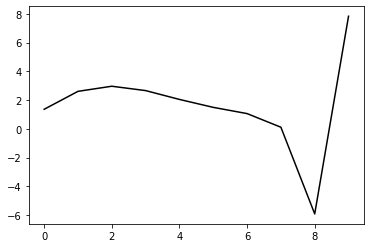

46200 23.48458411586667
0.33330969408438255 -0.16883993001336192 -0.24079038930085342 -0.13665770441790726
[ 1.33128907  2.65447777  3.00459815  2.69554816  2.07605179  1.51948565
  1.08255569  0.12896736 -5.90724627  7.77506172]


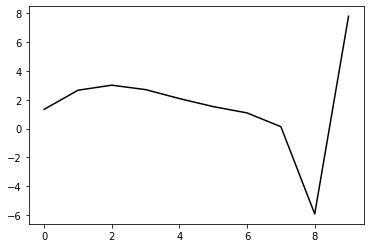

47300 22.013612249072057
0.3395587647558132 -0.1657719969640129 -0.2403338011909368 -0.13557974356902097
[ 1.28364991  2.77935344  3.12382755  2.80828589  2.1827564   1.62067567
  1.17894038  0.22075583 -5.82000513  7.80230809]


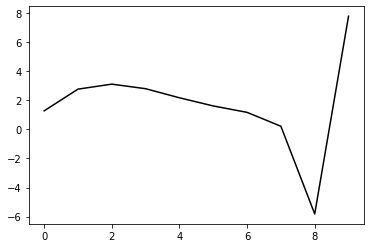

48400 16.47667732404052
0.33552403600278546 -0.16867403154550586 -0.24148918887483284 -0.13681880799650573
[ 1.35402863  2.70406896  3.07072372  2.77464651  2.16662661  1.62043105
  1.19364889  0.24907664 -5.77876634  7.82700223]


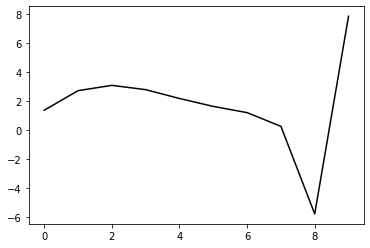

49500 22.064221063261016
0.33171070210901926 -0.17648856939393717 -0.24632453151466982 -0.13764579315705713
[ 1.33021505  2.68695464  3.07324563  2.79635631  2.2062243   1.67637208
  1.26457672  0.3327926  -5.6838009   7.83269838]


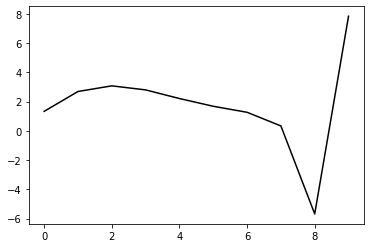

50600 25.476119601008232
0.33729371008864134 -0.1729083596808499 -0.2453047799771813 -0.13470632743869002
[ 1.28108831  2.83658911  3.18709015  2.87260872  2.24829196  1.68896183
  1.25257625  0.29994427 -5.73409236  7.86210952]


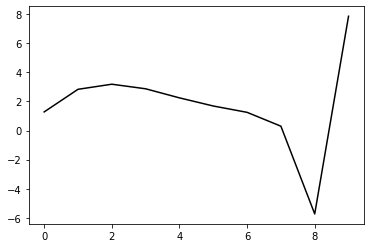

51700 13.910487683744503
0.33764477404961374 -0.16702533371296188 -0.24146981550617957 -0.13519887523118568
[ 1.35291846  2.76876742  3.11435112  2.79604198  2.17012202  1.61061518
  1.17494516  0.22250483 -5.81261922  7.8120984 ]


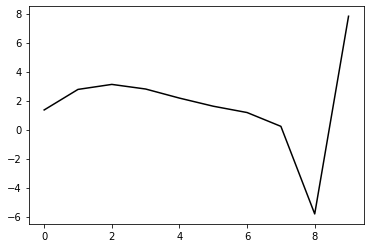

52800 23.42766867924541
0.33654040262694307 -0.16819410590141112 -0.24220028520551046 -0.13457080791589585
[ 1.28792279  2.77644988  3.11486413  2.78722724  2.15201965  1.58369993
  1.14030433  0.18078587 -5.86001298  7.81162215]


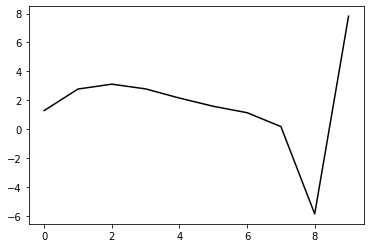

53900 24.975590716781294
0.3376664635981702 -0.16935986252529278 -0.24369352476620867 -0.1326624724146127
[ 1.24872232  2.77220235  3.10753502  2.77969086  2.14688329  1.58218923
  1.14274353  0.18600541 -5.85311881  7.8577168 ]


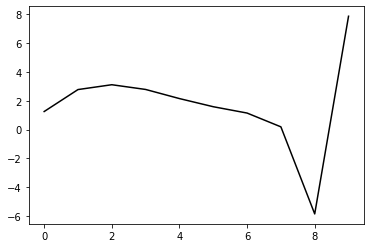

55000 19.66356151301533
0.33850033159073584 -0.17521933613950672 -0.24795388691695036 -0.1302630116640798
[ 1.27747234  2.75756269  3.09309292  2.76588617  2.13341918  1.56874606
  1.12950115  0.1731784  -5.86397877  7.78307043]


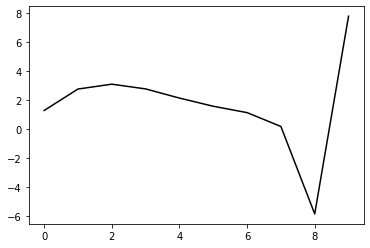

56100 22.13873097102163
0.33479483476509536 -0.17011010148826874 -0.24315969405958676 -0.13519924736300867
[ 1.35888835  2.70652856  3.04031673  2.71179453  2.07854873  1.51333293
  1.07368769  0.11663167 -5.92065089  7.8416739 ]


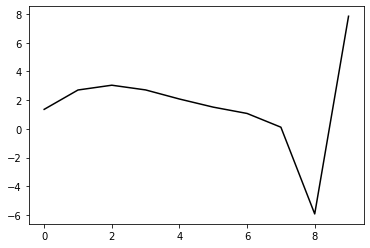

57200 22.28942605643284
0.3403861383314548 -0.16788851455187837 -0.2434487726328484 -0.13236695269700824
[ 1.28297972  2.79432107  3.11946444  2.7819656   2.14068949  1.5681098
  1.12157977  0.15742    -5.88779362  7.79124962]


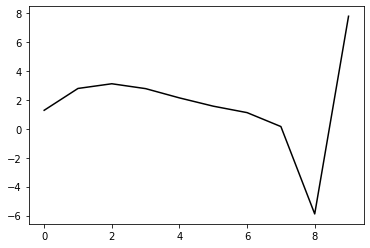

58300 21.457046300821634
0.33956014864428463 -0.16753525409168052 -0.24335314665482577 -0.13221949457822485
[ 1.28894365  2.78106828  3.11228297  2.77856441  2.14054554  1.57092151
  1.12728797  0.16537587 -5.87819813  7.80697818]


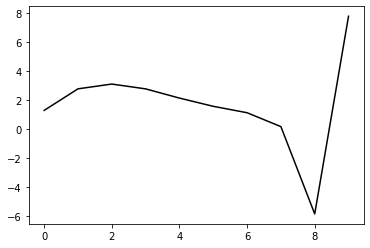

59400 14.035992812754552
0.3371691981000442 -0.16847433136272166 -0.2435942596086455 -0.13354696960574292
[ 1.33734886  2.78660534  3.13972738  2.82264631  2.19756252  1.63807344
  1.20282711  0.24752281 -5.78986319  7.80347502]


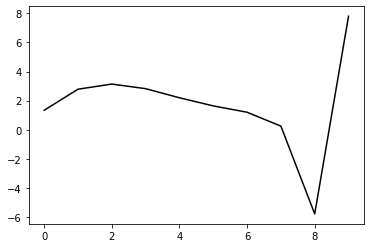

60500 21.97007794254248
0.33310859570562856 -0.17283520228655083 -0.24575517187593982 -0.13533061937633878
[ 1.33751781  2.77080179  3.13517206  2.82663736  2.20863402  1.65535864
  1.22608029  0.27609306 -5.75522734  7.85987413]


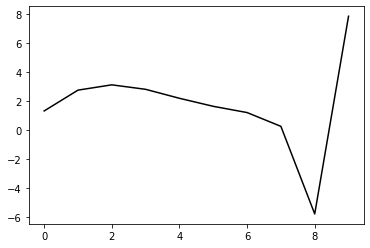

61600 24.625355382286145
0.3368148753195834 -0.16960838667584743 -0.2447957726062626 -0.13496241573102458
[ 1.30459821  2.89658322  3.2587721   2.94503248  2.32122714  1.76195964
  1.32658305  0.36947897 -5.67124622  7.8206635 ]


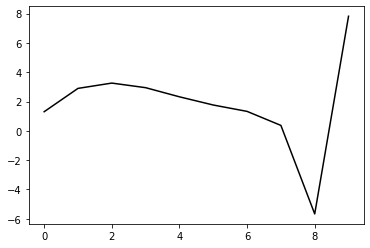

62700 15.111779406671806
0.3310193462509105 -0.16659947205965242 -0.24184378150908242 -0.133498636869109
[ 1.37298045  2.73032535  3.07961261  2.75527228  2.12350403  1.55825178
  1.11844142  0.15747082 -5.886162    7.80432448]


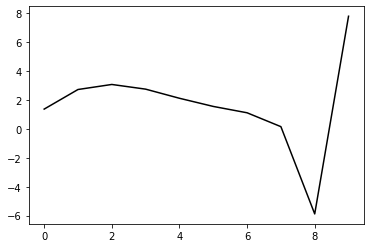

63800 24.017744932218754
0.3331961856396423 -0.16864540935964473 -0.24403008118461766 -0.1333598202944578
[ 1.31587585  2.77709936  3.13131501  2.80969883  2.17968301  1.61562351
  1.17686674  0.21635439 -5.82635706  7.82979899]


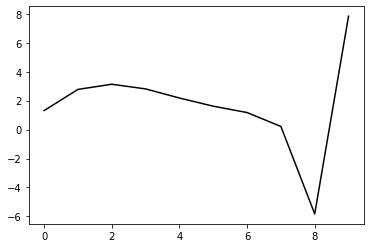

64900 22.27734594040246
0.3360550614336544 -0.1684128206860192 -0.2448729508471728 -0.13134192575490897
[ 1.26835239  2.80477945  3.15133193  2.82284142  2.1871831   1.61818863
  1.17493511  0.20929126 -5.8397828   7.87203857]


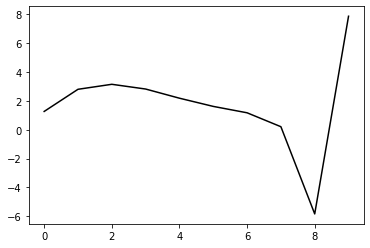

66000 19.95905647782117
0.338636537525509 -0.16636964807873592 -0.2444580889638328 -0.13093736228141298
[ 1.26519255  2.90215411  3.25616778  2.93183652  2.2981261   1.72926691
  1.28464251  0.3155583  -5.73970669  7.83145578]


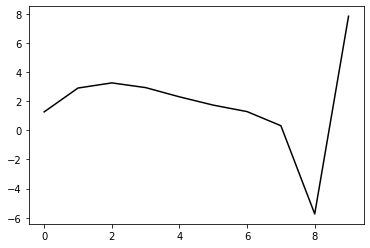

67100 19.861662911113687
0.3363848472579983 -0.1656196468733651 -0.24389451461610115 -0.12957451112667662
[ 1.30780082  2.79412194  3.14332796  2.81552128  2.17983599  1.60997367
  1.16501877  0.19539846 -5.85995627  7.82747567]


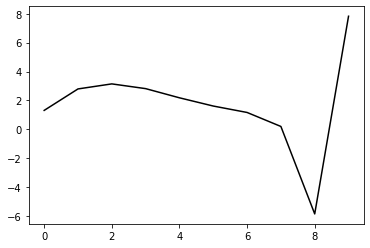

68200 23.595810570375658
0.3344006757750612 -0.16951829443813746 -0.24640987323170885 -0.128959526852698
[ 1.30347008  2.79332377  3.14987945  2.82728553  2.19568186  1.62918784
  1.18733973  0.22009476 -5.83296805  7.78514071]


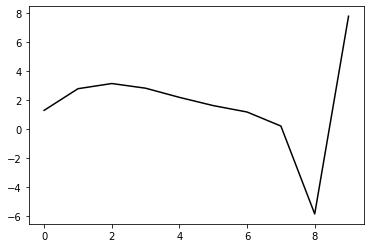

69300 24.626986171947305
0.3283317223611456 -0.16695933703538543 -0.2432641902426517 -0.13071988926148084
[ 1.35443118  2.63252804  2.99095711  2.67565054  2.05419005  1.49880312
  1.06810725  0.11069196 -5.9344932   7.80024529]


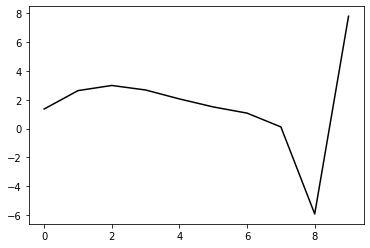

70400 17.771348814009926
0.33170216671497105 -0.1694864572120619 -0.24650874855012284 -0.1273074057835832
[ 1.32617593  2.7578876   3.11899578  2.80135082  2.17469367  1.61250311
  1.17423428  0.2084105  -5.84418582  7.79151324]


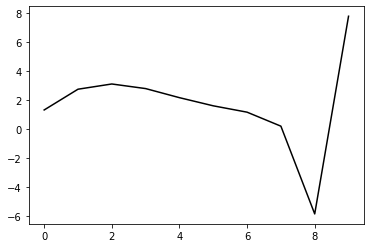

71500 21.67849363412088
0.3302336928534067 -0.16761687176818002 -0.24476638922748498 -0.1309797140020986
[ 1.32987     2.75168375  3.12060219  2.80943744  2.18834698  1.63112657
  1.19758999  0.23580275 -5.81345435  7.82569824]


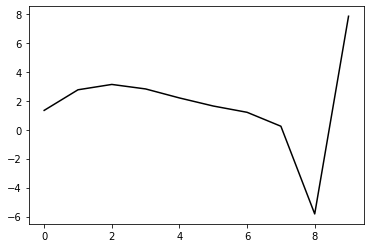

72600 24.51485330874773
0.33176550832205126 -0.1672485013724875 -0.24444976490841586 -0.1312259162578603
[ 1.32684639  2.83113088  3.18449984  2.85511477  2.21515813  1.63955534
  1.18910273  0.21199713 -5.8503861   7.8119161 ]


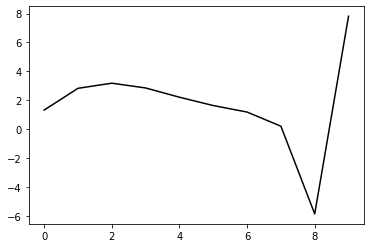

73700 14.025870136731294
0.334417394584096 -0.1658167988753431 -0.24436236219365814 -0.13213437462261046
[ 1.34295021  2.86106939  3.22428796  2.90207479  2.26790592  1.69700584
  1.25038859  0.27558141 -5.78658188  7.85130919]


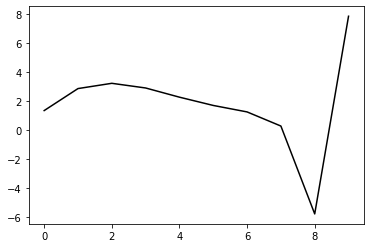

74800 30.209901722969335
0.3284534023586247 -0.16371666519310576 -0.24090769578091042 -0.13497095526798347
[ 1.3807172   2.81844279  3.17030324  2.83939542  2.1983932   1.62212443
  1.17170794  0.19438928 -5.86793593  7.78328399]


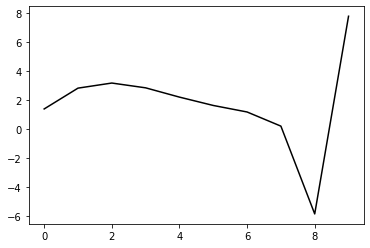

75900 18.59855534514773
0.3358014173942109 -0.167969268058982 -0.24584808761114504 -0.13128997761428748
[ 1.28684146  2.86038435  3.20372853  2.86455897  2.21639005  1.63409343
  1.17892463  0.19778848 -5.86678339  7.83269217]


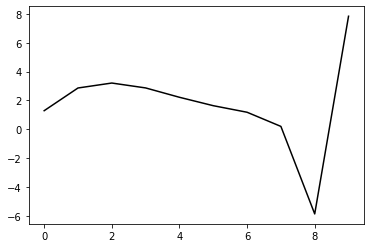

77000 16.167712369031296
0.3380112541222173 -0.16572528952998428 -0.24492997063669958 -0.1316216269166809
[ 1.29163596  2.93479031  3.27804372  2.93637681  2.28511749  1.69943911
  1.24067689  0.25506971 -5.81571741  7.80697594]


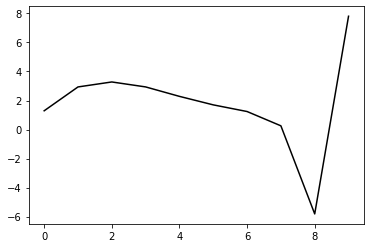

78100 20.208528443359114
0.33483762349823076 -0.1694638844545155 -0.2471986981340936 -0.13097796709485224
[ 1.33166868  2.82933627  3.18741786  2.85912053  2.22043712  1.64665989
  1.19936289  0.22412579 -5.8366706   7.82637029]


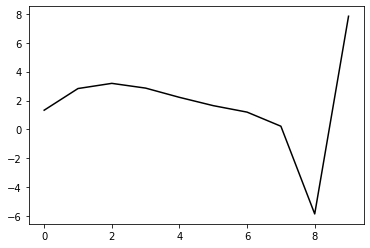

79200 22.90887778455775
0.33055056438469727 -0.1670047902204177 -0.24465826671590196 -0.1311502787702255
[ 1.36767493  2.68668634  3.03819117  2.70773792  2.06992185  1.49847162
  1.0541822   0.08136026 -5.97885697  7.79490313]


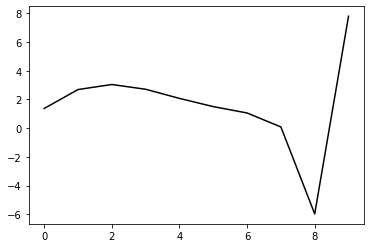

80300 20.709448083581137
0.3342088767312841 -0.16876793837592097 -0.2472705491794778 -0.12965065861220562
[ 1.34093141  2.78491977  3.15672419  2.84069768  2.21286682  1.64812197
  1.20819711  0.23733946 -5.82152593  7.84328869]


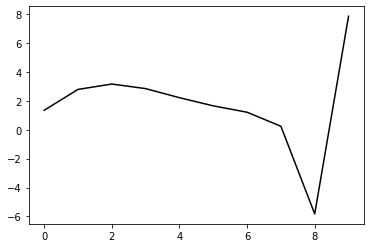

81400 15.423089540639038
0.33092101302803223 -0.1673516487481328 -0.2459954158284399 -0.12816687932593465
[ 1.36752526  2.73248368  3.0924017   2.76315319  2.12291248  1.54711799
  1.09769707  0.1181613  -5.949812    7.78988174]


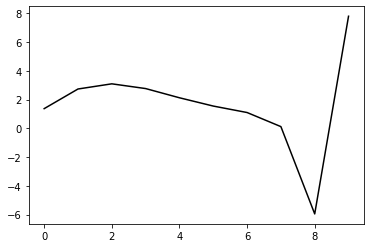

82500 21.966088580208165
0.3319998930775976 -0.165709729070523 -0.24503902940594216 -0.13123705602261176
[ 1.35086464  2.8424362   3.21969871  2.90409647  2.27460291  1.7073116
  1.26469008  0.28991743 -5.77371368  7.83916119]


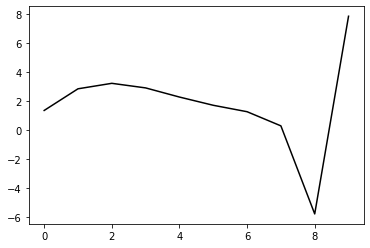

83600 24.437307534806454
0.33301754751090284 -0.1660044802523132 -0.24577688686508828 -0.13083646892895778
[ 1.31814381  2.90353987  3.28370608  2.96998612  2.34189119  1.77555501
  1.3335045   0.35802305 -5.70900702  7.80457226]


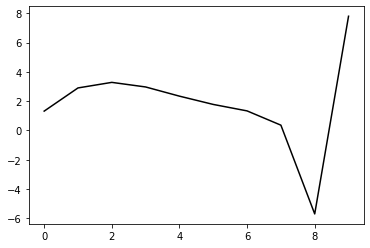

84700 13.494219271486044
0.3305244669894358 -0.16523176492925415 -0.24502224818589236 -0.13026829112167057
[ 1.37631892  2.80952433  3.19057255  2.87820697  2.2523026   1.68903655
  1.25101766  0.27960313 -5.78243204  7.83356495]


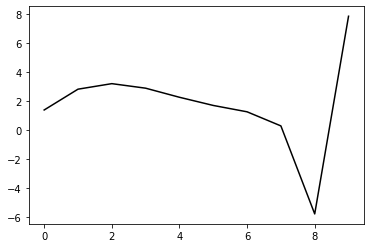

85800 27.72286878514205
0.3252510897083712 -0.16499001964617696 -0.24269952792492958 -0.1338962203443597
[ 1.39127744  2.81318346  3.17124637  2.83610889  2.18929371  1.60797471
  1.15543751  0.17286182 -5.89657031  7.78858668]


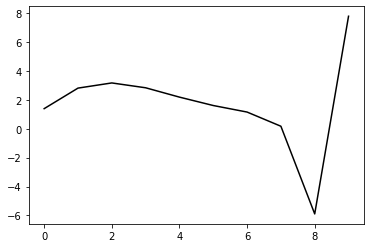

86900 16.138767940051927
0.3331966867767683 -0.16679173770174316 -0.24611388538196768 -0.13073621483784306
[ 1.29803992  2.87807946  3.22215261  2.87414019  2.21643255  1.62599202
  1.16595558  0.1768839  -5.89785625  7.83759151]


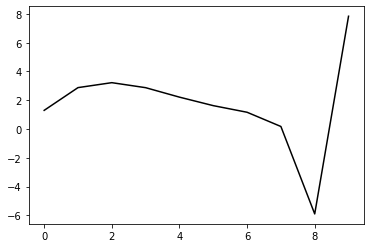

88000 17.868044790741433
0.33555186732993414 -0.17064627085689232 -0.2496589465015312 -0.12742026512177126
[ 1.31083813  2.88205886  3.22757856  2.87974663  2.22175629  1.63085107
  1.17047577  0.18095995 -5.89293879  7.78038549]


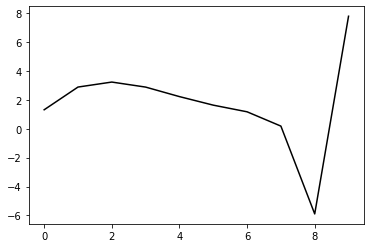

89100 22.856012205113405
0.3314267021600521 -0.16565576706707807 -0.2449204271863512 -0.13172988999665666
[ 1.39541528  2.794412    3.13900456  2.79112495  2.13409281  1.54469673
  1.08616498  0.09817785 -5.97409992  7.83969184]


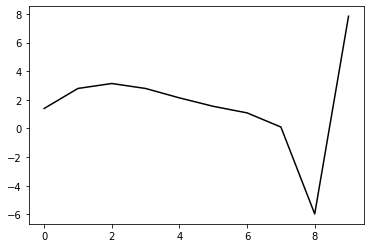

90200 23.597312670903797
0.32880536197082194 -0.1654387367996983 -0.24421862984639797 -0.13245707514251584
[ 1.36785088  2.80210159  3.14741155  2.7993944   2.1420009   1.55211442
  1.09311435  0.10433779 -5.96808287  7.77176327]


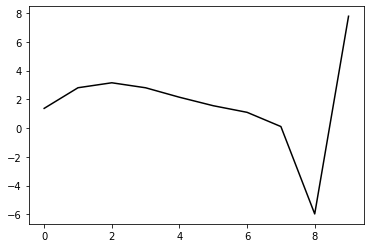

91300 23.3600146129541
0.3309932958804243 -0.1642269088529474 -0.24425907690484472 -0.13183967234066546
[ 1.34809578  2.87922659  3.22327111  2.87207697  2.21158877  1.61893718
  1.15754287  0.16611988 -5.90913138  7.83528538]


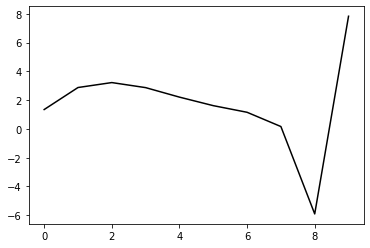

92400 15.032960779347809
0.3316076803686714 -0.1658104765094723 -0.24571300794464337 -0.13172597152567747
[ 1.38232257  2.87254288  3.23240506  2.89420459  2.24520425  1.66305025
  1.2116438   0.22930115 -5.837173    7.81083232]


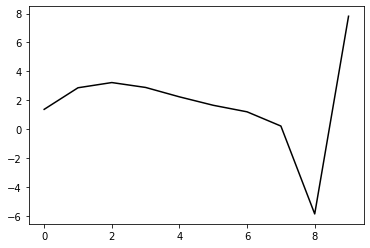

93500 22.122266854516653
0.3305040780756289 -0.16700492762738192 -0.24653058871275058 -0.13205170194535687
[ 1.35847507  2.8676386   3.23341996  2.90027957  2.25595661  1.67788038
  1.22980743  0.24917435 -5.8169841   7.82345271]


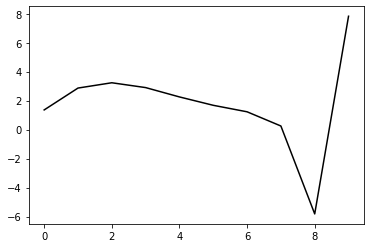

94600 31.092055849460714
0.3280755289276592 -0.17593640488321605 -0.2526004655081609 -0.1266224386543868
[ 1.31647107  2.75557258  3.09334821  2.73962973  2.08076489  1.49269219
  1.03834757  0.05409882 -6.01373311  7.77288836]


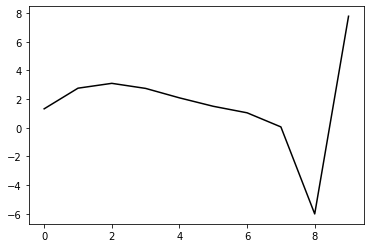

95700 13.191285778193084
0.3348008956083332 -0.16417270501149378 -0.24494199561590307 -0.13361517266210238
[ 1.347101    2.92570448  3.26003265  2.90035431  2.23512344  1.64091918
  1.18096997  0.19123445 -5.88274325  7.7818492 ]


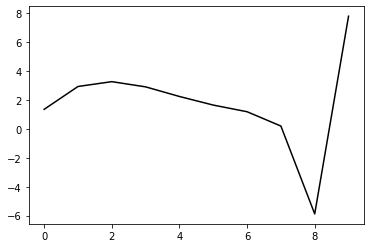

96800 27.537248582357016
0.33259927209412576 -0.16216747532420328 -0.24297005270125083 -0.13538170114645168
[ 1.37770148  2.917521    3.25774365  2.9021824   2.24053422  1.64955624
  1.19258771  0.20505989 -5.86700663  7.82985055]


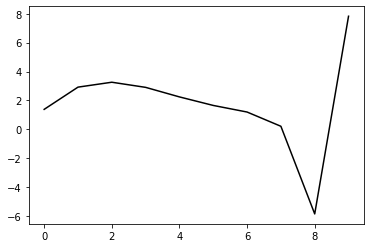

97900 22.22391279879809
0.3342798017571151 -0.16800846198807756 -0.2478519944137218 -0.13232144897323234
[ 1.27622479  2.87357365  3.20887663  2.85095578  2.18860495  1.59786124
  1.14192754  0.15570739 -5.91346642  7.84718334]


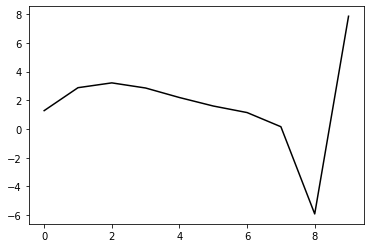

99000 17.943881760003556
0.3364634795727165 -0.17014274617268446 -0.24997485425193808 -0.13020760870511458
[ 1.29764049  2.89540302  3.22946813  2.87012169  2.2059907   1.61321181
  1.1552332   0.1667452  -5.90368265  7.77579264]


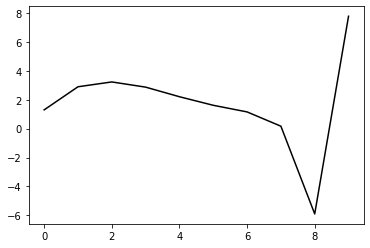

100100 21.580607726916604
0.3364222678726071 -0.1652414754022992 -0.24647548708818237 -0.13276186554951339
[ 1.34617611  2.86486363  3.20108412  2.84292206  2.18011788  1.58873614
  1.13209774  0.14423844 -5.92628995  7.83497777]


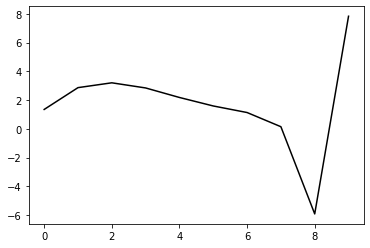

101200 25.400267334808227
0.33477881498144585 -0.16987991382659393 -0.24972243197517327 -0.13161709883421846
[ 1.29942671  2.87664526  3.22336844  2.87289773  2.2163457   1.63035626
  1.17873868  0.19524915 -5.87114461  7.79925822]


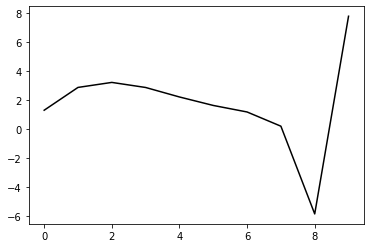

102300 24.75308362540289
0.32828105641074906 -0.1656583102037492 -0.24521551930995555 -0.13281800654231296
[ 1.3549359   2.73154938  3.07184262  2.71668263  2.05720768  1.46954616
  1.01724821  0.03322192 -6.03506319  7.78363343]


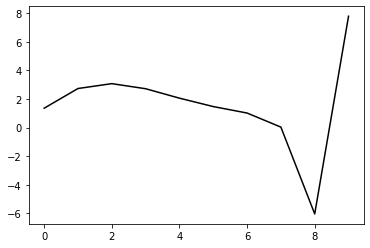

103400 16.876427569276544
0.3273455875826719 -0.16886041913657646 -0.2475198813799926 -0.1320742788308863
[ 1.32897626  2.75009133  3.09451419  2.74172592  2.083377    1.49606633
  1.04380232  0.05938169 -6.00735659  7.77664754]


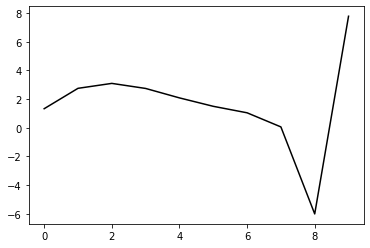

104500 22.120380919913682
0.332290875781102 -0.1664837920564048 -0.24714785610628578 -0.13224468357255234
[ 1.31293141  2.85445455  3.20062194  2.84770423  2.18833962  1.59940777
  1.14505137  0.15766745 -5.91198158  7.81791512]


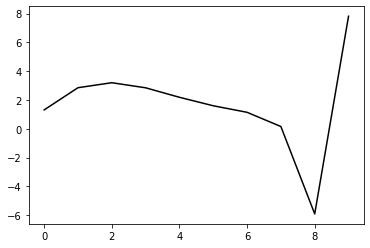

105600 24.729896694210428
0.3342361626099008 -0.16644492670074415 -0.2477535258332629 -0.13371611427463723
[ 1.30520387  2.95087427  3.312242    2.96924899  2.31700507  1.73352809
  1.28356483  0.29912661 -5.76991143  7.8143512 ]


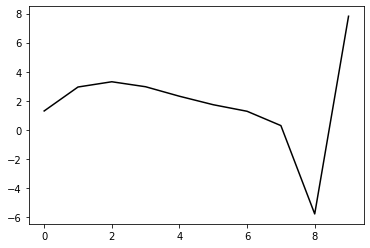

106700 14.20726198583157
0.3331690999181573 -0.164838243212794 -0.24663498607647605 -0.1343560573373744
[ 1.36451183  2.88163618  3.25250348  2.91712394  2.27141654  1.6936416
  1.24871025  0.26786329 -5.79893129  7.86231314]


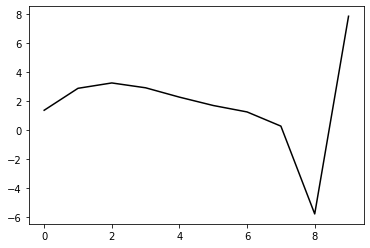

107800 22.014774842189393
0.330696567264078 -0.16228495032652512 -0.24459467001952656 -0.13360417758853507
[ 1.34175216  2.89436252  3.25186519  2.90283626  2.24438486  1.65485741
  1.19907599  0.20757563 -5.87001066  7.80672762]


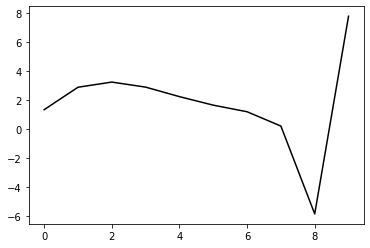

108900 13.527413882065359
0.33354282576940125 -0.16363134909390298 -0.2465218951468959 -0.13199592249921963
[ 1.32966949  2.91704619  3.28369096  2.94109893  2.28758179  1.70186567
  1.24912152  0.25943437 -5.81766357  7.81210269]


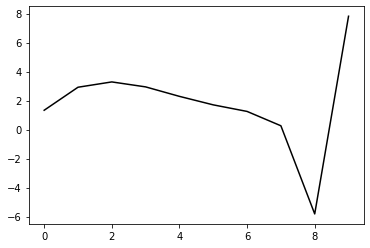

110000 19.463944580810274
0.33502305190281684 -0.16314436096450066 -0.2472771763613385 -0.13018185479331865
[ 1.2762481   2.92984054  3.29667924  2.95383114  2.30048849  1.71512114
  1.26239564  0.27109601 -5.81011223  7.80340559]


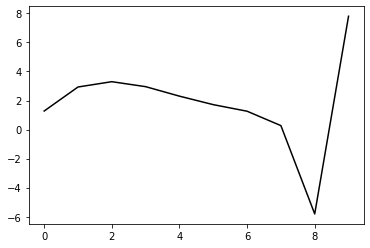

111100 25.776861774370698
0.32488905252788697 -0.1654907760606916 -0.24635817269248528 -0.13144108716866562
[ 1.41242707  2.69568908  3.05973069  2.71653943  2.06461706  1.48214706
  1.03375695  0.04769056 -6.02695195  7.82765573]


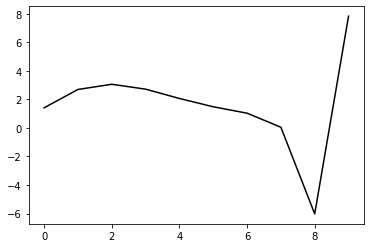

112200 23.73778834433179
0.3258840242444845 -0.1640643585338789 -0.24584066859521636 -0.13206613096433387
[ 1.37571875  2.74905076  3.11420175  2.77157016  2.11973569  1.53691204
  1.0876657   0.09968308 -5.97693987  7.77835926]


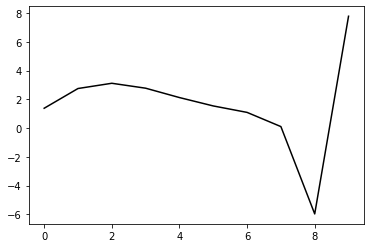

113300 24.90053345960677
0.3211072803683058 -0.16538159338170447 -0.245712905569033 -0.13219344739699182
[ 1.35834759  2.6790599   3.04347499  2.70173154  2.05131539  1.4702159
  1.02303888  0.0370279  -6.03762141  7.80180557]


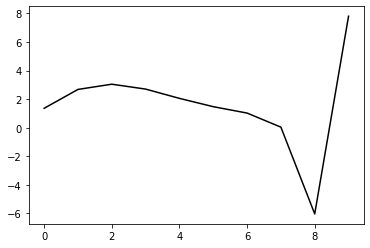

114400 17.155177809809008
0.32456306023085413 -0.1673835119766181 -0.24811496380477885 -0.13009733849708363
[ 1.33477433  2.75944737  3.1185906   2.7708018   2.11406377  1.52675338
  1.07375053  0.08216431 -5.9956913   7.77813242]


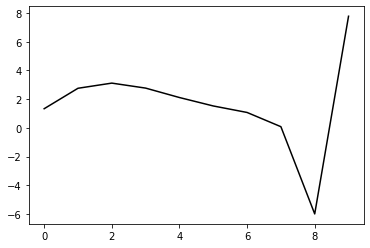

115500 21.741043755367244
0.32927018040558437 -0.16547517910626347 -0.24792885327239633 -0.1303271170165712
[ 1.32257785  2.84570439  3.20153427  2.84986734  2.18925701  1.59823377
  1.14175109  0.14658182 -5.93402987  7.81027089]


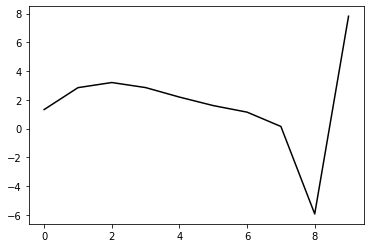

116600 25.41205284796175
0.32966194167585644 -0.16703889546699024 -0.24935278931723112 -0.1287166758044823
[ 1.31732318  2.84001813  3.19282626  2.83838085  2.17550953  1.58274184
  1.1250744   0.12888263 -5.95200604  7.79013562]


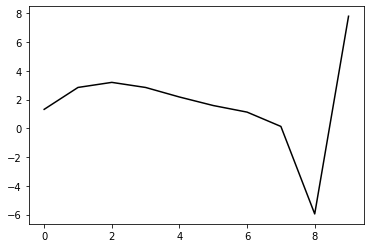

117700 13.426667010216553
0.32956011099482835 -0.16300074707885692 -0.24611473780545357 -0.13317018449557336
[ 1.36647825  2.89052424  3.25332779  2.90565597  2.24766032  1.65869801
  1.2043296   0.21082752 -5.866925    7.81770492]


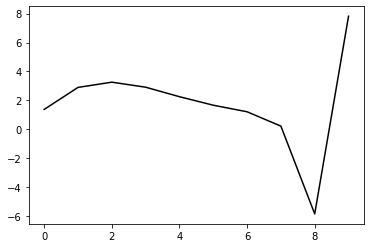

118800 22.930719904929678
0.3295618027739342 -0.16219252240762763 -0.24574139538213716 -0.13333386225989732
[ 1.33064579  2.91678326  3.27608562  2.92472851  2.26384645  1.67278708
  1.21706649  0.22230638 -5.85668219  7.80541888]


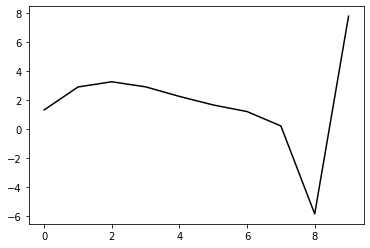

119900 22.31867822296671
0.3312931111023266 -0.1637289752358595 -0.24762275912032666 -0.1308684845361362
[ 1.27365707  2.88739053  3.23620987  2.87553977  2.20750227  1.61123653
  1.15195173  0.15421951 -5.92735135  7.8120359 ]


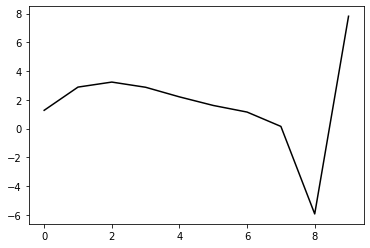

121000 17.498073368328974
0.33110732618159694 -0.1684162835769354 -0.251087957151374 -0.1290110703637478
[ 1.30894202  2.83295189  3.19607216  2.84905308  2.19357026  1.60880965
  1.16016427  0.17170205 -5.90077322  7.79418679]


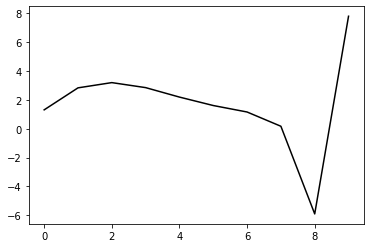

122100 24.886032174871985
0.32516596720781776 -0.1664167478920912 -0.24818411741946264 -0.13143960814753522
[ 1.3859439   2.68748582  3.05328857  2.71104053  2.06091609  1.48151556
  1.03803541  0.05383159 -6.01570031  7.83278941]


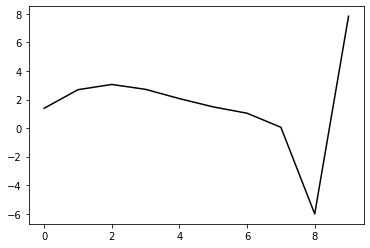

123200 22.64002388014805
0.3293450780782342 -0.1632696078237479 -0.24722663684493637 -0.13095628546595722
[ 1.32948323  2.8171081   3.17658474  2.82633948  2.16778948  1.58001534
  1.12831819  0.13545431 -5.94272461  7.77776886]


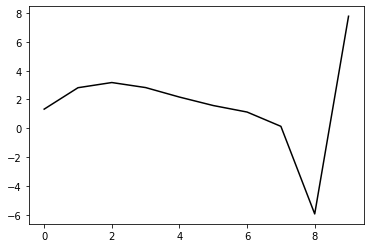

124300 25.067972412347334
0.322385551341592 -0.16295214427730226 -0.24523691167244105 -0.13330355562319843
[ 1.35440728  2.70676933  3.06722097  2.72021892  2.0662043   1.48383104
  1.03825351  0.05150343 -6.02046224  7.79965304]


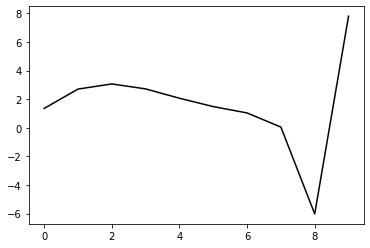

125400 17.616922415582607
0.3227611720139395 -0.16739091107055068 -0.24858943624814456 -0.13149166506797236
[ 1.32723807  2.72058937  3.07878832  2.72935916  2.0725841   1.48748715
  1.03962716  0.05090418 -6.02099117  7.76790616]


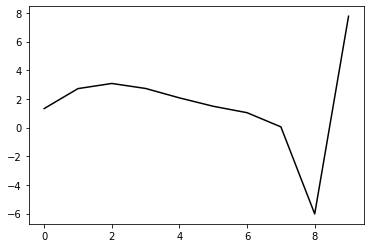

126500 22.008512129452193
0.3292627596732115 -0.16414509598194962 -0.24772583152474326 -0.13222350612922834
[ 1.31432745  2.86456474  3.21769063  2.86187094  2.19837904  1.6066559
  1.15250495  0.15759619 -5.91906176  7.81225385]


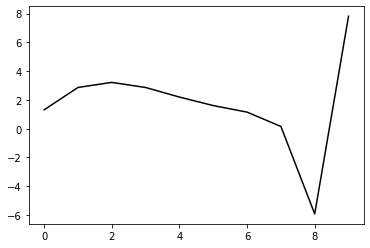

127600 24.651257193589856
0.32997485124936854 -0.16273011486805844 -0.24691836729259845 -0.1348711630321235
[ 1.32323444  2.94595386  3.31146357  2.96442124  2.30781154  1.72186803
  1.27280632  0.28187403 -5.79266111  7.80803413]


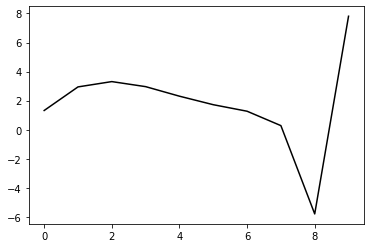

128700 13.404587174198907
0.325953025535816 -0.164548238176342 -0.2476162279089093 -0.13326705941617756
[ 1.37006544  2.79471683  3.15933293  2.81376253  2.15963635  1.57657618
  1.130592    0.14240423 -5.9282085   7.81779947]


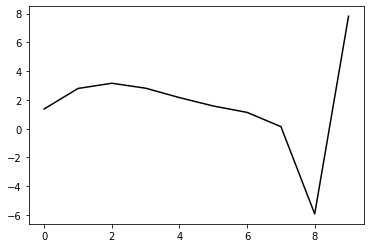

129800 22.286758727571616
0.32796036972175796 -0.16126930996488842 -0.2455662502797702 -0.13605361772316757
[ 1.35209477  2.89459742  3.26114894  2.91553883  2.26045273  1.67614814
  1.2290294   0.239566   -5.83229103  7.80813592]


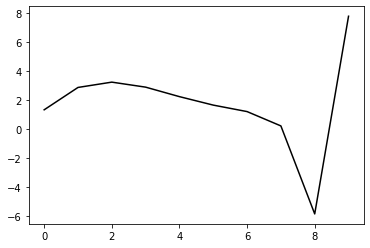

130900 12.697793555559675
0.3304602327173772 -0.16014054296357938 -0.2455487202157367 -0.1351043043904076
[ 1.32548754  2.94615559  3.30731846  2.95587729  2.2955818   1.70666105
  1.25538235  0.26149427 -5.81522716  7.82544126]


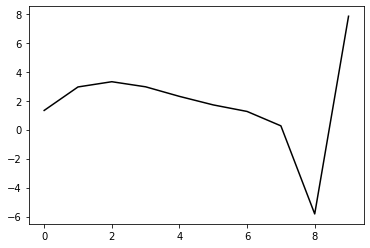

132000 15.002383608280008
0.33245906402658104 -0.15939443177021392 -0.24585242190128734 -0.1336411802425594
[ 1.28565311  2.94869511  3.30511207  2.94787864  2.28240962  1.68903028
  1.23390879  0.23593627 -5.84529032  7.7850831 ]


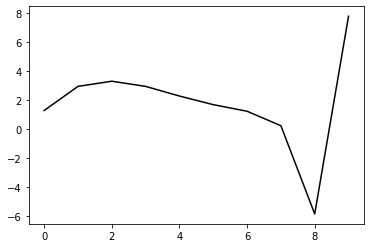

133100 20.64149161037112
0.3256038257894437 -0.16970785099630536 -0.25178627644263124 -0.13019419791481696
[ 1.30529536  2.77818547  3.14072911  2.79037315  2.13260077  1.54755458
  1.10137143  0.11234746 -5.95828582  7.78655998]


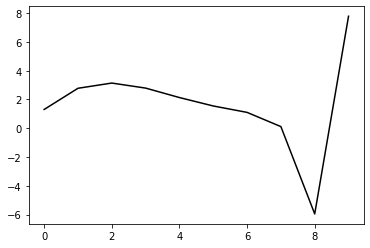

134200 22.45173676030021
0.32784346614413984 -0.16242109467438606 -0.24712244579397144 -0.13267534750247592
[ 1.34018409  2.82013194  3.17977766  2.82704216  2.16787367  1.5820935
  1.13528049  0.14461054 -5.92923943  7.79142019]


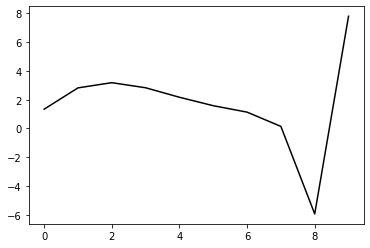

135300 25.215094291432568
0.3231597500367565 -0.16101869067759994 -0.24519380739938665 -0.13521439764886148
[ 1.36228195  2.79499713  3.15933287  2.80940371  2.152445    1.5688597
  1.12450943  0.13594074 -5.93615849  7.7936324 ]


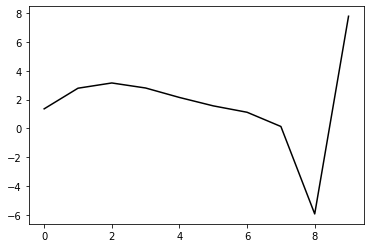

136400 14.055540008866853
0.32677409044349637 -0.15878764999268077 -0.24494244644542276 -0.1336763309181604
[ 1.33296356  2.8688954   3.23187996  2.87878516  2.21783635  1.62976341
  1.18058888  0.1863038  -5.89214773  7.7979889 ]


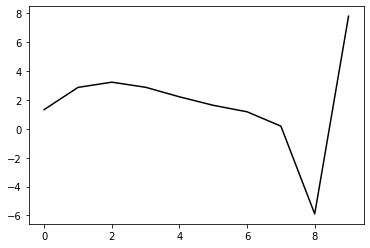

137500 22.313537899516568
0.3249112260858519 -0.16220427918296687 -0.2467600510419926 -0.13385489016340324
[ 1.33514725  2.82894748  3.19419119  2.84309081  2.18427032  1.59882242
  1.15307291  0.16261211 -5.91046381  7.79980512]


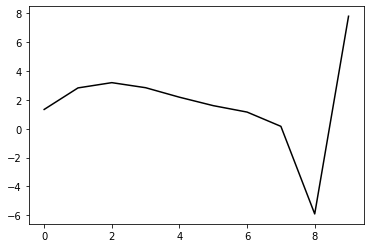

138600 25.00093271730229
0.3295607156508227 -0.15880617371058317 -0.24583100533802707 -0.13241828447698228
[ 1.27674956  2.93608373  3.29919126  2.94328042  2.2783064   1.68593736
  1.2328516   0.23417018 -5.84882858  7.81064468]


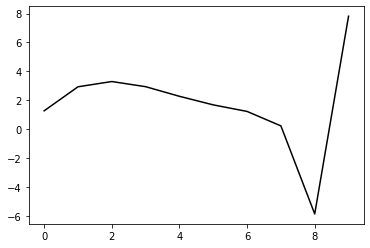

139700 14.313320612637561
0.32214343299196907 -0.16354628995137716 -0.24728710030099366 -0.1344813040900653
[ 1.37166492  2.7754567   3.14760923  2.80199585  2.14826664  1.56823086
  1.12872112  0.1442596  -5.92228419  7.81327625]


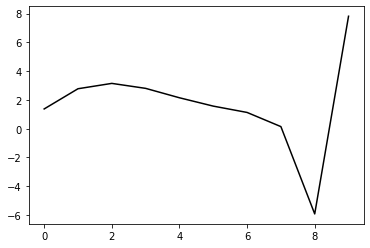

140800 29.75070242646525
0.3196034527080279 -0.16011912012449778 -0.24373441727375314 -0.13789174742735077
[ 1.37079417  2.82916989  3.18914552  2.831637    2.16648136  1.5758227
  1.12679782  0.13378434 -5.93867458  7.77435057]


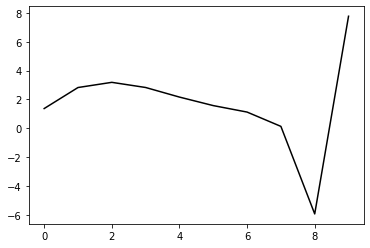

141900 15.845326619907883
0.3264889790613896 -0.1634100206659807 -0.2479343584425779 -0.1342933581529832
[ 1.2788324   2.8718046   3.22069946  2.85293968  2.17885396  1.58064877
  1.12548381  0.12730461 -5.94890416  7.81989738]


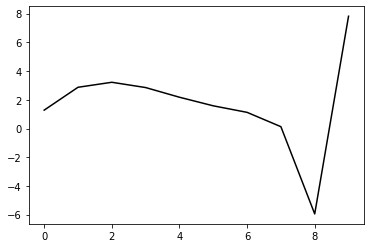

143000 15.5112935679938
0.32859412092247525 -0.1620601988963991 -0.2475704889241723 -0.13462405211709164
[ 1.28973859  2.94049185  3.29176608  2.92392653  2.24886434  1.64937856
  1.19290002  0.19293115 -5.88584342  7.8176514 ]


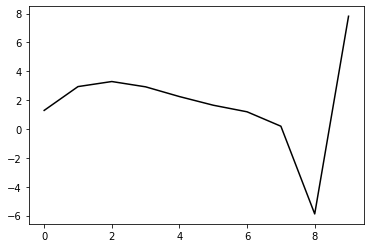

144100 20.04620745039372
0.3270444390216265 -0.1637277656127232 -0.24889812387107177 -0.13269745772623262
[ 1.29171429  2.88398306  3.2413431   2.87699032  2.20449323  1.60720255
  1.15271503  0.15384961 -5.92459631  7.79060124]


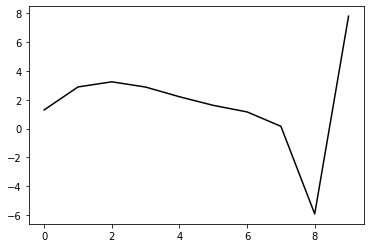

145200 22.064177026693322
0.3281093633213674 -0.15936379050215776 -0.24655800822638013 -0.1316038970672992
[ 1.2971215   2.85232196  3.20577351  2.83702556  2.1604447   1.55932712
  1.10114663  0.09791617 -5.98679472  7.76199747]


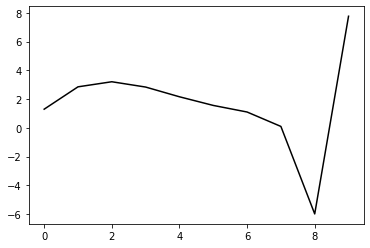

146300 22.7342782678714
0.32090754051521253 -0.1651257014456776 -0.24830178932715263 -0.13324633657773038
[ 1.32286136  2.77612659  3.13197639  2.76584549  2.09237644  1.49528307
  1.04240177  0.04550248 -6.02954401  7.78914566]


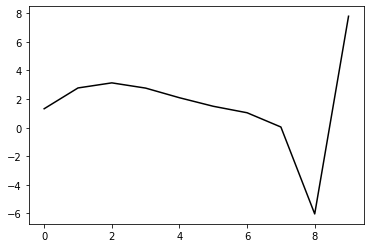

147400 14.206692976082826
0.3240875086082726 -0.1607220397896183 -0.2460310916183316 -0.13475759262539627
[ 1.31162908  2.86574689  3.22490688  2.85993398  2.18649658  1.5889272
  1.13537842  0.1372749  -5.93895651  7.79789417]


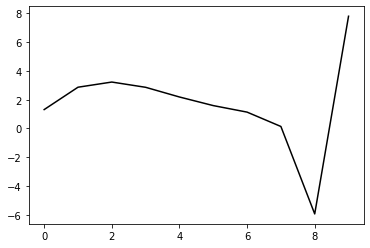

148500 22.099310820050192
0.32509128328343584 -0.16200920840532856 -0.24699864835729496 -0.1350184847362289
[ 1.32549728  2.86172342  3.22380639  2.86023199  2.18742823  1.59049203
  1.1381744   0.14174856 -5.93119525  7.80302428]


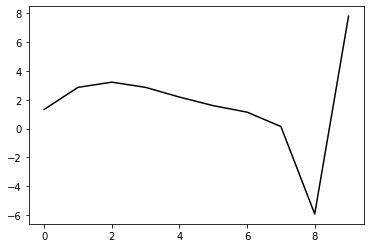

149600 25.491131985606525
0.3240069523122168 -0.16732411133090827 -0.25084404001739885 -0.13278260220222826
[ 1.29863695  2.82171485  3.18489948  2.82307711  2.15218329  1.55725356
  1.107099    0.11257227 -5.95782167  7.7976945 ]


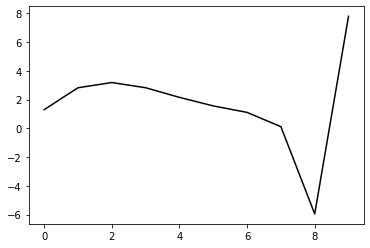

150700 13.355597484165216
0.3217181540250958 -0.16438499614672647 -0.24797319956436367 -0.13598294174097306
[ 1.35306072  2.81872112  3.18297693  2.82161615  2.15057982  1.55518158
  1.10443872  0.10895933 -5.9614088   7.81418239]


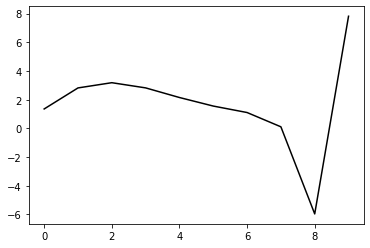

151800 22.103096431442303
0.32422394432868606 -0.16036340167105628 -0.24553762006317406 -0.13855679454170738
[ 1.33352634  2.92162461  3.28358041  2.91881559  2.24423045  1.64557295
  1.19209023  0.19409337 -5.87826635  7.80327145]


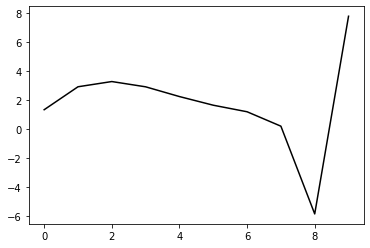

152900 13.007893238482659
0.3260060764283229 -0.16047359749237058 -0.24638620964556296 -0.13725020185648937
[ 1.31684704  2.94073011  3.3045679   2.9408713   2.26730315  1.66968348
  1.21723355  0.21966385 -5.85306066  7.81815143]


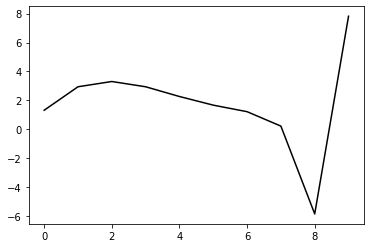

154000 17.57783184211651
0.32021661261602113 -0.16372853183548283 -0.24735605434150354 -0.13668130623061675
[ 1.32406048  2.79370484  3.15070993  2.78184684  2.10530693  1.50669239
  1.05494972  0.05882429 -6.01148477  7.82824515]


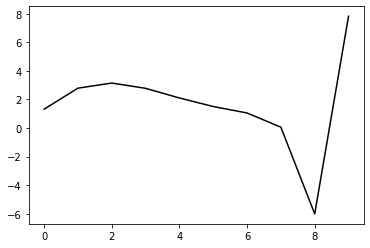

155100 21.267020379377755
0.32586066867045854 -0.16379745573268953 -0.24904891334232465 -0.13402194667171066
[ 1.31728385  2.80861482  3.16860752  2.8021651   2.1275494   1.53045879
  1.07990096  0.08405221 -5.98594407  7.81300501]


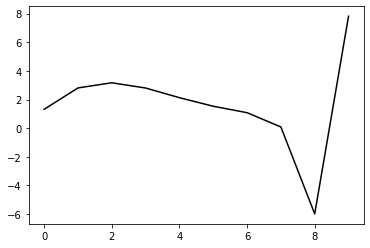

156200 21.825459497172172
0.32387827375621053 -0.16309823797226802 -0.24812256659799714 -0.1350536769458564
[ 1.32060259  2.75705074  3.12088551  2.75881517  2.08854074  1.4956388
  1.0490199   0.0561612  -6.01155274  7.77582874]


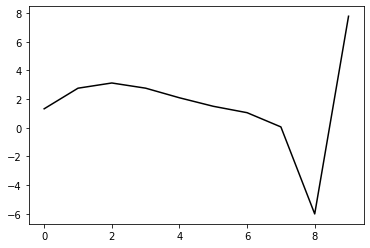

157300 23.50846947982373
0.3218870432400174 -0.16247546378224495 -0.24724773249418236 -0.1351878822329477
[ 1.31491965  2.70461621  3.07049166  2.711355    2.04382017  1.45348598
  1.00942466  0.01866145 -6.04708079  7.80075524]


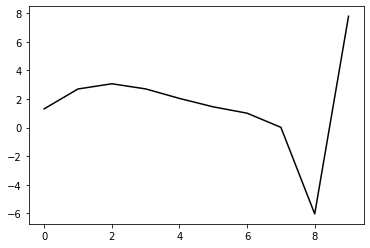

158400 17.41077418227401
0.31859033162819905 -0.16651615013366386 -0.24921602791652184 -0.13541972877120928
[ 1.30771505  2.70303942  3.06908864  2.70927668  2.04043735  1.44885408
  1.00408095  0.01298942 -6.05106884  7.77255747]


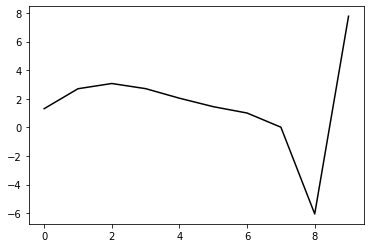

159500 22.227394331828492
0.32573411211537756 -0.16246953878383644 -0.2480659640689623 -0.13583729244244774
[ 1.29008868  2.85369908  3.21475193  2.84853876  2.17272488  1.57404883
  1.12227681  0.12402858 -5.94625223  7.80802652]


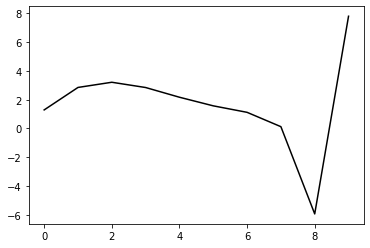

160600 24.209239732869243
0.32904483496603 -0.1586431547291599 -0.24622409957954075 -0.13655728730705835
[ 1.27278364  2.92318354  3.28442652  2.91630616  2.23807251  1.63693944
  1.18287414  0.18195071 -5.89221673  7.76587986]


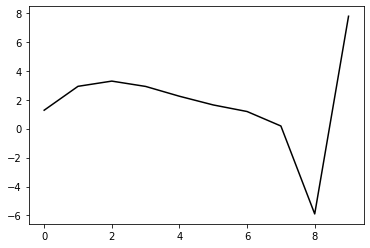

161700 14.531708945030894
0.32598436259169905 -0.16253929402442197 -0.24846575136884302 -0.1376530595004411
[ 1.31416831  2.86779571  3.24973875  2.89898396  2.23512235  1.64632313
  1.20334321  0.21209007 -5.85311786  7.82835943]


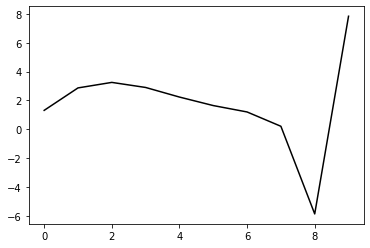

162800 21.975109271476416
0.3259057507480778 -0.15825200512635018 -0.2458206803369179 -0.13825055638733852
[ 1.32378243  2.89764464  3.28007003  2.92809957  2.2627224   1.67240468
  1.22787541  0.23432517 -5.83377032  7.80558624]


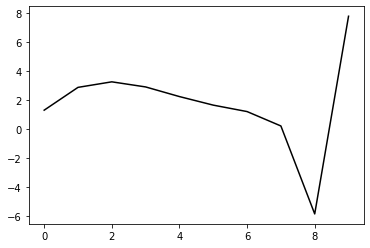

163900 19.343381063343372
0.32413556392154885 -0.16764727930498682 -0.2526083941455157 -0.13318791015213113
[ 1.29384772  2.79163478  3.17245342  2.81896597  2.15263369  1.56246399
  1.11952072  0.12841986 -5.93589481  7.8013698 ]


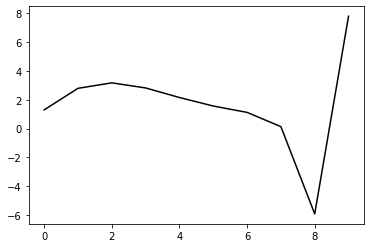

165000 15.939860194562822
0.32795522330996996 -0.16093498153587305 -0.2490020766272134 -0.1342118809225931
[ 1.28699429  2.94263706  3.3186784   2.95823744  2.28402274  1.68559395
  1.23397868  0.23293751 -5.84348376  7.79647759]


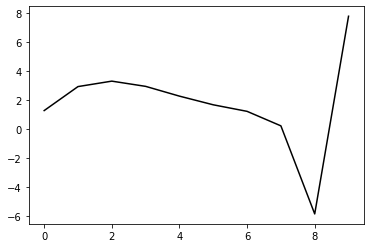

166100 19.660565037569864
0.3270787306492052 -0.16390295486949183 -0.25116230554255403 -0.13244146781986307
[ 1.30273014  2.83918573  3.21974713  2.86348236  2.19300312  1.59843397
  1.15121265  0.15445175 -5.91711349  7.82604951]


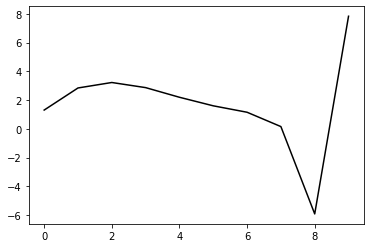

167200 22.85396469142327
0.3286613936367682 -0.15870286271901507 -0.24834214991005085 -0.13279076535032172
[ 1.29381295  2.91325113  3.29604474  2.94120531  2.27166109  1.67742307
  1.22961375  0.23031831 -5.84646849  7.82013723]


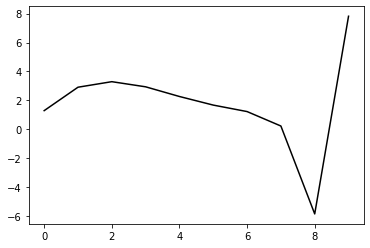

168300 23.411639674788436
0.32307302936248566 -0.15986508119473639 -0.24769171919378813 -0.13416285266543435
[ 1.3362047   2.81959769  3.20111448  2.84592498  2.17664332  1.58363943
  1.13833939  0.14243104 -5.92883977  7.80391362]


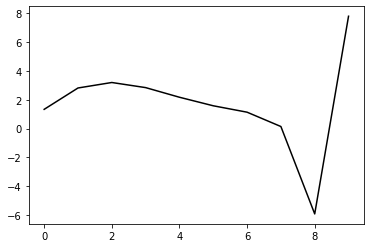

169400 14.522168732321655
0.32427071664131274 -0.1590813418764817 -0.247787651603537 -0.13313122425618454
[ 1.31847991  2.85061601  3.23217196  2.87587004  2.20498305  1.61033153
  1.16352638  0.16573916 -5.90757705  7.77668266]


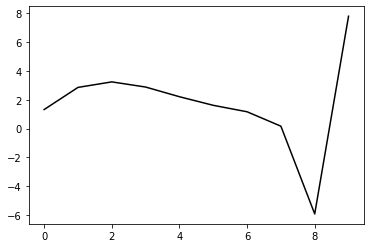

170500 21.709596554793386
0.32361707137885015 -0.16038101597648463 -0.24865311597966214 -0.13314868900170376
[ 1.32275828  2.84603095  3.23076292  2.87674172  2.20740877  1.61420012
  1.16916701  0.1731713  -5.8975783   7.79693652]


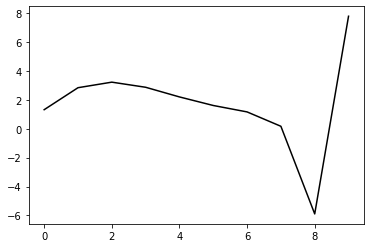

171600 25.656856274302616
0.3285668423976384 -0.1571539541417385 -0.2480072215544673 -0.1313173299145994
[ 1.27835612  2.92290658  3.30244474  2.941711    2.26499962  1.66419579
  1.21159892  0.20756481 -5.8722295   7.81182465]


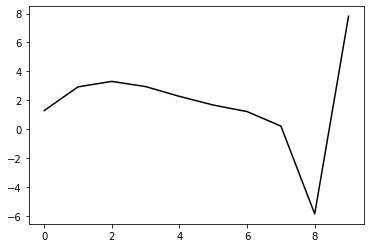

172700 17.745535129022223
0.32429095307689776 -0.15616539631696483 -0.2461686059930954 -0.1350219467085435
[ 1.39102951  2.84146905  3.23510928  2.88712735  2.2218047   1.63163557
  1.18945855  0.19519375 -5.8745215   7.85923115]


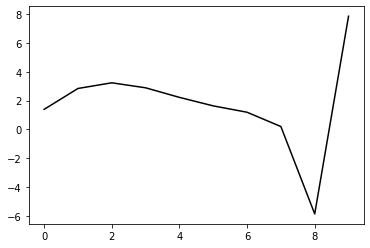

173800 26.455779991010594
0.321173658999789 -0.15886016922738816 -0.24658396658584023 -0.13716062379841304
[ 1.37144748  2.85149792  3.24357976  2.89437244  2.22782204  1.6370143
  1.19531005  0.20258552 -5.86334385  7.81382236]


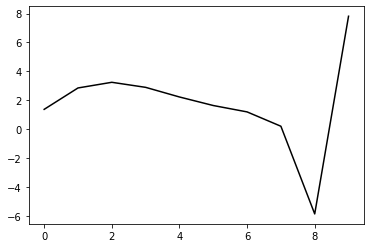

174900 17.030554572611177
0.32449489369270346 -0.16209129142182738 -0.24983281838047217 -0.13362989011672802
[ 1.27936717  2.86004318  3.22871104  2.8603175   2.17800197  1.57424265
  1.12191161  0.12020365 -5.9515437   7.81959928]


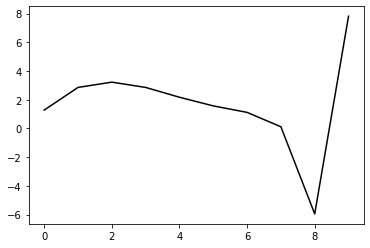

176000 17.89149232079936
0.327458372372228 -0.16503673432966837 -0.25270425620166104 -0.13149066953632985
[ 1.29091218  2.89943832  3.2680424   2.89877007  2.21508911  1.60993978
  1.15649246  0.15377617 -5.91789103  7.77152543]


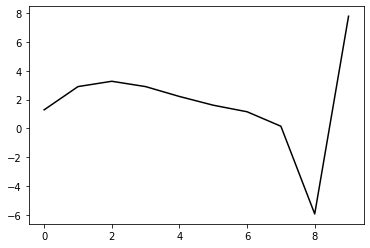

177100 21.12147559579521
0.32696662426959794 -0.15930022212948605 -0.24850873294862108 -0.134207047340961
[ 1.3463455   2.85885737  3.22609898  2.85544445  2.17078622  1.56501069
  1.11110644  0.10744869 -5.96577232  7.82191513]


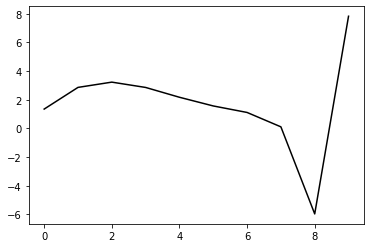

178200 22.158361432749487
0.3273875092150904 -0.15872775687838236 -0.24853920662404008 -0.13294203092439685
[ 1.29648253  2.88534442  3.24794979  2.87229764  2.18300909  1.57314132
  1.11574921  0.10867319 -5.96825534  7.80037159]


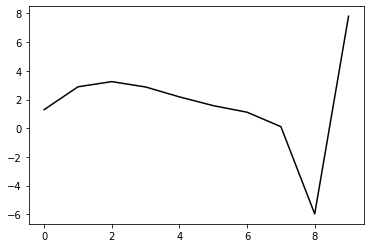

179300 22.72896632775037
0.32147010072562476 -0.16245733805834728 -0.24978394868352413 -0.13358870908785014
[ 1.33151199  2.78978141  3.16158555  2.79482614  2.11416311  1.51296733
  1.06447237  0.06594167 -6.00176097  7.85777212]


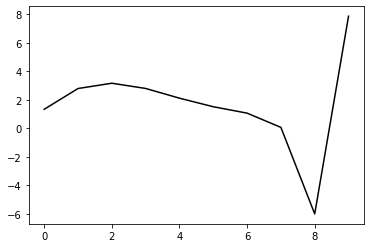

180400 19.718351636819346
0.3246594468076085 -0.15603536658312334 -0.24608401625940923 -0.13492447230172386
[ 1.37804989  2.88998014  3.26583168  2.89898     2.21588085  1.61105887
  1.15843516  0.15503082 -5.91754197  7.7983748 ]


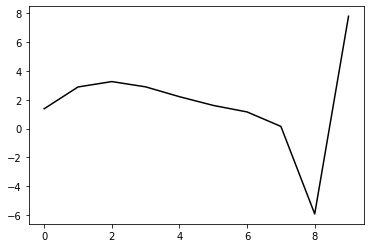

181500 22.553931681707994
0.3256584514458528 -0.16018240472985482 -0.2495114670228643 -0.1323279151094889
[ 1.3029747   2.90011554  3.26892234  2.8942575   2.20351665  1.59175192
  1.133172    0.12435814 -5.9523245   7.80566727]


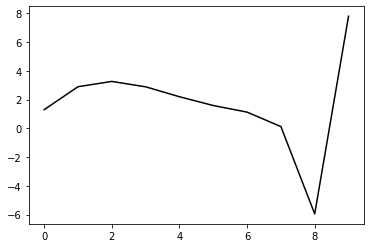

182600 24.83698452883694
0.32494970033808035 -0.16105395942792555 -0.249794890206397 -0.13588686635882324
[ 1.3257215   2.98472761  3.37218351  3.01212463  2.33285696  1.73073695
  1.28095734  0.2801001  -5.7895958   7.80122351]


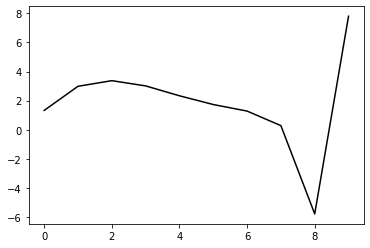

183700 13.15624234205152
0.3228830440781005 -0.1610228281421947 -0.24953071565433307 -0.13378673307176547
[ 1.35511392  2.84998299  3.23539176  2.87601734  2.19873178  1.5992784
  1.15247309  0.15415412 -5.91206255  7.81373147]


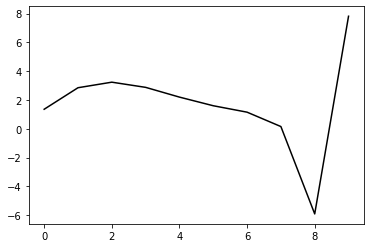

184800 22.39499111922904
0.32325192874401276 -0.1579338138174331 -0.24731194064280204 -0.13637967139353913
[ 1.35109428  2.92130752  3.30761414  2.94776353  2.26925487  1.66842164
  1.22038148  0.22060866 -5.84683864  7.81253809]


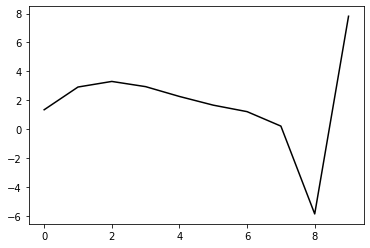

185900 13.395405503453595
0.3255751498074146 -0.1597206903614081 -0.2496426248701671 -0.13390213797285658
[ 1.323334    2.92195124  3.31419401  2.95882068  2.28408617  1.68671075
  1.24186883  0.24426869 -5.82229454  7.82437039]


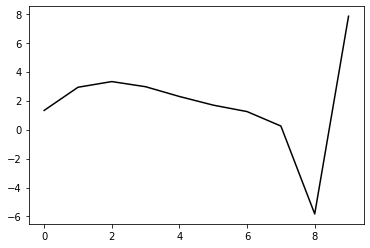

187000 16.263479409731428
0.3261629255710908 -0.1606156307390858 -0.25101469797444653 -0.13138043772901514
[ 1.30220476  2.90703498  3.29339856  2.93351007  2.25543802  1.65570108
  1.20912713  0.20945939 -5.85949665  7.76433055]


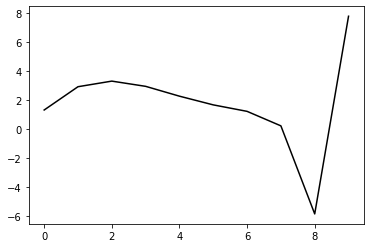

188100 20.259380293743074
0.3244472711899098 -0.1613090770210365 -0.2515611538520267 -0.13226409576733966
[ 1.32406168  2.86024886  3.26339559  2.91892862  2.25498083  1.66844059
  1.23413803  0.24491946 -5.81570743  7.82269751]


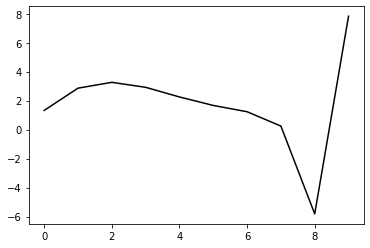

189200 23.43900083710045
0.3187473308070644 -0.16562568708836758 -0.252943271308821 -0.1312458992233374
[ 1.34448725  2.76246381  3.15529525  2.80302575  2.13314949  1.54249438
  1.10585302  0.11546518 -5.9445414   7.80192295]


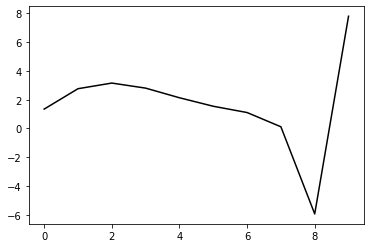

190300 20.79993611187584
0.32375353554546865 -0.1608172429163097 -0.25106013114519343 -0.13104232661538157
[ 1.31930658  2.83727001  3.22538798  2.86882237  2.19550783  1.60232135
  1.16377117  0.17120113 -5.8916226   7.79093416]


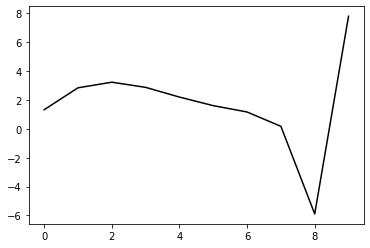

191400 14.573661712874497
0.32054669977152833 -0.15964845861440255 -0.2496418998912434 -0.13244549607952552
[ 1.35389038  2.82069162  3.21434217  2.86199071  2.19191237  1.60161632
  1.16597748  0.17595458 -5.88377355  7.80462115]


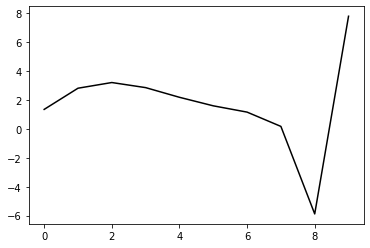

192500 22.027206429685297
0.3199418275298397 -0.1608723245950676 -0.2502008926707489 -0.1358111324077868
[ 1.34820051  2.91024799  3.31848873  2.97721849  2.31491767  1.7300792
  1.29835104  0.3106329  -5.74856182  7.84389082]


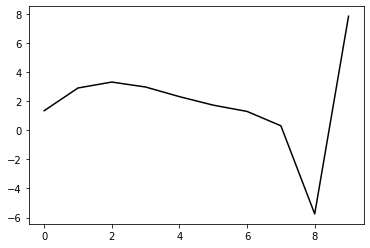

193600 24.51985051919162
0.3197982202361487 -0.1626324296583174 -0.25179935546387655 -0.134512139098815
[ 1.31659657  2.89780854  3.30189566  2.95744449  2.29275598  1.70633633
  1.2737087   0.28515279 -5.77377333  7.82061652]


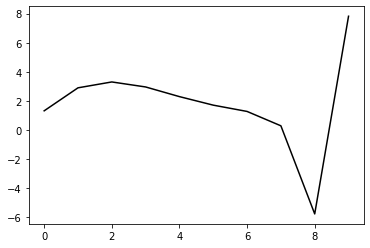

194700 13.883917187440606
0.3175437119735988 -0.1593474980871655 -0.24909781175717322 -0.13350622465983805
[ 1.37240696  2.79922586  3.19663677  2.84838469  2.18117418  1.5930272
  1.15909843  0.16893501 -5.89193834  7.81242171]


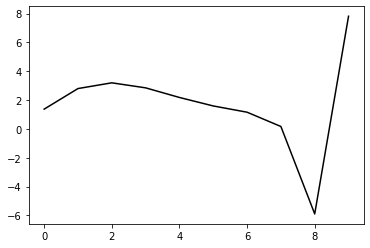

195800 22.75453073213725
0.3202588941741975 -0.15762753912438446 -0.24855913028825494 -0.13461673090985252
[ 1.32342625  2.88626519  3.28190642  2.93138029  2.26159271  1.67111656
  1.23538009  0.24350311 -5.81916766  7.79325415]


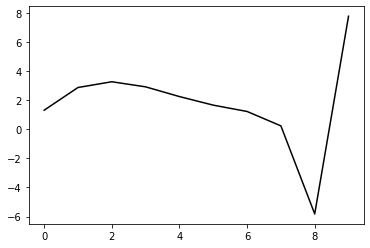

196900 27.683814003917224
0.32129767147845545 -0.16106844548434268 -0.2517399511064283 -0.13128885003738822
[ 1.2618476   2.83788137  3.22724098  2.87206358  2.19873378  1.6056836
  1.16820075  0.17474505 -5.88841393  7.83984891]


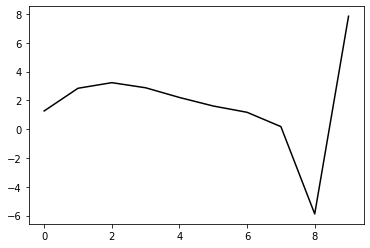

198000 16.986548954022727
0.32204321149572007 -0.16164992559286898 -0.251811897488123 -0.13185895681212328
[ 1.29514345  2.89373028  3.27013625  2.9023504   2.21684143  1.61253834
  1.16508259  0.16276449 -5.90866681  7.79046553]


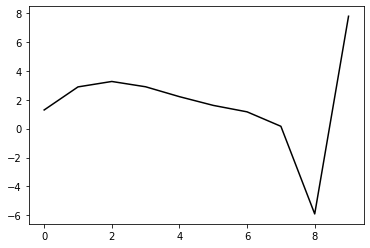

199100 25.964470976507254
0.31720795652901795 -0.15942499298662388 -0.2491798980364517 -0.13428430439559313
[ 1.40447446  2.7089498   3.0956949   2.73851788  2.06333784  1.46900529
  1.03112749  0.03739974 -6.02668683  7.81572387]


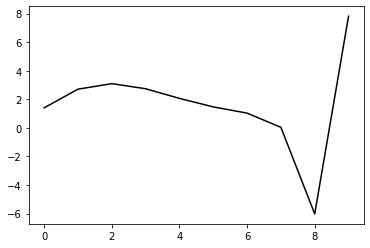

200200 27.64600808452979
0.3145453195850406 -0.15666997828678042 -0.2463748807644231 -0.13652928354325342
[ 1.36780801  2.75829644  3.13624509  2.7711112   2.08843567  1.48707193
  1.04257848  0.04226447 -6.02745606  7.77056257]


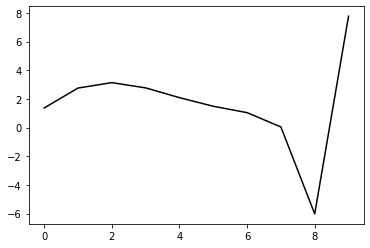

201300 24.20699911766997
0.317384983370596 -0.15807075680342317 -0.24826266602647779 -0.13488503142935637
[ 1.33827648  2.81869527  3.1948501   2.82735838  2.14192021  1.53777993
  1.09076675  0.08803299 -5.98284663  7.81134479]


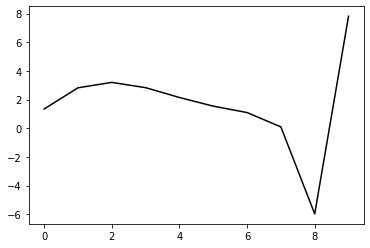

202400 15.274342913204615
0.31858787072962264 -0.15928987044320866 -0.24962548698387046 -0.13315791690586556
[ 1.32145551  2.82918639  3.20167921  2.83102168  2.14284459  1.53647101
  1.08780054  0.08362775 -5.98793335  7.77531842]


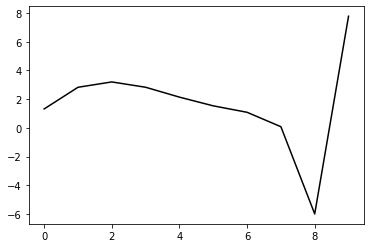

203500 22.18176574839081
0.32122541857264836 -0.15950599796566076 -0.25043188667458155 -0.13333111767194136
[ 1.30718191  2.88869226  3.26327843  2.89323507  2.20476531  1.59775627
  1.14846304  0.14348777 -5.92802677  7.81309551]


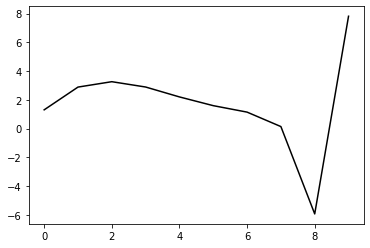

204600 24.146529630824716
0.323283192875393 -0.15691666642936442 -0.24927848853064333 -0.13495806487025813
[ 1.30156526  2.98385252  3.36612136  3.00062914  2.31522078  1.71040732
  1.26261983  0.25787852 -5.81543748  7.79062295]


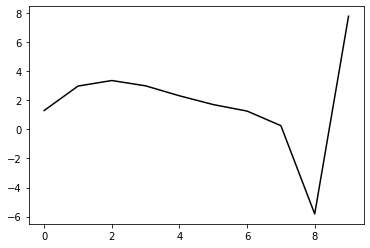

205700 14.69531627659937
0.3224270452896355 -0.15463066064684924 -0.24789726141984045 -0.13431635594618016
[ 1.36889961  2.88807946  3.27232079  2.90937035  2.22715027  1.62591502
  1.18186825  0.18021407 -5.89010536  7.78105549]


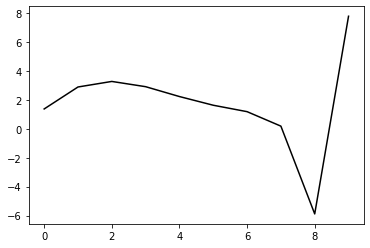

206800 21.91724456359636
0.3212887503693139 -0.15548147831116133 -0.24838076917423543 -0.13482635694057116
[ 1.33694622  2.90205086  3.29133747  2.93108406  2.25005534  1.649338
  1.20573921  0.20421586 -5.86557746  7.79074797]


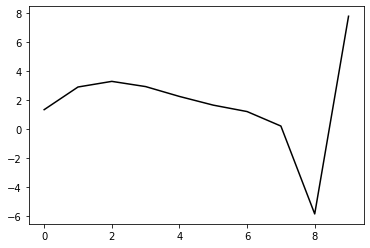

207900 13.337280712031486
0.31941132868835864 -0.15481282350870823 -0.2477270935818877 -0.13397524734897934
[ 1.34378672  2.8947113   3.28414974  2.92352198  2.2416807   1.63987982
  1.19506053  0.19165526 -5.88053208  7.81090511]


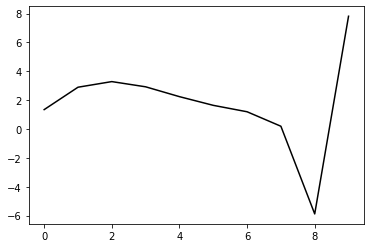

209000 16.36648984866661
0.3219298920256417 -0.1586691232517963 -0.25182151720287244 -0.1320015271782419
[ 1.29796961  2.93202757  3.33730092  2.99076976  2.32125785  1.73018328
  1.29438582  0.29731581 -5.77270087  7.82798805]


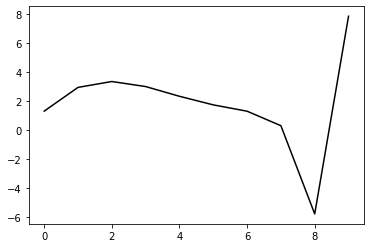

210100 29.32008082012383
0.32051967000183196 -0.16111720037961214 -0.25374804946791224 -0.12874226419734858
[ 1.27370049  2.84940938  3.2481682   2.89613074  2.22185186  1.62689207
  1.18809043  0.18805378 -5.88494412  7.82717196]


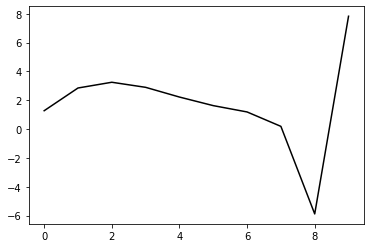

211200 23.996075631624922
0.3211985682548156 -0.15841728701296168 -0.25204186729309885 -0.12407669471263393
[ 1.29062594  2.78866208  3.15455899  2.77447104  2.07604869  1.46021815
  1.00341304 -0.01228459 -6.09929687  7.76199085]


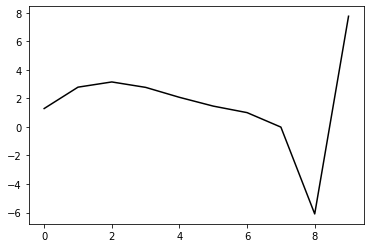

212300 24.733702282638674
0.31585546152607796 -0.15749030893672203 -0.24900227715181072 -0.13282251579407436
[ 1.35457397  2.78531746  3.16737057  2.79928547  2.10968345  1.50111404
  1.05127277  0.04268617 -6.03494265  7.7998288 ]


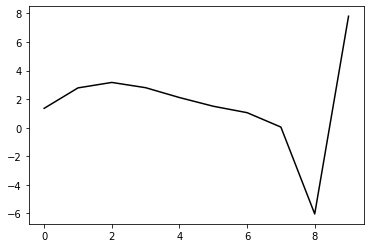

213400 18.49447083006145
0.3137229575969057 -0.1632276704620435 -0.25270011048836294 -0.13082562630385133
[ 1.33264902  2.76011019  3.14166505  2.77258668  2.08136022  1.47117523
  1.02025438  0.01102706 -6.06611362  7.7715971 ]


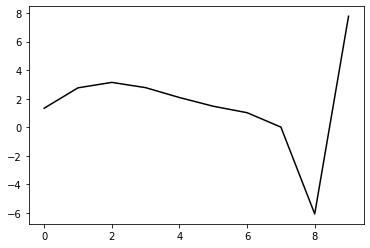

214500 21.848402863553865
0.32046698181838795 -0.1588906395484969 -0.2510623756865247 -0.13097194137792692
[ 1.30904304  2.8957854   3.26553674  2.88437611  2.18127676  1.55969254
  1.09800413  0.07842917 -6.00772678  7.7994884 ]


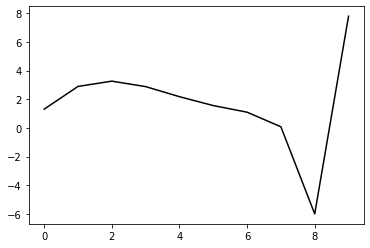

215600 24.519989434234574
0.32203824977836115 -0.15882092302022907 -0.2514118915186173 -0.1318762795733225
[ 1.32074219  2.9309567   3.30831895  2.93226974  2.23259871  1.61354361
  1.15401134  0.13608355 -5.9483137   7.79506931]


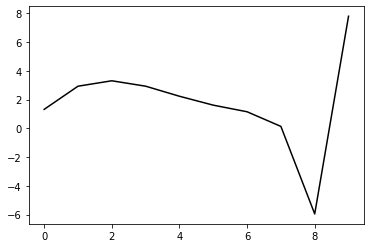

216700 13.680266281552786
0.32339105214381375 -0.15381417182653143 -0.24826931327355437 -0.1336018032862156
[ 1.36467792  2.946195    3.32762938  2.9532999   2.25458345  1.63618509
  1.17723851  0.15929405 -5.92609289  7.79281456]


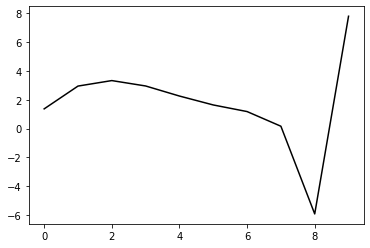

217800 34.637428554171784
0.31876995227466765 -0.15190793725626914 -0.24518646463111177 -0.13854735762110612
[ 1.35755918  2.97919477  3.3621228   2.98485719  2.2812217   1.65765583
  1.19474418  0.17432742 -5.9104687   7.7955612 ]


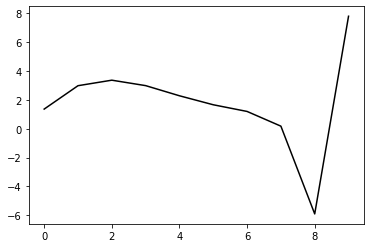

218900 15.634644109106228
0.3203720148472763 -0.1580015327440864 -0.25015926461865745 -0.13496886478981343
[ 1.27833823  2.94543176  3.31531628  2.92732384  2.21570344  1.58658865
  1.12027655  0.09789807 -5.98621062  7.81822757]


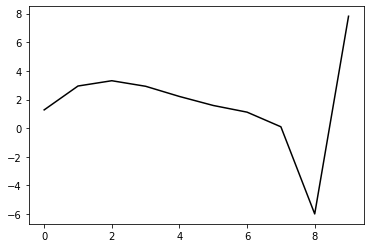

220000 15.324910319482989
0.32237595517193596 -0.15658107382169828 -0.24970224807765312 -0.1351944154594381
[ 1.29460083  3.00917382  3.37996952  2.99095569  2.27761262  1.64658806
  1.17843804  0.15392474 -5.93241745  7.80866309]


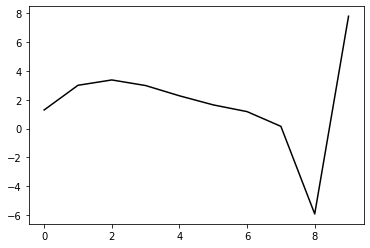

221100 21.09709489286333
0.3207236234826959 -0.15893937630689903 -0.25153267927841333 -0.13393161929219805
[ 1.32259394  2.91213066  3.30309899  2.92987528  2.22943863  1.60933343
  1.15062275  0.13363936 -5.94682709  7.7928104 ]


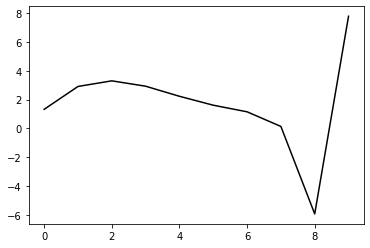

222200 22.745803649011975
0.3188871770942181 -0.15763299386348234 -0.25061260683088543 -0.13344755525061938
[ 1.36420827  2.8671504   3.2636643   2.89446394  2.19744891  1.58058211
  1.12492841  0.10994743 -5.96999845  7.75986205]


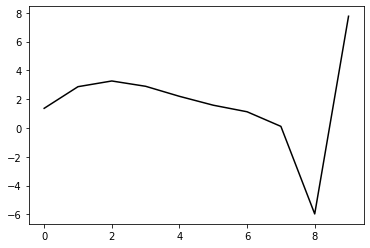

223300 23.48918079763575
0.31642872657371257 -0.15775650098453553 -0.25037776379251453 -0.13271502381803932
[ 1.33981764  2.83070051  3.22269702  2.84882726  2.14711086  1.52601934
  1.06698245  0.04901111 -6.03328283  7.77509423]


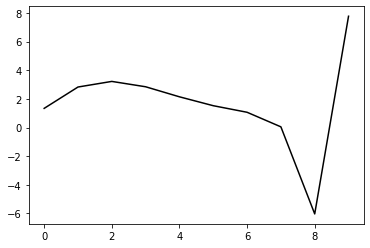

224400 17.248066158836856
0.31593510620512927 -0.15795207456206842 -0.25059850811866247 -0.13290635898201014
[ 1.30470942  2.84460605  3.23410433  2.8572623   2.15223496  1.52803643
  1.06645122  0.04602777 -6.03833554  7.80779058]


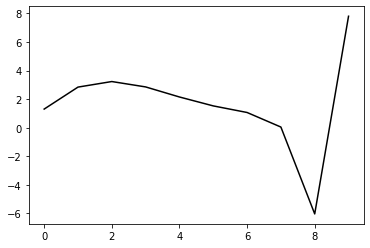

225500 22.72421696643603
0.31847520223931763 -0.15661996235623657 -0.25077065426092027 -0.13371419624349498
[ 1.31620062  2.95629401  3.36605924  3.00475092  2.31156397  1.69659284
  1.24209341  0.22617471 -5.8558594   7.85382616]


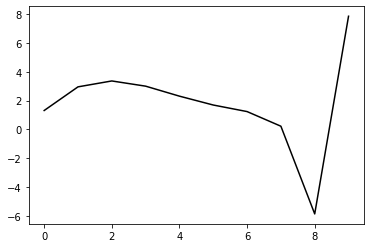

226600 25.306095296461635
0.31780568342121085 -0.1605414893649882 -0.2537402145939961 -0.13065113390234648
[ 1.31405426  2.8606236   3.25915352  2.88831318  2.18733292  1.56639758
  1.10774463  0.08869101 -5.99562689  7.8022263 ]


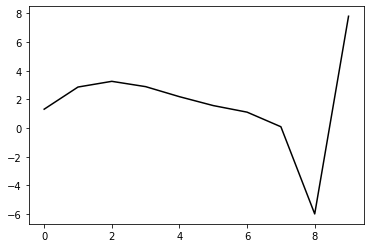

227700 14.104379519901117
0.31864618730231237 -0.15534476775906622 -0.25023930621934676 -0.13320960738064455
[ 1.3798804   2.90190932  3.31158525  2.95022947  2.25668904  1.64171301
  1.18792684  0.1722294  -5.90905429  7.81252962]


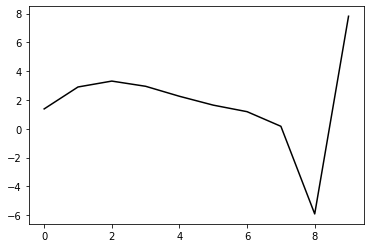

228800 32.5615723961154
0.3136784084722237 -0.1537754930101 -0.24754443535281304 -0.13660340133713533
[ 1.39024381  2.87330576  3.27877811  2.91290631  2.2146476   1.59543607
  1.13850339  0.12051938 -5.9606999   7.75478509]


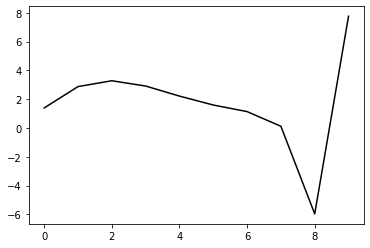

229900 24.27747379272761
0.3220029714481841 -0.15801115345097735 -0.25288855451740844 -0.1309434368813417
[ 1.27719604  2.94288236  3.33217158  2.95120476  2.23916305  1.60776432
  1.14037011  0.1132207  -5.97529782  7.8216522 ]


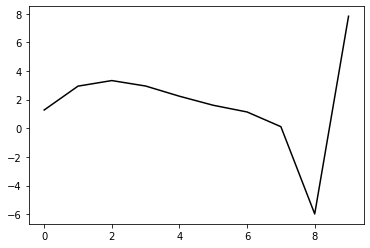

231000 17.506708135208783
0.3227951019288381 -0.16183089324929947 -0.25581412571126855 -0.12965551321572424
[ 1.31201089  2.92387105  3.32209483  2.94833575  2.24161413  1.61440121
  1.15063373  0.12647146 -5.95864457  7.77536207]


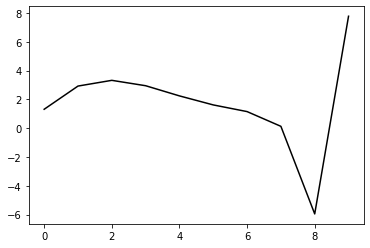

232100 21.402128503624827
0.3229893445394163 -0.15654832024945167 -0.2522164931227558 -0.13187430608461986
[ 1.33952829  2.92339644  3.31890541  2.94273997  2.23421546  1.60574502
  1.14100587  0.11531178 -5.97251787  7.83553066]


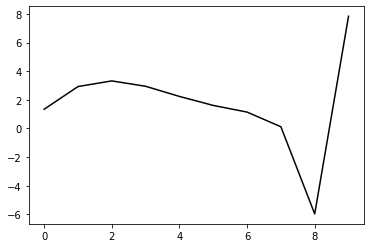

233200 23.188800477741022
0.31526326224526063 -0.15739954636481693 -0.2508785800604878 -0.13265874936867258
[ 1.3689986   2.77414149  3.16915304  2.79513622  2.08983988  1.46521331
  1.0047734  -0.01683862 -6.10132107  7.76614102]


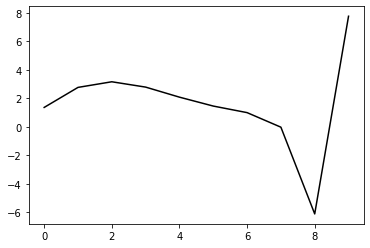

234300 24.88558002393681
0.31164804748955177 -0.1577806669270699 -0.25014135662060333 -0.1341509195697431
[ 1.34831211  2.74269902  3.1374736   2.76288524  2.05610201  1.42972024
  0.96783306 -0.05496492 -6.13926576  7.78515197]


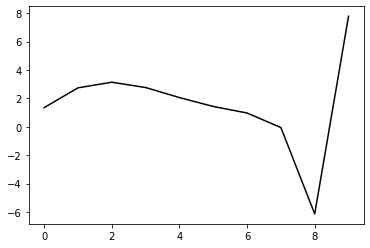

235400 14.710412354284593
0.3179756617315444 -0.15577526993403443 -0.25005405349042636 -0.1334012761757761
[ 1.33276688  2.90018279  3.28787683  2.90484451  2.18887622  1.55321407
  1.08238416  0.05098442 -6.03919705  7.78000479]


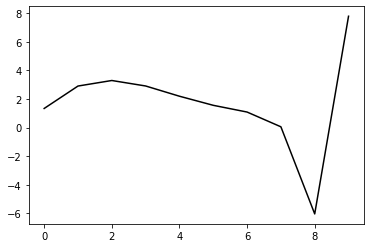

236500 21.93518139707363
0.32131410011911143 -0.15695682883716625 -0.2518485415896415 -0.1327459699523204
[ 1.31739723  2.94874754  3.33737839  2.95424392  2.23766255  1.60132584
  1.13005252  0.09816606 -5.99195595  7.8001365 ]


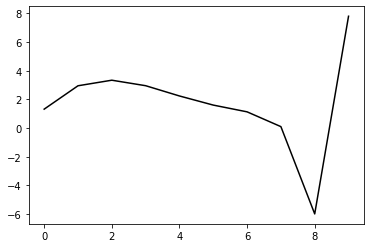

237600 24.506936630015655
0.32483920950762374 -0.15342522627780186 -0.2501976402035809 -0.13399401223900886
[ 1.29199065  3.05700028  3.44975882  3.06746055  2.35038335  1.71298993
  1.24047625  0.20671243 -5.88691638  7.83083693]


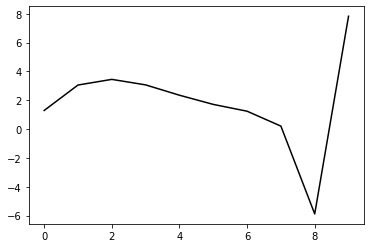

238700 14.106535333748338
0.3213461077823845 -0.1556555464554543 -0.25129006666087617 -0.13511552497166607
[ 1.36381588  2.97057795  3.38568555  3.02151211  2.31913831  1.69418282
  1.23261758  0.2080008  -5.8775526   7.79996752]


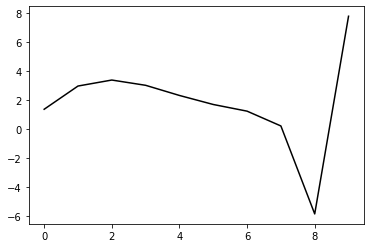

239800 21.963689917340716
0.3182993414976289 -0.15354718039602452 -0.2494165729784119 -0.13446610085662378
[ 1.34418051  2.94326159  3.34732661  2.97320752  2.26219219  1.62989013
  1.16217672  0.13188192 -5.95910488  7.79642128]


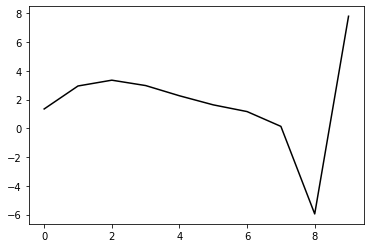

240900 23.302925693869348
0.32156048156123057 -0.15770493109374348 -0.2531455504479223 -0.1313752306648116
[ 1.27789012  2.93603222  3.33172628  2.9501921   2.23266007  1.59506504
  1.12361843  0.09080923 -5.99956318  7.80368781]


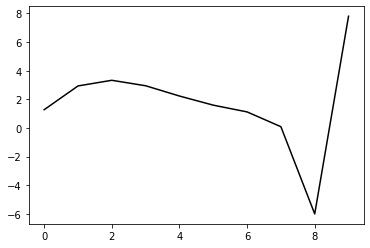

242000 18.02447779550288
0.32314253402118864 -0.160834522036947 -0.25532975137732294 -0.12993706332774968
[ 1.2997646   2.94616494  3.3311037   2.94005166  2.21374374  1.56837949
  1.09052147  0.05258379 -6.04037835  7.77344254]


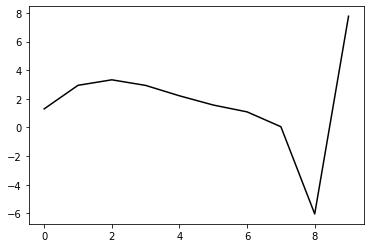

243100 22.628014076320973
0.3211987537940147 -0.15806875540765536 -0.2526240861732316 -0.1333775210072349
[ 1.36873318  2.8943888   3.28766786  2.90325072  2.18214141  1.5411431
  1.06724079  0.0326608  -6.05671807  7.83746816]


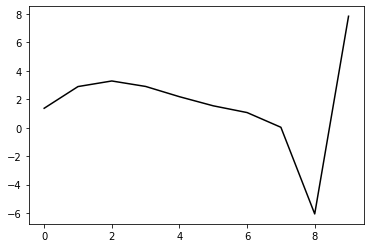

244200 22.84360863808852
0.3242379566174553 -0.15158545003811597 -0.24890447172459051 -0.1345404946381898
[ 1.34038761  2.98379142  3.36899029  2.97682504  2.24912856  1.60250609
  1.12359916  0.08375105 -6.01235408  7.80653391]


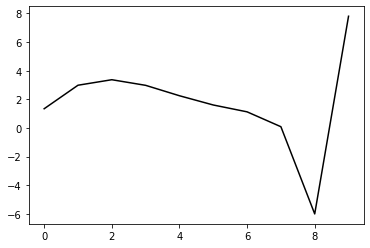

245300 22.154467080826727
0.3247817810835661 -0.15096749012432403 -0.24879725917603793 -0.13363919099148858
[ 1.31711297  3.02763866  3.41176068  3.01665175  2.28601662  1.63701086
  1.15655559  0.11540094 -5.98176542  7.77712177]


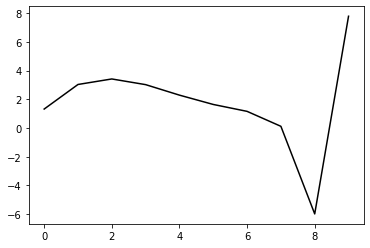

246400 14.511417245028062
0.318792228592295 -0.1603382910510235 -0.25381976089735064 -0.13423446698831443
[ 1.35051071  2.94496661  3.34759356  2.96806473  2.25084724  1.61425569
  1.14614787  0.11736694 -5.96470554  7.81498125]


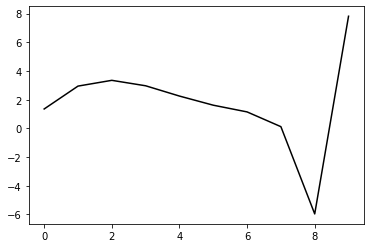

247500 21.893103141640733
0.32113490208230794 -0.15558604733218154 -0.2511936590544456 -0.13422928868209683
[ 1.3163973   2.99162487  3.38172866  2.99013062  2.262304    1.61645731
  1.14003056  0.10285866 -5.98854087  7.8384061 ]


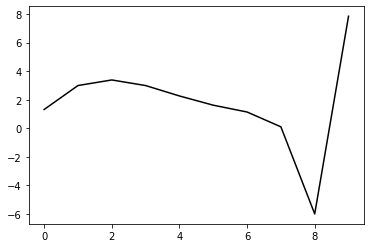

248600 28.54042462881141
0.3263548284052751 -0.15313998158733247 -0.2509016497248065 -0.1342242416549325
[ 1.25946331  3.12872061  3.52656246  3.13870465  2.41239075  1.76674693
  1.28972626  0.25074742 -5.84487751  7.82369465]


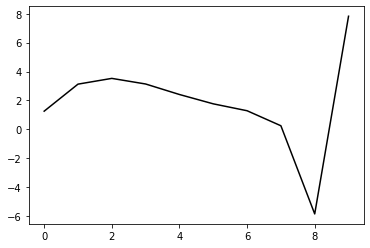

249700 13.720312669926685
0.3199048831629355 -0.15525995084363178 -0.250676076483247 -0.1357469767744823
[ 1.36498247  2.96704658  3.36978442  2.98634239  2.26416055  1.62287058
  1.15098356  0.11773003 -5.96955312  7.79820654]


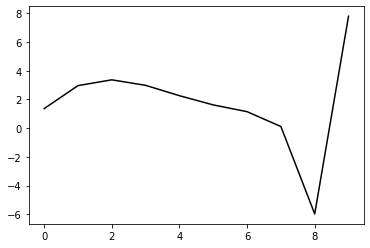

250800 22.159079032107098
0.31918204496739905 -0.15349582036978268 -0.24951063582304206 -0.1360607572322451
[ 1.32641346  3.00142325  3.40333456  3.01726195  2.29159625  1.64650854
  1.17084667  0.13341544 -5.95808978  7.77508299]


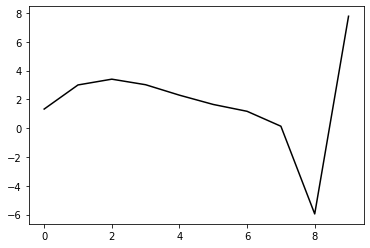

251900 14.50121618842622
0.31840240707661815 -0.1544776790609818 -0.24969696582321568 -0.13620498471390216
[ 1.28074284  2.94428269  3.33172197  2.93366502  2.19833164  1.54577235
  1.06496494  0.02423638 -6.06729934  7.8303964 ]


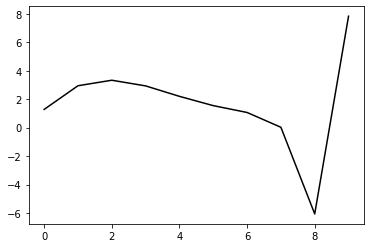

253000 17.915835269565168
0.3208708294437915 -0.15893421055629323 -0.2536436963919141 -0.1337899176563886
[ 1.28007829  3.00427133  3.39817581  3.00391894  2.27055418  1.61900102
  1.13877729  0.09812405 -5.99291143  7.77469969]


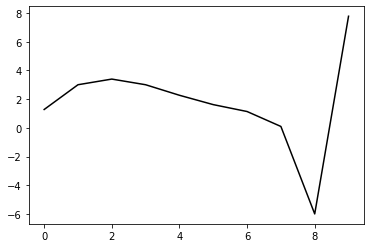

254100 22.35381832587609
0.31772142468947673 -0.15891083868097833 -0.25283983096773965 -0.13486039666312072
[ 1.33856360e+00  2.86055818e+00  3.26436357e+00  2.87975999e+00
  2.15525662e+00  1.51200984e+00  1.03970338e+00  6.07545779e-03
 -6.07823869e+00  7.81228746e+00]


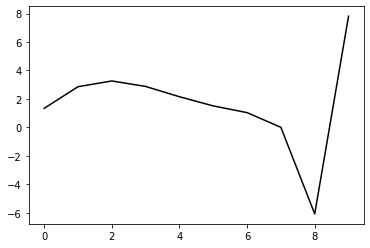

255200 23.51356581567422
0.3142193744277117 -0.15715546058311844 -0.2507192413843245 -0.1368619352678783
[ 1.3503971   2.79558311  3.20958152  2.8339896   2.11647778  1.47879321
  1.01104351 -0.01930756 -6.1011475   7.74968138]


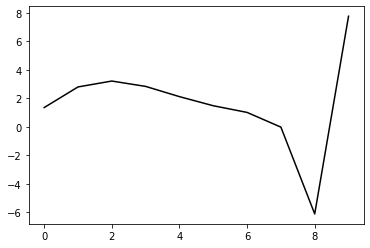

256300 24.857528263758937
0.3133495929708751 -0.15644741592877032 -0.2501414062493083 -0.13731150609498624
[ 1.34946158  2.79127681  3.21726435  2.85063118  2.13911114  1.50570519
  1.04127893  0.01322148 -6.06629425  7.79964901]


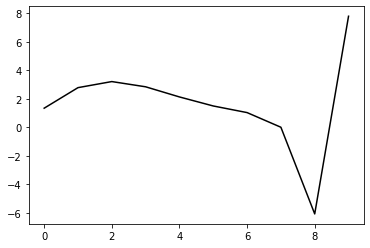

257400 15.875813599214856
0.3121357231492804 -0.15991145854088157 -0.25251456844971554 -0.13593344940043067
[ 1.31877669e+00  2.77151452e+00  3.20111982e+00  2.83755263e+00
  2.12755762e+00  1.49486548e+00  1.03086234e+00  2.81274347e-03
 -6.07627412e+00  7.76513895e+00]


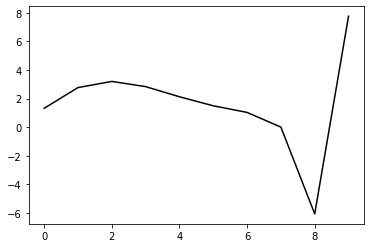

258500 22.137303240528478
0.3172982779963506 -0.15812301359894693 -0.2528465369926461 -0.13502353379995807
[ 1.29803735  2.86459746  3.29258497  2.92730075  2.21507686  1.57990726
  1.11317819  0.0816478  -6.00126392  7.80502519]


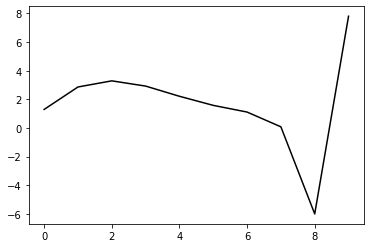

259600 25.252516826148682
0.31629385691144746 -0.16101997984367775 -0.25508801925052366 -0.1335574183622054
[ 1.30878602  2.81946976  3.25780426  2.90205372  2.19732669  1.56821291
  1.10648563  0.07864091 -6.00112374  7.78630827]


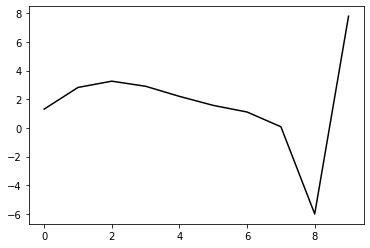

260700 13.314355813221422
0.31637816481018555 -0.15687155212923817 -0.252129011308216 -0.13617945475339746
[ 1.34842921  2.83334853  3.28053202  2.93241396  2.23337268  1.60870196
  1.15058991  0.12525046 -5.95274472  7.81038747]


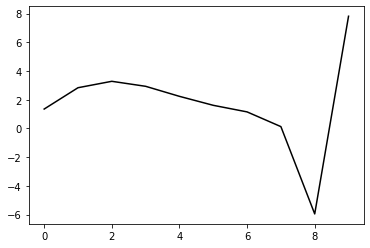

261800 27.20137893717957
0.31498632435255747 -0.1543723448685371 -0.24993771706742893 -0.1391041779100833
[ 1.36667897  2.88591162  3.33953524  2.99667972  2.30095726  1.67852973
  1.22209492  0.1976304  -5.88001885  7.80544032]


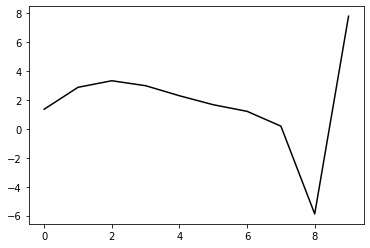

262900 18.086089179566937
0.31735254975178645 -0.15803127756306243 -0.2532467727362727 -0.1357066078450529
[ 1.2687008   2.82347635  3.26200784  2.9090758   2.20501695  1.57557329
  1.11339999  0.08410639 -5.99594209  7.82179118]


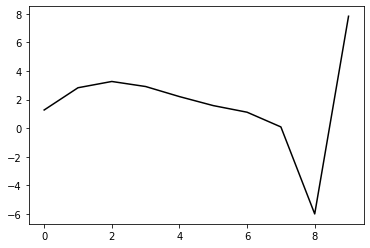

264000 17.82033614268233
0.32042335281919526 -0.1604624714132393 -0.2558033211662864 -0.13350089067781284
[ 1.28337445  2.85965505  3.29892083  2.94678398  2.24266625  1.61278602
  1.15014011  0.12017522 -5.95959241  7.76563387]


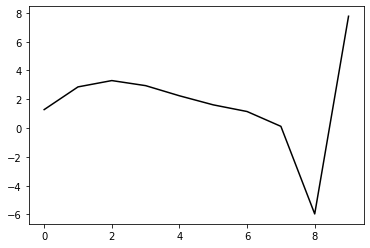

265100 21.61058336382256
0.3189041578425033 -0.15776956383392618 -0.2535039129371137 -0.135624045121668
[ 1.32356349  2.80669609  3.25135917  2.90473026  2.20530856  1.57957454
  1.12065628  0.09353445 -5.98424924  7.82489135]


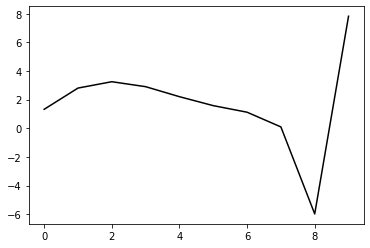

266200 22.783872421046294
0.32031644061940723 -0.15665517617318048 -0.25331609164833513 -0.13443039574571375
[ 1.28499681  2.83643147  3.27074839  2.91550153  2.20868151  1.57672609
  1.11261966  0.08058789 -6.00234286  7.77156513]


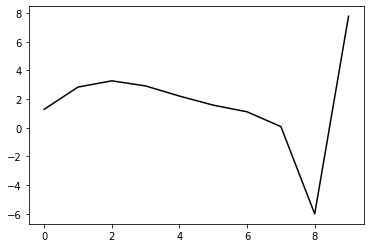

267300 23.15471453390807
0.31534780792372413 -0.15639140885625402 -0.25220156223100093 -0.13735520717900873
[ 1.34219415  2.81848691  3.27278237  2.93596348  2.24519691  1.6275657
  1.17642637  0.15539563 -5.91828444  7.82490782]


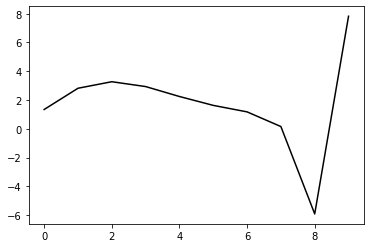

268400 14.734474265087817
0.3171668653117968 -0.15506162436940538 -0.2519194942134081 -0.13638627140718015
[ 1.35820707  2.85015997  3.30790326  2.97324205  2.28278451  1.6643866
  1.21207454  0.18919064 -5.88650398  7.78974985]


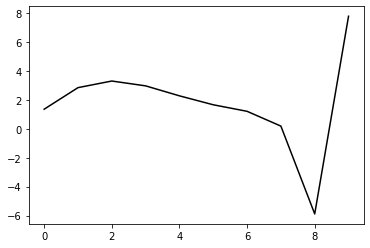

269500 21.9553148145977
0.31649207799863216 -0.15603422337982759 -0.25266813273015054 -0.13674219898138604
[ 1.32606286  2.85081424  3.31209482  2.98132527  2.29401268  1.67838561
  1.22873189  0.20771397 -5.86729578  7.80543304]


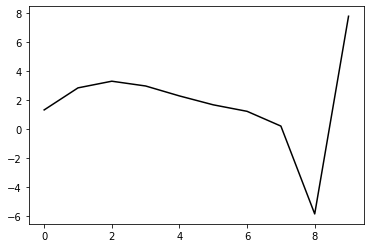

270600 24.82529034071807
0.31663385020384865 -0.1581258352861041 -0.2544462969499824 -0.13422689309318342
[ 1.31093573  2.83680231  3.28643999  2.94537334  2.24805364  1.62319467
  1.16560094  0.13765201 -5.9424301   7.75084199]


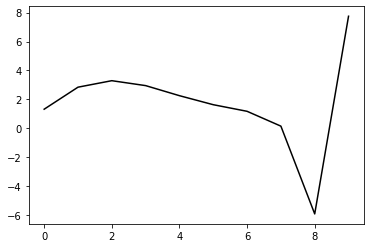

271700 13.045646958349831
0.3191688523565071 -0.15045036735597123 -0.24992770644043502 -0.13538424980989308
[ 1.34094554  2.89278715  3.33832457  2.99265272  2.29032539  1.66026882
  1.19724864  0.1628007  -5.92560621  7.80337438]


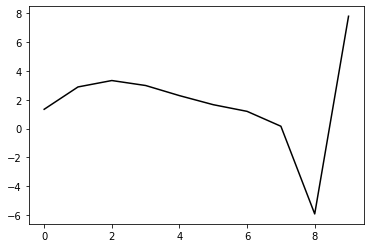

272800 22.159588171065213
0.3137806885756351 -0.15314373522908822 -0.250388375585352 -0.1373155548565367
[ 1.3237005   2.85092754  3.29663807  2.95154569  2.24899946  1.6185904
  1.1559499   0.12241876 -5.96434463  7.76967605]


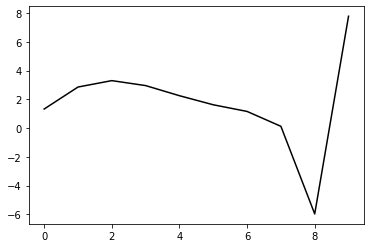

273900 27.876867498423554
0.3163704831159272 -0.15732889428708116 -0.25466717525808363 -0.13309985074965489
[ 1.25421981  2.80440829  3.24567826  2.89868571  2.19569589  1.56592559
  1.10460648  0.07185789 -6.01464563  7.84084652]


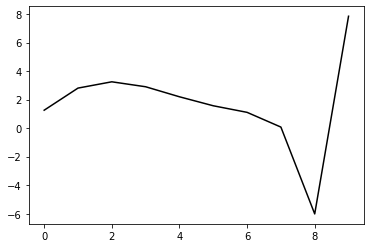

275000 18.653541099031024
0.31872828229760636 -0.16023770669744777 -0.25717006500295697 -0.1318053014407492
[ 1.28450688  2.81546631  3.25717057  2.91176051  2.20993528  1.58110538
  1.12084402  0.08911876 -5.99519156  7.77217729]


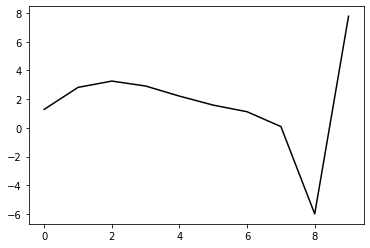

276100 22.931554350828247
0.3142599829969996 -0.15657198967558217 -0.2532688160279438 -0.13591368402141696
[ 1.35739197  2.75435162  3.19881213  2.8569344   2.15795802  1.53133447
  1.07273952  0.04181724 -6.0417889   7.8203174 ]


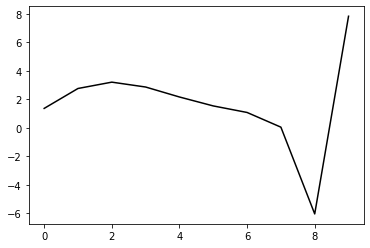

277200 22.233530622169905
0.3143549404947977 -0.1559478057635651 -0.2530992737596626 -0.13616405560544104
[ 1.33000866  2.75648316  3.20427619  2.86616712  2.17037669  1.54655786
  1.09051861  0.06141389 -6.0213171   7.76107063]


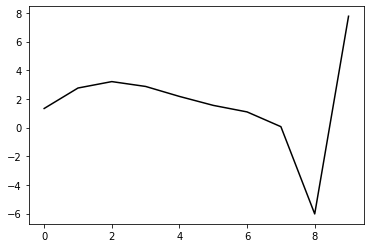

278300 21.182119746958318
0.31870470517740135 -0.1532759260737693 -0.2526843884554955 -0.13380556380694764
[ 1.30486976  2.83574677  3.27323877  2.92564855  2.22132273  1.5899785
  1.12736526  0.09195678 -5.99716578  7.81189533]


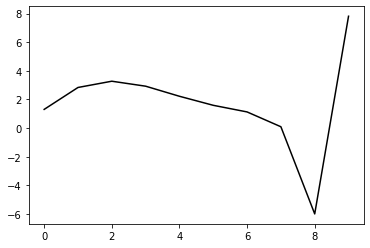

279400 17.934210297291543
0.3134875885024523 -0.15599809533460077 -0.2531863364711961 -0.1376078865668601
[ 1.38347041  2.79825515  3.26028723  2.93476538  2.24902864  1.63400088
  1.18649872  0.16489418 -5.91057195  7.79310442]


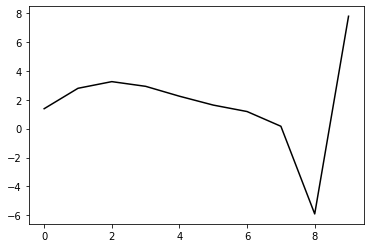

280500 21.444271394664657
0.3138244146710142 -0.15830897595012927 -0.25511043345393397 -0.13442031414394454
[ 1.30180599  2.77439874  3.21559861  2.87485907  2.17688532  1.55175477
  1.09579647  0.06645484 -6.01614836  7.79216784]


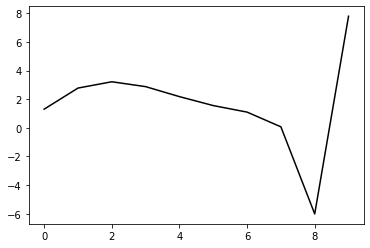

281600 25.746652469925685
0.31511299313404717 -0.16037864412757566 -0.2568239639362781 -0.13302434950657013
[ 1.307771    2.79576669  3.2310146   2.88554905  2.18286584  1.5532187
  1.0932095   0.06010122 -6.02461822  7.77587558]


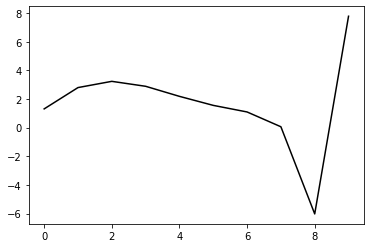

282700 13.257121228864696
0.3170566289544686 -0.15368668639948582 -0.2521250298063775 -0.1375531003610654
[ 1.34513951  2.86699363  3.30202677  2.95565593  2.25132273  1.61981722
  1.15820409  0.1236651  -5.96154695  7.80312885]


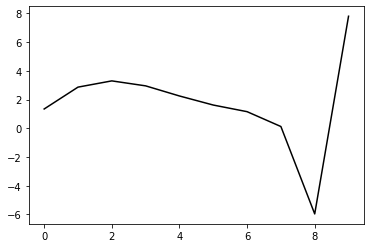

283800 23.635931076803907
0.31754119407681436 -0.1532923110735569 -0.25196372956142116 -0.13792585917532557
[ 1.30164344  2.87884809  3.3084432   2.95778985  2.24975251  1.61527092
  1.15162638  0.11560472 -5.97036498  7.78819629]


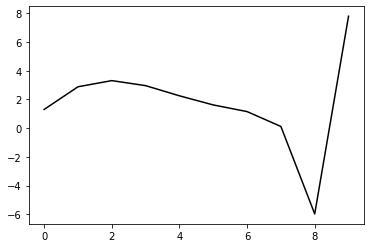

284900 13.7177670184853
0.31896136284592935 -0.15226955909049145 -0.25186347706944495 -0.1376823354441035
[ 1.29982684  2.93461801  3.36854814  3.01988204  2.31236479  1.67751268
  1.21294948  0.17498096 -5.9145147   7.81001783]


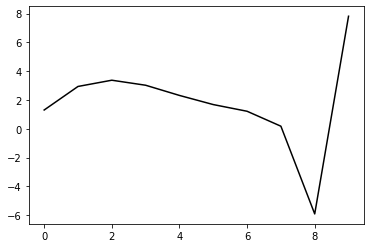

286000 15.456145520918998
0.31923372023763824 -0.1522962452317479 -0.2523522097975873 -0.13567848724795895
[ 1.28064954  2.92887364  3.3555547   3.00069097  2.28762194  1.6476795
  1.17834349  0.13522662 -5.95991117  7.82377752]


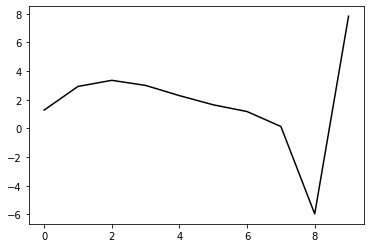

287100 21.258631212355077
0.3189778905083514 -0.15448443184462138 -0.25401184492987255 -0.13450906519970152
[ 1.32244515  2.84908439  3.28141038  2.93173261  2.22313625  1.58742553
  1.12254031  0.08370203 -6.00659472  7.8237386 ]


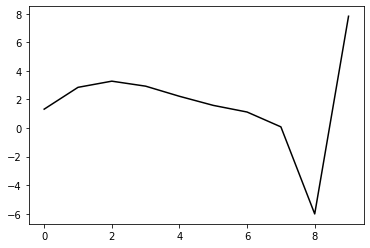

288200 22.328388218925912
0.31885880356198787 -0.15274180739532447 -0.25296665715234984 -0.13425777111557713
[ 1.30068685  2.86248141  3.28876082  2.9329931   2.21830398  1.57672077
  1.10645979  0.06228332 -6.03355873  7.77069081]


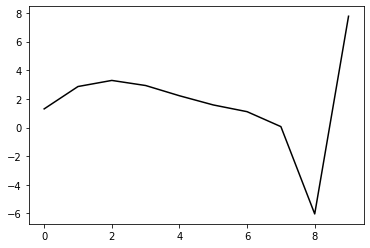

289300 20.795495691775873
0.3174581320575363 -0.1568767863875622 -0.2557196448202235 -0.13329416113178488
[ 1.31145449  2.8445303   3.28427296  2.93978063  2.23401541  1.59992544
  1.13669515  0.09903063 -5.98958868  7.82883595]


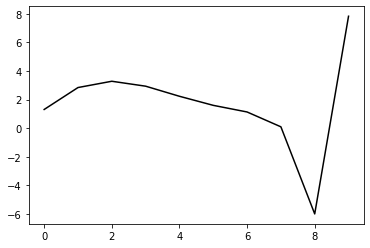

290400 17.640656113497574
0.3135169565671979 -0.15861669908751003 -0.2563543327377965 -0.13213946887940967
[ 1.32688793  2.8185105   3.25973602  2.91603782  2.21013282  1.57538567
  1.11135119  0.07235969 -6.01734192  7.77928366]


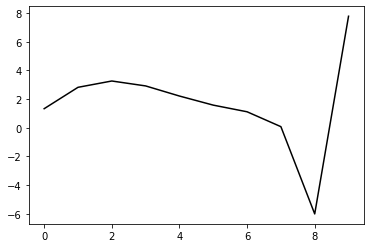

291500 20.87014145039227
0.30990861336882913 -0.16287137505117105 -0.2580463856191357 -0.1312776712502887
[ 1.32661282  2.73892143  3.1665855   2.81300254  2.09921344  1.45828469
  0.98975055 -0.05250982 -6.14469435  7.7807835 ]


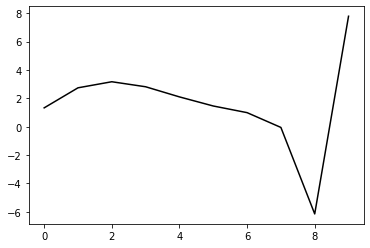

292600 24.151092568205122
0.3198826167528416 -0.15264377212703706 -0.25285473531829783 -0.13659351713015555
[ 1.31064336  3.02062099  3.44523939  3.08581228  2.36497117  1.71656767
  1.2405755   0.19067903 -5.91023274  7.78498643]


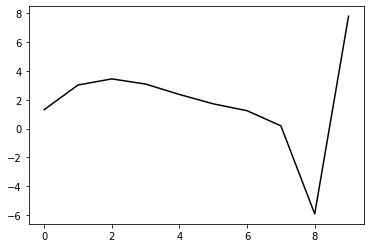

293700 13.521698838490726
0.3155214852497143 -0.15435247282412295 -0.2533184070901617 -0.1351443298442312
[ 1.36927829  2.84340064  3.28138804  2.934737    2.22501094  1.58627561
  1.11888869  0.07632258 -6.01692722  7.79756572]


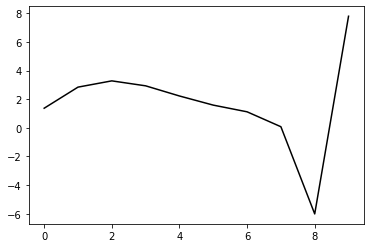

294800 25.41232465839622
0.3136776053437493 -0.15203261090962014 -0.25103269110475246 -0.1386239687692382
[ 1.36345067  2.9253007   3.36055451  3.01111598  2.29810159  1.65591332
  1.18525242  0.13938156 -5.9565814   7.78417255]


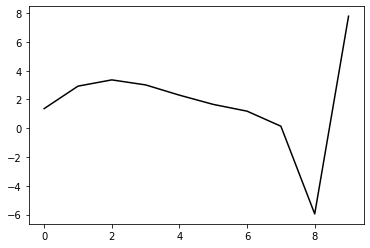

295900 15.815898177716846
0.3172769257989574 -0.15521836133958786 -0.2544085212023031 -0.13584165439944115
[ 1.28437337  2.89728427  3.3248774   2.97040356  2.25363538  1.60859879
  1.13592828  0.08843738 -6.00775452  7.81886511]


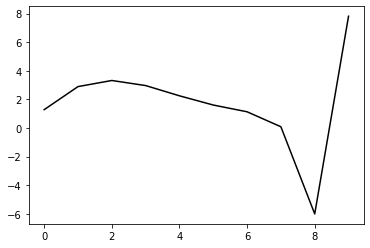

297000 17.78794152506733
0.3200697190260033 -0.15831663693252326 -0.25744796265403797 -0.13239115401623097
[ 1.29425966  2.91718456  3.343003    2.98679166  2.26803633  1.62101831
  1.14666411  0.09759521 -5.99891754  7.76358056]


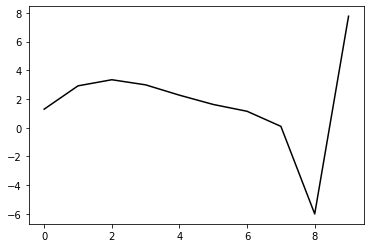

298100 21.56463555401539
0.3186025774667459 -0.1556443370217759 -0.25516474594728455 -0.13475157214239059
[ 1.33270289  2.86970878  3.3020083   2.95168597  2.23802992  1.59549643
  1.12517227  0.07921137 -6.01519383  7.82278179]


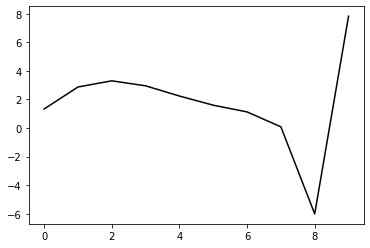

299200 22.38946532970323
0.32135929889501685 -0.15208888329647494 -0.25363095522942747 -0.13326582367855017
[ 1.28763669  2.91177037  3.32961817  2.96632129  2.24147075  1.58913694
  1.11008799  0.05563534 -6.04786682  7.77360493]


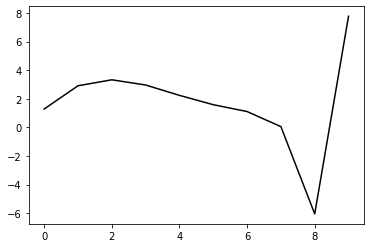

300300 20.212048021908245
0.3167249218544878 -0.15900542102745346 -0.2577253611055279 -0.13440453718276568
[ 1.34130204  2.86160056  3.31312483  2.97951856  2.2796333   1.64862055
  1.18835424  0.15010861 -5.93872732  7.8238783 ]


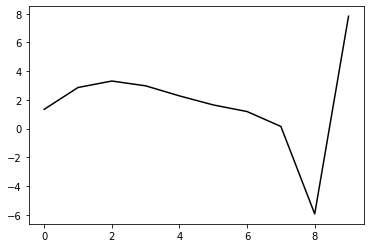

301400 14.686541629806966
0.31475190699798533 -0.1544994059322202 -0.25418933319322373 -0.13443363799323554
[ 1.33776214  2.84694844  3.28416876  2.93764839  2.22611239  1.58481788
  1.11574206  0.06949008 -6.02690623  7.79958116]


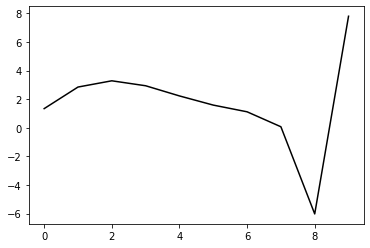

302500 21.942475848927117
0.31625261013593303 -0.15366932430243013 -0.254090404892418 -0.13667392228746952
[ 1.34625315  2.94631418  3.40466432  3.07436764  2.37469988  1.74228576
  1.28011499  0.23871291 -5.85468568  7.79756507]


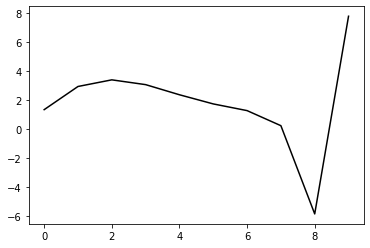

303600 25.42999658177121
0.31889943958665207 -0.15310945673434764 -0.25483126669655404 -0.1343265824698055
[ 1.29168996  2.98388209  3.43463933  3.09735081  2.39163879  1.75408211
  1.28750467  0.24156606 -5.85709508  7.84895265]


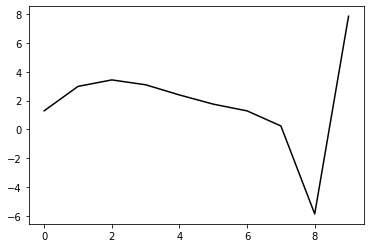

304700 14.514590704072011
0.3165163878887572 -0.15582109290697832 -0.2554332603275085 -0.1358466096559254
[ 1.34447531  2.90802401  3.35652948  3.01883576  2.31333297  1.67683729
  1.21271127  0.1706488  -5.92016011  7.79776598]


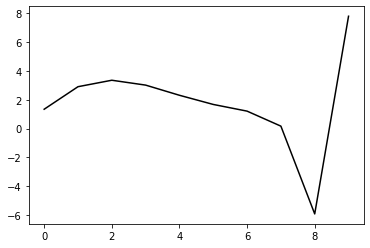

305800 23.18882694182257
0.316413882705744 -0.15196016968229895 -0.25287491713028293 -0.1356853223157779
[ 1.32713494  2.9046964   3.34453345  3.00063435  2.29051527  1.6505113
  1.18372907  0.13912388 -5.95448858  7.80180057]


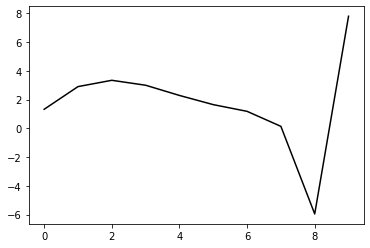

306900 14.951469238965505
0.31644695106864384 -0.15554169908193807 -0.25576038371964205 -0.13312446906661005
[ 1.35112363  2.78969875  3.2258447   2.88008421  2.16945892  1.53018802
  1.06542831  0.02343029 -6.06716514  7.7999909 ]


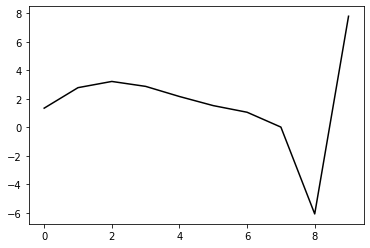

308000 17.8848856383615
0.317819886469535 -0.15722411129480865 -0.2577594906845342 -0.13061816337795065
[ 1.3280732   2.77869225  3.22061817  2.88055598  2.17472299  1.53939014
  1.07796396  0.03829863 -6.05054313  7.7760323 ]


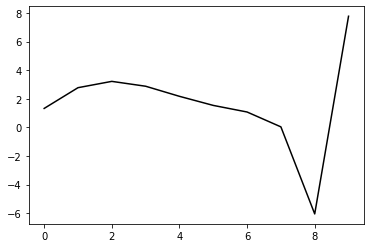

309100 22.4090634451271
0.31560304121866245 -0.15499680756699513 -0.2557021990695639 -0.1335234460395658
[ 1.35262902  2.78121824  3.23385539  2.90519917  2.21004395  1.58444832
  1.13177194  0.09928179 -5.98309441  7.81543298]


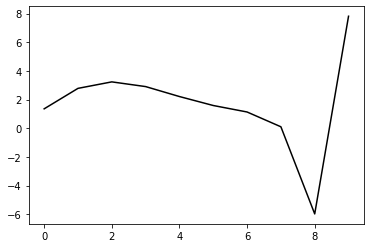

310200 23.700613970327105
0.3172715369100048 -0.15457922064011906 -0.2563807958056208 -0.131589861868058
[ 1.30035492  2.8126184   3.26498184  2.93669236  2.2415892   1.61573163
  1.16250688  0.12859069 -5.95635877  7.76727987]


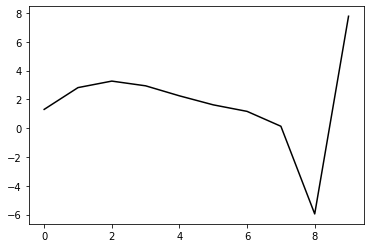

311300 24.64634282116008
0.31156160366057645 -0.1521095151841496 -0.2534250968397629 -0.1333618084009123
[ 1.36043453  2.72016397  3.17217911  2.84467561  2.15063502  1.52627401
  1.07519311  0.04350592 -6.03972698  7.77452793]


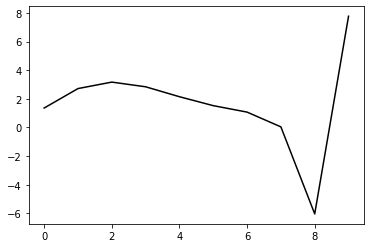

312400 14.534771309333923
0.313859876793183 -0.1510548830881249 -0.2536884985911643 -0.13270948327542384
[ 1.3290518   2.8205398   3.27731325  2.95324349  2.26074088  1.63655865
  1.18475853  0.15114544 -5.93427964  7.80546646]


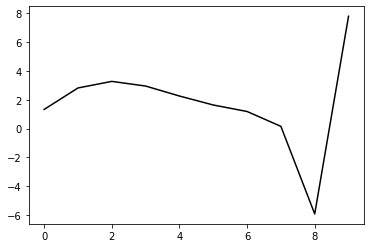

313500 21.943181630546796
0.31369210906398426 -0.15251484017382846 -0.25457213401599477 -0.1331762773141485
[ 1.34465604  2.81659422  3.27512613  2.95361836  2.26337578  1.64157318
  1.19281541  0.16260342 -5.9181493   7.86103985]


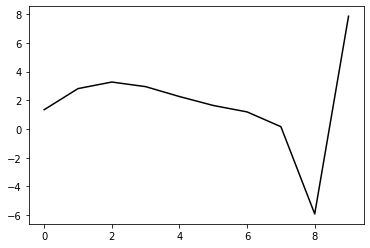

314600 24.59399524477258
0.31662303304221595 -0.15175788001511187 -0.2550223529463236 -0.1343647240162234
[ 1.31378092  2.93500971  3.40524585  3.09355987  2.41090552  1.79498031
  1.35079504  0.32328525 -5.75836455  7.81153059]


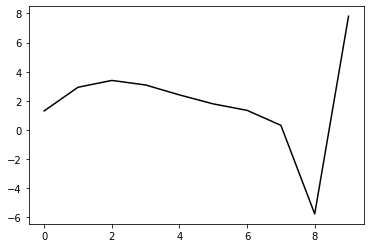

315700 17.326809139932763
0.31428084459285416 -0.14663988616243653 -0.2513329864700228 -0.1342919505791337
[ 1.38647247  2.83201755  3.29710546  2.98293002  2.29929627  1.6834231
  1.24005213  0.21332167 -5.8666224   7.82442703]


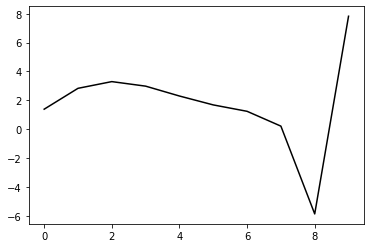

316800 21.89702801245818
0.31347319063689916 -0.14875709210455873 -0.2515121318925891 -0.13537897240723476
[ 1.33318492  2.86296644  3.31354957  2.98651037  2.29113003  1.66514155
  1.21391721  0.18164835 -5.90018811  7.85530663]


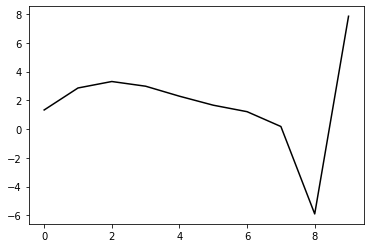

317900 16.314014530744117
0.3157470020770702 -0.15026477856177212 -0.2531230951995196 -0.13449171532397067
[ 1.27410048  2.83718909  3.27852245  2.94453053  2.24366362  1.61340474
  1.15928085  0.12509571 -5.95700608  7.82604854]


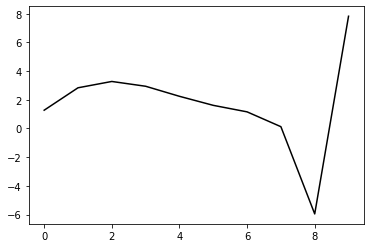

319000 17.713295553170465
0.3165644346794254 -0.15627875352173057 -0.2578032579102686 -0.1309107941894854
[ 1.29610211  2.80286745  3.25157242  2.92434547  2.22870457  1.60260568
  1.1521548   0.12113472 -5.95688322  7.77423426]


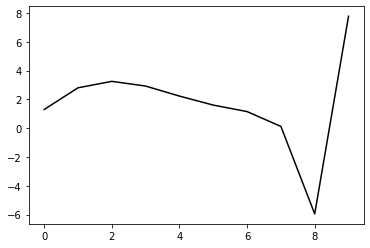

320100 20.455145812070327
0.3175423321619348 -0.14890923076589915 -0.2528615207356594 -0.1337972230487474
[ 1.31215179  2.84969922  3.29166435  2.95904834  2.25868807  1.62822699
  1.17359966  0.13791551 -5.9460229   7.81262029]


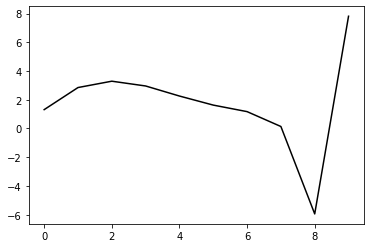

321200 22.012757868414667
0.3175116801523088 -0.14872788968194134 -0.25319028233427865 -0.13150422869918627
[ 1.28882629  2.81475164  3.25208877  2.91578706  2.21220881  1.57890154
  1.12200748  0.0841229  -6.00238518  7.78980844]


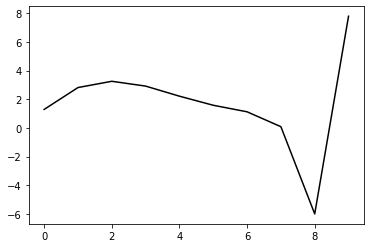

322300 20.93453312112315
0.31568167141690395 -0.1527164334335459 -0.25499244783882 -0.13301003162586408
[ 1.30684152  2.8279728   3.27433329  2.94648785  2.24938474  1.62148537
  1.17010979  0.13820946 -5.93891643  7.80055524]


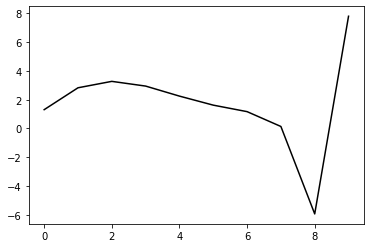

323400 18.44718487801073
0.3091544449722061 -0.1571532037930214 -0.256291861597273 -0.1328037021315574
[ 1.32663095  2.66462493  3.10848853  2.7815455   2.08602781  1.46018107
  1.01175494 -0.01639293 -6.08828183  7.76068838]


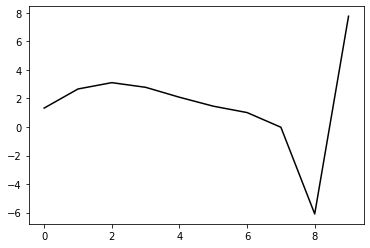

324500 22.099575669150077
0.3168833289099648 -0.15226092848098705 -0.2543989077816211 -0.1339569061338782
[ 1.30167241  2.83059909  3.26271013  2.9241864   2.21730159  1.58045292
  1.12158658  0.08340274 -5.99726929  7.80164873]


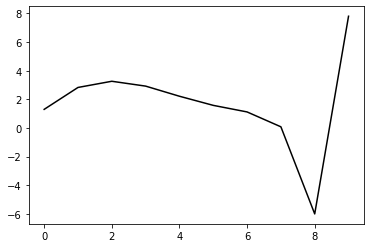

325600 24.359825633294438
0.31810823276743233 -0.15174517387255057 -0.25428107774107145 -0.137322462594704
[ 1.3076756   2.9444052   3.39143644  3.06415605  2.36571188  1.73558231
  1.28254023  0.2491564  -5.82919698  7.80403344]


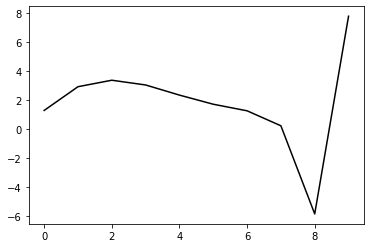

326700 14.323728905971631
0.3148892061024674 -0.15354666626532473 -0.25503644510606105 -0.13822837078579994
[ 1.35014657  2.83011519  3.28874814  2.97341707  2.28600241  1.66597562
  1.22237425  0.19752231 -5.87107707  7.83811474]


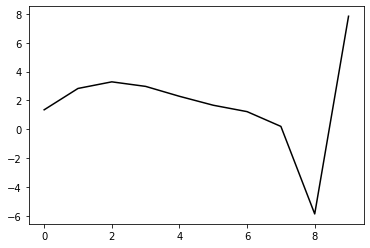

327800 24.40180845425857
0.31292653649475394 -0.15066069013297564 -0.2526673014336188 -0.1389806383526714
[ 1.35814214  2.84049873  3.29920988  2.98484429  2.29814943  1.67857819
  1.23527143  0.21006367 -5.85965948  7.80977783]


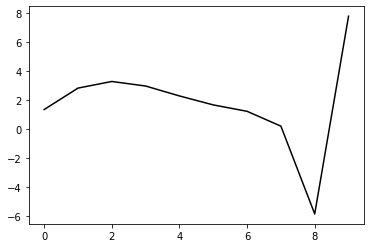

328900 14.422374185601752
0.31431552724369743 -0.15409417086364763 -0.25507218277669425 -0.13648816092759666
[ 1.28405683  2.79569216  3.22528392  2.88860789  2.18377397  1.54930028
  1.09412877  0.05972853 -6.01530436  7.81201958]


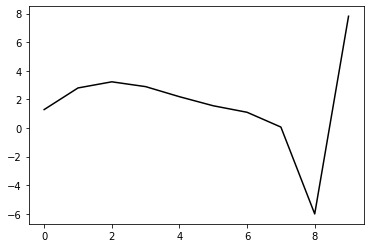

330000 17.457575990833327
0.3194127772044724 -0.15628852569375065 -0.2579733532609935 -0.1339798574361006
[ 1.29182736  2.82558685  3.25931893  2.92583327  2.22311226  1.59009631
  1.13619343  0.10274798 -5.97113689  7.75612337]


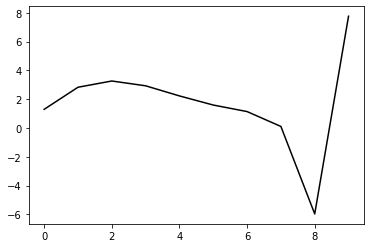

331100 23.43611444212346
0.31481046891165126 -0.15479271566093353 -0.2557116673442416 -0.1364394465262679
[ 1.35600439  2.6939953   3.13996888  2.81856181  2.12597633  1.5013656
  1.05463709  0.02699958 -6.04191556  7.82310842]


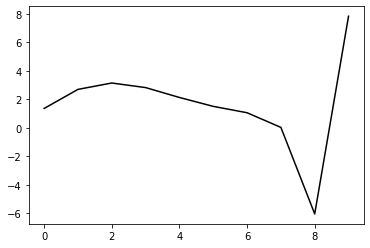

332200 23.88014366255898
0.31266486927206505 -0.15256668454124891 -0.2536142947892697 -0.1380479430838727
[ 1.35423907  2.6655868   3.11777316  2.80251997  2.11458524  1.49341035
  1.04933113  0.02331403 -6.04485209  7.76228506]


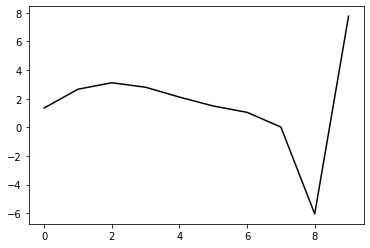

333300 21.019612728240954
0.3176998100952672 -0.15279056862039528 -0.25551460316947955 -0.1353834923893264
[ 1.3143655   2.76856749  3.21843705  2.90157983  2.21244782  1.59032795
  1.14550744  0.11830348 -5.95155295  7.82601975]


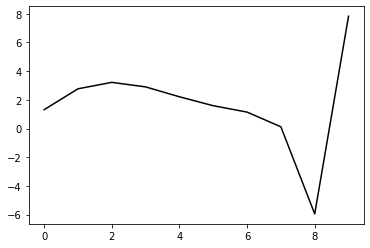

334400 14.553166269544235
0.3160590964353961 -0.15432959707236465 -0.25626178319527626 -0.1371339065052029
[ 1.33708881  2.845407    3.3085906   3.00134496  2.31861524  1.70102094
  1.2600657   0.23625061 -5.82998145  7.78542495]


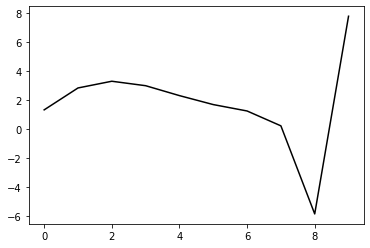

335500 21.69122974100763
0.3130759057369327 -0.1580727187774793 -0.2585217196887548 -0.13263184900520444
[ 1.29999235e+00  2.66721889e+00  3.10823700e+00  2.78745969e+00
  2.09574189e+00  1.47185460e+00  1.02653150e+00 -6.63152862e-04
 -6.06969120e+00  7.79230714e+00]


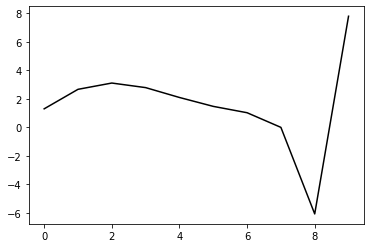

336600 24.40163960092592
0.3190057308735129 -0.15223042733986944 -0.255323290533321 -0.135345505508947
[ 1.30824347  2.82667728  3.26167765  2.93409065  2.23494737  1.60339517
  1.15059114  0.11609106 -5.95869852  7.79296205]


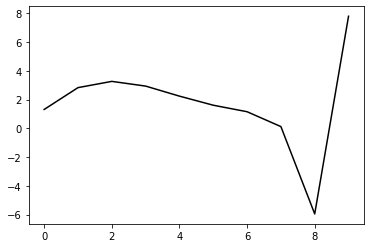

337700 13.440740249881323
0.3182356297884673 -0.14927960653835307 -0.2531028765492931 -0.13733537265225568
[ 1.35160888  2.81933478  3.26016834  2.93782539  2.24327212  1.61579995
  1.16683616  0.13557701 -5.93651716  7.81157519]


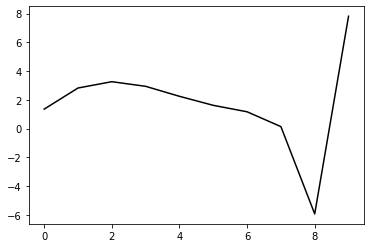

338800 23.24580047046651
0.31954709077214005 -0.14837764124221048 -0.2529855621345855 -0.1371896761788499
[ 1.29899852  2.84187245  3.27981023  2.95400902  2.25576371  1.62450962
  1.17205973  0.13730862 -5.93832534  7.82403662]


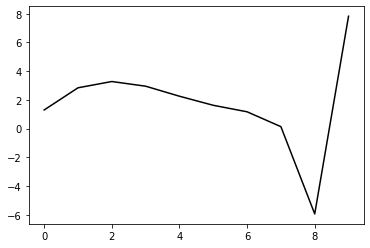

339900 23.87583397596641
0.3175065886315434 -0.15678203283394265 -0.2589571166103877 -0.13259239511106086
[ 1.28852788  2.76815011  3.20593159  2.88016225  2.18188116  1.55087579
  1.09953289  0.06652138 -6.00584525  7.79060392]


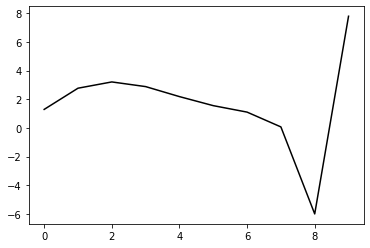

341000 19.018469860425704
0.3210710589589628 -0.15123925579341752 -0.25589503713390555 -0.13398222004924581
[ 1.26972882  2.92415099  3.36162199  3.03329167  2.33042644  1.6933029
  1.2347465   0.19303626 -5.89089962  7.75181213]


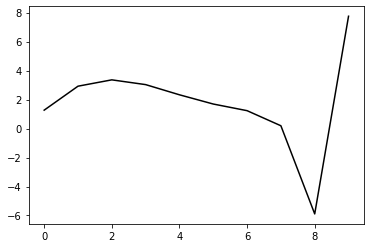

342100 19.579197162634394
0.31835898899539744 -0.15244440195779455 -0.25638932682828564 -0.13335379969522998
[ 1.30815622  2.81934227  3.25610235  2.92845876  2.22687786  1.59138575
  1.13483752  0.0950427  -5.98573755  7.79862034]


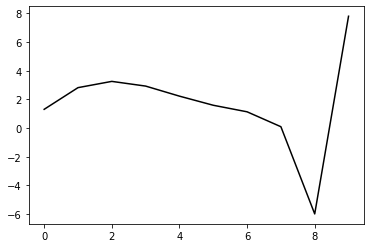

343200 22.675573231717472
0.31498928689764377 -0.15338531307192896 -0.2565562339301439 -0.13280069500599107
[ 1.31961159  2.77898562  3.21900685  2.89626456  2.20012613  1.57015286
  1.11911054  0.08419038 -5.99174055  7.78925125]


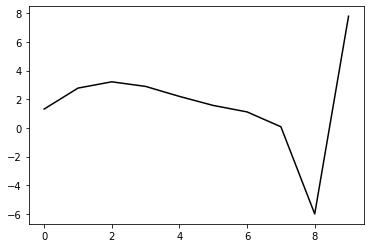

344300 24.845439398303434
0.3074188659042546 -0.15228334827692547 -0.25366451390163985 -0.13624747711291676
[ 1.34230204  2.65052651  3.08969543  2.76831225  2.0742884   1.44685061
  0.99886938 -0.03282776 -6.10607214  7.79379863]


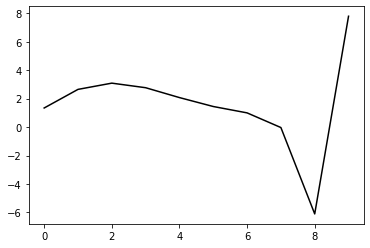

345400 17.391786375147742
0.31009022653979 -0.15504551851951928 -0.25632760229843327 -0.1343347239134538
[ 1.32044726e+00  2.70641683e+00  3.14192153e+00  2.81715151e+00
  2.11936282e+00  1.48793208e+00  1.03607266e+00  6.12821566e-04
 -6.07426496e+00  7.76768131e+00]


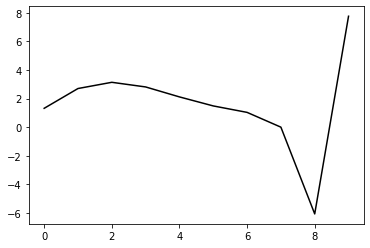

346500 21.5567005453656
0.3148143428606695 -0.1534485064925638 -0.25634857492371754 -0.13412048653235895
[ 1.30645442  2.78859118  3.21885537  2.88938026  2.18703153  1.55113227
  1.09502879  0.05535235 -6.02273322  7.79847652]


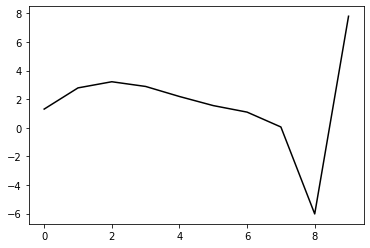

347600 24.482793171536944
0.31693198644757364 -0.15204795976103808 -0.2557847399033858 -0.13489886880289517
[ 1.3102211   2.85055878  3.27856519  2.94696245  2.24245018  1.60443945
  1.14655056  0.10522782 -5.97370927  7.78822402]


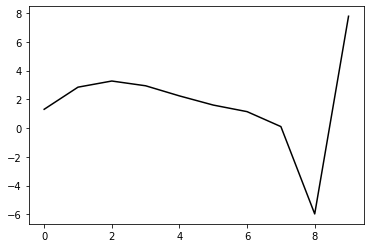

348700 13.29610781194549
0.31623023094298097 -0.15053316866943786 -0.254443247514819 -0.13710770702759367
[ 1.34923573  2.83634923  3.27597549  2.95410664  2.25758956  1.62634553
  1.1746082   0.13864636 -5.93544025  7.82015984]


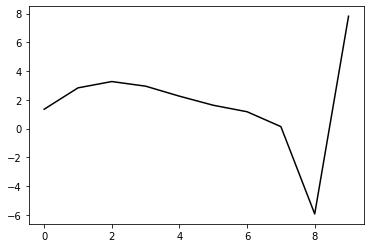

349800 24.48495122775998
0.3127636809595009 -0.14956862289328032 -0.252815977149587 -0.13977585276206192
[ 1.35422517  2.86165871  3.30040893  2.97858     2.28180915  1.64994017
  1.19752105  0.16059887 -5.91420048  7.78649197]


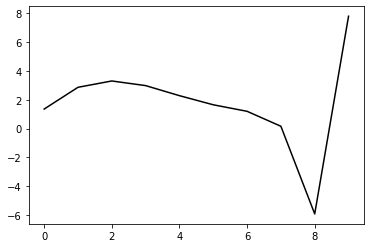

350900 13.524881907844607
0.31717157433424525 -0.1495226794261458 -0.2540609298168999 -0.13814172513105524
[ 1.3030017   2.91814666  3.35138389  3.02510497  2.32453959  1.68924167
  1.23369954  0.19338354 -5.88560497  7.81872015]


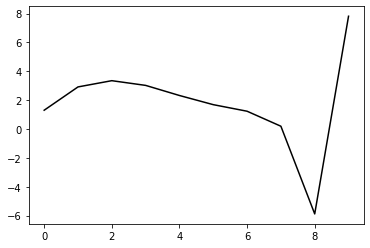

352000 16.67700539285532
0.3188617465835315 -0.15116001448433083 -0.2561093731133275 -0.13538729848197703
[ 1.27986148  2.90633302  3.33704188  3.00887284  2.30700148  1.67064318
  1.21423157  0.17270406 -5.90731602  7.79409025]


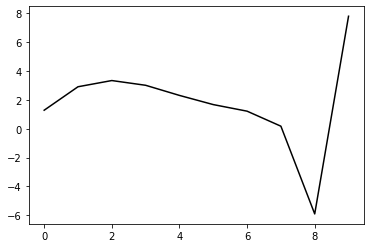

353100 27.612838440402317
0.3110027525498597 -0.1513124237226809 -0.2543187041388047 -0.13671043957899193
[ 1.40290467  2.63010939  3.05940276  2.73490352  2.03962603  1.41160332
  0.96485386 -0.06664618 -6.13723755  7.799077  ]


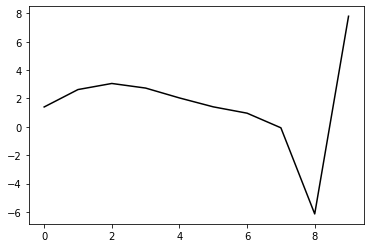

354200 23.659043251567287
0.3132368508385844 -0.15034886727964825 -0.25353521247404326 -0.13762759574568662
[ 1.3483965   2.74957584  3.16319455  2.82324127  2.11288204  1.47050435
  1.01067844 -0.03246026 -6.11150218  7.76681273]


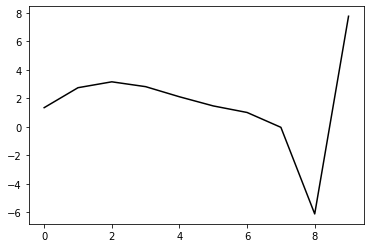

355300 23.999484327577587
0.3142579842318364 -0.14976884518429476 -0.2534723792702507 -0.13801510004462414
[ 1.32830938  2.81482727  3.23037792  2.89146527  2.18152381  1.53914853
  1.07929261  0.03596604 -6.04259824  7.8051456 ]


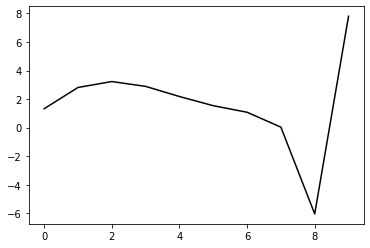

356400 14.239959414749903
0.32082950533492677 -0.1470753375584575 -0.25323042434834725 -0.13764435899488525
[ 1.31091586  2.95344718  3.36847855  3.02706222  2.31409177  1.66852767
  1.20576702  0.15956782 -5.92240192  7.83677528]


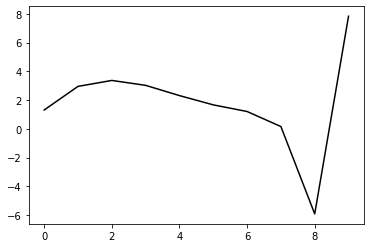

357500 22.219334409994715
0.31595683766097526 -0.15009146721735137 -0.25424741065192785 -0.13919531962580511
[ 1.33586069  2.8990903   3.33074594  3.00325618  2.3018447   1.66609848
  1.21227264  0.17414638 -5.89948487  7.81154882]


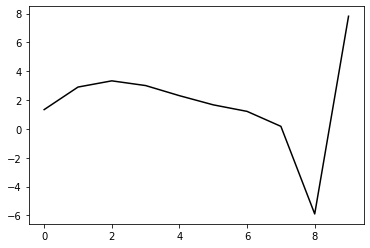

358600 25.395319086603923
0.31522152114157836 -0.15586472362533188 -0.25859708047503455 -0.13435494919826677
[ 1.30878195  2.7931166   3.21446546  2.88068146  2.17525287  1.53671155
  1.08098212  0.0412469  -6.03302479  7.77849545]


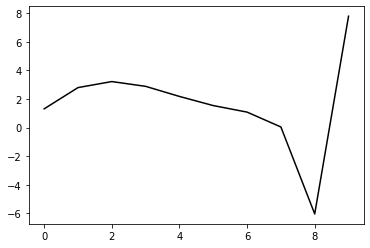

359700 13.479125576824956
0.3163177681917966 -0.15067046203099488 -0.2548625052531846 -0.1387164697304524
[ 1.3462328   2.85630758  3.28503214  2.95648674  2.25459813  1.61848172
  1.16468706  0.12638863 -5.94634412  7.80968139]


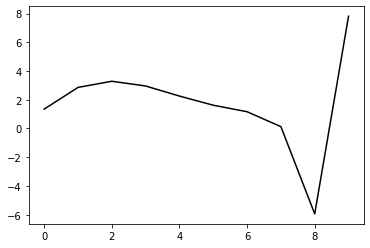

360800 23.213378596979325
0.31723640415926796 -0.14983094925615992 -0.2544928800768745 -0.13895553806185926
[ 1.30529322  2.89055241  3.31468846  2.98206012  2.27670171  1.6376955
  1.18183691  0.1418886  -5.9322677   7.79371504]


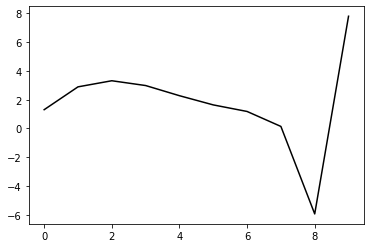

361900 13.182013935441212
0.3164323336287462 -0.15126205413061916 -0.25568733597093635 -0.1385947278534903
[ 1.31521397  2.89448629  3.32690019  3.0010327   2.30121847  1.66664032
  1.21435811  0.17676416 -5.89577562  7.80606874]


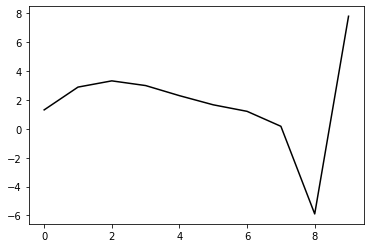

363000 16.200949784650394
0.31814187954233913 -0.152031191193289 -0.2571647639638371 -0.1357565827241749
[ 1.31507112  2.82584069  3.25754075  2.93288925  2.23565392  1.60433324
  1.15563925  0.12097654 -5.9496224   7.75269714]


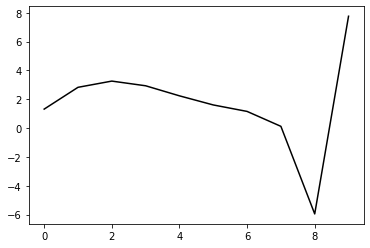

364100 24.667867505760853
0.31266007338910035 -0.15264592820435538 -0.2563414205005032 -0.13576922929539692
[ 1.36438026  2.64120803  3.07257602  2.75190656  2.06024003  1.43495021
  0.99252921 -0.03634032 -6.10240902  7.79817221]


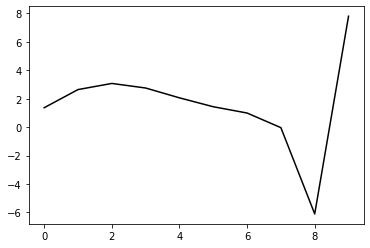

365200 22.368116203293987
0.3172400734383992 -0.1514238266741382 -0.25690431695777666 -0.13522139645171125
[ 1.3023641   2.78744826  3.21976348  2.89839214  2.20485381  1.57690042
  1.13133046  0.09845996 -5.97157582  7.77534715]


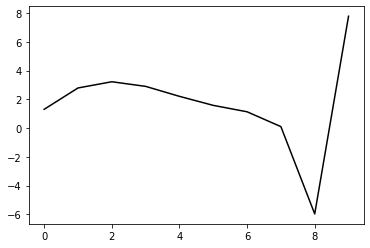

366300 25.119466037437117
0.3067398363098357 -0.15213203704569064 -0.25446998861721026 -0.13709850559002068
[ 1.31805032  2.56602561  2.98135728  2.64969572  1.94993047  1.31871574
  0.87265366 -0.1586888  -6.22825489  7.78360685]


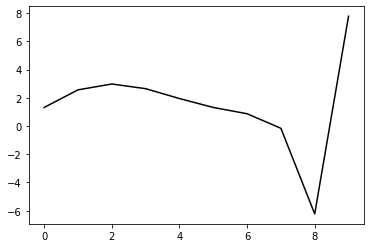

367400 14.659990417667107
0.3147887717645772 -0.15105031157046342 -0.2553480929784577 -0.13866923148716975
[ 1.3407663   2.80494157  3.23009448  2.90383104  2.20621432  1.575208
  1.12848234  0.09597896 -5.97280063  7.78659805]


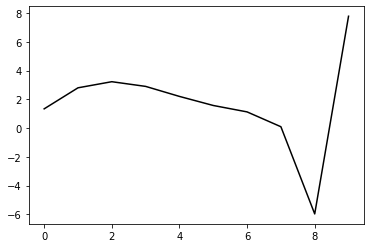

368500 21.616999540040123
0.315849838748218 -0.15149235294113864 -0.25600664648834115 -0.13731009259949378
[ 1.29910823  2.79329016  3.21171419  2.88042197  2.17871083  1.5441312
  1.09437849  0.05897613 -6.01225788  7.79303319]


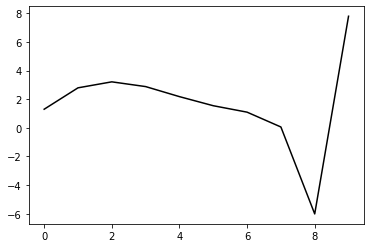

369600 25.203747921808567
0.3151764943887183 -0.15537205975178447 -0.2589311909153233 -0.1359696375266716
[ 1.30660425  2.76590053  3.19306797  2.87062489  2.17663511  1.54854492
  1.10431402  0.07320059 -5.99409715  7.77908796]


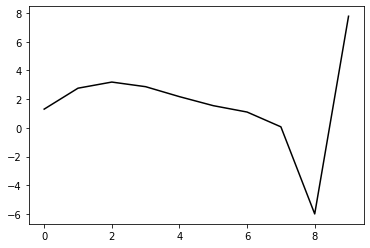

370700 14.632454870149205
0.31567679793866715 -0.14901985037131335 -0.25445503099094985 -0.1395263110034485
[ 1.35721761  2.78870752  3.22308083  2.9067004   2.21755406  1.59330071
  1.15222959  0.123299   -5.94282999  7.81398566]


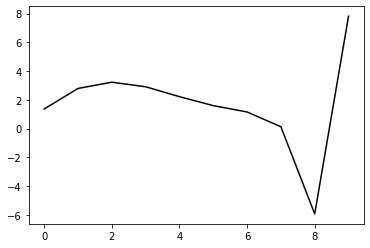

371800 23.905052415028614
0.3157912885786302 -0.14946753374957902 -0.25499251400842227 -0.13904750885179798
[ 1.30262876  2.79635834  3.21974848  2.89311456  2.19480253  1.56253017
  1.11494724  0.08070259 -5.98922736  7.78546801]


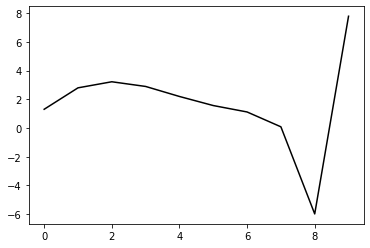

372900 25.739475787587846
0.31938560839696944 -0.15043821215506886 -0.2570015134746061 -0.13642810946416878
[ 1.24759738  2.81589196  3.23994472  2.91537589  2.21954617  1.58948955
  1.14365036  0.109867   -5.96153582  7.84927294]


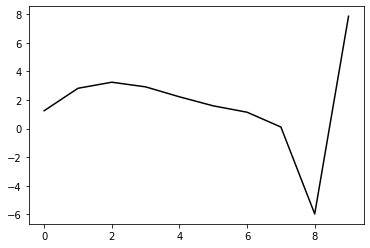

374000 18.003364050290546
0.31979884081563736 -0.15363275521307845 -0.25910126127546185 -0.13392847777925732
[ 1.28197182  2.8103006   3.22398659  2.89087854  2.18719833  1.54988382
  1.09775789  0.05864799 -6.01650422  7.76263694]


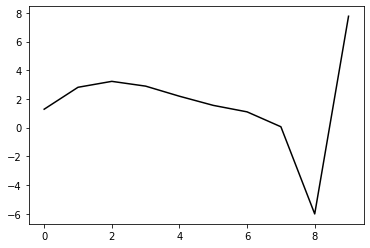

375100 22.367740916726646
0.31825089747593915 -0.15091212415483607 -0.256562067939487 -0.13700532111617278
[ 1.34508491  2.75942976  3.17927231  2.85203365  2.15348877  1.52060185
  1.07251037  0.03684723 -6.0348312   7.83667158]


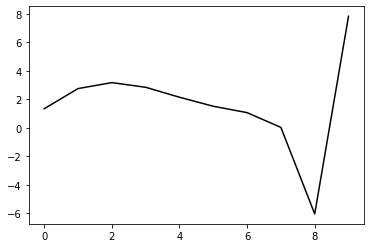

376200 22.477565802604527
0.3179914772304347 -0.1507595395011724 -0.25668944964538 -0.13731706213721295
[ 1.35217128  2.76511947  3.19494624  2.87621912  2.18503082  1.55847199
  1.11592286  0.08457522 -5.98437859  7.79849366]


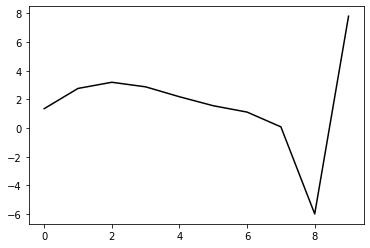

377300 21.18892802179842
0.31987527659071663 -0.14964585383033852 -0.2566658775700484 -0.13525695865430318
[ 1.30992102  2.7948608   3.2150019   2.88695347  2.18727273  1.55295977
  1.10366427  0.06615917 -6.00881511  7.7874073 ]


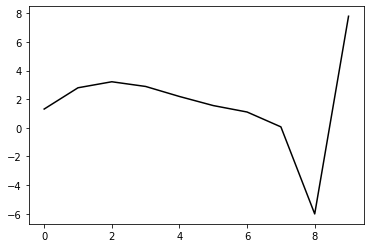

378400 14.291462282924892
0.31723952844524056 -0.15048229051638712 -0.25657572498487374 -0.13786148869531997
[ 1.32417602  2.84597218  3.27539752  2.95481124  2.26080237  1.63086404
  1.18537079  0.15091978 -5.92085823  7.81936487]


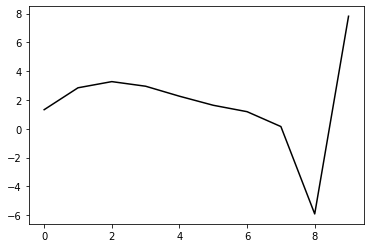

379500 22.070985855846736
0.31976992926253067 -0.1458175610229169 -0.2540308008445781 -0.13762486364370186
[ 1.32970949  2.88798793  3.31415874  2.98826203  2.28802825  1.65126738
  1.19889378  0.15725996 -5.92196863  7.80586892]


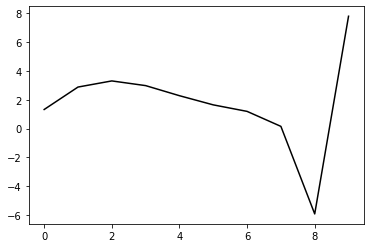

380600 24.72445642095626
0.32035512591339255 -0.14923357601329665 -0.2564131004301852 -0.1365873378980652
[ 1.28877551  2.89769794  3.31740026  2.98578031  2.28072372  1.63998575
  1.18482086  0.14129727 -5.93810466  7.82684509]


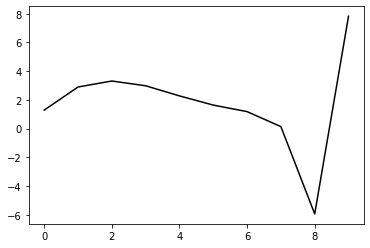

381700 13.287428862947092
0.31994250166375265 -0.1456374970952182 -0.25398581411369753 -0.13744403513665326
[ 1.3482841   2.85110923  3.2787588   2.95415327  2.25536261  1.61998796
  1.16955979  0.12965333 -5.94744284  7.80481571]


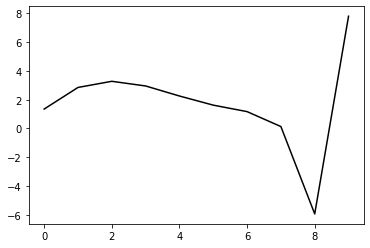

382800 24.069908655178217
0.31603163202245954 -0.1499942830637411 -0.2562733792610354 -0.1376388219399014
[ 1.31064929  2.80151077  3.23320494  2.91189009  2.215783    1.58284919
  1.13538267  0.09878046 -5.9736034   7.8443817 ]


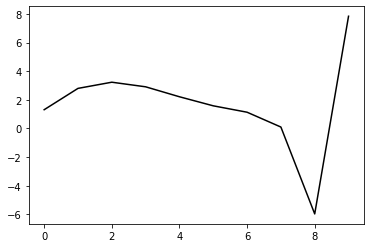

383900 14.024542370253757
0.316637425123754 -0.15210318398979086 -0.2581569151615542 -0.13630211381798363
[ 1.31460921  2.84651444  3.28575962  2.97170459  2.28094893  1.65133208
  1.20567323  0.16915272 -5.90480644  7.80203207]


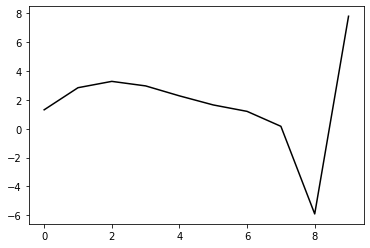

385000 19.622546305320064
0.31913452730540454 -0.15526722496750575 -0.26163394459044725 -0.13161965367612172
[ 1.29121059  2.75850247  3.19573339  2.88043363  2.18904818  1.5591972
  1.11383255  0.07747335 -5.99688045  7.79424712]


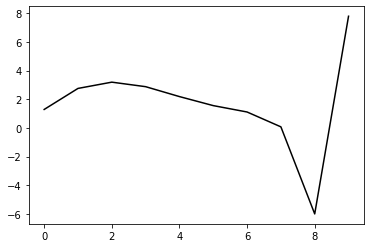

386100 23.87091931798833
0.3147741969059106 -0.15127185952053882 -0.2566067466344556 -0.13712289936721708
[ 1.38868824  2.76039158  3.178959    2.84627854  2.13878677  1.49433709
  1.03636015 -0.01052874 -6.09258714  7.81504214]


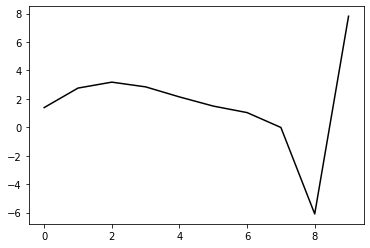

387200 24.649972281759393
0.3141882614663664 -0.14832456051959916 -0.254283844044389 -0.13856255414449048
[ 1.35571665  2.80332776  3.2176655   2.8813804   2.17067583  1.52309658
  1.06200261  0.01167222 -6.0738465   7.7560667 ]


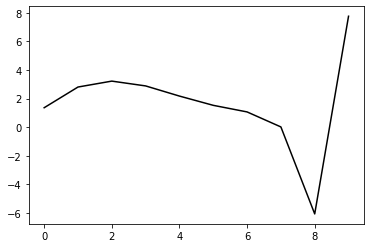

388300 24.33920916122538
0.31496312931880205 -0.14870860961896087 -0.2549510619473675 -0.1373695124131647
[ 1.33912258e+00  2.80390725e+00  3.21608110e+00  2.87806016e+00
  2.16595919e+00  1.51717190e+00  1.05521998e+00  4.14114292e-03
 -6.08176714e+00  7.80417491e+00]


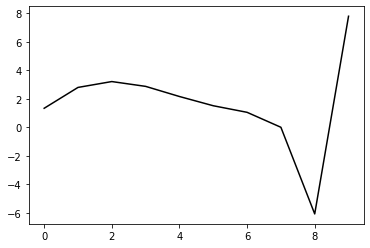

389400 14.86189971391412
0.3162003884894824 -0.15016475766880627 -0.2564343571996353 -0.1362638103677592
[ 1.32458183  2.83873605  3.2499392   2.91080397  2.19758192  1.54766531
  1.08483616  0.03296427 -6.05263373  7.76711563]


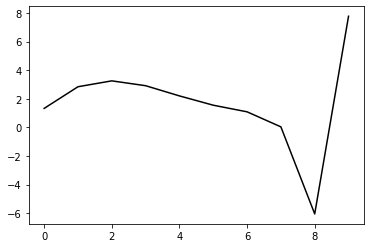

390500 21.809815933146727
0.31773620206547915 -0.15195160200046895 -0.25824597306444896 -0.13479521598482444
[ 1.30782028  2.84797385  3.25794634  2.91757578  2.20311812  1.55191813
  1.08799571  0.03502393 -6.05092798  7.79489136]


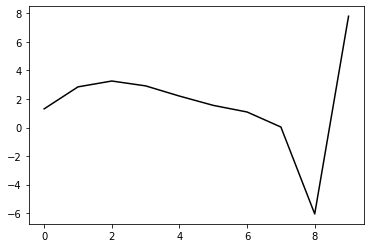

391600 24.49197752186686
0.3195242604040332 -0.15082337155483372 -0.25782269868392627 -0.13557134608404137
[ 1.31608748  2.89712565  3.310556    2.97208223  2.25851     1.60748062
  1.14344002  0.08996233 -5.99613797  7.78348936]


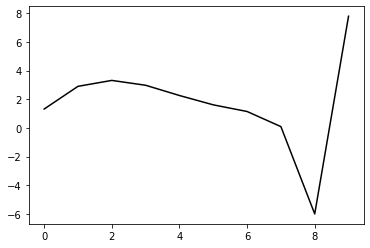

392700 13.98199815522377
0.31888822199380884 -0.14863893619622814 -0.255998385381827 -0.13812309994632185
[ 1.3676521   2.88296349  3.30291121  2.96962339  2.26053043  1.61345046
  1.15321745  0.10312289 -5.9796025   7.81391212]


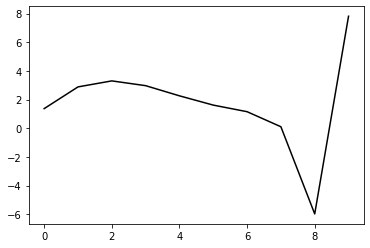

393800 21.950110889066824
0.3172281934889463 -0.14823345613903718 -0.25536145664832444 -0.13892644320949085
[ 1.35031383  2.91681528  3.34321786  3.01380941  2.30700075  1.66103654
  1.20140531  0.15125536 -5.93210951  7.77632287]


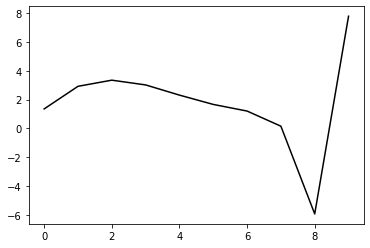

394900 19.26697117834671
0.320145873849859 -0.14913053986812613 -0.2571449556083511 -0.13566131695425726
[ 1.27152673  2.89940191  3.30557478  2.95865724  2.23765407  1.57999624
  1.11067915  0.05204467 -6.0382984   7.82695023]


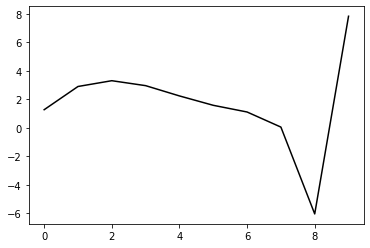

396000 17.53007486187358
0.3212110577338637 -0.15246518784118618 -0.25986141873333407 -0.13400761172998404
[ 1.29716381  2.90477865  3.31995907  2.980975    2.26689473  1.61528482
  1.15149571  0.09757483 -5.98810272  7.76483122]


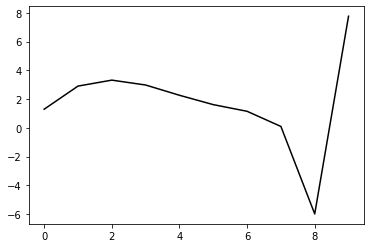

397100 20.45817644598775
0.3223364273303117 -0.14610553015779984 -0.2558181801332082 -0.13571586011320597
[ 1.31537581  2.91005883  3.32109507  2.97881463  2.26230674  1.60845281
  1.14228986  0.08516544 -6.0051438   7.79957107]


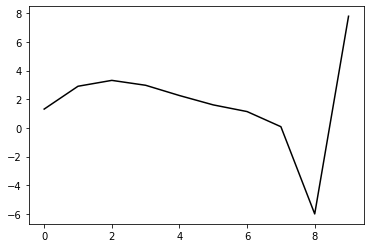

398200 22.802574079018502
0.31977100317192253 -0.14878689761188352 -0.25738736283174934 -0.13447701047522584
[ 1.3263464   2.85582331  3.27439177  2.93773609  2.22587735  1.57599264
  1.11372995  0.06021393 -6.0265925   7.7807576 ]


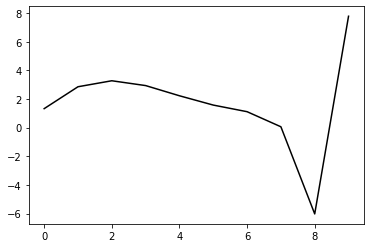

399300 24.93028113502754
0.313477793541703 -0.14730469705141497 -0.25490282510877754 -0.13690630877739152
[ 1.36170928e+00  2.79601887e+00  3.21727466e+00  2.88245104e+00
  2.17179276e+00  1.52258122e+00  1.06087658e+00  7.47036674e-03
 -6.07991831e+00  7.74738305e+00]


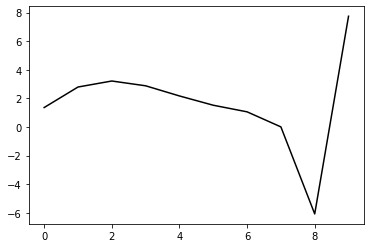

400400 17.873046466622693
0.31094224453775204 -0.1533243281204426 -0.25876954923701045 -0.13376294696346486
[ 1.33222901  2.73802155  3.15830099  2.82467299  2.11621395  1.46976976
  1.01142965 -0.03843565 -6.12109025  7.75527949]


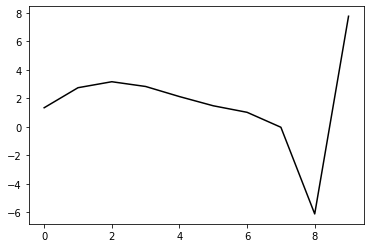

401500 21.42844087135314
0.3140721409712808 -0.15578046350267463 -0.2610536350614075 -0.13223199485127948
[ 1.31376443  2.78026502  3.19090615  2.84799349  2.13052582  1.47545011
  1.0092259  -0.04771223 -6.13516761  7.78477573]


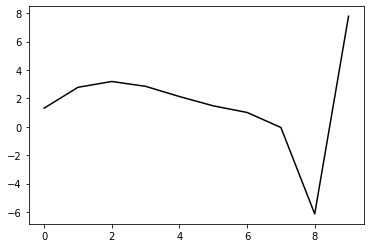

402600 24.758455954047616
0.31990941705599135 -0.14979536355782194 -0.25780053054836816 -0.1344313839119546
[ 1.31373004  2.92308702  3.3259808   2.97469675  2.24895168  1.58580318
  1.1119851   0.04788626 -6.04531578  7.7788278 ]


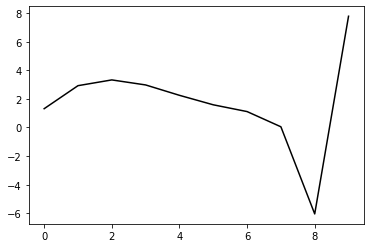

403700 13.842019256889907
0.31855636964352396 -0.14715142780527457 -0.25543632662012683 -0.1377057025132226
[ 1.363792    2.92883166  3.34072988  2.99629455  2.27610051  1.61758299
  1.14796439  0.0875612  -6.0018252   7.79444649]


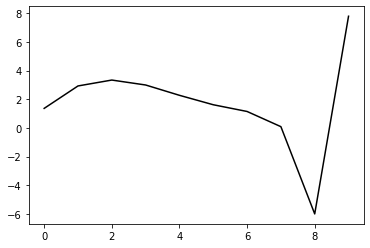

404800 26.81511782584357
0.3182363075079748 -0.1458789408353361 -0.2545862530632141 -0.13937923510350714
[ 1.37099241  2.93810728  3.36197794  3.02655287  2.31381911  1.66147553
  1.19726018  0.14126808 -5.9452938   7.81352259]


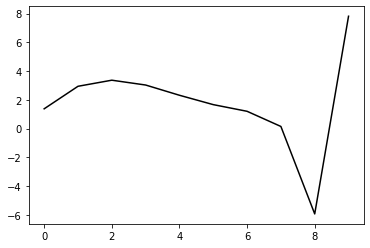

405900 20.330582531167742
0.31938489239506884 -0.15087897205243492 -0.2584892915677243 -0.13614073430760903
[ 1.27339585  2.90024371  3.30336852  2.95229289  2.22762358  1.56589745
  1.09450327  0.03306035 -6.05553101  7.81645167]


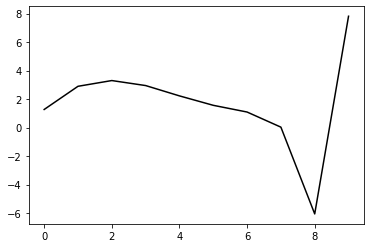

407000 17.748955238345122
0.3213641102131134 -0.15410648752912057 -0.2613634842192674 -0.13431110889472198
[ 1.29552789  2.91247199  3.32197732  2.97614301  2.25559527  1.59706266
  1.12831155  0.06890086 -6.01702897  7.75604732]


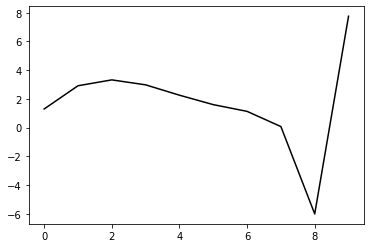

408100 24.135643937977676
0.3163133099549313 -0.1519386085519946 -0.25841754888375046 -0.13730170969343752
[ 1.37378196  2.76305379  3.18037117  2.84223957  2.12877987  1.47658042
  1.01361592 -0.04081287 -6.1223397   7.81301981]


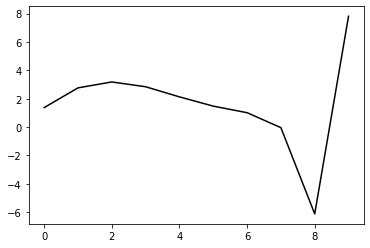

409200 22.255466060549175
0.3160875740720431 -0.15056134877285668 -0.25758539015931026 -0.13783030198146365
[ 1.34909049  2.78496064  3.20415993  2.86773602  2.15574624  1.50460247
  1.04228501 -0.01233794 -6.09474901  7.76116251]


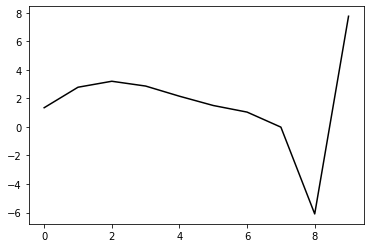

410300 20.864866419092436
0.31979781016527586 -0.14991690850608852 -0.25835119271315277 -0.1361760647530825
[ 1.31705796  2.87133305  3.2913796   2.95510656  2.24344742  1.59272498
  1.13093811  0.0763842  -6.00669582  7.80755734]


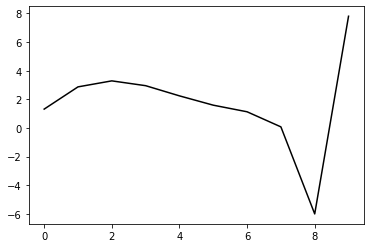

411400 18.997400587467872
0.3177246793938073 -0.14668407860898777 -0.2556713693926291 -0.13747014972972874
[ 1.38822163  2.82705583  3.24616519  2.9083735   2.19562215  1.54425942
  1.0824623   0.02803641 -6.05501759  7.77782667]


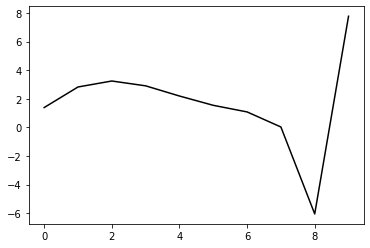

412500 21.385419018115424
0.3151935197689908 -0.15434786200743414 -0.26083160675847694 -0.1343804669010623
[ 1.30651637  2.79594597  3.20818741  2.86604055  2.15056665  1.49757164
  1.03509103 -0.01965732 -6.10228966  7.78329099]


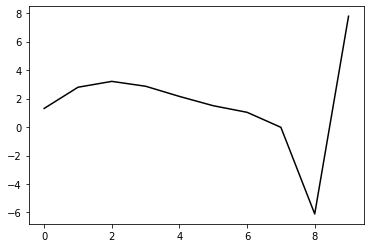

413600 24.336189465424724
0.31917990049847617 -0.14924466526422173 -0.25821027220851034 -0.13609113792667007
[ 1.31740019  2.90091626  3.31729241  2.97767301  2.26367772  1.61119504
  1.14838099  0.0920892  -5.99300977  7.78097338]


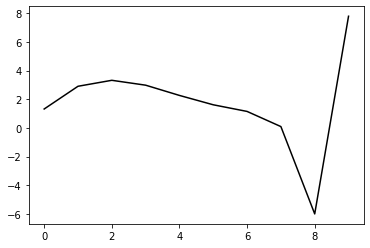

414700 15.051922344769567
0.3183828695041799 -0.14652064909237228 -0.25618251882413445 -0.13810551443898855
[ 1.37586943  2.87029918  3.29336491  2.95931514  2.25031233  1.6022958
  1.14367535  0.09086749 -5.99183604  7.81375737]


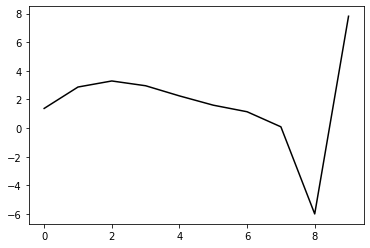

415800 21.997823405350427
0.31597729581555856 -0.1477708842263573 -0.25644399733114415 -0.13890976855035844
[ 1.34035797  2.89336026  3.3158298   2.97951483  2.267345    1.61581556
  1.15414107  0.09871576 -5.98552501  7.74819784]


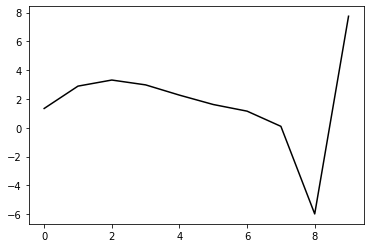

416900 30.92016092260925
0.32148981851824343 -0.14979626396412943 -0.25979896269301006 -0.13429528778960395
[ 1.25376292  2.88983366  3.30618576  2.96496842  2.24930432  1.59505033
  1.1310505   0.07284818 -6.01456927  7.83539044]


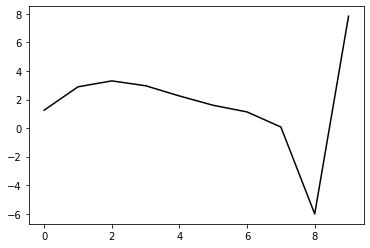

418000 16.15995659632508
0.32090225237437275 -0.14749890023683776 -0.25810030059007366 -0.1359486148339443
[ 1.28837961  2.94440369  3.36435647  3.02563347  2.31166349  1.65837732
  1.19472101  0.13586089 -5.95332317  7.78148149]


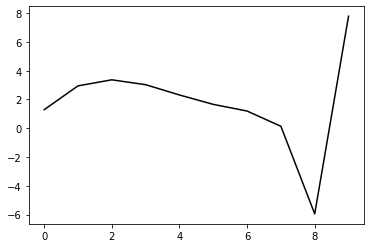

419100 20.1925448797628
0.3214691617652807 -0.14336054411018445 -0.2557448126164804 -0.13546659477928577
[ 1.3235633   2.89082259  3.31025082  2.97142551  2.2579275   1.60524794
  1.1421653   0.08322938 -6.00687925  7.79139719]


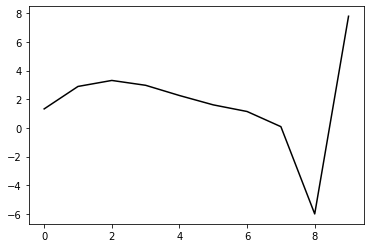

420200 22.19460363878718
0.31570637636269233 -0.14528852748700613 -0.25511667542477684 -0.13666985565869466
[ 1.30895527  2.83184301  3.24436097  2.90058915  2.18406331  1.52989377
  1.06679359  0.0088019  -6.07874505  7.78358703]


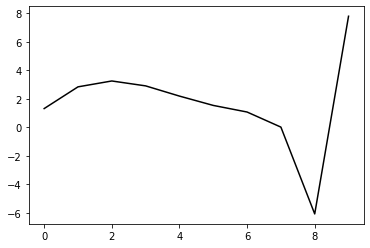

421300 20.737562189415595
0.3168471469910437 -0.15061748622233098 -0.2593433510942551 -0.13584024083561294
[ 1.30890563  2.82970707  3.26053341  2.93241353  2.22890674  1.58583602
  1.13282611  0.08414239 -5.99330925  7.77467284]


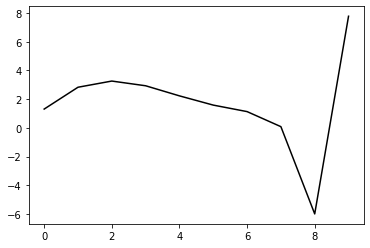

422400 15.016087461583675
0.31220286147281723 -0.15015087399357388 -0.2579286952161824 -0.13798050136949194
[ 1.35215006  2.75880748  3.20316311  2.88802126  2.19584434  1.56260555
  1.1183939   0.07732025 -5.99279948  7.78812443]


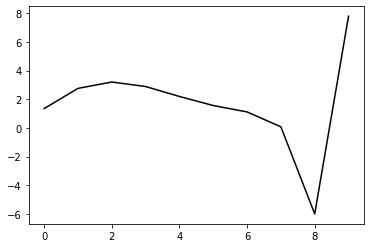

423500 21.857811351523385
0.314230845189146 -0.1512916642122161 -0.25942000799798454 -0.13631064237403184
[ 1.29894494  2.76613492  3.20266183  2.88331478  2.18825718  1.55262783
  1.10632049  0.06295647 -6.00961694  7.79191239]


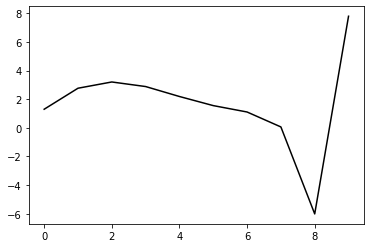

424600 24.329042613000656
0.31692979994191484 -0.14731049372387575 -0.2573223736535517 -0.13899090837957626
[ 1.30620952  2.90393473  3.3493133   3.03582571  2.34453915  1.71121123
  1.26610637  0.22240684 -5.85341214  7.78691758]


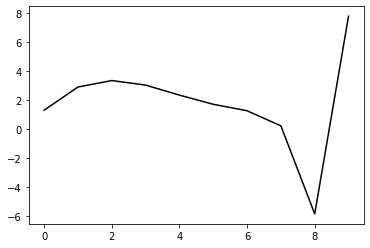

425700 15.038995396145722
0.31184128496139707 -0.14946692209436954 -0.25761754248659197 -0.13739202688247037
[ 1.3771154   2.70353301  3.13579241  2.81488295  2.11898209  1.48269117
  1.03605827 -0.00812531 -6.08243901  7.80222857]


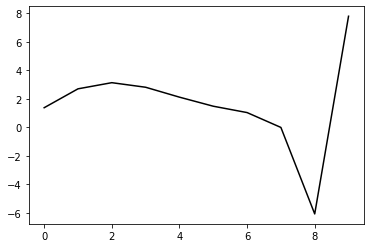

426800 22.03558975306048
0.3166132716906326 -0.14507084752615038 -0.25515610133620176 -0.14013062894865724
[ 1.33599844  2.87720147  3.3071453   2.98219647  2.2813489   1.63988418
  1.18849251  0.1400565  -5.93753325  7.79350462]


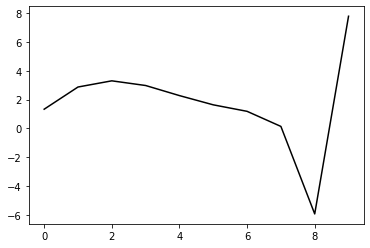

427900 27.963394390409047
0.31944815437724694 -0.14916491171373258 -0.25910565926219203 -0.13638460107634912
[ 1.24737533  2.82464495  3.2434855   2.91006428  2.20298083  1.55695065
  1.10250207  0.05200323 -6.02603557  7.81237205]


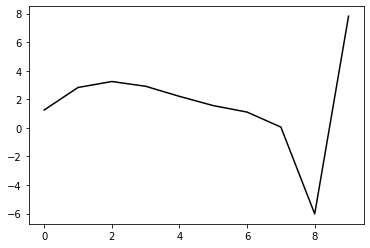

429000 18.160747601680377
0.3201993082811865 -0.15302897720575095 -0.2617618087383338 -0.13516559993815594
[ 1.28300971  2.85336749  3.26942572  2.93322941  2.22297438  1.57368973
  1.11647356  0.06383557 -6.01434477  7.764439  ]


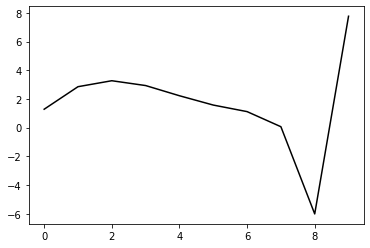

430100 22.642807826786964
0.3170370709860316 -0.1499201770013764 -0.25846653933391855 -0.1385690508226803
[ 1.35102124e+00  2.78397938e+00  3.20251138e+00  2.86881072e+00
  2.16070147e+00  1.51314385e+00  1.05740906e+00  5.84047500e-03
 -6.07071887e+00  7.82458775e+00]


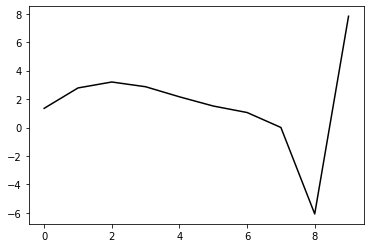

431200 22.428511252212754
0.31637830101931774 -0.14595336595223254 -0.25571549144470196 -0.13956636115413046
[ 1.32318206e+00  2.81921600e+00  3.22997889e+00  2.88934389e+00
  2.17553408e+00  1.52303598e+00  1.06281092e+00  6.55448217e-03
 -6.07581149e+00  7.75159871e+00]


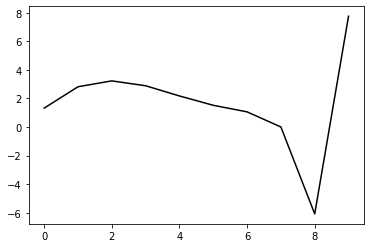

432300 20.9888286015479
0.3189693148733129 -0.15014826631968337 -0.2596788929224095 -0.1367399567250955
[ 1.29758875  2.83585541  3.25817129  2.92700136  2.22118028  1.57565625
  1.12197271  0.07170715 -6.00482265  7.80564171]


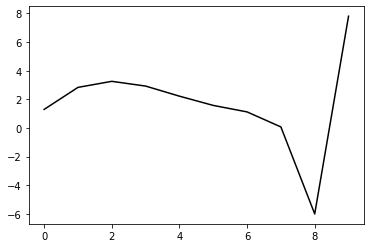

433400 15.046103460254455
0.31420446055433876 -0.1482315258978801 -0.25722905352054287 -0.1382389017837863
[ 1.33403231  2.74263938  3.16931114  2.84463826  2.14546071  1.50607513
  1.05806201  0.01255265 -6.05987281  7.77806623]


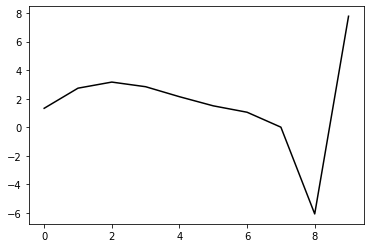

434500 21.9040395782523
0.3171609940529347 -0.14708653983217937 -0.2574144376568635 -0.13788021580386317
[ 1.29979193  2.83029738  3.25334334  2.9238922   2.21975671  1.57535712
  1.12237823  0.07155881 -6.00649632  7.80995111]


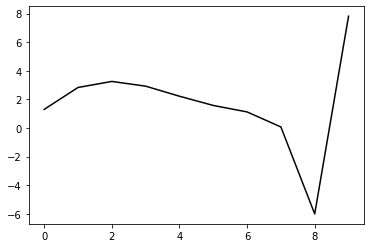

435600 24.416927516727743
0.3169439638835902 -0.1480493454829695 -0.25828324202453407 -0.137218766490381
[ 1.30057457  2.84324195  3.26869889  2.94112534  2.23837091  1.59503357
  1.14317251  0.09332475 -5.98325945  7.82066903]


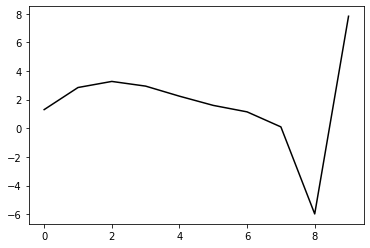

436700 14.453565633481015
0.3117506798394717 -0.14898418453010098 -0.25783353939712345 -0.139363440288607
[ 1.36796405  2.7820462   3.2209126   2.90537609  2.2131806   1.57921396
  1.13589787  0.09350689 -5.9759701   7.80593042]


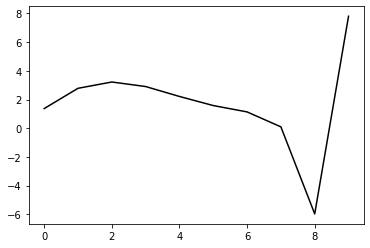

437800 23.80327741278204
0.31441375265717764 -0.1479704068985998 -0.2581916077303551 -0.13816017528639224
[ 1.29679762  2.80904074  3.23657189  2.91087956  2.20986321  1.56815309
  1.11810076  0.06947919 -6.005959    7.78661695]


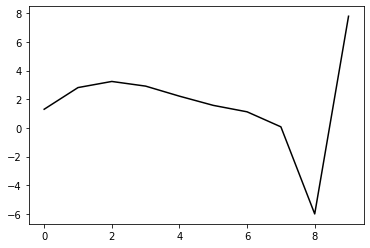

438900 13.05880514943291
0.31585131441269143 -0.14565959975775314 -0.2570515687780996 -0.1389935718987147
[ 1.31374673  2.93048936  3.36596416  3.04569186  2.34789966  1.70758153
  1.25740866  0.20683401 -5.87336448  7.82956606]


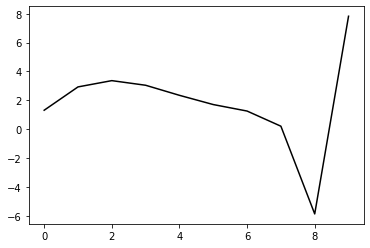

440000 16.62861805833728
0.3129883065353573 -0.14990873094865423 -0.2596950616759442 -0.13576594864841993
[ 1.32672392  2.78744855  3.2171717   2.89352745  2.19445675  1.55456225
  1.10650189  0.05925029 -6.01532685  7.77064948]


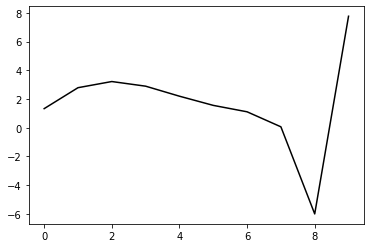

441100 20.66558945055429
0.3162710335632733 -0.1434333836342354 -0.2564380768053472 -0.13661369928201714
[ 1.35334242  2.83397931  3.26148675  2.93517184  2.23318674  1.58985908
  1.13767971  0.08496456 -5.99712096  7.81926101]


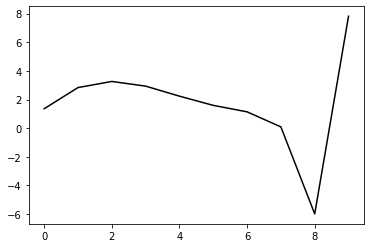

442200 24.96250332513037
0.30623620119633865 -0.14718226781327357 -0.2561727361709348 -0.138819440827147
[ 1.36268116  2.69139877  3.11919177  2.79498505  2.09611904  1.45671098
  1.00947149 -0.03763154 -6.11338679  7.72270981]


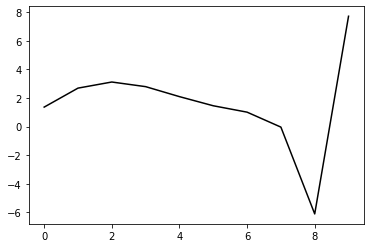

443300 24.87584499250894
0.3057180302119002 -0.14803168397683156 -0.25647341377289323 -0.13874249651414378
[ 1.33179918  2.67311819  3.08993142  2.7563628   2.04893697  1.40173097
  0.94781255 -0.10491113 -6.18483734  7.7908429 ]


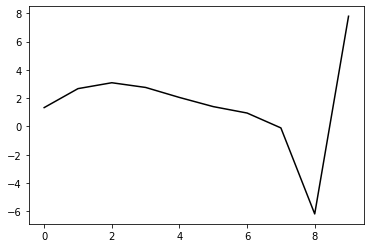

444400 14.487923675643243
0.31320261114414477 -0.14664605130607813 -0.25714200383797076 -0.13732493385141248
[ 1.32134677  2.85544586  3.26671378  2.92597123  2.21039011  1.55451704
  1.09199037  0.03092689 -6.05499781  7.77595499]


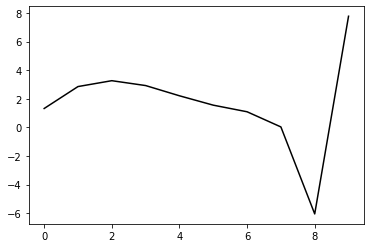

445500 22.917441403137254
0.31721597756065256 -0.14221602180948764 -0.25482775915338124 -0.1399733579293754
[ 1.33074965  2.99068862  3.40656434  3.06691963  2.35106679  1.69425641
  1.23080477  0.16874949 -5.91908547  7.78232708]


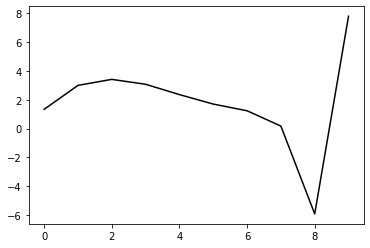

446600 25.413158817329553
0.3138743975161506 -0.15087793518676001 -0.2601165517383164 -0.13598945323965222
[ 1.29412593e+00  2.84748986e+00  3.25266593e+00  2.90536108e+00
  2.18408028e+00  1.52338750e+00  1.05768897e+00 -5.09597469e-03
 -6.09009887e+00  7.76280134e+00]


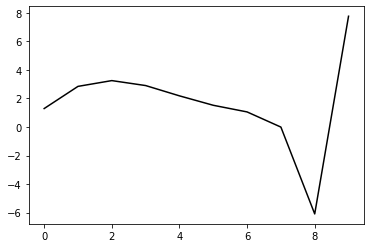

447700 15.54993702957206
0.3137922464498844 -0.14466368402114868 -0.2553750090710265 -0.14068871199003685
[ 1.35705156  2.89456754  3.3077116   2.96590549  2.24877057  1.59132996
  1.12844393  0.06789752 -6.01496548  7.8021586 ]


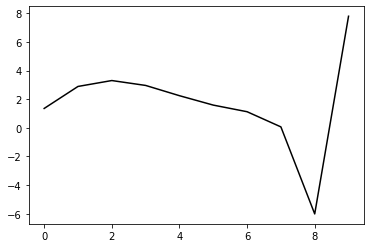

448800 21.745696368176162
0.31327817778286776 -0.14720935165919152 -0.25717045775407205 -0.14150552738049035
[ 1.33401746  2.91503175  3.33685104  3.00044654  2.28715868  1.63274725
  1.17274121  0.1148125  -5.96541578  7.78809929]


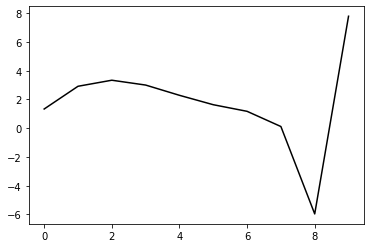

449900 16.437885750302915
0.31160528546124927 -0.15419976894993123 -0.2622099955333012 -0.13523423487784691
[ 1.33114727  2.72232445  3.13370466  2.79028158  2.07281809  1.41631861
  0.95601881 -0.10106622 -6.17954421  7.78582156]


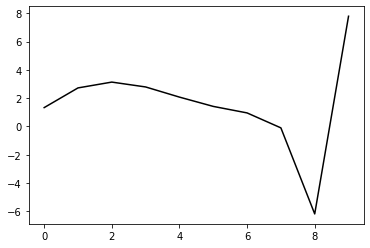

451000 18.44294360416546
0.3153455610259822 -0.15459324389024826 -0.2632043754577447 -0.13700850335995182
[ 1.2817528   2.88036165  3.29835688  2.95959788  2.24557586  1.59181008
  1.13404832  0.07931757 -5.99495293  7.76414449]


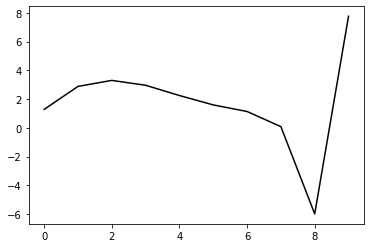

452100 24.23098267725281
0.3107077087332869 -0.14978395004405018 -0.25835728443588496 -0.1395143613564132
[ 1.37185442  2.75661173  3.16936021  2.82770928  2.11201931  1.45703764
  0.99818573 -0.0579876  -6.13384877  7.81261527]


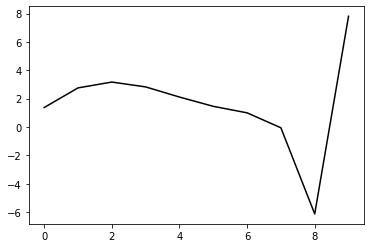

453200 25.392678538901162
0.3084956245515114 -0.14682722129497924 -0.2555921210598547 -0.14164897968258158
[ 1.34760807  2.7875202   3.19718588  2.85268219  2.13429466  1.4765809
  1.01495703 -0.04428828 -6.12284749  7.7484802 ]


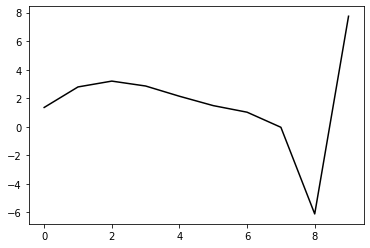

454300 24.170256217277984
0.31036967546279265 -0.1472063115455663 -0.25649204584876834 -0.1408063563417792
[ 1.33029796e+00  2.83105250e+00  3.24286715e+00  2.89935713e+00
  2.18128525e+00  1.52343655e+00  1.06155163e+00  1.84513961e-03
 -6.07646215e+00  7.79897581e+00]


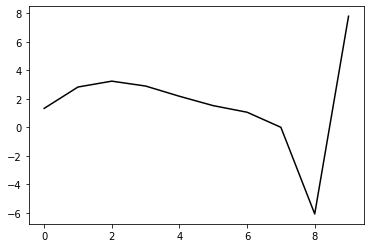

455400 14.189542271251923
0.3137304100710163 -0.1459839080457719 -0.256784478803652 -0.13965219491960099
[ 1.30499621  2.91612654  3.32209547  2.97299551  2.25045536  1.58890156
  1.12387261  0.06104517 -6.0205126   7.75538075]


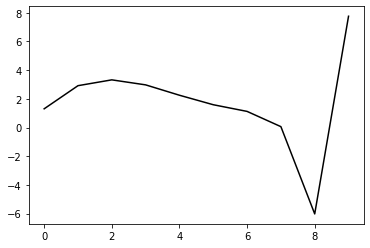

456500 21.93328048203433
0.31335872580026264 -0.1472966950461421 -0.25776126600377447 -0.14115220322924912
[ 1.32704636  2.941499    3.36839703  3.03597336  2.32714386  1.67716896
  1.22236993  0.16838846 -5.90563955  7.82119697]


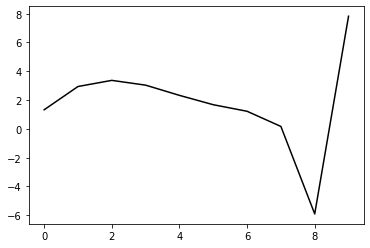

457600 24.56855675724336
0.31467373350041833 -0.14719426331628735 -0.2585632412926219 -0.13903380903242743
[ 1.28424634  2.95086541  3.37627043  3.04166571  2.33081385  1.67882279
  1.22194152  0.16524979 -5.91242607  7.79813678]


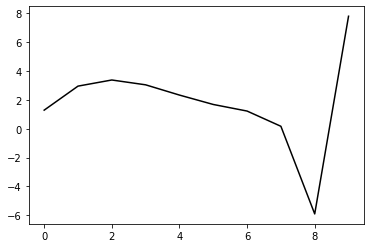

458700 13.86335983291439
0.3124337153887267 -0.14815818546149184 -0.25873532566160384 -0.13891076962917132
[ 1.33167755  2.88049118  3.30534436  2.97211415  2.26378116  1.61496536
  1.16173893  0.10848545 -5.96602429  7.73022824]


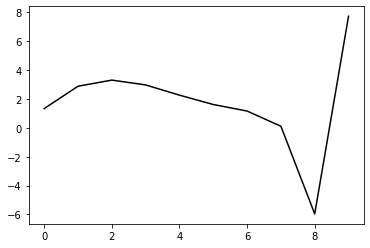

459800 26.469926601089902
0.3094648261464173 -0.14470108436904386 -0.25533843333387785 -0.1419148855093183
[ 1.35470999  2.89795149  3.31586756  2.97775549  2.26600611  1.61467032
  1.15956973  0.10465161 -5.97013517  7.7805376 ]


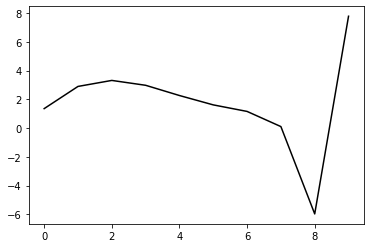

460900 20.406870478289914
0.3145051673300491 -0.1487975637595271 -0.2596769786265408 -0.138070301278559
[ 1.26237184  2.87394251  3.28332936  2.93869188  2.22196481  1.56675674
  1.10882001  0.05179385 -6.02363101  7.80915521]


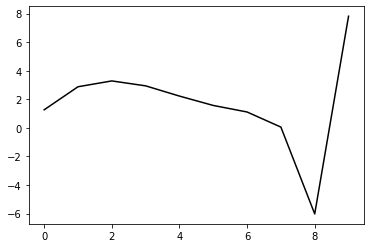

462000 17.374803285996755
0.31488297833224643 -0.15226005501232953 -0.2624254182333823 -0.13610038746291978
[ 1.28887409  2.81470472  3.24045938  2.90935512  2.20354736  1.55731457
  1.10707889  0.05649819 -6.01309873  7.76645351]


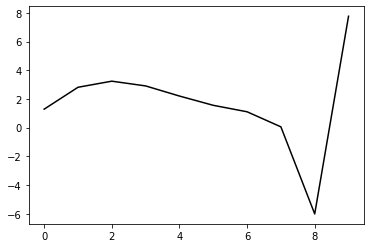

463100 25.37958288622037
0.30971383572704103 -0.15083670390622175 -0.2600148777840361 -0.13831557789477975
[ 1.37504214  2.66946315  3.10374134  2.78124135  2.082706    1.44240807
  0.99712519 -0.04963833 -6.11657591  7.81659114]


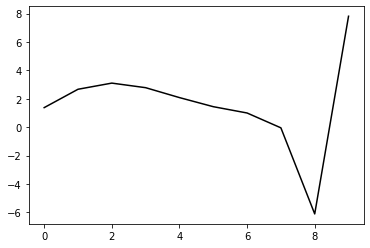

464200 26.851328268790475
0.30671485698436257 -0.14582957829864532 -0.2553673701089045 -0.14185152611680565
[ 1.35471986  2.71905935  3.14336952  2.81243936  2.10637759  1.45917674
  1.00753967 -0.04533225 -6.11724461  7.75176615]


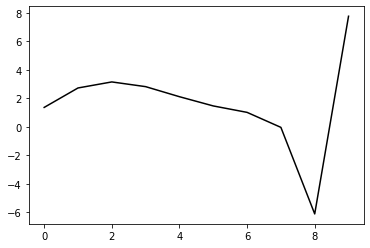

465300 24.017004040655067
0.31007812389573813 -0.14637535658716913 -0.2567121344572463 -0.14043592757484277
[ 1.32591001  2.80522428  3.22585667  2.8910908   2.18109262  1.52999905
  1.07478236  0.01859754 -6.05509991  7.7998877 ]


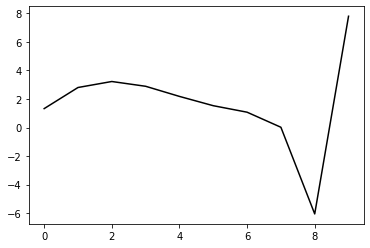

466400 14.173944755530622
0.3130118526229179 -0.1482698533528356 -0.25903390661434744 -0.13965709995958012
[ 1.33640762  2.85721504  3.2951581   2.97399591  2.27495048  1.63300433
  1.185813    0.13646381 -5.93154942  7.76906016]


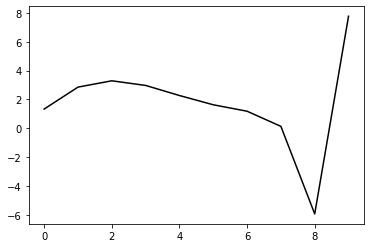

467500 22.324157925363217
0.3104782846462972 -0.14764760087679576 -0.25828727019426295 -0.14090906044320817
[ 1.32679357  2.82310079  3.26043895  2.94025359  2.24354173  1.60465947
  1.16084938  0.1143003  -5.95227026  7.80812569]


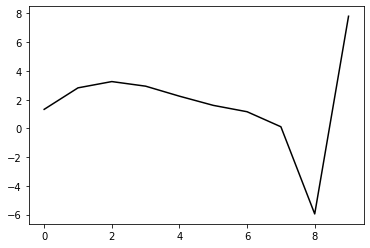

468600 25.86088169944104
0.31184915905449817 -0.15286520348118068 -0.2627119844102648 -0.13540788106951257
[ 1.30416785  2.78517936  3.20713459  2.8768467   2.17345244  1.52998255
  1.08287428  0.03336481 -6.03590255  7.77979601]


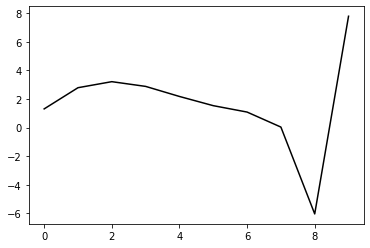

469700 13.266858314681727
0.3138644028658677 -0.14628058289565 -0.2580421800399762 -0.13958405959584713
[ 1.3412444   2.8594592   3.27987281  2.94707696  2.24068893  1.59406648
  1.14403961  0.09185433 -5.97899394  7.80344911]


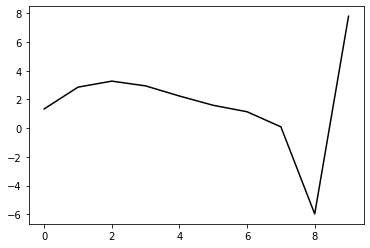

470800 22.982824013382018
0.3129106136619094 -0.14473672480805613 -0.2565759667340631 -0.14182583394930592
[ 1.34261549  2.89456216  3.31815382  2.98733874  2.28207063  1.63605029
  1.18650668  0.13458694 -5.93598709  7.79574294]


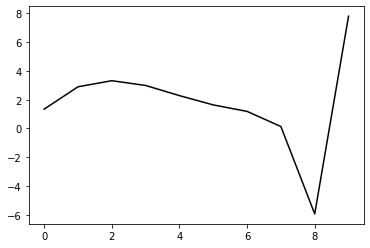

471900 14.535519680579455
0.31465823178697694 -0.14918480152237237 -0.260624457144775 -0.13916694698001902
[ 1.30382216  2.87342299  3.30812871  2.98659316  2.28919355  1.64992912
  1.20638582  0.15940528 -5.90740561  7.80896504]


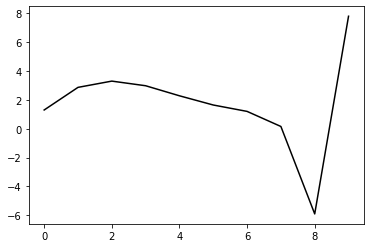

473000 16.83526836133051
0.3126304003190967 -0.15085295680100358 -0.2616018242600569 -0.13736185003456938
[ 1.32720457  2.78929967  3.21719706  2.89093574  2.19057324  1.54971001
  1.10582002  0.05906119 -6.00702843  7.75779443]


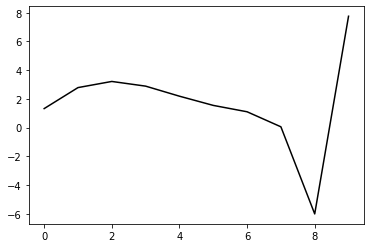

474100 21.39657619774095
0.3160815939699533 -0.14689488144365911 -0.2598979275431641 -0.13682711207880527
[ 1.32391327  2.82662826  3.24699419  2.91408432  2.2079187   1.56156044
  1.11209882  0.05889767 -6.01545037  7.83896126]


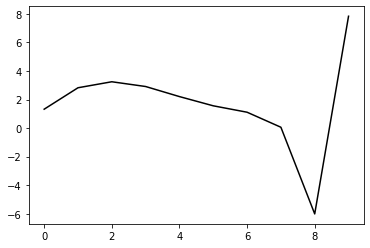

475200 22.595525710081162
0.3153327763463243 -0.14599621356959702 -0.2592869027697352 -0.13674169910675524
[ 1.33696086  2.80825909  3.23263441  2.90313464  2.20000495  1.55632341
  1.10936848  0.05808092 -6.01476384  7.79340859]


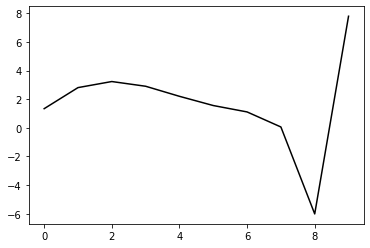

476300 20.9358026390102
0.3152725827671169 -0.14629407581822745 -0.2599313602434165 -0.13521214004706525
[ 1.31529777  2.80989902  3.2418872   2.91783209  2.21868309  1.57795722
  1.13341408  0.08382394 -5.98777279  7.78556062]


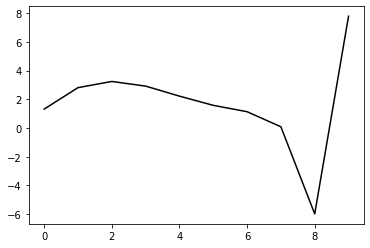

477400 14.362207049922809
0.3139428681175728 -0.14723789533723822 -0.26000582356048063 -0.13682935619853095
[ 1.35043898  2.84219476  3.27730464  2.95593623  2.2586482   1.61931907
  1.17635568  0.12859195 -5.93938409  7.80639922]


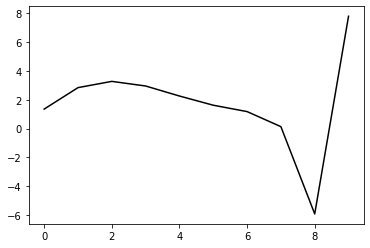

478500 22.25329516986203
0.3113835306074172 -0.15304726818882156 -0.2634813531510954 -0.1337412671756069
[ 1.3063141   2.72701218  3.14116504  2.80564427  2.0989032   1.45335236
  1.00669284 -0.04309577 -6.11209837  7.76934098]


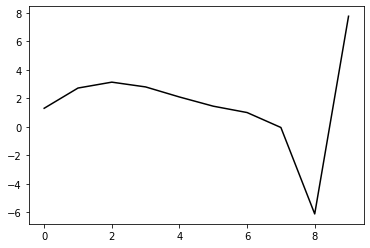

479600 24.91753803341834
0.31742491248064714 -0.1468115979523289 -0.26003253990365693 -0.13547215725397707
[ 1.30648379  2.87915948  3.2824416   2.93532123  2.21703749  1.56023383
  1.10291745  0.04310567 -6.0341079   7.78484892]


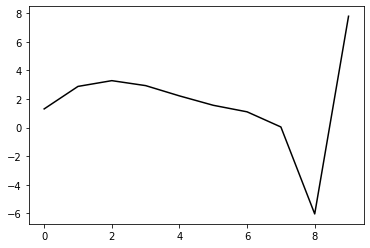

480700 13.606872554466939
0.31612299843498093 -0.14467807654494985 -0.25799386100683036 -0.13906453772065966
[ 1.35686262  2.89224801  3.30824745  2.97079967  2.2600512   1.60934666
  1.15735496  0.10214607 -5.97057952  7.80740333]


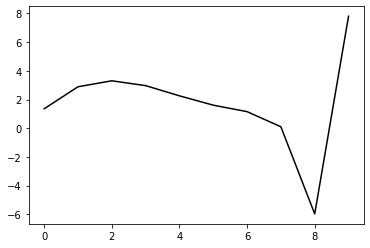

481800 22.042450283616017
0.3180210359116082 -0.14203055165712472 -0.2566222784818255 -0.13922865562687803
[ 1.32508174  2.91644052  3.32287383  2.97696943  2.25978004  1.60415272
  1.14870371  0.09101312 -5.98370857  7.75873224]


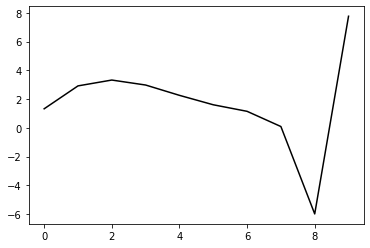

482900 12.980265616608495
0.3166227573426976 -0.14402921664597088 -0.25791593393927437 -0.1391930068514039
[ 1.32881415  2.93174366  3.34964373  3.01195204  2.30118086  1.65063526
  1.19942989  0.14492766 -5.92732311  7.7970503 ]


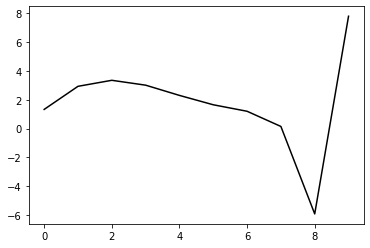

484000 19.698059271290152
0.3189741851565921 -0.15178970312283116 -0.26414732373485805 -0.13377462929448955
[ 1.28410119  2.82409203  3.23560223  2.89471922  2.18272709  1.53234195
  1.08282634  0.03131142 -6.03457811  7.76170782]


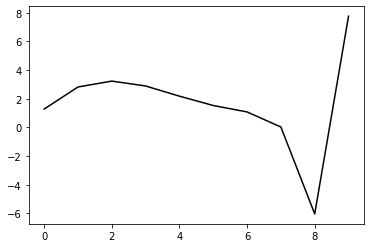

485100 23.087045463314894
0.3149511142026642 -0.14706094459958952 -0.2590467757804189 -0.13894524471191796
[ 1.37630703  2.79334741  3.19587421  2.84747193  2.12892485  1.47268191
  1.01803247 -0.03802948 -6.10638655  7.80955372]


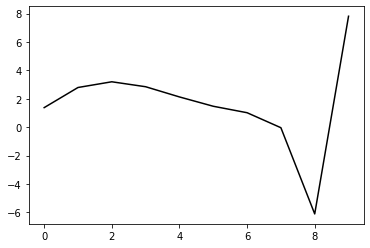

486200 23.71905388791415
0.31426990058436566 -0.1451171757957067 -0.25737676223800277 -0.140048177164233
[ 1.34768419  2.83044246  3.22870755  2.87614995  2.15378056  1.49397224
  1.03608541 -0.02308707 -6.09407678  7.75390322]


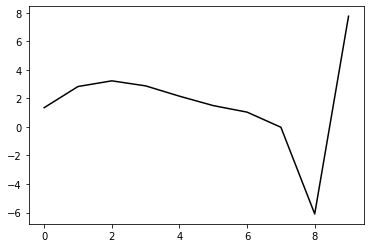

487300 22.147926946827223
0.3210004674957548 -0.1415209451065688 -0.25673583233206376 -0.13885775091740662
[ 1.29902151  2.9784937   3.37098453  3.01181634  2.28332687  1.61781073
  1.15463803  0.09022111 -5.98678815  7.79285858]


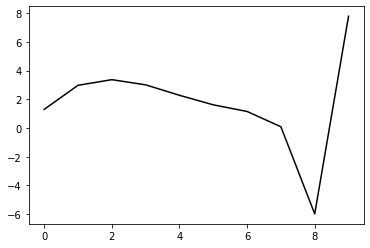

488400 15.088895831199284
0.3169015168244319 -0.14504101116084758 -0.2582037174585214 -0.1395078367606833
[ 1.35814951  2.90509516  3.31493021  2.97035152  2.25446533  1.60020419
  1.14783017  0.0939296  -5.97148546  7.79163837]


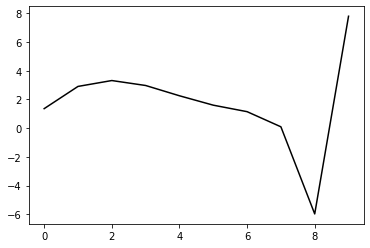

489500 21.989318929148176
0.3190139910411867 -0.14276062343504548 -0.2574243497092164 -0.13846764735062828
[ 1.31824954  2.92104237  3.3271144   2.97725196  2.25599472  1.59633401
  1.13866584  0.07916605 -5.99270206  7.78785381]


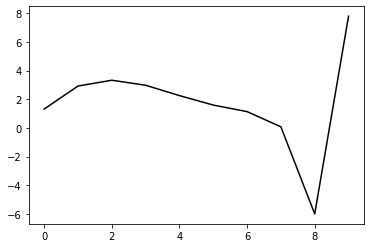

490600 26.433687139427263
0.31525726742722643 -0.15266943647209236 -0.2637765902287745 -0.13589325315933592
[ 1.30828701  2.80951848  3.21229358  2.86082866  2.14016646  1.48299416
  1.02981435 -0.02363635 -6.08683679  7.77407197]


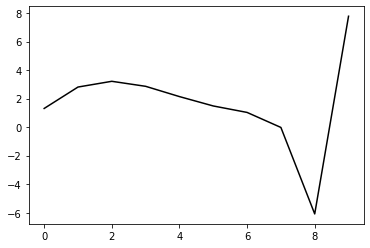

491700 13.237637032409227
0.3196732930792695 -0.14384404621318814 -0.2582620397043795 -0.1390092450343507
[ 1.34608029  2.93805496  3.34524448  2.99404694  2.27140243  1.61076159
  1.15317873  0.09427159 -5.97552734  7.8109146 ]


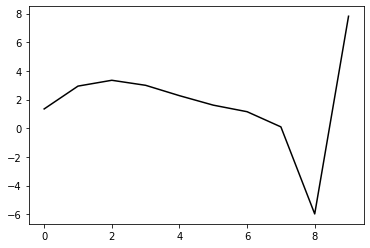

492800 25.02522016542114
0.31563174326828947 -0.14405395968772605 -0.25721927501003355 -0.1417080643597066
[ 1.36058807  2.94999777  3.35705307  3.0057452   2.28304508  1.62250696
  1.16554843  0.10770571 -5.95986433  7.78838763]


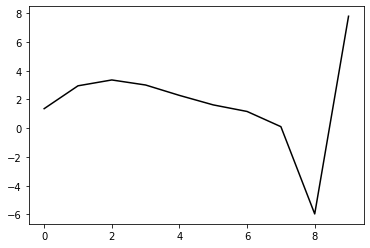

493900 18.961478072486624
0.3187674781654325 -0.1478773786303614 -0.26095001515158983 -0.1378948025436038
[ 1.27458742  2.9012998   3.29663456  2.93663744  2.20724449  1.54122306
  1.07967263  0.01776015 -6.05188542  7.81987511]


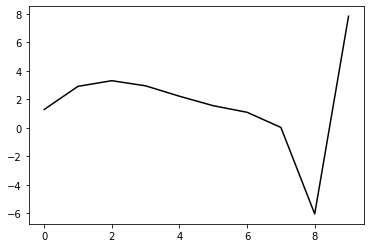

495000 17.919459276409196
0.3211709358784377 -0.15094101240399593 -0.2637298031177504 -0.13568658853541923
[ 1.29097619  2.92218016  3.32038575  2.96200801  2.23340179  1.56767045
  1.10631315  0.04452817 -6.02389286  7.75636627]


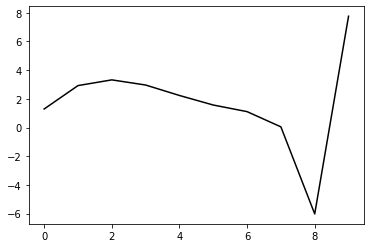

496100 22.44492566632186
0.3176808481764551 -0.14674088675666697 -0.2596433395769652 -0.13920807755704542
[ 1.37094847  2.82823626  3.22839863  2.87232457  2.14622456  1.48291657
  1.02385726 -0.03608014 -6.10269764  7.81841553]


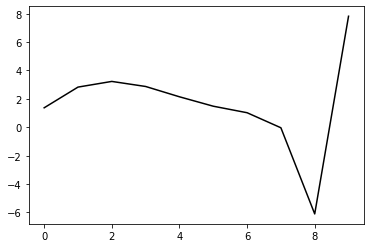

497200 22.9433708844577
0.31797881015891005 -0.14874392279837226 -0.261501545695779 -0.13801278788216617
[ 1.31971944e+00  2.84701141e+00  3.25291334e+00  2.90135178e+00
  2.17909444e+00  1.51903842e+00  1.06274298e+00  4.76152168e-03
 -6.06065920e+00  7.76080754e+00]


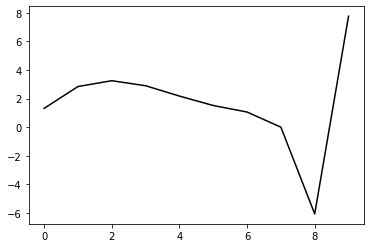

498300 23.649828233572062
0.3145485197825004 -0.14709974167424952 -0.2595038486662572 -0.13886453564177142
[ 1.33390242  2.77618398  3.18583102  2.83840746  2.12004242  1.46347166
  1.01042008 -0.04481634 -6.10786719  7.78226464]


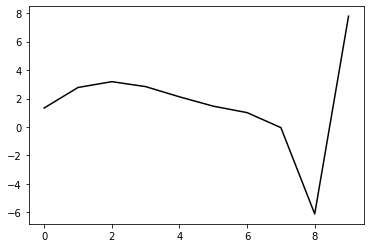

499400 14.912559554049748
0.3129518430921766 -0.14816287756130567 -0.25979688690687325 -0.1400311995055426
[ 1.32952956  2.7869416   3.20312786  2.86080577  2.14594767  1.49174218
  1.04044915 -0.01356062 -6.07459202  7.76684421]


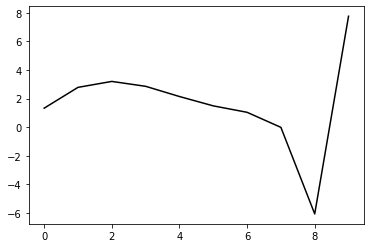

In [24]:
optimizer=tf.optimizers.Adam(learning_rate=0.0005)
for j in range (5000):    
    with tf.GradientTape() as g:
        loss=Error_func(h, m2, lam, alpha, beta, Positive[j%10], Negative[j%10])
        gradients=g.gradient(loss, [h, m2, lam, alpha, beta])
        if np.isnan(loss)==True: break
    for i in range (90):
        optimizer.apply_gradients(zip(gradients, [h]))
        if any(np.isnan(h.numpy()))==True: break
    for i in range (10):
        optimizer.apply_gradients(zip(gradients, [h, m2, lam, alpha, beta]))
        if any(np.isnan(h.numpy()))==True: break
    if j%11==0: 
        print(j*100, Error_func(h, m2, lam, alpha, beta, Positive[j%10], Negative[j%10]).numpy())
        print(m2.numpy(), lam.numpy(), alpha.numpy(), beta.numpy()), print(h.numpy())
        plt.plot(h.numpy(), 'k-'), plt.show()

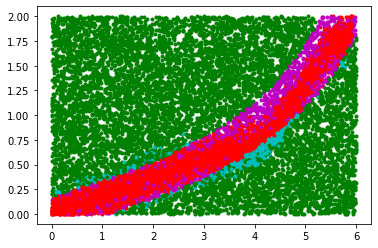

In [25]:
for i in range (set):
    [Positive0[i], Positive1[i]]=NN_func_01(h, m2, lam, alpha, beta, Positive[i])
    [Negative0[i], Negative1[i]]=NN_func_01(h, m2, lam, alpha, beta, Negative[i])
for i in range (set):
    x_data1[i]=[v[0] for v in Positive0[i]]
    y_data1[i]=[v[1] for v in Positive0[i]]
    x_data2[i]=[v[0] for v in Positive1[i]]
    y_data2[i]=[v[1] for v in Positive1[i]]
    x_data3[i]=[v[0] for v in Negative0[i]]
    y_data3[i]=[v[1] for v in Negative0[i]]
    x_data4[i]=[v[0] for v in Negative1[i]]
    y_data4[i]=[v[1] for v in Negative1[i]]
    plt.plot(x_data4[i], y_data4[i], 'g.')
    plt.plot(x_data2[i], y_data2[i], 'c.')
    plt.plot(x_data1[i], y_data1[i], 'r.')
    plt.plot(x_data3[i], y_data3[i], 'm.')
plt.show()

0 33.161751030132464
0.31033043079990363 -0.13951161231342407 -0.25257873582321394 -0.14712470594871885
[ 1.3222393   2.92517522  3.32859883  2.97474913  2.24974519  1.58658958
  1.12747282  0.06663312 -5.99986973  7.76745584]


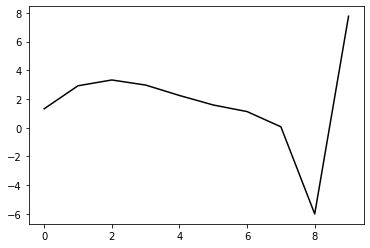

1100 38.75748891087518
0.31862799850346063 -0.15534781781088466 -0.2650579530203572 -0.13321736491097705
[ 1.24342929  2.74307186  3.13885813  2.77834004  2.04758841  1.37946617
  0.91607533 -0.14862326 -6.21891434  7.75886163]


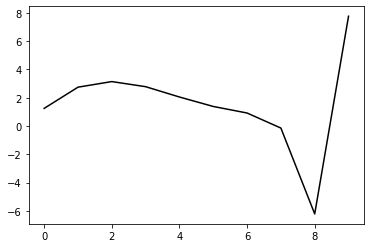

2200 26.560791464903897
0.31223156429822946 -0.14463261954852305 -0.25451885905640004 -0.14937374740605555
[ 1.30646074  2.7562349   3.15829843  2.80224894  2.07460093  1.40879498
  0.94734886 -0.1157381  -6.18396107  7.7403735 ]


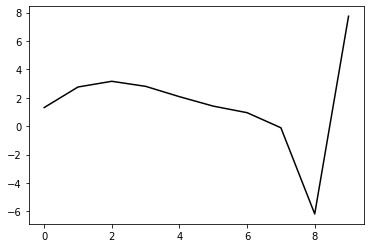

3300 23.959057537080028
0.3140034250841377 -0.14795737142586593 -0.25740869207416284 -0.14711351778583248
[ 1.28962924  2.75385584  3.15508628  2.79800424  2.06920951  1.40226473
  0.93991476 -0.12393823 -6.19256278  7.77571301]


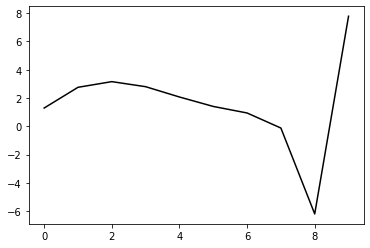

4400 17.369755886482356
0.3130628982803606 -0.15229238260629513 -0.26038014636089457 -0.1455549662563317
[ 1.28016265  2.73385866  3.13752924  2.78232358  2.05477947  1.38869452
  0.92713567 -0.13602787 -6.20322331  7.75494453]


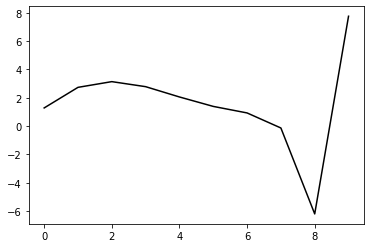

5500 22.800125512930784
0.3164218413997175 -0.1558167444224791 -0.263442330527715 -0.14332190969821895
[ 1.26591358  2.7411494   3.13668475  2.77416763  2.03988066  1.36759621
  0.90057829 -0.16732429 -6.23765898  7.77303828]


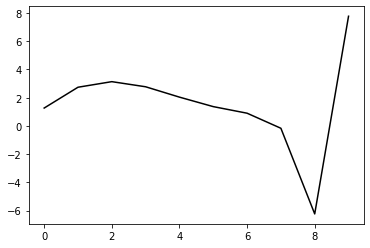

6600 24.91058621131872
0.32420722559834975 -0.14934885697895517 -0.2598514340335876 -0.14549403582318818
[ 1.26718774  2.88148901  3.26797957  2.89599921  2.15248048  1.47126188
  0.99582368 -0.07999297 -6.15706997  7.76005056]


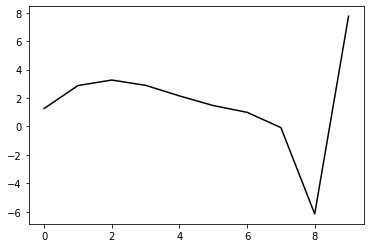

7700 13.194468530145949
0.32321939668915917 -0.14709653121075336 -0.25773908779143057 -0.14933018391200006
[ 1.30079201  2.890844    3.28758269  2.92323292  2.18591578  1.50993343
  1.03913628 -0.03279403 -6.1064478   7.78719249]


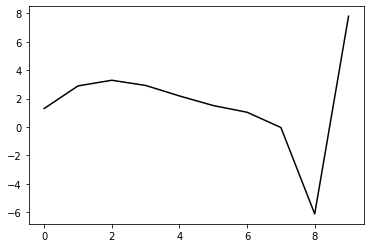

8800 27.583411762009103
0.31741183908619924 -0.14616499695830268 -0.25526916895770574 -0.15197441491489735
[ 1.32736011  2.84450113  3.24110576  2.87607107  2.13706052  1.45869066
  0.98543261 -0.08875425 -6.16289075  7.74772886]


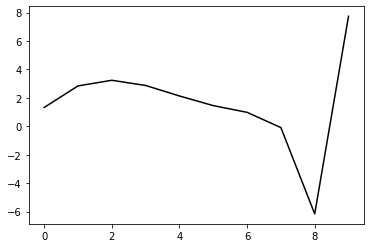

9900 16.97547505733905
0.32569068422002384 -0.14906049367530913 -0.2593768668572544 -0.1483700590041093
[ 1.23386484  2.8760341   3.26463737  2.89268725  2.14800183  1.46490519
  0.9878256  -0.0895701  -6.16586035  7.79985483]


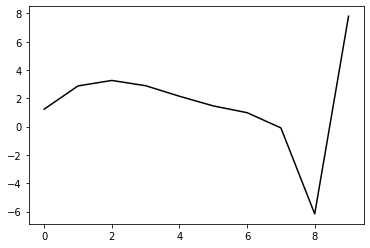

11000 17.485543883634993
0.3277418473702432 -0.15191781491906003 -0.26203797750987295 -0.1460560803897589
[ 1.25700439  2.86612456  3.26221129  2.89601833  2.15628318  1.47758772
  1.00457373 -0.06936899 -6.14237417  7.73933941]


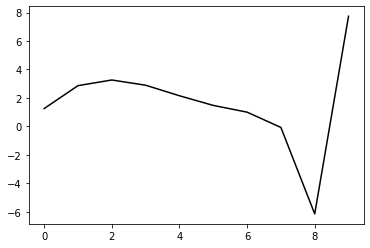

12100 22.380799761120297
0.32419278351420383 -0.1513808117334517 -0.2610141695951954 -0.14661189663695093
[ 1.30019955  2.72127502  3.13197848  2.77923963  2.05138374  1.38296277
  0.91874287 -0.14824607 -6.21642139  7.79284475]


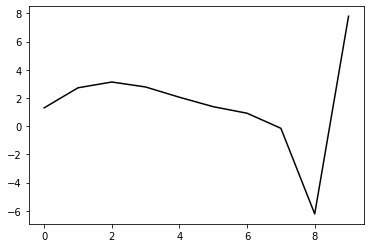

13200 24.839493972469423
0.3174413271527712 -0.14933428355480113 -0.2580362564252772 -0.14987389089407416
[ 1.32364055  2.64878054  3.07380829  2.73393443  2.01654437  1.35641815
  0.89864483 -0.16385594 -6.22896984  7.7262866 ]


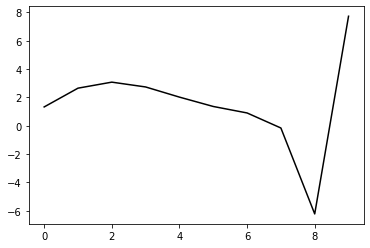

14300 21.247144757585318
0.32598263237389363 -0.149615748779288 -0.26089787534697056 -0.14609401152163465
[ 1.2610744   2.80318637  3.22750915  2.88611699  2.16671596  1.50410081
  1.04323615 -0.02342317 -6.09380582  7.79251761]


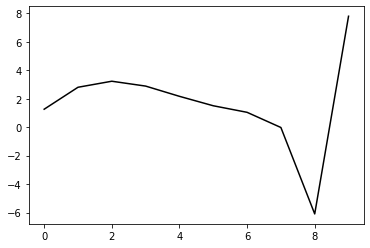

15400 18.01554841100547
0.3231678090159684 -0.14604767129373739 -0.25798539207735177 -0.14842916959551306
[ 1.34201295e+00  2.77111902e+00  3.20736644e+00  2.87625652e+00
  2.16582458e+00  1.51111731e+00  1.05722604e+00 -3.91943883e-03
 -6.07070596e+00  7.75943636e+00]


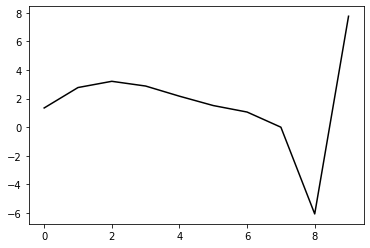

16500 22.81435854295007
0.3256338465853973 -0.1459510464373311 -0.2589612309627734 -0.14675280760512707
[ 1.26762091  2.82980354  3.2632574   2.92909376  2.21543951  1.55716044
  1.09910728  0.03243394 -6.04259487  7.81384824]


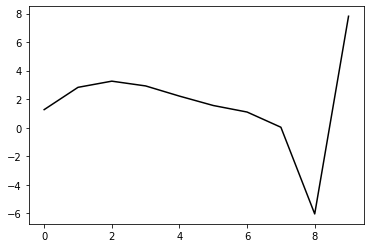

17600 24.783094353646696
0.32665966732774515 -0.14845570863801247 -0.26156129878214884 -0.14499332999050724
[ 1.27599715  2.82280195  3.26497233  2.93997215  2.23532557  1.58558055
  1.13526531  0.0745121  -5.9974092   7.78078258]


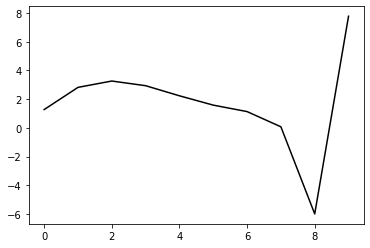

18700 14.853009881119155
0.32485228828944973 -0.1460905330136178 -0.25973358750887515 -0.14712033096709426
[ 1.34297889  2.7990352   3.25321058  2.94040678  2.24710336  1.60757986
  1.16619201  0.11215845 -5.95681536  7.82220352]


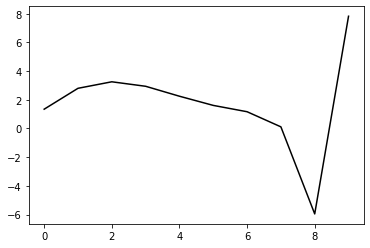

19800 23.861581337124957
0.32114167818735734 -0.147459418735178 -0.2604282832632408 -0.1445269278090825
[ 1.2905567   2.68997989  3.12090351  2.78898564  2.08008122  1.42803288
  0.97674813 -0.08573581 -6.16437356  7.74818579]


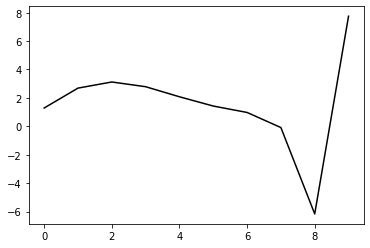

20900 20.86546209192653
0.3251060937264182 -0.1486147223685362 -0.26210956385163625 -0.1435425080022209
[ 1.25120788  2.78187184  3.20952794  2.87494193  2.16334044  1.50869196
  1.05520132 -0.00919928 -6.08778586  7.78038492]


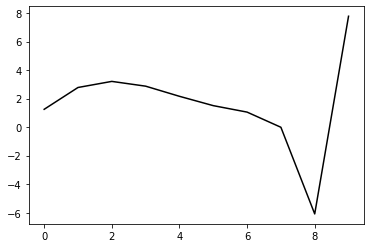

22000 18.608387883535052
0.32847866895335515 -0.15130841820317387 -0.2646488571638968 -0.1402375129401515
[ 1.26832607  2.81762483  3.23739094  2.89672533  2.17946686  1.51938299
  1.06082252 -0.00833213 -6.09024584  7.75573972]


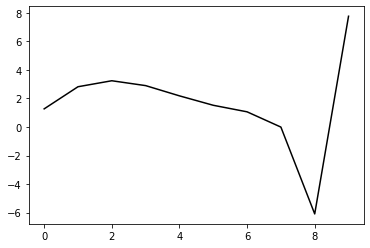

23100 22.064412939547623
0.3270488788634971 -0.14679967194168683 -0.2610225114730808 -0.1433284495944627
[ 1.32068426  2.78561236  3.20505281  2.86484288  2.14822917  1.48864746
  1.03025757 -0.03946077 -6.12257585  7.81271312]


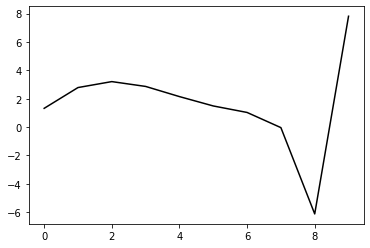

24200 22.370906422084825
0.3276264503205971 -0.14684747278562296 -0.26145442730444274 -0.14253288109910764
[ 1.28190202  2.80979349  3.22828935  2.88679649  2.16874492  1.50767423
  1.04793725 -0.0232243  -6.10808415  7.76580477]


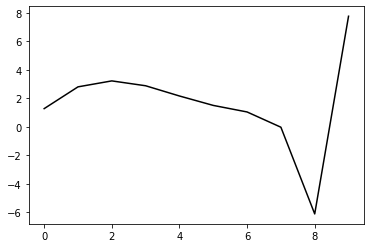

25300 21.45065621806352
0.3277109438199619 -0.14547400559425197 -0.260797035822315 -0.141708312667697
[ 1.30259086  2.80829126  3.22716937  2.88525568  2.16653208  1.50472886
  1.04437047 -0.02769546 -6.1141043   7.77782892]


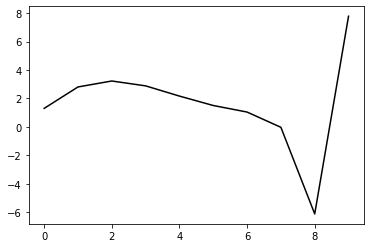

26400 14.552569251394988
0.3243861036229004 -0.14477061997305166 -0.2597160569216579 -0.142655841800114
[ 1.31988664  2.79962702  3.21918748  2.87712738  2.15770218  1.49483398
  1.03325339 -0.04053407 -6.12894571  7.76227093]


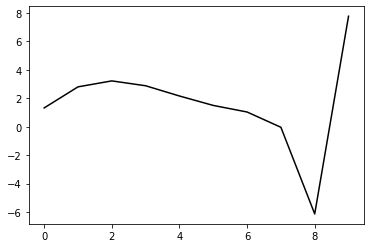

27500 24.006978377937642
0.32691080141586926 -0.14550073957565773 -0.26098926496364744 -0.14281227717169792
[ 1.27259468  2.85271003  3.28064697  2.94520267  2.23095266  1.57225657
  1.1143039   0.04339435 -6.04272823  7.80605483]


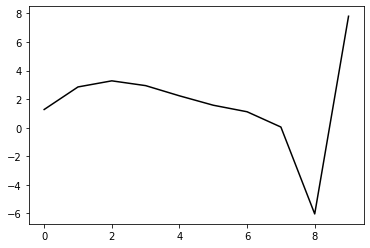

28600 25.44590366498573
0.3274730748326147 -0.14757358942448132 -0.2628938469232175 -0.14176139538565444
[ 1.27635722  2.87805717  3.31016619  2.97842068  2.26704241  1.61028654
  1.15340215  0.08214863 -6.0069295   7.78856507]


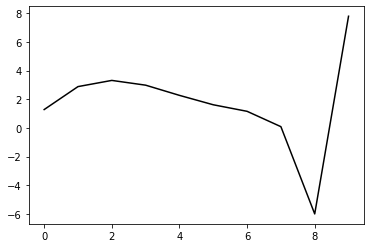

29700 14.041561895780369
0.32554015768166394 -0.14477133187623165 -0.26053870659283085 -0.14301084227371402
[ 1.36077799  2.80071744  3.23985668  2.91522189  2.21059697  1.56012004
  1.10917172  0.04298435 -6.04144097  7.79719912]


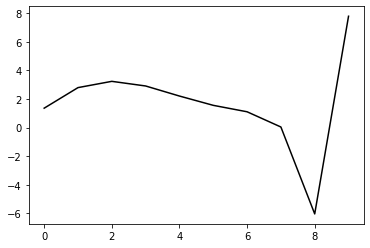

30800 21.91500595765632
0.3243159889055478 -0.14363906498886497 -0.25946774409377305 -0.1437193843128333
[ 1.33012452  2.84280882  3.27514833  2.94273789  2.22971271  1.57053876
  1.11104063  0.03637119 -6.05605629  7.75094766]


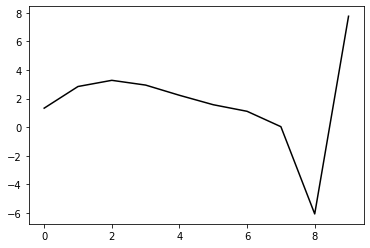

31900 13.041829394903091
0.32846022982361417 -0.1427110938773332 -0.26020425414100684 -0.14218491496325344
[ 1.32419684  2.89867834  3.33845674  3.01230425  2.30441268  1.6492386
  1.1927446   0.11964898 -5.97340442  7.80971023]


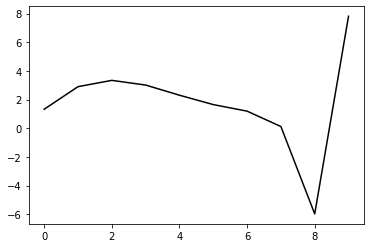

33000 17.063011665498603
0.3244306584682798 -0.14896137843201207 -0.2636650299036118 -0.13952425825953857
[ 1.33550415  2.77887703  3.20869912  2.8732119   2.15697565  1.49494612
  1.03389868 -0.04127172 -6.13205725  7.76631235]


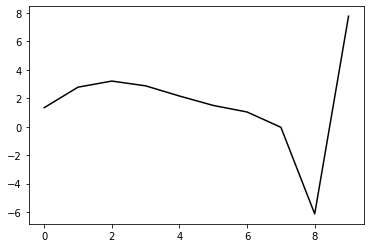

34100 22.03008325932462
0.3254152355617086 -0.1439327575437928 -0.2608011213249131 -0.14158200859042788
[ 1.37637723  2.79434388  3.23274875  2.90340173  2.19063647  1.52967007
  1.06774533 -0.01038659 -6.10713342  7.80340473]


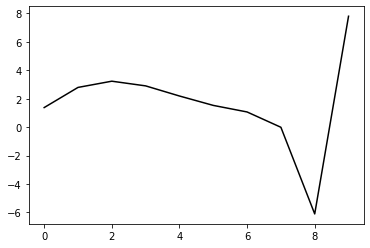

35200 26.789553317404145
0.31887966845760457 -0.14249633193183453 -0.25807680569330904 -0.14261964761779566
[ 1.36638699  2.71235315  3.14186057  2.80749925  2.09198756  1.4296192
  0.96717593 -0.11128414 -6.20874937  7.74188588]


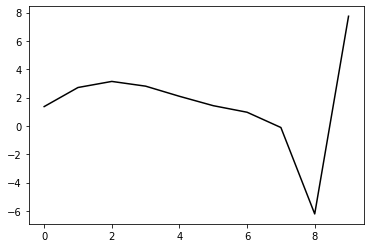

36300 25.352376312475958
0.31846050341073867 -0.14356194561887978 -0.258786528618535 -0.1425476601296227
[ 1.35912012  2.71755268  3.15216348  2.82238626  2.11006507  1.44965915
  0.98831254 -0.08988471 -6.1866378   7.78514775]


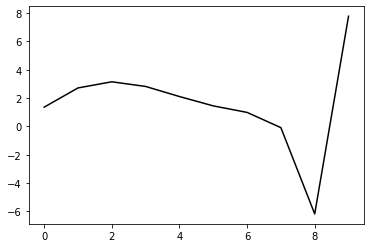

37400 16.728683136461182
0.31958255490932014 -0.1482497472680986 -0.2624807150888304 -0.13986884767182797
[ 1.32195779  2.74185952  3.17182383  2.83802171  2.12163329  1.45724315
  0.99233881 -0.0889259  -6.18669306  7.75463593]


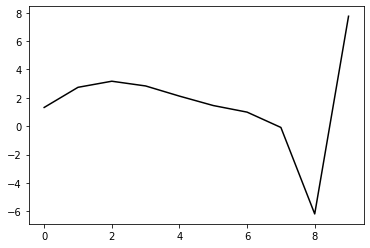

38500 22.011488598766025
0.3253262352360926 -0.14584194869597822 -0.2622642298011398 -0.140286599276367
[ 1.30901492  2.85079717  3.28123871  2.94725749  2.23004407  1.5642825
  1.09758831  0.01397352 -6.08588167  7.79058491]


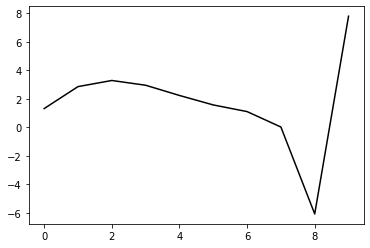

39600 24.898126691193003
0.326845366337212 -0.14602525907113934 -0.263028714616948 -0.14128477398629763
[ 1.29465159  2.92771561  3.36890704  3.04302751  2.33210817  1.671399
  1.20892713  0.12847131 -5.97031155  7.78136164]


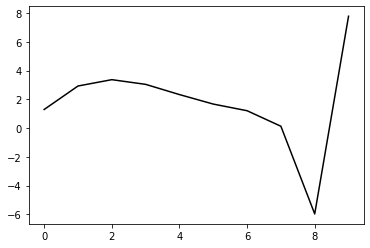

40700 14.213579215939767
0.3260048983556519 -0.14427145504032476 -0.26187559543017913 -0.14225653666880972
[ 1.35427452  2.87716825  3.32710509  3.0088032   2.30435342  1.64915325
  1.19144086  0.11459341 -5.98200481  7.85160933]


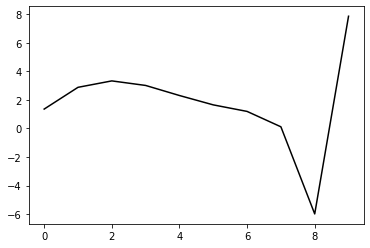

41800 23.509502729747588
0.3253891836225678 -0.1445098136958741 -0.26251259331346705 -0.14069220496723905
[ 1.3086741   2.868415    3.31693291  2.99757989  2.29246977  1.63689457
  1.1789834   0.10144399 -5.99691625  7.77793766]


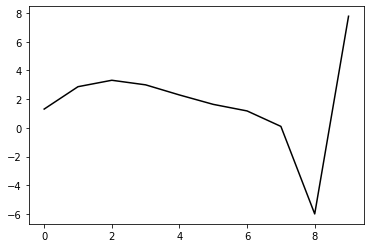

42900 14.489765640290067
0.32449523483975357 -0.140093421025072 -0.25949954041257883 -0.1387877412233975
[ 1.30515324e+00  2.86082887e+00  3.28900810e+00  2.95225004e+00
  2.23220589e+00  1.56359808e+00  1.09417882e+00  6.17759853e-03
 -6.10183388e+00  7.75986296e+00]


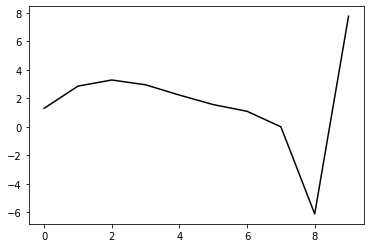

44000 19.085761869786094
0.32933526317865325 -0.14385711893950098 -0.2635606760219856 -0.13771554342233663
[ 1.27807382  2.93219993  3.37049858  3.04096565  2.32596695  1.66099153
  1.19441515  0.10843002 -5.99933141  7.81728766]


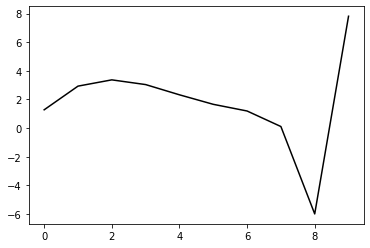

45100 19.883808034536326
0.32771407114542694 -0.14253823384221914 -0.2626432839313885 -0.13709756756408656
[ 1.31351684  2.85168222  3.28651705  2.95511581  2.2392525   1.57393491
  1.107235    0.02083854 -6.08675086  7.7583832 ]


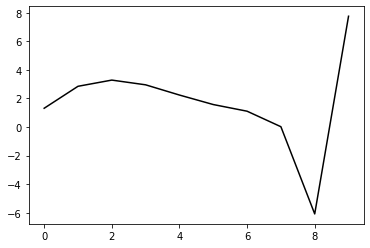

46200 22.8710549688465
0.3194863526036278 -0.144720465406999 -0.26199896329124656 -0.13962842182312074
[ 1.36368315  2.75050538  3.19101641  2.8661768   2.15704167  1.49854217
  1.03896126 -0.04028962 -6.14020515  7.78934762]


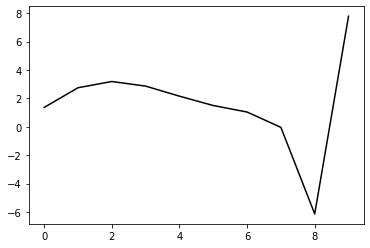

47300 21.254540209675685
0.32615911204274767 -0.1435334803011339 -0.2636220900069336 -0.1351838229862973
[ 1.31942171  2.83383314  3.27282473  2.94540303  2.23316075  1.57116275
  1.10772622  0.02379234 -6.08225207  7.77431106]


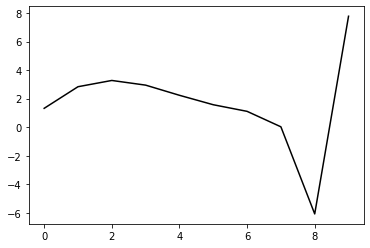

48400 14.232370018440058
0.3235597776907563 -0.1444529504419278 -0.2632043674288817 -0.13803823172109708
[ 1.35846098  2.90866083  3.35941536  3.03892817  2.32961633  1.6682096
  1.20464794  0.12066444 -5.98335167  7.76878972]


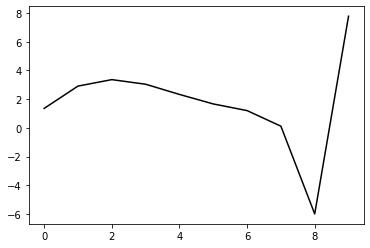

49500 20.8962178381466
0.3188715900175465 -0.15122647009057383 -0.26675221100540675 -0.13463562900416695
[ 1.33219357  2.7524013   3.18547446  2.85327825  2.13588136  1.46888421
  1.00190271 -0.0838281  -6.18816897  7.7806639 ]


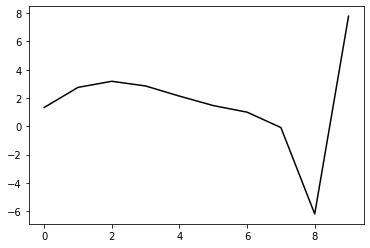

50600 24.511365572184754
0.32707288860302175 -0.14368520467540088 -0.2629408836721696 -0.13657095247629136
[ 1.32724733  2.91650149  3.33879407  2.99520158  2.26667394  1.58893542
  1.11171451  0.01617217 -6.09686524  7.77017641]


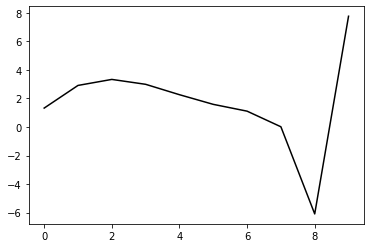

51700 13.578961906692722
0.32620704533060546 -0.14070492900244455 -0.26063019470094767 -0.13926868010096577
[ 1.37068752  2.9180975   3.34856411  3.01139346  2.28823807  1.61515352
  1.14221808  0.05045633 -6.05919509  7.7913223 ]


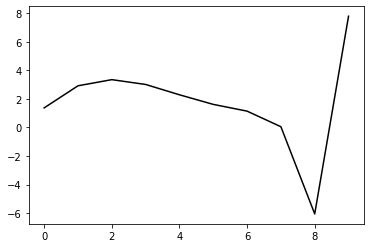

52800 23.333794247675165
0.32691570971203665 -0.1409732200839508 -0.26108618078174894 -0.13938448181456525
[ 1.31602964  2.94457559  3.37177167  3.03006913  2.30226135  1.62468431
  1.14786809  0.05282263 -6.05927955  7.79993623]


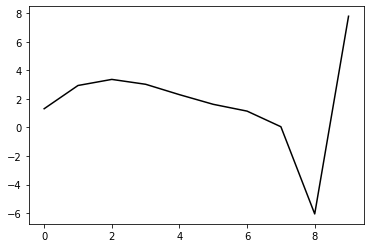

53900 13.131110962846561
0.3254082049207758 -0.1419943242239325 -0.2617398336432231 -0.13936353392048528
[ 1.34196516  2.95239472  3.39369067  3.06362151  2.34548367  1.67592569
  1.20581699  0.11587683 -5.99283783  7.81839858]


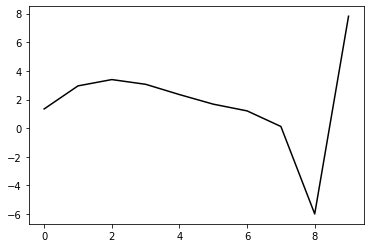

55000 17.998608568309617
0.32737979436056 -0.14790715503729845 -0.26630915527787585 -0.1341816421348866
[ 1.30682898  2.8942428   3.31590037  2.96940077  2.23771102  1.55725572
  1.07912868 -0.01608105 -6.1254243   7.75063841]


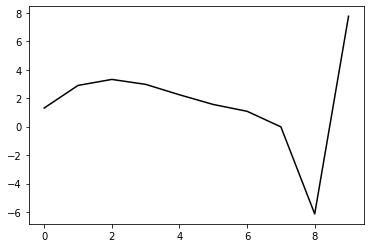

56100 25.251909891237084
0.3217127101956373 -0.14557824050319534 -0.26289905582042744 -0.1392651486156025
[ 1.41070081  2.74843816  3.18346022  2.85003182  2.13002251  1.45988072
  0.99110149 -0.09577147 -6.19706657  7.81134282]


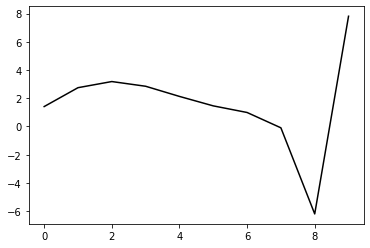

57200 23.635262794598752
0.321671007968727 -0.14378909989477906 -0.26189101903027295 -0.13909987128690562
[ 1.37586693  2.77803717  3.20874027  2.8722362   2.14976174  1.47729505
  1.00603293 -0.08400023 -6.18940791  7.74862033]


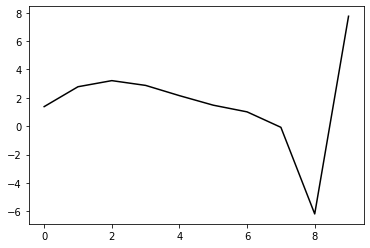

58300 25.152050454620586
0.3183599719309278 -0.1435759243776233 -0.2608241646433377 -0.14066619610915815
[ 1.37335532  2.75632302  3.19371111  2.86382455  2.14679407  1.47869209
  1.01113863 -0.0758152  -6.17792     7.77792919]


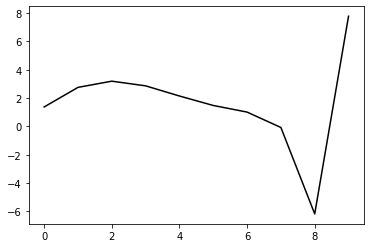

59400 17.485634602611377
0.3192179944805112 -0.1477630397267218 -0.26402538897070965 -0.13781986569482893
[ 1.33520027  2.77170423  3.19720472  2.85711897  2.13099968  1.45480276
  0.98031194 -0.11249431 -6.21850076  7.74541843]


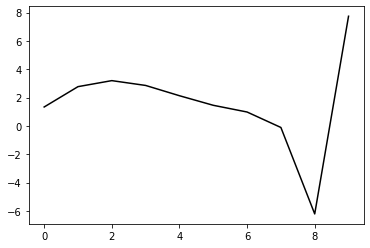

60500 21.992036524398767
0.32632949070276607 -0.1438907190940065 -0.2626986810869691 -0.13847827693067624
[ 1.31709083  2.91750231  3.33570361  2.98787262  2.25405886  1.57031682
  1.08860123 -0.01114463 -6.12264246  7.78426525]


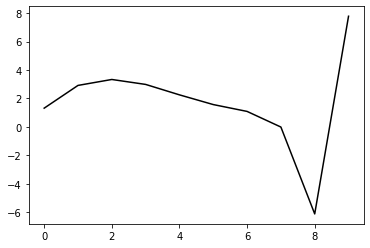

61600 24.44930668584672
0.3272980557186862 -0.14485954618601452 -0.26373168516233936 -0.14067766425795755
[ 1.31671072  3.00475955  3.44150801  3.10733656  2.38401309  1.70869626
  1.23414585  0.14029163 -5.96796027  7.78457696]


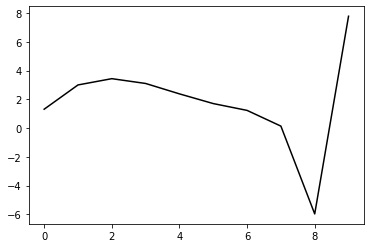

62700 16.46266063189778
0.3251014894889191 -0.1404613737473722 -0.2605071464053573 -0.14061386885420962
[ 1.39178558  2.90416707  3.33946621  3.00553417  2.28400656  1.61133453
  1.13974794  0.04835655 -6.05751347  7.81027492]


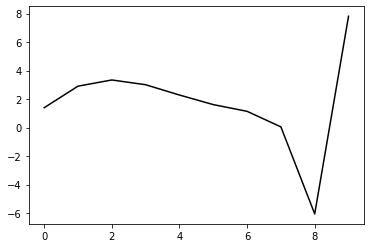

63800 21.773723305271634
0.3257742780470731 -0.14032927670522002 -0.26053769764947327 -0.14118703900545407
[ 1.3459832   2.93094185  3.36307977  3.02620858  2.30214741  1.62747624
  1.15480998  0.06315832 -6.04201295  7.76429527]


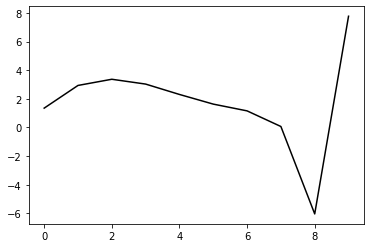

64900 14.39506397181318
0.32656125184985146 -0.1425838947861364 -0.2624153981761219 -0.1393478782514396
[ 1.31193864  2.94389704  3.37312099  3.03245659  2.30425934  1.62535624
  1.14874466  0.05329832 -6.05472235  7.80069428]


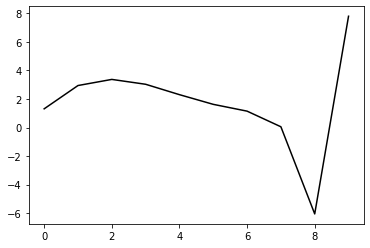

66000 16.220232233509506
0.3287691597119936 -0.14224694541273078 -0.26330527385792296 -0.13806978650248602
[ 1.29775291  2.95742004  3.39087531  3.05380735  2.32893604  1.65290171
  1.17850122  0.08387871 -6.02595448  7.77525498]


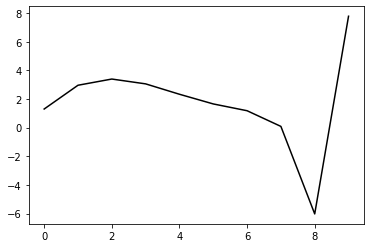

67100 19.85053550929511
0.3287836021278222 -0.14159012756775624 -0.26336364771572307 -0.13572914146625895
[ 1.3242068   2.89669705  3.32267055  2.97877711  2.24791851  1.56638615
  1.08678596 -0.01331386 -6.1294905   7.80648323]


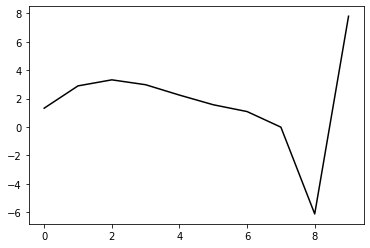

68200 22.51545257995649
0.3249352251887293 -0.14389643451744527 -0.264181336465116 -0.13715168458746516
[ 1.38490766  2.83305619  3.27516583  2.94713619  2.23152596  1.56465139
  1.09925316  0.01227703 -6.09153836  7.77120358]


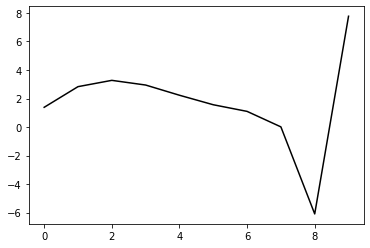

69300 21.459785396696272
0.32857630969326695 -0.14034552804064737 -0.2631165812403871 -0.1344355261009579
[ 1.33748088e+00  2.88730874e+00  3.31995953e+00  2.98202027e+00
  2.25638407e+00  1.57915249e+00  1.10302183e+00  4.49273699e-03
 -6.11283158e+00  7.77675623e+00]


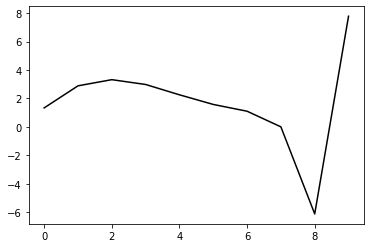

70400 15.93733897557695
0.3259372722009183 -0.14572412705965476 -0.2656070182370804 -0.13567676426876452
[ 1.35274218  2.89631797  3.32914374  2.99023828  2.26300767  1.58460723
  1.10890042  0.01285481 -6.09692911  7.77914102]


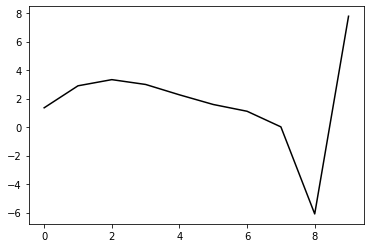

71500 21.16921627257395
0.3248292367429732 -0.14643145599379098 -0.2659125755057839 -0.13478938380494251
[ 1.33311385  2.86356398  3.28453863  2.93734208  2.20431101  1.5216575
  1.04276228 -0.05600405 -6.16815938  7.77607262]


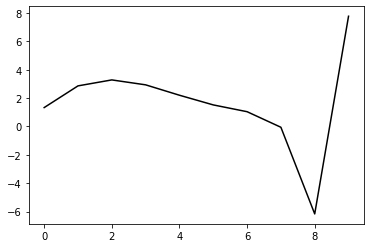

72600 25.442752055680064
0.3268954612695825 -0.14644013758827343 -0.2663265234372478 -0.13461252107943103
[ 1.32927904  2.9066582   3.32548192  2.97569542  2.23982183  1.55420914
  1.07250586 -0.02891933 -6.14245966  7.76308204]


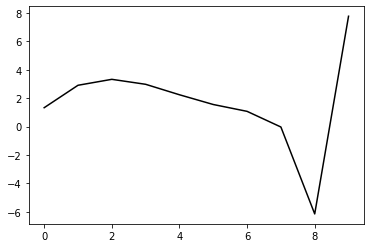

73700 13.247458164801005
0.3265540996634837 -0.14343716950256047 -0.2637829690420197 -0.13787410595851143
[ 1.36856681  2.93221901  3.35824403  3.01353507  2.28120685  1.5981219
  1.11845802  0.01869942 -6.0924076   7.78219364]


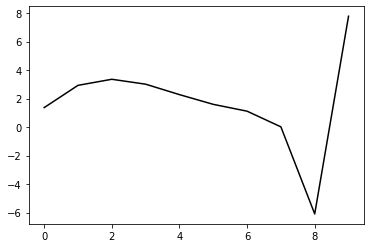

74800 26.679121458216404
0.32349026588297863 -0.1404758399130618 -0.2606380131268483 -0.1411664817935598
[ 1.38943904  2.96303435  3.38607686  3.03846209  2.30344461  1.61789977
  1.13618907  0.03470756 -6.07674514  7.76569766]


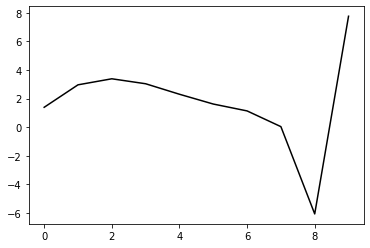

75900 18.230199876660624
0.3285793094841085 -0.14396967619849893 -0.26446180086305215 -0.13808994411984316
[ 1.29740462  2.975864    3.38875613  3.03277746  2.29114134  1.6002891
  1.11447381  0.00978416 -6.10351507  7.79653391]


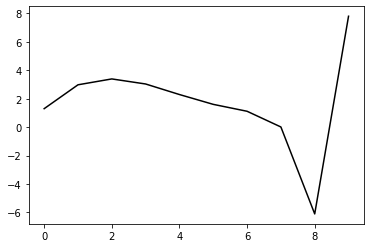

77000 18.719309398501412
0.32939190876846175 -0.14828542633437167 -0.267987632858761 -0.1359178653085871
[ 1.30570855  2.96551382  3.38682948  3.03840457  2.3037871   1.61944928
  1.13976173  0.04046278 -6.06779601  7.75227167]


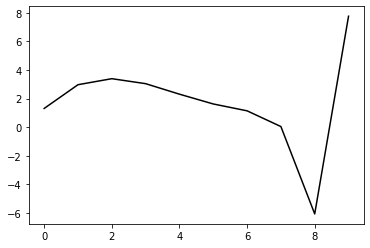

78100 22.860076657212016
0.32572007081171134 -0.14438113255954846 -0.26405009589831774 -0.13828035870445501
[ 1.38963892  2.86624386  3.2840433   2.93406168  2.19872429  1.51395337
  1.03399284 -0.06567688 -6.17341939  7.80702352]


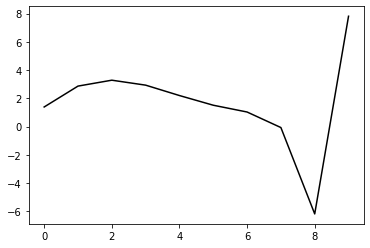

79200 23.487153829293916
0.3232212588941704 -0.14365747358431238 -0.26301551065678197 -0.13907233193384363
[ 1.38013345  2.80406453  3.22548426  2.87971358  2.1486166   1.46780342
  0.99149849 -0.10516985 -6.21103816  7.7365425 ]


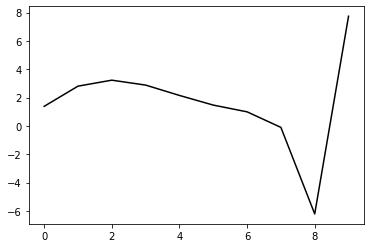

80300 25.09449203584239
0.3197800781190903 -0.14344102246544702 -0.2619489635398625 -0.14068330335985355
[ 1.37536185  2.79144068  3.2187023   2.8779421   2.15060969  1.47256357
  0.99847774 -0.09645548 -6.19998098  7.78020412]


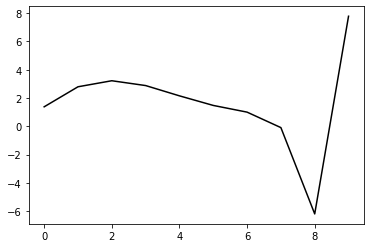

81400 14.58051019691089
0.3239714792136581 -0.14346745504618214 -0.2630182452805691 -0.13912645253319994
[ 1.34259881  2.89745919  3.31649469  2.96750706  2.23239085  1.54702601
  1.06618877 -0.03503209 -6.1430661   7.76338157]


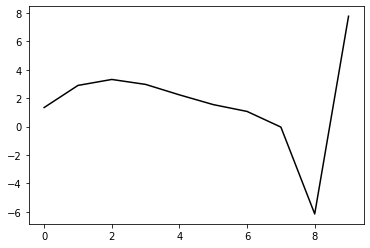

82500 21.84458259980063
0.3258441383401405 -0.14504804502253973 -0.26477147778940846 -0.13723796311848938
[ 1.32176724  2.90738868  3.3223928   2.9702244   2.23263104  1.54521931
  1.06274343 -0.03995216 -6.14880624  7.78256292]


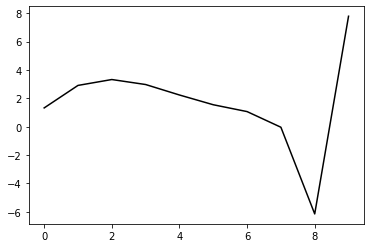

83600 24.395337631018254
0.32805889371333163 -0.14380032020385533 -0.2642951836600164 -0.13809041342137074
[ 1.32914294  2.96449735  3.3814526   3.03005665  2.29268578  1.60517227
  1.12254059  0.01955261 -6.0889952   7.77107579]


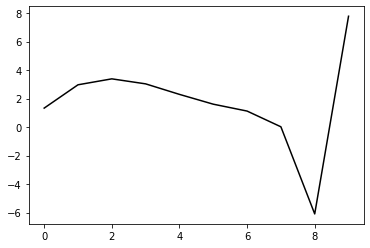

84700 14.396290726469768
0.32683020925329304 -0.14287276647402306 -0.26346360020220394 -0.14093929086289014
[ 1.38273815  2.95204158  3.38998761  3.05547869  2.33226688  1.6568863
  1.18483927  0.09065194 -6.01128043  7.81037458]


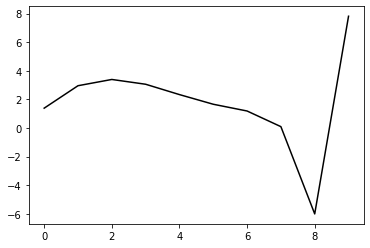

85800 22.063042476641748
0.3253990098600355 -0.14082113092576873 -0.2620162973925544 -0.14097779475125194
[ 1.36620981  2.95691217  3.38935673  3.04997753  2.3230664   1.64483611
  1.17053531  0.07410403 -6.03013738  7.76354602]


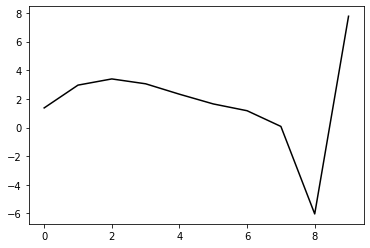

86900 13.360215353098884
0.3248704958958659 -0.14232967507558586 -0.2633237676628111 -0.1391398227329384
[ 1.342297    2.97487409  3.40551068  3.06400348  2.33505009  1.65476654
  1.17832842  0.07927504 -6.02818443  7.80342428]


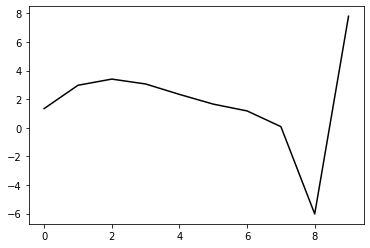

88000 17.513069775448837
0.32797643690569905 -0.14500396585992323 -0.2665040575981856 -0.13482221245600517
[ 1.32261225e+00  2.89242421e+00  3.31946950e+00  2.97675588e+00
  2.24848404e+00  1.56999418e+00  1.09603370e+00 -6.10210230e-04
 -6.10593555e+00  7.75472467e+00]


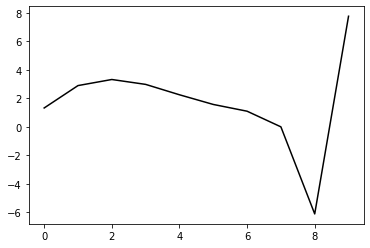

89100 19.587870577851977
0.3285979392405932 -0.14137349888727926 -0.26433204506627833 -0.13545844812879887
[ 1.32192530e+00  2.90263696e+00  3.32638944e+00  2.98081321e+00
  2.25018290e+00  1.56948865e+00  1.09317476e+00 -6.60523634e-03
 -6.11673682e+00  7.81114521e+00]


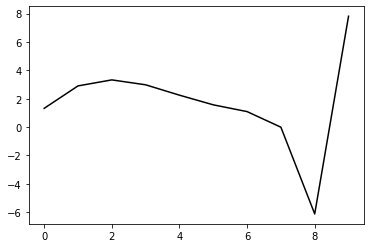

90200 23.92846201133445
0.3199379144313773 -0.14353617900480156 -0.2636501147503986 -0.13861425008279102
[ 1.39097994  2.7967818   3.22500301  2.88588056  2.16305763  1.49127528
  1.02496007 -0.0643726  -6.16343001  7.74789218]


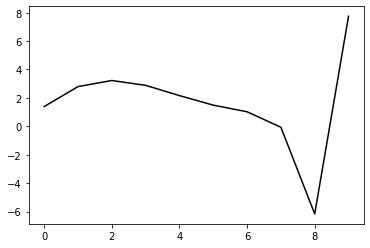

91300 20.973343156396293
0.32761209435238065 -0.14137663419735677 -0.26464507143104254 -0.13462434179800917
[ 1.33556628  2.91683552  3.34719418  3.00705664  2.281495    1.60570736
  1.13433579  0.03856953 -6.06898985  7.79559683]


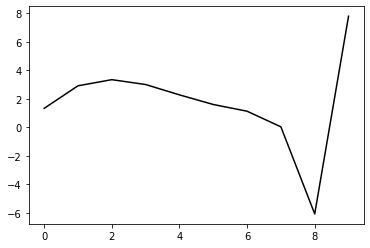

92400 22.258416356985325
0.3236639909275754 -0.13846015230347272 -0.261800570234001 -0.13707714899509568
[ 1.4222674   2.89733275  3.34237051  3.01309479  2.29553933  1.62583051
  1.1593881   0.06748123 -6.03622235  7.77254897]


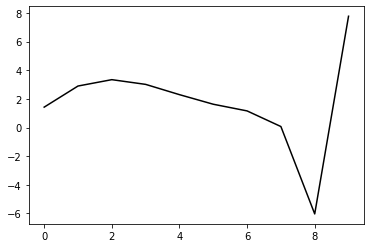

93500 21.61969185234909
0.324753778668497 -0.14296275715376483 -0.2647148708812464 -0.1352092893309423
[ 1.33840245  2.91569875  3.33500293  2.98475951  2.24987942  1.5660038
  1.088609   -0.01121124 -6.11944642  7.77888569]


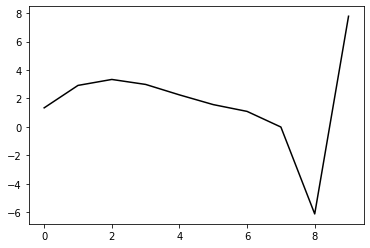

94600 25.251408464691444
0.3248625384673969 -0.1462467087659004 -0.267242955122435 -0.1339556820616332
[ 1.34108659e+00  2.89408231e+00  3.32017002e+00  2.97624142e+00
  2.24647497e+00  1.56659347e+00  1.09245906e+00 -4.81871135e-03
 -6.11055610e+00  7.76719241e+00]


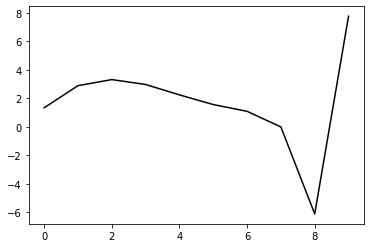

95700 13.535726681762181
0.324656201573457 -0.1418517742273928 -0.2638770566419762 -0.1376392654433488
[ 1.38730107  2.91732099  3.35536131  3.0211469   2.29915247  1.62559695
  1.15682025  0.06386131 -6.0384354   7.79869868]


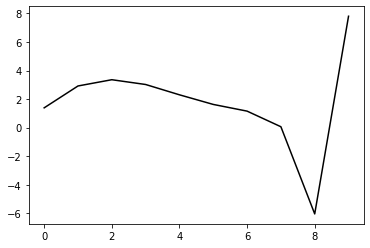

96800 26.976103450172594
0.32257587636431134 -0.14081111485318631 -0.26291037824600494 -0.13920167085509197
[ 1.41167476  2.91752199  3.36565197  3.04092253  2.3274925   1.66146154
  1.19920938  0.11122942 -5.98872077  7.79593592]


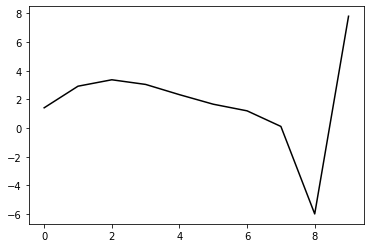

97900 13.98919633816119
0.3254697671009758 -0.1430477233193875 -0.26438250553063375 -0.1368748725019662
[ 1.32072974  2.90601076  3.30866448  2.94772012  2.20517828  1.5153233
  1.03378095 -0.06940442 -6.17906639  7.79111864]


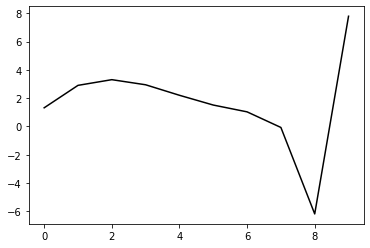

99000 17.67879363970031
0.33161850824481015 -0.14555156504571756 -0.2676484249831759 -0.1342565980322191
[ 1.32370667  2.97849846  3.38623048  3.02799699  2.28689673  1.59774168
  1.11661749  0.01358013 -6.09573414  7.73469281]


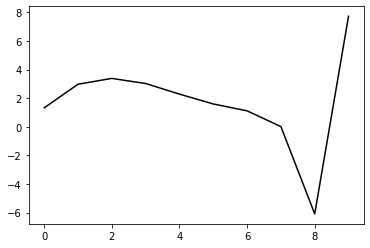

100100 19.982638078744035
0.33242478909273904 -0.1374635365359079 -0.26193322699176325 -0.13785887093393853
[ 1.35697276  3.02693589  3.43151677  3.06991616  2.32603809  1.63424885
  1.15029628  0.04365264 -6.07118758  7.77446792]


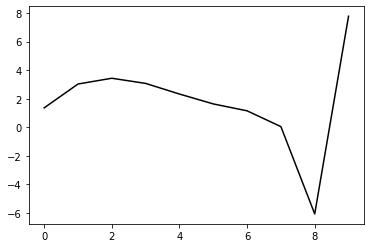

101200 22.635262562773548
0.3277506090435013 -0.13901187863397907 -0.2617114782323382 -0.13908894201309469
[ 1.35193448e+00  2.97266500e+00  3.37791095e+00  3.01689705e+00
  2.27425215e+00  1.58415317e+00  1.10246821e+00 -1.58148585e-03
 -6.11277517e+00  7.79186721e+00]


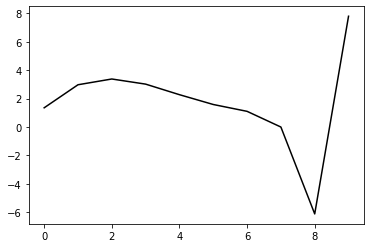

102300 22.19639934655901
0.3321158132472983 -0.13700579232969815 -0.26140650719872316 -0.13815076997131903
[ 1.32844847  3.05197822  3.46248224  3.1031277   2.36027988  1.66885544
  1.18555433  0.07979085 -6.03325235  7.76092064]


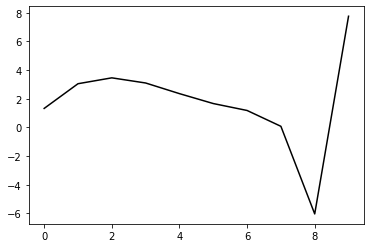

103400 17.406565626243943
0.327594483586943 -0.14150709441483691 -0.2640548313598558 -0.13721498017270328
[ 1.30917145  2.96169041  3.37812474  3.02477972  2.28842404  1.60359678
  1.12690883  0.02715946 -6.08111415  7.76475394]


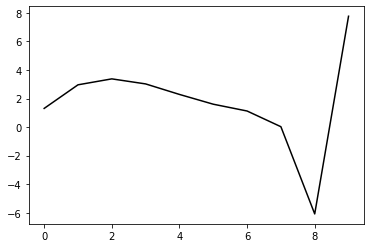

104500 21.71948375775504
0.32455854862212397 -0.1460677666004757 -0.2667394621854649 -0.13602204014566055
[ 1.32853556  2.88293231  3.30008534  2.94980842  2.21798533  1.53863948
  1.06821983 -0.02488273 -6.12429685  7.78144923]


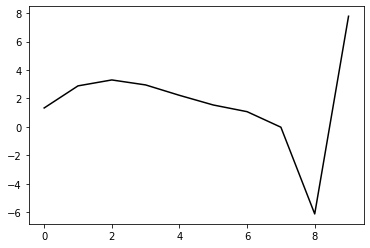

105600 25.298606759679817
0.3256454984303072 -0.14653918094833057 -0.2672477328522438 -0.1351864662499192
[ 1.33588086  2.90179064  3.31514709  2.96144188  2.22635559  1.54383687
  1.07044547 -0.02549953 -6.12631666  7.76717553]


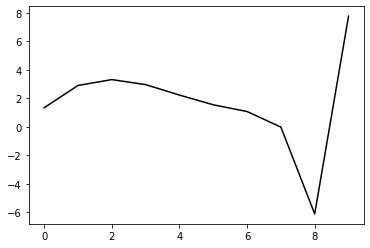

106700 13.327264435815938
0.3270133527530999 -0.14129802219566934 -0.2634052793149612 -0.13922388038084654
[ 1.372481    2.95477441  3.3735611   3.02342379  2.29076797  1.60996613
  1.13796634  0.04310392 -6.05626173  7.79043979]


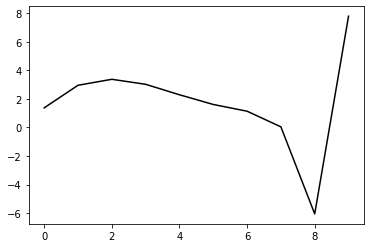

107800 29.04274404900704
0.3242854282000575 -0.1401065855075895 -0.26180161553053927 -0.1417172206147436
[ 1.39868531  2.95836899  3.38742903  3.0452918   2.31877938  1.64281581
  1.17486509  0.08327837 -6.01333771  7.776244  ]


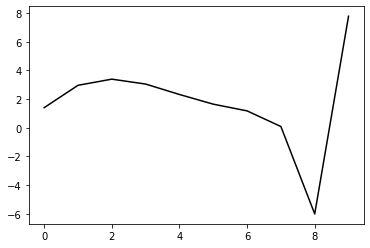

108900 15.219053025725843
0.3280161682143244 -0.1414916846109748 -0.26387737607729395 -0.1393631425201991
[ 1.31233536  2.98767842  3.40477617  3.0531602   2.31922602  1.63722157
  1.16423573  0.06810598 -6.03247555  7.7995968 ]


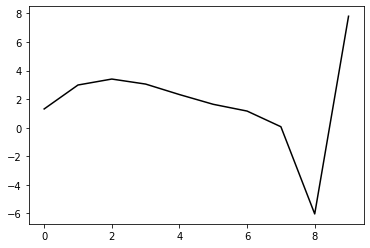

110000 16.192194687901203
0.3302242087497204 -0.13985808742833117 -0.2637049464748343 -0.13789575187541211
[ 1.29763555  2.99430462  3.41217725  3.06046807  2.32659559  1.64463113
  1.17140788  0.07414212 -6.02924439  7.79239165]


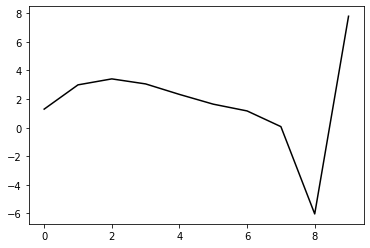

111100 22.51945243955059
0.3224956625911297 -0.14312108410635782 -0.26374698174944783 -0.1371125023370051
[ 1.35645754  2.83083913  3.24065799  2.8842117   2.14803785  1.46553503
  0.99329412 -0.10196704 -6.20212166  7.77954034]


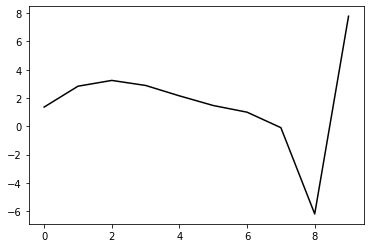

112200 22.774368613238767
0.3297871791670611 -0.14324791249647986 -0.26546377328510784 -0.13642696149291136
[ 1.31499039e+00  2.91917700e+00  3.33445473e+00  2.98060585e+00
  2.24542242e+00  1.56314429e+00  1.09101823e+00 -4.09331750e-03
 -6.10280523e+00  7.74323216e+00]


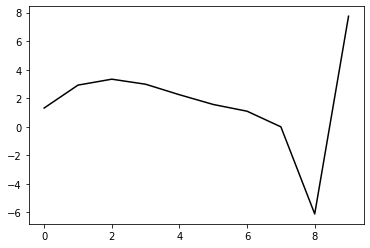

113300 20.36970092202099
0.3277266264220088 -0.14564567228941458 -0.2671187449885743 -0.13682253155901783
[ 1.34110697  2.90643821  3.33619665  2.9936096   2.26743672  1.59268482
  1.12725602  0.03798503 -6.05584056  7.79492738]


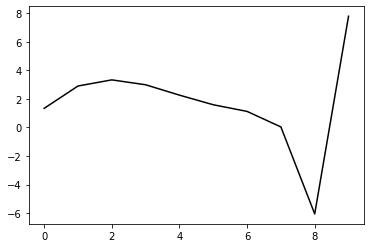

114400 16.052021565553993
0.32527145444384736 -0.14324090095125433 -0.2649840319363114 -0.13841506109603072
[ 1.31730223  2.92471229  3.35517396  3.01235925  2.28548185  1.60972074
  1.14310399  0.05208593 -6.04476336  7.79675658]


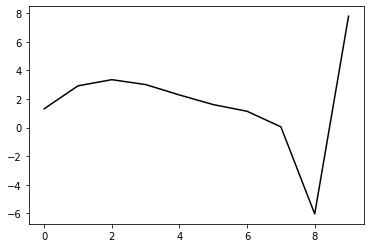

115500 22.67905093182166
0.32444672707758737 -0.14055914241576614 -0.26306155009245835 -0.13947273497471943
[ 1.37479662  2.91783043  3.35849905  3.0256075   2.30806382  1.6408435
  1.1817779   0.09660858 -5.99655568  7.79615348]


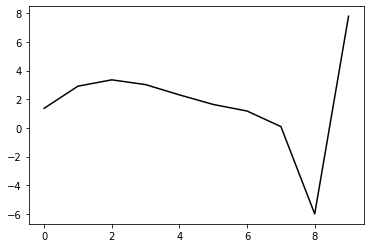

116600 25.456857522638007
0.3250899240243877 -0.1411619752720532 -0.26387741021722627 -0.13863207369537187
[ 1.34938424  2.91825049  3.35398169  3.01808443  2.29910343  1.63145785
  1.17243821  0.0869178  -6.0075566   7.78349109]


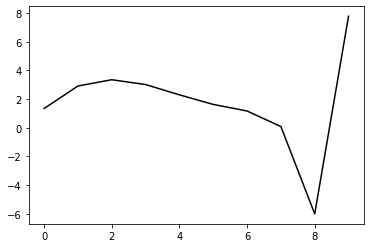

117700 13.8512950805262
0.3214702794965536 -0.14652269883385122 -0.2665051429245351 -0.13693659464533423
[ 1.39032132  2.78567654  3.20541354  2.85857017  2.13153844  1.45805148
  0.99548553 -0.0913333  -6.18380156  7.77845615]


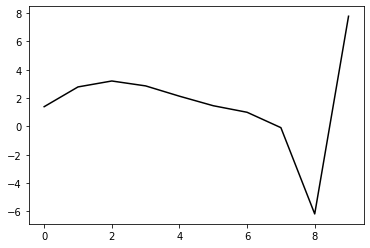

118800 28.259391090354697
0.32733467675878075 -0.1375678839917549 -0.2609102503877829 -0.14151545183948336
[ 1.38527771  2.95165584  3.37201346  3.02413949  2.29547789  1.62008392
  1.1554428   0.06600467 -6.03138403  7.7389561 ]


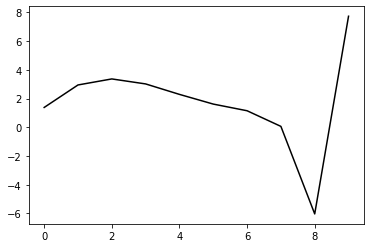

119900 17.87185770779141
0.3295452194889983 -0.14188056543692895 -0.26480253985802926 -0.13854212859734066
[ 1.2964077   2.94948945  3.3618396   3.00718365  2.27313993  1.59350992
  1.12571806  0.03388926 -6.06441434  7.80355247]


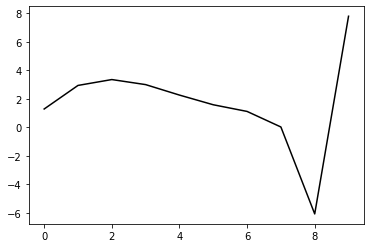

121000 18.608707927821666
0.3286344320086938 -0.14789230598729866 -0.26964147171319064 -0.13453924861833025
[ 1.31478309  2.81739405  3.24172855  2.8999407   2.17850638  1.51074066
  1.05388704 -0.02853608 -6.11967717  7.75786396]


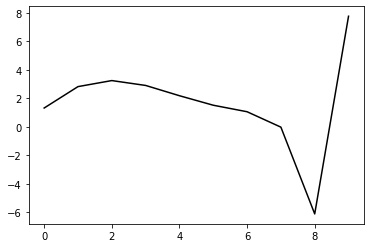

122100 21.976014040376704
0.3264729507684231 -0.14408983554865273 -0.2661768910529228 -0.1378092913527147
[ 1.35749969e+00  2.84056285e+00  3.26812983e+00  2.92953150e+00
  2.21071008e+00  1.54494352e+00  1.08950448e+00  7.63152760e-03
 -6.08351812e+00  7.81443878e+00]


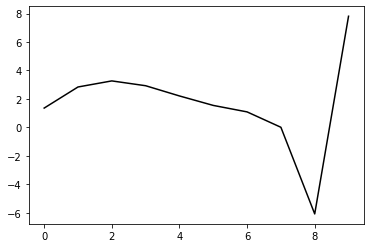

123200 22.710629508509278
0.3288944390943278 -0.1427345467677734 -0.2660887817276004 -0.1363862027410526
[ 1.31673458  2.87077455  3.29368651  2.95133998  2.22973638  1.56183316
  1.10463323  0.02076583 -6.07348099  7.74161317]


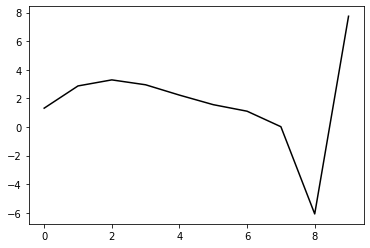

124300 25.05172930366901
0.3225506041369659 -0.139712840301407 -0.26268026487342133 -0.13748341362082886
[ 1.37157368  2.76250465  3.18102037  2.83522463  2.11120079  1.44184466
  0.98414356 -0.09972168 -6.19428202  7.74190945]


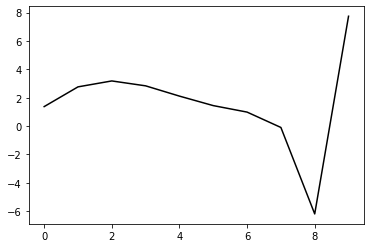

125400 14.985577486003683
0.3221997887270271 -0.14162672297683832 -0.2642011941876719 -0.13730103977256095
[ 1.35038161  2.80571378  3.23483397  2.89797506  2.18085645  1.51677592
  1.06313912 -0.01776113 -6.10838437  7.79811443]


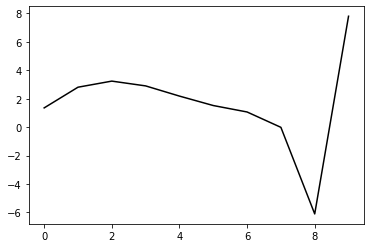

126500 21.229985062517546
0.32177561741247135 -0.1461717199837761 -0.2675186804627604 -0.13527334135717883
[ 1.3243948   2.78157372  3.20953474  2.87237491  2.15477613  1.49002315
  1.03575517 -0.04576543 -6.13639623  7.80195143]


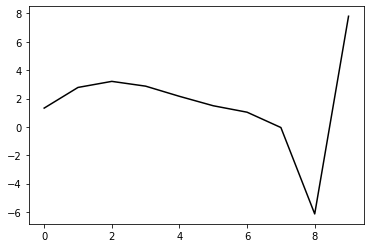

127600 24.335322124320527
0.32626542539161013 -0.1411951090630845 -0.2649574497375018 -0.13729271196967266
[ 1.33507639  2.88106026  3.31278846  2.97831154  2.26241854  1.59858508
  1.14456338  0.06238825 -6.02969363  7.78690822]


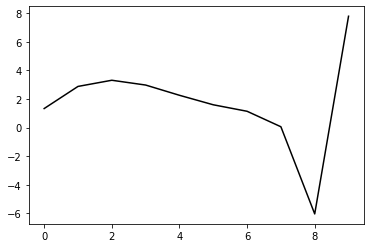

128700 13.728096759878035
0.32263437382391635 -0.14266420241507027 -0.26524837279373803 -0.13898553911361877
[ 1.37267153  2.83631671  3.28128986  2.95908675  2.25415746  1.60032931
  1.15576705  0.08227965 -6.00216762  7.78205141]


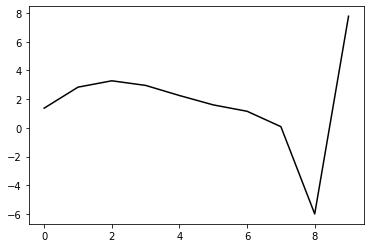

129800 30.461332981220462
0.32008764053004213 -0.13772541920566553 -0.2605115918049715 -0.14177756997660101
[ 1.39080759  2.86262434  3.28666845  2.94823914  2.23013726  1.56525194
  1.11129643  0.02968343 -6.06059679  7.75476557]


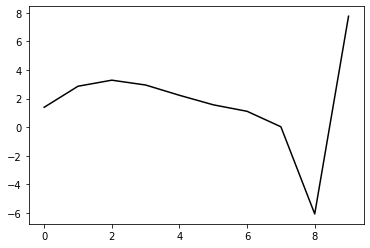

130900 14.65129252280318
0.32796180204780556 -0.13987017136690666 -0.2638765725419091 -0.13919672918690856
[ 1.31508938  2.95141254  3.36786593  3.02206139  2.29720612  1.62626959
  1.16711441  0.0810122  -6.01329453  7.80181275]


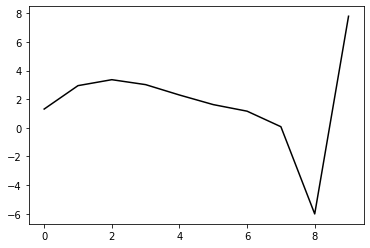

132000 20.421154051110644
0.33051912881481454 -0.1450311705590714 -0.26878345435653483 -0.13346045722191058
[ 1.29331344  2.83127088  3.24874341  2.90633308  2.18619254  1.52049819
  1.06678564 -0.01419965 -6.10338677  7.76052855]


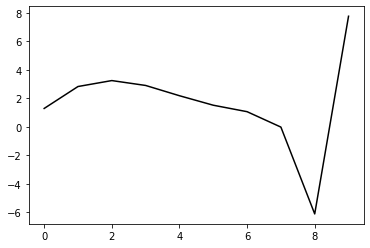

133100 22.533073194490992
0.32511937065617313 -0.14184959189347243 -0.2645135876902183 -0.13908255401176872
[ 1.38719768  2.81358732  3.2275856   2.88241618  2.15964563  1.49151
  1.03582677 -0.04658686 -6.1351805   7.80467179]


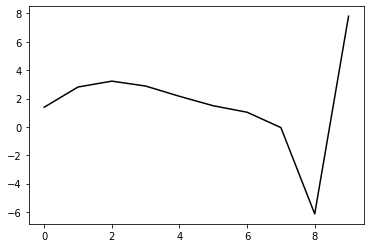

134200 24.09754648087872
0.3233611328464134 -0.14027993678013395 -0.26296879433426884 -0.14029144486872852
[ 1.3747812   2.79334783  3.20910649  2.86625325  2.1458241   1.47983783
  1.02612188 -0.05474266 -6.14225258  7.7412248 ]


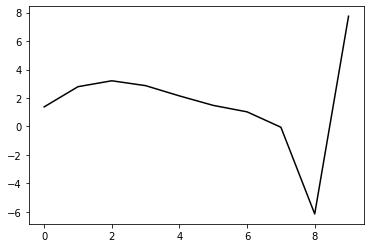

135300 22.05282965678139
0.32974011918971036 -0.13678578368678052 -0.2622147969165352 -0.13900805337742433
[ 1.31867207  2.95215216  3.3592414   3.00714274  2.27820226  1.60444112
  1.14363457  0.0560287  -6.03835189  7.76724191]


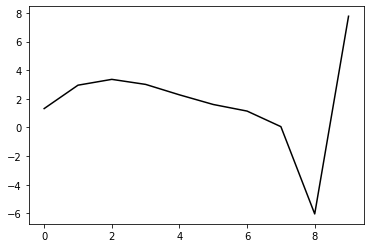

136400 16.55457379383294
0.3268351322116834 -0.13846287636245458 -0.2628006470655979 -0.13967402914109767
[ 1.38526239  2.90002273  3.32374266  2.98518574  2.26757015  1.60361259
  1.1518618   0.07266705 -6.01308635  7.78895429]


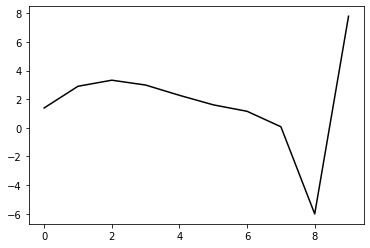

137500 21.835560207260798
0.3243611945628743 -0.14442554115880527 -0.26679435112402805 -0.1384640705244748
[ 1.33775034  2.87250964  3.29710824  2.96006237  2.24444159  1.58290217
  1.13400594  0.05767258 -6.02486009  7.82727281]


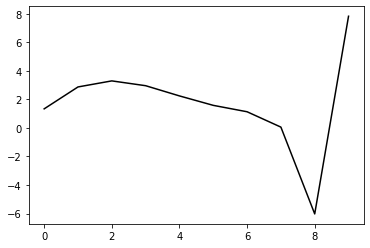

138600 26.0440270407169
0.3279171201495148 -0.1430454842790053 -0.2668154290785284 -0.13819299740676305
[ 1.3044852   2.98228055  3.41134824  3.07603152  2.36030728  1.69735638
  1.24608267  0.16603487 -5.92389148  7.80491483]


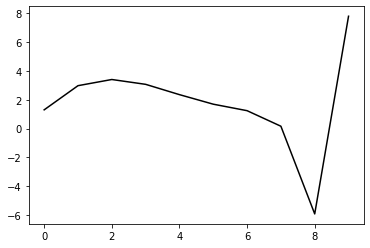

139700 14.224356255331084
0.32475992304033724 -0.14112229453452887 -0.26469087337325486 -0.13794203736600258
[ 1.400655    2.86800133  3.28901629  2.94592393  2.22318684  1.55422675
  1.09826096  0.01467152 -6.0771713   7.73490033]


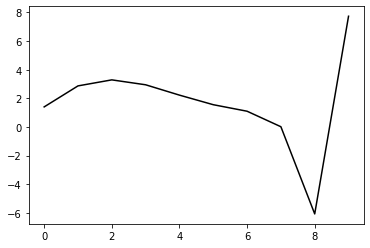

140800 25.34144926893899
0.3233200714367042 -0.14029715887085534 -0.26406934455603553 -0.13947107258038133
[ 1.40726377  2.90655344  3.33929132  3.00661951  2.29327441  1.63266345
  1.18399569  0.1060598  -5.98258052  7.80679361]


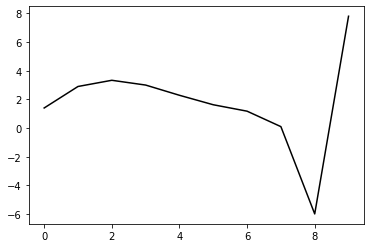

141900 27.411193664482465
0.3281916786253418 -0.1428378421609687 -0.26745800827763283 -0.1350818076361746
[ 1.28994808  2.91639705  3.32683518  2.97604976  2.2484192   1.5763393
  1.11829866  0.03232005 -6.06243567  7.80296036]


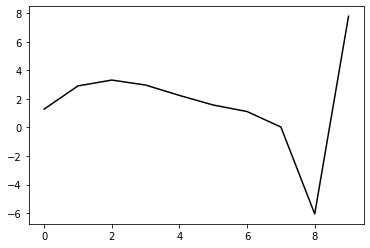

143000 16.3814353792154
0.32853070632549114 -0.1421672606224899 -0.2663417839347813 -0.13647084918257982
[ 1.32725645  2.95985051  3.35964251  2.99883701  2.26148797  1.5801401
  1.11362641  0.02002425 -6.08208068  7.7749424 ]


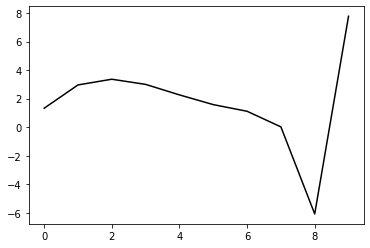

144100 22.601745170624323
0.3278941685058649 -0.14214652516813503 -0.26641178590788966 -0.13599755510672623
[ 1.37676103  2.83879097  3.24856635  2.89853512  2.17190912  1.50071522
  1.04368817 -0.04148617 -6.1364742   7.79094509]


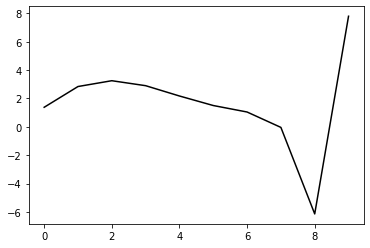

145200 26.273913787533655
0.3211080831529063 -0.1392796210301314 -0.2625552074094302 -0.13959605846243087
[ 1.39528429  2.7680467   3.18091105  2.83537237  2.11318462  1.44594274
  0.99241104 -0.08991094 -6.18233576  7.72736575]


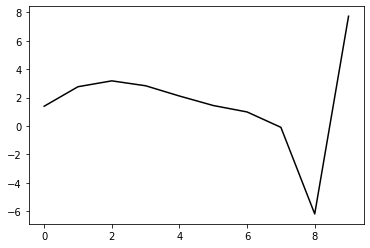

146300 25.045140183532997
0.31987030343103157 -0.14118347619629368 -0.2635757861095257 -0.13885441077389793
[ 1.37001282  2.76602892  3.17148749  2.8192786   2.09090504  1.41801213
  0.959588   -0.12686807 -6.22202533  7.783971  ]


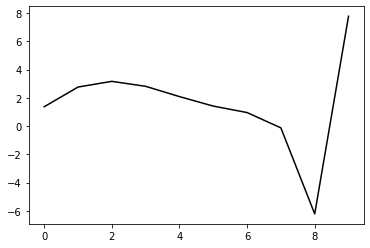

147400 14.904261064205125
0.32572420294206456 -0.14101519189167736 -0.2648050364884866 -0.1375797788162618
[ 1.34624416  2.89369254  3.2961246   2.93991726  2.20713555  1.52961648
  1.06652358 -0.02460662 -6.12258134  7.76455033]


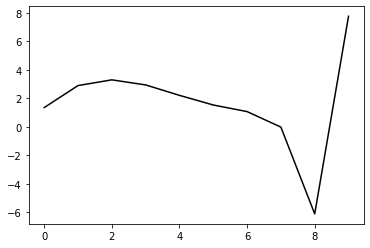

148500 22.35021264309533
0.3285958176233294 -0.1406295405502507 -0.26533563357249224 -0.13674078682131693
[ 1.32550534e+00  2.93476226e+00  3.33502056e+00  2.97632251e+00
  2.24126485e+00  1.56165983e+00  1.09671344e+00  3.74344472e-03
 -6.09608866e+00  7.79801199e+00]


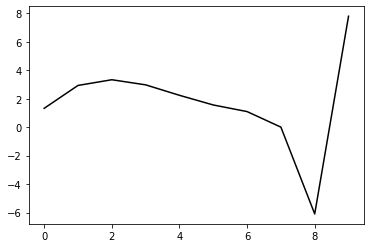

149600 25.157548517972806
0.33083524508856005 -0.14222000764430628 -0.2671316264129661 -0.1364989732166334
[ 1.32842019  2.97654319  3.39004676  3.04061297  2.31249181  1.63837349
  1.1781611   0.08917671 -6.0077379   7.77232678]


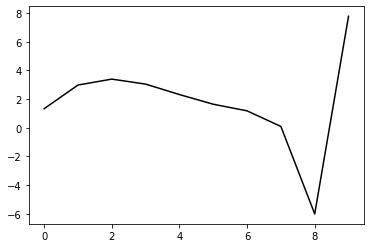

150700 14.932979106861469
0.32745980141205655 -0.13969065159107513 -0.264664545286148 -0.138894330631884
[ 1.40447494  2.90319895  3.32153528  2.97704152  2.25403533  1.58494758
  1.12958517  0.04470653 -6.04932061  7.79464386]


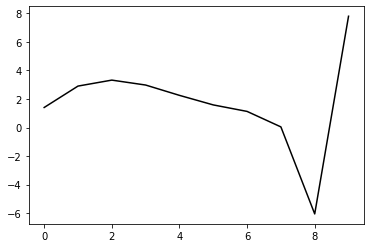

151800 23.491666731291897
0.329911333202296 -0.137913128102145 -0.2644095263241513 -0.13745116863202758
[ 1.33407402  2.96308322  3.37880244  3.02943762  2.30062107  1.62489929
  1.16213064  0.06878718 -6.03496569  7.78216792]


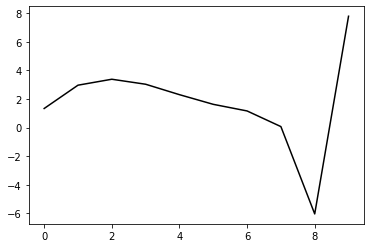

152900 14.828024480312578
0.3267467404732761 -0.14105533646306592 -0.26636165885070484 -0.13635818121903023
[ 1.39013374  2.86041693  3.28584715  2.94547237  2.22513701  1.55748591
  1.10253152  0.01637029 -6.0807733   7.81542392]


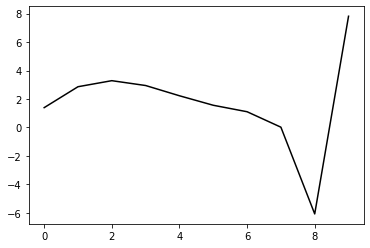

154000 23.993712750513122
0.33115092629619824 -0.14519241009119319 -0.2708825827514487 -0.13067620252554274
[ 1.30746843e+00  2.88299398e+00  3.30233399e+00  2.95608683e+00
  2.23017921e+00  1.55711094e+00  1.09685387e+00  5.28487643e-03
 -6.09693570e+00  7.76449282e+00]


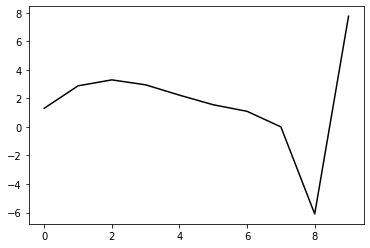

155100 23.98283112749046
0.32452477173785355 -0.14055246674762992 -0.2650071241402089 -0.13728819259095248
[ 1.4192758   2.83252684  3.243832    2.89068816  2.15868872  1.48033987
  1.01585432 -0.07883242 -6.18172177  7.79308387]


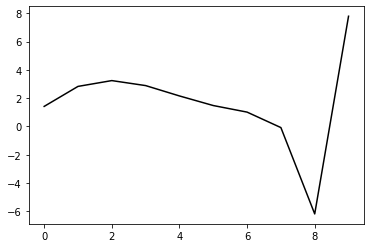

156200 24.32539722683234
0.3237271948512022 -0.13858717885537372 -0.26322026986961355 -0.1388257694830059
[ 1.38285873  2.8903689   3.29702753  2.93945556  2.2033714   1.52114836
  1.05293476 -0.04551987 -6.1516957   7.75055989]


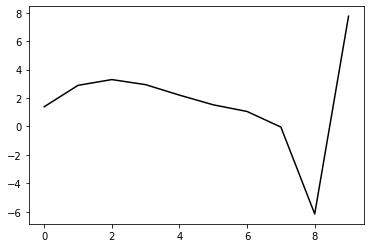

157300 24.85917969179748
0.32284335091292066 -0.13954264111623507 -0.2637327334990536 -0.13844647475244978
[ 1.38319836  2.84865026  3.25966559  2.9060502   2.17343432  1.49431108
  1.02913059 -0.06639552 -6.16953304  7.79116872]


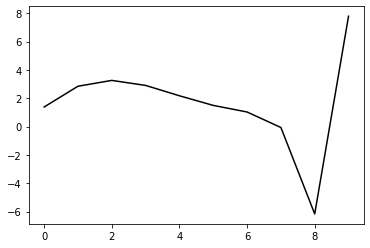

158400 14.516797048227321
0.32469064238025325 -0.14008896874041163 -0.264710976015446 -0.13777512490919921
[ 1.35082782e+00  2.89988781e+00  3.31370349e+00  2.96230427e+00
  2.23128449e+00  1.55321271e+00  1.08874408e+00 -6.48992709e-03
 -6.10902675e+00  7.76537784e+00]


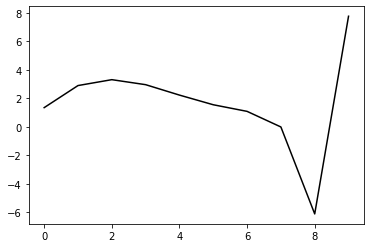

159500 22.158486236891413
0.32626856614367333 -0.1421242078973725 -0.26679482097944873 -0.1360336992642971
[ 1.32847429e+00  2.89285530e+00  3.31126641e+00  2.96449737e+00
  2.23722209e+00  1.56201141e+00  1.09978265e+00  6.11237519e-03
 -6.09505172e+00  7.78915909e+00]


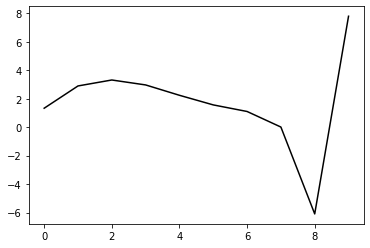

160600 28.24080403573751
0.32473842176950174 -0.14812852226949044 -0.27081767657030215 -0.13315594722049848
[ 1.33328961  2.82873905  3.24806777  2.90257199  2.17591253  1.50085521
  1.0387605  -0.05466514 -6.15456369  7.76004541]


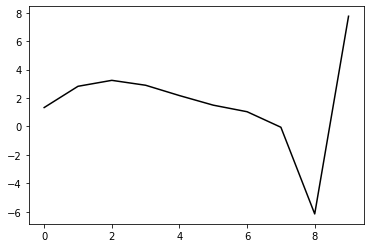

161700 13.008252253406326
0.32937887161941387 -0.1392237988536945 -0.26472022414341695 -0.13774838292166297
[ 1.36903817  2.94125011  3.35506011  3.00330672  2.27035923  1.58917957
  1.12134432  0.02249777 -6.0824989   7.79449731]


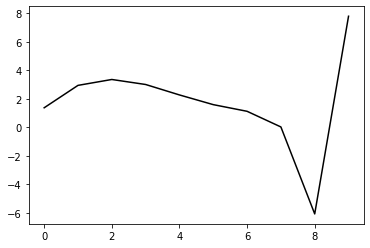

162800 22.185751478413717
0.3286652606838479 -0.13805410047631103 -0.26361057177238184 -0.13961871293520095
[ 1.35214531  2.99587588  3.40748869  3.05290466  2.31741624  1.63412155
  1.16477119  0.06485314 -6.04049204  7.78493345]


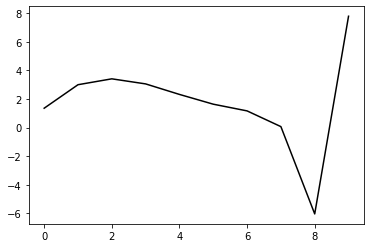

163900 13.874355955589238
0.3301029277729298 -0.1410361573963591 -0.2662394130856208 -0.1373884746698067
[ 1.33831734  2.96476135  3.37609501  3.02005197  2.28344307  1.59945466
  1.130048    0.03057405 -6.07324119  7.7765601 ]


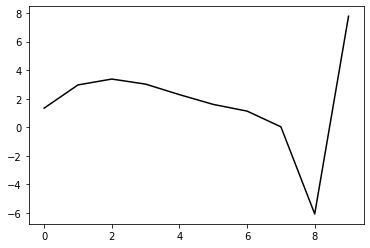

165000 16.31534690482826
0.32889501482488315 -0.14244168368778984 -0.26741462228033963 -0.13637917469921734
[ 1.34751871  2.93732929  3.35866367  3.01089347  2.28146931  1.60372754
  1.13976323  0.04456162 -6.05649486  7.78584584]


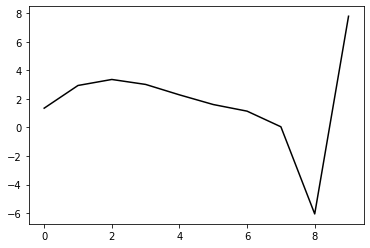

166100 21.57015038158732
0.32776562346217625 -0.1383261210983233 -0.26445073759035026 -0.13718842701140752
[ 1.39324246  2.87661621  3.28975014  2.93502251  2.20060942  1.51938489
  1.05288865 -0.04479671 -6.14997032  7.79138449]


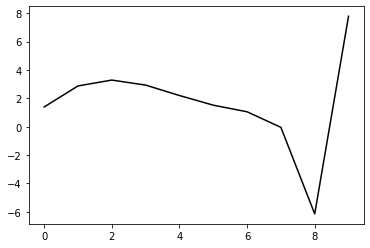

167200 29.481683352201514
0.31840391033126353 -0.13682771484326312 -0.2608889130004501 -0.14063648108823826
[ 1.40342686  2.77816492  3.18392461  2.82536818  2.08959237  1.40862073
  0.94359704 -0.15198815 -6.25477205  7.72364952]


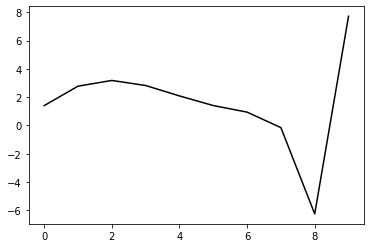

168300 24.93520281470583
0.3236653786775329 -0.13808022721709007 -0.2627248080539152 -0.13876106507648647
[ 1.37290901  2.87624164  3.27562327  2.90930883  2.16502884  1.47534122
  1.00198219 -0.10114686 -6.20839448  7.76884757]


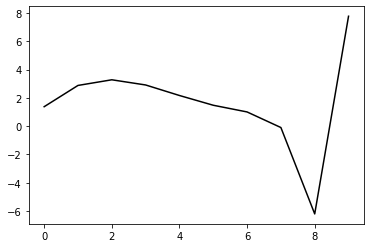

169400 14.293056001016499
0.3265179130955576 -0.13952448803731426 -0.2645409543401639 -0.13845053006694766
[ 1.34640138e+00  2.96138625e+00  3.36511363e+00  3.00127095e+00
  2.25853188e+00  1.56984642e+00  1.09732074e+00 -5.10902206e-03
 -6.11100981e+00  7.76959817e+00]


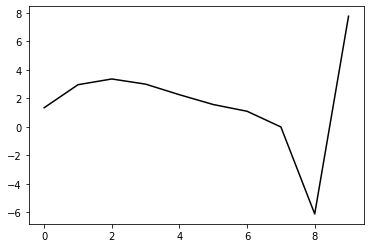

170500 23.101907463779646
0.3306818920707435 -0.13486979342354383 -0.2620717042198801 -0.14040922193212665
[ 1.35970527  3.07441282  3.48208038  3.11877251  2.37542858  1.68562405
  1.21188262  0.10804091 -6.00022244  7.75820034]


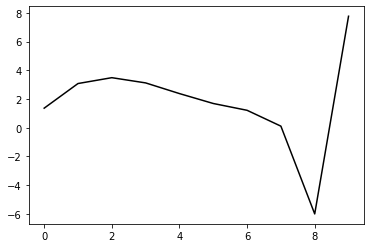

171600 24.523627791990894
0.328334241697146 -0.14009256689249666 -0.26524865960481075 -0.1377232448023363
[ 1.32438137  2.98341344  3.37727702  3.00258343  2.25066303  1.55446504
  1.07634768 -0.03009173 -6.13784601  7.75333352]


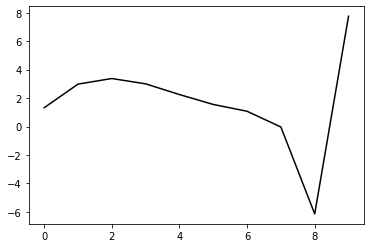

172700 13.901865780927096
0.32672125013872255 -0.13813614173321112 -0.2634235236278245 -0.14057556793266393
[ 1.37665863  2.97666944  3.38320537  3.01814263  2.27423472  1.58504057
  1.11339276  0.01285475 -6.089       7.78825625]


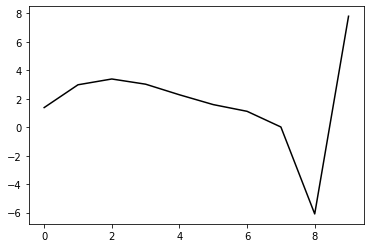

173800 21.92846543281266
0.32378192531806094 -0.14011749780729738 -0.2641201433849452 -0.1416443149459967
[ 1.35592613  2.97271167  3.38461651  3.02312434  2.28182916  1.59470743
  1.12512067  0.02661151 -6.07321307  7.72858955]


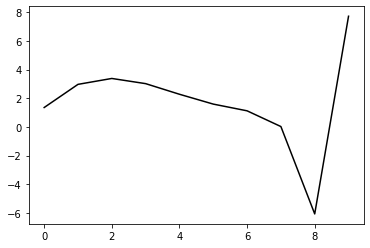

174900 13.205265541882078
0.3268771256815242 -0.138491626982547 -0.2642250849784881 -0.1403510570890515
[ 1.33630846  3.02655819  3.44221259  3.08273822  2.34290942  1.65656712
  1.18665849  0.08594945 -6.01880171  7.80373601]


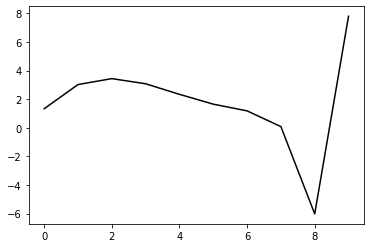

176000 17.277236995241648
0.32943637316130486 -0.14065299363042127 -0.266687109985573 -0.13683214620638773
[ 1.30484912  3.02872518  3.43907833  3.07403149  2.32906111  1.63807628
  1.16410201  0.05964047 -6.04843892  7.7799034 ]


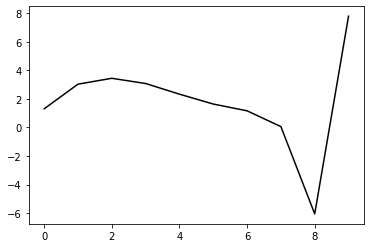

177100 27.679820630333523
0.3209466030807196 -0.14121584058136483 -0.2648465210479534 -0.13887945530393978
[ 1.42849363  2.77117682  3.17767744  2.81259575  2.07052401  1.3846066
  0.91748258 -0.17906976 -6.27916958  7.75845548]


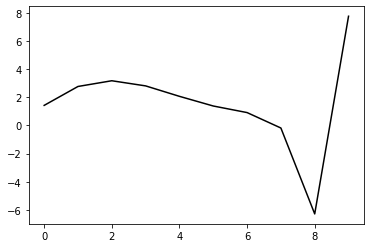

178200 23.44519252888145
0.3239666706971763 -0.1393482324548967 -0.2636733769625982 -0.13917526850287124
[ 1.37289133  2.88565879  3.27850907  2.89939116  2.14348652  1.44417249
  0.96437042 -0.14395536 -6.25326201  7.75641433]


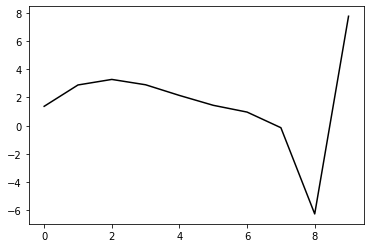

179300 24.11937428215068
0.3238412228939009 -0.14008426050513578 -0.2641893761963364 -0.14005366232842054
[ 1.36011277  2.93238886  3.33408399  2.9612431   2.20991917  1.51409026
  1.03723871 -0.0684908  -6.1742666   7.79393641]


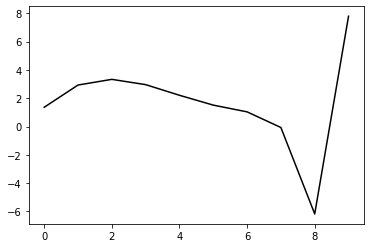

180400 14.13557905913076
0.32709162414688964 -0.13858395737039744 -0.26421684149490404 -0.13914387590049504
[ 1.34255957  3.02029176  3.41781062  3.0391157   2.28221425  1.58130614
  1.09987944 -0.01023081 -6.12042659  7.74888272]


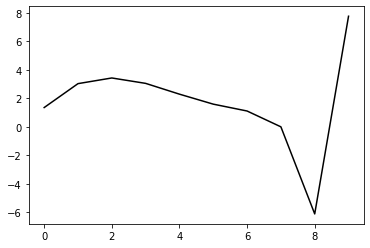

181500 21.942131701114803
0.32661916947371106 -0.13996766806832903 -0.2651185152159956 -0.14075230789701568
[ 1.35797335  3.04319168  3.45966264  3.09611843  2.35188948  1.66195606
  1.19046751  0.08928716 -6.01294332  7.81154681]


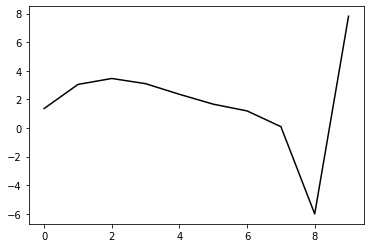

182600 24.69849221576531
0.3269850011355817 -0.14052104022502804 -0.26620202690085476 -0.1376428553438573
[ 1.3225354   3.00810998  3.41798067  3.04815731  2.29870449  1.60428565
  1.12876176  0.02351045 -6.08286305  7.76965179]


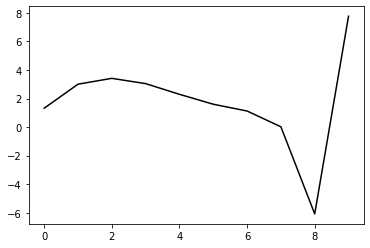

183700 16.45589790489378
0.3228118259380696 -0.14029738970939962 -0.26509315322996346 -0.13948451798789885
[ 1.41924280e+00  2.92860320e+00  3.35076386e+00  2.99179533e+00
  2.25203272e+00  1.56660537e+00  1.09983074e+00  2.93343594e-03
 -6.09519865e+00  7.79162202e+00]


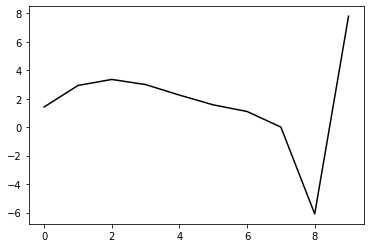

184800 24.04330853624891
0.32311406041780255 -0.14172308610263112 -0.2662224323342476 -0.13852963080181518
[ 1.33674613  2.9497794   3.35445215  2.97810732  2.22221189  1.52232096
  1.0431347  -0.06429661 -6.17219593  7.73392646]


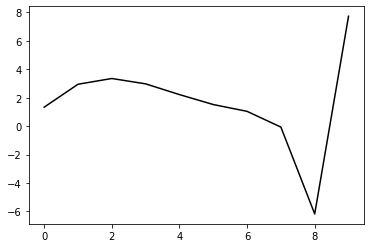

185900 18.12782831399929
0.3244395950092038 -0.14630548768496535 -0.27002383487219206 -0.13628953919017875
[ 1.3350462   3.01303214  3.43269372  3.06651872  2.3169548   1.62069256
  1.14358128  0.03729826 -6.06835729  7.81157793]


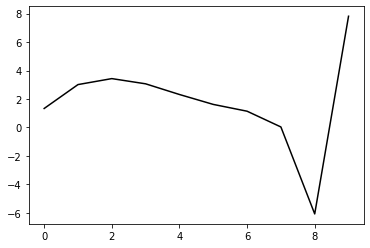

187000 16.759711649437723
0.32787422944476824 -0.14127779805486682 -0.26735498268139996 -0.136089942396712
[ 1.31730647  3.09481363  3.50352848  3.12587471  2.36575455  1.65973281
  1.17339214  0.05785406 -6.05841554  7.77877213]


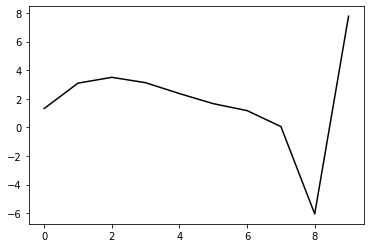

188100 20.249473662467285
0.3251349643969957 -0.1437109180624492 -0.26904817719240337 -0.13452105594198802
[ 1.33270705  2.9868016   3.40825819  3.0433424   2.29615694  1.60293075
  1.12885752  0.02419999 -6.08285108  7.78846364]


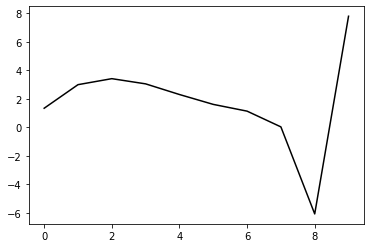

189200 22.881236232986332
0.3253174750594927 -0.14137451713800994 -0.26787292381260386 -0.13416673164209916
[ 1.35957246  2.98372293  3.40542623  3.04058264  2.29361199  1.60044406
  1.12582529  0.01919143 -6.09292447  7.73900242]


190300 24.349319998315053
0.3157037689495824 -0.14147163386042483 -0.26542907149907774 -0.13486090488986155
[ 1.37246704  2.82956171  3.23629446  2.86030018  2.10541948  1.40699545
  0.92952546 -0.17817716 -6.29234842  7.76750938]


191400 15.339078065644388
0.32037016955795644 -0.1387796672974758 -0.26405203865795146 -0.13587903598168258
[ 1.36465049  2.94565065  3.34751834  2.96491882  2.20256756  1.49628067
  1.01090527 -0.10448707 -6.22329817  7.7530255 ]


192500 22.327648205807563
0.32565010276253115 -0.14008415099089913 -0.2662034605503404 -0.13502259882324052
[ 1.33641016  3.03793249  3.44042989  3.05637527  2.29163288  1.58256784
  1.09448416 -0.02339064 -6.14321953  7.77625324]


193600 25.056574780928976
0.33030907254677655 -0.13558027615026966 -0.26416428050510954 -0.13677430266157667
[ 1.31114032  3.17608867  3.58224638  3.1982372   2.43231866  1.72144983
  1.23121056  0.11060283 -6.0140114   7.81336701]


194700 14.9968880320865
0.32614972351640137 -0.13556859437417088 -0.2635402934626337 -0.13762119631553632
[ 1.39715641  3.04478514  3.46784727  3.09959007  2.348666    1.65179373
  1.17449061  0.06534442 -6.04869001  7.76792097]


195800 25.06635441001337
0.3238595567899576 -0.13620117394873882 -0.26359224707115786 -0.1387454066819232
[ 1.39446814  3.0538935   3.48381106  3.12043336  2.3732334   1.67940863
  1.20492461  0.09834141 -6.01288275  7.7993022 ]


196900 13.017706138535333
0.32326655406370997 -0.13873019727118466 -0.26532301230021005 -0.13842525956418378
[ 1.35106696  3.06979691  3.49723859  3.1319349   2.38357662  1.68922595
  1.21470119  0.10818287 -6.00281065  7.79193229]


198000 20.61221686059772
0.32639325008446674 -0.14422983091396366 -0.27078231113499923 -0.13109218559532132
[ 1.31348641  2.94868485  3.36744576  2.99695889  2.24649433  1.55221004
  1.07921057 -0.02519837 -6.13369221  7.74802681]


199100 19.950579969568935
0.3260519856990071 -0.14211284868258833 -0.2683435809969296 -0.13407134166870566
[ 1.32494053  3.01544014  3.41782388  3.03101085  2.26512892  1.55678335
  1.07141239 -0.04363178 -6.16136267  7.7717847 ]


200200 22.880264670826808
0.32552098880036817 -0.14194893767650577 -0.26818299017317626 -0.13506091536819262
[ 1.3303765   3.00701149  3.41722877  3.03685757  2.27695503  1.57438751
  1.09470431 -0.01516419 -6.12926672  7.81308469]


201300 20.79858799651875
0.32123235112170256 -0.14410858370947008 -0.26895579374749806 -0.13506379552943093
[ 1.35030637  2.94821613  3.37047971  3.00093364  2.25064037  1.55677765
  1.08523687 -0.0171422  -6.12370897  7.76685731]


202400 14.218189361700187
0.32245830551797083 -0.13950059766561126 -0.2659557608875189 -0.13791966490961535
[ 1.36623128  3.00030657  3.42311338  3.053263    2.30274381  1.60887212
  1.13747365  0.0349785  -6.07251837  7.72902258]


203500 22.711936729101858
0.32644468635990276 -0.1328062228091643 -0.26231929800768766 -0.13833156389019868
[ 1.36109696  3.07714247  3.4946502   3.1177294   2.35986681  1.65863312
  1.17997081  0.07006925 -6.04579835  7.77109873]


204600 24.284291443970556
0.3243371973920515 -0.13847567760625362 -0.26560320486634226 -0.13896854299060135
[ 1.32840302  3.10172452  3.52931553  3.15860371  2.40476191  1.70653918
  1.23079794  0.12397579 -5.98811388  7.76318966]


205700 23.970946307505578
0.32328809582538487 -0.13300394219501063 -0.2617362800014763 -0.1400122843080465
[ 1.4182208   2.99799186  3.4295024   3.06322756  2.31460444  1.62205254
  1.15214503  0.05071269 -6.05601444  7.76526483]


206800 22.66351284768896
0.31867144861482694 -0.13823687149352157 -0.26400815678700473 -0.13998260569674262
[ 1.37748255  3.00407223  3.43041128  3.0589065   2.30471587  1.60679923
  1.1323016   0.02727851 -6.08062458  7.75494204]


207900 14.214274548349929
0.32409219211878376 -0.13733801502645995 -0.2651086074328326 -0.13757634837004498
[ 1.33040221  3.06947999  3.49386489  3.11928761  2.3618143   1.66054586
  1.18251575  0.07330675 -6.04033989  7.80242226]


209000 16.478455268474267
0.32499984343231625 -0.1384721123728542 -0.2664256371063715 -0.13539569506479893
[ 1.31282622  3.07076531  3.48915935  3.10850714  2.3453441   1.63874778
  1.15564418  0.04129417 -6.0773688   7.77733644]


210100 20.806676385013677
0.32456810411588255 -0.13712245179606192 -0.26560812018777047 -0.1354498297929763
[ 1.34451733  3.00849036  3.42861336  3.04938667  2.28795225  1.58352608
  1.10316635 -0.00815826 -6.12366589  7.77543658]


211200 23.088382450698905
0.3217134400574934 -0.13901058918369755 -0.2665141671024299 -0.13496323162464732
[ 1.36711247  2.98199424  3.41185426  3.04113904  2.28728666  1.58987914
  1.11615889  0.010689   -6.09967041  7.78955972]


212300 22.02440333273306
0.3248211855471254 -0.13343229594841147 -0.26398986190272367 -0.13349828345371684
[ 1.30997036  3.0290721   3.45353983  3.07711983  2.31769976  1.61478218
  1.1355533   0.02429959 -6.09257057  7.75355772]


213400 14.207117633254454
0.3206607086047875 -0.13881331531051533 -0.2664522559781668 -0.13640157098255162
[ 1.37374176  3.00538292  3.45571514  3.10290832  2.36449763  1.68087202
  1.22006559  0.12648194 -5.97220009  7.76849168]


214500 22.08217029148009
0.31865287994783226 -0.13555135369446786 -0.2635094876026674 -0.13592606781296698
[ 1.34604769  2.94178285  3.37232261  3.00265105  2.25005271  1.5543713
  1.08320208 -0.01947213 -6.12533157  7.77176655]


215600 24.321241595119883
0.31976254326865505 -0.14004502970921762 -0.2668012895139867 -0.1380564304479885
[ 1.33097604  3.01055739  3.45748927  3.10042592  2.35734509  1.66925008
  1.20453815  0.10738396 -5.99381434  7.77326849]


216700 14.321425478305725
0.31650714761929166 -0.13912102837059073 -0.2652442448928487 -0.13756540817181523
[ 1.39530989  2.86249532  3.30747233  2.95207098  2.21184915  1.52707545
  1.06587442 -0.02795169 -6.12549587  7.79211945]


217800 25.492183165216982
0.3163979628623373 -0.13583754366073175 -0.26219279381932303 -0.1403133029654389
[ 1.37954454  2.94702652  3.38322179  3.01923679  2.27041285  1.57745541
  1.10890275  0.0087273  -6.09283817  7.75835262]


218900 17.28871225617605
0.3202764379184695 -0.14003920707667938 -0.2662143608669673 -0.1383909983243078
[ 1.29397075e+00  2.96467841e+00  3.39530717e+00  3.02693057e+00
  2.27449904e+00  1.57873183e+00  1.10824708e+00  6.86328990e-03
 -6.09447932e+00  7.79992587e+00]


220000 19.60163084084235
0.32447356503802327 -0.1384675296352662 -0.26639910800377253 -0.13719278497651852
[ 1.28039427  3.06447154  3.49475379  3.12438373  2.3692222   1.67037335
  1.19649231  0.09105816 -6.01629189  7.79149499]


221100 22.29782402039094
0.31794665502085495 -0.13879207549137942 -0.2649035674463264 -0.13842147286463977
[ 1.38858636  2.87951931  3.30886617  2.93981454  2.18733118  1.49218047
  1.02288845 -0.07741835 -6.17783827  7.80426935]


222200 25.255076166269806
0.31260421373500275 -0.13920134130538708 -0.2636176518628133 -0.14038940491839483
[ 1.38329664  2.81500465  3.24964306  2.88635564  2.13901193  1.44841383
  0.98329398 -0.11330899 -6.20999459  7.72914944]


223300 25.106308818269714
0.31123530746477684 -0.140065250052368 -0.2637065616895371 -0.1402690167685984
[ 1.35763165  2.80354508  3.23025481  2.86005443  2.10619926  1.40965237
  0.93937728 -0.16156772 -6.26111634  7.77527478]


224400 14.822486539360895
0.3169498648578204 -0.1400400424179436 -0.26511938521936873 -0.13895076087616504
[ 1.33331535  2.94028771  3.36360721  2.98923144  2.23076311  1.52944338
  1.05438667 -0.0513008  -6.15352502  7.7596838 ]


225500 21.914878568495226
0.3189626164686193 -0.14089841214906715 -0.2662947214886741 -0.1382974935940536
[ 1.32219805  2.96467158  3.38772636  3.01274779  2.2534954   1.55140726
  1.07575128 -0.03046034 -6.13264377  7.78446402]


226600 24.806576481216826
0.3191593772994661 -0.1418320090257866 -0.2670236834526706 -0.1386334277251031
[ 1.31882259  2.98467771  3.41475698  3.04529129  2.29029678  1.59176926
  1.11935218  0.01599979 -6.08341407  7.75931739]


227700 13.242273349888343
0.3183849373999653 -0.13788073750504753 -0.2642014837538602 -0.14026434926074421
[ 1.36382915  2.98373937  3.41631803  3.04818365  2.29420385  1.59649297
  1.12458834  0.02104004 -6.0794069   7.79139039]


228800 22.29453659160247
0.31624690425522817 -0.13846192084219017 -0.264321273611773 -0.14145991237428948
[ 1.36556434  2.99736368  3.44336407  3.08694728  2.34311208  1.65435212
  1.19037617  0.09328966 -6.00331803  7.77804495]


229900 13.58351991887425
0.3166198814412219 -0.13930808514129223 -0.2656295003148356 -0.13948797928170376
[ 1.33274274  2.96877694  3.40928595  3.04891909  2.30268646  1.61261182
  1.14766437  0.04885159 -6.05179784  7.78989118]


231000 16.18769196812453
0.3204385063408565 -0.13888756066115973 -0.2667701492001899 -0.1370423773082815
[ 1.30619995  2.99396869  3.43412573  3.07252706  2.32497735  1.63382894
  1.16792252  0.06761759 -6.03640851  7.78942535]


232100 19.348554349825363
0.3183424680938798 -0.1414564230972112 -0.26799275055566496 -0.13521558607218562
[ 1.3244055   2.952852    3.37949165  3.00434606  2.24390145  1.5413319
  1.06621531 -0.04088144 -6.14786979  7.77962333]


233200 28.23692984593511
0.31015612891957417 -0.13665131400572889 -0.26220395119092477 -0.14080658501134843
[ 1.3953234   2.7959009   3.22714266  2.85760428  2.10277256  1.40565746
  0.93593479 -0.16612744 -6.26940217  7.7441592 ]


234300 24.94221086211587
0.3111184105136326 -0.13973796558289012 -0.26443562342503524 -0.13930463865186443
[ 1.35989878  2.8233518   3.24911468  2.87425509  2.11374836  1.41095148
  0.93595873 -0.17071435 -6.27605622  7.7669866 ]


235400 14.381365000376364
0.3173877574230539 -0.13885446434341772 -0.26512974060875266 -0.1390078692064914
[ 1.3407555   2.98279186  3.40553588  3.02631933  2.2607104   1.55254712
  1.07227111 -0.03941867 -6.14756313  7.76277336]


236500 21.761816073130962
0.31814597429270325 -0.14059382411794674 -0.26654809510420413 -0.1392237098887067
[ 1.33641419e+00  2.98874292e+00  3.41978514e+00  3.04677350e+00
  2.28589981e+00  1.58170759e+00  1.10516714e+00 -2.96041498e-03
 -6.10735948e+00  7.79339135e+00]


237600 24.45901405614256
0.3218515211817156 -0.13783096070225817 -0.26567580707919647 -0.13961685803930537
[ 1.31006293  3.10224752  3.5335959   3.15965117  2.39762913  1.69215653
  1.21399328  0.10330443 -6.00626263  7.77132984]


238700 13.887381795527267
0.32023279647023783 -0.13776276274047425 -0.2655933081308914 -0.13977154107649928
[ 1.350936    3.02370596  3.46100161  3.09257552  2.33580908  1.63533554
  1.16185989  0.05510639 -6.05115798  7.8232601 ]


239800 30.5211165322667
0.3143724229924767 -0.13601298182494903 -0.26229208591289527 -0.14226783042918562
[ 1.39229967  2.97711597  3.40404625  3.02816     2.26535905  1.55989636
  1.0826241  -0.0266745  -6.13322979  7.74478224]


240900 15.63333875182531
0.3220699804471146 -0.1385921574981095 -0.2659975507055461 -0.13934404522963234
[ 1.30655696  3.0531141   3.47398196  3.09160252  2.32259802  1.61153707
  1.12951345  0.01625462 -6.09358894  7.79453811]


242000 17.717266691766124
0.32196058091896096 -0.14449517332761805 -0.2707429960564363 -0.13492837937851265
[ 1.32319326  2.89669275  3.32612801  2.95232622  2.19168396  1.4887052
  1.01451303 -0.09151129 -6.19488481  7.74965201]


243100 22.4529440721849
0.31891160127633006 -0.14008590693649567 -0.26647319788556395 -0.1390921111706364
[ 1.38616746  2.90168211  3.33419767  2.96330463  2.20505532  1.50411701
  1.03173344 -0.07288482 -6.17458209  7.80691741]


244200 22.25413582042905
0.3187336534796437 -0.13668683009765717 -0.2643518994836778 -0.13898301371891378
[ 1.34207173  2.9488727   3.37199157  2.99185912  2.22543133  1.51720435
  1.03805466 -0.07334829 -6.18290528  7.74598277]


245300 21.609475350963258
0.3228462803658954 -0.13593283302377585 -0.2652245100389579 -0.1362024314461361
[ 1.30914326  3.00068746  3.42170871  3.03861691  2.26904561  1.55769516
  1.07556663 -0.03883993 -6.15130913  7.76596597]


246400 16.168314192731227
0.31783617270117615 -0.1386450219081497 -0.2659093760201505 -0.1393344757947596
[ 1.3948102   2.95905449  3.4090195   3.05102655  2.30309961  1.61100088
  1.14667513  0.04875426 -6.04731329  7.79196428]


247500 22.06537243749022
0.31713121464829447 -0.14204036351398092 -0.2683793149783948 -0.13628127143303326
[ 1.3190194   2.93373334  3.3682666   2.99651849  2.23630648  1.53321449
  1.0590399  -0.0479329  -6.15292779  7.77655346]


248600 25.231093232957154
0.3170296220141083 -0.14378099122376556 -0.2696238657124217 -0.13570423062669057
[ 1.33645541  2.94336629  3.37936874  3.00924675  2.25021078  1.54792713
  1.07428056 -0.03257128 -6.13657276  7.76160122]


249700 13.330325962965732
0.3178515091316953 -0.1389688468387287 -0.26621577261669416 -0.1389196365362
[ 1.37087856  2.96457963  3.40912832  3.04559712  2.29146433  1.59299903
  1.1225042   0.01813735 -6.08380639  7.78809492]


250800 22.29359231234806
0.31776275258276077 -0.13755662205306757 -0.26512977682157535 -0.14042779566764893
[ 1.34549987  3.01374237  3.45690485  3.09170213  2.33563895  1.63528477
  1.16313042  0.05718418 -6.04619135  7.78428252]


251900 13.985078283964341
0.3193582929565264 -0.13990174886697057 -0.26750158080447706 -0.1372027902162723
[ 1.34235243  2.922494    3.35767854  2.9865256   2.22671349  1.5244336
  1.05195495 -0.05318164 -6.15431111  7.74945212]


253000 17.821834792177274
0.3211436852349177 -0.13949236703326204 -0.2679597634891358 -0.13734845652629327
[ 1.29578269  3.04588715  3.49020608  3.12507991  2.36886531  1.66838838
  1.19624163  0.089799   -6.01522094  7.81317035]


254100 25.405631731949686
0.3151339215353053 -0.13941010013865726 -0.2664520505002777 -0.13680700707552032
[ 1.40210868  2.8036637   3.23548749  2.86336449  2.10382964  1.40263966
  0.93183141 -0.17190146 -6.27304067  7.77866207]


255200 27.55210122605454
0.3094336727403838 -0.13688378898818118 -0.2629063823084877 -0.14155914610158848
[ 1.38575738  2.81604604  3.25527881  2.8894755   2.13449683  1.43642453
  0.96756384 -0.13532627 -6.23504349  7.73771554]


256300 24.65865203145306
0.3124981098103733 -0.13768753827309904 -0.264369940686026 -0.13988514068255772
[ 1.35987984  2.87583518  3.31291269  2.94472285  2.18692124  1.48580701
  1.01383332 -0.09225414 -6.1942351   7.77965383]


257400 14.319997326950263
0.31540290589941045 -0.13792976546217256 -0.2652850193896093 -0.1393208147602537
[ 1.33918507  2.94771778  3.3854811   3.01714971  2.25849736  1.55622138
  1.08307842 -0.02415166 -6.12635164  7.7630996 ]


258500 22.2381235998887
0.3204102507105792 -0.13370737931251117 -0.2636112956711808 -0.13957931084905614
[ 1.34557728  3.01234646  3.44783009  3.07621747  2.31426738  1.60891669
  1.13305257  0.02322206 -6.08214157  7.76705884]


259600 25.623478045033693
0.31631363034051235 -0.13832026738660172 -0.26537722797371716 -0.14132632742140813
[ 1.33656909  3.0018476   3.4426414   3.07609876  2.31863042  1.61754785
  1.14619361  0.04120454 -6.05764626  7.78329792]


260700 12.991175389511637
0.31602447003024375 -0.13874702350481036 -0.26588238656092855 -0.13927279056677477
[ 1.3683172   2.9030625   3.34923651  2.98881034  2.23705556  1.54111616
  1.0743117  -0.02696667 -6.12236306  7.78298423]


261800 26.788244214149877
0.3130538775806116 -0.13655094874502494 -0.26319201917304413 -0.14311967952633584
[ 1.37673951  2.95796802  3.40249939  3.04080579  2.2873016   1.58933811
  1.12051079  0.01728614 -6.07875407  7.76420017]


262900 19.12161398441458
0.3186398441676519 -0.14011084603857343 -0.26718931250753475 -0.13958136023210857
[ 1.28162038  2.95420436  3.38672018  3.01587795  2.25518843  1.55152755
  1.07826965 -0.0283903  -6.12613709  7.79765465]


264000 16.406396792994922
0.3196385298815533 -0.14166115597966697 -0.26863718734134373 -0.1385845751912681
[ 1.31203116  2.9552472   3.40059358  3.03968939  2.28648525  1.58874699
  1.12042644  0.01778528 -6.07660392  7.75736284]


265100 20.433460088021466
0.31926637785631407 -0.14107448541129974 -0.2684954480713582 -0.13958966015332683
[ 1.31787557  2.956726    3.41532776  3.06534475  2.32126311  1.63135109
  1.16962806  0.07190473 -6.02024743  7.80057276]


266200 22.851623484940422
0.31609482524620014 -0.14386698133771028 -0.2700976702541378 -0.13746544903179803
[ 1.33202624  2.89677431  3.35171451  3.00116003  2.25801502  1.56996561
  1.11064414  0.01530263 -6.07387898  7.77395157]


267300 21.234727678593146
0.3195302902326675 -0.1377856813251389 -0.2667772858536614 -0.13732104600813852
[ 1.3114277   2.94442548  3.3893162   3.02912586  2.27724117  1.58132756
  1.11472933  0.01206994 -6.08610542  7.80912103]


268400 18.577901816427783
0.3153167640402656 -0.13812500720800072 -0.2660338858063107 -0.13994369540545412
[ 1.40567685e+00  2.86030683e+00  3.31978194e+00  2.97314383e+00
  2.23337323e+00  1.54867172e+00  1.09295039e+00  7.97760979e-04
 -6.08653779e+00  7.77986440e+00]


269500 21.320189692982115
0.3141328592730274 -0.14397497279471613 -0.2702154596358726 -0.13567599941507208
[ 1.3242861   2.82950412  3.27085086  2.91324007  2.1668256   1.47828585
  1.02045718 -0.07313489 -6.16179906  7.83301608]


270600 24.646270348381293
0.31845675806540513 -0.13912396839119934 -0.2677196836598417 -0.13687485020794277
[ 1.33084772  2.93409907  3.37349133  3.01292063  2.26288095  1.57034934
  1.10823475  0.0099026  -6.08345379  7.77802823]


271700 15.219701593690393
0.314450387678722 -0.13837214949458743 -0.26622233539716844 -0.13916851288076873
[ 1.39968398  2.83967206  3.29647112  2.95186624  2.21512783  1.53383489
  1.08148365 -0.0084889  -6.09432405  7.79313726]


272800 23.88956100045449
0.3174437602392358 -0.13671095464068037 -0.26590791454162804 -0.13861472321584925
[ 1.32263845  2.91629597  3.35589032  2.99548919  2.24483913  1.5514528
  1.08868225 -0.01042664 -6.10458996  7.76503648]


273900 14.191736546285568
0.3181348332743077 -0.13676486030703225 -0.26627710284272926 -0.13908639307059883
[ 1.32206833  3.00989514  3.46089626  3.10972228  2.36594757  1.67753084
  1.21803105  0.12023489 -5.97543552  7.81234196]


275000 15.959219881071775
0.31962201877373275 -0.1361409616864141 -0.2665012075180229 -0.13658541215782802
[ 1.30406997  2.99985055  3.43916022  3.07755092  2.32458199  1.62799078
  1.16112299  0.05640965 -6.04541293  7.78505728]


276100 19.65203874413369
0.32012732819691214 -0.13832190171249345 -0.26842526786333165 -0.13457288141716642
[ 1.31997849  2.93409729  3.3729753   3.0108348   2.25726245  1.56018708
  1.09315821 -0.01160799 -6.11355878  7.78083144]


277200 23.21449943626985
0.3171972051793968 -0.1390570310017197 -0.26849594095239726 -0.13552415017408445
[ 1.35827257  2.89882316  3.35072518  3.00070653  2.25832222  1.57171597
  1.114564    0.0186203  -6.07582385  7.73524266]


278300 24.647468443479745
0.3090057762575394 -0.1388301966612374 -0.2659077419639492 -0.13711797040608104
[ 1.36327042  2.7536399   3.18708149  2.82654422  2.07869816  1.39020229
  0.93387066 -0.15962377 -6.25206721  7.77361263]


279400 14.892709617678541
0.31536539956872467 -0.13636016157080252 -0.26534610439641265 -0.13652099662224731
[ 1.35058418  2.91328098  3.33919447  2.96980993  2.21233921  1.51396993
  1.04789991 -0.05489101 -6.15348087  7.76128558]


280500 21.920456890593222
0.31795569544703783 -0.13878599403364525 -0.2677901782160329 -0.13565683754168478
[ 1.3321616   2.95169163  3.37974989  3.01148865  2.25427849  1.55572256
  1.08941033 -0.01361421 -6.11175685  7.78170002]


281600 25.456870630366446
0.3181107659268764 -0.14078030606230668 -0.26945131500322755 -0.13369878998201887
[ 1.32950186  2.93530603  3.36170228  2.99261382  2.23490215  1.53603092
  1.06961944 -0.03344711 -6.13108179  7.76213181]


282700 13.33494485588382
0.31804445642396606 -0.1365800594115857 -0.26600137932406864 -0.13824156340263308
[ 1.37827371  2.98839371  3.42368876  3.06080296  2.30735398  1.61157534
  1.14766415  0.04666874 -6.04840357  7.79010618]


283800 24.32639132419452
0.3170934008215929 -0.13625480061645512 -0.26569536590031484 -0.14009808309120889
[ 1.39144108  2.99481154  3.4397325   3.08443992  2.33742187  1.64733274
  1.1885739   0.09189857 -6.00018204  7.77874952]


284900 17.15017003722561
0.31834129035959724 -0.13888144893489088 -0.26781978190850697 -0.13651760401133606
[ 1.30306815  2.97460744  3.39316888  3.01698777  2.25300997  1.54891327
  1.07863373 -0.02743347 -6.12583227  7.80948205]


286000 17.825567604110322
0.3214686696914556 -0.14168731425926456 -0.2703950891223753 -0.13452892334229613
[ 1.31535572e+00  3.01791870e+00  3.43588515e+00  3.05822111e+00
  2.29223663e+00  1.58601561e+00  1.11388190e+00  6.35937343e-03
 -6.09208221e+00  7.74669533e+00]


287100 19.80381057897755
0.32145546983461987 -0.1392305528422356 -0.2685945747107995 -0.1361595600707749
[ 1.33550745e+00  2.98755678e+00  3.40970466e+00  3.03553581e+00
  2.27279831e+00  1.56962786e+00  1.10037388e+00 -4.72394515e-03
 -6.10143866e+00  7.80609839e+00]


288200 22.757345096616667
0.3202124459223643 -0.13842863741963932 -0.2681989125509034 -0.13575698695938462
[ 1.34383276  2.96253051  3.38861096  3.01749347  2.25785609  1.55781682
  1.09150219 -0.01148071 -6.10817711  7.7584387 ]


289300 20.983990630220248
0.3166005362334044 -0.14186518463740672 -0.27002792668324777 -0.1351346070858331
[ 1.34339179  2.90585893  3.3383573   2.97432111  2.22180402  1.52879944
  1.06954443 -0.02657024 -6.11559934  7.77141441]


290400 15.491541337177553
0.3175941241599259 -0.1363433687143286 -0.2662178155039647 -0.13846612196558555
[ 1.38932124  2.9757364   3.41402955  3.05353701  2.30345435  1.61228764
  1.15451885  0.05935074 -6.02924115  7.76492685]


291500 22.117915024080183
0.31734790130624385 -0.13745585879253286 -0.267275320111465 -0.13851296635759702
[ 1.36846672  2.9835216   3.42885693  3.07446682  2.32977979  1.6433897
  1.18980971  0.09783673 -5.98955419  7.82594657]


292600 25.23933826276941
0.31673886788286076 -0.14216322151224062 -0.27068060612085 -0.13438706436682113
[ 1.34132818  2.92445622  3.3532816   2.98644407  2.23243549  1.53904325
  1.08029984 -0.01557737 -6.10557905  7.75986302]


293700 13.282490170146724
0.31732782788765335 -0.13742359514827265 -0.26724885549346244 -0.1376194875913444
[ 1.37941559  2.94801123  3.38525283  3.02449122  2.27473204  1.58445908
  1.12824148  0.03435958 -6.05394874  7.79173727]


294800 24.746418837995744
0.31458294000822934 -0.1348716258445754 -0.2646086913242622 -0.1403221842153497
[ 1.38302621  2.96766926  3.40353627  3.04237484  2.29206492  1.60096032
  1.14372424  0.04856354 -6.04053707  7.77405618]


295900 23.444214168908008
0.3193466452132758 -0.13925159926389472 -0.26907101539076117 -0.13671697232749971
[ 1.28929881  2.95115716  3.37900938  3.01230775  2.25803631  1.56413008
  1.10509825  0.00882433 -6.08037338  7.80449348]


297000 18.140151615521056
0.3215256302123043 -0.1419824196046071 -0.27134655224465337 -0.13445733415774816
[ 1.31279439  2.96968199  3.39409036  3.02463201  2.26752057  1.57078791
  1.10916746  0.01056813 -6.07954662  7.75566135]


298100 22.414683804383596
0.31773536492956767 -0.13834859596801033 -0.26732236310601154 -0.13829876549508455
[ 1.38673316  2.89912503  3.32166103  2.95096425  2.19277604  1.49508475
  1.03273215 -0.06640761 -6.15583384  7.81080101]


299200 22.245045494109196
0.3160277604651856 -0.13875310168064534 -0.26730032805204396 -0.13876585441998357
[ 1.3691534   2.85501789  3.28350919  2.91836645  2.16514005  1.47190368
  1.01362566 -0.08201427 -6.16868188  7.74450368]


300300 25.14847848795893
0.31137971948307097 -0.1380604726948777 -0.26544807668230436 -0.14056351276615148
[ 1.3646318   2.78956517  3.21718908  2.85272585  2.10038615  1.40816245
  0.95125299 -0.14274871 -6.2276887   7.78172912]


301400 14.527545651043186
0.3157410565889766 -0.13735382797980808 -0.26608799149363516 -0.1394798954869031
[ 1.34216458  2.91268503  3.33929193  2.97261206  2.21733436  1.52172701
  1.06109191 -0.03703786 -6.12511393  7.7648332 ]


302500 22.366248198059793
0.31843440081228963 -0.13878912118890002 -0.2679405493659099 -0.13787733142086703
[ 1.31681259  2.93178195  3.36069628  2.9960803   2.2422906   1.54773766
  1.08792603 -0.00968945 -6.09720582  7.78485744]


303600 24.55518294472439
0.31956712958855643 -0.13830057917589855 -0.26790556292398193 -0.14027264441856252
[ 1.31985576  3.05286361  3.49887758  3.14528704  2.39859229  1.70885663
  1.25248124  0.15700738 -5.93087996  7.78467405]


304700 15.248799123847585
0.3174289765906905 -0.13494851668045513 -0.2654313885438564 -0.13976019469352413
[ 1.38968548  2.93555348  3.38153055  3.03010469  2.28706097  1.60173829
  1.14996155  0.05855625 -6.02544402  7.81312981]


305800 23.538470720968707
0.3173549762687105 -0.1365763885643175 -0.26684898849006916 -0.13840042337159156
[ 1.31240759  2.93340399  3.37063975  3.01103389  2.26040442  1.56833337
  1.11097048  0.01505616 -6.07270873  7.7619479 ]


306900 13.364059310259348
0.3172322965189643 -0.1382299388413658 -0.26822481516435803 -0.13796346284921426
[ 1.34014582  2.9324277   3.38525487  3.03950232  2.30057772  1.6185594
  1.17009518  0.0818494  -5.99947414  7.79323514]


308000 18.87663247461218
0.31890636520691523 -0.14141301261365363 -0.27142173712561507 -0.13373085268340817
[ 1.30256357  2.84788716  3.2973788   2.94967406  2.20959154  1.52708263
  1.07878693 -0.00912844 -6.09075798  7.77796244]


309100 22.727614558205453
0.3164440480134056 -0.1387833717627115 -0.26848332841430755 -0.13723850050519598
[ 1.37383701  2.86727906  3.30671323  2.94985013  2.20102799  1.51025893
  1.05428738 -0.04075907 -6.12824073  7.8034175 ]


310200 22.128475872247588
0.3159151870374915 -0.13450985228708792 -0.26558404736995583 -0.1379589169491157
[ 1.34211894  2.89159997  3.3248098   2.9616404   2.20677319  1.51017824
  1.04846923 -0.0525871  -6.14747751  7.73607501]


311300 24.991019053465376
0.31229523320812086 -0.13458952858756604 -0.26461115127847595 -0.13928478760335283
[ 1.37090617  2.8523561   3.28829251  2.92886961  2.17803983  1.48571594
  1.02866619 -0.0675026  -6.15659492  7.77859504]


312400 14.53847105309403
0.31463740831464027 -0.13671299049250352 -0.2669111226667705 -0.13773020838036873
[ 1.34275506e+00  2.91240714e+00  3.35168384e+00  2.99497631e+00
  2.24592097e+00  1.55465957e+00  1.09820989e+00  2.18074744e-03
 -6.08598034e+00  7.77521476e+00]


313500 22.608961753361676
0.31758532380673854 -0.13163337931406605 -0.2641152652527567 -0.13928237873771382
[ 1.35743983  2.98939553  3.43321484  3.07894343  2.33106939  1.64013948
  1.18346221  0.08652235 -6.00370386  7.76353103]


314600 25.413469377591575
0.3192189122816639 -0.13458659960121724 -0.26707182084936454 -0.1360787799924692
[ 1.29844484  2.99860619  3.43884999  3.07989896  2.32684811  1.63047871
  1.16835305  0.06588303 -6.03020412  7.78752428]


315700 17.902878281813212
0.3160254493640774 -0.13218134791705768 -0.2643670106258954 -0.13972793914025752
[ 1.40104956  2.92276042  3.37798444  3.03308866  2.29288879  1.60854783
  1.15821144  0.06724363 -6.01683945  7.81365349]


316800 23.524290078249997
0.3156564727597975 -0.13511316377028953 -0.26516051147815695 -0.14162178092964536
[ 1.37223281  2.94333836  3.38548907  3.02998157  2.28099133  1.58971292
  1.13459277  0.04110082 -6.04160519  7.78343706]


317900 20.163763882925288
0.319173452468724 -0.1371425717210881 -0.2677932118217641 -0.13860281218991358
[ 1.28425286  2.95898699  3.39523289  3.03477162  2.28175137  1.58729177
  1.12981969  0.03448913 -6.04970822  7.79499073]


319000 17.26562686918429
0.32081694925703025 -0.13509787305617124 -0.26703271520205446 -0.13931924854375122
[ 1.28426549  3.02368946  3.46626549  3.11086579  2.36169157  1.66985595
  1.21369258  0.11792673 -5.97006175  7.75421397]


320100 19.40674962789317
0.31679610716645445 -0.13869086084369672 -0.2690921635903583 -0.13681027292947467
[ 1.32039094  2.85168235  3.29869592  2.94955333  2.20735247  1.52293281
  1.07464232 -0.01315882 -6.09311316  7.78826074]


321200 22.795386686887838
0.3156115019637642 -0.13779729859746648 -0.2686144213394181 -0.13738069230304556
[ 1.32907429  2.8653178   3.32388271  2.98508673  2.25173676  1.57488403
  1.13295479  0.04992646 -6.02701135  7.78826456]


322300 21.381320350023035
0.31805592233124436 -0.13795703473139695 -0.26858062059387694 -0.13515762410428875
[ 1.32047361  2.90082281  3.32697365  2.96353478  2.21165385  1.52110489
  1.06951287 -0.01992761 -6.09949223  7.7303498 ]


323400 14.262070213461396
0.3186905337887566 -0.1362267651716259 -0.2674704146332391 -0.13761778880164943
[ 1.37713283  2.95034904  3.3973634   3.04868983  2.30709658  1.62415998
  1.17878184  0.09463923 -5.97946732  7.78890531]


324500 20.815442470925152
0.3150232601639949 -0.1381084324437932 -0.2685142372416923 -0.13042024391230486
[ 1.30892311  2.81576606  3.2280979   2.85091513  2.08623167  1.3841947
  0.92266644 -0.1755592  -6.2642516   7.74598201]


325600 25.473007085358702
0.3199249396622007 -0.13709680228209215 -0.26856029590447156 -0.1331642810240342
[ 1.32410708  2.92113146  3.33930064  2.96519327  2.20153417  1.49934737
  1.03722462 -0.06161117 -6.14883306  7.76132775]


326700 13.018206417421457
0.3171027828303674 -0.13641462300904558 -0.2671035611904739 -0.13775710768663207
[ 1.37110369  2.92984321  3.36724959  3.00872925  2.25732434  1.56501754
  1.11124849  0.01957091 -6.06095541  7.78818754]


327800 23.788704474346332
0.3170534133739968 -0.13601461246634503 -0.2666973720162351 -0.1391004543888034
[ 1.33295462  2.96303994  3.39624653  3.03394872  2.27912047  1.58387086
  1.12784762  0.03449078 -6.04705609  7.78564908]


328900 13.056686274016585
0.3177220380138915 -0.13639732730881907 -0.2674402276957362 -0.13904705405847
[ 1.34501044  2.9968947   3.4418029   3.08727166  2.33776132  1.64627688
  1.19297902  0.1012345  -5.98041092  7.84806971]


330000 17.283592979988473
0.31917899457778204 -0.14086866043606502 -0.2713666327482126 -0.13483160541492853
[ 1.32121627  2.96365118  3.40144832  3.04193113  2.28907712  1.5955052
  1.14112773  0.04889873 -6.03198335  7.76356668]


331100 21.268461210505464
0.3177969644323749 -0.13391443138098166 -0.2660960181526988 -0.13742805851308193
[ 1.38535099  2.91163225  3.34235406  2.9770449   2.21974301  1.52260948
  1.06515896 -0.03020166 -6.11514769  7.79556267]


332200 22.426449664395147
0.31922158811676216 -0.1320711874783063 -0.2655390698760457 -0.13549774940242693
[ 1.32749978  2.97177541  3.39394849  3.02035041  2.25530612  1.55077443
  1.08611227 -0.01658351 -6.10965775  7.77030411]


333300 21.913167896961244
0.3136133733558303 -0.1365423213620522 -0.26745489227912017 -0.13598024396330266
[ 1.34392425e+00  2.91162637e+00  3.35079243e+00  2.99183624e+00
  2.23912139e+00  1.54527246e+00  1.09048555e+00 -2.87523019e-03
 -6.08570728e+00  7.78784689e+00]


334400 15.218487129837724
0.31362430287753157 -0.13714597202780426 -0.26802587138153644 -0.13458683251548897
[ 1.37489581  2.87846198  3.31597408  2.95486714  2.19976339  1.50351903
  1.04664276 -0.04853625 -6.13301955  7.76688117]


335500 21.842528488173432
0.3158070589715438 -0.1330349712048996 -0.26585316478206567 -0.13600740719680823
[ 1.34140235  2.9672327   3.41070312  3.05381103  2.30144432  1.60674277
  1.15044058  0.05472818 -6.03087425  7.75850249]


336600 29.04383887763847
0.3131015827208221 -0.14391100200570667 -0.2730639010885225 -0.13353626282502482
[ 1.32201594  2.92230811  3.37553668  3.0281039   2.28458264  1.5985
  1.15110818  0.06450622 -6.01123407  7.79903435]


337700 14.219480533295638
0.31095874767373427 -0.13770170324587738 -0.2671489482344855 -0.1372056693402132
[ 1.39886333  2.92204036  3.35738243  2.9938344   2.2356755   1.53627679
  1.0769466  -0.02011246 -6.10303859  7.7874157 ]


338800 28.746749501302983
0.3105153387784599 -0.13418338456792894 -0.26383375737824605 -0.14053870923745662
[ 1.39295583  2.99378473  3.42180806  3.05137569  2.28675661  1.58141734
  1.11686197  0.01536114 -6.07024993  7.75426434]


339900 16.16525512036774
0.31577541210631477 -0.13811780173304503 -0.26775023873260057 -0.13682366968527943
[ 1.30409454  3.00892788  3.42098159  3.03697631  2.26086035  1.54572485
  1.0730131  -0.03507935 -6.12485892  7.80485575]


341000 17.23601331516844
0.318940758625126 -0.13995167084885443 -0.26982011252557514 -0.1356513259229974
[ 1.31483592  3.05261659  3.47007529  3.08927396  2.31532195  1.60183204
  1.13065355  0.02400541 -6.06428324  7.7656659 ]


342100 19.84636997314618
0.31831351189845447 -0.13958225220351614 -0.269624657106078 -0.13563146511835905
[ 1.31975720e+00  2.98814483e+00  3.41363914e+00  3.03935754e+00
  2.27110788e+00  1.56267728e+00  1.09604956e+00 -6.80260169e-03
 -6.09217397e+00  7.78891546e+00]


343200 22.246361937446746
0.3174821045929084 -0.13799418298162872 -0.268550310747901 -0.13515444212973107
[ 1.32881439  2.99948444  3.42049805  3.04109754  2.26800938  1.55495448
  1.08385938 -0.02365678 -6.11472536  7.7669244 ]


344300 21.38680783419628
0.31841333889313667 -0.13421554718819956 -0.26646433088745036 -0.134401834220862
[ 1.32539169  2.99170245  3.41232944  3.03196586  2.2581585   1.54452772
  1.0729406  -0.03535784 -6.12801557  7.78553461]


345400 14.694524941340218
0.31588741603726456 -0.13791715792596942 -0.26822669912296837 -0.13608232779976492
[ 1.35633753  2.98857331  3.42204623  3.05339445  2.28997214  1.5857293
  1.12296874  0.02286793 -6.06091515  7.77125215]


346500 22.05920973890292
0.3149255924715406 -0.13840579206740067 -0.2683098351397386 -0.13589369241918284
[ 1.32596826  2.9615791   3.38868673  3.01598431  2.25003082  1.54410492
  1.08023005 -0.02076503 -6.10483683  7.78107013]


347600 25.45337683017209
0.3154596442034355 -0.13999872651708387 -0.2697573376458305 -0.13395487464144656
[ 1.32635745  2.94637954  3.37080533  2.99647955  2.22948143  1.52281977
  1.05847852 -0.04289626 -6.12671152  7.76617464]


348700 13.516367137404199
0.31508985937723033 -0.1355402953640238 -0.26605484135489205 -0.1386207713271706
[ 1.3790459   2.99344844  3.42805294  3.06098852  2.29914152  1.59629997
  1.13505365  0.03624087 -6.0445551   7.79227212]


349800 34.22044650168688
0.31436628465964284 -0.13230999787233755 -0.26359638924915774 -0.1406006427000977
[ 1.39911103  2.99951011  3.43873656  3.07495383  2.31589014  1.61543359
  1.15640388  0.0595068  -6.01993142  7.73092549]


350900 12.712320407326063
0.31635109121022126 -0.13494258998013642 -0.2660273672407785 -0.13917049669775883
[ 1.34975873  3.06238409  3.49923133  3.13186721  2.36904726  1.66506671
  1.20305063  0.10362356 -5.97789808  7.79116843]


352000 17.949119959392952
0.31828063122813655 -0.14067234648069973 -0.27088132540003035 -0.13401501755302056
[ 1.3099304   2.93526926  3.36506862  2.9936578   2.22925802  1.52538623
  1.06497286 -0.03166949 -6.1076662   7.75887584]


353100 22.673564397890747
0.31424066279880514 -0.13898175526680942 -0.26852395850651145 -0.13750591304270846
[ 1.36986959  2.87557687  3.31685404  2.95710812  2.20308092  1.5081798
  1.05550768 -0.03473361 -6.10502189  7.81940981]


354200 23.27344581904892
0.3152400106354761 -0.1407041475797327 -0.2703720255002424 -0.13621363864131886
[ 1.31999022  2.91359698  3.36461786  3.01266471  2.26443888  1.57385297
  1.12433014  0.03597664 -6.03385829  7.75293802]


355300 21.874482241185603
0.3120825033368215 -0.13871282908954036 -0.26870626784442425 -0.13429047851091744
[ 1.3184425   2.86064593  3.29559156  2.92802736  2.16585412  1.46300953
  1.00264716 -0.09568955 -6.17709077  7.78416372]


356400 17.557897415055248
0.31163590343923914 -0.13693330088040997 -0.2671998294540307 -0.13867167698319266
[ 1.40536941  2.91910149  3.37696947  3.02930435  2.2841343   1.59627031
  1.14945265  0.06324145 -6.00583485  7.78130415]


357500 21.154420837260712
0.31137706110946567 -0.14019558251425981 -0.26979559656179236 -0.13386057642436255
[ 1.33082074  2.88269663  3.31783806  2.95232048  2.19301369  1.49365305
  1.0371833  -0.05758429 -6.13499541  7.77475518]


358600 25.251388106857256
0.31245015254886743 -0.14117741001742376 -0.27053063775728287 -0.1338572083756328
[ 1.33812765  2.92926287  3.36271876  2.99528804  2.23365329  1.53175195
  1.07275893 -0.02442853 -6.10275179  7.7615481 ]


359700 13.093934227506615
0.31319784473855006 -0.13712510428712146 -0.26751077553470687 -0.13704393712295543
[ 1.3715437   2.95138979  3.38956777  3.02531698  2.2656068   1.56485549
  1.10666144  0.01004197 -6.06733067  7.78895973]


360800 27.211883122954912
0.31046519298067043 -0.13393533348091907 -0.2641859557477824 -0.14022206860257888
[ 1.38918837  2.99275097  3.42514155  3.05575215  2.29141333  1.58654952
  1.1248883   0.02543297 -6.05316258  7.7675893 ]


361900 18.931515068977355
0.31569914080302414 -0.13793529471803168 -0.2683387831415628 -0.13713244805370542
[ 1.29516649e+00  3.00194193e+00  3.42551595e+00  3.04873908e+00
  2.27831554e+00  1.56847828e+00  1.10297292e+00  6.79608935e-04
 -6.07917343e+00  7.80007070e+00]


363000 16.59425755869977
0.3170587172334749 -0.13902086719214873 -0.2694022343930008 -0.1360968428787477
[ 1.31480624  3.02388163  3.45029882  3.07502688  2.30539747  1.59603899
  1.13101225  0.02913128 -6.05033914  7.75594752]


364100 25.079015857217914
0.3107400708741843 -0.1396309728372029 -0.2683346579892918 -0.13722372806095218
[ 1.39502633  2.8090089   3.24151447  2.87428735  2.11334799  1.41283653
  0.9566801  -0.13681347 -6.20924491  7.79250045]


365200 24.28730009393
0.3117779591031788 -0.13516291391708563 -0.2653478786864338 -0.1391530981314462
[ 1.37613954  2.90583177  3.3359153   2.96498275  2.1996814   1.49447068
  1.03337769 -0.0654174  -6.14287421  7.750359  ]


366300 20.71259097647479
0.31546521083464873 -0.13875988287289825 -0.2692815427690492 -0.13603711455938103
[ 1.32772245  2.95653189  3.40030794  3.04011486  2.2833836   1.58523431
  1.13023238  0.03655015 -6.03674052  7.79431374]


367400 17.52241661022988
0.30925941275046415 -0.1401810145169363 -0.26870209633484377 -0.13615614018275204
[ 1.34035415  2.84181572  3.27541676  2.90897741  2.1481841   1.44746638
  0.99122762 -0.10273244 -6.17604493  7.75831918]


368500 22.366287831950103
0.3142432349705473 -0.1379026115874708 -0.2683177887542372 -0.136094227915242
[ 1.31903533  2.95103516  3.3833947   3.01445467  2.25039974  1.54593232
  1.08556313 -0.01298881 -6.09056852  7.79023118]


369600 24.415132014122786
0.3153528847344817 -0.13717791518765626 -0.2681144241871275 -0.13636068423863995
[ 1.33176563  2.98208495  3.41675887  3.04987339  2.28743014  1.58423935
  1.12497025  0.02724057 -6.04935766  7.78199463]


370700 14.148043667919717
0.3155285532558401 -0.13542149838498843 -0.2669195953671747 -0.1393055110594901
[ 1.37202895  3.00213233  3.4513482   3.09549158  2.34192117  1.64623747
  1.19354918  0.10133787 -5.97107749  7.8329337 ]


371800 22.1178835378994
0.31205554211199815 -0.1340274278758322 -0.2654812518976073 -0.1384464433699137
[ 1.35232472  2.97101864  3.41217516  3.04944623  2.29007535  1.5893764
  1.13235999  0.0362914  -6.03955725  7.75817367]


372900 13.466014548365017
0.3127979997710759 -0.13584899438686912 -0.267146726912399 -0.1372571982093344
[ 1.34190997  2.98705766  3.43487222  3.07640681  2.31945382  1.61988522
  1.16325681  0.06699246 -6.00893965  7.80641734]


374000 15.998728649048902
0.31487575284870106 -0.13624516821200972 -0.2681661645694569 -0.1356389977706552
[ 1.31459419  3.00891081  3.4522798   3.08904241  2.32724772  1.62288109
  1.16166763  0.06089208 -6.02000427  7.7789098 ]


375100 25.545048545547395
0.3091058622342416 -0.13881645385354358 -0.2685751195424343 -0.13615606424427243
[ 1.41388256  2.80924578  3.25084194  2.88863555  2.12991076  1.43024265
  0.97513565 -0.1187711  -6.19288787  7.80244045]


376200 22.28922645325174
0.3142345393135581 -0.13655774346776298 -0.2686539721191872 -0.13404911261608993
[ 1.33025325  2.95043607  3.38546461  3.01560294  2.24864502  1.54025756
  1.07577713 -0.02850909 -6.11449424  7.75200394]


377300 20.575556688250472
0.3108531242725803 -0.13864635769093414 -0.26942860544160474 -0.136171895395482
[ 1.34296782  2.94810768  3.40754671  3.05901551  2.31034058  1.61799792
  1.16804893  0.07686174 -5.99671031  7.79774305]


378400 15.542368742408948
0.3096691569477209 -0.138283588553582 -0.26864515768596137 -0.1374886684856944
[ 1.40203684  2.95347279  3.41722227  3.07085676  2.32238304  1.62938995
  1.17893206  0.08769555 -5.98485126  7.79567904]


379500 28.879343687335144
0.3152186930054452 -0.1362788000241521 -0.2688477169265856 -0.13477907392889196
[ 1.29394776  3.03887731  3.482559    3.11681473  2.35169342  1.64473299
  1.18252943  0.08101217 -6.00136095  7.79332472]


380600 24.71773632633964
0.3147424553301909 -0.13547815710118302 -0.26819107989278035 -0.13743468586776666
[ 1.33287799  3.09975892  3.56125548  3.21097866  2.45860329  1.76191291
  1.30762458  0.21120986 -5.8709203   7.78617519]


381700 13.153266203803376
0.3111020315557229 -0.13607744925914256 -0.2679447929416479 -0.13524157726232186
[ 1.37662386  2.93518943  3.39121788  3.038177    2.28451715  1.5876272
  1.13416079  0.03939136 -6.03894942  7.78492377]


382800 21.95820780156895
0.31144727987754506 -0.13401318805416998 -0.2664177953537779 -0.13745348700455956
[ 1.36211547  3.00309789  3.45957814  3.1061649   2.35140392  1.6531216
  1.19832019  0.10222725 -5.97729705  7.79563374]


383900 18.859084181260304
0.3145122732938334 -0.13987940913178065 -0.2715985668209077 -0.13066636969392742
[ 1.33773844  2.87582164  3.30922583  2.93930644  2.17379477  1.46881205
  1.01022551 -0.08779217 -6.16842289  7.75342488]


385000 16.976148288327757
0.31409233768585987 -0.13849012087089835 -0.27007782087418786 -0.13414788842374567
[ 1.31873103  3.01150958  3.45242304  3.0866098   2.3227075   1.61804646
  1.15941275  0.06136612 -6.01771607  7.78498216]


386100 24.835381426233017
0.3080190102958214 -0.1386955319988338 -0.26858612949536714 -0.13627416594871566
[ 1.40966691  2.81364546  3.26255453  2.90718036  2.15381069  1.45921684
  1.0101706  -0.07902584 -6.14947014  7.79219166]


387200 23.198933722251077
0.30844633652660347 -0.13426920631094516 -0.2654539871638634 -0.13775114170890798
[ 1.36823772  2.9097623   3.34855878  2.98332814  2.22064606  1.51726716
  1.05978217 -0.03782391 -6.11694304  7.75414513]


388300 21.34931646765494
0.31024648771919705 -0.1354851073189877 -0.2672364860800288 -0.13492040984586998
[ 1.33011972  2.95043119  3.38620214  3.01697775  2.25008997  1.5425318
  1.0810884  -0.02033365 -6.1030687   7.81275483]


389400 18.43623157938111
0.3044430163512028 -0.14118903497274604 -0.269400324921165 -0.13475128760724742
[ 1.3475187   2.83743502  3.26870887  2.89679508  2.12818205  1.42000908
  0.95958402 -0.13902582 -6.21649184  7.73750628]


390500 21.94672591669517
0.3118615359466745 -0.13621816922331137 -0.2672879808868914 -0.13590365774703356
[ 1.32141793  2.99387854  3.41573394  3.0339238   2.2555148   1.53767994
  1.06775294 -0.04018035 -6.12592721  7.78132379]


391600 25.154677549911334
0.3116835176828238 -0.13900229827145663 -0.26931396966960125 -0.1354965089264517
[ 1.32381286  2.96160213  3.3942035   3.02101161  2.24943196  1.53726198
  1.07242543 -0.03082618 -6.11174711  7.77075127]


392700 14.204188098995367
0.30791971895523584 -0.13829806152119845 -0.26765301446726114 -0.13844292657604368
[ 1.39046332  2.90377555  3.34544649  2.97957241  2.21341222  1.50531939
  1.0437812  -0.05675161 -6.13476519  7.78364255]


393800 26.75262553001435
0.3077464872225912 -0.13439522635235093 -0.26432756576542693 -0.14171343822481283
[ 1.37916932  3.01923819  3.45446309  3.08236454  2.31025912  1.59656352
  1.12987286  0.02464431 -6.05645897  7.76768772]


394900 20.6045072528038
0.3130430705181857 -0.13836395436386742 -0.2685624344726992 -0.13794112606539694
[ 1.2837816   2.99828561  3.42455696  3.04541982  2.26782813  1.54982078
  1.07988844 -0.02769762 -6.10962481  7.79675643]


396000 22.249835443176508
0.3140642846600646 -0.1437188666890108 -0.2729071910341267 -0.1346020432945495
[ 1.2925527   2.92235916  3.36586907  3.00091199  2.23464997  1.52596569
  1.06405504 -0.03661116 -6.1119306   7.75231796]


397100 22.57168141972327
0.310781077373284 -0.1381455456235999 -0.2674623448932191 -0.13926531189768906
[ 1.37979987  2.90897244  3.34358191  2.97169602  2.19958308  1.4857072
  1.01907274 -0.08605828 -6.16503784  7.8031677 ]


398200 24.017574139223
0.308717607065278 -0.13655741207075286 -0.2657953329792737 -0.14047279120358358
[ 1.37037055  2.87632869  3.31447417  2.94576588  2.17635153  1.46475973
  1.00012146 -0.10342903 -6.18129777  7.73722258]


399300 20.841004632883593
0.313442817157193 -0.1378667136297787 -0.26827064177374293 -0.13790434589711817
[ 1.32544637e+00  2.96954377e+00  3.40904857e+00  3.04070145e+00
  2.27152003e+00  1.56016791e+00  1.09582399e+00 -7.62115136e-03
 -6.08568152e+00  7.80894504e+00]


400400 15.150450941495269
0.3102102409155858 -0.13821582262360116 -0.26810453264842926 -0.13703807413450966
[ 1.35621773  2.9199711   3.35557317  2.98315363  2.21050615  1.49629004
  1.02967236 -0.0757127  -6.15575823  7.75787282]


401500 22.443324635518973
0.3111476378723406 -0.13773532793991125 -0.2679586911954757 -0.13752278013114255
[ 1.3098895   2.9671157   3.40238446  3.02999984  2.25760974  1.54376141
  1.07757866 -0.02754484 -6.10683829  7.78047213]


402600 24.430950416253168
0.310207508141191 -0.13578505605945482 -0.26649780311975946 -0.1383120744290911
[ 1.32097591  2.98219675  3.41484236  3.03900849  2.26311631  1.54577759
  1.07611589 -0.03269799 -6.11635424  7.75632885]


403700 13.694774262734173
0.313468122031497 -0.13518892980743868 -0.2668460519000497 -0.1383264714184922
[ 1.34315409  2.99942698  3.4422641   3.0736857   2.30327923  1.59040078
  1.12490317  0.02017463 -6.05857428  7.75162418]


404800 27.93724279969653
0.30911940009831296 -0.133252119566821 -0.26421610026984366 -0.14214068276622657
[ 1.37349648  3.01318714  3.46540847  3.10378599  2.33871729  1.63013031
  1.16824615  0.06635916 -6.01002253  7.77090399]


405900 22.514357189796527
0.3106914603788145 -0.13847315001925065 -0.26856306677293773 -0.13846328279047154
[ 1.27307686  2.94281921  3.38862546  3.02464252  2.25869554  1.54992567
  1.0884325  -0.01264932 -6.08658313  7.80198775]


407000 17.993224335818443
0.31302388121692803 -0.1412029788157403 -0.27086178824597845 -0.13607985619881888
[ 1.29651087  2.96163212  3.40421827  3.0378648   2.2693      1.55776172
  1.0936031  -0.00994775 -6.08505866  7.75098446]


408100 22.53486850808892
0.3096042223268361 -0.1371698623137096 -0.26681539368519325 -0.1395634374771208
[ 1.37678888  2.86827894  3.31133671  2.94646201  2.17960248  1.46976588
  1.00727087 -0.09483244 -6.16842259  7.81228253]


409200 24.383701597618934
0.3069422468909308 -0.13509189402110697 -0.2646443372978917 -0.14108742464299687
[ 1.35978711  2.87110315  3.31278654  2.94729278  2.18005878  1.46990837
  1.00710852 -0.09548102 -6.1695008   7.73614619]


410300 23.920470423400282
0.3067931821597473 -0.13783260567240563 -0.26677384914504615 -0.13965154211102004
[ 1.34588956  2.82624513  3.27734171  2.91976459  2.15876952  1.45376975
  0.9955875  -0.10279564 -6.17248635  7.78440295]


411400 14.283694018732199
0.310032981427743 -0.1380138621096512 -0.2679257211132394 -0.13995226687272294
[ 1.36149257  2.95409842  3.42334247  3.07941071  2.32872563  1.63182728
  1.18019125  0.08685936 -5.97910711  7.78069093]


412500 22.29847149475434
0.30986675769072036 -0.13713239474350608 -0.267775595506742 -0.1376027721668797
[ 1.30614715  2.9044175   3.35774518  3.00122654  2.24068817  1.53579452
  1.07736832 -0.02218701 -6.09450908  7.81285061]


413600 24.563775699970396
0.30996895450623113 -0.13799365148687415 -0.26849414717262704 -0.13763951109148292
[ 1.32226572  2.94009499  3.39624772  3.042103    2.28322927  1.57975657
  1.1229531   0.02520989 -6.04482616  7.78496314]


414700 13.066027759096126
0.3102765822477702 -0.1338865870932031 -0.26579948921723556 -0.1395430389504386
[ 1.35474212  2.94715783  3.40497577  3.05244195  2.29517128  1.59322065
  1.13768905  0.04044514 -6.03078915  7.79762956]


415800 23.5544841035691
0.3079907043826797 -0.13871024862825507 -0.26889918852502886 -0.13822828254314612
[ 1.30612043  2.87288399  3.32600644  2.97113991  2.21337672  1.51277465
  1.06042362 -0.03234937 -6.09830696  7.75907642]


416900 15.069290588565215
0.3096892124829943 -0.13629278753845062 -0.26749454724751204 -0.1377674067399612
[ 1.3053535   2.96445271  3.4151552   3.05739889  2.29567774  1.5902652
  1.13245511  0.03356824 -6.03934345  7.82536468]


418000 17.7027857075396
0.31126026376829063 -0.1411938398924626 -0.27186965294402876 -0.1332858718647524
[ 1.3210719   2.82723533  3.28256551  2.93145538  2.17700894  1.47900616
  1.02857408 -0.06343845 -6.13022405  7.75029132]


419100 20.286223984308325
0.31290526669353685 -0.13364573574608463 -0.2667946522507065 -0.1359695107534701
[ 1.32059390e+00  2.93021926e+00  3.37772839e+00  3.01871561e+00
  2.25645166e+00  1.55082142e+00  1.09289375e+00 -6.70081679e-03
 -6.08136244e+00  7.80291263e+00]


420200 29.50667953717528
0.3029759418488154 -0.13357690814382736 -0.2631145758796617 -0.1415470725971624
[ 1.38824409  2.79559861  3.24465243  2.88897415  2.12993152  1.42764113
  0.97390445 -0.12031723 -6.18636828  7.75456116]


421300 25.022674532908365
0.3074205196811163 -0.13443842540929746 -0.2644931914000498 -0.13905840864216654
[ 1.35903322  2.8560281   3.29173727  2.92382545  2.15324702  1.44023243
  0.97687631 -0.12567463 -6.19780548  7.76732187]


422400 14.32209275851415
0.3096496317072105 -0.1359838892805796 -0.2661662673991059 -0.1392699973309694
[ 1.33431942  2.94331732  3.38437523  3.0195961   2.25058803  1.53831861
  1.0755066  -0.02647167 -6.09708897  7.76518231]


423500 21.889677018950866
0.3114372140087345 -0.13688962674857377 -0.2674918452223268 -0.13931397967555706
[ 1.33790652  2.96716628  3.41922276  3.06297766  2.30077498  1.59412919
  1.13621062  0.03832565 -6.02974415  7.78118226]


424600 24.47746128360785
0.3147233423131983 -0.13603343147586133 -0.26779195762264646 -0.13788148657414942
[ 1.31374592  3.02341523  3.47154557  3.10979393  2.34159532  1.62881884
  1.1649497   0.06123457 -6.0126799   7.79283745]


425700 13.92945790305046
0.3116087939365588 -0.13633431351879816 -0.2672135822748284 -0.14005055468347521
[ 1.37129498  2.97211319  3.43449883  3.08508077  2.32668405  1.62174193
  1.16446242  0.06618486 -6.00369153  7.8445003 ]


426800 23.161991214889564
0.3113916185114708 -0.13677986194864608 -0.26788794831226115 -0.13738831831737475
[ 1.29794233  2.94759075  3.39473573  3.03137384  2.26072759  1.54513096
  1.07877306 -0.02722842 -6.1036246   7.78146195]


427900 30.512557186118553
0.3134732290797705 -0.1378195417847392 -0.26938283216549375 -0.13612937516564294
[ 1.26232124e+00  2.95615653e+00  3.40647453e+00  3.04672798e+00
  2.27974730e+00  1.56772617e+00  1.10489450e+00  2.13552603e-03
 -6.07106286e+00  7.80202966e+00]


429000 18.480563331091393
0.31055386548961994 -0.14365489964723954 -0.2730379798503568 -0.1346172208778865
[ 1.31418151  2.85317602  3.31146511  2.96097137  2.20325897  1.50029463
  1.04632658 -0.04798657 -6.11227322  7.76397383]


430100 23.885276716345157
0.3066930991734798 -0.13784905787828794 -0.26732782734506483 -0.13896846107903857
[ 1.38937942  2.81474351  3.26894066  2.9155213   2.15508179  1.44951378
  0.99317742 -0.10333885 -6.16952433  7.79353403]


431200 27.88136243478963
0.3027855161939649 -0.13483377675445501 -0.2637539183403261 -0.1420824223762979
[ 1.37868665  2.81154168  3.2609376   2.90392696  2.14015159  1.4313609
  0.97198744 -0.12743781 -6.19599725  7.74454091]


432300 24.97405237065295
0.30366520766246335 -0.13634673382030613 -0.2650837451332452 -0.1408123453117534
[ 1.35195449  2.82329706  3.27077548  2.91184587  2.14570324  1.43426523
  0.97223203 -0.12978602 -6.20015024  7.78235113]


433400 15.265867889282166
0.306609706269745 -0.1379705468042625 -0.2669222500069698 -0.13921385500504369
[ 1.32759698  2.89201349  3.33510499  2.97176255  2.20107764  1.48516045
  1.01900716 -0.08660755 -6.15848314  7.75983686]


434500 22.017135048244423
0.3103219827442671 -0.1376036702606796 -0.26744373110335307 -0.13922205114807257
[ 1.3134117   2.96455994  3.40583091  3.04019328  2.26695552  1.54840001
  1.079752   -0.0281649  -6.10137232  7.78660748]


435600 24.8860225296685
0.31010562029377964 -0.13624203502524557 -0.26621838837940554 -0.1416304576374081
[ 1.32163143  3.01283676  3.45965311  3.09787057  2.32751762  1.61136972
  1.14503125  0.03925956 -6.03217525  7.769972  ]


436700 13.27929883918316
0.30893476742100434 -0.13693072536372874 -0.2666922654443468 -0.13998879230486772
[ 1.3662679   2.88437474  3.34365246  2.99362821  2.23305548  1.52494817
  1.06536917 -0.03485354 -6.1013494   7.78430594]


437800 24.869231412600932
0.3068506671016777 -0.13500831431784782 -0.26454366415635666 -0.14339929550984287
[ 1.36236819  2.96768783  3.42622593  3.07503434  2.31251261  1.60193032
  1.13963878  0.03653408 -6.03249763  7.77576738]


438900 18.327483938681713
0.3107931085666079 -0.1381974934587113 -0.2679626629783005 -0.14020796885901768
[ 1.27562637  2.92386329  3.37591814  3.0211429   2.25641388  1.54442012
  1.08133322 -0.02218848 -6.0905024   7.81256194]


440000 18.692755783277
0.31234605846981395 -0.1426607063869764 -0.2718254430710826 -0.13687199147385637
[ 1.2915545   2.85309374  3.32310654  2.9833077   2.23023376  1.52754527
  1.07221341 -0.02483632 -6.08707793  7.75856228]


441100 23.537540849796496
0.3080094681004585 -0.13841133046354076 -0.26732634261799265 -0.1405471451947708
[ 1.37688324  2.78834002  3.25455249  2.9130235   2.15850251  1.45432349
  0.99742331 -0.10137936 -6.16500466  7.80492732]


442200 24.626391636729746
0.3061237981046304 -0.1353112909292473 -0.26455759196288103 -0.1423632306410654
[ 1.35467357  2.81313769  3.275374    2.93129898  2.17468584  1.46856099
  1.00972784 -0.09121399 -6.15702673  7.73878284]


443300 24.21625015543827
0.30748114941554044 -0.13538353776056694 -0.26511539153018104 -0.14112527810649197
[ 1.33788574  2.84330289  3.30202988  2.95571176  2.19728479  1.48957094
  1.02939513 -0.07275284 -6.13914635  7.7986306 ]


444400 15.991047532913472
0.31183402388886816 -0.1332170203325075 -0.2648325905196359 -0.14070729008504304
[ 1.36324279  2.92384255  3.38981474  3.04827253  2.29293099  1.58718484
  1.12832371  0.02691064 -6.03897658  7.76092671]


445500 22.429154173206875
0.30855608881993535 -0.1396351869203005 -0.2689253276121919 -0.14151965931832522
[ 1.36050853  2.8736999   3.36463888  3.04602059  2.31073354  1.62271952
  1.17986403  0.0926579  -5.96076986  7.81410647]


446600 25.2672984859504
0.31234836425643886 -0.13830129795271692 -0.2694449581262151 -0.13755561323524498
[ 1.29012646  2.90055822  3.37415823  3.04268784  2.29788481  1.6023603
  1.15289412  0.05891134 -6.00321762  7.79562766]


447700 15.517093447345893
0.30993103080304363 -0.1354790736875962 -0.2668212753621999 -0.14025953223326892
[ 1.39194087  2.84913715  3.32934703  3.0042653   2.26485171  1.57375121
  1.12797836  0.03680155 -6.02311426  7.81078028]


448800 21.843521416152438
0.3103826267366791 -0.13312832627001503 -0.2653950552711443 -0.14021980674697948
[ 1.34487828  2.91209034  3.38360736  3.05006235  2.30224992  1.60287728
  1.14917936  0.05035196 -6.01779212  7.76636941]


449900 13.464644665646443
0.3131292300927435 -0.1343174648210615 -0.2671995360194174 -0.13795259634488047
[ 1.32903592  2.9373724   3.41709425  3.08981666  2.34610583  1.64897098
  1.196186    0.09705146 -5.97267754  7.80195002]


451000 15.565332367941716
0.3138084713625146 -0.13370670257542128 -0.26713940920103163 -0.1376027125086337
[ 1.29709912  2.94904923  3.41998262  3.08517688  2.33490435  1.6320211
  1.17421501  0.07049581 -6.00323866  7.78972912]


452100 19.958812591305716
0.3081746373429912 -0.1438223435901924 -0.2727068388699136 -0.1358395916700381
[ 1.33124366  2.8352473   3.30745968  2.97369439  2.22413643  1.52248644
  1.06738374 -0.03165465 -6.09530927  7.77447656]


453200 22.784172605986395
0.3134261595827054 -0.1365574364201176 -0.2687229790274976 -0.13652077902610776
[ 1.334409    2.92072513  3.37429461  3.02493733  2.26314237  1.55172319
  1.08840553 -0.01828095 -6.09124233  7.77212629]


454300 21.046925274032013
0.31092421163651035 -0.13674463694882766 -0.2685224408977401 -0.13612435824799188
[ 1.31831095  2.90354407  3.36194944  3.01712119  2.25910387  1.55075959
  1.09011262 -0.01427048 -6.08445674  7.77848131]


455400 15.06956990162028
0.3059212237961011 -0.1363314556332368 -0.26654607040527073 -0.13917626313750875
[ 1.33583803  2.82183603  3.28138368  2.93937843  2.18434816  1.47893852
  1.02140534 -0.0796721  -6.14588973  7.76188207]


456500 21.030524565789072
0.3080172110104816 -0.1409806288463928 -0.2703929588926997 -0.13632962067206544
[ 1.31450264  2.82395921  3.27840298  2.93206639  2.17268422  1.46302602
  1.00173062 -0.10241825 -6.16985745  7.78026604]


457600 24.56038868478992
0.3116120377737372 -0.13744419262324398 -0.26859994054781183 -0.1382074813733523
[ 1.32063796e+00  2.92721004e+00  3.38324388e+00  3.03759107e+00
  2.27803474e+00  1.56751472e+00  1.10484816e+00 -1.18016505e-03
 -6.07037789e+00  7.77378546e+00]


458700 13.698850982277643
0.3074044943477383 -0.13809708725485192 -0.26780056451457784 -0.13969646644250083
[ 1.37573069  2.83261752  3.29241814  2.95102652  2.19491065  1.48707009
  1.02665968 -0.07741398 -6.1440214   7.78586651]


459800 24.73581723689693
0.3101050305179366 -0.13382656270505516 -0.26488486292330066 -0.14320453105240638
[ 1.36276744  2.96780293  3.42519016  3.08070001  2.32121379  1.61009065
  1.14687351  0.04057061 -6.02735936  7.77873575]


460900 16.38809145265567
0.3118761358120994 -0.13737009384271662 -0.2680031659769271 -0.14062694102294773
[ 1.28369265  2.92049206  3.37238524  3.02509945  2.26404837  1.55202716
  1.08846723 -0.01780948 -6.08453345  7.80466496]


462000 22.156134764314096
0.31444047124425323 -0.14282845814962145 -0.27291596309617183 -0.13586712899977121
[ 1.28324637  2.85194683  3.31482512  2.97710401  2.22381226  1.51816349
  1.06007693 -0.04150209 -6.10340204  7.75824188]


463100 22.575329093411597
0.3109084955809232 -0.13779176638456478 -0.2678496908762068 -0.1404729134061305
[ 1.36853032  2.83927271  3.29509903  2.95221953  2.19453136  1.48485512
  1.02300855 -0.08220019 -6.14706119  7.80418028]


464200 23.63696728871894
0.3079975079336027 -0.13658786259234681 -0.26623393033363996 -0.14170138722963266
[ 1.35953237  2.78594786  3.24558824  2.90690114  2.15294414  1.44645571
  0.98740758 -0.11549394 -6.17882427  7.73534538]


465300 25.276043183605918
0.30426791450748386 -0.13682823883129194 -0.26533853459679185 -0.14284454992893267
[ 1.35024027  2.7202425   3.1808793   2.84407279  2.09157179  1.38621802
  0.92839675 -0.1731006  -6.23479515  7.79008629]


466400 14.28853387120288
0.3103563009935208 -0.1366148082829868 -0.2667003629478179 -0.14163907427280062
[ 1.32475023  2.88893457  3.34503269  3.00337857  2.24587859  1.53544644
  1.0725365  -0.03403725 -6.09904377  7.76679992]


467500 21.949335007697265
0.3116928183508029 -0.1375959040150203 -0.26779566783963343 -0.14044728349129493
[ 1.30476728  2.87526498  3.33241776  2.99226504  2.23596987  1.52641269
  1.06425145 -0.04172538 -6.10608382  7.78709498]


468600 25.160182299626968
0.31223500822336114 -0.13923996470137645 -0.2692647285032347 -0.13933731116496575
[ 1.30388236  2.84035422  3.30583236  2.9731288   2.22259521  1.51750679
  1.05904737 -0.04386845 -6.10553132  7.76478467]


469700 13.404650262113776
0.3103488994784127 -0.13751656804784052 -0.26756537418853676 -0.14142631246043672
[ 1.35872799e+00  2.82208852e+00  3.30425655e+00  2.98561989e+00
  2.24593013e+00  1.54922216e+00  1.09738645e+00 -4.33307502e-04
 -6.05793017e+00  7.78892270e+00]


470800 25.763015125261262
0.30837781153355365 -0.13458962261718813 -0.2646678258804166 -0.1444679240353632
[ 1.36258249  2.88141584  3.35794812  3.03528475  2.29171214  1.59108987
  1.1354106   0.03380279 -6.02690872  7.77419503]


471900 20.99685850917885
0.3134399188374472 -0.13807147463464844 -0.26848814053091485 -0.14082414297963375
[ 1.26598235  2.84972536  3.31653035  2.987523    2.23937054  1.53529918
  1.07714574 -0.0261687  -6.08723874  7.80375636]


473000 17.434550020293468
0.3139397410424123 -0.14167055861754188 -0.27133923908785934 -0.13872830011624362
[ 1.29341131  2.8109934   3.29177899  2.97493513  2.2362355   1.53961582
  1.08765463 -0.01044678 -6.06635068  7.75473044]


474100 23.60684477601694
0.3100094761467899 -0.13948265112497196 -0.268744891973753 -0.1409522546454139
[ 1.35911267  2.69142229  3.18042806  2.87308498  2.14268914  1.45301203
  1.00687361 -0.08658821 -6.13920733  7.81197612]


475200 21.860840612849014
0.3087151613590101 -0.1386455449388964 -0.26804603917777503 -0.1411024515732419
[ 1.34245442  2.67168976  3.16407872  2.86176638  2.13582209  1.4497256
  1.00629613 -0.08555313 -6.13795546  7.75547138]


476300 21.99811552617109
0.31461157094471087 -0.1343609368982377 -0.2664885239107784 -0.1390777625079424
[ 1.27626999  2.82494254  3.29480192  2.9729673   2.23035876  1.52975705
  1.07342611 -0.0302175  -6.09381294  7.80695882]


477400 14.476566969997377
0.30938824300704443 -0.13634659339126629 -0.26676808671960645 -0.14105227053527325
[ 1.33240582e+00  2.77761492e+00  3.26097053e+00  2.95247832e+00
  2.22181246e+00  1.53205333e+00  1.08605323e+00 -7.70152851e-03
 -6.06098288e+00  7.76114512e+00]


478500 21.980519516657115
0.3112633063470639 -0.13560179967560623 -0.2668763372529169 -0.14159259524957174
[ 1.3197114   2.82728378  3.31861447  3.01814181  2.29448341  1.61062875
  1.16956624  0.07949683 -5.97249902  7.80517279]


479600 24.409654915445106
0.3130457763470251 -0.13439580615163993 -0.26647615085528437 -0.1420002354570073
[ 1.29534974  2.9275484   3.41893544  3.11655076  2.38905811  1.69993875
  1.25282095  0.15616404 -5.90334674  7.7930634 ]


480700 13.23661855325824
0.31178085732757616 -0.1333591693722742 -0.2658703435681814 -0.14123019779656534
[ 1.34234576  2.82877834  3.31999572  3.01945315  2.29436614  1.60765967
  1.16283283  0.06802777 -5.98964199  7.82457341]


481800 23.57919239350537
0.30773868366884694 -0.13476350769268092 -0.2656276946654155 -0.14239418542049076
[ 1.30962591  2.78239801  3.26843311  2.96499697  2.23775972  1.54965993
  1.10474805  0.01147945 -6.04136953  7.77299447]


482900 13.035416812136182
0.30990134722627904 -0.13577507515694792 -0.2673049755558725 -0.14223487479071326
[ 1.31727132  2.82513471  3.32525735  3.03462089  2.31820534  1.63915061
  1.20177026  0.1143399  -5.93535333  7.80105854]


484000 17.631860878520524
0.3117098249500665 -0.1360867451430829 -0.2684721857288201 -0.13951083908111545
[ 1.27165027  2.83892756  3.32911432  3.03114477  2.30876336  1.62445379
  1.18207567  0.08942736 -5.96606515  7.78358501]


485100 20.570066787979794
0.3091593201060144 -0.13693425338300197 -0.2687949115154806 -0.13949657455569367
[ 1.31764405  2.75268883  3.2513887   2.96281087  2.24931878  1.57330774
  1.13884425  0.05356881 -5.9948649   7.82353201]


486200 22.546007983726557
0.30653056527585165 -0.13742280912706376 -0.2688950989622181 -0.13779605706089562
[ 1.34413041e+00  2.71012569e+00  3.20386527e+00  2.91235438e+00
  2.19688869e+00  1.51952342e+00  1.08416280e+00 -2.01904583e-03
 -6.05231103e+00  7.76890479e+00]


487300 24.344868982732745
0.3004245733054084 -0.13674923863089503 -0.2663964052942203 -0.13937747749106447
[ 1.32919235  2.58284937  3.06173254  2.76197797  2.04189449  1.36231409
  0.92674411 -0.15823168 -6.20823929  7.77334426]


488400 15.226687895040055
0.3067031622483576 -0.13562672819963117 -0.2667038310454429 -0.13917601381471056
[ 1.31757309  2.75389971  3.22657545  2.91981298  2.19178329  1.50373631
  1.059659   -0.03340443 -6.08798204  7.76706031]


489500 21.726833229732833
0.3096345021405978 -0.1357110038817582 -0.2674605493671627 -0.13882761567500657
[ 1.30878195e+00  2.79407440e+00  3.26418067e+00  2.95556723e+00
  2.22566586e+00  1.53565333e+00  1.08973479e+00 -4.99686670e-03
 -6.06059744e+00  7.79219454e+00]


490600 24.582243328083734
0.31296628452831843 -0.13504048681810704 -0.267854043549619 -0.1390720585253648
[ 1.30006863  2.85440278  3.33024065  3.02578355  2.29872571  1.61063822
  1.16630427  0.07294108 -5.98166457  7.78755501]


491700 14.668248113153238
0.30995041352868113 -0.1366733467763981 -0.26844516277712566 -0.14069628145582433
[ 1.33059931  2.81849432  3.30829318  3.01713643  2.30165396  1.62352589
  1.18787953  0.10172422 -5.94795853  7.81036357]


492800 24.12039402977243
0.31018254941914175 -0.1388504853400314 -0.2704962905969699 -0.13598404319804014
[ 1.2568229   2.71351597  3.17920641  2.86889757  2.1384388   1.44863457
  1.00419767 -0.08828411 -6.14159247  7.77186011]


493900 16.217286926794856
0.31032033701606415 -0.13703207440031567 -0.26807464618412247 -0.14080352223333842
[ 1.28279821  2.83912216  3.3043442   2.99293353  2.26043473  1.56813344
  1.1213261   0.02692405 -6.02651659  7.773452  ]


495000 14.904207382690284
0.31436616606200213 -0.1325216129057229 -0.2659671991050872 -0.14082934975434894
[ 1.28587996  2.92411279  3.38078857  3.06207013  2.32331016  1.62525616
  1.17291557  0.07284796 -5.98742077  7.76156472]


496100 21.01985013891859
0.30783087530223024 -0.1331498976515295 -0.26441231067123183 -0.14323325540069987
[ 1.33620018  2.84049307  3.30378503  2.99178907  2.25936368  1.5671224
  1.12044323  0.02597279 -6.0277734   7.77232248]


497200 23.378241239137715
0.3060044150127252 -0.1359323000401349 -0.26602908646981677 -0.14176937756462796
[ 1.34892058  2.67697456  3.13824451  2.82849923  2.10040764  1.41335605
  0.97228685 -0.11667319 -6.16578434  7.76433387]


498300 25.076076880689886
0.30175874053463386 -0.13651277242998175 -0.2651410125468479 -0.14286236360474458
[ 1.33232953  2.62761477  3.08880638  2.77993843  2.05214333  1.36484978
  0.92355416 -0.16533063 -6.21346057  7.78219151]


499400 14.289010423171266
0.3086533763704095 -0.1352957023716027 -0.2656882003834951 -0.14224542192781842
[ 1.31243098  2.81292663  3.26697392  2.95043126  2.21455865  1.518968
  1.06950313 -0.02710641 -6.08027097  7.77050744]


In [26]:
optimizer=tf.optimizers.Adam(learning_rate=0.0005)
for j in range (5000):    
    with tf.GradientTape() as g:
        loss=Error_func(h, m2, lam, alpha, beta, Positive[j%10], Negative[j%10])
        gradients=g.gradient(loss, [h, m2, lam, alpha, beta])
        if np.isnan(loss)==True: break
    for i in range (90):
        optimizer.apply_gradients(zip(gradients, [h]))
        if any(np.isnan(h.numpy()))==True: break
    for i in range (10):
        optimizer.apply_gradients(zip(gradients, [h, m2, lam, alpha, beta]))
        if any(np.isnan(h.numpy()))==True: break
    if j%11==0: 
        print(j*100, Error_func(h, m2, lam, alpha, beta, Positive[j%10], Negative[j%10]).numpy())
        print(m2.numpy(), lam.numpy(), alpha.numpy(), beta.numpy()), print(h.numpy())
        plt.plot(h.numpy(), 'k-'), plt.show()
for i in range (set):
    [Positive0[i], Positive1[i]]=NN_func_01(h, m2, lam, alpha, beta, Positive[i])
    [Negative0[i], Negative1[i]]=NN_func_01(h, m2, lam, alpha, beta, Negative[i])
for i in range (set):
    x_data1[i]=[v[0] for v in Positive0[i]]
    y_data1[i]=[v[1] for v in Positive0[i]]
    x_data2[i]=[v[0] for v in Positive1[i]]
    y_data2[i]=[v[1] for v in Positive1[i]]
    x_data3[i]=[v[0] for v in Negative0[i]]
    y_data3[i]=[v[1] for v in Negative0[i]]
    x_data4[i]=[v[0] for v in Negative1[i]]
    y_data4[i]=[v[1] for v in Negative1[i]]
    plt.plot(x_data4[i], y_data4[i], 'g.')
    plt.plot(x_data2[i], y_data2[i], 'c.')
    plt.plot(x_data1[i], y_data1[i], 'r.')
    plt.plot(x_data3[i], y_data3[i], 'm.')
plt.show()